# Analysis of Twitter Dataset: Death of Queen Elizabeth 

This notebook will guide you through the process of analyzing the twitter dataset ["Death of Queen Elizabeth"](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Twitter_death%20of%20queen%20Elizabeth.zip)  

The dataset contains 534,964 tweets from 1 september to 19 september 2022 with one of the following hashtags: #queenelibath, #abolishthemonarchy, and #queueforthequeen. The data was storaged on [iCANDID](https://icandid.libis.be/#/), a datahub infrastructure developped by KU Leuven support unit LIBIS. The file **death_of_queen_Elizabeth.csv** was downloaded from iCANDID, but this platform is currently only  available to KU Leuven staff and students.

The previous internship notebook [Magister Dixit Collection](https://github.com/martinaverna/Magister-Dixit-Metadata-Exploration/blob/master/Magister-Dixit-Jupyter-Notebook.ipynb) provide the enlightment of this project.


# Table of Contents  
1. [Explore the dataset](#1.-Explore-the-dataset)
2. [General Analysis](#2.-General-Analysis)  
    2.1 [Distrubtion of number of tweets each day](#2.1Distrubtion-of-number-of-tweets-each-day)  
    2.2 [Top 10 lanuages tweets written in](#2.2Top-10-lanuages-tweets-written-in)  
    2.3 [Average Length](#2.3-Average-Length)
3. [Social Network Analysis (SNA) of tweets](#3.Social-Network-Analysis-(SNA)-of-tweets)  
    3.1 [Data preparation for Gephi Visualization](#3.1Data-preparation-for-Gephi-Visualization)  
    &emsp;&emsp;3.1.1 [Co-occurring Hashtag Network](#3.1.1Co-occurring-Hashtag-Network)  
    &emsp;&emsp;3.1.2 [Mention@ Network](#3.1.2Mention@-Network)  
    &emsp;&emsp;3.1.3 [Reply Network](#3.1.3Reply-Network)  
    3.2 [Gephi Visualization](#3.2-Gephi-Visualization)  
    3.3 [Text Mining of Key Users](#3.3-Text-Mining-of-Key-Users )  
    &emsp;&emsp;3.3.1 [Text Analysis of tweets of the account '@Arad87709987'](#3.3.1-Text-Analysis-of-tweets-of-the-account-'@Arad87709987')  
    &emsp;&emsp;3.3.2 [Text Analysis of tweets of the account '@talhamuneeb7700'](#3.3.2-Text-Analysis-of-tweets-of-the-account-'@talhamuneeb7700')  
    &emsp;&emsp;3.3.3 [Text Analysis of tweets of the account '@talhamuneeb7700'](#3.3.3-Text-Analysis-of-tweets-of-the-account '@talhamuneeb7700')  
    &emsp;&emsp;3.3.4 [Text Analysis of tweets of the account '@nika6547'](#3.3.4-Text-Analysis-of-tweets-of-the-account-'@nika6547')  
    &emsp;&emsp;3.3.5 [Text Analysis of tweets of the account '@HighwaySqueak](#3.3.5-Text-Analysis-of-tweets-of-the-account-'@HighwaySqueak')
4. [Text Analysis](#4.Text-Analysis)  
    4.1 [Data preporcessing](#4.1Data-preporcessing)        
    &emsp;&emsp;4.1.1[Emoji & url removel](#4.1.1Emoji-&-url-removel)  
    &emsp;&emsp;4.1.2[Punctuation removel](#4.1.2Punctuation-removel)  
    &emsp;&emsp;4.1.3[Tokenization and stopwords removal](#4.1.3Tokenization-and-stopwords-removal)  
    &emsp;&emsp;4.1.4[Stemming & Lemmatization](#4.1.4Stemming-&-Lemmatization)  
    4.2 [Word Cloud of the Most Frequent 100 words](#4.2-Word-Cloud-of-the-Most-Frequent-100-words)  
    4.3 [Topic modeling: LDA Model](#4.3Topic-modeling:-LDA-Model)
    
     

## 1. Explore the dataset

First of all, all of the libraries needed are imported and categorized into three groups with different purposes. 

In [1]:
#Required libraries

#Base and Cleaning 
import pandas as pd
import numpy as np
import emoji
import re
import string
from itertools import combinations

#Visualizations
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt 
from wordcloud import WordCloud

#Natural Language Processing (NLP)
import nltk
nltk.download('wordnet')
from nltk.stem import WordNetLemmatizer
import nltk
from nltk.probability import FreqDist
nltk.download('omw-1.4')
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
import gensim
from spacy.tokenizer import Tokenizer
from gensim.corpora import Dictionary
from gensim.models.ldamulticore import LdaMulticore
from nltk.corpus import stopwords

[nltk_data] Downloading package wordnet to C:\Users\Riley
[nltk_data]     vlog\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to C:\Users\Riley
[nltk_data]     vlog\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


Due to the large size of the dataset, it cannot be uploaded on GitHub. If you wish to run the code yourself, please download the dataset as a [zip file](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Twitter_death%20of%20queen%20Elizabeth.zip) and open it as a Pandas dataframe by reading the unziped csv file path on your local computer. 

In [9]:
from io import BytesIO
import requests
import pandas as pd

result = requests.get(r"https://minhaskamal.github.io/DownGit/#/home?url=https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/Twitter_death%20of%20queen%20Elizabeth.zip")  
df = pd.read_csv(BytesIO(result.content),compression='zip', header=0, sep='\t', quotechar='"' )


In [10]:
# You can replace the file path as the one on your computer 
df = pd.read_csv(r"D:\KU Leuven\Master thesis\Dataset\queen.csv", sep= "\t", header = 0)
df.head()

,id,type,legislationType,author,author_alternateName,name,description,articleBody,text,printEdition,...,keywords,mentions,duration,contentUrl,about,inLanguage,contentLocation,associatedMedia,sdDatePublished,updatetime
0,iCANDID_twitter_1569232525175754752,Message,NaN,promaleadhomes,@surethinzzpato,My account of being arrested in #Oxford today ...,NaN,NaN,My account of being arrested in #Oxford today ...,NaN,...,"Oxford, NotMyKing, CharlesIII",Bright Green,NaN,NaN,NaN,English,NaN,NaN,2023-03-21T10:34:03.838108789Z,2023-03-21T10:34:03.838108789Z
1,iCANDID_twitter_1569231978511347712,Message,NaN,Radzinski,@zdravkov12,#FuckImperialism #AbolishTheMonarchy https://t...,NaN,NaN,#FuckImperialism #AbolishTheMonarchy https://t...,NaN,...,"FuckImperialism, AbolishTheMonarchy",NaN,NaN,NaN,NaN,Undetermined,NaN,NaN,2023-03-21T10:34:03.838528792Z,2023-03-21T10:34:03.838528792Z
2,iCANDID_twitter_1569231229186199552,Message,NaN,The Other Daryl no not that one,@e_winzar,@RedbirdEl We've had hostile government since ...,NaN,NaN,@RedbirdEl We've had hostile government since ...,NaN,...,"Conservativeskill, CapitalismKills, ClassWar, ...",RedbirdEl ☮ Ⓥ Vegan Communist ☭ Stop #naziUkraine,NaN,NaN,NaN,English,NaN,NaN,2023-03-21T10:34:03.838768932Z,2023-03-21T10:34:03.838768932Z
3,iCANDID_twitter_1569230511721320448,Message,NaN,หลวงเป็ดส์ | รอเป็นเป็ดโปร,@ChaiiInMunich,แดกภาษีฟรีๆแต่ไม่อยากโดนวิจารณ์ไม่อยากโดนบังคั...,NaN,NaN,แดกภาษีฟรีๆแต่ไม่อยากโดนวิจารณ์ไม่อยากโดนบังคั...,NaN,...,"ยกเลิก112, AbolishTheMonarchy",NaN,NaN,NaN,NaN,Thai,NaN,NaN,2023-03-21T10:34:03.839029819Z,2023-03-21T10:34:03.839029819Z
4,iCANDID_twitter_1569229351987679233,Message,NaN,Man In The Shed,@Think_Blue_Sky,"@BeckettUnite Ultimately, once the ceremonies ...",NaN,NaN,"@BeckettUnite Ultimately, once the ceremonies ...",NaN,...,AbolishTheMonarchy,Howard Beckett,NaN,NaN,NaN,English,NaN,https://pbs.twimg.com/media/FccFx6gWQAADrNi.pn...,2023-03-21T10:34:03.839226427Z,2023-03-21T10:34:03.839226427Z


In [11]:
df.columns

Index(['id', 'type', 'legislationType', 'author', 'author_alternateName',
       'name', 'description', 'articleBody', 'text', 'printEdition',
       'articleSection', 'sender', 'sender_alternateName', 'recipient',
       'recipient_alternateName', 'legislationPassedBy',
       'legislationResponsible', 'retweet', 'datePublished', 'url', 'provider',
       'publisher', 'link', 'pagination', 'keywords', 'mentions', 'duration',
       'contentUrl', 'about', 'inLanguage', 'contentLocation',
       'associatedMedia', 'sdDatePublished', 'updatetime'],
      dtype='object')

In [12]:
df.shape

(534964, 34)

## 2. General Analysis

In this phase, I conducted several aggregations to offer a basic overview of the dataset.

### 2.1Distrubtion of number of tweets each day 

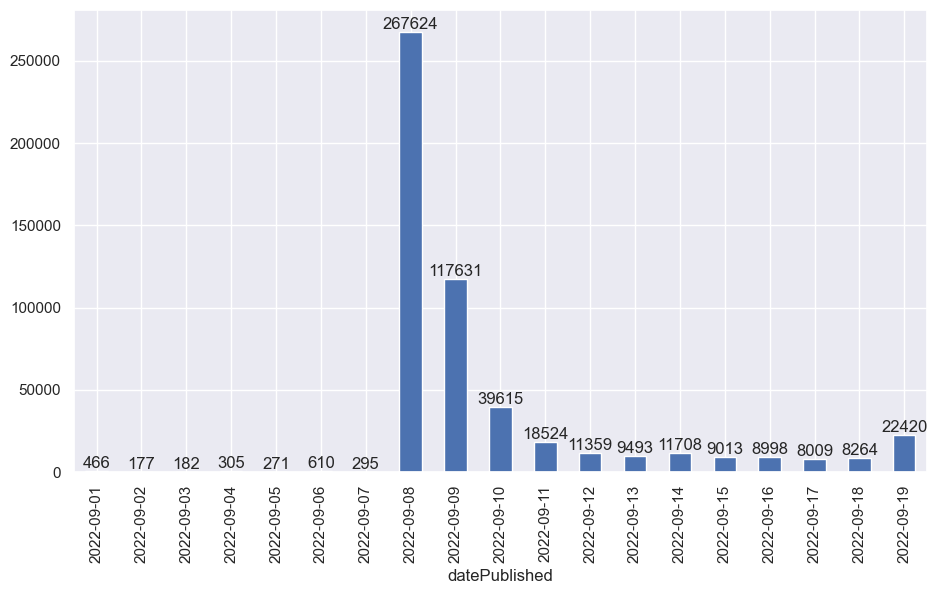

In [14]:
# explore the distrubtion of number of tweets each day 

sns.set(rc={'figure.figsize':(11,6)})

ax = df.groupby(['datePublished'])['id'].count().plot.bar()

#to deisplay the value above each bar
for i in ax.containers:
    ax.bar_label(i,)

### 2.2Top 10 lanuages tweets written in 

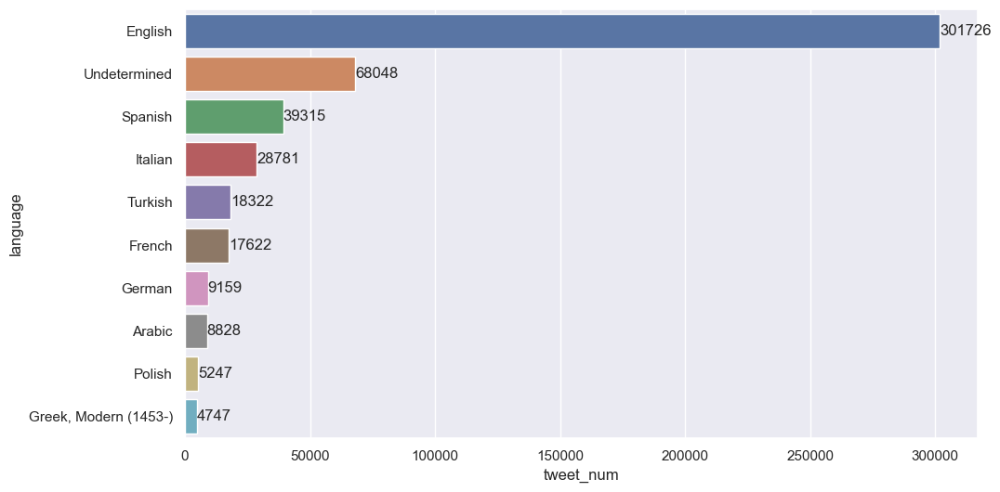

In [15]:
# filter top 10 common langages that tweets used and visualize  

lang = df.groupby(['inLanguage'])['id'].count().sort_values(ascending = False).head(10).reset_index()

lang = lang.rename(columns = {'inLanguage':'language','id' : 'tweet_num'})
lang

ax_lang = sns.barplot(x='tweet_num', y='language', data = lang, order = lang.sort_values('tweet_num',ascending = False).language) 
    
for i in ax_lang.containers:
    ax_lang.bar_label(i,)

### 2.3 Average Length  

In [16]:
#store the length of each tweet in a list 
#create a new column based on this list
len_tweet = []
for sent in df['text']:
    text = re.sub(r'https?\:\/\/[a-zA-Z0-9\-\.]+\.[a-zA-Z]{2,3}(\/\S*)?','',sent)
    len_tweet.append(len(text))

df['len_tweet'] = len_tweet
df['len_tweet']

0         182
1          37
2         162
3         241
4          82
         ... 
534959    205
534960     34
534961     34
534962     43
534963    144
Name: len_tweet, Length: 534964, dtype: int64

In [141]:
#the avergae length of all tweets
df['len_tweet'].mean()

127.49384818417688

In [17]:
#the median length of all tweets
df['len_tweet'].median()

109.0

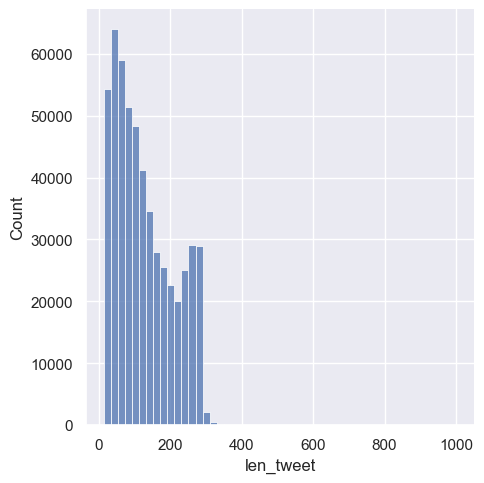

In [19]:
#visualize the distribution of length of the tweets 
df.groupby('len_tweet')
sns.displot(x='len_tweet', bins = 50 ,data=df) 

## 3.Social Network Analysis (SNA) of tweets 

The SNA would be executed by two tools: python and Gephi. The node and edge files would be prepared here through python and visualizations are generated in Gephi.

### 3.1Data preparation for Gephi Visualization

#### 3.1.1Co-occurring Hashtag Network 

In [21]:
raw_hashtag = df["text"]
raw_hashtag.head()

0    My account of being arrested in #Oxford today ...
1    #FuckImperialism #AbolishTheMonarchy https://t...
2    @RedbirdEl We've had hostile government since ...
3    แดกภาษีฟรีๆแต่ไม่อยากโดนวิจารณ์ไม่อยากโดนบังคั...
4    @BeckettUnite Ultimately, once the ceremonies ...
Name: text, dtype: object

In [22]:
#find all hashtag pairs cooccured in the same tweet

#extract hashtags from text in each row
data_cotag = []
for i in raw_hashtag:
    # each list returned contains every hashtag in the corresponding tweet
    tag = re.findall(r'#[\w\d]+', i) 
    # Combine the hashtags in each tweet in pairs 
    # indicate the co-occur relationship between two hashtags in the same tweet
    for co_tag in combinations(tag, 2):
        lst = list(co_tag)
        data_cotag.append(lst)
data_cotag


[['#Oxford', '#NotMyKing'],
 ['#Oxford', '#CharlesIII'],
 ['#Oxford', '#AbolishtheMonarchy'],
 ['#Oxford', '#NotMyKing'],
 ['#NotMyKing', '#CharlesIII'],
 ['#NotMyKing', '#AbolishtheMonarchy'],
 ['#NotMyKing', '#NotMyKing'],
 ['#CharlesIII', '#AbolishtheMonarchy'],
 ['#CharlesIII', '#NotMyKing'],
 ['#AbolishtheMonarchy', '#NotMyKing'],
 ['#FuckImperialism', '#AbolishTheMonarchy'],
 ['#Conservativeskill', '#CapitalismKills'],
 ['#Conservativeskill', '#ClassWar'],
 ['#Conservativeskill', '#AbolishTheMonarchy'],
 ['#Conservativeskill', '#AbolishTheHouseOfLords'],
 ['#Conservativeskill', '#ElectoralReformNow'],
 ['#CapitalismKills', '#ClassWar'],
 ['#CapitalismKills', '#AbolishTheMonarchy'],
 ['#CapitalismKills', '#AbolishTheHouseOfLords'],
 ['#CapitalismKills', '#ElectoralReformNow'],
 ['#ClassWar', '#AbolishTheMonarchy'],
 ['#ClassWar', '#AbolishTheHouseOfLords'],
 ['#ClassWar', '#ElectoralReformNow'],
 ['#AbolishTheMonarchy', '#AbolishTheHouseOfLords'],
 ['#AbolishTheMonarchy', '#Electo

In [23]:
# create a new dataframe containing only hashtags and co-occur hashtags
df_hashtag = pd.DataFrame(data_cotag, columns = ["hashtag","co-hashtag"])
df_hashtag

,hashtag,co-hashtag
0,#Oxford,#NotMyKing
1,#Oxford,#CharlesIII
2,#Oxford,#AbolishtheMonarchy
3,#Oxford,#NotMyKing
4,#NotMyKing,#CharlesIII
...,...,...
3744455,#Scotland,#QueenElizabeth
3744456,#QueenElizabethII,#QueenElizabeth
3744457,#QueenElizabeth,#queensfuneral
3744458,#QueenElizabeth,#RIPQueenElizabeth


In [27]:
#filter the hashtags that used to query the dataset 
indexHashtag = df_hashtag[(df_hashtag['hashtag'].isin(['#QueenElizabeth','#queenelizabeth','#QueueForTheQueen','#queueforthequeen','#AbolishTheMonarchy',
                             '#abolishthemonarchy'])) | (df_hashtag['co-hashtag'].isin(['#QueenElizabeth','#queenelizabeth','#QueueForTheQueen','#queueforthequeen','#AbolishTheMonarchy',
                             '#abolishthemonarchy']))].index
                            
df_hashtag.drop(indexHashtag , inplace=True)
df_hashtag

,hashtag,co-hashtag
0,#Oxford,#NotMyKing
1,#Oxford,#CharlesIII
2,#Oxford,#AbolishtheMonarchy
3,#Oxford,#NotMyKing
4,#NotMyKing,#CharlesIII
...,...,...
3744446,#Stocks,#StockstoWatch
3744447,#Stocks,#Inflation
3744449,#StockstoWatch,#Inflation
3744453,#QueenElizabethII,#RAFNortholt


In [28]:
# create the nodes file for co-occurring hashtag networks
a = pd.Series(df_hashtag["hashtag"].values, name = "hashtag")
b = pd.Series(df_hashtag["co-hashtag"].values, name = "hashtag")

# extract every single hashatag and assign id for them 
df_nodes = pd.concat([a,b]).to_frame().drop_duplicates()
df_nodes.reset_index(drop = True, inplace= True)
df_nodes["id"] = df_nodes.index + 1
df_nodes = df_nodes.loc[:,["id","hashtag"]] 
df_nodes

,id,hashtag
0,1,#Oxford
1,2,#NotMyKing
2,3,#CharlesIII
3,4,#AbolishtheMonarchy
4,5,#Conservativeskill
...,...,...
99661,99662,#talkingshit
99662,99663,#OPSWA
99663,99664,#tekst
99664,99665,#Willow


In [132]:
# save nodes dataframe to csv file 
df_nodes.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\hashtag_nodes.csv",index=False)

Create edge file for co-occuring hashtags 

In [29]:
# locate id number for each hashtag in two columns respectively 
df_rawedges = df_hashtag.join(df_nodes.set_index('hashtag'), on='hashtag')
df_rawedges = df_rawedges.join(df_nodes.set_index('hashtag'), on='co-hashtag',lsuffix="_1")
df_rawedges

,hashtag,co-hashtag,id_1,id
0,#Oxford,#NotMyKing,1,2
1,#Oxford,#CharlesIII,1,3
2,#Oxford,#AbolishtheMonarchy,1,4
3,#Oxford,#NotMyKing,1,2
4,#NotMyKing,#CharlesIII,2,3
...,...,...,...,...
3744446,#Stocks,#StockstoWatch,23819,82008
3744447,#Stocks,#Inflation,23819,2534
3744449,#StockstoWatch,#Inflation,82008,2534
3744453,#QueenElizabethII,#RAFNortholt,109,74777


In [30]:
#create the edges file
df_edges = df_rawedges.iloc[:,2:4].rename(columns={"id_1": "source", "id": "target"})
df_edges['type'] = 'undirected'
df_edges['weight'] = '1'
df_edges

,source,target,type,weight
0,1,2,undirected,1
1,1,3,undirected,1
2,1,4,undirected,1
3,1,2,undirected,1
4,2,3,undirected,1
...,...,...,...,...
3744446,23819,82008,undirected,1
3744447,23819,2534,undirected,1
3744449,82008,2534,undirected,1
3744453,109,74777,undirected,1


In [135]:
# save edges dataframe to csv file 
df_edges.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\hashtag_edges.csv",index=False)

#### 3.1.2Mention@ Network

In [35]:
raw_mention = df['text']
raw_mention

0         My account of being arrested in #Oxford today ...
1         #FuckImperialism #AbolishTheMonarchy https://t...
2         @RedbirdEl We've had hostile government since ...
3         แดกภาษีฟรีๆแต่ไม่อยากโดนวิจารณ์ไม่อยากโดนบังคั...
4         @BeckettUnite Ultimately, once the ceremonies ...
                                ...                        
534959    Ferienparks @CenterParcsUK in Großbritannien s...
534960    #Scotland #QueenElizabeth 🏴󠁧󠁢󠁳󠁣󠁴󠁿 https://t.co...
534961    #QueenElizabethII #QueenElizabeth https://t.co...
534962    She's just passed overhead #QueenElizabeth htt...
534963    Just me… and I mean in the nicest possible way...
Name: text, Length: 534964, dtype: object

In [36]:
#extract mention@ from text in each row
#data_mention list contains every '@accountname' in the corresponding tweet

data_mention = []
for i in raw_mention:
    mention = re.findall(r'@[\w\d]+', i) 
    data_mention.append(mention)
data_mention

[['@BrightGrn'],
 [],
 ['@RedbirdEl'],
 [],
 ['@BeckettUnite'],
 ['@SevilleCalculat'],
 [],
 [],
 [],
 [],
 [],
 ['@chunkymark'],
 [],
 ['@CanadianPress', '@CdnPressPoli'],
 ['@RuthSampson11', '@BeckettUnite'],
 [],
 ['@EdinburghLive_'],
 [],
 ['@PhoenixWo1f'],
 ['@SholaMos1'],
 [],
 [],
 ['@AaronBastani', '@gemandmoll'],
 ['@BBCNews', '@Channel4News', '@itvnews', '@SkyNews'],
 ['@BeckettUnite'],
 ['@franceinfoplus'],
 [],
 [],
 [],
 [],
 ['@EdinburghLive_'],
 [],
 [],
 [],
 [],
 [],
 ['@Etsy'],
 [],
 [],
 ['@ScotNational'],
 ['@Markus_Soeder'],
 ['@TheSocialistDad'],
 [],
 [],
 ['@MsproNoshad'],
 [],
 ['@nytimes'],
 [],
 ['@EdinburghLive_'],
 ['@swanseagds', '@EMB46840636', '@HelenRSalisbury'],
 [],
 ['@BBCBreaking'],
 ['@Lolbeelolbee'],
 ['@zoeharcombe'],
 [],
 [],
 [],
 [],
 [],
 ['@JohnStanners', '@danbloom1'],
 ['@PromisesLabour', '@FUFowlers', '@JoshRomOnAir'],
 ['@WetSpamFan', '@Moonfiyah'],
 ['@ImInnocent1961'],
 ['@medievaltrees'],
 [],
 [],
 [],
 ['@CraigMurrayOrg'],
 [],
 ['

In [37]:
# form a new dataframe with authors and mentioned users in the tweets
author_mention = pd.DataFrame(
    {
        "author": df['author_alternateName'], 
        "mentioned_user": data_mention
    })
author_mention

,author,mentioned_user
0,@surethinzzpato,[@BrightGrn]
1,@zdravkov12,[]
2,@e_winzar,[@RedbirdEl]
3,@ChaiiInMunich,[]
4,@Think_Blue_Sky,[@BeckettUnite]
...,...,...
534959,@MarcBichtemann,[@CenterParcsUK]
534960,@MDplusthree,[]
534961,@topbrewer,[]
534962,@robinmuirhead,[]


In [38]:
# convert each elements in the list to a seperate cell value
# and drop rows showing NAN, where no mentioned users in one's tweet
author_mention = author_mention.explode('mentioned_user').dropna()
author_mention

,author,mentioned_user
0,@surethinzzpato,@BrightGrn
2,@e_winzar,@RedbirdEl
4,@Think_Blue_Sky,@BeckettUnite
5,@thescotsquine,@SevilleCalculat
11,@Think_Blue_Sky,@chunkymark
...,...,...
534944,@Ania_Raczkowska,@RadioZET_NEWS
534953,@felixsupreme305,@PapaOblock
534954,@spectralsailor,@UKLabour
534954,@spectralsailor,@Conservatives


In [39]:
# create the nodes file for 'mention@' relation
c = pd.Series(author_mention["author"].values, name = "user")
d = pd.Series(author_mention["mentioned_user"].values, name = "user")

# extract every single user and assign id for them 
df_nodes_1 = pd.concat([c,d]).to_frame().drop_duplicates()
df_nodes_1.reset_index(drop = True, inplace= True)
df_nodes_1["id"] = df_nodes_1.index + 1
df_nodes_1 = df_nodes_1.loc[:,["id","user"]] 
df_nodes_1


,id,user
0,1,@surethinzzpato
1,2,@e_winzar
2,3,@Think_Blue_Sky
3,4,@thescotsquine
4,5,@MoCooray
...,...,...
103106,103107,@PrinceHarryMar1
103107,103108,@LanaWolf1872
103108,103109,@PeacockTVCare
103109,103110,@BBCSurreyTravel


In [20]:
# save the nodes file as csv file
df_nodes_1.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\mention_nodes.csv",index=False)

In [40]:
# locate id number for each user in two columns respectively 
df_rawedges_1 = author_mention.join(df_nodes_1.set_index('user'), on='author')
df_rawedges_1 = df_rawedges_1.join(df_nodes_1.set_index('user'), on='mentioned_user',lsuffix="_1")
df_rawedges_1

,author,mentioned_user,id_1,id
0,@surethinzzpato,@BrightGrn,1,45826
2,@e_winzar,@RedbirdEl,2,46
4,@Think_Blue_Sky,@BeckettUnite,3,45827
5,@thescotsquine,@SevilleCalculat,4,45828
11,@Think_Blue_Sky,@chunkymark,3,45829
...,...,...,...,...
534944,@Ania_Raczkowska,@RadioZET_NEWS,1970,48376
534953,@felixsupreme305,@PapaOblock,45823,103111
534954,@spectralsailor,@UKLabour,45824,45979
534954,@spectralsailor,@Conservatives,45824,45994


In [41]:
# create a edges file  
df_edges_1 = df_rawedges_1.iloc[:,2:4].rename(columns={"id_1": "source", "id": "target"})
df_edges_1['type'] = 'directed'
df_edges_1['weight'] = '1'
df_edges_1 

,source,target,type,weight
0,1,45826,directed,1
2,2,46,directed,1
4,3,45827,directed,1
5,4,45828,directed,1
11,3,45829,directed,1
...,...,...,...,...
534944,1970,48376,directed,1
534953,45823,103111,directed,1
534954,45824,45979,directed,1
534954,45824,45994,directed,1


In [23]:
# save the edges dataframe as csv file
df_edges_1.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\mention_edges.csv",index=False)

#### 3.1.3Reply Network

In [24]:
# locate coloumns of senders and recipients, which indicates the "reply to" relationship  
reply_to = df[['sender_alternateName','recipient_alternateName']].dropna()
reply_to

,sender_alternateName,recipient_alternateName
2,@e_winzar,@RedbirdEl
4,@Think_Blue_Sky,@BeckettUnite
5,@thescotsquine,@SevilleCalculat
11,@Think_Blue_Sky,@chunkymark
14,@Whirleysloth,@RuthSampson11
...,...,...
534903,@orangeplanetuk,@BBCBreaking
534910,@CindyWh44947139,@hrrysgreysuit
534913,@NancyLipschult2,@QueenLilibet_
534919,@GadgetMichael,@itvnews


In [25]:
# create a nodes file 
e = pd.Series(reply_to["sender_alternateName"].values, name = "user")
f = pd.Series(reply_to["recipient_alternateName"].values, name = "user")

# extract evry signle user name (containing all sends' and recipents' name) and assign id for them
df_nodes_2 = pd.concat([e,f]).to_frame().drop_duplicates()
df_nodes_2.reset_index(drop = True, inplace= True)
df_nodes_2["id"] = df_nodes_2.index + 1
df_nodes_2 = df_nodes_2.loc[:,["id","user"]] 
df_nodes_2

,id,user
0,1,@e_winzar
1,2,@Think_Blue_Sky
2,3,@thescotsquine
3,4,@Whirleysloth
4,5,@123facts123
...,...,...
48309,48310,@twittersecurity
48310,48311,@AscensoInglesok
48311,48312,@EmergencyBod
48312,48313,@LanaWolfUK


In [27]:
# save the nodes dataframe as csv file  
df_nodes_2.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\replyto_nodes.csv",index=False)

In [28]:
# locate id number for each user name in two columns respectively 
df_rawedges_2 = reply_to.join(df_nodes_2.set_index('user'), on='sender_alternateName')
df_rawedges_2 = df_rawedges_2.join(df_nodes_2.set_index('user'), on='recipient_alternateName',lsuffix="_1")
df_rawedges_2

,sender_alternateName,recipient_alternateName,id_1,id
2,@e_winzar,@RedbirdEl,1,38
4,@Think_Blue_Sky,@BeckettUnite,2,25671
5,@thescotsquine,@SevilleCalculat,3,25672
11,@Think_Blue_Sky,@chunkymark,2,25673
14,@Whirleysloth,@RuthSampson11,4,25674
...,...,...,...,...
534903,@orangeplanetuk,@BBCBreaking,25669,25685
534910,@CindyWh44947139,@hrrysgreysuit,483,27872
534913,@NancyLipschult2,@QueenLilibet_,25670,12726
534919,@GadgetMichael,@itvnews,23894,25781


In [29]:
# form a edges file 
df_edges_2 = df_rawedges_2.iloc[:,2:4].rename(columns={"id_1": "source", "id": "target"})
df_edges_2['type'] = 'directed'
df_edges_2['weight'] = '1'
df_edges_2 

,source,target,type,weight
2,1,38,directed,1
4,2,25671,directed,1
5,3,25672,directed,1
11,2,25673,directed,1
14,4,25674,directed,1
...,...,...,...,...
534903,25669,25685,directed,1
534910,483,27872,directed,1
534913,25670,12726,directed,1
534919,23894,25781,directed,1


In [30]:
# save the edges dataframe as csv file
df_edges_2.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\replyto_edges.csv",index=False)

### 3.2 Gephi Visualization

Visualizations are created by Gephi.The completed visualizations could be found here:  
* [Mention network visualizations from four metrics](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/mention_vis.png)  
* [Reply network visualizations from four metrics](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/reply_vis.jpg)  
* [The network visualization of hashtags oc-occurred above 100 times](add later after dtermined)

However, the visualization of hashtag network is different from the other two, because the volume of data for hashtag nodes and edges is too large to work with in Gephi. To find the most apprend outcome, I manually filter it in Python using the criteria that the edge weight should be greater than or equal to 100. Afterwards, the results are exported from Python, extract new node and edge file, then import back into Gephi for visualization.

#### Hashtag Network: Filtering  

The file read here is the edge file exported from Gephi with weight merged, where the weight for same edge would be summed.  
The processed file [hashtag edge with weight](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/main/hashtag%20edge%20with%20weight.graphml.csv) can be downloaded from my github. 

In [42]:
df_tag_weight = pd.read_csv(r"D:\KU Leuven\Master thesis\Data analysis\hashtag edge with weight.graphml.csv")
df_tag_weight

,Source,Target,Type,Id,Label,timeset,Weight
0,1,2,Undirected,2749608,NaN,NaN,7
1,1,3,Undirected,2749609,NaN,NaN,4
2,1,4,Undirected,2749610,NaN,NaN,3
3,2,3,Undirected,2749612,NaN,NaN,72
4,2,4,Undirected,2749613,NaN,NaN,45
...,...,...,...,...,...,...,...
986822,82007,23819,Undirected,5499208,NaN,NaN,1
986823,82007,82008,Undirected,5499209,NaN,NaN,1
986824,82007,2534,Undirected,5499210,NaN,NaN,1
986825,23819,82008,Undirected,5499211,NaN,NaN,1


In [43]:
bools = df_tag_weight['Weight'] > 99
df_filtered = df_tag_weight[bools]
df_filtered

,Source,Target,Type,Id,Label,timeset,Weight
5,2,2,Undirected,2749614,NaN,NaN,210
189,2,55,Undirected,2749803,NaN,NaN,675
216,2,139,Undirected,2749836,NaN,NaN,290
223,40,13618,Undirected,2749843,NaN,NaN,112
232,42,45,Undirected,2749852,NaN,NaN,119
...,...,...,...,...,...,...,...
897382,1038,97,Undirected,5180044,NaN,NaN,213
899968,214,10903,Undirected,5186200,NaN,NaN,220
902437,10903,2067,Undirected,5194037,NaN,NaN,218
912623,10903,97,Undirected,5227741,NaN,NaN,212


In [13]:
#save the result filtered 
df_filtered.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\hashtag edge with weight100.csv",index=False)

### 3.3 Text Mining of Key Users 

From the result of mention and reply network, we can see that @Arad87709987, @nika6547, @talhamuneeb7700, and @Brijend84228427 show the significance in out-degree centrality measures. So let's mine the tweets of these accounts throught two means: aggregate hashtags they used and examine the frequent word in the tweets of each user.  

#### 3.3.1 Text Analysis of tweets of the account '@Arad87709987'

In [45]:
#group all tweets text of the account
df_m1 = df.loc[df['author_alternateName'] == '@Arad87709987'][['author_alternateName','text']]
df_m1

,author_alternateName,text
159371,@Arad87709987,@rothdanielle Queen has expired. It should hav...
159386,@Arad87709987,@rothdanielle @IsraelHayomHeb @BismuthBoaz @Ar...
159440,@Arad87709987,@Now14Israel @Arielidan20 Queen has expired. I...
159448,@Arad87709987,@Arielidan20 Queen has expired. It should have...
159475,@Arad87709987,@Now14Israel @MaggieTabibi @ornitfsw Queen has...
...,...,...
335228,@Arad87709987,@LeandroSelister The Queen’s consumption date ...
335243,@Arad87709987,@gofiliberto The Queen’s consumption date is o...
342033,@Arad87709987,@BBCBreaking The Queen’s consumption date is o...
342063,@Arad87709987,@BBCBreaking The Queen’s consumption date is o...


In [46]:
#extract all hashtags, and store in a list
m1_tag = []
for x in df_m1['text']:
    tag = re.findall(r'#[\w\d]+', x) 
    for hashtag in tag:
        m1_tag.append(hashtag)
m1_tag

#create a dataframe based on the list m1_tag
df_m1_tag = pd.DataFrame(
    {
        "index" : range(len(m1_tag)),
        "m1_hashtag": m1_tag}) 
df_m1_tag

,index,m1_hashtag
0,0,#Queen
1,1,#Elizabeth
2,2,#QueenElizabeth
3,3,#Queen
4,4,#Elizabeth
...,...,...
2471,2471,#Elizabeth
2472,2472,#QueenElizabeth
2473,2473,#Queen
2474,2474,#Elizabeth


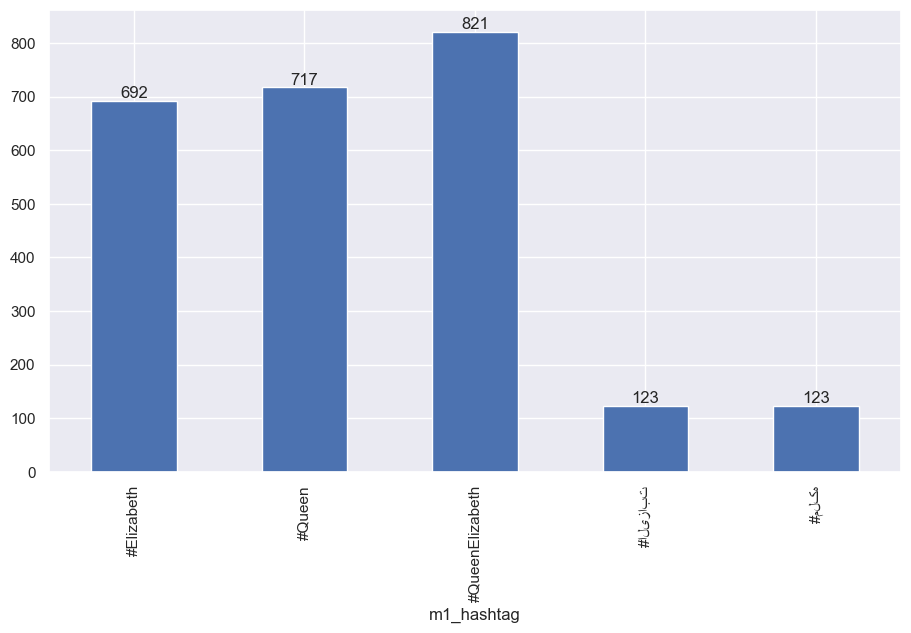

In [47]:
#visualize the hashtag aggregation 

sns.set(rc={'figure.figsize':(11,6)})

ax_m1=df_m1_tag.groupby(['m1_hashtag'])["index"].count().plot.bar()

for m in ax_m1.containers:
    ax_m1.bar_label(m,)

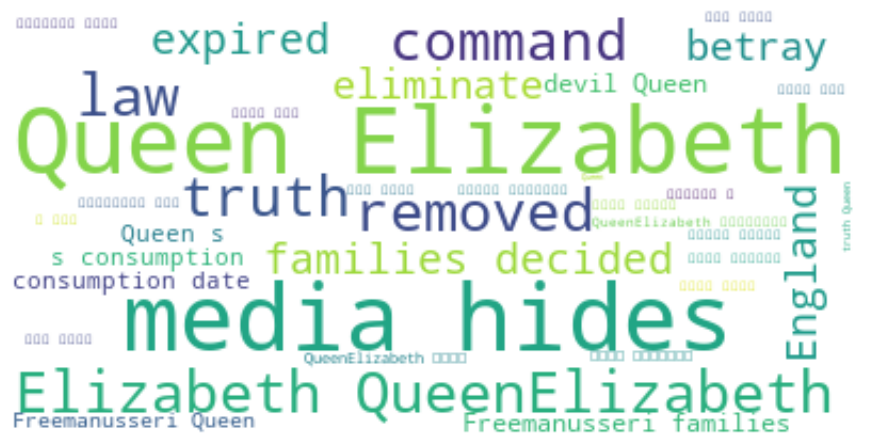

In [48]:
# create the word cloud to show the word frequency 
txt_lst = []
for t in df_m1['text']:
    txt_lst.append(t)
    text = " ".join(txt_lst)

wordcloud = WordCloud(background_color = 'white').generate(text)

# display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

#### 3.3.2 Text Analysis of tweets of the account '@talhamuneeb7700'

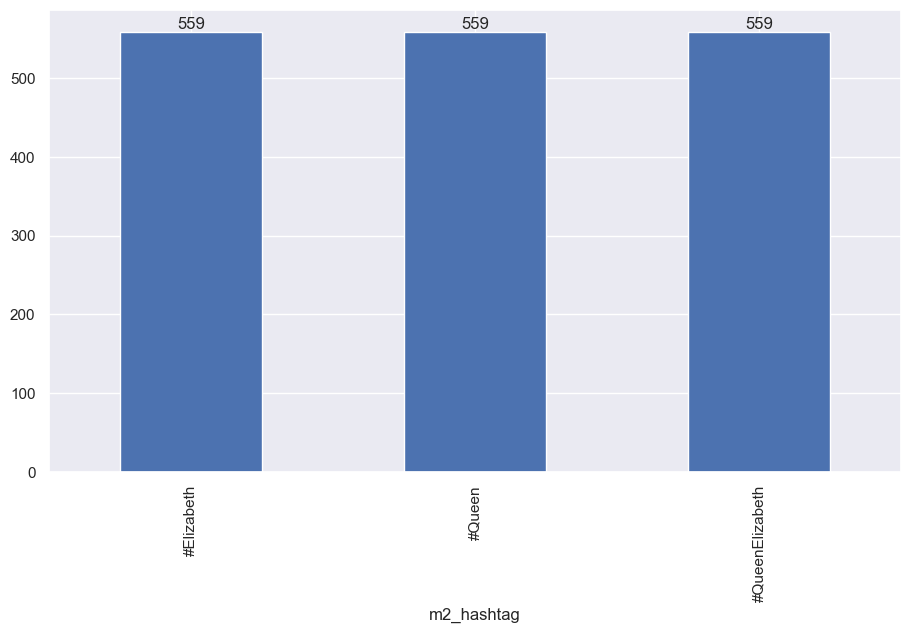

In [58]:
#group all tweet texts of the account '@talhamuneeb7700'
df_m2 = df.loc[df['author_alternateName'] == '@talhamuneeb7700'][['author_alternateName','text']]

#extract hashtags and store them in the list 
m2_tag = []
for y in df_m2['text']:
    tag2 = re.findall(r'#[\w\d]+', x) 
    for hashtag2 in tag2:
        m2_tag.append(hashtag2)

#create a dataframe based on the previous list m2_tag
df_m2_tag = pd.DataFrame(
    {
        "index" : range(len(m2_tag)),
        "m2_hashtag": m2_tag})

#visualize the hashtag aggregation

sns.set(rc={'figure.figsize':(11,6)})
ax_m2=df_m2_tag.groupby(['m2_hashtag'])["index"].count().plot.bar()
for m in ax_m2.containers:
    ax_m2.bar_label(m,)

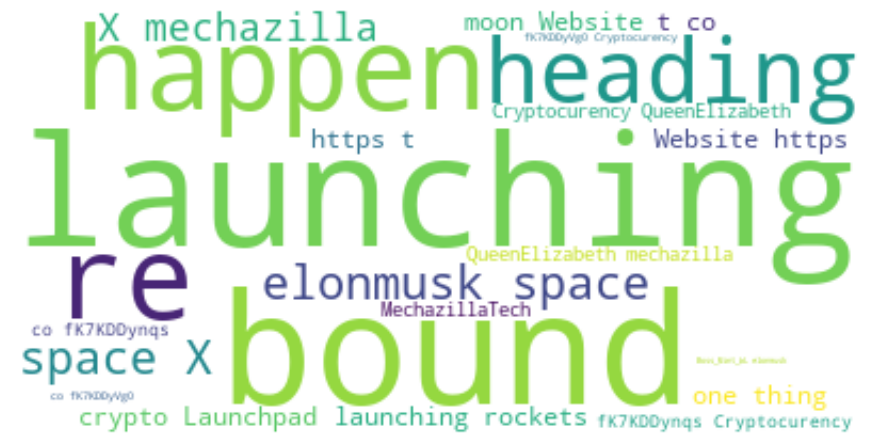

In [50]:
# create the word cloud to show the word frequency 
txt2_lst = []
for t2 in df_m2['text']:
    txt2_lst.append(t2)
    text2 = " ".join(txt2_lst)

wordcloud = WordCloud(background_color = 'white').generate(text2)

# display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

#### 3.3.3 Text Analysis of tweets of the account '@talhamuneeb7700'

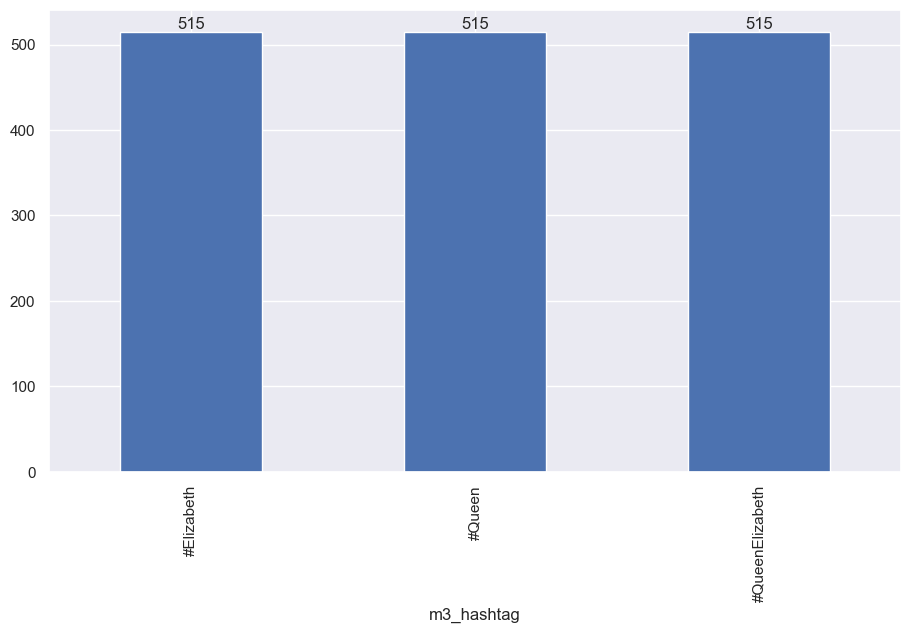

In [51]:
# group all tweet texts of the account '@lordweapon7228'
df_m3 = df.loc[df['author_alternateName'] == '@lordweapon7228'][['author_alternateName','text']]

#extract hashtags and store them in the list 
m3_tag = []
for z in df_m3['text']:
    tag3 = re.findall(r'#[\w\d]+', x) 
    for hashtag3 in tag3:
        m3_tag.append(hashtag3)

#create a dataframe based on the previous list m3_tag
df_m3_tag = pd.DataFrame(
    {
        "index" : range(len(m3_tag)),
        "m3_hashtag": m3_tag})

#visualize the hashtag aggregation
sns.set(rc={'figure.figsize':(11,6)})
ax_m3=df_m3_tag.groupby(['m3_hashtag'])["index"].count().plot.bar()
for m in ax_m3.containers:
    ax_m3.bar_label(m,)

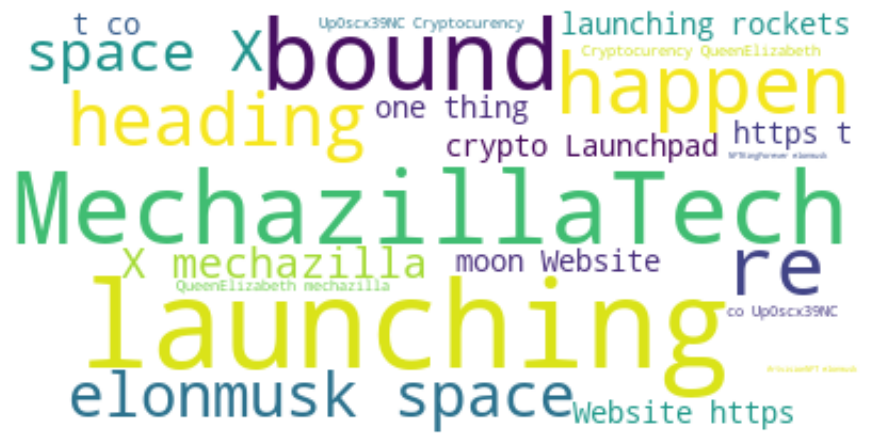

In [52]:
# create the word cloud to show the word frequency 

txt3_lst = []
for t3 in df_m3['text']:
    txt3_lst.append(t3)
    text3 = " ".join(txt3_lst)

wordcloud = WordCloud(background_color = 'white').generate(text3)

# display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

#### 3.3.4 Text Analysis of tweets of the account '@nika6547'

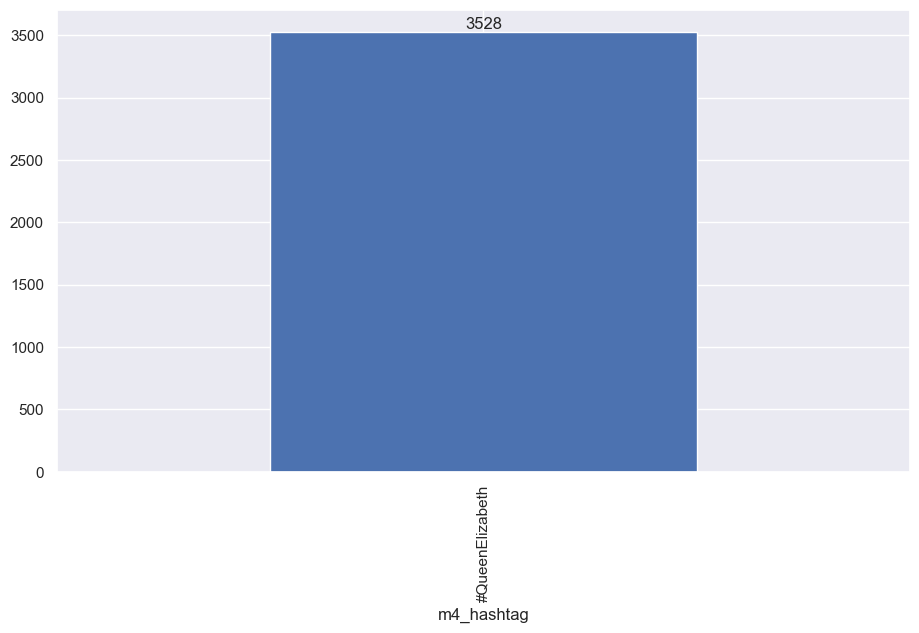

In [54]:
# group all tweet texts of the account '@nika6547'
df_m4 = df.loc[df['author_alternateName'] == '@nika6547'][['author_alternateName','text']]

# extract hashtags and store them in the list 
m4_tag = []
for z in df_m4['text']:
    tag4 = re.findall(r'#[\w\d]+', x) 
    for hashtag4 in tag4:
        m4_tag.append(hashtag3)

# create a dataframe based on the previous list m4_tag
df_m4_tag = pd.DataFrame(
    {
        "index" : range(len(m4_tag)),
        "m4_hashtag": m4_tag})

# visualize the hashtag aggregation
sns.set(rc={'figure.figsize':(11,6)})
ax_m4=df_m4_tag.groupby(['m4_hashtag'])["index"].count().plot.bar()
for m in ax_m4.containers:
    ax_m4.bar_label(m,)

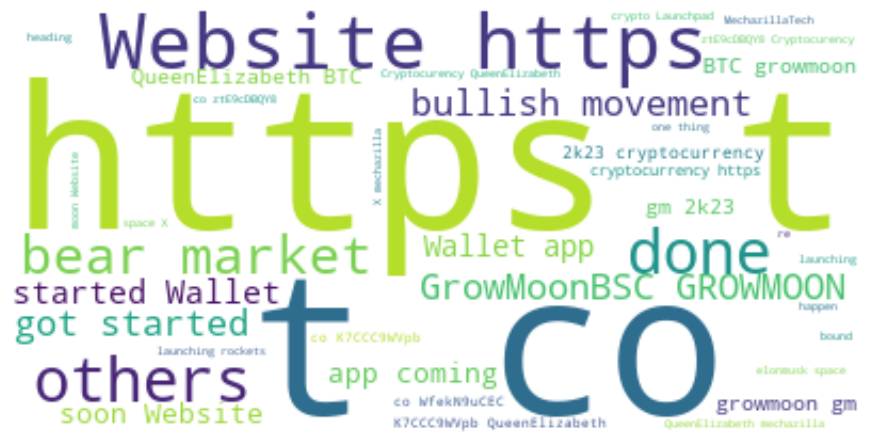

In [55]:
# create the word cloud to show the word frequency 
txt4_lst = []
for t4 in df_m4['text']:
    txt4_lst.append(t4)
    text4 = " ".join(txt4_lst)
    
wordcloud = WordCloud(background_color = 'white').generate(text4)

# display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

Further interpretation of these four users and their tweet content is provided in the internship thesis.

#### 3.3.5 Text Analysis of tweets of the account '@HighwaySqueak'  

On the other hand, @HighwaySqueak shows as the most important gatekeeper in both mention and reply network, employing the largest influence on information transmission through the networks. Thus, let's also mine the hashtags and frequent words of this account.  


In [59]:
# group all tweet texts of the account '@HighwaySqueak'
df_m5 = df.loc[df['author_alternateName'] == '@HighwaySqueak'][['author_alternateName','text']]

# extract hashtags and store them in the list 
m5_tag = []
for q in df_m5['text']:
    tag5 = re.findall(r'#[\w\d]+', q) 
    for hashtag5 in tag5:
        m5_tag.append(hashtag5)

# create a dataframe based on the previous list m4_tag
df_m5_tag = pd.DataFrame(
    {
        "index" : range(len(m5_tag)),
        "m5_hashtag": m5_tag})

# extract the top 5 most common hashtags 
df_m5_tag.groupby(['m5_hashtag'])["index"].count().sort_values(ascending = False).head(5)

m5_hashtag
#AbolishTheMonarchy    271
#NotMyKing             132
#NotMyPrince            71
#IndyWales              21
#EnoughIsEnough         13
Name: index, dtype: int64

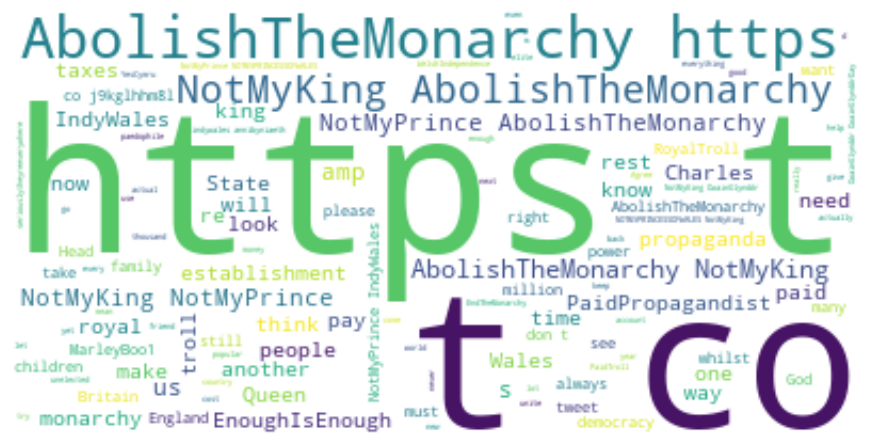

In [60]:
# create the word cloud to show the word frequency 
txt5_lst = []
for t5 in df_m5['text']:
    txt5_lst.append(t5)
    text5 = " ".join(txt5_lst)

wordcloud = WordCloud(background_color = 'white').generate(text5)

# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

## 4.Text Analysis

In this phase, all English written tweets would be analyzed by two ways: word cloud generation and topic modeling. First, raw texts need to be preprocessed with the common Natual Language Processing (NLP) pipeline with removing emojis, punctuations, tokenizing, lemmetizaing, ect. But since the way this dataset retrieved, the hashtags used for query would appear more frequently, which leads to bais of the result. To emlinate this, **the preprocessed data for word cloud excludes all hashtags**. But in topic modeling, the hashtags are important as they imply the summary of the tweet. Thus, **the preprocessed data for topic modeling includes all hashtags**. Afterwards, world cloud and topic modeling would be conducted.

### 4.1Data preporcessing

All text data would be manipulated under the pandas dataframe, where new extended columns would be created to store the result of last performance.

In [66]:
# first filter tweets in English
df_en = df.loc[df['inLanguage']=='English'].loc[:,['datePublished','text']]
df_en

,datePublished,text
0,2022-09-12,My account of being arrested in #Oxford today ...
2,2022-09-12,@RedbirdEl We've had hostile government since ...
4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ..."
5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin..."
6,2022-09-12,"Along with the Queen, Britain is laying to res..."
...,...,...
534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...
534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...
534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...
534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...


**Removing Hashtags or not**  
* Preprocessing1 with removing hashtags: Initiate the following codes to remove hashtags and conduct all subsequent preprocessing manipulation  
* Preprocessing2 with keeping hashtags: Skip the following the codes and start preprocessing from [4.1.1Emoji & Url Removel](#-4.1.1Emoji-&-Url-Removel)

NOTE: It could be better to save both results as csv.file into local computer to avoid running of these processes repeatedly.

In [67]:
# define a function to remove all hashtags
def hashtag_removal(text):
    text_free_of_hashtag = re.sub(r'#\w+','',text)
    return text_free_of_hashtag

df_en['no_hashtags'] = df_en['text'].apply(hashtag_removal)
df_en

,datePublished,text,no_hashtags
0,2022-09-12,My account of being arrested in #Oxford today ...,My account of being arrested in today for voi...
2,2022-09-12,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...
4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ..."
5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin..."
6,2022-09-12,"Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res..."
...,...,...,...
534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...
534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...,over Stoke on Trent heading to https://t.co...
534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...
534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead https://t.co/fQSQ1...


#### 4.1.1Emoji & Url Removel

In [69]:
# define funtions to remove emojis and urls in the tweet texts

def emoji_removal(text):
    clean_text = emoji.replace_emoji(text, replace = '')
    return clean_text

def URL_removal(text):
    text = re.sub(r'https?\:\/\/[a-zA-Z0-9\-\.]+\.[a-zA-Z]{2,3}(\/\S*)?','',text)
    return text

# Apply the function to get tweets without emojis
df_en['no_emoji_tweets'] = df_en['text'].apply(emoji_removal)

# Create a new column with no url tweets
df_en['no_url_tweets'] = df_en['no_emoji_tweets'].apply(URL_removal)

df_en

,datePublished,text,no_hashtags,no_emoji_tweets,no_url_tweets
0,2022-09-12,My account of being arrested in #Oxford today ...,My account of being arrested in today for voi...,My account of being arrested in #Oxford today ...,My account of being arrested in #Oxford today ...
2,2022-09-12,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...
4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ..."
5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin..."
6,2022-09-12,"Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res..."
...,...,...,...,...,...
534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...
534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...,over Stoke on Trent heading to https://t.co...,#QueenElizabethII #QueenElizabeth over Stoke o...,#QueenElizabethII #QueenElizabeth over Stoke o...
534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...
534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead https://t.co/fQSQ1...,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead #QueenElizabeth


#### 4.1.2 Punctuation Removel 

In [71]:
# define a function to remove all punctuation and hashtag 

def punctuation_removal(text):
    text_free_of_punctuation = re.sub(r'[^\w\s]', '', text)
    return text_free_of_punctuation

df_en['no_punctuation'] = df_en['no_url_tweets'].apply(punctuation_removal)
df_en

,datePublished,text,no_hashtags,no_emoji_tweets,no_url_tweets,no_punctuation
0,2022-09-12,My account of being arrested in #Oxford today ...,My account of being arrested in today for voi...,My account of being arrested in #Oxford today ...,My account of being arrested in #Oxford today ...,My account of being arrested in Oxford today f...
2,2022-09-12,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,RedbirdEl Weve had hostile government since 1...
4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...",BeckettUnite Ultimately once the ceremonies ar...
5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...",SevilleCalculat Meanwhile from someone living ...
6,2022-09-12,"Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...",Along with the Queen Britain is laying to rest...
...,...,...,...,...,...,...
534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners amp Losers Stocks Tank Af...
534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...,over Stoke on Trent heading to https://t.co...,#QueenElizabethII #QueenElizabeth over Stoke o...,#QueenElizabethII #QueenElizabeth over Stoke o...,QueenElizabethII QueenElizabeth over Stoke on ...
534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of StokeonTrent ...
534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead https://t.co/fQSQ1...,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead #QueenElizabeth,Shes just passed overhead QueenElizabeth


#### 4.1.3Tokenization and stopwords removal

In [78]:
# define functions to tokenize the text and remove stopwords 

def tokenization(text):
    return [token.lower() for token in nltk.word_tokenize(text)]

def stopwords_removal(corpus):
    corpus_filtered = [token for token in corpus if not token in stopwords.words('english')]
    return corpus_filtered


In [80]:
# apply functions above and create new coloumns to disply results: tokens_without_punctuations, tokens_without_stopwords

df_en_copy = df_en.copy() # avoid over write the results on the original file
df_en_copy['tokens_without_punctuation'] = df_en_copy['no_punctuation'].apply(tokenization)
df_en_copy['tokens_without_stopwords'] = df_en_copy['tokens_without_punctuation'].apply(stopwords_removal)

df_en_copy

,datePublished,text,no_hashtags,no_emoji_tweets,no_url_tweets,no_punctuation,tokens_without_punctuation,tokens_without_stopwords
0,2022-09-12,My account of being arrested in #Oxford today ...,My account of being arrested in today for voi...,My account of being arrested in #Oxford today ...,My account of being arrested in #Oxford today ...,My account of being arrested in Oxford today f...,"[my, account, of, being, arrested, in, oxford,...","[account, arrested, oxford, today, voicing, an..."
2,2022-09-12,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,RedbirdEl Weve had hostile government since 1...,"[redbirdel, weve, had, hostile, government, si...","[redbirdel, weve, hostile, government, since, ..."
4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...",BeckettUnite Ultimately once the ceremonies ar...,"[beckettunite, ultimately, once, the, ceremoni...","[beckettunite, ultimately, ceremonies, abolish..."
5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...",SevilleCalculat Meanwhile from someone living ...,"[sevillecalculat, meanwhile, from, someone, li...","[sevillecalculat, meanwhile, someone, living, ..."
6,2022-09-12,"Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...",Along with the Queen Britain is laying to rest...,"[along, with, the, queen, britain, is, laying,...","[along, queen, britain, laying, rest, sacred, ..."
...,...,...,...,...,...,...,...,...
534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners amp Losers Stocks Tank Af...,"[stock, market, winners, amp, losers, stocks, ...","[stock, market, winners, amp, losers, stocks, ..."
534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...,over Stoke on Trent heading to https://t.co...,#QueenElizabethII #QueenElizabeth over Stoke o...,#QueenElizabethII #QueenElizabeth over Stoke o...,QueenElizabethII QueenElizabeth over Stoke on ...,"[queenelizabethii, queenelizabeth, over, stoke...","[queenelizabethii, queenelizabeth, stoke, tren..."
534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of StokeonTrent ...,"[now, passing, just, to, the, east, of, stokeo...","[passing, east, stokeontrent, 23000ft, queenel..."
534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead https://t.co/fQSQ1...,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead #QueenElizabeth,Shes just passed overhead QueenElizabeth,"[shes, just, passed, overhead, queenelizabeth]","[shes, passed, overhead, queenelizabeth]"


In [81]:
# If you are conducting preprocessing1 with removing hashtasg,run this code to save the result temporarily
df_en_copy.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus_no_hashtag.csv") 

In [ ]:
# If you are conducting preprocessing2 with keeping hashtasg,run this code to save the result temporarily
df_en_copy.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus_hashtag.csv") 

Since there are numerous for loop running on top of our large-volumned dataset in this stage, it would take more than 10 hours to complete.   
So, if you want to run the subsequent codes after this step by yourself, please feel free to read csv. file[] and continue.

NOTE:If you load the [corpus_no_hashtag.csv] or [corpus_hashtags.csv] to continue, please use the function str2lst to convert string content back to corpus list.

In [73]:
# define a function to transfer string to list 
def str2lst(string):
    string = str(string)
    return string.split(', ')

# use codses here to load result from last step 
# but the previous lists in each cells become string after saving
# so "[]" and "''" are deleted by openrefine in advance to simplify converting string back to list

df_en_copy = pd.read_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\no_hashtags\corpus-no-hashtag.csv")
df_en_copy['tokens_without_stopwords'] = df_en_copy['tokens_without_stopwords'].apply(str2lst)
df_en_copy['tokens_without_stopwords']

#### 4.1.4Stemming & Lemmatization

In [82]:
# define a funtion to conduct Lemmatization
def lemmatization(corpus): 
    
    # Create WordNetLemmatizer object 
    wnl = WordNetLemmatizer()
    
    corpus_lemmas = []
    for word in corpus:
        word = wnl.lemmatize(word)
        corpus_lemmas.append(word)
    return corpus_lemmas

# apply lemmatization into df_en_copy
df_en_copy['tokens_lemma'] = df_en_copy['tokens_without_stopwords'].apply(lemmatization)
df_en_copy

,datePublished,text,no_hashtags,no_emoji_tweets,no_url_tweets,no_punctuation,tokens_without_punctuation,tokens_without_stopwords,tokens_lemma
0,2022-09-12,My account of being arrested in #Oxford today ...,My account of being arrested in today for voi...,My account of being arrested in #Oxford today ...,My account of being arrested in #Oxford today ...,My account of being arrested in Oxford today f...,"[my, account, of, being, arrested, in, oxford,...","[account, arrested, oxford, today, voicing, an...","[account, arrested, oxford, today, voicing, an..."
2,2022-09-12,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,@RedbirdEl We've had hostile government since ...,RedbirdEl Weve had hostile government since 1...,"[redbirdel, weve, had, hostile, government, si...","[redbirdel, weve, hostile, government, since, ...","[redbirdel, weve, hostile, government, since, ..."
4,2022-09-12,"@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...","@BeckettUnite Ultimately, once the ceremonies ...",BeckettUnite Ultimately once the ceremonies ar...,"[beckettunite, ultimately, once, the, ceremoni...","[beckettunite, ultimately, ceremonies, abolish...","[beckettunite, ultimately, ceremony, abolishth..."
5,2022-09-12,"@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...","@SevilleCalculat Meanwhile, from someone livin...",SevilleCalculat Meanwhile from someone living ...,"[sevillecalculat, meanwhile, from, someone, li...","[sevillecalculat, meanwhile, someone, living, ...","[sevillecalculat, meanwhile, someone, living, ..."
6,2022-09-12,"Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...","Along with the Queen, Britain is laying to res...",Along with the Queen Britain is laying to rest...,"[along, with, the, queen, britain, is, laying,...","[along, queen, britain, laying, rest, sacred, ...","[along, queen, britain, laying, rest, sacred, ..."
...,...,...,...,...,...,...,...,...,...
534956,2022-09-13,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners &amp; Losers: Stocks Tank...,Stock Market Winners amp Losers Stocks Tank Af...,"[stock, market, winners, amp, losers, stocks, ...","[stock, market, winners, amp, losers, stocks, ...","[stock, market, winner, amp, loser, stock, tan..."
534957,2022-09-13,#QueenElizabethII #QueenElizabeth over Stoke o...,over Stoke on Trent heading to https://t.co...,#QueenElizabethII #QueenElizabeth over Stoke o...,#QueenElizabethII #QueenElizabeth over Stoke o...,QueenElizabethII QueenElizabeth over Stoke on ...,"[queenelizabethii, queenelizabeth, over, stoke...","[queenelizabethii, queenelizabeth, stoke, tren...","[queenelizabethii, queenelizabeth, stoke, tren..."
534958,2022-09-13,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of Stoke-on-Trent...,Now passing just to the east of StokeonTrent ...,"[now, passing, just, to, the, east, of, stokeo...","[passing, east, stokeontrent, 23000ft, queenel...","[passing, east, stokeontrent, 23000ft, queenel..."
534962,2022-09-13,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead https://t.co/fQSQ1...,She's just passed overhead #QueenElizabeth htt...,She's just passed overhead #QueenElizabeth,Shes just passed overhead QueenElizabeth,"[shes, just, passed, overhead, queenelizabeth]","[shes, passed, overhead, queenelizabeth]","[shes, passed, overhead, queenelizabeth]"


In [83]:
# If you are conducting preprocessing1 with removing hashtasg, activate this code
df_en_copy.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus_no_hashtag_final.csv") 

In [ ]:
# If you are conducting preprocessing1 with keeping hashtasg, activate this code
df_en_copy.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus_hashtag_final.csv") 

### 4.2 Word Cloud of the Most Frequent 100 words

Using the corpus_no_hashtag_final.csv, the most frequent 100 tokens are extracted, based on which a word cloud is generated. 

In [84]:
# load the corpus_no_hashtag_final.csv file to initiate

df_en_copy1 = pd.read_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus-no-hashtag-final.csv")
df_en_copy1['tokens_lemma'] = df_en_copy1['tokens_lemma'].apply(str2lst)

In [85]:
# build a corpus with plain words
corpus = []
for lst in df_en_copy1['tokens_lemma']:
    for word in lst:
        corpus.append(word)
corpus

['account',
 'arrested',
 'oxford',
 'today',
 'voicing',
 'antimonarchy',
 'opinion',
 'thanks',
 'brightgrn',
 'publishing',
 'notmyking',
 'charlesiii',
 'abolishthemonarchynotmyking',
 'redbirdel',
 'weve',
 'hostile',
 'government',
 'since',
 '1979',
 'conservativeskill',
 'capitalismkills',
 'classwar',
 'abolishthemonarchy',
 'abolishthehouseoflords',
 'electoralreformnow',
 'beckettunite',
 'ultimately',
 'ceremony',
 'abolishthemonarchy',
 'sevillecalculat',
 'meanwhile',
 'someone',
 'living',
 'scotland',
 'went',
 'see',
 'young',
 'son',
 'historic',
 'event',
 'royalist',
 'monarchy',
 'abolished',
 'absolutely',
 'yes',
 'abolishthemonarchy',
 'notmyking',
 'along',
 'queen',
 'britain',
 'laying',
 'rest',
 'sacred',
 'national',
 'image',
 'never',
 'abolishthemonarchy',
 'unelected',
 'unaccountable',
 'head',
 'state',
 'dare',
 'ask',
 'question',
 'peasant',
 'knowyourplace',
 'doffyourcap',
 'abolishthemonarchy',
 'abolishthemonarchy',
 'glasgowrangers',
 'ranger

In [86]:
# count word frequency with nltk library

from nltk.probability import FreqDist
word_freq = FreqDist(corpus)
top_100 = word_freq.most_common(100)
top_100

[('queenelizabeth', 263967),
 ('queen', 128928),
 ('elizabeth', 49755),
 ('ii', 30443),
 ('rest', 30442),
 ('abolishthemonarchy', 29811),
 ('queenelizabethii', 28454),
 ('peace', 26106),
 ('rip', 22340),
 ('king', 20089),
 ('majesty', 19418),
 ('people', 17587),
 ('amp', 16211),
 ('royal', 15900),
 ('family', 15704),
 ('london', 15107),
 ('royalfamily', 15026),
 ('death', 14577),
 ('one', 14464),
 ('uk', 13747),
 ('time', 13601),
 ('day', 13473),
 ('like', 13185),
 ('charles', 12779),
 ('life', 12278),
 ('world', 12164),
 ('year', 12141),
 ('god', 12056),
 ('british', 11439),
 ('may', 10801),
 ('u', 10711),
 ('died', 10532),
 ('today', 10140),
 ('kingcharles', 9964),
 ('monarch', 9926),
 ('kingcharlesiii', 9613),
 ('news', 9348),
 ('funeral', 8985),
 ('im', 8861),
 ('sad', 8613),
 ('respect', 8510),
 ('new', 8308),
 ('bridge', 8236),
 ('live', 8192),
 ('queueforthequeen', 8001),
 ('96', 7951),
 ('dont', 7931),
 ('get', 7823),
 ('long', 7804),
 ('country', 7804),
 ('see', 7682),
 ('mona

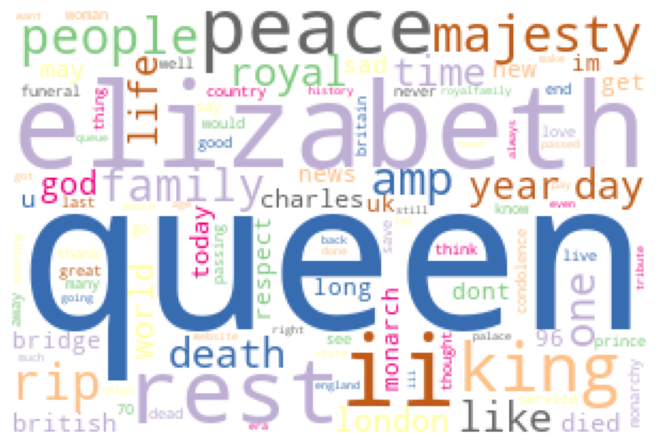

<Figure size 640x480 with 0 Axes>

In [208]:
# transform word_freq list to dictionary 
top_100_dic = dict((key, value) for key, value in top_100)

#Create Word Cloud of top 50 words
wordcloud = WordCloud(width = 300, height = 200,colormap = 'Accent', max_font_size=200, background_color = 'white').generate_from_frequencies(top_100_dic)

# plt.figure(figsize = (8, 12), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()


### 4.3Topic modeling: LDA Model 

The topics of all English tweets are extracted by LDA model, propessing based on the [corpus_hashtag_final.csv](https://github.com/Xiaoqi961/Twitter-Dataset-Analysis-Death-of-Queen-Elizabeth/blob/Text-Analysis-Output/corpus-hashtag-final.zip) file. 

In [75]:
# load the corpus_hashtag_final.csv file to initiate 

df_en_copy2 = pd.read_csv(r"D:\KU Leuven\Master thesis\Data analysis\Text Analysis\corpus-hashtag-final.csv")
df_en_copy2['tokens_lemma'] = df_en_copy2['tokens_lemma'].apply(str2lst)


In [76]:
# Create a id2word dictionary
word_id = Dictionary(df_en_copy2['tokens_lemma'] )
print(len(word_id))

# Filtering Extremes
word_id.filter_extremes(no_below=2,no_above = 0.9)
print(len(word_id))

#view integer mappings
word_id.token2id

173043
62020


{'abolishthemonarchynotmyking': 0,
 'account': 1,
 'antimonarchy': 2,
 'arrested': 3,
 'brightgrn': 4,
 'charlesiii': 5,
 'notmyking': 6,
 'opinion': 7,
 'oxford': 8,
 'publishing': 9,
 'thanks': 10,
 'today': 11,
 'voicing': 12,
 '1979': 13,
 'abolishthehouseoflords': 14,
 'abolishthemonarchy': 15,
 'capitalismkills': 16,
 'classwar': 17,
 'conservativeskill': 18,
 'electoralreformnow': 19,
 'government': 20,
 'hostile': 21,
 'redbirdel': 22,
 'since': 23,
 'weve': 24,
 'beckettunite': 25,
 'ceremony': 26,
 'ultimately': 27,
 'abolished': 28,
 'absolutely': 29,
 'event': 30,
 'historic': 31,
 'living': 32,
 'meanwhile': 33,
 'monarchy': 34,
 'royalist': 35,
 'scotland': 36,
 'see': 37,
 'sevillecalculat': 38,
 'someone': 39,
 'son': 40,
 'went': 41,
 'yes': 42,
 'young': 43,
 'along': 44,
 'britain': 45,
 'image': 46,
 'laying': 47,
 'national': 48,
 'never': 49,
 'queen': 50,
 'rest': 51,
 'sacred': 52,
 'ask': 53,
 'dare': 54,
 'head': 55,
 'peasant': 56,
 'question': 57,
 'state': 

In [77]:
# Creating a corpus object 
doc_term_matrix = [word_id.doc2bow(x) for x in df_en_copy2['tokens_lemma']]
doc_term_matrix

[[(0, 1),
  (1, 1),
  (2, 1),
  (3, 1),
  (4, 1),
  (5, 1),
  (6, 1),
  (7, 1),
  (8, 1),
  (9, 1),
  (10, 1),
  (11, 1),
  (12, 1)],
 [(13, 1),
  (14, 1),
  (15, 1),
  (16, 1),
  (17, 1),
  (18, 1),
  (19, 1),
  (20, 1),
  (21, 1),
  (22, 1),
  (23, 1),
  (24, 1)],
 [(15, 1), (25, 1), (26, 1), (27, 1)],
 [(6, 1),
  (15, 1),
  (28, 1),
  (29, 1),
  (30, 1),
  (31, 1),
  (32, 1),
  (33, 1),
  (34, 1),
  (35, 1),
  (36, 1),
  (37, 1),
  (38, 1),
  (39, 1),
  (40, 1),
  (41, 1),
  (42, 1),
  (43, 1)],
 [(15, 1),
  (44, 1),
  (45, 1),
  (46, 1),
  (47, 1),
  (48, 1),
  (49, 1),
  (50, 1),
  (51, 1),
  (52, 1)],
 [(15, 1),
  (53, 1),
  (54, 1),
  (55, 1),
  (56, 1),
  (57, 1),
  (58, 1),
  (59, 1),
  (60, 1)],
 [(15, 1),
  (47, 1),
  (50, 1),
  (58, 1),
  (61, 1),
  (62, 1),
  (63, 1),
  (64, 1),
  (65, 1),
  (66, 1),
  (67, 1),
  (68, 1),
  (69, 1),
  (70, 1),
  (71, 1),
  (72, 1),
  (73, 1),
  (74, 1)],
 [(15, 1), (26, 1), (27, 1), (75, 1)],
 [(15, 1),
  (76, 1),
  (77, 1),
  (78, 6),
  (

In [20]:
# Instantiating a Base LDA model 
base_model = LdaMulticore(corpus= doc_term_matrix, num_topics= 10, id2word= word_id,workers=12, random_state=1, passes=5) 

In [21]:
# Filtering for words 
words = [re.findall(r'"([^"]*)"',t[1]) for t in base_model.print_topics()]

In [22]:
# Create Topics
topics = [' '.join(t[0:10]) for t in words]

for id, t in enumerate(topics): 
    print(f"------ Topic {id} ------")
    print(t, end="\n\n")

------ Topic 0 ------
queenelizabeth queen elizabeth died ii 96 monarch palace year buckingham

------ Topic 1 ------
queenelizabeth queen rest peace elizabeth rip majesty ii may family

------ Topic 2 ------
queenelizabeth queen get queenelizabethii im like na know dont video

------ Topic 3 ------
queenelizabeth amp death people day british u family royal queen

------ Topic 4 ------
queenelizabeth queen london elizabeth queenelizabethii ii bridge funeral royalfamily coffin

------ Topic 5 ------
queenelizabeth god queen save queenelizabethii elizabeth king bless via beautiful

------ Topic 6 ------
abolishthemonarchy queenelizabeth launching monarchy notmyking people one meghan harry royal

------ Topic 7 ------
queenelizabeth king queen charles elizabeth kingcharlesiii new prince iii kingcharles

------ Topic 8 ------
queenelizabeth queen live people time like dead im long death

------ Topic 9 ------
queenelizabeth mechazilla crypto happen one thing website x queueforthequeen spac

In [23]:
#Creating Topic Distance Visualization 

import pyLDAvis.gensim
pyLDAvis.enable_notebook()
pyLDAvis.gensim.prepare(base_model, doc_term_matrix, word_id)
     

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1      0.156604 -0.055430       1        1  17.336262
8     -0.033386 -0.111224       2        1  14.157198
4      0.081006  0.047680       3        1  12.223384
3     -0.059901 -0.143824       4        1  12.145534
6     -0.161394 -0.158216       5        1  10.384465
0      0.201228  0.058233       6        1   8.166587
2     -0.120001  0.031801       7        1   8.026736
7      0.141474  0.062758       8        1   6.951136
5      0.026969  0.048397       9        1   5.781603
9     -0.232600  0.219826      10        1   4.827094, topic_info=           Term           Freq          Total Category  logprob  loglift
50        queen  129723.000000  129723.000000  Default  30.0000  30.0000
580        king   20664.000000   20664.000000  Default  29.0000  29.0000
51         rest   29415.000000   29415.000000  Default  28.0000  28.0000
2739      peace   25287.000000   25287.000000  Default  27.0000  27.0000
204   elizabeth   50460.000000   50460.000000  Default  26.0000  26.0000
...         ...            ...            ...      ...      ...      ...
1581      money     707.774848    2392.299583  Topic10  -5.5628   1.8130
897      tiktok     577.204206    1581.982469  Topic10  -5.7668   2.0227
315        want     635.744760    4319.107855  Topic10  -5.6702   1.1149
2963        nft     586.516664    2065.014345  Topic10  -5.7508   1.7722
165         get     614.695483    8235.616453  Topic10  -5.7038   0.4358

[839 rows x 6 columns], token_table=       Topic      Freq       Term
term                             
47610      9  0.996422    0023423
7573       5  0.992353         03
36923      3  0.975938         08
2579       1  0.011641          1
2579       2  0.014287          1
...      ...       ...        ...
38229      4  0.991180   جسر_لندن
48959      4  0.992327  قناة_الغد
50100      6  0.989090       ملکه
50565      1  0.990043          𓃰
16012      5  0.987304        𝐍𝐨𝐰

[3831 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 9, 5, 4, 7, 1, 3, 8, 6, 10])

In [24]:
# assign the topics to each tweet 
count = 0 
for i in base_model[doc_term_matrix]:
    print("tweet:", count+1, i)
    count += 1

tweet :  1 [(4, 0.22059341), (6, 0.61801326), (9, 0.10996884)]
tweet :  2 [(4, 0.064184815), (6, 0.72896737), (8, 0.15235457)]
tweet :  3 [(0, 0.02001503), (1, 0.020014824), (2, 0.020015294), (3, 0.02001735), (4, 0.020018779), (5, 0.020019528), (6, 0.8198503), (7, 0.020018706), (8, 0.020015264), (9, 0.0200149)]
tweet :  4 [(3, 0.2181407), (6, 0.6553559), (7, 0.08759387)]
tweet :  5 [(1, 0.24758673), (4, 0.53054094), (6, 0.15818436)]
tweet :  6 [(0, 0.010003294), (1, 0.010002995), (2, 0.010003251), (3, 0.010004764), (4, 0.01000534), (5, 0.010003236), (6, 0.90996516), (7, 0.0100031085), (8, 0.010004664), (9, 0.010004209)]
tweet :  7 [(4, 0.44808432), (6, 0.20382233), (8, 0.31115115)]
tweet :  8 [(0, 0.020057881), (1, 0.020057665), (2, 0.020058138), (3, 0.02006021), (4, 0.020061646), (5, 0.02006413), (6, 0.81946295), (7, 0.020061474), (8, 0.020058107), (9, 0.020057743)]
tweet :  9 [(3, 0.5619906), (6, 0.35792598), (9, 0.052048344)]
tweet :  10 [(0, 0.011114376), (1, 0.011114684), (2, 0.01

tweet :  431 [(6, 0.63025284), (8, 0.33629042)]
tweet :  432 [(0, 0.025054466), (1, 0.025054483), (2, 0.025054736), (3, 0.025054602), (4, 0.025057353), (5, 0.025054967), (6, 0.7745047), (7, 0.025054669), (8, 0.025055414), (9, 0.02505457)]
tweet :  433 [(0, 0.0100051835), (1, 0.010006384), (2, 0.01000849), (3, 0.010011511), (4, 0.010006425), (5, 0.010005856), (6, 0.90993565), (7, 0.010005656), (8, 0.010008542), (9, 0.010006334)]
tweet :  434 [(0, 0.010005251), (1, 0.010006233), (2, 0.010007463), (3, 0.010006938), (4, 0.010006634), (5, 0.010006323), (6, 0.9099335), (7, 0.010009282), (8, 0.010011157), (9, 0.010007231)]
tweet :  435 [(0, 0.06671996), (4, 0.27531734), (6, 0.62445337)]
tweet :  436 [(0, 0.010005886), (1, 0.010010448), (2, 0.010006249), (3, 0.010008071), (4, 0.010006094), (5, 0.010006757), (6, 0.9099373), (7, 0.010005871), (8, 0.010007468), (9, 0.01000579)]
tweet :  437 [(0, 0.01430426), (1, 0.014307256), (2, 0.014306088), (3, 0.014310614), (4, 0.014305976), (5, 0.014305063),

tweet :  804 [(3, 0.075005665), (4, 0.8845421)]
tweet :  805 [(0, 0.01251724), (1, 0.012518653), (2, 0.0125172455), (3, 0.8873284), (4, 0.012517551), (5, 0.012518374), (6, 0.012516848), (7, 0.012517233), (8, 0.012518551), (9, 0.012529896)]
tweet :  806 [(1, 0.14898767), (4, 0.25752765), (6, 0.32054722), (8, 0.22673485)]
tweet :  807 [(0, 0.07725665), (1, 0.227518), (3, 0.15062022), (5, 0.5068736)]
tweet :  808 [(0, 0.01667281), (1, 0.016678555), (2, 0.01667592), (3, 0.016673315), (4, 0.016679298), (5, 0.016675023), (6, 0.01667252), (7, 0.016673636), (8, 0.8499293), (9, 0.016669655)]
tweet :  809 [(1, 0.9307253)]
tweet :  810 [(1, 0.19591624), (3, 0.38493118), (4, 0.38715315)]
tweet :  811 [(0, 0.03333814), (1, 0.69996005), (2, 0.03333889), (3, 0.03333687), (4, 0.03333767), (5, 0.033340853), (6, 0.033335205), (7, 0.033337925), (8, 0.033337925), (9, 0.03333644)]
tweet :  812 [(0, 0.20091169), (1, 0.7683136)]
tweet :  813 [(0, 0.011112941), (1, 0.89998394), (2, 0.011113163), (3, 0.0111128

tweet :  1195 [(1, 0.49353495), (4, 0.22396626), (6, 0.23863967)]
tweet :  1196 [(1, 0.1176116), (4, 0.4422889), (7, 0.057352457), (8, 0.35831764)]
tweet :  1197 [(0, 0.012525852), (1, 0.012527328), (2, 0.0125263985), (3, 0.01252809), (4, 0.012533317), (5, 0.012526545), (6, 0.01252623), (7, 0.012526239), (8, 0.88725436), (9, 0.012525601)]
tweet :  1198 [(0, 0.11268982), (4, 0.4628862), (5, 0.18922678), (9, 0.19216032)]
tweet :  1199 [(0, 0.010009556), (1, 0.27274737), (2, 0.010008885), (3, 0.010008812), (4, 0.6471812), (5, 0.0100089125), (6, 0.010008405), (7, 0.010008947), (8, 0.010009388), (9, 0.010008432)]
tweet :  1200 [(1, 0.65988207), (3, 0.30200255)]
tweet :  1201 [(0, 0.012522756), (1, 0.012523874), (2, 0.012523806), (3, 0.012526297), (4, 0.012530619), (5, 0.8872762), (6, 0.012524117), (7, 0.012523261), (8, 0.012526158), (9, 0.012522919)]
tweet :  1202 [(3, 0.42470315), (5, 0.4027037), (6, 0.1186862)]
tweet :  1203 [(0, 0.012512459), (1, 0.012513655), (2, 0.012514794), (3, 0.012

tweet :  1601 [(4, 0.107073374), (9, 0.8595431)]
tweet :  1602 [(3, 0.33754727), (4, 0.117197484), (6, 0.51606625)]
tweet :  1603 [(1, 0.8738473), (2, 0.08803514)]
tweet :  1604 [(0, 0.016674107), (1, 0.64528096), (2, 0.01667424), (3, 0.016673982), (4, 0.01667371), (5, 0.22132798), (6, 0.016673427), (7, 0.0166738), (8, 0.01667432), (9, 0.016673459)]
tweet :  1605 [(0, 0.020011336), (1, 0.020007614), (2, 0.020012468), (3, 0.8199144), (4, 0.020010192), (5, 0.02000786), (6, 0.020008525), (7, 0.02000794), (8, 0.02000957), (9, 0.020010065)]
tweet :  1606 [(4, 0.65876293), (8, 0.30639684)]
tweet :  1607 [(0, 0.14407101), (3, 0.42423576), (5, 0.1522913), (9, 0.2327738)]
tweet :  1608 [(2, 0.13357134), (4, 0.8343761)]
tweet :  1609 [(0, 0.010006792), (1, 0.01000863), (2, 0.010006979), (3, 0.7996645), (4, 0.010007207), (5, 0.010006896), (6, 0.010008172), (7, 0.010007071), (8, 0.01000804), (9, 0.12027573)]
tweet :  1610 [(3, 0.30084068), (4, 0.66711986)]
tweet :  1611 [(2, 0.44886738), (3, 0.243

tweet :  2015 [(0, 0.014288842), (1, 0.014290746), (2, 0.014289664), (3, 0.014290647), (4, 0.87138003), (5, 0.0142894145), (6, 0.014290241), (7, 0.014293899), (8, 0.01429122), (9, 0.014295273)]
tweet :  2016 [(1, 0.25573573), (3, 0.25118858), (4, 0.44636887)]
tweet :  2017 [(4, 0.6517736), (8, 0.30112922)]
tweet :  2018 [(0, 0.66636854), (2, 0.086824745), (9, 0.22080974)]
tweet :  2019 [(0, 0.011134648), (1, 0.011134841), (2, 0.77338034), (3, 0.011136261), (4, 0.13753316), (5, 0.011136164), (6, 0.011136084), (7, 0.011135216), (8, 0.011138009), (9, 0.011135275)]
tweet :  2020 [(0, 0.74173987), (9, 0.21808353)]
tweet :  2021 [(3, 0.118584335), (4, 0.6114025), (8, 0.23093016)]
tweet :  2022 [(1, 0.072236516), (2, 0.06325132), (3, 0.38738543), (4, 0.3606668), (7, 0.032203067), (9, 0.066022076)]
tweet :  2023 [(3, 0.28547955), (7, 0.062104348), (8, 0.343167), (9, 0.2617204)]
tweet :  2024 [(0, 0.025018552), (1, 0.025018893), (2, 0.3166918), (3, 0.025019903), (4, 0.48314464), (5, 0.025018862

tweet :  2472 [(3, 0.47278506), (6, 0.32876328), (9, 0.15690994)]
tweet :  2473 [(0, 0.053727407), (1, 0.096428476), (3, 0.4121959), (6, 0.14117344), (8, 0.272372)]
tweet :  2474 [(4, 0.74585736), (9, 0.21459343)]
tweet :  2475 [(0, 0.01667101), (1, 0.8499389), (2, 0.01667249), (3, 0.016671132), (4, 0.016676318), (5, 0.016675986), (6, 0.016671622), (7, 0.01667274), (8, 0.016678622), (9, 0.016671149)]
tweet :  2476 [(0, 0.0142947445), (1, 0.014296193), (2, 0.014295046), (3, 0.014294547), (4, 0.014300347), (5, 0.57350385), (6, 0.014294083), (7, 0.01429495), (8, 0.014294263), (9, 0.31213197)]
tweet :  2477 [(5, 0.054638036), (6, 0.24664125), (7, 0.5265388), (9, 0.14783788)]
tweet :  2478 [(0, 0.011174266), (1, 0.011185048), (2, 0.011173878), (3, 0.18947929), (4, 0.011173043), (5, 0.011173243), (6, 0.011176562), (7, 0.0111735165), (8, 0.721118), (9, 0.011173158)]
tweet :  2479 [(3, 0.11248315), (8, 0.53764105), (9, 0.3147612)]
tweet :  2480 [(0, 0.48146707), (2, 0.078843996), (6, 0.3807399

tweet :  2839 [(1, 0.7714646), (4, 0.09541949), (6, 0.07904125)]
tweet :  2840 [(1, 0.7274382), (4, 0.123168476), (7, 0.11040848)]
tweet :  2841 [(4, 0.597799), (7, 0.36815315)]
tweet :  2842 [(3, 0.4094337), (8, 0.5555333)]
tweet :  2843 [(1, 0.13583049), (3, 0.38533148), (9, 0.43200704)]
tweet :  2844 [(0, 0.57488173), (1, 0.014305399), (2, 0.014301852), (3, 0.014304584), (4, 0.014304999), (5, 0.014302962), (6, 0.014304072), (7, 0.0143092135), (8, 0.014304928), (9, 0.31068024)]
tweet :  2845 [(2, 0.119080804), (3, 0.22797018), (4, 0.62565154)]
tweet :  2846 [(0, 0.0127074905), (1, 0.012708204), (2, 0.012707111), (3, 0.0127085615), (4, 0.6586351), (5, 0.23970379), (6, 0.012706062), (7, 0.01270732), (8, 0.01270986), (9, 0.0127065005)]
tweet :  2847 [(0, 0.011116936), (1, 0.50748694), (2, 0.011116323), (3, 0.40357506), (4, 0.011119207), (5, 0.011117623), (6, 0.011116316), (7, 0.011117391), (8, 0.011118273), (9, 0.011115881)]
tweet :  2848 [(1, 0.17229442), (4, 0.6851017), (9, 0.08862929

tweet :  3206 [(1, 0.6969057), (4, 0.25864285)]
tweet :  3207 [(8, 0.92496675)]
tweet :  3208 [(0, 0.011131056), (1, 0.73834825), (2, 0.011131342), (3, 0.011130664), (4, 0.17260619), (5, 0.011132498), (6, 0.011128728), (7, 0.011130864), (8, 0.011131081), (9, 0.011129368)]
tweet :  3209 [(0, 0.016667778), (1, 0.016667698), (2, 0.016668169), (3, 0.016669665), (4, 0.8499854), (5, 0.016668012), (6, 0.016668277), (7, 0.016668044), (8, 0.016668852), (9, 0.016668094)]
tweet :  3210 [(1, 0.9608592)]
tweet :  3211 [(1, 0.1736824), (5, 0.19151446), (8, 0.6014111)]
tweet :  3212 [(1, 0.3806943), (3, 0.45177662), (5, 0.13706043)]
tweet :  3213 [(2, 0.0703924), (4, 0.7527769), (9, 0.14880091)]
tweet :  3214 [(1, 0.19484477), (3, 0.4637889), (4, 0.31330252)]
tweet :  3215 [(2, 0.3719736), (4, 0.43055886), (5, 0.16228476)]
tweet :  3216 [(2, 0.41949275), (4, 0.51826024)]
tweet :  3217 [(1, 0.2530164), (4, 0.62630713), (7, 0.08368571)]
tweet :  3218 [(1, 0.27184582), (4, 0.6666003)]
tweet :  3219 [(6,

tweet :  3594 [(1, 0.5382129), (4, 0.41113174)]
tweet :  3595 [(4, 0.8703336), (8, 0.09435657)]
tweet :  3596 [(0, 0.24518955), (2, 0.059159875), (4, 0.6395072), (8, 0.028668974)]
tweet :  3597 [(0, 0.14788374), (2, 0.10651041), (4, 0.6955803)]
tweet :  3598 [(1, 0.6295667), (4, 0.317077)]
tweet :  3599 [(0, 0.01255253), (1, 0.33907402), (2, 0.012552984), (3, 0.18519548), (4, 0.012552346), (5, 0.012553065), (6, 0.19976847), (7, 0.012554549), (8, 0.20064406), (9, 0.012552523)]
tweet :  3600 [(0, 0.012503491), (1, 0.7390391), (2, 0.012503348), (3, 0.0125032365), (4, 0.16092314), (5, 0.012504192), (6, 0.012502901), (7, 0.012507804), (8, 0.012509865), (9, 0.0125029385)]
tweet :  3601 [(4, 0.52888376), (7, 0.20266588), (9, 0.22947964)]
tweet :  3602 [(0, 0.06534589), (4, 0.39930713), (5, 0.49842435)]
tweet :  3603 [(4, 0.22596455), (6, 0.27335846), (7, 0.47148868)]
tweet :  3604 [(1, 0.5954143), (4, 0.20276468), (7, 0.14908084)]
tweet :  3605 [(0, 0.033358715), (1, 0.03336083), (2, 0.699776

tweet :  4000 [(1, 0.4220014), (8, 0.425431), (9, 0.11679016)]
tweet :  4001 [(0, 0.01111738), (1, 0.25793678), (2, 0.011115904), (3, 0.01111609), (4, 0.65313846), (5, 0.011114302), (6, 0.0111146), (7, 0.011114121), (8, 0.011115165), (9, 0.011117214)]
tweet :  4002 [(0, 0.16458075), (1, 0.0125207035), (2, 0.0125213405), (3, 0.5857922), (4, 0.012520257), (5, 0.012520881), (6, 0.0125235235), (7, 0.012522182), (8, 0.012522075), (9, 0.16197611)]
tweet :  4003 [(3, 0.376315), (8, 0.5621141)]
tweet :  4004 [(0, 0.011143141), (1, 0.011144633), (2, 0.011144078), (3, 0.011146503), (4, 0.8996987), (5, 0.011144142), (6, 0.011144265), (7, 0.011142222), (8, 0.011148463), (9, 0.011143843)]
tweet :  4005 [(1, 0.16182335), (6, 0.57110345), (9, 0.20340338)]
tweet :  4006 [(7, 0.94702584)]
tweet :  4007 [(2, 0.3344903), (5, 0.42035693), (9, 0.18148483)]
tweet :  4008 [(0, 0.1131985), (4, 0.7534052), (5, 0.078903794)]
tweet :  4009 [(3, 0.6583833), (5, 0.105952434), (9, 0.18177906)]
tweet :  4010 [(1, 0.

tweet :  4316 [(0, 0.014300963), (1, 0.014302022), (2, 0.014302668), (3, 0.014301053), (4, 0.014302747), (5, 0.32186288), (6, 0.3465984), (7, 0.014301185), (8, 0.23142739), (9, 0.014300741)]
tweet :  4317 [(1, 0.103151634), (4, 0.63617957), (8, 0.21396226)]
tweet :  4318 [(0, 0.025007777), (1, 0.025010142), (2, 0.025015099), (3, 0.025009254), (4, 0.7749179), (5, 0.025009789), (6, 0.025006294), (7, 0.02500835), (8, 0.025008753), (9, 0.02500663)]
tweet :  4319 [(0, 0.010007712), (1, 0.010009672), (2, 0.40888202), (3, 0.010009889), (4, 0.3565014), (5, 0.010011257), (6, 0.010010612), (7, 0.16454874), (8, 0.010010124), (9, 0.010008533)]
tweet :  4320 [(4, 0.16391627), (7, 0.76332515)]
tweet :  4321 [(2, 0.1292575), (4, 0.15697674), (6, 0.66963476)]
tweet :  4322 [(0, 0.24770042), (4, 0.40636286), (6, 0.13571233), (7, 0.16732016)]
tweet :  4323 [(4, 0.63549864), (7, 0.21884479), (9, 0.1066023)]
tweet :  4324 [(0, 0.0105347335), (1, 0.128513), (2, 0.010529286), (3, 0.41886586), (4, 0.01052773

tweet :  4679 [(0, 0.016799837), (1, 0.016800493), (2, 0.016800947), (3, 0.58650595), (4, 0.016803863), (5, 0.016801666), (6, 0.01679974), (7, 0.27908573), (8, 0.01680007), (9, 0.01680167)]
tweet :  4680 [(0, 0.0125021115), (1, 0.012502066), (2, 0.01250197), (3, 0.012508387), (4, 0.887477), (5, 0.012502112), (6, 0.012501207), (7, 0.012502007), (8, 0.012501633), (9, 0.012501568)]
tweet :  4681 [(3, 0.53249425), (4, 0.15871567), (5, 0.10026199), (7, 0.1811159)]
tweet :  4682 [(4, 0.3805257), (6, 0.18974994), (7, 0.10150554), (9, 0.3041585)]
tweet :  4683 [(0, 0.055349775), (1, 0.14969839), (4, 0.5528369), (8, 0.15689343), (9, 0.05851493)]
tweet :  4684 [(0, 0.010399839), (1, 0.010399241), (2, 0.010398444), (3, 0.010400904), (4, 0.7514399), (5, 0.010401412), (6, 0.010398363), (7, 0.16536462), (8, 0.010398914), (9, 0.010398377)]
tweet :  4685 [(7, 0.91805923)]
tweet :  4686 [(5, 0.9470267)]
tweet :  4687 [(0, 0.2555554), (7, 0.6708943)]
tweet :  4688 [(4, 0.9356805)]
tweet :  4689 [(1, 0.4

tweet :  5058 [(3, 0.22189456), (4, 0.31190622), (7, 0.4401663)]
tweet :  5059 [(2, 0.2263225), (4, 0.60149354), (6, 0.13513564)]
tweet :  5060 [(4, 0.9470079)]
tweet :  5061 [(4, 0.9436636)]
tweet :  5062 [(7, 0.9499605)]
tweet :  5063 [(0, 0.11549976), (1, 0.010032919), (2, 0.4342721), (3, 0.0100335), (4, 0.010033408), (5, 0.010033457), (6, 0.0100335665), (7, 0.37999433), (8, 0.010034283), (9, 0.010032631)]
tweet :  5064 [(1, 0.5837312), (4, 0.36919072)]
tweet :  5065 [(4, 0.9129545), (9, 0.056159317)]
tweet :  5066 [(0, 0.13702892), (4, 0.23869766), (6, 0.20033388), (8, 0.37757838)]
tweet :  5067 [(0, 0.11937784), (3, 0.50649464), (6, 0.33899754)]
tweet :  5068 [(6, 0.59511757), (7, 0.34678715)]
tweet :  5069 [(0, 0.014466281), (1, 0.014468468), (2, 0.0144664), (3, 0.49411377), (4, 0.0144711025), (5, 0.39014554), (6, 0.014466739), (7, 0.014467188), (8, 0.014468784), (9, 0.0144657465)]
tweet :  5070 [(0, 0.011126309), (1, 0.011117647), (2, 0.011118146), (3, 0.011118761), (4, 0.011118

tweet :  5465 [(2, 0.44493505), (4, 0.48220968)]
tweet :  5466 [(0, 0.050742585), (2, 0.08930914), (3, 0.2635903), (6, 0.45962384), (9, 0.115434654)]
tweet :  5467 [(3, 0.25762218), (6, 0.36192843), (7, 0.27572006), (9, 0.07855951)]
tweet :  5468 [(4, 0.24002211), (8, 0.6214409), (9, 0.108032934)]
tweet :  5469 [(0, 0.025006048), (1, 0.025008103), (2, 0.025005879), (3, 0.02500653), (4, 0.29141572), (5, 0.025004642), (6, 0.02500606), (7, 0.025006317), (8, 0.025014171), (9, 0.50852656)]
tweet :  5470 [(4, 0.516894), (6, 0.41589567)]
tweet :  5471 [(3, 0.12809122), (4, 0.20607239), (6, 0.10362747), (8, 0.5358888)]
tweet :  5472 [(1, 0.14441621), (3, 0.5789156), (6, 0.22997338)]
tweet :  5473 [(4, 0.5658176), (7, 0.4006912)]
tweet :  5474 [(1, 0.25660422), (4, 0.6989029)]
tweet :  5475 [(4, 0.6544134), (9, 0.27279672)]
tweet :  5476 [(9, 0.9179176)]
tweet :  5477 [(4, 0.528427), (8, 0.40487736)]
tweet :  5478 [(0, 0.14519961), (5, 0.27245688), (7, 0.5454667)]
tweet :  5479 [(3, 0.36311), (

tweet :  5841 [(0, 0.020005168), (1, 0.02000852), (2, 0.8199273), (3, 0.020007066), (4, 0.02001865), (5, 0.020006932), (6, 0.020004926), (7, 0.020005807), (8, 0.020007523), (9, 0.020008117)]
tweet :  5842 [(2, 0.40260214), (4, 0.48868665), (8, 0.07182266)]
tweet :  5843 [(0, 0.20111634), (1, 0.014302626), (2, 0.014304292), (3, 0.014306853), (4, 0.014307916), (5, 0.0143033), (6, 0.014306473), (7, 0.014304101), (8, 0.014307428), (9, 0.6844407)]
tweet :  5844 [(0, 0.0142887095), (1, 0.87139344), (2, 0.014291191), (3, 0.014290207), (4, 0.014288997), (5, 0.014288673), (6, 0.014290248), (7, 0.0142883025), (8, 0.014291891), (9, 0.014288301)]
tweet :  5845 [(0, 0.18034169), (2, 0.1460694), (3, 0.23573399), (6, 0.22987987), (7, 0.18281206)]
tweet :  5846 [(2, 0.112507604), (3, 0.098875135), (4, 0.38594863), (5, 0.094882645), (8, 0.22626688), (9, 0.06761781)]
tweet :  5847 [(2, 0.32316428), (3, 0.08796399), (4, 0.18991058), (6, 0.17456716), (8, 0.20037425)]
tweet :  5848 [(2, 0.27498332), (6, 0.

tweet :  6234 [(3, 0.45721576), (7, 0.38881832), (9, 0.12792344)]
tweet :  6235 [(1, 0.803158), (5, 0.12399714)]
tweet :  6236 [(1, 0.803146), (5, 0.12400897)]
tweet :  6237 [(5, 0.9608608)]
tweet :  6238 [(0, 0.3067112), (4, 0.46325633), (5, 0.18876149)]
tweet :  6239 [(0, 0.2639571), (4, 0.46537894), (9, 0.24147896)]
tweet :  6240 [(1, 0.07071927), (3, 0.89287573)]
tweet :  6241 [(3, 0.10572008), (4, 0.4550997), (7, 0.07606329), (8, 0.3379334)]
tweet :  6242 [(5, 0.9608608)]
tweet :  6243 [(4, 0.49933648), (8, 0.46007672)]
tweet :  6244 [(6, 0.6928175), (8, 0.2775217)]
tweet :  6245 [(1, 0.51377726), (8, 0.41951403)]
tweet :  6246 [(0, 0.102049455), (5, 0.4752323), (8, 0.38144004)]
tweet :  6247 [(0, 0.016680833), (1, 0.016681544), (2, 0.016684197), (3, 0.01668585), (4, 0.01668308), (5, 0.016682763), (6, 0.016687775), (7, 0.016686838), (8, 0.016690489), (9, 0.84983665)]
tweet :  6248 [(0, 0.11739076), (3, 0.43265277), (9, 0.41649213)]
tweet :  6249 [(0, 0.011168606), (1, 0.011168452)

tweet :  6671 [(1, 0.68635386), (5, 0.19384956), (7, 0.07859148)]
tweet :  6672 [(4, 0.84004664), (7, 0.091804)]
tweet :  6673 [(0, 0.014288025), (1, 0.014287072), (2, 0.014288446), (3, 0.014288125), (4, 0.87138945), (5, 0.01428788), (6, 0.014287865), (7, 0.014306773), (8, 0.014288763), (9, 0.014287559)]
tweet :  6674 [(1, 0.23846973), (3, 0.32316124), (4, 0.39709973)]
tweet :  6675 [(0, 0.025017058), (1, 0.025018068), (2, 0.025021076), (3, 0.025022762), (4, 0.77483076), (5, 0.025024835), (6, 0.025015606), (7, 0.025016937), (8, 0.025017284), (9, 0.025015654)]
tweet :  6676 [(5, 0.7085694), (8, 0.25322783)]
tweet :  6677 [(4, 0.3828221), (7, 0.5771667)]
tweet :  6678 [(1, 0.7752128), (8, 0.16761266)]
tweet :  6679 [(0, 0.010006592), (1, 0.43447536), (2, 0.01000692), (3, 0.010006577), (4, 0.2928282), (5, 0.2026492), (6, 0.010007156), (7, 0.010006517), (8, 0.010007057), (9, 0.010006384)]
tweet :  6680 [(1, 0.79281753), (8, 0.14560449)]
tweet :  6681 [(3, 0.6563955), (5, 0.1598048), (8, 0.

tweet :  7073 [(0, 0.010004343), (1, 0.010009035), (2, 0.010004741), (3, 0.010005899), (4, 0.01000814), (5, 0.9099429), (6, 0.010007341), (7, 0.010005368), (8, 0.010007542), (9, 0.01000466)]
tweet :  7074 [(4, 0.5302505), (6, 0.123739675), (7, 0.057839412), (8, 0.2478577)]
tweet :  7075 [(0, 0.0111349635), (1, 0.011134246), (2, 0.21755596), (3, 0.011136846), (4, 0.12872002), (5, 0.57576966), (6, 0.011136786), (7, 0.011141573), (8, 0.011135022), (9, 0.0111349)]
tweet :  7076 [(0, 0.4312596), (7, 0.17232744), (8, 0.35243905)]
tweet :  7077 [(2, 0.9608442)]
tweet :  7078 [(4, 0.8097112), (5, 0.15546592)]
tweet :  7079 [(0, 0.6560586), (2, 0.14157136), (7, 0.17977127)]
tweet :  7080 [(1, 0.5624337), (2, 0.38038206)]
tweet :  7081 [(3, 0.15389061), (6, 0.45876914), (8, 0.34353766)]
tweet :  7082 [(0, 0.014301966), (1, 0.014302303), (2, 0.014309438), (3, 0.014301113), (4, 0.014302537), (5, 0.5827093), (6, 0.01430676), (7, 0.3028557), (8, 0.0143078305), (9, 0.014302994)]
tweet :  7083 [(0, 0.

tweet :  7483 [(1, 0.35252064), (3, 0.4621589), (5, 0.13118348)]
tweet :  7484 [(1, 0.87605035), (2, 0.08912207)]
tweet :  7485 [(1, 0.14838082), (8, 0.8147312)]
tweet :  7486 [(0, 0.41935122), (4, 0.15628292), (7, 0.37400225)]
tweet :  7487 [(0, 0.8872291), (1, 0.012530976), (2, 0.012532106), (3, 0.012531678), (4, 0.012529317), (5, 0.01253158), (6, 0.012529103), (7, 0.012528688), (8, 0.012528737), (9, 0.012528777)]
tweet :  7488 [(4, 0.9526015)]
tweet :  7489 [(0, 0.011130635), (1, 0.3518259), (2, 0.011128952), (3, 0.011131701), (4, 0.011127918), (5, 0.18166265), (6, 0.01112738), (7, 0.011127775), (8, 0.38861004), (9, 0.011127037)]
tweet :  7490 [(3, 0.09197219), (4, 0.8679688)]
tweet :  7491 [(4, 0.13825738), (8, 0.7889785)]
tweet :  7492 [(1, 0.349035), (4, 0.2345007), (7, 0.10151098), (8, 0.26479816)]
tweet :  7493 [(4, 0.8728495), (8, 0.07378086)]
tweet :  7494 [(0, 0.025002243), (1, 0.77498305), (2, 0.025002347), (3, 0.02500156), (4, 0.025001943), (5, 0.025002562), (6, 0.02500080

tweet :  7926 [(2, 0.9399583)]
tweet :  7927 [(0, 0.011115948), (1, 0.011116758), (2, 0.011116097), (3, 0.011117659), (4, 0.8999518), (5, 0.011116663), (6, 0.011116065), (7, 0.011116179), (8, 0.011116598), (9, 0.011116265)]
tweet :  7928 [(1, 0.053262062), (3, 0.7675295), (5, 0.055261713), (6, 0.10231984)]
tweet :  7929 [(1, 0.5876779), (4, 0.3623156)]
tweet :  7930 [(4, 0.06717152), (9, 0.90062135)]
tweet :  7931 [(0, 0.016675932), (1, 0.33998433), (2, 0.3665908), (3, 0.016676707), (4, 0.01667953), (5, 0.17668483), (6, 0.016676402), (7, 0.0166762), (8, 0.016678344), (9, 0.016676914)]
tweet :  7932 [(0, 0.16967234), (4, 0.7922217)]
tweet :  7933 [(0, 0.010003776), (1, 0.1064949), (2, 0.010005079), (3, 0.010004411), (4, 0.43852267), (5, 0.010005179), (6, 0.0100053195), (7, 0.010004516), (8, 0.38494864), (9, 0.010005459)]
tweet :  7934 [(0, 0.010009296), (1, 0.010006937), (2, 0.010006261), (3, 0.01000485), (4, 0.3276467), (5, 0.010006521), (6, 0.010005477), (7, 0.15302669), (8, 0.4492827

tweet :  8351 [(0, 0.3802908), (3, 0.5846341)]
tweet :  8352 [(0, 0.0100412825), (1, 0.010041815), (2, 0.010041693), (3, 0.0100441035), (4, 0.7725298), (5, 0.010042946), (6, 0.010041219), (7, 0.1471302), (8, 0.01004323), (9, 0.010043721)]
tweet :  8353 [(0, 0.08104641), (4, 0.449191), (5, 0.43080303)]
tweet :  8354 [(4, 0.9356787)]
tweet :  8355 [(4, 0.9524643)]
tweet :  8356 [(2, 0.27163252), (3, 0.69354093)]
tweet :  8357 [(0, 0.22225022), (4, 0.73326385)]
tweet :  8358 [(4, 0.94697016)]
tweet :  8359 [(2, 0.37492415), (9, 0.58695716)]
tweet :  8360 [(2, 0.95903724)]
tweet :  8361 [(0, 0.012508168), (1, 0.24888252), (2, 0.012507526), (3, 0.012505574), (4, 0.6510659), (5, 0.012506504), (6, 0.012505458), (7, 0.012507272), (8, 0.012505964), (9, 0.012505084)]
tweet :  8362 [(3, 0.1257683), (6, 0.8014592)]
tweet :  8363 [(2, 0.07705763), (4, 0.86947715)]
tweet :  8364 [(0, 0.010017184), (1, 0.010020363), (2, 0.14235939), (3, 0.010019689), (4, 0.777495), (5, 0.01001785), (6, 0.010018087), 

tweet :  8751 [(0, 0.011113664), (1, 0.011115757), (2, 0.13076714), (3, 0.011114278), (4, 0.78031546), (5, 0.0111149), (6, 0.011113397), (7, 0.011113489), (8, 0.011115813), (9, 0.011116138)]
tweet :  8752 [(0, 0.02501498), (1, 0.02501696), (2, 0.025018003), (3, 0.426802), (4, 0.02501493), (5, 0.02501701), (6, 0.025019728), (7, 0.3730613), (8, 0.025020083), (9, 0.025014983)]
tweet :  8753 [(4, 0.64189154), (6, 0.31998435)]
tweet :  8754 [(0, 0.090533085), (1, 0.47645912), (4, 0.3829916)]
tweet :  8755 [(0, 0.2298649), (1, 0.012628674), (2, 0.18741761), (3, 0.012626492), (4, 0.49432486), (5, 0.012629057), (6, 0.012626218), (7, 0.012627937), (8, 0.012627175), (9, 0.012627085)]
tweet :  8756 [(5, 0.6937573), (6, 0.24870418)]
tweet :  8757 [(6, 0.47822425), (7, 0.3707666), (9, 0.12055718)]
tweet :  8758 [(3, 0.067021035), (7, 0.86460376)]
tweet :  8759 [(0, 0.0111165475), (1, 0.22012042), (2, 0.011116652), (3, 0.011116116), (4, 0.0111172795), (5, 0.69094497), (6, 0.011116261), (7, 0.0111170

tweet :  9134 [(0, 0.40237203), (4, 0.45410156), (5, 0.096834816)]
tweet :  9135 [(0, 0.102720566), (1, 0.84389824)]
tweet :  9136 [(0, 0.010008762), (1, 0.37778094), (2, 0.010006261), (3, 0.010005977), (4, 0.5421652), (5, 0.010006399), (6, 0.010005454), (7, 0.010009982), (8, 0.010005822), (9, 0.010005153)]
tweet :  9137 [(0, 0.08018065), (1, 0.88781095)]
tweet :  9138 [(1, 0.5223359), (3, 0.42032272)]
tweet :  9139 [(3, 0.9499166)]
tweet :  9140 [(0, 0.109918304), (4, 0.4830953), (5, 0.1510048), (8, 0.21587224)]
tweet :  9141 [(1, 0.94998366)]
tweet :  9142 [(1, 0.8463008), (3, 0.10661623)]
tweet :  9143 [(0, 0.011114936), (1, 0.011117259), (2, 0.011112535), (3, 0.0111121405), (4, 0.89997786), (5, 0.011114248), (6, 0.011111968), (7, 0.011114054), (8, 0.011112787), (9, 0.011112139)]
tweet :  9144 [(1, 0.68662345), (8, 0.27675778)]
tweet :  9145 [(1, 0.42764312), (5, 0.49960485)]
tweet :  9146 [(0, 0.014288665), (1, 0.87139624), (2, 0.014289182), (3, 0.014287294), (4, 0.014293013), (5, 

tweet :  9570 [(3, 0.12348869), (4, 0.6826658), (5, 0.09559516), (9, 0.0750894)]
tweet :  9571 [(2, 0.20740238), (4, 0.7309514)]
tweet :  9572 [(0, 0.0111142), (1, 0.8999696), (2, 0.0111142285), (3, 0.011113777), (4, 0.0111159505), (5, 0.011116162), (6, 0.011113617), (7, 0.011114281), (8, 0.011114098), (9, 0.011114111)]
tweet :  9573 [(0, 0.012504809), (1, 0.6889972), (2, 0.012502374), (3, 0.01250216), (4, 0.21097782), (5, 0.012504805), (6, 0.012501863), (7, 0.0125042), (8, 0.012502794), (9, 0.012501958)]
tweet :  9574 [(3, 0.39643028), (8, 0.561353)]
tweet :  9575 [(4, 0.22887105), (8, 0.71773744)]
tweet :  9576 [(3, 0.38502395), (4, 0.5648757)]
tweet :  9577 [(0, 0.012528394), (1, 0.012529228), (2, 0.012528904), (3, 0.012530337), (4, 0.012531777), (5, 0.50486743), (6, 0.012529547), (7, 0.19089577), (8, 0.012529896), (9, 0.21652876)]
tweet :  9578 [(1, 0.4155488), (4, 0.45517445), (9, 0.079246104)]
tweet :  9579 [(0, 0.012555325), (1, 0.012555366), (2, 0.012559886), (3, 0.012555208), 

tweet :  10025 [(4, 0.9624828)]
tweet :  10026 [(0, 0.17677295), (4, 0.677717), (9, 0.091650784)]
tweet :  10027 [(0, 0.011114762), (1, 0.89996827), (2, 0.011114491), (3, 0.011114279), (4, 0.011115668), (5, 0.01111489), (6, 0.011114218), (7, 0.011114558), (8, 0.011114625), (9, 0.011114237)]
tweet :  10028 [(1, 0.14820567), (4, 0.8096694)]
tweet :  10029 [(0, 0.15366818), (1, 0.7481398), (9, 0.0629293)]
tweet :  10030 [(0, 0.014288665), (1, 0.8713957), (2, 0.014289181), (3, 0.014287293), (4, 0.014292275), (5, 0.014294447), (6, 0.014287154), (7, 0.014290528), (8, 0.014287743), (9, 0.0142869735)]
tweet :  10031 [(2, 0.18527569), (4, 0.04905523), (5, 0.13194837), (9, 0.6143278)]
tweet :  10032 [(0, 0.020003902), (1, 0.4484619), (2, 0.020006314), (3, 0.020004606), (4, 0.020009318), (5, 0.020010214), (6, 0.020003822), (7, 0.020004462), (8, 0.020005368), (9, 0.3914901)]
tweet :  10033 [(0, 0.01428864), (1, 0.8713953), (2, 0.014288555), (3, 0.014288229), (4, 0.01429143), (5, 0.0142937135), (6,

tweet :  10419 [(5, 0.3185062), (6, 0.14262016), (8, 0.43816763), (9, 0.08065798)]
tweet :  10420 [(3, 0.3123762), (8, 0.6524835)]
tweet :  10421 [(0, 0.010029952), (1, 0.01003461), (2, 0.4131503), (3, 0.010030138), (4, 0.3802244), (5, 0.010032126), (6, 0.010034113), (7, 0.010030103), (8, 0.010030536), (9, 0.13640365)]
tweet :  10422 [(4, 0.29077947), (6, 0.4557615), (8, 0.22295521)]
tweet :  10423 [(0, 0.19003132), (1, 0.573205), (5, 0.08921201), (8, 0.09981138)]
tweet :  10424 [(0, 0.47188392), (4, 0.506917)]
tweet :  10425 [(0, 0.014288689), (1, 0.014294466), (2, 0.014288943), (3, 0.014293567), (4, 0.87138593), (5, 0.014290547), (6, 0.014288755), (7, 0.01428868), (8, 0.014291963), (9, 0.014288466)]
tweet :  10426 [(1, 0.8126479), (4, 0.15097767)]
tweet :  10427 [(1, 0.31937772), (3, 0.34680873), (4, 0.2799351)]
tweet :  10428 [(1, 0.19327693), (4, 0.6633413), (7, 0.09261783)]
tweet :  10429 [(0, 0.010005966), (1, 0.0100060385), (2, 0.010006556), (3, 0.0100057125), (4, 0.7516708), (5

tweet :  10903 [(0, 0.025013544), (1, 0.025015187), (2, 0.77486145), (3, 0.025014903), (4, 0.025021428), (5, 0.025015034), (6, 0.02501308), (7, 0.025013782), (8, 0.025016632), (9, 0.025014924)]
tweet :  10904 [(1, 0.092124894), (4, 0.71942556), (6, 0.14647204)]
tweet :  10905 [(2, 0.19368298), (7, 0.7592423)]
tweet :  10906 [(4, 0.7753458), (9, 0.17755203)]
tweet :  10907 [(0, 0.057938427), (1, 0.3152313), (3, 0.14121303), (4, 0.46332252)]
tweet :  10908 [(3, 0.94950193)]
tweet :  10909 [(3, 0.28289038), (8, 0.6599269)]
tweet :  10910 [(0, 0.011112186), (1, 0.89998937), (2, 0.011112318), (3, 0.011112126), (4, 0.011112702), (5, 0.011112939), (6, 0.011111927), (7, 0.011112156), (8, 0.011112278), (9, 0.011111953)]
tweet :  10911 [(1, 0.063094005), (3, 0.8924201)]
tweet :  10912 [(4, 0.82432365), (8, 0.108977504)]
tweet :  10913 [(0, 0.010007893), (1, 0.010004787), (2, 0.010003738), (3, 0.010006315), (4, 0.010004414), (5, 0.010003179), (6, 0.010004201), (7, 0.010003708), (8, 0.90995926), (

tweet :  11364 [(4, 0.518507), (6, 0.10763318), (8, 0.3385565)]
tweet :  11365 [(4, 0.91814786)]
tweet :  11366 [(0, 0.012505413), (1, 0.012505891), (2, 0.012503929), (3, 0.37797618), (4, 0.012504453), (5, 0.012504265), (6, 0.0125047555), (7, 0.52198243), (8, 0.012505245), (9, 0.012507418)]
tweet :  11367 [(0, 0.02502713), (1, 0.025027838), (2, 0.025027938), (3, 0.025035745), (4, 0.77474576), (5, 0.025025321), (6, 0.025026234), (7, 0.025026303), (8, 0.02502614), (9, 0.025031554)]
tweet :  11368 [(0, 0.21328564), (4, 0.75307703)]
tweet :  11369 [(4, 0.85826844), (8, 0.10171415)]
tweet :  11370 [(4, 0.93072814)]
tweet :  11371 [(0, 0.3166196), (4, 0.6485321)]
tweet :  11372 [(2, 0.22533652), (3, 0.19819427), (4, 0.17742862), (6, 0.1854528), (9, 0.18640104)]
tweet :  11373 [(3, 0.7156299), (5, 0.24929713)]
tweet :  11374 [(0, 0.21810082), (1, 0.481417), (3, 0.27118155)]
tweet :  11375 [(4, 0.25236335), (6, 0.32647252), (8, 0.37992716)]
tweet :  11376 [(4, 0.6237308), (6, 0.31443474)]
twee

tweet :  11828 [(4, 0.73562336), (8, 0.23357508)]
tweet :  11829 [(6, 0.95713305)]
tweet :  11830 [(1, 0.11136695), (3, 0.14623055), (4, 0.28777078), (5, 0.18078056), (8, 0.24743505)]
tweet :  11831 [(4, 0.535712), (8, 0.41426972)]
tweet :  11832 [(1, 0.3920976), (4, 0.573068)]
tweet :  11833 [(0, 0.016726103), (1, 0.016720612), (2, 0.016717687), (3, 0.016730245), (4, 0.016721042), (5, 0.84948856), (6, 0.016728014), (7, 0.016724136), (8, 0.016725535), (9, 0.016718106)]
tweet :  11834 [(2, 0.2137889), (7, 0.7479927)]
tweet :  11835 [(4, 0.5286733), (6, 0.18577991), (9, 0.2521073)]
tweet :  11836 [(2, 0.4944928), (4, 0.28952047), (6, 0.18550631)]
tweet :  11837 [(3, 0.21857712), (4, 0.46338743), (8, 0.26796597)]
tweet :  11838 [(4, 0.9689474)]
tweet :  11839 [(3, 0.7178819), (4, 0.2439518)]
tweet :  11840 [(3, 0.095769726), (6, 0.8620746)]
tweet :  11841 [(0, 0.037788056), (3, 0.3852578), (6, 0.54996926)]
tweet :  11842 [(2, 0.35707864), (4, 0.35860443), (6, 0.2451777)]
tweet :  11843 [(

tweet :  12199 [(4, 0.782498), (5, 0.16373791)]
tweet :  12200 [(0, 0.05271605), (3, 0.85452867), (8, 0.071049586)]
tweet :  12201 [(2, 0.3755075), (6, 0.5863372)]
tweet :  12202 [(1, 0.19680725), (2, 0.24052387), (8, 0.5346493)]
tweet :  12203 [(4, 0.95713633)]
tweet :  12204 [(4, 0.15249585), (6, 0.78583246)]
tweet :  12205 [(0, 0.104337305), (1, 0.15134132), (8, 0.7049318)]
tweet :  12206 [(2, 0.11943272), (3, 0.19395582), (6, 0.6573549)]
tweet :  12207 [(0, 0.102668814), (4, 0.8551993)]
tweet :  12208 [(0, 0.011115975), (1, 0.011114347), (2, 0.011114279), (3, 0.011113011), (4, 0.89997447), (5, 0.011113786), (6, 0.0111132), (7, 0.011114314), (8, 0.011113543), (9, 0.011113062)]
tweet :  12209 [(3, 0.324976), (6, 0.23258895), (8, 0.40496776)]
tweet :  12210 [(1, 0.1323224), (2, 0.34555772), (3, 0.37778252), (6, 0.11787617)]
tweet :  12211 [(3, 0.31146216), (4, 0.22156943), (8, 0.43359798)]
tweet :  12212 [(1, 0.6586081), (4, 0.26861605)]
tweet :  12213 [(5, 0.93073237)]
tweet :  12214

tweet :  12598 [(4, 0.2807383), (6, 0.47471723), (8, 0.2033485)]
tweet :  12599 [(2, 0.13072792), (3, 0.29820505), (4, 0.22863016), (8, 0.3047766)]
tweet :  12600 [(3, 0.3235852), (8, 0.29328874), (9, 0.3441669)]
tweet :  12601 [(0, 0.010004768), (1, 0.010004852), (2, 0.0100058345), (3, 0.010004924), (4, 0.9099534), (5, 0.0100046955), (6, 0.010004825), (7, 0.010004774), (8, 0.010004994), (9, 0.0100068925)]
tweet :  12602 [(4, 0.42004156), (6, 0.281522), (8, 0.2702817)]
tweet :  12603 [(4, 0.54733866), (7, 0.3955017)]
tweet :  12604 [(1, 0.5217944), (2, 0.19578604), (4, 0.13982438), (9, 0.11737963)]
tweet :  12605 [(4, 0.5343487), (6, 0.35191953), (9, 0.07244698)]
tweet :  12606 [(4, 0.94703746)]
tweet :  12607 [(0, 0.010037714), (1, 0.20265055), (2, 0.24726163), (3, 0.010042402), (4, 0.32213908), (5, 0.010037845), (6, 0.010039765), (7, 0.16771306), (8, 0.01003986), (9, 0.010038122)]
tweet :  12608 [(0, 0.11093179), (4, 0.4861365), (9, 0.33922535)]
tweet :  12609 [(4, 0.7109798), (9, 0.

tweet :  12978 [(4, 0.35139093), (6, 0.46920913), (9, 0.11553648)]
tweet :  12979 [(0, 0.011129917), (1, 0.011133449), (2, 0.011130469), (3, 0.0111325905), (4, 0.66726106), (5, 0.01113001), (6, 0.011129777), (7, 0.011133984), (8, 0.011136537), (9, 0.24368222)]
tweet :  12980 [(2, 0.2360712), (3, 0.33583125), (7, 0.39120257)]
tweet :  12981 [(7, 0.4023808), (8, 0.5404328)]
tweet :  12982 [(0, 0.010019629), (1, 0.010025599), (2, 0.010020566), (3, 0.0100200875), (4, 0.010019068), (5, 0.010019074), (6, 0.010020916), (7, 0.010018466), (8, 0.909818), (9, 0.010018572)]
tweet :  12983 [(0, 0.28116024), (1, 0.020011893), (2, 0.34356323), (3, 0.02000684), (4, 0.020010104), (5, 0.02000847), (6, 0.020005468), (7, 0.020012), (8, 0.02000858), (9, 0.23521322)]
tweet :  12984 [(4, 0.425663), (8, 0.5209604)]
tweet :  12985 [(0, 0.016675336), (1, 0.016681189), (2, 0.016678793), (3, 0.016678825), (4, 0.34381717), (5, 0.01668086), (6, 0.52275044), (7, 0.016675109), (8, 0.0166809), (9, 0.01668135)]
tweet :

tweet :  13406 [(2, 0.48493862), (4, 0.2119461), (6, 0.2770759)]
tweet :  13407 [(4, 0.7744859), (6, 0.1585888)]
tweet :  13408 [(1, 0.18457352), (2, 0.096314915), (4, 0.28833014), (5, 0.39728814)]
tweet :  13409 [(2, 0.24948023), (4, 0.35454988), (8, 0.35476947)]
tweet :  13410 [(0, 0.020006206), (1, 0.020009745), (2, 0.5873112), (3, 0.020006265), (4, 0.020004781), (5, 0.02000854), (6, 0.020008435), (7, 0.25262713), (8, 0.02001276), (9, 0.020004872)]
tweet :  13411 [(1, 0.39696598), (4, 0.56084234)]
tweet :  13412 [(0, 0.033361603), (1, 0.033364862), (2, 0.033364337), (3, 0.6997438), (4, 0.033360876), (5, 0.033362925), (6, 0.03335927), (7, 0.033361383), (8, 0.033362336), (9, 0.033358622)]
tweet :  13413 [(4, 0.87014097), (7, 0.08539041)]
tweet :  13414 [(3, 0.3472817), (5, 0.09802453), (7, 0.52126193)]
tweet :  13415 [(1, 0.6321536), (4, 0.12425862), (8, 0.19356483)]
tweet :  13416 [(4, 0.3348967), (7, 0.31006894), (8, 0.3179056)]
tweet :  13417 [(0, 0.011123208), (1, 0.011129872), (2

tweet :  13826 [(0, 0.011115909), (1, 0.11448646), (2, 0.011114621), (3, 0.011114758), (4, 0.35151652), (5, 0.011115304), (6, 0.01111528), (7, 0.011115252), (8, 0.45619178), (9, 0.011114148)]
tweet :  13827 [(4, 0.949964)]
tweet :  13828 [(4, 0.52136934), (6, 0.41191864)]
tweet :  13829 [(2, 0.34271708), (4, 0.21948682), (5, 0.22989476), (9, 0.1762324)]
tweet :  13830 [(4, 0.37752128), (8, 0.5750473)]
tweet :  13831 [(0, 0.5972635), (3, 0.10890296), (8, 0.23457877)]
tweet :  13832 [(3, 0.9519127)]
tweet :  13833 [(2, 0.1241549), (6, 0.5977532), (7, 0.1157885), (8, 0.13477157)]
tweet :  13834 [(4, 0.25052145), (7, 0.71450496)]
tweet :  13835 [(4, 0.95498544)]
tweet :  13836 [(4, 0.6841279), (5, 0.25868258)]
tweet :  13837 [(7, 0.9357028)]
tweet :  13838 [(2, 0.42014986), (4, 0.5264081)]
tweet :  13839 [(4, 0.9549861)]
tweet :  13840 [(0, 0.67068964), (3, 0.08679708), (5, 0.21447247)]
tweet :  13841 [(0, 0.012749687), (1, 0.012749686), (2, 0.012749545), (3, 0.012749243), (4, 0.012750055)

tweet :  14259 [(2, 0.13126212), (4, 0.8323213)]
tweet :  14260 [(3, 0.10313369), (4, 0.7650952), (9, 0.10350761)]
tweet :  14261 [(1, 0.36049178), (8, 0.021542225), (9, 0.5595388)]
tweet :  14262 [(3, 0.03918474), (4, 0.4402563), (6, 0.27784345), (7, 0.22492903)]
tweet :  14263 [(4, 0.690962), (7, 0.26173916)]
tweet :  14264 [(4, 0.3565033), (8, 0.5767347)]
tweet :  14265 [(0, 0.020060286), (1, 0.02006399), (2, 0.020062752), (3, 0.02006182), (4, 0.020060712), (5, 0.81944627), (6, 0.020059986), (7, 0.020060053), (8, 0.02006314), (9, 0.020060983)]
tweet :  14266 [(2, 0.19833867), (4, 0.329086), (5, 0.057763077), (8, 0.38473785)]
tweet :  14267 [(0, 0.025006779), (1, 0.025008468), (2, 0.025007464), (3, 0.025006998), (4, 0.025006741), (5, 0.0250072), (6, 0.02500605), (7, 0.02500697), (8, 0.7749368), (9, 0.025006566)]
tweet :  14268 [(0, 0.06912589), (1, 0.4996441), (3, 0.11549887), (4, 0.29571176)]
tweet :  14269 [(1, 0.39304858), (3, 0.28037775), (4, 0.26816893)]
tweet :  14270 [(2, 0.58

tweet :  14644 [(2, 0.32514006), (4, 0.6384679)]
tweet :  14645 [(0, 0.0100095505), (1, 0.010009041), (2, 0.010007744), (3, 0.010009085), (4, 0.74161696), (5, 0.010007704), (6, 0.1783136), (7, 0.0100082755), (8, 0.010008957), (9, 0.010009075)]
tweet :  14646 [(0, 0.010013486), (1, 0.010013412), (2, 0.010012417), (3, 0.010012751), (4, 0.9098837), (5, 0.010012717), (6, 0.010012586), (7, 0.010012874), (8, 0.010013611), (9, 0.010012406)]
tweet :  14647 [(0, 0.033337113), (1, 0.36611834), (2, 0.03333857), (3, 0.033337478), (4, 0.033345845), (5, 0.033336904), (6, 0.033338744), (7, 0.03333729), (8, 0.033337887), (9, 0.36717188)]
tweet :  14648 [(4, 0.32141325), (6, 0.638493)]
tweet :  14649 [(0, 0.07362058), (2, 0.1936861), (4, 0.494239), (5, 0.2175654)]
tweet :  14650 [(5, 0.120948), (6, 0.44378293), (7, 0.20578706), (8, 0.2027609)]
tweet :  14651 [(4, 0.8137228), (6, 0.11901223)]
tweet :  14652 [(4, 0.42197174), (5, 0.51968735)]
tweet :  14653 [(6, 0.618071), (9, 0.3318418)]
tweet :  14654 

tweet :  15019 [(4, 0.47931248), (6, 0.47854602)]
tweet :  15020 [(2, 0.09710215), (4, 0.86933315)]
tweet :  15021 [(0, 0.010088651), (1, 0.010092156), (2, 0.52749), (3, 0.010089917), (4, 0.39178646), (5, 0.0100910105), (6, 0.010091829), (7, 0.010090092), (8, 0.0100913355), (9, 0.010088539)]
tweet :  15022 [(1, 0.099456176), (2, 0.2872312), (3, 0.123047985), (6, 0.45582423)]
tweet :  15023 [(0, 0.13900061), (3, 0.28022543), (4, 0.31054515), (5, 0.16501984), (6, 0.07566196)]
tweet :  15024 [(0, 0.016668592), (1, 0.016668376), (2, 0.016672608), (3, 0.016670886), (4, 0.016671672), (5, 0.016668119), (6, 0.016670033), (7, 0.016668193), (8, 0.5041002), (9, 0.36254135)]
tweet :  15025 [(2, 0.245668), (8, 0.71420914)]
tweet :  15026 [(6, 0.96389866)]
tweet :  15027 [(2, 0.8001309), (4, 0.1464461)]
tweet :  15028 [(4, 0.9399507)]
tweet :  15029 [(1, 0.15708083), (3, 0.42841053), (5, 0.059451558), (8, 0.26166087), (9, 0.073095344)]
tweet :  15030 [(0, 0.012536488), (1, 0.012536394), (2, 0.012540

tweet :  15446 [(4, 0.35297358), (7, 0.26050353), (8, 0.07810718), (9, 0.27303964)]
tweet :  15447 [(0, 0.016673444), (1, 0.016673537), (2, 0.6454109), (3, 0.016674051), (4, 0.016678188), (5, 0.01667354), (6, 0.01667458), (7, 0.0166737), (8, 0.016674122), (9, 0.22119394)]
tweet :  15448 [(4, 0.9590578)]
tweet :  15449 [(0, 0.01693553), (1, 0.016936745), (2, 0.016935907), (3, 0.01694791), (4, 0.84755725), (5, 0.016937725), (6, 0.016936302), (7, 0.016935658), (8, 0.01693611), (9, 0.016940868)]
tweet :  15450 [(4, 0.85074866), (9, 0.09541071)]
tweet :  15451 [(4, 0.28067407), (8, 0.68119484)]
tweet :  15452 [(0, 0.19653225), (4, 0.38575485), (5, 0.093205035), (8, 0.29946178)]
tweet :  15453 [(0, 0.0111170765), (1, 0.011117353), (2, 0.011117996), (3, 0.011118531), (4, 0.0111185545), (5, 0.011117329), (6, 0.74014395), (7, 0.011117276), (8, 0.011119187), (9, 0.17091273)]
tweet :  15454 [(3, 0.5370193), (4, 0.085663155), (6, 0.3505886)]
tweet :  15455 [(7, 0.9399927)]
tweet :  15456 [(0, 0.05

tweet :  15870 [(2, 0.19489296), (5, 0.22775096), (8, 0.25438073), (9, 0.29309523)]
tweet :  15871 [(0, 0.15825532), (6, 0.33963212), (9, 0.45540965)]
tweet :  15872 [(0, 0.07356589), (4, 0.8793269)]
tweet :  15873 [(4, 0.714709), (6, 0.11520343), (8, 0.13869362)]
tweet :  15874 [(3, 0.34935308), (4, 0.13435705), (9, 0.4617183)]
tweet :  15875 [(2, 0.4675231), (3, 0.4910308)]
tweet :  15876 [(0, 0.012818292), (1, 0.012817885), (2, 0.15147197), (3, 0.012816709), (4, 0.53645223), (5, 0.012818092), (6, 0.0128163155), (7, 0.22235489), (8, 0.012817256), (9, 0.0128163695)]
tweet :  15877 [(0, 0.21774301), (2, 0.4821159), (5, 0.10566484), (9, 0.16319399)]
tweet :  15878 [(0, 0.25307852), (5, 0.6995557)]
tweet :  15879 [(1, 0.5429306), (5, 0.40993908)]
tweet :  15880 [(0, 0.016685236), (1, 0.016685423), (2, 0.016686533), (3, 0.016688416), (4, 0.8498088), (5, 0.016685324), (6, 0.01669435), (7, 0.01668635), (8, 0.016690565), (9, 0.016689006)]
tweet :  15881 [(2, 0.6338785), (4, 0.18160501), (9, 

tweet :  16341 [(6, 0.44192308), (8, 0.5158448)]
tweet :  16342 [(0, 0.010008786), (1, 0.01001012), (2, 0.0100096995), (3, 0.010012881), (4, 0.9099092), (5, 0.010009289), (6, 0.010011153), (7, 0.010008766), (8, 0.01001171), (9, 0.01000844)]
tweet :  16343 [(2, 0.073927104), (3, 0.069402404), (4, 0.72613156), (9, 0.10035369)]
tweet :  16344 [(2, 0.22297089), (4, 0.37789366), (8, 0.3490313)]
tweet :  16345 [(0, 0.016674777), (1, 0.3073912), (2, 0.016676975), (3, 0.016681876), (4, 0.016676573), (5, 0.016675381), (6, 0.016679084), (7, 0.016674519), (8, 0.016682347), (9, 0.5591873)]
tweet :  16346 [(3, 0.29903796), (8, 0.59858435), (9, 0.0743157)]
tweet :  16347 [(6, 0.5602765), (8, 0.24103016), (9, 0.15740032)]
tweet :  16348 [(6, 0.32157052), (7, 0.1363782), (8, 0.10676977), (9, 0.3851962)]
tweet :  16349 [(0, 0.0143638), (1, 0.6709441), (2, 0.014366319), (3, 0.014362671), (4, 0.0143652605), (5, 0.014363989), (6, 0.014362174), (7, 0.21414626), (8, 0.014363001), (9, 0.014362412)]
tweet :  

tweet :  16776 [(3, 0.31708422), (4, 0.4971352), (9, 0.12716855)]
tweet :  16777 [(0, 0.16003536), (2, 0.4147784), (9, 0.3751585)]
tweet :  16778 [(4, 0.70451355), (7, 0.26470834)]
tweet :  16779 [(3, 0.47812283), (9, 0.46461514)]
tweet :  16780 [(0, 0.016672034), (1, 0.016671978), (2, 0.016673075), (3, 0.016672056), (4, 0.6692722), (5, 0.016672026), (6, 0.016672585), (7, 0.016672084), (8, 0.016672086), (9, 0.19734989)]
tweet :  16781 [(3, 0.7628141), (9, 0.17464748)]
tweet :  16782 [(2, 0.64000106), (9, 0.29330024)]
tweet :  16783 [(0, 0.020017872), (1, 0.020017872), (2, 0.020018816), (3, 0.020020444), (4, 0.8198295), (5, 0.020018233), (6, 0.020021107), (7, 0.020018494), (8, 0.020018822), (9, 0.020018792)]
tweet :  16784 [(0, 0.014331927), (1, 0.014334468), (2, 0.014334908), (3, 0.47585437), (4, 0.0143316025), (5, 0.40948102), (6, 0.014333931), (7, 0.014331689), (8, 0.014334596), (9, 0.014331508)]
tweet :  16785 [(3, 0.50216526), (8, 0.2149091), (9, 0.21924375)]
tweet :  16786 [(0, 0.

tweet :  17250 [(3, 0.36689237), (5, 0.057826474), (7, 0.29738018), (8, 0.25476417)]
tweet :  17251 [(2, 0.08099479), (3, 0.17981042), (4, 0.17078035), (6, 0.14181365), (8, 0.40345523)]
tweet :  17252 [(7, 0.9571009)]
tweet :  17253 [(5, 0.70823705), (8, 0.22485995)]
tweet :  17254 [(4, 0.27940643), (7, 0.6671562)]
tweet :  17255 [(6, 0.60498786), (7, 0.3549598)]
tweet :  17256 [(6, 0.61417085), (8, 0.31305322)]
tweet :  17257 [(1, 0.33922103), (5, 0.28481293), (8, 0.31756228)]
tweet :  17258 [(7, 0.9590431)]
tweet :  17259 [(4, 0.42460674), (7, 0.47124276), (9, 0.06518645)]
tweet :  17260 [(6, 0.8284442), (7, 0.13813649)]
tweet :  17261 [(6, 0.69610244), (9, 0.24220654)]
tweet :  17262 [(3, 0.69588685), (4, 0.054902777), (7, 0.050295245), (8, 0.17559737)]
tweet :  17263 [(0, 0.014290284), (1, 0.014291351), (2, 0.014291619), (3, 0.014294135), (4, 0.8713689), (5, 0.01429038), (6, 0.014294332), (7, 0.014290607), (8, 0.014294146), (9, 0.014294241)]
tweet :  17264 [(6, 0.6844424), (7, 0.15

tweet :  17662 [(6, 0.93567955)]
tweet :  17663 [(4, 0.9249789)]
tweet :  17664 [(1, 0.83483946), (9, 0.12681945)]
tweet :  17665 [(0, 0.016741404), (1, 0.01672835), (2, 0.01672863), (3, 0.016728438), (4, 0.84942526), (5, 0.016728392), (6, 0.016729174), (7, 0.016728453), (8, 0.016728465), (9, 0.016733408)]
tweet :  17666 [(4, 0.9470467)]
tweet :  17667 [(4, 0.26595515), (5, 0.5024636), (9, 0.18148188)]
tweet :  17668 [(4, 0.5661999), (6, 0.38920036)]
tweet :  17669 [(1, 0.5771302), (5, 0.16376014), (9, 0.19539185)]
tweet :  17670 [(0, 0.011136556), (1, 0.01113096), (2, 0.011132229), (3, 0.011131009), (4, 0.011131752), (5, 0.2084372), (6, 0.7025057), (7, 0.011131029), (8, 0.011132573), (9, 0.011130963)]
tweet :  17671 [(0, 0.025012946), (1, 0.02501364), (2, 0.02501321), (3, 0.025011564), (4, 0.02501611), (5, 0.5339304), (6, 0.025009552), (7, 0.025012104), (8, 0.02501211), (9, 0.26596835)]
tweet :  17672 [(1, 0.83483946), (9, 0.12682024)]
tweet :  17673 [(3, 0.2729768), (4, 0.22750571), 

tweet :  18117 [(4, 0.5303927), (6, 0.3410476), (9, 0.09513587)]
tweet :  18118 [(0, 0.012508396), (1, 0.6267822), (2, 0.012510295), (3, 0.012511396), (4, 0.012510058), (5, 0.012506654), (6, 0.012510113), (7, 0.012507121), (8, 0.012511329), (9, 0.2731425)]
tweet :  18119 [(2, 0.15290487), (4, 0.79706013)]
tweet :  18120 [(0, 0.01667086), (1, 0.016671205), (2, 0.016671127), (3, 0.016669707), (4, 0.016670166), (5, 0.01667037), (6, 0.016669769), (7, 0.016670635), (8, 0.84996766), (9, 0.0166685)]
tweet :  18121 [(3, 0.9624444)]
tweet :  18122 [(3, 0.5962257), (5, 0.27285624), (9, 0.10029585)]
tweet :  18123 [(8, 0.6378836), (9, 0.28933656)]
tweet :  18124 [(4, 0.23705426), (8, 0.7184498)]
tweet :  18125 [(0, 0.011111823), (1, 0.011111992), (2, 0.011111577), (3, 0.011111716), (4, 0.89999163), (5, 0.011112054), (6, 0.011111566), (7, 0.011112173), (8, 0.011111869), (9, 0.011113573)]
tweet :  18126 [(8, 0.9181628)]
tweet :  18127 [(1, 0.8348402), (9, 0.12681954)]
tweet :  18128 [(0, 0.01250796

tweet :  18543 [(1, 0.77741075), (4, 0.18039449)]
tweet :  18544 [(1, 0.20654492), (6, 0.59310263), (9, 0.16340888)]
tweet :  18545 [(4, 0.9249807)]
tweet :  18546 [(6, 0.9180576)]
tweet :  18547 [(6, 0.53409934), (9, 0.4325365)]
tweet :  18548 [(0, 0.36759922), (3, 0.23125434), (8, 0.31318384), (9, 0.059398584)]
tweet :  18549 [(0, 0.017295985), (1, 0.017295897), (2, 0.55796665), (3, 0.017297523), (4, 0.30365008), (5, 0.017296284), (6, 0.017301733), (7, 0.017296264), (8, 0.017297877), (9, 0.017301708)]
tweet :  18550 [(0, 0.09814004), (1, 0.08580396), (4, 0.46336815), (8, 0.30165216)]
tweet :  18551 [(4, 0.92498434)]
tweet :  18552 [(1, 0.5542212), (4, 0.3773321), (7, 0.041216556)]
tweet :  18553 [(0, 0.012504705), (1, 0.69522566), (2, 0.20474494), (3, 0.012501739), (4, 0.012506503), (5, 0.012505726), (6, 0.012501335), (7, 0.012505216), (8, 0.012502718), (9, 0.012501426)]
tweet :  18554 [(4, 0.33683047), (6, 0.59613824)]
tweet :  18555 [(3, 0.696693), (9, 0.2710803)]
tweet :  18556 [(

tweet :  18974 [(0, 0.014296613), (1, 0.014299589), (2, 0.01429558), (3, 0.01429622), (4, 0.014297196), (5, 0.0142963845), (6, 0.014296061), (7, 0.014297674), (8, 0.87132984), (9, 0.014294828)]
tweet :  18975 [(1, 0.19701083), (9, 0.7558025)]
tweet :  18976 [(0, 0.025009688), (1, 0.025009692), (2, 0.025014253), (3, 0.0250162), (4, 0.025019072), (5, 0.025011376), (6, 0.025014501), (7, 0.025010118), (8, 0.02501735), (9, 0.7748777)]
tweet :  18977 [(1, 0.19706845), (9, 0.7557448)]
tweet :  18978 [(1, 0.70594025), (6, 0.09566979), (8, 0.1451248)]
tweet :  18979 [(1, 0.1970878), (9, 0.7557254)]
tweet :  18980 [(2, 0.089485526), (4, 0.33262742), (5, 0.5519274)]
tweet :  18981 [(0, 0.13671023), (2, 0.3409014), (3, 0.3552789), (9, 0.13118942)]
tweet :  18982 [(1, 0.082277), (2, 0.1929854), (5, 0.13004285), (9, 0.568876)]
tweet :  18983 [(2, 0.19863185), (4, 0.23691374), (8, 0.3677836), (9, 0.15644823)]
tweet :  18984 [(7, 0.9590525)]
tweet :  18985 [(0, 0.016682226), (1, 0.01668197), (2, 0.016

tweet :  19398 [(1, 0.6051121), (5, 0.19513151), (7, 0.16746731)]
tweet :  19399 [(4, 0.9437333)]
tweet :  19400 [(3, 0.16292936), (8, 0.8002236)]
tweet :  19401 [(0, 0.01112213), (1, 0.01112233), (2, 0.011123269), (3, 0.55098486), (4, 0.36003476), (5, 0.011122726), (6, 0.011123703), (7, 0.011121599), (8, 0.011123442), (9, 0.011121145)]
tweet :  19402 [(3, 0.27470312), (4, 0.5536806), (8, 0.14103013)]
tweet :  19403 [(8, 0.9664988)]
tweet :  19404 [(0, 0.010001524), (1, 0.01000156), (2, 0.010002638), (3, 0.0100014), (4, 0.010003776), (5, 0.39242053), (6, 0.52755237), (7, 0.010009014), (8, 0.0100017665), (9, 0.010005446)]
tweet :  19405 [(0, 0.5481656), (1, 0.012564122), (2, 0.012564039), (3, 0.012565806), (4, 0.01256385), (5, 0.01256473), (6, 0.35131735), (7, 0.012565481), (8, 0.012565412), (9, 0.012563624)]
tweet :  19406 [(4, 0.9470351)]
tweet :  19407 [(0, 0.017548105), (1, 0.017548086), (2, 0.017547661), (3, 0.01754691), (4, 0.01755015), (5, 0.017547704), (6, 0.0175469), (7, 0.1869

tweet :  19750 [(4, 0.8915388), (5, 0.0683656)]
tweet :  19751 [(3, 0.74326116), (9, 0.22900563)]
tweet :  19752 [(0, 0.012587744), (1, 0.0125909755), (2, 0.012587502), (3, 0.23393321), (4, 0.6653603), (5, 0.012587575), (6, 0.01258857), (7, 0.012587309), (8, 0.012587655), (9, 0.012589175)]
tweet :  19753 [(4, 0.46980017), (5, 0.15042545), (8, 0.3446563)]
tweet :  19754 [(0, 0.033342022), (1, 0.033342544), (2, 0.033343293), (3, 0.03334539), (4, 0.6998977), (5, 0.033341825), (6, 0.033344068), (7, 0.033341702), (8, 0.033344667), (9, 0.033356752)]
tweet :  19755 [(3, 0.40034765), (8, 0.538087)]
tweet :  19756 [(0, 0.3300388), (1, 0.0100724045), (2, 0.010074998), (3, 0.010073595), (4, 0.30973443), (5, 0.289716), (6, 0.010073069), (7, 0.010072612), (8, 0.010072404), (9, 0.010071691)]
tweet :  19757 [(0, 0.01254412), (1, 0.012543202), (2, 0.14449926), (3, 0.35704204), (4, 0.41065684), (5, 0.012541813), (6, 0.0125436885), (7, 0.012540679), (8, 0.012544574), (9, 0.012543808)]
tweet :  19758 [(0

tweet :  20237 [(1, 0.1215336), (3, 0.26530534), (5, 0.34629744), (7, 0.07955842), (8, 0.16943121)]
tweet :  20238 [(4, 0.49910703), (6, 0.44739756)]
tweet :  20239 [(0, 0.012521425), (1, 0.16457829), (2, 0.5824201), (3, 0.012522092), (4, 0.012521096), (5, 0.012522177), (6, 0.012521842), (7, 0.16535118), (8, 0.012521541), (9, 0.0125202015)]
tweet :  20240 [(3, 0.5074576), (7, 0.44735765)]
tweet :  20241 [(8, 0.9570925)]
tweet :  20242 [(7, 0.24386007), (8, 0.5367689), (9, 0.1548815)]
tweet :  20243 [(3, 0.17410056), (4, 0.5288983), (8, 0.27272123)]
tweet :  20244 [(1, 0.2735581), (7, 0.34568414), (8, 0.34737182)]
tweet :  20245 [(4, 0.6655373), (7, 0.28097472)]
tweet :  20246 [(0, 0.046805207), (1, 0.07089317), (2, 0.3288487), (3, 0.31493124), (5, 0.2176487)]
tweet :  20247 [(8, 0.4797047), (9, 0.44746238)]
tweet :  20248 [(0, 0.07018165), (1, 0.29806978), (5, 0.0627098), (6, 0.29742795), (8, 0.2475181)]
tweet :  20249 [(2, 0.7435393), (3, 0.21982753)]
tweet :  20250 [(1, 0.109387), (2

tweet :  20673 [(2, 0.08111677), (3, 0.13140263), (4, 0.53999823), (5, 0.22399092)]
tweet :  20674 [(0, 0.011150668), (1, 0.011150727), (2, 0.011152168), (3, 0.011153298), (4, 0.24119231), (5, 0.011150903), (6, 0.6695923), (7, 0.011150772), (8, 0.011152469), (9, 0.01115433)]
tweet :  20675 [(1, 0.37147543), (6, 0.5617954)]
tweet :  20676 [(0, 0.02501228), (1, 0.025011763), (2, 0.77492046), (3, 0.025009371), (4, 0.025009757), (5, 0.025010325), (6, 0.025004921), (7, 0.025007134), (8, 0.02500814), (9, 0.025005816)]
tweet :  20677 [(4, 0.63940144), (8, 0.3135102)]
tweet :  20678 [(2, 0.3010222), (3, 0.21068291), (7, 0.43810293)]
tweet :  20679 [(1, 0.25431204), (4, 0.537968), (8, 0.16359723)]
tweet :  20680 [(7, 0.93957806)]
tweet :  20681 [(2, 0.36619377), (4, 0.5867126)]
tweet :  20682 [(0, 0.012506925), (1, 0.012507041), (2, 0.012505942), (3, 0.012505529), (4, 0.8874529), (5, 0.012506059), (6, 0.0125033455), (7, 0.012503756), (8, 0.012504962), (9, 0.012503581)]
tweet :  20683 [(4, 0.602

tweet :  21119 [(7, 0.9653777)]
tweet :  21120 [(7, 0.9653777)]
tweet :  21121 [(7, 0.9653777)]
tweet :  21122 [(8, 0.50292444), (9, 0.43034983)]
tweet :  21123 [(8, 0.7381393), (9, 0.18910481)]
tweet :  21124 [(1, 0.5058449), (4, 0.44968286)]
tweet :  21125 [(0, 0.02000317), (1, 0.020013088), (2, 0.02001187), (3, 0.020017195), (4, 0.8199197), (5, 0.02000859), (6, 0.020006621), (7, 0.020003496), (8, 0.020008449), (9, 0.020007886)]
tweet :  21126 [(0, 0.014303345), (1, 0.014303431), (2, 0.014307317), (3, 0.014304064), (4, 0.4296568), (5, 0.01430352), (6, 0.014304019), (7, 0.014305055), (8, 0.45590562), (9, 0.014306778)]
tweet :  21127 [(4, 0.58319134), (5, 0.36972642)]
tweet :  21128 [(0, 0.020000339), (1, 0.020000495), (2, 0.020001281), (3, 0.02000041), (4, 0.020003114), (5, 0.42380324), (6, 0.020001011), (7, 0.020000365), (8, 0.020000473), (9, 0.41618928)]
tweet :  21129 [(0, 0.014372943), (1, 0.014372984), (2, 0.014373962), (3, 0.0143762175), (4, 0.014376438), (5, 0.014373015), (6, 0

tweet :  21545 [(6, 0.95499283)]
tweet :  21546 [(3, 0.4692877), (6, 0.28399226), (7, 0.21480857)]
tweet :  21547 [(3, 0.27696225), (7, 0.45459858), (8, 0.22688578)]
tweet :  21548 [(1, 0.11854977), (2, 0.82794785)]
tweet :  21549 [(2, 0.28303456), (3, 0.44762695), (4, 0.23740262)]
tweet :  21550 [(0, 0.011172084), (1, 0.011171688), (2, 0.011172922), (3, 0.1696923), (4, 0.74092674), (5, 0.011173845), (6, 0.011173954), (7, 0.011171865), (8, 0.011172664), (9, 0.011171982)]
tweet :  21551 [(0, 0.020004224), (1, 0.020006012), (2, 0.020009875), (3, 0.020008266), (4, 0.81992686), (5, 0.020007005), (6, 0.020011695), (7, 0.020007137), (8, 0.020011334), (9, 0.020007573)]
tweet :  21552 [(3, 0.10714738), (4, 0.8507318)]
tweet :  21553 [(2, 0.43586367), (6, 0.49739954)]
tweet :  21554 [(4, 0.56442225), (5, 0.12226191), (6, 0.25427046)]
tweet :  21555 [(2, 0.14333138), (3, 0.82186615)]
tweet :  21556 [(3, 0.3095), (4, 0.66282284)]
tweet :  21557 [(6, 0.9549929)]
tweet :  21558 [(6, 0.9549929)]
twe

tweet :  22004 [(0, 0.12152236), (2, 0.10928771), (4, 0.6041352), (9, 0.1333661)]
tweet :  22005 [(0, 0.010056508), (1, 0.010057189), (2, 0.01005785), (3, 0.46002078), (4, 0.010059406), (5, 0.010058324), (6, 0.010057971), (7, 0.010056231), (8, 0.010059642), (9, 0.45951614)]
tweet :  22006 [(2, 0.9398671)]
tweet :  22007 [(4, 0.22154404), (8, 0.7488059)]
tweet :  22008 [(0, 0.033338223), (1, 0.033340007), (2, 0.0333498), (3, 0.033342443), (4, 0.03334058), (5, 0.033337202), (6, 0.033344567), (7, 0.0333489), (8, 0.32861394), (9, 0.40464434)]
tweet :  22009 [(3, 0.45590496), (5, 0.48686028)]
tweet :  22010 [(4, 0.10157374), (5, 0.46475703), (8, 0.37514883)]
tweet :  22011 [(3, 0.49152207), (8, 0.4663151)]
tweet :  22012 [(3, 0.4326861), (5, 0.4391169), (9, 0.08437082)]
tweet :  22013 [(4, 0.9249846)]
tweet :  22014 [(3, 0.72953784), (9, 0.22547187)]
tweet :  22015 [(1, 0.22708844), (4, 0.6887996), (9, 0.05065383)]
tweet :  22016 [(1, 0.085240915), (4, 0.37916517), (6, 0.3208066), (8, 0.190

tweet :  22424 [(4, 0.6282167), (8, 0.15270682), (9, 0.19841367)]
tweet :  22425 [(0, 0.016678162), (1, 0.016679915), (2, 0.016679209), (3, 0.0166793), (4, 0.8498833), (5, 0.016678562), (6, 0.016679915), (7, 0.016678255), (8, 0.016679844), (9, 0.016683532)]
tweet :  22426 [(4, 0.45150328), (8, 0.49130905)]
tweet :  22427 [(2, 0.39450508), (8, 0.53271884)]
tweet :  22428 [(0, 0.0111158285), (1, 0.011116293), (2, 0.011117428), (3, 0.011118807), (4, 0.37159616), (5, 0.01112001), (6, 0.011118676), (7, 0.011115763), (8, 0.53946286), (9, 0.011118109)]
tweet :  22429 [(2, 0.16184859), (3, 0.7907615)]
tweet :  22430 [(0, 0.050016575), (1, 0.5498699), (2, 0.050018687), (3, 0.050012045), (4, 0.050015133), (5, 0.05001893), (6, 0.05000599), (7, 0.050016154), (8, 0.050016154), (9, 0.05001044)]
tweet :  22431 [(4, 0.23383254), (8, 0.70885783)]
tweet :  22432 [(1, 0.81244975), (4, 0.15418884)]
tweet :  22433 [(0, 0.010004727), (1, 0.010005269), (2, 0.010005234), (3, 0.010004638), (4, 0.75341004), (5,

tweet :  22843 [(9, 0.9398656)]
tweet :  22844 [(0, 0.91815406)]
tweet :  22845 [(1, 0.10673623), (3, 0.3193519), (4, 0.33069828), (6, 0.14015447), (9, 0.08027035)]
tweet :  22846 [(0, 0.21794039), (1, 0.016676115), (2, 0.016672153), (3, 0.6486715), (4, 0.016674412), (5, 0.01667321), (6, 0.016671425), (7, 0.016675858), (8, 0.01667378), (9, 0.01667112)]
tweet :  22847 [(0, 0.2615869), (1, 0.010021073), (2, 0.010019552), (3, 0.01002235), (4, 0.35363224), (5, 0.010020257), (6, 0.010021396), (7, 0.010020276), (8, 0.3146367), (9, 0.010019229)]
tweet :  22848 [(2, 0.76198), (4, 0.07378502), (9, 0.13495724)]
tweet :  22849 [(4, 0.71618766), (8, 0.12099644), (9, 0.12658827)]
tweet :  22850 [(0, 0.13487661), (8, 0.80795664)]
tweet :  22851 [(3, 0.977426)]
tweet :  22852 [(0, 0.025008198), (1, 0.025006242), (2, 0.025006972), (3, 0.02500637), (4, 0.7749325), (5, 0.025006304), (6, 0.025007091), (7, 0.025006292), (8, 0.025006432), (9, 0.025013575)]
tweet :  22853 [(4, 0.9499424)]
tweet :  22854 [(2

tweet :  23239 [(1, 0.058404554), (5, 0.070696585), (6, 0.48489022), (8, 0.14840016), (9, 0.22090095)]
tweet :  23240 [(0, 0.01010583), (1, 0.01010583), (2, 0.010106926), (3, 0.01010485), (4, 0.73059195), (5, 0.010105889), (6, 0.01010449), (7, 0.1885649), (8, 0.010104754), (9, 0.010104543)]
tweet :  23241 [(6, 0.77555645), (7, 0.16286215)]
tweet :  23242 [(2, 0.43455595), (3, 0.29523236), (8, 0.24759595)]
tweet :  23243 [(1, 0.14608908), (4, 0.79232496)]
tweet :  23244 [(0, 0.020011224), (1, 0.020011066), (2, 0.23351647), (3, 0.02001288), (4, 0.60638434), (5, 0.020010455), (6, 0.020015046), (7, 0.020010304), (8, 0.020013245), (9, 0.020015031)]
tweet :  23245 [(0, 0.025020568), (1, 0.025020495), (2, 0.025026815), (3, 0.025030948), (4, 0.025027024), (5, 0.02502718), (6, 0.025033984), (7, 0.02502565), (8, 0.025032232), (9, 0.77475506)]
tweet :  23246 [(0, 0.0142981), (1, 0.014298171), (2, 0.014298718), (3, 0.014298032), (4, 0.87130713), (5, 0.0142980395), (6, 0.014304082), (7, 0.014297951

tweet :  23584 [(1, 0.1249759), (5, 0.82165843)]
tweet :  23585 [(4, 0.8083613), (8, 0.15098135)]
tweet :  23586 [(0, 0.011121836), (1, 0.01112327), (2, 0.011121361), (3, 0.011121689), (4, 0.8999036), (5, 0.01112219), (6, 0.011120992), (7, 0.011121511), (8, 0.011122308), (9, 0.011121215)]
tweet :  23587 [(0, 0.13882542), (2, 0.094055116), (4, 0.24339724), (7, 0.48558837)]
tweet :  23588 [(0, 0.087673485), (3, 0.5444991), (6, 0.18158655), (9, 0.14821829)]
tweet :  23589 [(0, 0.011423997), (1, 0.8971698), (2, 0.011425248), (3, 0.011426622), (4, 0.011424974), (5, 0.011425715), (6, 0.011427755), (7, 0.011424833), (8, 0.011426673), (9, 0.0114244195)]
tweet :  23590 [(3, 0.60861915), (4, 0.32980114)]
tweet :  23591 [(2, 0.6402832), (3, 0.12327929), (7, 0.17277135)]
tweet :  23592 [(0, 0.06577371), (4, 0.48762354), (6, 0.34406817), (7, 0.0698845)]
tweet :  23593 [(2, 0.36788246), (4, 0.559346)]
tweet :  23594 [(0, 0.07012434), (1, 0.11368761), (8, 0.5965652), (9, 0.18945943)]
tweet :  23595 [

tweet :  24040 [(1, 0.056892995), (2, 0.05483024), (4, 0.2714028), (6, 0.58942336)]
tweet :  24041 [(0, 0.010105568), (1, 0.010106361), (2, 0.010105652), (3, 0.010106281), (4, 0.010105994), (5, 0.010105802), (6, 0.9090456), (7, 0.010105664), (8, 0.010106784), (9, 0.010106295)]
tweet :  24042 [(6, 0.93984646)]
tweet :  24043 [(6, 0.50978994), (8, 0.42343998)]
tweet :  24044 [(3, 0.11042234), (6, 0.810324), (7, 0.0541841)]
tweet :  24045 [(0, 0.061260935), (3, 0.18102507), (6, 0.5261491), (8, 0.20147143)]
tweet :  24046 [(3, 0.4897855), (6, 0.48160848)]
tweet :  24047 [(0, 0.34587666), (1, 0.012639922), (2, 0.012640475), (3, 0.012639413), (4, 0.01263928), (5, 0.012639366), (6, 0.5530062), (7, 0.012639966), (8, 0.012641502), (9, 0.0126372045)]
tweet :  24048 [(2, 0.08323525), (3, 0.22300956), (6, 0.65686643)]
tweet :  24049 [(6, 0.9356527)]
tweet :  24050 [(6, 0.85263735), (9, 0.105222605)]
tweet :  24051 [(3, 0.10264744), (6, 0.4328315), (8, 0.4391376)]
tweet :  24052 [(3, 0.4035072), (4

tweet :  24387 [(0, 0.012508557), (1, 0.012510903), (2, 0.012509498), (3, 0.3177919), (4, 0.012508919), (5, 0.012508919), (6, 0.5821343), (7, 0.012508607), (8, 0.01250978), (9, 0.012508598)]
tweet :  24388 [(1, 0.23720899), (6, 0.17473884), (8, 0.5529784)]
tweet :  24389 [(1, 0.23720366), (6, 0.17483033), (8, 0.5528922)]
tweet :  24390 [(4, 0.36108387), (6, 0.20012754), (8, 0.4095925)]
tweet :  24391 [(1, 0.07267279), (2, 0.79217094), (3, 0.09102205)]
tweet :  24392 [(6, 0.7356722), (7, 0.22619568)]
tweet :  24393 [(5, 0.5575242), (9, 0.37574926)]
tweet :  24394 [(5, 0.6379595), (6, 0.3286058)]
tweet :  24395 [(0, 0.0111388145), (1, 0.011136921), (2, 0.011138448), (3, 0.01113638), (4, 0.011135757), (5, 0.011136363), (6, 0.011135554), (7, 0.011136093), (8, 0.77893794), (9, 0.13196778)]
tweet :  24396 [(0, 0.016674656), (1, 0.016677072), (2, 0.42309713), (3, 0.016675044), (4, 0.016678404), (5, 0.4435001), (6, 0.016673042), (7, 0.016675003), (8, 0.016675951), (9, 0.01667355)]
tweet :  243

tweet :  24741 [(3, 0.9715823)]
tweet :  24742 [(5, 0.33274284), (6, 0.5931512)]
tweet :  24743 [(0, 0.010008544), (1, 0.010008838), (2, 0.010008672), (3, 0.010008528), (4, 0.2087159), (5, 0.010009338), (6, 0.40187955), (7, 0.3193436), (8, 0.010008458), (9, 0.010008561)]
tweet :  24744 [(0, 0.0250053), (1, 0.025005035), (2, 0.0250028), (3, 0.025001971), (4, 0.7749624), (5, 0.025001952), (6, 0.02501535), (7, 0.025001306), (8, 0.025003623), (9, 0.02500025)]
tweet :  24745 [(1, 0.14187425), (4, 0.7231935), (5, 0.06879199), (7, 0.03894669)]
tweet :  24746 [(4, 0.9525067)]
tweet :  24747 [(0, 0.016702127), (1, 0.016703589), (2, 0.016709419), (3, 0.016707163), (4, 0.8496448), (5, 0.016703194), (6, 0.016716875), (7, 0.01670251), (8, 0.016708774), (9, 0.016701575)]
tweet :  24748 [(4, 0.7660862), (7, 0.17226018)]
tweet :  24749 [(1, 0.47591072), (3, 0.30553967), (8, 0.19017729)]
tweet :  24750 [(4, 0.94998527)]
tweet :  24751 [(4, 0.47736627), (8, 0.4892091)]
tweet :  24752 [(0, 0.02500485), (

tweet :  25146 [(1, 0.96241736)]
tweet :  25147 [(4, 0.7168895), (6, 0.23599052)]
tweet :  25148 [(3, 0.48112297), (4, 0.4054185), (6, 0.08100774)]
tweet :  25149 [(2, 0.34712833), (5, 0.5491537), (9, 0.07423479)]
tweet :  25150 [(0, 0.012502801), (1, 0.012504784), (2, 0.012506255), (3, 0.36176214), (4, 0.5381974), (5, 0.012504275), (6, 0.012504994), (7, 0.012503625), (8, 0.01250526), (9, 0.012508514)]
tweet :  25151 [(0, 0.016671158), (1, 0.84997255), (2, 0.016669223), (3, 0.016668035), (4, 0.016671533), (5, 0.016671617), (6, 0.016667707), (7, 0.016671056), (8, 0.01666943), (9, 0.0166677)]
tweet :  25152 [(0, 0.01006034), (1, 0.30347025), (2, 0.01006254), (3, 0.355166), (4, 0.010061962), (5, 0.01006135), (6, 0.01006043), (7, 0.010060459), (8, 0.010061835), (9, 0.27093488)]
tweet :  25153 [(0, 0.05000632), (1, 0.050003435), (2, 0.050012197), (3, 0.050011132), (4, 0.050009627), (5, 0.5499121), (6, 0.050016712), (7, 0.050006036), (8, 0.050018594), (9, 0.05000386)]
tweet :  25154 [(0, 0.0

tweet :  25528 [(6, 0.4571571), (9, 0.5094472)]
tweet :  25529 [(3, 0.27067718), (4, 0.55833673), (8, 0.11038833)]
tweet :  25530 [(8, 0.9246059)]
tweet :  25531 [(3, 0.21589473), (4, 0.75541985)]
tweet :  25532 [(1, 0.8906818), (8, 0.07854027)]
tweet :  25533 [(1, 0.1793763), (4, 0.13110456), (8, 0.6635561)]
tweet :  25534 [(3, 0.14421296), (4, 0.82614475)]
tweet :  25535 [(1, 0.5741484), (5, 0.38138622)]
tweet :  25536 [(2, 0.2387331), (4, 0.074682325), (5, 0.63654697)]
tweet :  25537 [(3, 0.54224735), (8, 0.3849996)]
tweet :  25538 [(0, 0.011123369), (1, 0.3265222), (2, 0.011124857), (3, 0.01112777), (4, 0.18018559), (5, 0.011125499), (6, 0.4154107), (7, 0.0111275865), (8, 0.011127938), (9, 0.011124465)]
tweet :  25539 [(3, 0.13298862), (4, 0.83805394)]
tweet :  25540 [(2, 0.29162413), (5, 0.098365314), (8, 0.36077353), (9, 0.21562602)]
tweet :  25541 [(3, 0.14412573), (4, 0.8262307)]
tweet :  25542 [(0, 0.010141742), (1, 0.45292506), (2, 0.010141852), (3, 0.0101410765), (4, 0.46594

tweet :  25924 [(4, 0.64662915), (7, 0.17987287), (9, 0.14418098)]
tweet :  25925 [(1, 0.2984651), (4, 0.6706678)]
tweet :  25926 [(0, 0.3786401), (1, 0.5860852)]
tweet :  25927 [(4, 0.145446), (5, 0.07447321), (6, 0.37913752), (8, 0.37676865)]
tweet :  25928 [(0, 0.2400549), (6, 0.36555314), (8, 0.35058257)]
tweet :  25929 [(1, 0.82769185), (4, 0.10563362)]
tweet :  25930 [(4, 0.30703798), (6, 0.3472286), (7, 0.3123446)]
tweet :  25931 [(1, 0.38862187), (4, 0.43673205), (7, 0.13952394)]
tweet :  25932 [(1, 0.60404176), (3, 0.3387169)]
tweet :  25933 [(2, 0.053550515), (4, 0.7208281), (5, 0.16268604), (9, 0.034376588)]
tweet :  25934 [(0, 0.011117209), (1, 0.011117325), (2, 0.011117755), (3, 0.011117501), (4, 0.6974113), (5, 0.011119604), (6, 0.01111813), (7, 0.21364534), (8, 0.011118428), (9, 0.011117361)]
tweet :  25935 [(1, 0.7207554), (7, 0.21769302)]
tweet :  25936 [(1, 0.07034652), (8, 0.4685044), (9, 0.42217702)]
tweet :  25937 [(4, 0.8475389), (7, 0.09088892)]
tweet :  25938 [(

tweet :  26320 [(2, 0.18289009), (5, 0.14969817), (6, 0.21929508), (8, 0.41273713)]
tweet :  26321 [(4, 0.9590662)]
tweet :  26322 [(2, 0.9568515)]
tweet :  26323 [(4, 0.45517385), (6, 0.1438907), (8, 0.2911728), (9, 0.082439706)]
tweet :  26324 [(0, 0.01668423), (1, 0.0166886), (2, 0.01668755), (3, 0.016690021), (4, 0.016684407), (5, 0.016685525), (6, 0.27969635), (7, 0.016684106), (8, 0.58681303), (9, 0.016686214)]
tweet :  26325 [(0, 0.012503136), (1, 0.8874802), (2, 0.012501207), (3, 0.0125010265), (4, 0.012503744), (5, 0.01250388), (6, 0.0125008635), (7, 0.012502665), (8, 0.012501759), (9, 0.012501511)]
tweet :  26326 [(1, 0.43943053), (4, 0.08095082), (7, 0.44070926)]
tweet :  26327 [(1, 0.29347035), (5, 0.10609033), (7, 0.553168)]
tweet :  26328 [(1, 0.11034778), (2, 0.19929853), (4, 0.46150658), (6, 0.18227081)]
tweet :  26329 [(4, 0.95906615)]
tweet :  26330 [(0, 0.016691195), (1, 0.5952346), (2, 0.016689751), (3, 0.016689226), (4, 0.27124563), (5, 0.016690612), (6, 0.01668875

tweet :  26661 [(0, 0.3118373), (3, 0.34384817), (4, 0.31726775)]
tweet :  26662 [(0, 0.011122904), (1, 0.011124222), (2, 0.011126008), (3, 0.0111244675), (4, 0.011127609), (5, 0.7666105), (6, 0.011125595), (7, 0.011123212), (8, 0.14439267), (9, 0.011122773)]
tweet :  26663 [(4, 0.92497724)]
tweet :  26664 [(3, 0.50317115), (4, 0.26496673), (8, 0.2067952)]
tweet :  26665 [(1, 0.39170805), (4, 0.24048632), (8, 0.32889214)]
tweet :  26666 [(4, 0.93567836)]
tweet :  26667 [(1, 0.69984835), (8, 0.25802895)]
tweet :  26668 [(0, 0.020003457), (1, 0.020006726), (2, 0.02000549), (3, 0.020010857), (4, 0.02000921), (5, 0.02001039), (6, 0.020003559), (7, 0.020003866), (8, 0.81994116), (9, 0.02000523)]
tweet :  26669 [(2, 0.35864207), (7, 0.6012377)]
tweet :  26670 [(3, 0.71958804), (5, 0.2357992)]
tweet :  26671 [(0, 0.011115364), (1, 0.011118032), (2, 0.011116922), (3, 0.011117552), (4, 0.8999544), (5, 0.011115939), (6, 0.011117037), (7, 0.011114235), (8, 0.011116458), (9, 0.011114062)]
tweet : 

tweet :  26977 [(0, 0.012500827), (1, 0.8874929), (2, 0.0125008), (3, 0.01250079), (4, 0.012500854), (5, 0.012501017), (6, 0.012500468), (7, 0.012500753), (8, 0.012501007), (9, 0.012500584)]
tweet :  26978 [(1, 0.4452608), (3, 0.20861927), (8, 0.32108635)]
tweet :  26979 [(4, 0.69775355), (7, 0.24885835)]
tweet :  26980 [(0, 0.012527086), (1, 0.012527168), (2, 0.012528234), (3, 0.012526711), (4, 0.7514863), (5, 0.012529904), (6, 0.012527592), (7, 0.012535016), (8, 0.012526899), (9, 0.14828509)]
tweet :  26981 [(2, 0.3741741), (3, 0.1650751), (4, 0.42884037)]
tweet :  26982 [(3, 0.20815337), (5, 0.34034687), (9, 0.38771886)]
tweet :  26983 [(3, 0.5255944), (5, 0.17467795), (7, 0.24112698)]
tweet :  26984 [(2, 0.88318706), (4, 0.055253923)]
tweet :  26985 [(4, 0.26059648), (8, 0.69480306)]
tweet :  26986 [(0, 0.49866116), (1, 0.4512907)]
tweet :  26987 [(3, 0.21845917), (4, 0.7306088)]
tweet :  26988 [(1, 0.9399717)]
tweet :  26989 [(7, 0.9469743)]
tweet :  26990 [(0, 0.010017346), (1, 0

tweet :  27363 [(3, 0.8493149), (6, 0.114243165)]
tweet :  27364 [(0, 0.0125235785), (1, 0.012523844), (2, 0.012524065), (3, 0.012523263), (4, 0.1834604), (5, 0.5822845), (6, 0.0125236), (7, 0.14658792), (8, 0.012523605), (9, 0.012525169)]
tweet :  27365 [(1, 0.14814413), (3, 0.7457526), (7, 0.07417169)]
tweet :  27366 [(0, 0.016670354), (1, 0.8499743), (2, 0.01666918), (3, 0.016668161), (4, 0.01667197), (5, 0.016670978), (6, 0.01666787), (7, 0.016670233), (8, 0.016669111), (9, 0.0166679)]
tweet :  27367 [(0, 0.011133867), (1, 0.011136221), (2, 0.26286727), (3, 0.24630529), (4, 0.4128806), (5, 0.011135308), (6, 0.011134879), (7, 0.011134835), (8, 0.011137056), (9, 0.011134733)]
tweet :  27368 [(5, 0.1224339), (6, 0.10077907), (7, 0.47017282), (9, 0.27453327)]
tweet :  27369 [(4, 0.72746253), (5, 0.23245542)]
tweet :  27370 [(1, 0.13702203), (4, 0.32832626), (6, 0.4934536)]
tweet :  27371 [(0, 0.10423881), (4, 0.30377385), (5, 0.5638627)]
tweet :  27372 [(1, 0.060138308), (2, 0.14001039

tweet :  27724 [(0, 0.22627057), (3, 0.334102), (5, 0.14214362), (8, 0.25121748)]
tweet :  27725 [(1, 0.68822855), (2, 0.10592222), (8, 0.17783272)]
tweet :  27726 [(4, 0.9387203)]
tweet :  27727 [(2, 0.2941121), (6, 0.64854664)]
tweet :  27728 [(0, 0.010504851), (1, 0.010504951), (2, 0.010504816), (3, 0.010506132), (4, 0.010506013), (5, 0.010504862), (6, 0.46279973), (7, 0.010504818), (8, 0.45315892), (9, 0.010504945)]
tweet :  27729 [(4, 0.13545969), (6, 0.29196772), (8, 0.51869303)]
tweet :  27730 [(0, 0.010013876), (1, 0.010013808), (2, 0.010016201), (3, 0.26721367), (4, 0.01001372), (5, 0.010014202), (6, 0.56263554), (7, 0.10004946), (8, 0.010014585), (9, 0.010014972)]
tweet :  27731 [(3, 0.77085274), (6, 0.19424386)]
tweet :  27732 [(0, 0.014296642), (1, 0.014297451), (2, 0.014295506), (3, 0.12268833), (4, 0.014295032), (5, 0.014296), (6, 0.3828328), (7, 0.014296042), (8, 0.39440888), (9, 0.014293331)]
tweet :  27733 [(1, 0.05302663), (3, 0.5400354), (6, 0.37320954)]
tweet :  277

tweet :  28219 [(0, 0.048989873), (2, 0.06248375), (6, 0.8534782)]
tweet :  28220 [(6, 0.57192075), (8, 0.37026438)]
tweet :  28221 [(6, 0.954932)]
tweet :  28222 [(6, 0.9356326)]
tweet :  28223 [(0, 0.020021874), (1, 0.02002193), (2, 0.020022323), (3, 0.020024113), (4, 0.020021906), (5, 0.020022454), (6, 0.7120448), (7, 0.020022728), (8, 0.12777579), (9, 0.020022098)]
tweet :  28224 [(3, 0.44830257), (6, 0.35154948), (8, 0.18209234)]
tweet :  28225 [(0, 0.033358004), (1, 0.03335798), (2, 0.033358447), (3, 0.033358265), (4, 0.033358004), (5, 0.0333587), (6, 0.6997761), (7, 0.033358034), (8, 0.033358242), (9, 0.033358198)]
tweet :  28226 [(0, 0.0125217205), (1, 0.012518639), (2, 0.012518368), (3, 0.012519947), (4, 0.32883158), (5, 0.012518315), (6, 0.57101375), (7, 0.012519105), (8, 0.012521075), (9, 0.012517491)]
tweet :  28227 [(3, 0.517835), (6, 0.40939748)]
tweet :  28228 [(0, 0.010107301), (1, 0.010106973), (2, 0.13236143), (3, 0.010107959), (4, 0.010108054), (5, 0.010107158), (6, 

tweet :  28665 [(0, 0.26889953), (1, 0.011233832), (2, 0.011232858), (3, 0.011235398), (4, 0.011233486), (5, 0.011233293), (6, 0.38841486), (7, 0.011232983), (8, 0.2640514), (9, 0.011232392)]
tweet :  28666 [(0, 0.014294283), (1, 0.01429688), (2, 0.014296227), (3, 0.014300571), (4, 0.014295148), (5, 0.014295632), (6, 0.87130994), (7, 0.014316268), (8, 0.014301038), (9, 0.014294032)]
tweet :  28667 [(0, 0.016676148), (1, 0.016674485), (2, 0.016673416), (3, 0.01667501), (4, 0.01667325), (5, 0.0166732), (6, 0.29610017), (7, 0.016674267), (8, 0.5705069), (9, 0.016673204)]
tweet :  28668 [(1, 0.23441546), (3, 0.24832971), (5, 0.08794882), (6, 0.29188642), (8, 0.103938244)]
tweet :  28669 [(6, 0.6481195), (8, 0.3185098)]
tweet :  28670 [(0, 0.02500713), (1, 0.025010668), (2, 0.025006238), (3, 0.025007263), (4, 0.025006002), (5, 0.025007937), (6, 0.46766797), (7, 0.025011817), (8, 0.3322692), (9, 0.025005788)]
tweet :  28671 [(0, 0.05444843), (3, 0.40523723), (6, 0.12391805), (8, 0.380484)]
t

tweet :  29127 [(3, 0.2635472), (6, 0.35482383), (8, 0.2223473), (9, 0.12763633)]
tweet :  29128 [(0, 0.025011025), (1, 0.025010519), (2, 0.025011247), (3, 0.025018763), (4, 0.025025368), (5, 0.02500913), (6, 0.77487963), (7, 0.025006259), (8, 0.025023816), (9, 0.025004279)]
tweet :  29129 [(6, 0.5783974), (7, 0.3598322)]
tweet :  29130 [(0, 0.020101376), (1, 0.020101307), (2, 0.020102568), (3, 0.020102382), (4, 0.020101387), (5, 0.020102393), (6, 0.5663857), (7, 0.020101307), (8, 0.2727992), (9, 0.020102398)]
tweet :  29131 [(6, 0.2768594), (7, 0.4520996), (8, 0.20734383)]
tweet :  29132 [(0, 0.014309618), (1, 0.014307674), (2, 0.014303102), (3, 0.014304174), (4, 0.26044217), (5, 0.014304548), (6, 0.6251135), (7, 0.014307656), (8, 0.014305015), (9, 0.014302545)]
tweet :  29133 [(0, 0.011654173), (1, 0.01165424), (2, 0.01165505), (3, 0.01165627), (4, 0.011654839), (5, 0.01165474), (6, 0.51721907), (7, 0.011654178), (8, 0.38954246), (9, 0.0116549395)]
tweet :  29134 [(0, 0.020008897), (

tweet :  29464 [(0, 0.02500317), (1, 0.025003016), (2, 0.025003064), (3, 0.02500397), (4, 0.025002934), (5, 0.02500327), (6, 0.77497077), (7, 0.025003005), (8, 0.025003785), (9, 0.025002975)]
tweet :  29465 [(0, 0.03333551), (1, 0.033337314), (2, 0.03335371), (3, 0.03334365), (4, 0.033336814), (5, 0.03334022), (6, 0.6999416), (7, 0.03333566), (8, 0.033338133), (9, 0.03333736)]
tweet :  29466 [(0, 0.025003884), (1, 0.28266832), (2, 0.025005989), (3, 0.025006557), (4, 0.025003681), (5, 0.025005244), (6, 0.5172894), (7, 0.025004793), (8, 0.025006663), (9, 0.025005518)]
tweet :  29467 [(0, 0.1803798), (6, 0.4820488), (8, 0.29865542)]
tweet :  29468 [(0, 0.020005131), (1, 0.020004855), (2, 0.020005848), (3, 0.020005625), (4, 0.020004885), (5, 0.02000626), (6, 0.2988613), (7, 0.020005533), (8, 0.54109544), (9, 0.020005064)]
tweet :  29469 [(0, 0.014288875), (1, 0.014292155), (2, 0.014289432), (3, 0.45635197), (4, 0.014289378), (5, 0.014288732), (6, 0.4293232), (7, 0.0142889125), (8, 0.014292

tweet :  29843 [(4, 0.12558486), (8, 0.6913492), (9, 0.15376964)]
tweet :  29844 [(1, 0.18462071), (4, 0.25024098), (7, 0.5282822)]
tweet :  29845 [(4, 0.94353557)]
tweet :  29846 [(3, 0.632443), (9, 0.31969827)]
tweet :  29847 [(4, 0.40702128), (7, 0.18113482), (8, 0.35795677)]
tweet :  29848 [(0, 0.01157655), (1, 0.011576275), (2, 0.011576042), (3, 0.11457546), (4, 0.60020995), (5, 0.20418103), (6, 0.011575747), (7, 0.011575621), (8, 0.011578192), (9, 0.011575135)]
tweet :  29849 [(0, 0.01669841), (1, 0.016701922), (2, 0.016699785), (3, 0.016701309), (4, 0.6361347), (5, 0.016700204), (6, 0.016697995), (7, 0.01670195), (8, 0.2302659), (9, 0.016697802)]
tweet :  29850 [(0, 0.01139276), (1, 0.3108301), (2, 0.20435673), (3, 0.011394361), (4, 0.011392249), (5, 0.011392104), (6, 0.4050634), (7, 0.011392137), (8, 0.011394477), (9, 0.011391683)]
tweet :  29851 [(4, 0.9181432)]
tweet :  29852 [(4, 0.27216724), (7, 0.47443423), (8, 0.18899837)]
tweet :  29853 [(6, 0.757726), (8, 0.20014521)]
t

tweet :  30189 [(5, 0.91608727), (9, 0.051802788)]
tweet :  30190 [(1, 0.38366678), (3, 0.57620084)]
tweet :  30191 [(3, 0.24131553), (6, 0.35228962), (7, 0.3771947)]
tweet :  30192 [(4, 0.9399844)]
tweet :  30193 [(1, 0.12827231), (6, 0.3583921), (8, 0.48638994)]
tweet :  30194 [(0, 0.016686155), (1, 0.016689), (2, 0.016685138), (3, 0.016684514), (4, 0.8498274), (5, 0.016687227), (6, 0.01668403), (7, 0.016686108), (8, 0.016685821), (9, 0.016684635)]
tweet :  30195 [(0, 0.012625558), (1, 0.23079592), (2, 0.012631214), (3, 0.15941755), (4, 0.012626219), (5, 0.2239416), (6, 0.012628218), (7, 0.012627436), (8, 0.012628216), (9, 0.31007805)]
tweet :  30196 [(3, 0.052850284), (4, 0.19591641), (7, 0.72073877)]
tweet :  30197 [(1, 0.43885916), (4, 0.5077501)]
tweet :  30198 [(4, 0.22037232), (6, 0.16132124), (7, 0.5864656)]
tweet :  30199 [(0, 0.10267276), (5, 0.12206363), (7, 0.7383932)]
tweet :  30200 [(0, 0.010004222), (1, 0.010005032), (2, 0.010005896), (3, 0.7297098), (4, 0.01000589), (5

tweet :  30553 [(0, 0.016668376), (1, 0.016668482), (2, 0.016668873), (3, 0.016670058), (4, 0.8499759), (5, 0.016668286), (6, 0.016668824), (7, 0.016668927), (8, 0.016668875), (9, 0.016673382)]
tweet :  30554 [(0, 0.010030185), (1, 0.0100297425), (2, 0.39583936), (3, 0.010029898), (4, 0.010033062), (5, 0.010029888), (6, 0.010029557), (7, 0.5239144), (8, 0.010030675), (9, 0.010033271)]
tweet :  30555 [(3, 0.0672709), (4, 0.21904282), (6, 0.14397146), (8, 0.5455767)]
tweet :  30556 [(2, 0.68013686), (8, 0.12193078), (9, 0.14387189)]
tweet :  30557 [(0, 0.100799955), (1, 0.10642747), (5, 0.72674763)]
tweet :  30558 [(0, 0.1075728), (4, 0.5028319), (8, 0.33116734)]
tweet :  30559 [(4, 0.58062726), (9, 0.34654024)]
tweet :  30560 [(7, 0.949938)]
tweet :  30561 [(3, 0.4862436), (8, 0.46927994)]
tweet :  30562 [(7, 0.5194842), (9, 0.44695425)]
tweet :  30563 [(0, 0.34492955), (2, 0.25105795), (5, 0.2581671), (9, 0.123446524)]
tweet :  30564 [(0, 0.011133304), (1, 0.0111328075), (2, 0.01113315

tweet :  30974 [(0, 0.19676371), (3, 0.22727466), (4, 0.12860127), (7, 0.2541572), (9, 0.15417841)]
tweet :  30975 [(6, 0.9307458)]
tweet :  30976 [(1, 0.618967), (7, 0.10747922), (8, 0.17633276), (9, 0.076640256)]
tweet :  30977 [(4, 0.80175006), (6, 0.15818308)]
tweet :  30978 [(8, 0.8127193), (9, 0.13335606)]
tweet :  30979 [(3, 0.13050143), (4, 0.2069159), (8, 0.6307252)]
tweet :  30980 [(4, 0.9356787)]
tweet :  30981 [(0, 0.014294058), (1, 0.014293832), (2, 0.014291927), (3, 0.014291048), (4, 0.8713665), (5, 0.014292887), (6, 0.014291471), (7, 0.014295013), (8, 0.014292449), (9, 0.014290846)]
tweet :  30982 [(5, 0.18449154), (6, 0.5671636), (7, 0.2015941)]
tweet :  30983 [(3, 0.241284), (5, 0.057352073), (6, 0.43845397), (7, 0.24138825)]
tweet :  30984 [(0, 0.020015141), (1, 0.02001719), (2, 0.020015871), (3, 0.020016884), (4, 0.020016314), (5, 0.020015366), (6, 0.020017594), (7, 0.02001526), (8, 0.5810083), (9, 0.25886205)]
tweet :  30985 [(0, 0.044986952), (3, 0.096012), (4, 0.5

tweet :  31422 [(0, 0.010040717), (1, 0.010040421), (2, 0.010039701), (3, 0.010039521), (4, 0.7687135), (5, 0.15096724), (6, 0.010039325), (7, 0.010040121), (8, 0.01004056), (9, 0.010038958)]
tweet :  31423 [(4, 0.5276525), (9, 0.39935514)]
tweet :  31424 [(1, 0.7758743), (3, 0.15121076)]
tweet :  31425 [(3, 0.5153449), (4, 0.42693877)]
tweet :  31426 [(0, 0.02000281), (1, 0.8199604), (2, 0.020003157), (3, 0.020002875), (4, 0.020007238), (5, 0.02000919), (6, 0.020002512), (7, 0.020003436), (8, 0.020003935), (9, 0.02000444)]
tweet :  31427 [(8, 0.9499648)]
tweet :  31428 [(3, 0.23162659), (4, 0.36795804), (7, 0.367039)]
tweet :  31429 [(2, 0.2424716), (5, 0.14447102), (7, 0.5811669)]
tweet :  31430 [(4, 0.7497466), (5, 0.22521944)]
tweet :  31431 [(4, 0.74718326), (5, 0.18002711)]
tweet :  31432 [(2, 0.37366), (5, 0.42396554), (6, 0.14819813)]
tweet :  31433 [(0, 0.011161309), (1, 0.7137736), (2, 0.011162946), (3, 0.011164031), (4, 0.011161413), (5, 0.011163415), (6, 0.011160229), (7, 0

tweet :  31805 [(0, 0.011201402), (1, 0.6232447), (2, 0.011205089), (3, 0.011201359), (4, 0.011201236), (5, 0.011203444), (6, 0.0112045435), (7, 0.2871342), (8, 0.011202676), (9, 0.011201324)]
tweet :  31806 [(5, 0.9678433)]
tweet :  31807 [(4, 0.918107)]
tweet :  31808 [(1, 0.47553197), (5, 0.22760153), (7, 0.23019594)]
tweet :  31809 [(0, 0.010026331), (1, 0.010028658), (2, 0.39144185), (3, 0.010028937), (4, 0.010028712), (5, 0.010029397), (6, 0.010026672), (7, 0.010026387), (8, 0.52833533), (9, 0.010027718)]
tweet :  31810 [(0, 0.011264433), (1, 0.011265322), (2, 0.011265119), (3, 0.011264572), (4, 0.011267453), (5, 0.011268148), (6, 0.38755172), (7, 0.011264939), (8, 0.5223237), (9, 0.0112645915)]
tweet :  31811 [(2, 0.44406897), (9, 0.5113451)]
tweet :  31812 [(5, 0.47356644), (6, 0.20948228), (7, 0.09368919), (9, 0.16863826)]
tweet :  31813 [(4, 0.94371736)]
tweet :  31814 [(0, 0.30177397), (1, 0.40651014), (2, 0.012502852), (3, 0.012503593), (4, 0.012506278), (5, 0.012503145), (

tweet :  32238 [(2, 0.16143927), (4, 0.4681833), (7, 0.06227128), (8, 0.277861)]
tweet :  32239 [(2, 0.20107952), (3, 0.36457148), (4, 0.4009712)]
tweet :  32240 [(6, 0.9547311)]
tweet :  32241 [(3, 0.6458113), (4, 0.28057405)]
tweet :  32242 [(4, 0.16090094), (7, 0.7945031)]
tweet :  32243 [(1, 0.28812873), (4, 0.23329927), (8, 0.37373525), (9, 0.074526414)]
tweet :  32244 [(6, 0.9547311)]
tweet :  32245 [(4, 0.33888894), (6, 0.3501112), (8, 0.22133186), (9, 0.06236678)]
tweet :  32246 [(0, 0.22580503), (3, 0.0456656), (4, 0.69130504)]
tweet :  32247 [(2, 0.93009895)]
tweet :  32248 [(1, 0.29362556), (8, 0.64478844)]
tweet :  32249 [(1, 0.16326657), (4, 0.31359786), (8, 0.49264127)]
tweet :  32250 [(2, 0.14392674), (8, 0.78913635)]
tweet :  32251 [(0, 0.1661945), (1, 0.7330988), (2, 0.012588137), (3, 0.012587155), (4, 0.012590596), (5, 0.0125909485), (6, 0.012587015), (7, 0.012588944), (8, 0.012587045), (9, 0.01258686)]
tweet :  32252 [(2, 0.18658352), (7, 0.7431245), (8, 0.011885868)

tweet :  32706 [(6, 0.96810985)]
tweet :  32707 [(0, 0.010004709), (1, 0.010002849), (2, 0.010002586), (3, 0.010003863), (4, 0.90997034), (5, 0.010002896), (6, 0.010002402), (7, 0.010002468), (8, 0.010005503), (9, 0.010002352)]
tweet :  32708 [(1, 0.47077194), (3, 0.19143458), (4, 0.18907093), (7, 0.1256316)]
tweet :  32709 [(8, 0.5098634), (9, 0.41724813)]
tweet :  32710 [(5, 0.9608608)]
tweet :  32711 [(0, 0.13189018), (1, 0.010012254), (2, 0.010014301), (3, 0.010012772), (4, 0.01001334), (5, 0.010011401), (6, 0.010011984), (7, 0.010011435), (8, 0.41515556), (9, 0.38286683)]
tweet :  32712 [(0, 0.010123479), (1, 0.010121862), (2, 0.29215065), (3, 0.010122488), (4, 0.010125625), (5, 0.010123935), (6, 0.6268614), (7, 0.010126488), (8, 0.010122576), (9, 0.010121451)]
tweet :  32713 [(4, 0.9356914)]
tweet :  32714 [(0, 0.01111337), (1, 0.30640227), (2, 0.6046759), (3, 0.011114603), (4, 0.0111169815), (5, 0.011115462), (6, 0.011114857), (7, 0.011113857), (8, 0.011114136), (9, 0.011118603)

tweet :  33194 [(6, 0.28890353), (7, 0.18819587), (8, 0.5010053)]
tweet :  33195 [(2, 0.3696508), (3, 0.23606701), (5, 0.34757608)]
tweet :  33196 [(2, 0.76143813), (6, 0.1655666)]
tweet :  33197 [(0, 0.0100064175), (1, 0.010006384), (2, 0.1899762), (3, 0.010005544), (4, 0.010006018), (5, 0.72996944), (6, 0.01000938), (7, 0.010006322), (8, 0.010006011), (9, 0.010008266)]
tweet :  33198 [(0, 0.061409563), (3, 0.60538447), (6, 0.30798113)]
tweet :  33199 [(0, 0.014288163), (1, 0.014289796), (2, 0.014290221), (3, 0.014291052), (4, 0.01428795), (5, 0.014288969), (6, 0.8713935), (7, 0.01428916), (8, 0.014292601), (9, 0.014288623)]
tweet :  33200 [(2, 0.2940906), (3, 0.49652207), (6, 0.15544586)]
tweet :  33201 [(5, 0.3952132), (7, 0.5432132)]
tweet :  33202 [(2, 0.614855), (3, 0.17270395), (6, 0.17669027)]
tweet :  33203 [(0, 0.011160675), (1, 0.011160727), (2, 0.17816702), (3, 0.011160207), (4, 0.011160493), (5, 0.0111609185), (6, 0.07794901), (7, 0.011160951), (8, 0.6657603), (9, 0.011159

tweet :  33645 [(0, 0.011119836), (1, 0.0111200465), (2, 0.89991003), (3, 0.011121046), (4, 0.011120498), (5, 0.011119779), (6, 0.01112679), (7, 0.011120368), (8, 0.011121294), (9, 0.011120299)]
tweet :  33646 [(0, 0.3880861), (6, 0.20204121), (7, 0.36313123)]
tweet :  33647 [(0, 0.016669132), (1, 0.016668484), (2, 0.016668038), (3, 0.016670253), (4, 0.016668364), (5, 0.016668174), (6, 0.8499822), (7, 0.016669266), (8, 0.016668241), (9, 0.016667865)]
tweet :  33648 [(2, 0.079828955), (3, 0.10670621), (5, 0.04720441), (6, 0.44864064), (9, 0.2986908)]
tweet :  33649 [(0, 0.016669877), (1, 0.016669229), (2, 0.016668733), (3, 0.016671004), (4, 0.016669987), (5, 0.016668947), (6, 0.84997576), (7, 0.016668892), (8, 0.016668973), (9, 0.016668608)]
tweet :  33650 [(0, 0.13328454), (7, 0.120129175), (8, 0.72155774)]
tweet :  33651 [(0, 0.016670354), (1, 0.01666969), (2, 0.0166692), (3, 0.01667147), (4, 0.016669698), (5, 0.016670616), (6, 0.84997064), (7, 0.016669817), (8, 0.016669445), (9, 0.01

tweet :  34105 [(0, 0.08642856), (1, 0.04788397), (2, 0.17462553), (3, 0.400291), (6, 0.1523268), (8, 0.12360181)]
tweet :  34106 [(0, 0.010048388), (1, 0.010049554), (2, 0.010049491), (3, 0.010050613), (4, 0.010048434), (5, 0.010049462), (6, 0.27968004), (7, 0.010048322), (8, 0.639926), (9, 0.01004964)]
tweet :  34107 [(2, 0.6737582), (6, 0.18027344), (7, 0.09205211)]
tweet :  34108 [(0, 0.11342976), (2, 0.46205488), (6, 0.17281722), (9, 0.20995057)]
tweet :  34109 [(2, 0.5965961), (6, 0.31927454), (7, 0.050664872)]
tweet :  34110 [(0, 0.074692234), (1, 0.11986939), (3, 0.20990106), (6, 0.4397688), (8, 0.12730964)]
tweet :  34111 [(0, 0.016672796), (1, 0.016671514), (2, 0.84992635), (3, 0.016672974), (4, 0.016672527), (5, 0.016673198), (6, 0.016688123), (7, 0.0166717), (8, 0.016672945), (9, 0.016677806)]
tweet :  34112 [(0, 0.016669402), (1, 0.016668692), (2, 0.016668525), (3, 0.016670853), (4, 0.016668586), (5, 0.016668335), (6, 0.8499767), (7, 0.01667216), (8, 0.016668469), (9, 0.01

tweet :  34561 [(2, 0.20565557), (3, 0.30712998), (6, 0.2258313), (9, 0.23595601)]
tweet :  34562 [(0, 0.01429039), (1, 0.014290802), (2, 0.014296205), (3, 0.014294588), (4, 0.014294095), (5, 0.014291), (6, 0.8713667), (7, 0.014290341), (8, 0.014294442), (9, 0.014291415)]
tweet :  34563 [(5, 0.4083647), (9, 0.55681604)]
tweet :  34564 [(3, 0.5731951), (8, 0.388652)]
tweet :  34565 [(0, 0.010020794), (1, 0.01002081), (2, 0.58175534), (3, 0.010024153), (4, 0.010020855), (5, 0.010020571), (6, 0.33807778), (7, 0.010020227), (8, 0.010021053), (9, 0.01001843)]
tweet :  34566 [(3, 0.19468033), (5, 0.18353029), (8, 0.5958005)]
tweet :  34567 [(0, 0.02500666), (1, 0.02500657), (2, 0.025006948), (3, 0.025006799), (4, 0.02500659), (5, 0.025008168), (6, 0.50660247), (7, 0.2933422), (8, 0.025006874), (9, 0.025006749)]
tweet :  34568 [(0, 0.4082503), (6, 0.44813997), (7, 0.08499296)]
tweet :  34569 [(0, 0.016695065), (1, 0.01669511), (2, 0.016695797), (3, 0.016701061), (4, 0.01669526), (5, 0.0166978

tweet :  35003 [(2, 0.46884412), (3, 0.2915356), (8, 0.1894987)]
tweet :  35004 [(3, 0.24436677), (5, 0.48814926), (6, 0.050747544), (7, 0.0661415), (9, 0.13437036)]
tweet :  35005 [(6, 0.96246815)]
tweet :  35006 [(0, 0.0202774), (1, 0.020277394), (2, 0.020277523), (3, 0.02027747), (4, 0.020277398), (5, 0.020277558), (6, 0.8175029), (7, 0.020277403), (8, 0.020277444), (9, 0.020277455)]
tweet :  35007 [(3, 0.6813346), (6, 0.22375777), (9, 0.067930624)]
tweet :  35008 [(5, 0.042683363), (6, 0.92957)]
tweet :  35009 [(6, 0.51894885), (8, 0.3243817), (9, 0.12466274)]
tweet :  35010 [(0, 0.016709117), (1, 0.016710058), (2, 0.016710278), (3, 0.016711643), (4, 0.016709192), (5, 0.016709413), (6, 0.3908445), (7, 0.016709251), (8, 0.475476), (9, 0.01671052)]
tweet :  35011 [(0, 0.01295515), (1, 0.17684922), (2, 0.012952094), (3, 0.50766236), (4, 0.012953485), (5, 0.01295263), (6, 0.12476081), (7, 0.012953886), (8, 0.012951509), (9, 0.11300889)]
tweet :  35012 [(2, 0.45860744), (6, 0.47977677)]

tweet :  35452 [(2, 0.33153316), (3, 0.14777417), (5, 0.1581076), (9, 0.34484124)]
tweet :  35453 [(0, 0.011146795), (1, 0.011146443), (2, 0.011147708), (3, 0.01115629), (4, 0.011146205), (5, 0.011146679), (6, 0.89966506), (7, 0.011148409), (8, 0.011149402), (9, 0.01114704)]
tweet :  35454 [(3, 0.3865787), (6, 0.48262444), (7, 0.10274476)]
tweet :  35455 [(0, 0.010021189), (1, 0.010021217), (2, 0.010020969), (3, 0.16581751), (4, 0.010023496), (5, 0.010020977), (6, 0.7540102), (7, 0.0100211445), (8, 0.0100222975), (9, 0.010020954)]
tweet :  35456 [(0, 0.012600562), (1, 0.01260064), (2, 0.01260194), (3, 0.7464514), (4, 0.012600505), (5, 0.012602121), (6, 0.012616359), (7, 0.012600452), (8, 0.012600971), (9, 0.15272507)]
tweet :  35457 [(2, 0.5626003), (5, 0.39733434)]
tweet :  35458 [(0, 0.016676595), (1, 0.016678935), (2, 0.016679032), (3, 0.016677719), (4, 0.01667783), (5, 0.01667691), (6, 0.2601697), (7, 0.016676558), (8, 0.606411), (9, 0.016675796)]
tweet :  35459 [(2, 0.11669972), (

tweet :  35892 [(0, 0.18242343), (4, 0.20219226), (6, 0.26363978), (7, 0.2347774), (8, 0.09743924)]
tweet :  35893 [(2, 0.38953593), (6, 0.53767496)]
tweet :  35894 [(0, 0.020183515), (1, 0.020185329), (2, 0.18110946), (3, 0.020183705), (4, 0.02018371), (5, 0.020183269), (6, 0.39602342), (7, 0.020183193), (8, 0.28158137), (9, 0.020183057)]
tweet :  35895 [(5, 0.34808594), (6, 0.14256491), (7, 0.10987285), (9, 0.3694309)]
tweet :  35896 [(2, 0.04949195), (3, 0.91965705)]
tweet :  35897 [(0, 0.033334874), (1, 0.033339456), (2, 0.033335324), (3, 0.033337947), (4, 0.033337522), (5, 0.033334985), (6, 0.69996196), (7, 0.033335272), (8, 0.033348124), (9, 0.033334587)]
tweet :  35898 [(0, 0.11356063), (3, 0.33687386), (5, 0.05185129), (6, 0.37461773), (8, 0.10294479)]
tweet :  35899 [(2, 0.9307449)]
tweet :  35900 [(3, 0.3101746), (6, 0.6279509)]
tweet :  35901 [(6, 0.6566121), (8, 0.2704962)]
tweet :  35902 [(0, 0.020002695), (1, 0.020002495), (2, 0.02000548), (3, 0.020004632), (4, 0.02000316

tweet :  36342 [(6, 0.7434916), (8, 0.22444965)]
tweet :  36343 [(3, 0.5864828), (6, 0.3786575)]
tweet :  36344 [(0, 0.07587393), (6, 0.40867817), (8, 0.39968538), (9, 0.07571331)]
tweet :  36345 [(0, 0.010009341), (1, 0.16175544), (2, 0.01001044), (3, 0.010010751), (4, 0.01000951), (5, 0.010009648), (6, 0.32511857), (7, 0.010009345), (8, 0.4430575), (9, 0.010009392)]
tweet :  36346 [(3, 0.34675503), (6, 0.6198388)]
tweet :  36347 [(1, 0.33395278), (2, 0.4633117), (6, 0.17343685)]
tweet :  36348 [(2, 0.6108962), (3, 0.14151734), (5, 0.14671211), (7, 0.0756674)]
tweet :  36349 [(0, 0.014287913), (1, 0.01429015), (2, 0.014289326), (3, 0.38997993), (4, 0.014289364), (5, 0.014288397), (6, 0.49569935), (7, 0.01428746), (8, 0.014292104), (9, 0.014295999)]
tweet :  36350 [(6, 0.44855338), (8, 0.5093089)]
tweet :  36351 [(0, 0.0167032), (1, 0.016708577), (2, 0.016703056), (3, 0.016705131), (4, 0.016703496), (5, 0.016701952), (6, 0.6721783), (7, 0.016702766), (8, 0.19419186), (9, 0.016701682)]


tweet :  36753 [(3, 0.36915722), (4, 0.10507095), (6, 0.5007145)]
tweet :  36754 [(2, 0.222555), (5, 0.7453377)]
tweet :  36755 [(1, 0.1426235), (3, 0.55269045), (6, 0.20105873), (8, 0.073426604)]
tweet :  36756 [(5, 0.8138806), (6, 0.12880667)]
tweet :  36757 [(2, 0.29330593), (5, 0.33073083), (9, 0.3478149)]
tweet :  36758 [(0, 0.01668111), (1, 0.01667448), (2, 0.01667397), (3, 0.46753672), (4, 0.016673857), (5, 0.016673958), (6, 0.39905974), (7, 0.016674193), (8, 0.016678141), (9, 0.016673809)]
tweet :  36759 [(2, 0.367832), (9, 0.5987519)]
tweet :  36760 [(2, 0.5482277), (3, 0.10474495), (5, 0.13356887), (7, 0.13075078), (9, 0.05832546)]
tweet :  36761 [(3, 0.40664122), (6, 0.5551885)]
tweet :  36762 [(5, 0.09119165), (6, 0.17416222), (7, 0.24674645), (8, 0.4416488)]
tweet :  36763 [(0, 0.02502591), (1, 0.025025854), (2, 0.02502682), (3, 0.025026165), (4, 0.025025986), (5, 0.025026636), (6, 0.5310614), (7, 0.26872578), (8, 0.025029406), (9, 0.025025997)]
tweet :  36764 [(1, 0.08947

tweet :  37258 [(6, 0.83605164), (9, 0.12179093)]
tweet :  37259 [(0, 0.010011674), (1, 0.30970266), (2, 0.010009894), (3, 0.010011685), (4, 0.010011422), (5, 0.01001014), (6, 0.6102103), (7, 0.010010712), (8, 0.010011807), (9, 0.010009659)]
tweet :  37260 [(0, 0.020001374), (1, 0.02000135), (2, 0.020001285), (3, 0.020002548), (4, 0.02000124), (5, 0.020001398), (6, 0.8199864), (7, 0.020001246), (8, 0.020001965), (9, 0.020001227)]
tweet :  37261 [(3, 0.23439649), (4, 0.08812373), (6, 0.64406)]
tweet :  37262 [(2, 0.3111518), (5, 0.04929458), (6, 0.60568583)]
tweet :  37263 [(0, 0.010089146), (1, 0.010090182), (2, 0.33299258), (3, 0.010093365), (4, 0.010089718), (5, 0.1800703), (6, 0.21584772), (7, 0.21054536), (8, 0.0100925425), (9, 0.010089097)]
tweet :  37264 [(0, 0.014768955), (1, 0.014768628), (2, 0.014768696), (3, 0.014768667), (4, 0.014768709), (5, 0.2017039), (6, 0.6801465), (7, 0.014768632), (8, 0.014768649), (9, 0.0147686545)]
tweet :  37265 [(6, 0.8260027), (9, 0.12949538)]
tw

tweet :  37778 [(0, 0.02500187), (1, 0.02500179), (2, 0.025002362), (3, 0.025001934), (4, 0.025002018), (5, 0.02500407), (6, 0.77497905), (7, 0.025003055), (8, 0.025001943), (9, 0.025001913)]
tweet :  37779 [(0, 0.0100033395), (1, 0.010005261), (2, 0.7620426), (3, 0.010003246), (4, 0.0100032035), (5, 0.010004101), (6, 0.010008944), (7, 0.15792143), (8, 0.010004842), (9, 0.010003011)]
tweet :  37780 [(0, 0.020025842), (1, 0.020025559), (2, 0.020026244), (3, 0.020025564), (4, 0.020025922), (5, 0.020025734), (6, 0.81976855), (7, 0.020025505), (8, 0.020025538), (9, 0.02002555)]
tweet :  37781 [(3, 0.39589024), (8, 0.5540198)]
tweet :  37782 [(0, 0.016693773), (1, 0.016699933), (2, 0.016693596), (3, 0.4143363), (4, 0.01669508), (5, 0.016694436), (6, 0.4520935), (7, 0.01669399), (8, 0.016700953), (9, 0.016698442)]
tweet :  37783 [(0, 0.010005365), (1, 0.010010286), (2, 0.01000817), (3, 0.010007192), (4, 0.010006886), (5, 0.010005676), (6, 0.9099322), (7, 0.0100084925), (8, 0.010008468), (9, 

tweet :  38195 [(5, 0.9355042)]
tweet :  38196 [(2, 0.75180715), (5, 0.10377708), (6, 0.090464644)]
tweet :  38197 [(5, 0.1435825), (6, 0.55771923), (7, 0.1021933), (8, 0.13697943), (9, 0.041635204)]
tweet :  38198 [(0, 0.020011045), (1, 0.02001097), (2, 0.020011447), (3, 0.020011544), (4, 0.020011136), (5, 0.020011438), (6, 0.81989765), (7, 0.020011522), (8, 0.020012032), (9, 0.020011172)]
tweet :  38199 [(0, 0.012579572), (1, 0.012579592), (2, 0.012581144), (3, 0.0125800315), (4, 0.012579706), (5, 0.012580201), (6, 0.886777), (7, 0.012582325), (8, 0.012580681), (9, 0.012579785)]
tweet :  38200 [(0, 0.024999416), (1, 0.024998752), (2, 0.025000924), (3, 0.025003998), (4, 0.024998857), (5, 0.024999961), (6, 0.774991), (7, 0.025004249), (8, 0.025003906), (9, 0.02499899)]
tweet :  38201 [(0, 0.12305172), (3, 0.7607552), (8, 0.091090366)]
tweet :  38202 [(0, 0.025000917), (1, 0.025003055), (2, 0.025001131), (3, 0.025002347), (4, 0.025002148), (5, 0.025000984), (6, 0.7749815), (7, 0.0250011

tweet :  38660 [(3, 0.4712064), (6, 0.44189346), (9, 0.053076524)]
tweet :  38661 [(6, 0.7044914), (8, 0.11711209), (9, 0.15248331)]
tweet :  38662 [(0, 0.015286231), (1, 0.015286636), (2, 0.015290976), (3, 0.015288415), (4, 0.0152862435), (5, 0.015289143), (6, 0.7769143), (7, 0.015286245), (8, 0.015289411), (9, 0.10078241)]
tweet :  38663 [(4, 0.06816791), (6, 0.55332017), (8, 0.34928083)]
tweet :  38664 [(2, 0.9624287)]
tweet :  38665 [(3, 0.5294974), (6, 0.16873762), (8, 0.17071363), (9, 0.09061892)]
tweet :  38666 [(1, 0.3213077), (3, 0.61025196), (7, 0.044216275)]
tweet :  38667 [(0, 0.025010923), (1, 0.025008164), (2, 0.025008822), (3, 0.025008637), (4, 0.025010074), (5, 0.025008783), (6, 0.774917), (7, 0.025009131), (8, 0.025010187), (9, 0.025008315)]
tweet :  38668 [(2, 0.78765136), (8, 0.1678201)]
tweet :  38669 [(2, 0.9347233)]
tweet :  38670 [(0, 0.025000816), (1, 0.025001325), (2, 0.025009224), (3, 0.02500399), (4, 0.02500111), (5, 0.025002347), (6, 0.7749728), (7, 0.025000

tweet :  39114 [(3, 0.935477)]
tweet :  39115 [(3, 0.68702936), (4, 0.2707813)]
tweet :  39116 [(2, 0.4076594), (4, 0.054388095), (6, 0.22111878), (8, 0.28977826)]
tweet :  39117 [(3, 0.5651172), (6, 0.38959134)]
tweet :  39118 [(2, 0.14613183), (6, 0.4197287), (8, 0.3929023)]
tweet :  39119 [(2, 0.80744), (7, 0.14250319)]
tweet :  39120 [(0, 0.011288656), (1, 0.011291484), (2, 0.011288913), (3, 0.011293319), (4, 0.011288764), (5, 0.23316604), (6, 0.6765149), (7, 0.011288934), (8, 0.01129043), (9, 0.01128858)]
tweet :  39121 [(4, 0.19833004), (5, 0.34447753), (6, 0.4007943)]
tweet :  39122 [(0, 0.019999735), (1, 0.02000095), (2, 0.020003252), (3, 0.02000155), (4, 0.02000063), (5, 0.019999927), (6, 0.81997913), (7, 0.020006066), (8, 0.02000355), (9, 0.020005243)]
tweet :  39123 [(6, 0.91808164)]
tweet :  39124 [(1, 0.11797275), (3, 0.25688314), (5, 0.07091837), (6, 0.5252093)]
tweet :  39125 [(3, 0.19717255), (6, 0.75565696)]
tweet :  39126 [(6, 0.9176688)]
tweet :  39127 [(6, 0.9356783

tweet :  39579 [(3, 0.41424614), (5, 0.06768494), (7, 0.091201045), (8, 0.40064293)]
tweet :  39580 [(5, 0.17056446), (6, 0.71943617), (7, 0.07310097)]
tweet :  39581 [(3, 0.45213354), (6, 0.51584214)]
tweet :  39582 [(0, 0.011120859), (1, 0.011120748), (2, 0.011122472), (3, 0.011122525), (4, 0.0111261215), (5, 0.011121667), (6, 0.899896), (7, 0.01112362), (8, 0.011124393), (9, 0.011121621)]
tweet :  39583 [(3, 0.12497427), (6, 0.44314393), (8, 0.40492678)]
tweet :  39584 [(0, 0.011218074), (1, 0.0112182535), (2, 0.011219191), (3, 0.011221218), (4, 0.011218444), (5, 0.0112241), (6, 0.89902395), (7, 0.011218102), (8, 0.011219572), (9, 0.011219125)]
tweet :  39585 [(0, 0.012545438), (1, 0.34496096), (2, 0.012545652), (3, 0.012545779), (4, 0.012545759), (5, 0.012545335), (6, 0.554673), (7, 0.0125452755), (8, 0.012548086), (9, 0.0125447465)]
tweet :  39586 [(6, 0.5083415), (8, 0.23150806), (9, 0.23210137)]
tweet :  39587 [(3, 0.28558886), (6, 0.59008414), (7, 0.08298993)]
tweet :  39588 [(

tweet :  40048 [(0, 0.020014279), (1, 0.020002132), (2, 0.02000893), (3, 0.020004952), (4, 0.02000257), (5, 0.020002395), (6, 0.8199511), (7, 0.020002237), (8, 0.020005427), (9, 0.020005967)]
tweet :  40049 [(6, 0.4706748), (7, 0.07678709), (8, 0.40476343), (9, 0.027430503)]
tweet :  40050 [(0, 0.15307365), (1, 0.37312356), (2, 0.012536149), (3, 0.012535799), (4, 0.012534653), (5, 0.012534951), (6, 0.38605547), (7, 0.012534521), (8, 0.012536753), (9, 0.012534474)]
tweet :  40051 [(0, 0.012506212), (1, 0.012503799), (2, 0.012504418), (3, 0.012505718), (4, 0.012504928), (5, 0.012504588), (6, 0.54917145), (7, 0.01250341), (8, 0.35078678), (9, 0.012508707)]
tweet :  40052 [(5, 0.9469184)]
tweet :  40053 [(0, 0.020010704), (1, 0.020013252), (2, 0.020013839), (3, 0.020017037), (4, 0.020010693), (5, 0.020014398), (6, 0.6133556), (7, 0.22653882), (8, 0.020014962), (9, 0.020010786)]
tweet :  40054 [(4, 0.6033672), (6, 0.36405113)]
tweet :  40055 [(0, 0.15122542), (1, 0.01261928), (2, 0.01261910

tweet :  40550 [(0, 0.011116746), (1, 0.011117273), (2, 0.011118236), (3, 0.011119809), (4, 0.01111666), (5, 0.011116964), (6, 0.6492335), (7, 0.011116728), (8, 0.26182732), (9, 0.011116773)]
tweet :  40551 [(0, 0.011130839), (1, 0.011131145), (2, 0.011131373), (3, 0.011131436), (4, 0.011131075), (5, 0.011131341), (6, 0.89981395), (7, 0.011130934), (8, 0.011136747), (9, 0.011131203)]
tweet :  40552 [(5, 0.49777782), (6, 0.4289667)]
tweet :  40553 [(6, 0.21742648), (7, 0.2956187), (8, 0.458928)]
tweet :  40554 [(2, 0.39852098), (6, 0.3100905), (8, 0.24131015)]
tweet :  40555 [(2, 0.42460677), (4, 0.26928842), (6, 0.2727241)]
tweet :  40556 [(6, 0.44999048), (8, 0.492835)]
tweet :  40557 [(0, 0.0111197755), (1, 0.01112521), (2, 0.011121053), (3, 0.8999047), (4, 0.01111961), (5, 0.011120229), (6, 0.011129708), (7, 0.011119523), (8, 0.01112054), (9, 0.011119665)]
tweet :  40558 [(0, 0.016672336), (1, 0.016671458), (2, 0.4462623), (3, 0.016672978), (4, 0.016675841), (5, 0.0166722), (6, 0.42

tweet :  41027 [(3, 0.18079087), (6, 0.54460806), (7, 0.17082758), (9, 0.07374828)]
tweet :  41028 [(0, 0.03333438), (1, 0.03333554), (2, 0.033341907), (3, 0.033338677), (4, 0.03333438), (5, 0.03333709), (6, 0.69997025), (7, 0.033334628), (8, 0.03333796), (9, 0.033335228)]
tweet :  41029 [(0, 0.025034744), (1, 0.025035912), (2, 0.02503589), (3, 0.025042454), (4, 0.025039274), (5, 0.025036752), (6, 0.34388077), (7, 0.025034921), (8, 0.45582375), (9, 0.025035525)]
tweet :  41030 [(3, 0.66663235), (6, 0.2886769)]
tweet :  41031 [(3, 0.27214763), (5, 0.41270596), (6, 0.28000495)]
tweet :  41032 [(5, 0.19648339), (6, 0.73671067)]
tweet :  41033 [(6, 0.9624827)]
tweet :  41034 [(6, 0.16803981), (7, 0.15874499), (8, 0.56908417), (9, 0.07253176)]
tweet :  41035 [(0, 0.014293208), (1, 0.014291478), (2, 0.014288653), (3, 0.014288437), (4, 0.27603474), (5, 0.014288881), (6, 0.6096463), (7, 0.01429144), (8, 0.014289864), (9, 0.014286983)]
tweet :  41036 [(2, 0.5155396), (5, 0.16965358), (9, 0.2778

tweet :  41542 [(2, 0.29994994), (8, 0.47701138), (9, 0.18953182)]
tweet :  41543 [(0, 0.025002152), (1, 0.025002172), (2, 0.025002494), (3, 0.025002275), (4, 0.025002154), (5, 0.025002599), (6, 0.7749753), (7, 0.025006356), (8, 0.02500228), (9, 0.025002256)]
tweet :  41544 [(0, 0.025007838), (1, 0.025007831), (2, 0.025008231), (3, 0.025007958), (4, 0.025007837), (5, 0.025008157), (6, 0.77492845), (7, 0.025007846), (8, 0.025007917), (9, 0.025007932)]
tweet :  41545 [(3, 0.8112068), (6, 0.12088018)]
tweet :  41546 [(0, 0.010113737), (1, 0.01011359), (2, 0.472793), (3, 0.010115393), (4, 0.12409189), (5, 0.33230492), (6, 0.010120549), (7, 0.010116218), (8, 0.01011593), (9, 0.010114747)]
tweet :  41547 [(0, 0.012512015), (1, 0.012512169), (2, 0.26741028), (3, 0.012513187), (4, 0.012520709), (5, 0.012514329), (6, 0.12068671), (7, 0.52430385), (8, 0.0125137605), (9, 0.012512976)]
tweet :  41548 [(5, 0.09624165), (6, 0.588915), (7, 0.139036), (8, 0.13801976)]
tweet :  41549 [(0, 0.16984834), 

tweet :  42019 [(1, 0.4566959), (4, 0.20316894), (8, 0.3109442)]
tweet :  42020 [(4, 0.5299468), (8, 0.4033079)]
tweet :  42021 [(0, 0.45635253), (1, 0.025007239), (2, 0.025010921), (3, 0.025008593), (4, 0.025008237), (5, 0.025007008), (6, 0.025009543), (7, 0.025005462), (8, 0.025009004), (9, 0.34358147)]
tweet :  42022 [(1, 0.1979699), (4, 0.4310973), (8, 0.33187956)]
tweet :  42023 [(4, 0.71506417), (8, 0.22335123)]
tweet :  42024 [(1, 0.3966531), (3, 0.23951687), (6, 0.21649665), (7, 0.122323506)]
tweet :  42025 [(0, 0.0111155), (1, 0.26287293), (2, 0.01111821), (3, 0.011117457), (4, 0.011116946), (5, 0.011116389), (6, 0.011116057), (7, 0.0111163), (8, 0.64819485), (9, 0.011115331)]
tweet :  42026 [(2, 0.0710779), (6, 0.46762073), (7, 0.35453615), (8, 0.07631897)]
tweet :  42027 [(0, 0.010016391), (1, 0.010016897), (2, 0.010017818), (3, 0.0100180935), (4, 0.54910195), (5, 0.010016488), (6, 0.010017219), (7, 0.01001568), (8, 0.37076312), (9, 0.010016327)]
tweet :  42028 [(0, 0.636909

tweet :  42383 [(3, 0.2184393), (6, 0.48975658), (8, 0.259786)]
tweet :  42384 [(3, 0.40841332), (5, 0.07368799), (7, 0.34489477), (9, 0.14738132)]
tweet :  42385 [(0, 0.020008562), (1, 0.02000792), (2, 0.020007247), (3, 0.8199372), (4, 0.020006847), (5, 0.020007487), (6, 0.02000599), (7, 0.020006666), (8, 0.020006955), (9, 0.020005152)]
tweet :  42386 [(0, 0.011112906), (1, 0.0111135645), (2, 0.011114553), (3, 0.0111142965), (4, 0.011116314), (5, 0.011113277), (6, 0.011113571), (7, 0.51427126), (8, 0.39681745), (9, 0.011112859)]
tweet :  42387 [(0, 0.24650265), (1, 0.2670175), (4, 0.12125099), (5, 0.31510222)]
tweet :  42388 [(0, 0.20433612), (4, 0.6012937), (8, 0.15029535)]
tweet :  42389 [(0, 0.011115517), (1, 0.011114904), (2, 0.011114265), (3, 0.011113821), (4, 0.8999691), (5, 0.011115714), (6, 0.011113842), (7, 0.011114834), (8, 0.01111427), (9, 0.0111137815)]
tweet :  42390 [(1, 0.4764086), (2, 0.13669367), (3, 0.19717617), (8, 0.16444407)]
tweet :  42391 [(0, 0.010002614), (1, 

tweet :  42827 [(6, 0.2509705), (8, 0.60609794), (9, 0.09899822)]
tweet :  42828 [(6, 0.13678288), (7, 0.59233624), (8, 0.20712544)]
tweet :  42829 [(2, 0.043426927), (3, 0.67123103), (6, 0.22001438), (9, 0.043089665)]
tweet :  42830 [(0, 0.04933633), (3, 0.45855463), (4, 0.17563441), (5, 0.17827165), (8, 0.06724283), (9, 0.052695535)]
tweet :  42831 [(0, 0.049454987), (3, 0.31329286), (4, 0.2023979), (6, 0.4155493)]
tweet :  42832 [(0, 0.034035772), (1, 0.03403572), (2, 0.03403689), (3, 0.3696126), (4, 0.034035765), (5, 0.034037154), (6, 0.35809782), (7, 0.034035813), (8, 0.034036163), (9, 0.03403626)]
tweet :  42833 [(0, 0.014358585), (1, 0.014358796), (2, 0.014360646), (3, 0.23412333), (4, 0.014358463), (5, 0.014360297), (6, 0.6510003), (7, 0.014359945), (8, 0.014361292), (9, 0.014358289)]
tweet :  42834 [(1, 0.87281525), (6, 0.07868412)]
tweet :  42835 [(0, 0.033334553), (1, 0.033334434), (2, 0.033336457), (3, 0.03333594), (4, 0.03333423), (5, 0.03333496), (6, 0.6999796), (7, 0.033

tweet :  43229 [(2, 0.21456897), (6, 0.617326), (7, 0.12902483)]
tweet :  43230 [(3, 0.87552017), (6, 0.09479172)]
tweet :  43231 [(3, 0.8240044), (6, 0.14713612)]
tweet :  43232 [(3, 0.74090856), (6, 0.2209599)]
tweet :  43233 [(3, 0.21997356), (4, 0.16045499), (6, 0.23535238), (8, 0.35548007)]
tweet :  43234 [(0, 0.014296896), (1, 0.014294706), (2, 0.29706395), (3, 0.014297804), (4, 0.014294272), (5, 0.014294599), (6, 0.21688183), (7, 0.014294318), (8, 0.3859876), (9, 0.01429402)]
tweet :  43235 [(0, 0.0655878), (3, 0.61772794), (6, 0.07131178), (8, 0.2238717)]
tweet :  43236 [(6, 0.96076846)]
tweet :  43237 [(0, 0.014322824), (1, 0.014320922), (2, 0.014323135), (3, 0.014327266), (4, 0.014324142), (5, 0.498737), (6, 0.28504726), (7, 0.115946375), (8, 0.014329483), (9, 0.014321616)]
tweet :  43238 [(8, 0.95864123)]
tweet :  43239 [(0, 0.014290288), (1, 0.014291543), (2, 0.0142930355), (3, 0.014291689), (4, 0.0142906485), (5, 0.0142933475), (6, 0.87137324), (7, 0.014291006), (8, 0.0142

tweet :  43585 [(0, 0.051988695), (1, 0.24124137), (6, 0.68072635)]
tweet :  43586 [(0, 0.020035388), (1, 0.17333172), (2, 0.020040106), (3, 0.020035483), (4, 0.020035263), (5, 0.2749946), (6, 0.4114214), (7, 0.02003524), (8, 0.020035317), (9, 0.020035421)]
tweet :  43587 [(6, 0.43725342), (8, 0.5293)]
tweet :  43588 [(6, 0.6620772), (7, 0.20269081), (9, 0.10720387)]
tweet :  43589 [(2, 0.3344282), (5, 0.21312416), (6, 0.17876376), (8, 0.24958633)]
tweet :  43590 [(3, 0.25757888), (6, 0.61214197), (9, 0.07987762)]
tweet :  43591 [(0, 0.020007282), (1, 0.020007081), (2, 0.020008309), (3, 0.4198808), (4, 0.020013083), (5, 0.020007554), (6, 0.42004997), (7, 0.020008557), (8, 0.020008374), (9, 0.020008955)]
tweet :  43592 [(6, 0.2984768), (8, 0.66790146)]
tweet :  43593 [(1, 0.19521393), (3, 0.17979576), (4, 0.11801219), (6, 0.28845146), (7, 0.18260327)]
tweet :  43594 [(2, 0.542844), (6, 0.41266146)]
tweet :  43595 [(3, 0.47483376), (6, 0.081151485), (8, 0.38035554)]
tweet :  43596 [(4, 0

tweet :  43877 [(0, 0.011141313), (1, 0.011142553), (2, 0.011142158), (3, 0.011142367), (4, 0.011142641), (5, 0.011142469), (6, 0.89971876), (7, 0.011141529), (8, 0.011144469), (9, 0.011141722)]
tweet :  43878 [(0, 0.017043939), (1, 0.01704752), (2, 0.017045941), (3, 0.017046062), (4, 0.017046794), (5, 0.28854853), (6, 0.5750869), (7, 0.017042723), (8, 0.01704734), (9, 0.017044256)]
tweet :  43879 [(0, 0.18365419), (1, 0.016700123), (2, 0.016701384), (3, 0.14275615), (4, 0.016700523), (5, 0.016700363), (6, 0.55668044), (7, 0.016700314), (8, 0.01670392), (9, 0.016702598)]
tweet :  43880 [(0, 0.1328095), (1, 0.0111134695), (2, 0.7782636), (3, 0.011116226), (4, 0.011114382), (5, 0.011114821), (6, 0.011123396), (7, 0.011116456), (8, 0.011114751), (9, 0.011113325)]
tweet :  43881 [(6, 0.9307224)]
tweet :  43882 [(6, 0.6875506), (8, 0.23870394)]
tweet :  43883 [(0, 0.014287806), (1, 0.014287911), (2, 0.0142896725), (3, 0.014289176), (4, 0.014288011), (5, 0.014289336), (6, 0.87140083), (7, 0.

tweet :  44206 [(6, 0.8118728), (8, 0.15727523)]
tweet :  44207 [(6, 0.8817017), (7, 0.08349049)]
tweet :  44208 [(0, 0.02501409), (1, 0.025014078), (2, 0.025014287), (3, 0.025014244), (4, 0.025014086), (5, 0.025014339), (6, 0.7748718), (7, 0.025014117), (8, 0.025014754), (9, 0.025014177)]
tweet :  44209 [(6, 0.91815996)]
tweet :  44210 [(0, 0.05649784), (3, 0.16407461), (6, 0.69502914), (7, 0.052763987)]
tweet :  44211 [(4, 0.14801508), (6, 0.4441314), (7, 0.20166555), (8, 0.16865413)]
tweet :  44212 [(5, 0.12668467), (6, 0.31770498), (8, 0.4913755)]
tweet :  44213 [(6, 0.8175889), (7, 0.12523504)]
tweet :  44214 [(0, 0.012504411), (1, 0.012504125), (2, 0.012508341), (3, 0.01250678), (4, 0.012511852), (5, 0.012504686), (6, 0.8874435), (7, 0.012504101), (8, 0.012507666), (9, 0.012504566)]
tweet :  44215 [(3, 0.69416964), (6, 0.25236282)]
tweet :  44216 [(4, 0.5405125), (5, 0.41643107)]
tweet :  44217 [(3, 0.7716293), (7, 0.19748937)]
tweet :  44218 [(3, 0.49139097), (5, 0.05735899), (6

tweet :  44596 [(2, 0.26646098), (3, 0.37746274), (6, 0.108697176), (7, 0.20446132)]
tweet :  44597 [(5, 0.9524111)]
tweet :  44598 [(0, 0.012503435), (1, 0.012503372), (2, 0.012504079), (3, 0.012504513), (4, 0.012504705), (5, 0.012503999), (6, 0.8874623), (7, 0.01250381), (8, 0.012506405), (9, 0.0125033995)]
tweet :  44599 [(0, 0.011136494), (1, 0.011139384), (2, 0.011138297), (3, 0.011145124), (4, 0.01113889), (5, 0.011136596), (6, 0.89975107), (7, 0.011137194), (8, 0.011140432), (9, 0.011136546)]
tweet :  44600 [(2, 0.93994045)]
tweet :  44601 [(2, 0.248119), (9, 0.7072875)]
tweet :  44602 [(0, 0.010026607), (1, 0.16300295), (2, 0.010023014), (3, 0.010025125), (4, 0.0100245625), (5, 0.010024765), (6, 0.75680053), (7, 0.0100253485), (8, 0.010024456), (9, 0.0100225685)]
tweet :  44603 [(0, 0.020002022), (1, 0.6028891), (2, 0.020003807), (3, 0.020005561), (4, 0.020002682), (5, 0.020007992), (6, 0.23707981), (7, 0.020003965), (8, 0.020002956), (9, 0.020002078)]
tweet :  44604 [(1, 0.175

tweet :  44945 [(6, 0.9437103)]
tweet :  44946 [(6, 0.8614825), (8, 0.05804807), (9, 0.046283975)]
tweet :  44947 [(0, 0.06460683), (6, 0.8909215)]
tweet :  44948 [(0, 0.025001219), (1, 0.025002215), (2, 0.025002653), (3, 0.025002604), (4, 0.02500136), (5, 0.025001748), (6, 0.77497995), (7, 0.025001498), (8, 0.025004651), (9, 0.025002096)]
tweet :  44949 [(3, 0.0888915), (6, 0.7863278), (7, 0.08352576)]
tweet :  44950 [(0, 0.113592), (6, 0.37601116), (7, 0.46919528)]
tweet :  44951 [(6, 0.9624827)]
tweet :  44952 [(6, 0.94997287)]
tweet :  44953 [(3, 0.8357207), (6, 0.10709495)]
tweet :  44954 [(0, 0.0127085475), (1, 0.012717783), (2, 0.012708855), (3, 0.012711823), (4, 0.012708728), (5, 0.0127090905), (6, 0.59145397), (7, 0.30686226), (8, 0.01271085), (9, 0.012708083)]
tweet :  44955 [(0, 0.016740892), (1, 0.01674161), (2, 0.54026663), (3, 0.016744625), (4, 0.016741302), (5, 0.016740933), (6, 0.3257772), (7, 0.016747858), (8, 0.01675841), (9, 0.01674053)]
tweet :  44956 [(3, 0.2791496

tweet :  45313 [(6, 0.79010904), (9, 0.1675344)]
tweet :  45314 [(0, 0.025002846), (1, 0.025003571), (2, 0.02500464), (3, 0.025004288), (4, 0.025002852), (5, 0.02500431), (6, 0.7749617), (7, 0.025007637), (8, 0.025005206), (9, 0.025002973)]
tweet :  45315 [(0, 0.014301385), (1, 0.014297583), (2, 0.014297918), (3, 0.014300042), (4, 0.014297419), (5, 0.014296011), (6, 0.6193108), (7, 0.014296378), (8, 0.26630527), (9, 0.014297209)]
tweet :  45316 [(0, 0.010013817), (1, 0.010013772), (2, 0.010014326), (3, 0.9098663), (4, 0.010013978), (5, 0.010014474), (6, 0.010021285), (7, 0.010013818), (8, 0.0100141205), (9, 0.0100140795)]
tweet :  45317 [(0, 0.012521551), (1, 0.0125209065), (2, 0.012520947), (3, 0.0125209605), (4, 0.012520998), (5, 0.012522722), (6, 0.43578058), (7, 0.46404853), (8, 0.012520983), (9, 0.012521773)]
tweet :  45318 [(0, 0.02011138), (1, 0.020110827), (2, 0.020109016), (3, 0.1902468), (4, 0.020110017), (5, 0.5223862), (6, 0.14659569), (7, 0.020111013), (8, 0.020111136), (9

tweet :  45718 [(0, 0.025000574), (1, 0.02500041), (2, 0.025000468), (3, 0.025001198), (4, 0.025000334), (5, 0.025000745), (6, 0.7749943), (7, 0.025000405), (8, 0.025001107), (9, 0.025000455)]
tweet :  45719 [(0, 0.0333353), (1, 0.033335257), (2, 0.033335708), (3, 0.033335585), (4, 0.033335343), (5, 0.03333584), (6, 0.69998026), (7, 0.03333535), (8, 0.033335876), (9, 0.0333355)]
tweet :  45720 [(6, 0.7430851), (8, 0.21876007)]
tweet :  45721 [(6, 0.72574866), (8, 0.15742306), (9, 0.07551588)]
tweet :  45722 [(0, 0.01000269), (1, 0.010003733), (2, 0.010004199), (3, 0.010004497), (4, 0.0100026475), (5, 0.010002676), (6, 0.9099694), (7, 0.010002621), (8, 0.010004919), (9, 0.010002606)]
tweet :  45723 [(3, 0.24790677), (5, 0.17801246), (6, 0.40991196), (7, 0.14006117)]
tweet :  45724 [(0, 0.016676696), (1, 0.016676692), (2, 0.016676879), (3, 0.01667681), (4, 0.016676739), (5, 0.016676912), (6, 0.8499089), (7, 0.01667684), (8, 0.016676797), (9, 0.01667676)]
tweet :  45725 [(0, 0.011443999),

tweet :  46149 [(6, 0.9355321)]
tweet :  46150 [(6, 0.86317843), (9, 0.07942068)]
tweet :  46151 [(5, 0.34392938), (6, 0.37950847), (7, 0.2221591)]
tweet :  46152 [(3, 0.019263586), (5, 0.2642828), (6, 0.4911519), (7, 0.18238641)]
tweet :  46153 [(0, 0.012517457), (1, 0.012508071), (2, 0.012508256), (3, 0.012513227), (4, 0.01250968), (5, 0.012507313), (6, 0.8874105), (7, 0.012507545), (8, 0.012510441), (9, 0.012507496)]
tweet :  46154 [(0, 0.010044672), (1, 0.010044585), (2, 0.010045128), (3, 0.010046031), (4, 0.10958164), (5, 0.010045459), (6, 0.81005585), (7, 0.0100446), (8, 0.010044889), (9, 0.01004715)]
tweet :  46155 [(0, 0.02501526), (1, 0.02500684), (2, 0.025004283), (3, 0.025006354), (4, 0.025007308), (5, 0.025007268), (6, 0.77493757), (7, 0.025005458), (8, 0.025005752), (9, 0.025003938)]
tweet :  46156 [(0, 0.016705485), (1, 0.01670521), (2, 0.016705599), (3, 0.016705342), (4, 0.11464931), (5, 0.016706387), (6, 0.5800754), (7, 0.18833518), (8, 0.016706726), (9, 0.016705383)]
t

tweet :  46664 [(0, 0.016670357), (1, 0.016669692), (2, 0.016669203), (3, 0.016671767), (4, 0.0166697), (5, 0.016670896), (6, 0.8499701), (7, 0.01666982), (8, 0.016669447), (9, 0.016669082)]
tweet :  46665 [(2, 0.27428198), (6, 0.40012333), (7, 0.27499908)]
tweet :  46666 [(0, 0.07556368), (3, 0.64500153), (6, 0.15754622), (7, 0.09330087)]
tweet :  46667 [(0, 0.014291156), (1, 0.014292895), (2, 0.014293678), (3, 0.01429482), (4, 0.014292501), (5, 0.014294713), (6, 0.8713572), (7, 0.0142963575), (8, 0.014295403), (9, 0.014291247)]
tweet :  46668 [(0, 0.016670594), (1, 0.01666993), (2, 0.016669452), (3, 0.016671907), (4, 0.016669823), (5, 0.016669566), (6, 0.8499702), (7, 0.016669529), (8, 0.01666969), (9, 0.016669318)]
tweet :  46669 [(3, 0.9499724)]
tweet :  46670 [(0, 0.016669273), (1, 0.016668528), (2, 0.016668271), (3, 0.016671153), (4, 0.016668588), (5, 0.016668282), (6, 0.8499806), (7, 0.016669087), (8, 0.01666828), (9, 0.016667953)]
tweet :  46671 [(0, 0.04126667), (6, 0.9266193)

tweet :  47176 [(3, 0.3028708), (6, 0.6637634)]
tweet :  47177 [(0, 0.016679239), (1, 0.016679468), (2, 0.016682869), (3, 0.6014629), (4, 0.01668017), (5, 0.01668024), (6, 0.265095), (7, 0.016679326), (8, 0.01668104), (9, 0.016679736)]
tweet :  47178 [(0, 0.033348896), (1, 0.03334888), (2, 0.033349693), (3, 0.03335258), (4, 0.033348992), (5, 0.03335106), (6, 0.69984883), (7, 0.03334917), (8, 0.03335143), (9, 0.033350505)]
tweet :  47179 [(0, 0.033385567), (1, 0.03338552), (2, 0.0333867), (3, 0.03338625), (4, 0.033385556), (5, 0.40400234), (6, 0.3289104), (7, 0.033385605), (8, 0.033385962), (9, 0.03338606)]
tweet :  47180 [(3, 0.28086576), (6, 0.6903945)]
tweet :  47181 [(0, 0.020006707), (1, 0.020007527), (2, 0.020011181), (3, 0.020011691), (4, 0.19160484), (5, 0.020007597), (6, 0.6483142), (7, 0.020007197), (8, 0.02000986), (9, 0.020019244)]
tweet :  47182 [(0, 0.025004644), (1, 0.025003556), (2, 0.025020022), (3, 0.025008282), (4, 0.025003606), (5, 0.025005655), (6, 0.7749268), (7, 0

tweet :  47703 [(0, 0.17866488), (2, 0.3809528), (3, 0.17283711), (9, 0.23358788)]
tweet :  47704 [(0, 0.01428803), (1, 0.014289297), (2, 0.0142898215), (3, 0.6821041), (4, 0.014288167), (5, 0.014289089), (6, 0.20358457), (7, 0.014287883), (8, 0.0142896315), (9, 0.014289402)]
tweet :  47705 [(0, 0.033334356), (1, 0.03333429), (2, 0.03333768), (3, 0.03333521), (4, 0.033334415), (5, 0.033335317), (6, 0.6999746), (7, 0.033334356), (8, 0.033335324), (9, 0.033344463)]
tweet :  47706 [(0, 0.016670816), (1, 0.016669983), (2, 0.016669542), (3, 0.016672494), (4, 0.01666988), (5, 0.016669618), (6, 0.84996647), (7, 0.01667128), (8, 0.016670529), (9, 0.016669372)]
tweet :  47707 [(2, 0.3863845), (5, 0.3674414), (6, 0.1462533), (9, 0.06437486)]
tweet :  47708 [(0, 0.016669879), (1, 0.01666923), (2, 0.016668735), (3, 0.016671006), (4, 0.016669989), (5, 0.01666895), (6, 0.8499757), (7, 0.016668892), (8, 0.016668975), (9, 0.016668608)]
tweet :  47709 [(0, 0.011124889), (1, 0.011127008), (2, 0.2628501)

tweet :  48210 [(2, 0.068637155), (3, 0.2119061), (5, 0.09717322), (6, 0.6015417)]
tweet :  48211 [(1, 0.10211073), (6, 0.589681), (7, 0.24983586)]
tweet :  48212 [(1, 0.07408859), (6, 0.57995594), (7, 0.2406803), (9, 0.082973726)]
tweet :  48213 [(5, 0.9678001)]
tweet :  48214 [(0, 0.020093229), (1, 0.02009313), (2, 0.020094024), (3, 0.020094426), (4, 0.020093488), (5, 0.020094156), (6, 0.8191569), (7, 0.020093815), (8, 0.020093605), (9, 0.020093227)]
tweet :  48215 [(0, 0.010005698), (1, 0.010007342), (2, 0.010007513), (3, 0.010010102), (4, 0.010006571), (5, 0.0100068385), (6, 0.909931), (7, 0.010005763), (8, 0.010013054), (9, 0.0100061335)]
tweet :  48216 [(0, 0.03333528), (1, 0.033336777), (2, 0.033338882), (3, 0.03333838), (4, 0.033335283), (5, 0.03333805), (6, 0.69996405), (7, 0.033337288), (8, 0.033340458), (9, 0.033335533)]
tweet :  48217 [(3, 0.37476742), (6, 0.58297133)]
tweet :  48218 [(6, 0.5247781), (8, 0.4218314)]
tweet :  48219 [(6, 0.93554884)]
tweet :  48220 [(3, 0.581

tweet :  48740 [(1, 0.11703393), (5, 0.046361458), (6, 0.80718243)]
tweet :  48741 [(1, 0.08322991), (6, 0.85944074)]
tweet :  48742 [(3, 0.2273041), (6, 0.6994827)]
tweet :  48743 [(6, 0.6127101), (8, 0.3299267)]
tweet :  48744 [(4, 0.21713121), (5, 0.22029851), (6, 0.47187838), (7, 0.06031434)]
tweet :  48745 [(0, 0.14121462), (2, 0.1110221), (3, 0.27289423), (6, 0.3782278), (9, 0.07018268)]
tweet :  48746 [(0, 0.011442605), (1, 0.011442787), (2, 0.01144398), (3, 0.2713182), (4, 0.011443052), (5, 0.011442856), (6, 0.6371327), (7, 0.0114426715), (8, 0.011445721), (9, 0.011445361)]
tweet :  48747 [(0, 0.016671723), (1, 0.01666949), (2, 0.016668424), (3, 0.016671913), (4, 0.016669638), (5, 0.016669784), (6, 0.84997064), (7, 0.016669903), (8, 0.01667004), (9, 0.016668424)]
tweet :  48748 [(6, 0.94989294)]
tweet :  48749 [(6, 0.9436527)]
tweet :  48750 [(0, 0.01115544), (1, 0.011154432), (2, 0.011155341), (3, 0.19952823), (4, 0.011156217), (5, 0.011154613), (6, 0.40659425), (7, 0.31579182

tweet :  49236 [(5, 0.111370996), (6, 0.5743007), (8, 0.28237388)]
tweet :  49237 [(0, 0.014312322), (1, 0.014313154), (2, 0.0143125905), (3, 0.014314496), (4, 0.014312151), (5, 0.014313919), (6, 0.8711732), (7, 0.014312291), (8, 0.014313551), (9, 0.014322337)]
tweet :  49238 [(0, 0.025012992), (1, 0.025012957), (2, 0.025013167), (3, 0.025013348), (4, 0.025012964), (5, 0.02501323), (6, 0.77488226), (7, 0.025012974), (8, 0.025013056), (9, 0.025013052)]
tweet :  49239 [(3, 0.13577086), (6, 0.4513876), (8, 0.37577814)]
tweet :  49240 [(4, 0.2745967), (6, 0.26637262), (8, 0.4051346)]
tweet :  49241 [(6, 0.6715293), (8, 0.26688513)]
tweet :  49242 [(0, 0.020039942), (1, 0.020041363), (2, 0.020041255), (3, 0.02004371), (4, 0.020041183), (5, 0.020040816), (6, 0.3182705), (7, 0.020040264), (8, 0.5213956), (9, 0.020045368)]
tweet :  49243 [(0, 0.08182324), (2, 0.14899972), (6, 0.66138816), (9, 0.07002005)]
tweet :  49244 [(0, 0.025094328), (1, 0.025094362), (2, 0.02509551), (3, 0.025094755), (4

tweet :  49750 [(0, 0.016676439), (1, 0.016673677), (2, 0.016671987), (3, 0.016671902), (4, 0.016679596), (5, 0.016674513), (6, 0.3261598), (7, 0.01667434), (8, 0.540447), (9, 0.016670736)]
tweet :  49751 [(0, 0.025022157), (1, 0.025022099), (2, 0.025023084), (3, 0.025022231), (4, 0.025022116), (5, 0.025022447), (6, 0.77479523), (7, 0.02502212), (8, 0.025026212), (9, 0.02502228)]
tweet :  49752 [(0, 0.020062597), (1, 0.020055633), (2, 0.02001576), (3, 0.020008076), (4, 0.02005353), (5, 0.020046676), (6, 0.8196638), (7, 0.020057296), (8, 0.02003255), (9, 0.02000405)]
tweet :  49753 [(0, 0.016669312), (1, 0.22945547), (2, 0.016673917), (3, 0.01667459), (4, 0.016669597), (5, 0.01667088), (6, 0.6371773), (7, 0.016668824), (8, 0.016670315), (9, 0.016669799)]
tweet :  49754 [(0, 0.014298885), (1, 0.014298418), (2, 0.014300455), (3, 0.01429978), (4, 0.44238693), (5, 0.014299536), (6, 0.34796917), (7, 0.10954756), (8, 0.0143003855), (9, 0.014298858)]
tweet :  49755 [(0, 0.054330282), (1, 0.105

tweet :  50219 [(6, 0.7972226), (8, 0.16261786)]
tweet :  50220 [(0, 0.025000636), (1, 0.025002183), (2, 0.025000924), (3, 0.025006263), (4, 0.025001027), (5, 0.025000818), (6, 0.774983), (7, 0.02500071), (8, 0.025003595), (9, 0.025000852)]
tweet :  50221 [(0, 0.020020805), (1, 0.02002147), (2, 0.020020846), (3, 0.020021278), (4, 0.020021468), (5, 0.020024322), (6, 0.8197955), (7, 0.020020712), (8, 0.020029103), (9, 0.02002448)]
tweet :  50222 [(0, 0.025002906), (1, 0.02500267), (2, 0.0250029), (3, 0.02500333), (4, 0.025002671), (5, 0.025002953), (6, 0.7749742), (7, 0.025002815), (8, 0.025002776), (9, 0.025002766)]
tweet :  50223 [(0, 0.025005748), (1, 0.025005687), (2, 0.025005901), (3, 0.025005814), (4, 0.025005693), (5, 0.025005966), (6, 0.7749479), (7, 0.025005702), (8, 0.025005812), (9, 0.025005788)]
tweet :  50224 [(0, 0.02501657), (1, 0.025016563), (2, 0.025016781), (3, 0.025016692), (4, 0.025016569), (5, 0.025016842), (6, 0.7748501), (7, 0.025016578), (8, 0.02501665), (9, 0.025

tweet :  50664 [(3, 0.24517377), (6, 0.71653867)]
tweet :  50665 [(0, 0.016703425), (1, 0.016703514), (2, 0.016707202), (3, 0.22115098), (4, 0.01670471), (5, 0.016703509), (6, 0.64520603), (7, 0.016703464), (8, 0.016705839), (9, 0.016711343)]
tweet :  50666 [(0, 0.016669368), (1, 0.016669363), (2, 0.01666952), (3, 0.016669428), (4, 0.016669374), (5, 0.016669473), (6, 0.8499751), (7, 0.01666937), (8, 0.016669571), (9, 0.016669417)]
tweet :  50667 [(0, 0.014289225), (1, 0.01428914), (2, 0.01428921), (3, 0.014289401), (4, 0.014289236), (5, 0.014289362), (6, 0.8713963), (7, 0.01428934), (8, 0.014289593), (9, 0.014289155)]
tweet :  50668 [(0, 0.014299383), (1, 0.014299412), (2, 0.014299447), (3, 0.014299461), (4, 0.014299385), (5, 0.014300636), (6, 0.871304), (7, 0.014299383), (8, 0.014299524), (9, 0.014299436)]
tweet :  50669 [(0, 0.0142892245), (1, 0.014289139), (2, 0.014289208), (3, 0.0142894), (4, 0.014289235), (5, 0.014289361), (6, 0.8713963), (7, 0.014289339), (8, 0.014289593), (9, 0.

tweet :  51075 [(6, 0.9177091)]
tweet :  51076 [(0, 0.0142887), (1, 0.014289466), (2, 0.014288847), (3, 0.014291243), (4, 0.014288924), (5, 0.01428839), (6, 0.8713975), (7, 0.014288326), (8, 0.01429), (9, 0.014288613)]
tweet :  51077 [(3, 0.16149567), (6, 0.7883544)]
tweet :  51078 [(2, 0.19132996), (6, 0.7358628)]
tweet :  51079 [(3, 0.2230342), (6, 0.7153315)]
tweet :  51080 [(1, 0.12638298), (6, 0.7146296), (8, 0.12372057)]
tweet :  51081 [(0, 0.011114902), (1, 0.011113269), (2, 0.011113233), (3, 0.011115329), (4, 0.17465691), (5, 0.01111413), (6, 0.736429), (7, 0.011116285), (8, 0.0111136185), (9, 0.01111328)]
tweet :  51082 [(1, 0.39737532), (6, 0.52948105)]
tweet :  51083 [(3, 0.112675), (4, 0.15921037), (6, 0.5988793), (7, 0.09094083)]
tweet :  51084 [(6, 0.32220915), (7, 0.24537337), (8, 0.3856834)]
tweet :  51085 [(4, 0.18681042), (5, 0.07034108), (6, 0.6986126)]
tweet :  51086 [(6, 0.522311), (8, 0.41546768)]
tweet :  51087 [(0, 0.016670609), (1, 0.2575912), (2, 0.016676104),

tweet :  51513 [(4, 0.19644557), (6, 0.51825327), (7, 0.13658242), (9, 0.116746664)]
tweet :  51514 [(0, 0.012742323), (1, 0.012742584), (2, 0.012744363), (3, 0.01274357), (4, 0.012743343), (5, 0.0127428835), (6, 0.7723148), (7, 0.12573859), (8, 0.012744596), (9, 0.012742991)]
tweet :  51515 [(6, 0.8358947), (9, 0.09725893)]
tweet :  51516 [(0, 0.014299268), (1, 0.014299446), (2, 0.014303331), (3, 0.0143019585), (4, 0.014299609), (5, 0.0142996125), (6, 0.58285874), (7, 0.014303634), (8, 0.0143020945), (9, 0.30273232)]
tweet :  51517 [(4, 0.11878644), (6, 0.1094986), (8, 0.70790833)]
tweet :  51518 [(1, 0.07211221), (3, 0.66101366), (6, 0.22996563)]
tweet :  51519 [(6, 0.9249102)]
tweet :  51520 [(6, 0.7148128), (8, 0.22360404)]
tweet :  51521 [(6, 0.7460068), (7, 0.18117972)]
tweet :  51522 [(2, 0.31546453), (4, 0.20559475), (6, 0.44972557)]
tweet :  51523 [(0, 0.010134934), (1, 0.0101355845), (2, 0.010135411), (3, 0.010137253), (4, 0.010135212), (5, 0.010135298), (6, 0.4343457), (7, 0

tweet :  51941 [(6, 0.9470208)]
tweet :  51942 [(1, 0.05889067), (3, 0.09693582), (6, 0.71437603), (9, 0.10108973)]
tweet :  51943 [(6, 0.4058823), (8, 0.54072696)]
tweet :  51944 [(0, 0.010013636), (1, 0.010014889), (2, 0.010015929), (3, 0.01001632), (4, 0.29527363), (5, 0.010015463), (6, 0.6246076), (7, 0.010013051), (8, 0.0100163175), (9, 0.010013149)]
tweet :  51945 [(0, 0.012504549), (1, 0.012509051), (2, 0.012507466), (3, 0.012516644), (4, 0.012510294), (5, 0.012504874), (6, 0.74443233), (7, 0.012504662), (8, 0.012510055), (9, 0.1555001)]
tweet :  51946 [(3, 0.5365661), (6, 0.41326526)]
tweet :  51947 [(3, 0.32380038), (6, 0.60332555)]
tweet :  51948 [(3, 0.84217817), (6, 0.13112725)]
tweet :  51949 [(4, 0.17322029), (6, 0.44589815), (8, 0.064645685), (9, 0.2862067)]
tweet :  51950 [(6, 0.9526021)]
tweet :  51951 [(6, 0.66952074), (8, 0.26882216)]
tweet :  51952 [(3, 0.22617687), (6, 0.7454624)]
tweet :  51953 [(0, 0.06332747), (5, 0.09718139), (6, 0.785579)]
tweet :  51954 [(3, 

tweet :  52436 [(3, 0.35859126), (6, 0.6106123)]
tweet :  52437 [(3, 0.60488564), (5, 0.14813465), (6, 0.20540355)]
tweet :  52438 [(3, 0.2610979), (6, 0.70249915)]
tweet :  52439 [(6, 0.5864232), (8, 0.36645812)]
tweet :  52440 [(0, 0.014292462), (1, 0.014297273), (2, 0.014290882), (3, 0.014293961), (4, 0.014291007), (5, 0.014290294), (6, 0.87136936), (7, 0.014290762), (8, 0.014293794), (9, 0.014290201)]
tweet :  52441 [(6, 0.9399029)]
tweet :  52442 [(2, 0.44464824), (6, 0.3206266), (8, 0.1663767), (9, 0.04581022)]
tweet :  52443 [(0, 0.010076781), (1, 0.0100768255), (2, 0.010076624), (3, 0.010078444), (4, 0.010078537), (5, 0.01007675), (6, 0.9093032), (7, 0.01007622), (8, 0.0100804), (9, 0.010076267)]
tweet :  52444 [(0, 0.014293435), (1, 0.014294497), (2, 0.01429395), (3, 0.014293822), (4, 0.014293141), (5, 0.014293066), (6, 0.8713563), (7, 0.014293076), (8, 0.014295994), (9, 0.0142927235)]
tweet :  52445 [(3, 0.43695435), (4, 0.06138876), (6, 0.23417965), (8, 0.24344046)]
tweet : 

tweet :  52934 [(1, 0.065911606), (3, 0.09387093), (6, 0.7406062), (7, 0.072221205)]
tweet :  52935 [(0, 0.012545519), (1, 0.01254584), (2, 0.012551576), (3, 0.23689476), (4, 0.012545473), (5, 0.012545553), (6, 0.6627308), (7, 0.0125458175), (8, 0.012548991), (9, 0.012545675)]
tweet :  52936 [(0, 0.1026752), (1, 0.011120166), (2, 0.011120702), (3, 0.011120811), (4, 0.011120343), (5, 0.011119382), (6, 0.8083606), (7, 0.011119561), (8, 0.01112313), (9, 0.011120126)]
tweet :  52937 [(0, 0.09720829), (6, 0.83603704)]
tweet :  52938 [(0, 0.011127205), (1, 0.011127759), (2, 0.011128392), (3, 0.011128707), (4, 0.011127327), (5, 0.011127501), (6, 0.8998483), (7, 0.011127222), (8, 0.011129734), (9, 0.011127867)]
tweet :  52939 [(0, 0.010014163), (1, 0.010014349), (2, 0.010016548), (3, 0.010016171), (4, 0.36632624), (5, 0.010014171), (6, 0.47428498), (7, 0.08928362), (8, 0.010015822), (9, 0.010013885)]
tweet :  52940 [(2, 0.18378131), (3, 0.16703998), (4, 0.23994), (6, 0.38191286)]
tweet :  5294

tweet :  53317 [(6, 0.93069327)]
tweet :  53318 [(0, 0.016686572), (1, 0.016689789), (2, 0.016689964), (3, 0.016690154), (4, 0.016687104), (5, 0.016686663), (6, 0.8498068), (7, 0.016686168), (8, 0.016690038), (9, 0.016686773)]
tweet :  53319 [(0, 0.033346925), (1, 0.03334697), (2, 0.03334757), (3, 0.03334877), (4, 0.033347063), (5, 0.033347458), (6, 0.69987273), (7, 0.03334694), (8, 0.033348493), (9, 0.03334713)]
tweet :  53320 [(0, 0.14670171), (1, 0.016673336), (2, 0.01667599), (3, 0.01667569), (4, 0.01667405), (5, 0.016672513), (6, 0.38196418), (7, 0.18589035), (8, 0.0166756), (9, 0.18539663)]
tweet :  53321 [(1, 0.20797232), (6, 0.738637)]
tweet :  53322 [(0, 0.01429063), (1, 0.014291103), (2, 0.014291682), (3, 0.014291739), (4, 0.014291967), (5, 0.014291044), (6, 0.76313365), (7, 0.12253533), (8, 0.014291796), (9, 0.0142910825)]
tweet :  53323 [(0, 0.011116536), (1, 0.011115817), (2, 0.011116516), (3, 0.0111179175), (4, 0.011115636), (5, 0.011115862), (6, 0.8999489), (7, 0.0111154

tweet :  53635 [(3, 0.36108667), (5, 0.05907548), (6, 0.30452153), (8, 0.25303635)]
tweet :  53636 [(6, 0.9249714)]
tweet :  53637 [(0, 0.020003699), (1, 0.020003663), (2, 0.020006895), (3, 0.020006554), (4, 0.020004692), (5, 0.020004172), (6, 0.6064147), (7, 0.23354402), (8, 0.020006768), (9, 0.020004837)]
tweet :  53638 [(3, 0.271541), (4, 0.043633945), (5, 0.044928793), (6, 0.5588378), (7, 0.06284018)]
tweet :  53639 [(2, 0.30950794), (5, 0.09015441), (6, 0.5464196)]
tweet :  53640 [(4, 0.07803972), (6, 0.8868747)]
tweet :  53641 [(2, 0.10010304), (4, 0.13001888), (6, 0.22808532), (8, 0.2579871), (9, 0.25876093)]
tweet :  53642 [(6, 0.8271707), (8, 0.11936554)]
tweet :  53643 [(6, 0.9496685)]
tweet :  53644 [(6, 0.87747043), (7, 0.06897667)]
tweet :  53645 [(0, 0.18264325), (3, 0.33013234), (6, 0.4456184)]
tweet :  53646 [(4, 0.24948351), (5, 0.06297787), (6, 0.43237293), (8, 0.21480468)]
tweet :  53647 [(0, 0.014298517), (1, 0.014298778), (2, 0.014298522), (3, 0.014299078), (4, 0.0

tweet :  54060 [(3, 0.13762312), (6, 0.8220841)]
tweet :  54061 [(5, 0.05245542), (6, 0.8754619), (7, 0.042884465)]
tweet :  54062 [(3, 0.4602998), (5, 0.0630928), (6, 0.17866309), (7, 0.1897543), (8, 0.08538238)]
tweet :  54063 [(0, 0.025001058), (1, 0.025001043), (2, 0.025001274), (3, 0.025001531), (4, 0.025001066), (5, 0.025001409), (6, 0.77498794), (7, 0.02500106), (8, 0.0250023), (9, 0.025001327)]
tweet :  54064 [(1, 0.10905939), (6, 0.85611314)]
tweet :  54065 [(3, 0.2914871), (6, 0.67766273)]
tweet :  54066 [(5, 0.039267614), (6, 0.74957776), (9, 0.18677321)]
tweet :  54067 [(6, 0.9399515)]
tweet :  54068 [(0, 0.02000309), (1, 0.020005394), (2, 0.020003619), (3, 0.020003468), (4, 0.020002397), (5, 0.020002307), (6, 0.8199672), (7, 0.020002289), (8, 0.020008612), (9, 0.020001587)]
tweet :  54069 [(3, 0.15504861), (6, 0.8068338)]
tweet :  54070 [(0, 0.020034205), (1, 0.020034753), (2, 0.020040978), (3, 0.020039132), (4, 0.020048264), (5, 0.020036558), (6, 0.81965023), (7, 0.020039

tweet :  54559 [(0, 0.014308367), (1, 0.014308711), (2, 0.014309251), (3, 0.01431032), (4, 0.014308096), (5, 0.014308459), (6, 0.8712209), (7, 0.014308467), (8, 0.014309295), (9, 0.014308121)]
tweet :  54560 [(0, 0.010006595), (1, 0.010008554), (2, 0.010006411), (3, 0.010008289), (4, 0.010006108), (5, 0.010007397), (6, 0.90993226), (7, 0.010006185), (8, 0.010012098), (9, 0.010006143)]
tweet :  54561 [(6, 0.42485437), (7, 0.22417153), (8, 0.3191285)]
tweet :  54562 [(0, 0.010041085), (1, 0.010041374), (2, 0.010043146), (3, 0.010042198), (4, 0.010041426), (5, 0.010041575), (6, 0.5414405), (7, 0.010054184), (8, 0.37821302), (9, 0.010041445)]
tweet :  54563 [(0, 0.19474562), (6, 0.54704833), (8, 0.22631039)]
tweet :  54564 [(0, 0.02505075), (1, 0.02505073), (2, 0.025051016), (3, 0.025050862), (4, 0.025051303), (5, 0.02505108), (6, 0.7745409), (7, 0.02505075), (8, 0.025051702), (9, 0.025050921)]
tweet :  54565 [(6, 0.9179849)]
tweet :  54566 [(0, 0.010005694), (1, 0.010005703), (2, 0.010005

tweet :  55094 [(6, 0.96396804)]
tweet :  55095 [(0, 0.03333685), (1, 0.03333737), (2, 0.033338256), (3, 0.033339646), (4, 0.033336863), (5, 0.033337586), (6, 0.6999589), (7, 0.033336893), (8, 0.033340465), (9, 0.033337153)]
tweet :  55096 [(0, 0.102672115), (1, 0.0111133605), (2, 0.011114636), (3, 0.011114972), (4, 0.011112821), (5, 0.011112971), (6, 0.808414), (7, 0.011115723), (8, 0.011116292), (9, 0.011113086)]
tweet :  55097 [(6, 0.6416673), (8, 0.3218812)]
tweet :  55098 [(3, 0.15511085), (6, 0.79132926)]
tweet :  55099 [(0, 0.06526032), (3, 0.17415845), (6, 0.40291), (7, 0.1030728), (8, 0.19359204), (9, 0.047661975)]
tweet :  55100 [(0, 0.08111453), (5, 0.14890836), (6, 0.71988195)]
tweet :  55101 [(3, 0.44889677), (6, 0.5009795)]
tweet :  55102 [(6, 0.70525134), (7, 0.23755382)]
tweet :  55103 [(3, 0.62492245), (6, 0.32799575)]
tweet :  55104 [(0, 0.020001711), (1, 0.020001737), (2, 0.020002466), (3, 0.020002149), (4, 0.020001808), (5, 0.02000201), (6, 0.8199816), (7, 0.0200016

tweet :  55617 [(2, 0.07921187), (5, 0.052221734), (6, 0.84051144)]
tweet :  55618 [(3, 0.499107), (6, 0.4281287)]
tweet :  55619 [(0, 0.01250902), (1, 0.012509718), (2, 0.012510702), (3, 0.012510125), (4, 0.19815594), (5, 0.012510203), (6, 0.3205848), (7, 0.012509122), (8, 0.39369246), (9, 0.012507918)]
tweet :  55620 [(4, 0.10119548), (6, 0.8320039)]
tweet :  55621 [(5, 0.13628083), (6, 0.52059394), (8, 0.2890932)]
tweet :  55622 [(0, 0.014286792), (1, 0.014288499), (2, 0.014288713), (3, 0.014289551), (4, 0.01428963), (5, 0.014287014), (6, 0.54422593), (7, 0.014287217), (8, 0.34146866), (9, 0.014287964)]
tweet :  55623 [(6, 0.55066437), (7, 0.38251877)]
tweet :  55624 [(0, 0.014298302), (1, 0.16740042), (2, 0.014300349), (3, 0.0143014155), (4, 0.014298608), (5, 0.014299886), (6, 0.71820426), (7, 0.014297933), (8, 0.014300081), (9, 0.014298697)]
tweet :  55625 [(0, 0.012511399), (1, 0.012513741), (2, 0.012517829), (3, 0.012514152), (4, 0.012512926), (5, 0.012515041), (6, 0.8873723), (

tweet :  56245 [(3, 0.67558986), (5, 0.04725093), (6, 0.24785316)]
tweet :  56246 [(0, 0.025006128), (1, 0.025006121), (2, 0.025006335), (3, 0.025006263), (4, 0.025006127), (5, 0.025006404), (6, 0.77494407), (7, 0.025006136), (8, 0.025006205), (9, 0.025006225)]
tweet :  56247 [(0, 0.025014186), (1, 0.02501401), (2, 0.025014224), (3, 0.025014138), (4, 0.025014015), (5, 0.025014289), (6, 0.7748729), (7, 0.025014024), (8, 0.025014108), (9, 0.02501411)]
tweet :  56248 [(0, 0.025019707), (1, 0.025019702), (2, 0.025019912), (3, 0.025019826), (4, 0.025019705), (5, 0.025020394), (6, 0.77482146), (7, 0.025019715), (8, 0.025019784), (9, 0.0250198)]
tweet :  56249 [(0, 0.025001206), (1, 0.025001077), (2, 0.025001902), (3, 0.025001606), (4, 0.025001366), (5, 0.025001878), (6, 0.7749857), (7, 0.025002023), (8, 0.025001861), (9, 0.025001429)]
tweet :  56250 [(0, 0.025008375), (1, 0.025008153), (2, 0.025007796), (3, 0.025010586), (4, 0.025007425), (5, 0.02501176), (6, 0.7749085), (7, 0.025021205), (8

tweet :  56814 [(0, 0.025004871), (1, 0.025004862), (2, 0.025005106), (3, 0.02500499), (4, 0.025004873), (5, 0.025005741), (6, 0.7749372), (7, 0.02502207), (8, 0.025005277), (9, 0.025004962)]
tweet :  56815 [(0, 0.02500782), (1, 0.025007598), (2, 0.025007233), (3, 0.025007378), (4, 0.02500735), (5, 0.025007294), (6, 0.7749343), (7, 0.025006957), (8, 0.025007028), (9, 0.025007037)]
tweet :  56816 [(2, 0.09432866), (3, 0.30903065), (6, 0.5661174)]
tweet :  56817 [(2, 0.120767914), (3, 0.08154225), (6, 0.7639836)]
tweet :  56818 [(0, 0.025009586), (1, 0.025009112), (2, 0.025009317), (3, 0.025009232), (4, 0.025009226), (5, 0.025016678), (6, 0.77490425), (7, 0.025014225), (8, 0.025009189), (9, 0.025009206)]
tweet :  56819 [(0, 0.02500237), (1, 0.02500231), (2, 0.025002532), (3, 0.025002778), (4, 0.025002453), (5, 0.025004392), (6, 0.77497613), (7, 0.025002245), (8, 0.025002452), (9, 0.025002336)]
tweet :  56820 [(2, 0.17914087), (4, 0.12870689), (5, 0.07522443), (6, 0.154725), (8, 0.4442728

tweet :  57388 [(0, 0.010018903), (1, 0.010022182), (2, 0.01001823), (3, 0.010019217), (4, 0.31192446), (5, 0.0100180255), (6, 0.24557112), (7, 0.010017873), (8, 0.37237263), (9, 0.010017333)]
tweet :  57389 [(0, 0.012509949), (1, 0.01251205), (2, 0.12818964), (3, 0.012511914), (4, 0.01251024), (5, 0.012510121), (6, 0.012510148), (7, 0.012513588), (8, 0.7717238), (9, 0.012508515)]
tweet :  57390 [(0, 0.010004371), (1, 0.0100049535), (2, 0.010006315), (3, 0.010005314), (4, 0.010004952), (5, 0.0100038815), (6, 0.010007355), (7, 0.010004217), (8, 0.90995467), (9, 0.010003979)]
tweet :  57391 [(0, 0.020003816), (1, 0.020004228), (2, 0.020002136), (3, 0.020001298), (4, 0.020002918), (5, 0.81997776), (6, 0.02000064), (7, 0.020003581), (8, 0.020002605), (9, 0.020001007)]
tweet :  57392 [(0, 0.20871215), (2, 0.23823425), (4, 0.22477756), (8, 0.29490614)]
tweet :  57393 [(1, 0.22970097), (4, 0.43464097), (5, 0.11723758), (6, 0.16835983)]
tweet :  57394 [(0, 0.32498378), (6, 0.28859773), (7, 0.2

tweet :  57853 [(4, 0.9624808)]
tweet :  57854 [(0, 0.012506138), (1, 0.88743967), (2, 0.012503991), (3, 0.012512167), (4, 0.012509746), (5, 0.012504672), (6, 0.012509954), (7, 0.012505091), (8, 0.012505314), (9, 0.012503245)]
tweet :  57855 [(0, 0.012509567), (1, 0.01251146), (2, 0.0125091635), (3, 0.012508688), (4, 0.012510602), (5, 0.5149369), (6, 0.19824204), (7, 0.012511075), (8, 0.012509586), (9, 0.19925094)]
tweet :  57856 [(0, 0.010019668), (1, 0.010019923), (2, 0.22161084), (3, 0.010019626), (4, 0.010021274), (5, 0.01001959), (6, 0.010020903), (7, 0.010019947), (8, 0.6982303), (9, 0.010017899)]
tweet :  57857 [(4, 0.42647856), (7, 0.30851138), (8, 0.23112114)]
tweet :  57858 [(0, 0.25585702), (4, 0.49021578), (6, 0.21253006)]
tweet :  57859 [(0, 0.14381264), (1, 0.09317799), (6, 0.4133188), (7, 0.08383346), (8, 0.06700539), (9, 0.17760698)]
tweet :  57860 [(0, 0.0111172395), (1, 0.23478602), (2, 0.011121162), (3, 0.011119939), (4, 0.011118113), (5, 0.011117992), (6, 0.01111984

tweet :  58284 [(2, 0.20515981), (3, 0.51092386), (7, 0.2546992)]
tweet :  58285 [(0, 0.012561916), (1, 0.012562278), (2, 0.012564502), (3, 0.012562751), (4, 0.49497285), (5, 0.012561347), (6, 0.012565741), (7, 0.0125613585), (8, 0.40452665), (9, 0.012560628)]
tweet :  58286 [(0, 0.058838002), (6, 0.4910423), (8, 0.41048795)]
tweet :  58287 [(0, 0.045304473), (3, 0.17754312), (4, 0.098037295), (6, 0.22614975), (8, 0.43474156)]
tweet :  58288 [(6, 0.55198467), (8, 0.38120657)]
tweet :  58289 [(0, 0.16154432), (1, 0.08788216), (7, 0.32133347), (8, 0.3863579)]
tweet :  58290 [(1, 0.14808206), (2, 0.055671275), (3, 0.22637017), (6, 0.5416848)]
tweet :  58291 [(0, 0.048792593), (1, 0.090546906), (3, 0.24378668), (6, 0.5828061)]
tweet :  58292 [(0, 0.13697028), (3, 0.51596075), (9, 0.2886695)]
tweet :  58293 [(0, 0.010059675), (1, 0.010060424), (2, 0.010059956), (3, 0.010059206), (4, 0.52022594), (5, 0.010059657), (6, 0.11991619), (7, 0.010059202), (8, 0.28944102), (9, 0.010058726)]
tweet : 

tweet :  58666 [(0, 0.32212266), (1, 0.04214945), (4, 0.108895555), (7, 0.40325046), (8, 0.06351259), (9, 0.044669244)]
tweet :  58667 [(0, 0.12527442), (8, 0.82763916)]
tweet :  58668 [(7, 0.22881123), (8, 0.7042309)]
tweet :  58669 [(0, 0.014288971), (1, 0.87141234), (2, 0.014286947), (3, 0.014286853), (4, 0.014288645), (5, 0.014287786), (6, 0.014286399), (7, 0.014288107), (8, 0.01428743), (9, 0.014286528)]
tweet :  58670 [(1, 0.10824737), (4, 0.2405714), (5, 0.6219661)]
tweet :  58671 [(0, 0.4366633), (4, 0.3299448), (7, 0.08731437), (9, 0.10583682)]
tweet :  58672 [(0, 0.014301892), (1, 0.22393648), (2, 0.014298709), (3, 0.014296924), (4, 0.014299379), (5, 0.014298438), (6, 0.0142994085), (7, 0.014299197), (8, 0.6616721), (9, 0.014297409)]
tweet :  58673 [(0, 0.033342175), (1, 0.03334788), (2, 0.033344418), (3, 0.69991636), (4, 0.033343237), (5, 0.033343427), (6, 0.033336896), (7, 0.033341996), (8, 0.033344556), (9, 0.033339053)]
tweet :  58674 [(0, 0.016669108), (1, 0.01666936), (

tweet :  59148 [(0, 0.02500493), (1, 0.02501024), (2, 0.3500589), (3, 0.025008017), (4, 0.025005655), (5, 0.025006006), (6, 0.025004527), (7, 0.4498801), (8, 0.025012378), (9, 0.025009243)]
tweet :  59149 [(3, 0.23070577), (6, 0.26330283), (8, 0.46464235)]
tweet :  59150 [(0, 0.012531181), (1, 0.0125314), (2, 0.012531974), (3, 0.5031119), (4, 0.012532294), (5, 0.012535826), (6, 0.012532089), (7, 0.012531048), (8, 0.39663133), (9, 0.012530966)]
tweet :  59151 [(0, 0.012509402), (1, 0.88742477), (2, 0.012507768), (3, 0.012508247), (4, 0.012508126), (5, 0.012507668), (6, 0.012509674), (7, 0.012507767), (8, 0.012509183), (9, 0.012507386)]
tweet :  59152 [(0, 0.22035548), (1, 0.43270734), (8, 0.2928407)]
tweet :  59153 [(0, 0.010005949), (1, 0.5010584), (2, 0.41890496), (3, 0.010003429), (4, 0.010005051), (5, 0.01000667), (6, 0.010003168), (7, 0.010005212), (8, 0.010003823), (9, 0.010003369)]
tweet :  59154 [(0, 0.020007359), (1, 0.02001479), (2, 0.81991744), (3, 0.020010792), (4, 0.0200076

tweet :  59625 [(0, 0.011135713), (1, 0.01113623), (2, 0.011136556), (3, 0.011137323), (4, 0.011136181), (5, 0.6636241), (6, 0.011135206), (7, 0.2472869), (8, 0.011138786), (9, 0.011132989)]
tweet :  59626 [(3, 0.53950584), (8, 0.41600278)]
tweet :  59627 [(0, 0.8199549), (1, 0.020004462), (2, 0.02000429), (3, 0.020002024), (4, 0.020003345), (5, 0.020004017), (6, 0.020001473), (7, 0.020007748), (8, 0.020010298), (9, 0.02000747)]
tweet :  59628 [(0, 0.10142005), (1, 0.011118481), (2, 0.01112131), (3, 0.0111189885), (4, 0.011119386), (5, 0.23376139), (6, 0.011119124), (7, 0.011124564), (8, 0.58697593), (9, 0.011120773)]
tweet :  59629 [(0, 0.016669564), (1, 0.2958529), (2, 0.57078874), (3, 0.016669968), (4, 0.016670398), (5, 0.01666956), (6, 0.016668959), (7, 0.016669488), (8, 0.016671553), (9, 0.016668899)]
tweet :  59630 [(0, 0.03334496), (1, 0.69993615), (2, 0.033339694), (3, 0.033337165), (4, 0.033342045), (5, 0.033343375), (6, 0.03333517), (7, 0.033344038), (8, 0.03334112), (9, 0.03

tweet :  60051 [(1, 0.32369563), (4, 0.12173704), (8, 0.49054295)]
tweet :  60052 [(0, 0.020005422), (1, 0.41560572), (2, 0.020005098), (3, 0.02000382), (4, 0.42435768), (5, 0.020006455), (6, 0.020003023), (7, 0.020005645), (8, 0.020003993), (9, 0.020003133)]
tweet :  60053 [(1, 0.39070517), (4, 0.25958878), (8, 0.2860135)]
tweet :  60054 [(0, 0.15092942), (3, 0.49511322), (7, 0.3280086)]
tweet :  60055 [(3, 0.1439347), (5, 0.11618232), (6, 0.24359746), (8, 0.4239249), (9, 0.051498637)]
tweet :  60056 [(1, 0.19538555), (5, 0.13360193), (8, 0.62981594)]
tweet :  60057 [(1, 0.13713574), (5, 0.23269063), (8, 0.57178134)]
tweet :  60058 [(3, 0.32684326), (6, 0.15820506), (8, 0.4857246)]
tweet :  60059 [(1, 0.42781672), (3, 0.22429614), (8, 0.32287255)]
tweet :  60060 [(0, 0.014291832), (1, 0.014291652), (2, 0.0142929265), (3, 0.469191), (4, 0.014291627), (5, 0.014292285), (6, 0.01429142), (7, 0.014291413), (8, 0.41647446), (9, 0.014291368)]
tweet :  60061 [(0, 0.033341017), (1, 0.033333626

tweet :  60507 [(0, 0.012514657), (1, 0.5681474), (2, 0.0125145335), (3, 0.0125125265), (4, 0.33174703), (5, 0.012511792), (6, 0.012510969), (7, 0.012513558), (8, 0.012515262), (9, 0.012512284)]
tweet :  60508 [(3, 0.17850044), (4, 0.3389211), (7, 0.43238267)]
tweet :  60509 [(0, 0.020007443), (1, 0.020005738), (2, 0.3188989), (3, 0.020005485), (4, 0.5210523), (5, 0.02000566), (6, 0.02000413), (7, 0.02000609), (8, 0.020008005), (9, 0.02000624)]
tweet :  60510 [(1, 0.21841922), (2, 0.4157725), (8, 0.31909502)]
tweet :  60511 [(0, 0.09633885), (5, 0.16105364), (6, 0.32394308), (8, 0.37244344)]
tweet :  60512 [(0, 0.014322902), (1, 0.014324051), (2, 0.014324465), (3, 0.30549473), (4, 0.01432478), (5, 0.34111208), (6, 0.25312385), (7, 0.014322754), (8, 0.014324252), (9, 0.014326168)]
tweet :  60513 [(6, 0.13850978), (7, 0.33034635), (8, 0.47268045)]
tweet :  60514 [(0, 0.81993407), (1, 0.02002187), (2, 0.020008773), (3, 0.020004807), (4, 0.020004716), (5, 0.02000432), (6, 0.0200063), (7, 0

tweet :  60980 [(0, 0.23393805), (8, 0.6930143)]
tweet :  60981 [(1, 0.5974342), (4, 0.22888733), (5, 0.10993298)]
tweet :  60982 [(0, 0.03334093), (1, 0.033346195), (2, 0.033346895), (3, 0.03334038), (4, 0.03334013), (5, 0.69991547), (6, 0.03333894), (7, 0.03334074), (8, 0.033343736), (9, 0.03334659)]
tweet :  60983 [(0, 0.17399324), (1, 0.012545058), (2, 0.01253797), (3, 0.0125420345), (4, 0.012538885), (5, 0.012542128), (6, 0.012537423), (7, 0.012539894), (8, 0.7256845), (9, 0.0125388475)]
tweet :  60984 [(6, 0.930568)]
tweet :  60985 [(0, 0.011115075), (1, 0.011116171), (2, 0.26980633), (3, 0.011117143), (4, 0.011116473), (5, 0.011115364), (6, 0.011115155), (7, 0.011115305), (8, 0.64126736), (9, 0.011115638)]
tweet :  60986 [(0, 0.4753201), (4, 0.14169322), (7, 0.34963137)]
tweet :  60987 [(6, 0.4609627), (8, 0.48161706)]
tweet :  60988 [(0, 0.02500441), (1, 0.025006564), (2, 0.025008569), (3, 0.77495044), (4, 0.025002807), (5, 0.025004564), (6, 0.025003577), (7, 0.02500823), (8, 0

tweet :  61434 [(1, 0.39953387), (2, 0.19919771), (4, 0.06586199), (8, 0.30205125)]
tweet :  61435 [(0, 0.014292769), (1, 0.8713644), (2, 0.014293932), (3, 0.014297733), (4, 0.014295571), (5, 0.014289749), (6, 0.014291958), (7, 0.01429129), (8, 0.0142931165), (9, 0.01428948)]
tweet :  61436 [(0, 0.020003814), (1, 0.020004196), (2, 0.020002134), (3, 0.020001296), (4, 0.020002916), (5, 0.81997776), (6, 0.020000638), (7, 0.02000358), (8, 0.020002604), (9, 0.020001005)]
tweet :  61437 [(0, 0.010030006), (1, 0.010029305), (2, 0.010032729), (3, 0.78091526), (4, 0.13884374), (5, 0.0100294985), (6, 0.0100304065), (7, 0.010028976), (8, 0.0100312345), (9, 0.010028855)]
tweet :  61438 [(1, 0.5884121), (2, 0.28739932), (3, 0.08731775)]
tweet :  61439 [(8, 0.9249713)]
tweet :  61440 [(0, 0.016671553), (1, 0.016670119), (2, 0.01666944), (3, 0.016669543), (4, 0.84997123), (5, 0.016669363), (6, 0.016668407), (7, 0.016671538), (8, 0.016669136), (9, 0.016669676)]
tweet :  61441 [(0, 0.012511889), (1, 0.

tweet :  61895 [(1, 0.3930532), (6, 0.5598579)]
tweet :  61896 [(0, 0.010004407), (1, 0.010003892), (2, 0.010003944), (3, 0.010005299), (4, 0.010005896), (5, 0.0100043835), (6, 0.010005309), (7, 0.09990331), (8, 0.82005996), (9, 0.010003571)]
tweet :  61897 [(0, 0.012588483), (1, 0.012588732), (2, 0.012590419), (3, 0.012591521), (4, 0.0125883985), (5, 0.012588505), (6, 0.37229732), (7, 0.012588423), (8, 0.52698517), (9, 0.012593013)]
tweet :  61898 [(0, 0.020003384), (1, 0.81995463), (2, 0.020003881), (3, 0.0200054), (4, 0.020004464), (5, 0.020008082), (6, 0.020003416), (7, 0.020009963), (8, 0.020003876), (9, 0.020002883)]
tweet :  61899 [(2, 0.30384946), (3, 0.6539767)]
tweet :  61900 [(1, 0.6385931), (8, 0.3113955)]
tweet :  61901 [(0, 0.016686931), (1, 0.01668747), (2, 0.8498171), (3, 0.016686894), (4, 0.016687455), (5, 0.016687032), (6, 0.016686218), (7, 0.016687034), (8, 0.016687308), (9, 0.016686538)]
tweet :  61902 [(2, 0.9242711), (4, 0.04360459)]
tweet :  61903 [(0, 0.01428953

tweet :  62333 [(0, 0.050007667), (1, 0.050015308), (2, 0.050009977), (3, 0.05000217), (4, 0.050005913), (5, 0.5499495), (6, 0.049994845), (7, 0.050007142), (8, 0.050007146), (9, 0.05000024)]
tweet :  62334 [(0, 0.01666967), (1, 0.016670099), (2, 0.01666858), (3, 0.016667707), (4, 0.016669778), (5, 0.84998107), (6, 0.016667336), (7, 0.016669638), (8, 0.01666864), (9, 0.016667457)]
tweet :  62335 [(2, 0.268519), (5, 0.4509964), (6, 0.21655174)]
tweet :  62336 [(0, 0.27480355), (1, 0.50321436), (2, 0.19152623)]
tweet :  62337 [(0, 0.014289157), (1, 0.014291088), (2, 0.014288663), (3, 0.014289822), (4, 0.014288875), (5, 0.01429011), (6, 0.01428903), (7, 0.014289313), (8, 0.8713965), (9, 0.014287463)]
tweet :  62338 [(0, 0.0992334), (1, 0.51176035), (3, 0.10332587), (8, 0.26163283)]
tweet :  62339 [(3, 0.433749), (8, 0.4933875)]
tweet :  62340 [(0, 0.26846096), (1, 0.6315097), (2, 0.012503399), (3, 0.01250361), (4, 0.0125041045), (5, 0.012504392), (6, 0.012502812), (7, 0.012503894), (8, 0.

tweet :  62856 [(0, 0.020053362), (1, 0.020054584), (2, 0.020055352), (3, 0.43839923), (4, 0.020053402), (5, 0.020053916), (6, 0.020052925), (7, 0.02005389), (8, 0.4011659), (9, 0.02005749)]
tweet :  62857 [(2, 0.15236206), (3, 0.4088345), (8, 0.39483038)]
tweet :  62858 [(0, 0.51929337), (4, 0.269415), (5, 0.16127935)]
tweet :  62859 [(0, 0.17013265), (3, 0.6754299), (7, 0.100487806)]
tweet :  62860 [(1, 0.11730341), (6, 0.6619028), (8, 0.18382266)]
tweet :  62861 [(0, 0.016692044), (1, 0.016690316), (2, 0.016691439), (3, 0.01669065), (4, 0.24817051), (5, 0.016689686), (6, 0.016689964), (7, 0.016689673), (8, 0.6183065), (9, 0.01668921)]
tweet :  62862 [(0, 0.010006008), (1, 0.5457648), (2, 0.010004381), (3, 0.010006203), (4, 0.010005211), (5, 0.010005052), (6, 0.07590521), (7, 0.010004878), (8, 0.30829456), (9, 0.010003724)]
tweet :  62863 [(0, 0.019994514), (1, 0.019995194), (2, 0.020001313), (3, 0.019997384), (4, 0.01999775), (5, 0.019996148), (6, 0.019996557), (7, 0.019996747), (8,

tweet :  63318 [(1, 0.17114656), (3, 0.19314115), (8, 0.5967814)]
tweet :  63319 [(1, 0.7542485), (2, 0.09088057), (8, 0.111067586)]
tweet :  63320 [(0, 0.014303757), (1, 0.014303675), (2, 0.014305285), (3, 0.014303693), (4, 0.014306266), (5, 0.5759016), (6, 0.014302759), (7, 0.01430368), (8, 0.30966663), (9, 0.014302595)]
tweet :  63321 [(3, 0.55015624), (8, 0.3964605)]
tweet :  63322 [(2, 0.53874177), (4, 0.39968273)]
tweet :  63323 [(0, 0.020003814), (1, 0.020004222), (2, 0.020002132), (3, 0.020001294), (4, 0.020002915), (5, 0.8199778), (6, 0.020000637), (7, 0.020003578), (8, 0.020002602), (9, 0.020001004)]
tweet :  63324 [(0, 0.012503625), (1, 0.01250503), (2, 0.012504651), (3, 0.012502507), (4, 0.44422236), (5, 0.012503818), (6, 0.45574734), (7, 0.012504096), (8, 0.01250498), (9, 0.012501587)]
tweet :  63325 [(0, 0.03335211), (1, 0.033359237), (2, 0.033354398), (3, 0.03335247), (4, 0.033350598), (5, 0.033354986), (6, 0.6998237), (7, 0.0333517), (8, 0.033354748), (9, 0.033346094)]


tweet :  63735 [(1, 0.14659846), (3, 0.20137139), (8, 0.6151463)]
tweet :  63736 [(2, 0.22705904), (5, 0.11509058), (6, 0.15506515), (8, 0.45653534)]
tweet :  63737 [(3, 0.1876308), (5, 0.10024155), (7, 0.07536676), (8, 0.6167129)]
tweet :  63738 [(0, 0.012503517), (1, 0.60126126), (2, 0.012504742), (3, 0.012504521), (4, 0.012505016), (5, 0.012503844), (6, 0.012502904), (7, 0.012503693), (8, 0.29870665), (9, 0.01250388)]
tweet :  63739 [(0, 0.4136758), (2, 0.24911046), (7, 0.2788267)]
tweet :  63740 [(3, 0.22539511), (6, 0.3077962), (8, 0.42558488)]
tweet :  63741 [(0, 0.024997678), (1, 0.025001587), (2, 0.024997761), (3, 0.024996774), (4, 0.024997715), (5, 0.77502096), (6, 0.024995737), (7, 0.024997603), (8, 0.024997875), (9, 0.024996307)]
tweet :  63742 [(1, 0.09694693), (8, 0.85858977)]
tweet :  63743 [(1, 0.16335379), (2, 0.22049001), (3, 0.24580012), (6, 0.33023965)]
tweet :  63744 [(0, 0.033357766), (1, 0.033364214), (2, 0.033360414), (3, 0.033354476), (4, 0.03335986), (5, 0.0333

tweet :  64189 [(2, 0.1630436), (3, 0.31334442), (4, 0.4767522)]
tweet :  64190 [(0, 0.014296647), (1, 0.2185106), (2, 0.014293213), (3, 0.66713816), (4, 0.014294041), (5, 0.0142927645), (6, 0.014291765), (7, 0.014295717), (8, 0.014294774), (9, 0.014292319)]
tweet :  64191 [(0, 0.016672432), (1, 0.016681971), (2, 0.01666986), (3, 0.016672097), (4, 0.016670065), (5, 0.016669985), (6, 0.01666983), (7, 0.016669728), (8, 0.84995437), (9, 0.01666965)]
tweet :  64192 [(2, 0.25143683), (5, 0.22986074), (8, 0.45981425)]
tweet :  64193 [(0, 0.07446821), (1, 0.15176474), (2, 0.15400116), (3, 0.3588025), (5, 0.07561122), (6, 0.1679128)]
tweet :  64194 [(0, 0.012512625), (1, 0.40554428), (2, 0.012509867), (3, 0.30813488), (4, 0.012512341), (5, 0.1987387), (6, 0.012513067), (7, 0.012511904), (8, 0.012512641), (9, 0.012509725)]
tweet :  64195 [(8, 0.93073815)]
tweet :  64196 [(4, 0.92497617)]
tweet :  64197 [(0, 0.033356596), (1, 0.033358704), (2, 0.6997926), (3, 0.033355083), (4, 0.033356182), (5, 

tweet :  64666 [(0, 0.025022283), (1, 0.025023716), (2, 0.025027094), (3, 0.025022259), (4, 0.02502311), (5, 0.025024345), (6, 0.02502468), (7, 0.025021607), (8, 0.77478397), (9, 0.025026945)]
tweet :  64667 [(0, 0.010003625), (1, 0.010004615), (2, 0.5064112), (3, 0.4135559), (4, 0.01000478), (5, 0.010003794), (6, 0.010003686), (7, 0.010003556), (8, 0.010005269), (9, 0.010003567)]
tweet :  64668 [(0, 0.02500602), (1, 0.77496415), (2, 0.025003217), (3, 0.02500223), (4, 0.025004288), (5, 0.02500563), (6, 0.025001101), (7, 0.025005318), (8, 0.025006363), (9, 0.025001686)]
tweet :  64669 [(8, 0.9181547)]
tweet :  64670 [(0, 0.33982366), (1, 0.02002694), (2, 0.020026265), (3, 0.02002728), (4, 0.020028256), (5, 0.49996105), (6, 0.020024898), (7, 0.020027561), (8, 0.020025345), (9, 0.020028701)]
tweet :  64671 [(0, 0.016669577), (1, 0.01666978), (2, 0.016670186), (3, 0.016671035), (4, 0.016669676), (5, 0.01666954), (6, 0.016670218), (7, 0.016670212), (8, 0.8499707), (9, 0.016669085)]
tweet : 

tweet :  65135 [(0, 0.09646853), (2, 0.09486353), (5, 0.19574393), (7, 0.12463024), (9, 0.46129495)]
tweet :  65136 [(0, 0.020003999), (1, 0.02000568), (2, 0.020008147), (3, 0.020006299), (4, 0.020005183), (5, 0.020004278), (6, 0.020007193), (7, 0.02000414), (8, 0.81995183), (9, 0.020003239)]
tweet :  65137 [(2, 0.63227004), (5, 0.20784955), (7, 0.118640035)]
tweet :  65138 [(0, 0.182259), (1, 0.010007276), (2, 0.010008628), (3, 0.010005499), (4, 0.010008185), (5, 0.010006489), (6, 0.010004988), (7, 0.010007389), (8, 0.73768824), (9, 0.010004342)]
tweet :  65139 [(0, 0.02500642), (1, 0.774966), (2, 0.02500332), (3, 0.02500215), (4, 0.025004497), (5, 0.025005402), (6, 0.025001183), (7, 0.02500531), (8, 0.02500398), (9, 0.025001714)]
tweet :  65140 [(0, 0.010025736), (1, 0.76359075), (2, 0.0100249015), (3, 0.010025736), (4, 0.15620665), (5, 0.010025215), (6, 0.010025392), (7, 0.010025473), (8, 0.010025369), (9, 0.010024832)]
tweet :  65141 [(0, 0.012506099), (1, 0.6398711), (2, 0.0125042

tweet :  65583 [(1, 0.11237005), (3, 0.1029592), (8, 0.7477753)]
tweet :  65584 [(0, 0.033338938), (1, 0.699952), (2, 0.033340666), (3, 0.033338126), (4, 0.03333925), (5, 0.033339683), (6, 0.033335876), (7, 0.0333388), (8, 0.033339124), (9, 0.03333753)]
tweet :  65585 [(1, 0.10008411), (3, 0.17779978), (4, 0.40963745), (5, 0.18247323), (7, 0.0798746), (9, 0.036671482)]
tweet :  65586 [(0, 0.025007809), (1, 0.025004461), (2, 0.025003685), (3, 0.02500244), (4, 0.77496785), (5, 0.025003744), (6, 0.025001273), (7, 0.025003392), (8, 0.025003197), (9, 0.025002142)]
tweet :  65587 [(3, 0.14174277), (4, 0.8111253)]
tweet :  65588 [(0, 0.0143091), (1, 0.014308329), (2, 0.014308382), (3, 0.6549888), (4, 0.014308041), (5, 0.014311804), (6, 0.014307402), (7, 0.23054102), (8, 0.014309191), (9, 0.014307888)]
tweet :  65589 [(2, 0.49550277), (6, 0.12298549), (8, 0.11774181), (9, 0.223712)]
tweet :  65590 [(0, 0.011118415), (1, 0.011118636), (2, 0.011119463), (3, 0.2771871), (4, 0.011118355), (5, 0.01

tweet :  66097 [(0, 0.6999434), (1, 0.03334248), (2, 0.0333403), (3, 0.03333824), (4, 0.033339046), (5, 0.03334053), (6, 0.033335656), (7, 0.033339456), (8, 0.03334351), (9, 0.033337303)]
tweet :  66098 [(0, 0.012519347), (1, 0.012518774), (2, 0.012519327), (3, 0.012516357), (4, 0.24399152), (5, 0.6558666), (6, 0.012516022), (7, 0.012518674), (8, 0.012517035), (9, 0.012516308)]
tweet :  66099 [(2, 0.4044212), (5, 0.099363625), (9, 0.45487475)]
tweet :  66100 [(0, 0.016674751), (1, 0.016671408), (2, 0.016670708), (3, 0.016671099), (4, 0.016672982), (5, 0.016671514), (6, 0.016669884), (7, 0.8499542), (8, 0.016673233), (9, 0.01667025)]
tweet :  66101 [(0, 0.36203238), (1, 0.5712918)]
tweet :  66102 [(1, 0.935699)]
tweet :  66103 [(0, 0.60777944), (1, 0.011120452), (2, 0.011119063), (3, 0.011121088), (4, 0.011119394), (5, 0.011119616), (6, 0.011123034), (7, 0.011120684), (8, 0.30325902), (9, 0.011118216)]
tweet :  66104 [(0, 0.699912), (1, 0.033344276), (2, 0.033343524), (3, 0.033342574), 

tweet :  66715 [(1, 0.1702294), (3, 0.5198277), (6, 0.27355966)]
tweet :  66716 [(0, 0.01666803), (1, 0.01666837), (2, 0.016668428), (3, 0.01666781), (4, 0.016668104), (5, 0.53198934), (6, 0.016667373), (7, 0.3346671), (8, 0.016667908), (9, 0.016667522)]
tweet :  66717 [(0, 0.016669353), (1, 0.84998095), (2, 0.016668601), (3, 0.01666788), (4, 0.016671421), (5, 0.016669165), (6, 0.016667511), (7, 0.016668968), (8, 0.01666838), (9, 0.016667765)]
tweet :  66718 [(0, 0.77493453), (1, 0.025008619), (2, 0.025007833), (3, 0.025006741), (4, 0.025007304), (5, 0.025007926), (6, 0.0250057), (7, 0.025007451), (8, 0.02500745), (9, 0.025006467)]
tweet :  66719 [(1, 0.6515001), (5, 0.28180847)]
tweet :  66720 [(0, 0.012501711), (1, 0.88747984), (2, 0.012501237), (3, 0.012504999), (4, 0.012503321), (5, 0.012501246), (6, 0.012502359), (7, 0.01250166), (8, 0.012502602), (9, 0.012501023)]
tweet :  66721 [(0, 0.020003818), (1, 0.020004187), (2, 0.020002134), (3, 0.020001296), (4, 0.020002916), (5, 0.81997

tweet :  67401 [(0, 0.8774932), (8, 0.08249467)]
tweet :  67402 [(0, 0.020002853), (1, 0.020005547), (2, 0.02000199), (3, 0.020002093), (4, 0.02000488), (5, 0.8199745), (6, 0.02000169), (7, 0.020003032), (8, 0.020002004), (9, 0.02000141)]
tweet :  67403 [(0, 0.020001393), (1, 0.8199894), (2, 0.020001419), (3, 0.020001039), (4, 0.020001173), (5, 0.020001763), (6, 0.02000051), (7, 0.020001274), (8, 0.020001275), (9, 0.020000836)]
tweet :  67404 [(1, 0.7936221), (8, 0.15298972)]
tweet :  67405 [(0, 0.012550938), (1, 0.5933759), (2, 0.012548747), (3, 0.012550888), (4, 0.012548208), (5, 0.30623588), (6, 0.012547819), (7, 0.0125468755), (8, 0.012547996), (9, 0.012546703)]
tweet :  67406 [(0, 0.0166699), (1, 0.20730887), (2, 0.016670087), (3, 0.016670406), (4, 0.016669085), (5, 0.016670201), (6, 0.01667002), (7, 0.016670212), (8, 0.65933263), (9, 0.016668562)]
tweet :  67407 [(0, 0.9099891), (1, 0.010003261), (2, 0.010000669), (3, 0.010001138), (4, 0.010001025), (5, 0.010001039), (6, 0.010000

tweet :  67881 [(0, 0.010003101), (1, 0.450585), (2, 0.010002942), (3, 0.010003623), (4, 0.010002574), (5, 0.010002822), (6, 0.010002855), (7, 0.010003015), (8, 0.4693917), (9, 0.010002352)]
tweet :  67882 [(0, 0.016701398), (1, 0.25599337), (2, 0.016699556), (3, 0.016699286), (4, 0.016700555), (5, 0.016700428), (6, 0.016698783), (7, 0.61040795), (8, 0.016699873), (9, 0.0166988)]
tweet :  67883 [(8, 0.8158875), (9, 0.117394805)]
tweet :  67884 [(0, 0.016632315), (1, 0.6606074), (2, 0.2063284), (3, 0.016632812), (4, 0.016631668), (5, 0.016633013), (6, 0.016631983), (7, 0.016632095), (8, 0.016633347), (9, 0.016636955)]
tweet :  67885 [(1, 0.5092683), (4, 0.20459665), (8, 0.2423166)]
tweet :  67886 [(3, 0.5957664), (6, 0.35047632)]
tweet :  67887 [(0, 0.011182333), (1, 0.011182536), (2, 0.23890917), (3, 0.011183592), (4, 0.011183102), (5, 0.011183501), (6, 0.011184268), (7, 0.011185725), (8, 0.13814239), (9, 0.54466337)]
tweet :  67888 [(2, 0.4693681), (3, 0.46387455)]
tweet :  67889 [(0,

tweet :  68369 [(0, 0.36744595), (2, 0.49156442), (7, 0.096965924)]
tweet :  68370 [(2, 0.11280422), (8, 0.8426662)]
tweet :  68371 [(0, 0.014289539), (1, 0.014292053), (2, 0.014290178), (3, 0.01429213), (4, 0.014289652), (5, 0.014289846), (6, 0.014291893), (7, 0.014289325), (8, 0.87138623), (9, 0.014289154)]
tweet :  68372 [(0, 0.025017394), (1, 0.025020154), (2, 0.025016505), (3, 0.0250185), (4, 0.02501646), (5, 0.025016932), (6, 0.02501479), (7, 0.77484703), (8, 0.02501642), (9, 0.025015835)]
tweet :  68373 [(0, 0.025002247), (1, 0.77498305), (2, 0.025002347), (3, 0.02500156), (4, 0.025001943), (5, 0.025002575), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.025001358)]
tweet :  68374 [(0, 0.014292584), (1, 0.014295224), (2, 0.014293608), (3, 0.5080615), (4, 0.014292548), (5, 0.014292411), (6, 0.014292791), (7, 0.37759286), (8, 0.014295115), (9, 0.014291374)]
tweet :  68375 [(6, 0.20634775), (8, 0.768627)]
tweet :  68376 [(0, 0.014295588), (1, 0.8713394), (2, 0.01429560

tweet :  68900 [(0, 0.011114051), (1, 0.8999749), (2, 0.011113159), (3, 0.01111419), (4, 0.011115252), (5, 0.011113804), (6, 0.011112757), (7, 0.011114137), (8, 0.01111502), (9, 0.0111127645)]
tweet :  68901 [(0, 0.020030648), (1, 0.020022033), (2, 0.39376867), (3, 0.020026635), (4, 0.020013893), (5, 0.020016119), (6, 0.44607654), (7, 0.020015543), (8, 0.020017112), (9, 0.020012839)]
tweet :  68902 [(0, 0.020001506), (1, 0.819989), (2, 0.020001404), (3, 0.02000094), (4, 0.020001639), (5, 0.020001568), (6, 0.020000493), (7, 0.02000131), (8, 0.020001259), (9, 0.020000823)]
tweet :  68903 [(1, 0.66883606), (7, 0.29304194)]
tweet :  68904 [(0, 0.03333076), (1, 0.033334386), (2, 0.03333435), (3, 0.03332936), (4, 0.033330377), (5, 0.70000863), (6, 0.033338428), (7, 0.033330597), (8, 0.033333633), (9, 0.03332943)]
tweet :  68905 [(0, 0.010001293), (1, 0.90998995), (2, 0.010001061), (3, 0.010001007), (4, 0.010001151), (5, 0.010001014), (6, 0.010000849), (7, 0.0100011), (8, 0.010002084), (9, 0.

tweet :  69521 [(0, 0.8498417), (1, 0.01668314), (2, 0.016690992), (3, 0.016682992), (4, 0.016683662), (5, 0.016682863), (6, 0.01668178), (7, 0.01668487), (8, 0.016685821), (9, 0.016682187)]
tweet :  69522 [(0, 0.025002247), (1, 0.77498305), (2, 0.025002347), (3, 0.02500156), (4, 0.025001943), (5, 0.02500256), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.025001358)]
tweet :  69523 [(0, 0.025028963), (1, 0.025030153), (2, 0.025029298), (3, 0.025028262), (4, 0.7747398), (5, 0.025030894), (6, 0.025027057), (7, 0.025028883), (8, 0.025028892), (9, 0.025027802)]
tweet :  69524 [(1, 0.69519424), (5, 0.23207057)]
tweet :  69525 [(0, 0.011112906), (1, 0.39010686), (2, 0.011114719), (3, 0.011112962), (4, 0.011112766), (5, 0.30800104), (6, 0.011112804), (7, 0.011112921), (8, 0.22410095), (9, 0.011112105)]
tweet :  69526 [(0, 0.025003815), (1, 0.7749579), (2, 0.025003994), (3, 0.025004916), (4, 0.025004843), (5, 0.025004202), (6, 0.025004929), (7, 0.025004284), (8, 0.025008293), (9,

tweet :  70152 [(0, 0.15831372), (1, 0.31272382), (3, 0.21001197), (5, 0.27264467)]
tweet :  70153 [(0, 0.020001506), (1, 0.819989), (2, 0.020001404), (3, 0.02000094), (4, 0.020001635), (5, 0.020001566), (6, 0.020000493), (7, 0.02000131), (8, 0.020001259), (9, 0.020000823)]
tweet :  70154 [(0, 0.0333473), (1, 0.6998769), (2, 0.03334779), (3, 0.03334609), (4, 0.033346932), (5, 0.033347923), (6, 0.033344466), (7, 0.03334719), (8, 0.03334977), (9, 0.03334566)]
tweet :  70155 [(0, 0.81998456), (1, 0.020002458), (2, 0.02000199), (3, 0.020001467), (4, 0.020001663), (5, 0.020002037), (6, 0.02000075), (7, 0.020001777), (8, 0.020002129), (9, 0.020001194)]
tweet :  70156 [(0, 0.020004515), (1, 0.44891), (2, 0.39104676), (3, 0.020006347), (4, 0.020004554), (5, 0.020006062), (6, 0.02000615), (7, 0.020004146), (8, 0.020007983), (9, 0.020003492)]
tweet :  70157 [(0, 0.02500748), (1, 0.02500446), (2, 0.025003683), (3, 0.025002439), (4, 0.7749682), (5, 0.025003742), (6, 0.02500127), (7, 0.02500339), (

tweet :  70758 [(1, 0.32121634), (6, 0.13434024), (8, 0.48075026)]
tweet :  70759 [(0, 0.020006955), (1, 0.8199281), (2, 0.020009184), (3, 0.020006776), (4, 0.020006543), (5, 0.020007506), (6, 0.020006306), (7, 0.0200074), (8, 0.020014783), (9, 0.020006482)]
tweet :  70760 [(0, 0.016671104), (1, 0.84996927), (2, 0.016669873), (3, 0.016669286), (4, 0.01667061), (5, 0.01667057), (6, 0.016668828), (7, 0.016671158), (8, 0.016670356), (9, 0.016668994)]
tweet :  70761 [(0, 0.025006937), (1, 0.77494013), (2, 0.025006663), (3, 0.025006061), (4, 0.025006317), (5, 0.025006864), (6, 0.025005205), (7, 0.025007525), (8, 0.025008643), (9, 0.02500567)]
tweet :  70762 [(0, 0.025002243), (1, 0.77498305), (2, 0.025002347), (3, 0.02500156), (4, 0.025001943), (5, 0.02500256), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.025001358)]
tweet :  70763 [(0, 0.020003714), (1, 0.4101738), (2, 0.020003928), (3, 0.020002268), (4, 0.020002477), (5, 0.020003976), (6, 0.020002134), (7, 0.020003555), (8,

tweet :  71269 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.025002556), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  71270 [(0, 0.020005345), (1, 0.020006424), (2, 0.02000288), (3, 0.020001786), (4, 0.02000413), (5, 0.020004665), (6, 0.020000942), (7, 0.02000777), (8, 0.81996465), (9, 0.020001374)]
tweet :  71271 [(0, 0.025008792), (1, 0.025004461), (2, 0.025003685), (3, 0.02500244), (4, 0.7749669), (5, 0.025003744), (6, 0.02500127), (7, 0.025003392), (8, 0.025003197), (9, 0.02500214)]
tweet :  71272 [(0, 0.8499291), (1, 0.016674925), (2, 0.01667606), (3, 0.016672669), (4, 0.016679853), (5, 0.01667397), (6, 0.016672144), (7, 0.016675197), (8, 0.016673615), (9, 0.016672427)]
tweet :  71273 [(0, 0.016670024), (1, 0.84995013), (2, 0.016672198), (3, 0.016672645), (4, 0.016670307), (5, 0.016670058), (6, 0.016671538), (7, 0.016672162), (8, 0.016680393), (9, 0.01667054)]
tweet :  71274 [(0, 0.025005577), (1

tweet :  71558 [(0, 0.01255104), (1, 0.71973056), (2, 0.012551361), (3, 0.012549163), (4, 0.17986631), (5, 0.012550178), (6, 0.012549459), (7, 0.012550687), (8, 0.012551945), (9, 0.012549321)]
tweet :  71559 [(0, 0.016667854), (1, 0.69007856), (2, 0.016667878), (3, 0.01666765), (4, 0.01666768), (5, 0.17658022), (6, 0.016667204), (7, 0.016667759), (8, 0.016667755), (9, 0.016667435)]
tweet :  71560 [(1, 0.16109984), (2, 0.20250128), (3, 0.59744495)]
tweet :  71561 [(1, 0.96247)]
tweet :  71562 [(0, 0.60096925), (1, 0.020007564), (2, 0.02000683), (3, 0.0200047), (4, 0.020005954), (5, 0.020006668), (6, 0.23897906), (7, 0.02000671), (8, 0.020009398), (9, 0.020003822)]
tweet :  71563 [(0, 0.20334758), (1, 0.29752764), (3, 0.18582472), (8, 0.28320378)]
tweet :  71564 [(0, 0.025006767), (1, 0.025004461), (2, 0.025003685), (3, 0.02500244), (4, 0.7749689), (5, 0.025003744), (6, 0.025001273), (7, 0.025003392), (8, 0.025003197), (9, 0.025002142)]
tweet :  71565 [(0, 0.020001823), (1, 0.020002564),

tweet :  72018 [(1, 0.23338844), (8, 0.7094153)]
tweet :  72019 [(0, 0.016700223), (1, 0.016701449), (2, 0.01670599), (3, 0.016701134), (4, 0.016702816), (5, 0.33894327), (6, 0.016702106), (7, 0.016702656), (8, 0.5274385), (9, 0.01670177)]
tweet :  72020 [(0, 0.40350547), (4, 0.55203074)]
tweet :  72021 [(0, 0.025153877), (1, 0.025155067), (2, 0.4768072), (3, 0.025156135), (4, 0.0251532), (5, 0.025154602), (6, 0.3219539), (7, 0.025153372), (8, 0.025157569), (9, 0.025155067)]
tweet :  72022 [(0, 0.12764293), (1, 0.0765408), (2, 0.34378934), (8, 0.42197928)]
tweet :  72023 [(3, 0.42420468), (4, 0.22436726), (5, 0.20473242), (9, 0.100134596)]
tweet :  72024 [(2, 0.801835), (3, 0.06316392), (5, 0.052848756), (9, 0.056275982)]
tweet :  72025 [(3, 0.8137265), (5, 0.113373965)]
tweet :  72026 [(2, 0.14378951), (7, 0.08661155), (8, 0.7188624)]
tweet :  72027 [(0, 0.8199776), (1, 0.020005537), (2, 0.020002304), (3, 0.020002581), (4, 0.02000234), (5, 0.020002274), (6, 0.020000957), (7, 0.0200024

tweet :  72462 [(1, 0.8572373), (6, 0.08927733)]
tweet :  72463 [(0, 0.40689832), (5, 0.40290013), (6, 0.14348184)]
tweet :  72464 [(1, 0.13445936), (5, 0.09133327), (8, 0.7157356)]
tweet :  72465 [(0, 0.012626898), (1, 0.012624152), (2, 0.38356245), (3, 0.012625932), (4, 0.012621411), (5, 0.3466686), (6, 0.012623852), (7, 0.18140191), (8, 0.012623822), (9, 0.012620991)]
tweet :  72466 [(0, 0.380493), (3, 0.30503955), (4, 0.29387036)]
tweet :  72467 [(0, 0.012503341), (1, 0.012503805), (2, 0.012504862), (3, 0.012503871), (4, 0.012504684), (5, 0.42750022), (6, 0.0125034405), (7, 0.4724671), (8, 0.012505533), (9, 0.012503153)]
tweet :  72468 [(8, 0.93073624)]
tweet :  72469 [(0, 0.08377929), (5, 0.21801157), (6, 0.52662224), (7, 0.13624021)]
tweet :  72470 [(0, 0.010004736), (1, 0.010005522), (2, 0.010015202), (3, 0.010005057), (4, 0.010005038), (5, 0.010006823), (6, 0.010005912), (7, 0.010004905), (8, 0.9099423), (9, 0.010004515)]
tweet :  72471 [(0, 0.020003818), (1, 0.020004177), (2, 

tweet :  72916 [(2, 0.27154812), (3, 0.31058687), (5, 0.3740139)]
tweet :  72917 [(3, 0.0888248), (5, 0.3058914), (8, 0.12590654), (9, 0.45045805)]
tweet :  72918 [(0, 0.16786578), (1, 0.34375793), (2, 0.010004347), (3, 0.010005468), (4, 0.010006003), (5, 0.010005137), (6, 0.010005658), (7, 0.0100054), (8, 0.41834056), (9, 0.010003763)]
tweet :  72919 [(3, 0.28077823), (5, 0.065943725), (8, 0.61811733)]
tweet :  72920 [(0, 0.011122518), (1, 0.0111214975), (2, 0.8114415), (3, 0.011124368), (4, 0.011121681), (5, 0.09957773), (6, 0.011123218), (7, 0.011120905), (8, 0.011125549), (9, 0.011121098)]
tweet :  72921 [(0, 0.38805497), (8, 0.53910303)]
tweet :  72922 [(0, 0.011115089), (1, 0.23195496), (2, 0.011114333), (3, 0.011115969), (4, 0.011115858), (5, 0.011114223), (6, 0.0111154495), (7, 0.01111504), (8, 0.6791251), (9, 0.011114019)]
tweet :  72923 [(0, 0.014290401), (1, 0.014290133), (2, 0.014288048), (3, 0.3874178), (4, 0.0142886005), (5, 0.014289123), (6, 0.014287005), (7, 0.014289302

tweet :  73326 [(2, 0.33445954), (4, 0.17514381), (5, 0.055304676), (8, 0.28439894), (9, 0.13132212)]
tweet :  73327 [(3, 0.53897387), (5, 0.08585785), (8, 0.33619523)]
tweet :  73328 [(1, 0.1998592), (8, 0.7667881)]
tweet :  73329 [(7, 0.2950306), (8, 0.6752393)]
tweet :  73330 [(2, 0.15446568), (4, 0.08004364), (5, 0.07903653), (7, 0.1209538), (8, 0.30730113), (9, 0.23297994)]
tweet :  73331 [(3, 0.30540168), (8, 0.6625593)]
tweet :  73332 [(1, 0.63681775), (4, 0.106573895), (8, 0.20253587)]
tweet :  73333 [(0, 0.38674575), (1, 0.025006834), (2, 0.025006829), (3, 0.02500483), (4, 0.0250054), (5, 0.41321084), (6, 0.025003707), (7, 0.025005588), (8, 0.025005665), (9, 0.025004532)]
tweet :  73334 [(0, 0.1297562), (1, 0.612386), (4, 0.17073904), (9, 0.060985748)]
tweet :  73335 [(0, 0.03334643), (1, 0.03334883), (2, 0.03334692), (3, 0.033346247), (4, 0.033345345), (5, 0.033346646), (6, 0.0333424), (7, 0.033345874), (8, 0.6998875), (9, 0.03334377)]
tweet :  73336 [(0, 0.01428752), (1, 0.0

tweet :  73780 [(1, 0.19008759), (3, 0.26711208), (8, 0.4057501), (9, 0.09949292)]
tweet :  73781 [(0, 0.012503988), (1, 0.60193914), (2, 0.012502742), (3, 0.012506533), (4, 0.012503876), (5, 0.012503112), (6, 0.012502053), (7, 0.29803187), (8, 0.012504573), (9, 0.012502121)]
tweet :  73782 [(0, 0.3536213), (4, 0.29933542), (8, 0.28332958)]
tweet :  73783 [(0, 0.010057164), (1, 0.010059733), (2, 0.3584316), (3, 0.010058137), (4, 0.56110793), (5, 0.010056326), (6, 0.010057791), (7, 0.010055704), (8, 0.010058744), (9, 0.01005688)]
tweet :  73784 [(0, 0.012598969), (1, 0.012597798), (2, 0.012598073), (3, 0.012601985), (4, 0.15931831), (5, 0.012598442), (6, 0.24143304), (7, 0.012597999), (8, 0.5110582), (9, 0.012597191)]
tweet :  73785 [(1, 0.2542041), (2, 0.67905444)]
tweet :  73786 [(0, 0.020042304), (1, 0.020041524), (2, 0.020042198), (3, 0.020042082), (4, 0.32995668), (5, 0.02004098), (6, 0.020043781), (7, 0.020040462), (8, 0.50971025), (9, 0.020039719)]
tweet :  73787 [(0, 0.010025135

tweet :  74154 [(0, 0.020005347), (1, 0.020006424), (2, 0.02000288), (3, 0.020001786), (4, 0.02000413), (5, 0.020004667), (6, 0.020000944), (7, 0.020007148), (8, 0.8199653), (9, 0.020001376)]
tweet :  74155 [(0, 0.020003524), (1, 0.020004043), (2, 0.020008156), (3, 0.020006454), (4, 0.8199525), (5, 0.020003986), (6, 0.020005472), (7, 0.02000401), (8, 0.020008083), (9, 0.020003792)]
tweet :  74156 [(1, 0.9571233)]
tweet :  74157 [(2, 0.7003343), (8, 0.22682217)]
tweet :  74158 [(0, 0.010011561), (1, 0.010011648), (2, 0.71331185), (3, 0.0100137), (4, 0.010011698), (5, 0.2065921), (6, 0.010011601), (7, 0.010011803), (8, 0.0100116525), (9, 0.010012372)]
tweet :  74159 [(0, 0.020002697), (1, 0.8199831), (2, 0.020001734), (3, 0.020002207), (4, 0.020001663), (5, 0.020002011), (6, 0.0200014), (7, 0.020001741), (8, 0.020002246), (9, 0.02000114)]
tweet :  74160 [(3, 0.23269409), (8, 0.64519817), (9, 0.07827755)]
tweet :  74161 [(0, 0.012525385), (1, 0.27893132), (2, 0.012526063), (3, 0.012525315

tweet :  74650 [(0, 0.11197371), (3, 0.50103974), (4, 0.14466956), (8, 0.20699592)]
tweet :  74651 [(0, 0.014293226), (1, 0.014293152), (2, 0.3143354), (3, 0.014295164), (4, 0.01429271), (5, 0.01429337), (6, 0.57131195), (7, 0.014295528), (8, 0.014295762), (9, 0.014293767)]
tweet :  74652 [(0, 0.02500831), (1, 0.7748969), (2, 0.025009647), (3, 0.025013486), (4, 0.025007853), (5, 0.025008818), (6, 0.025012692), (7, 0.025008272), (8, 0.025026754), (9, 0.025007213)]
tweet :  74653 [(0, 0.014294454), (1, 0.014296922), (2, 0.014293569), (3, 0.014298133), (4, 0.0142950965), (5, 0.014294261), (6, 0.014294169), (7, 0.014305356), (8, 0.87133455), (9, 0.014293489)]
tweet :  74654 [(2, 0.4988436), (3, 0.33087125), (7, 0.10607257)]
tweet :  74655 [(0, 0.020004155), (1, 0.020005219), (2, 0.020006446), (3, 0.020005401), (4, 0.020003818), (5, 0.020004878), (6, 0.020004688), (7, 0.020004362), (8, 0.81995755), (9, 0.020003533)]
tweet :  74656 [(0, 0.16400415), (1, 0.01429178), (2, 0.014290162), (3, 0.0

tweet :  75104 [(0, 0.096463464), (1, 0.24759342), (2, 0.011116406), (3, 0.01112069), (4, 0.011115415), (5, 0.01111524), (6, 0.01111556), (7, 0.011114907), (8, 0.57812953), (9, 0.011115403)]
tweet :  75105 [(0, 0.012506373), (1, 0.012507029), (2, 0.012508976), (3, 0.012506686), (4, 0.012508243), (5, 0.012508136), (6, 0.4471666), (7, 0.012507311), (8, 0.4527748), (9, 0.012505879)]
tweet :  75106 [(0, 0.010005777), (1, 0.010001295), (2, 0.010000764), (3, 0.010000572), (4, 0.010001408), (5, 0.010001096), (6, 0.010000401), (7, 0.01000137), (8, 0.9099869), (9, 0.010000425)]
tweet :  75107 [(1, 0.41851544), (4, 0.5314754)]
tweet :  75108 [(0, 0.016710954), (1, 0.016711531), (2, 0.6461244), (3, 0.016712131), (4, 0.22017866), (5, 0.016711669), (6, 0.016714599), (7, 0.016710743), (8, 0.016714053), (9, 0.016711274)]
tweet :  75109 [(0, 0.025004216), (1, 0.025007168), (2, 0.025006868), (3, 0.02500652), (4, 0.025003942), (5, 0.025005763), (6, 0.025005205), (7, 0.025005145), (8, 0.77495193), (9, 0.

tweet :  75588 [(0, 0.79130566), (4, 0.14110157)]
tweet :  75589 [(2, 0.12811565), (4, 0.24575482), (8, 0.5092403), (9, 0.07914696)]
tweet :  75590 [(7, 0.065770715), (8, 0.8941927)]
tweet :  75591 [(0, 0.12792829), (1, 0.27566698), (5, 0.124856256), (8, 0.444112)]
tweet :  75592 [(0, 0.012513403), (1, 0.012514042), (2, 0.72298926), (3, 0.012516494), (4, 0.012513505), (5, 0.012517979), (6, 0.0125150755), (7, 0.012513427), (8, 0.012518908), (9, 0.17688788)]
tweet :  75593 [(1, 0.3762971), (4, 0.23840605), (7, 0.272224), (9, 0.07547399)]
tweet :  75594 [(0, 0.15769581), (2, 0.4614319), (4, 0.12136237), (5, 0.10205527), (7, 0.13359125)]
tweet :  75595 [(0, 0.033343676), (1, 0.033345222), (2, 0.6999054), (3, 0.03334535), (4, 0.033342667), (5, 0.033344228), (6, 0.033340096), (7, 0.033343624), (8, 0.03334396), (9, 0.033345748)]
tweet :  75596 [(0, 0.58949685), (8, 0.3571037)]
tweet :  75597 [(0, 0.65441984), (1, 0.020004263), (2, 0.020011183), (3, 0.020006679), (4, 0.020004665), (5, 0.020003

tweet :  75921 [(0, 0.010005067), (1, 0.010002861), (2, 0.010003179), (3, 0.010004174), (4, 0.010002632), (5, 0.010002815), (6, 0.010003916), (7, 0.010002554), (8, 0.90997034), (9, 0.010002496)]
tweet :  75922 [(7, 0.4434801), (8, 0.51438725)]
tweet :  75923 [(0, 0.020003816), (1, 0.02000418), (2, 0.020002136), (3, 0.020001298), (4, 0.020002918), (5, 0.8199779), (6, 0.02000064), (7, 0.020003583), (8, 0.020002605), (9, 0.020001007)]
tweet :  75924 [(0, 0.37225434), (4, 0.18187946), (7, 0.19942012), (8, 0.2130531)]
tweet :  75925 [(0, 0.01429255), (1, 0.014290543), (2, 0.014289218), (3, 0.014291245), (4, 0.014290726), (5, 0.014290649), (6, 0.014288185), (7, 0.014288944), (8, 0.87138903), (9, 0.014288904)]
tweet :  75926 [(0, 0.033341665), (1, 0.03334388), (2, 0.03334495), (3, 0.03334194), (4, 0.033340544), (5, 0.033342313), (6, 0.033348966), (7, 0.033343736), (8, 0.6999097), (9, 0.03334235)]
tweet :  75927 [(6, 0.91814005)]
tweet :  75928 [(0, 0.012646874), (1, 0.29176715), (2, 0.0126461

tweet :  76242 [(2, 0.3437926), (8, 0.5895224)]
tweet :  76243 [(0, 0.52918226), (3, 0.112234086), (8, 0.30472502)]
tweet :  76244 [(0, 0.09307835), (3, 0.5950613), (6, 0.090813085), (9, 0.19510475)]
tweet :  76245 [(0, 0.18107821), (2, 0.39169216), (4, 0.26034176), (7, 0.13829182)]
tweet :  76246 [(0, 0.012502756), (1, 0.43301725), (2, 0.0125030605), (3, 0.012503218), (4, 0.012503092), (5, 0.012503137), (6, 0.0125029525), (7, 0.01250334), (8, 0.4669589), (9, 0.012502286)]
tweet :  76247 [(0, 0.025002304), (1, 0.025031963), (2, 0.02500324), (3, 0.025002757), (4, 0.025004322), (5, 0.025002038), (6, 0.025000487), (7, 0.7749443), (8, 0.025007289), (9, 0.025001347)]
tweet :  76248 [(3, 0.14240792), (4, 0.1075659), (5, 0.19021413), (8, 0.5049868)]
tweet :  76249 [(4, 0.48340628), (6, 0.3083159), (7, 0.15440458)]
tweet :  76250 [(0, 0.31603768), (4, 0.39367172), (8, 0.24025306)]
tweet :  76251 [(0, 0.020031372), (1, 0.020028455), (2, 0.020027358), (3, 0.020028237), (4, 0.28239527), (5, 0.020

tweet :  76624 [(1, 0.30069292), (2, 0.115350746), (5, 0.107661724), (7, 0.16963641), (9, 0.28273007)]
tweet :  76625 [(0, 0.1108581), (3, 0.5876447), (6, 0.18635418), (8, 0.08990417)]
tweet :  76626 [(1, 0.5921562), (2, 0.10742455), (8, 0.25036925)]
tweet :  76627 [(0, 0.020006424), (1, 0.020006353), (2, 0.81993794), (3, 0.020007562), (4, 0.020010812), (5, 0.02000628), (6, 0.020005357), (7, 0.020006157), (8, 0.020006076), (9, 0.020007037)]
tweet :  76628 [(0, 0.046085697), (3, 0.4639144), (8, 0.45497704)]
tweet :  76629 [(1, 0.92498326)]
tweet :  76630 [(8, 0.93567973)]
tweet :  76631 [(0, 0.014288332), (1, 0.014288901), (2, 0.29397509), (3, 0.014290011), (4, 0.014288326), (5, 0.014288661), (6, 0.59170747), (7, 0.014292977), (8, 0.014290913), (9, 0.014289347)]
tweet :  76632 [(4, 0.68646216), (5, 0.09953319), (8, 0.18215434)]
tweet :  76633 [(0, 0.14777118), (1, 0.012776724), (2, 0.012776329), (3, 0.01277715), (4, 0.49584302), (5, 0.26694006), (6, 0.012779815), (7, 0.01277978), (8, 0.

tweet :  77036 [(0, 0.012506041), (1, 0.306509), (2, 0.012506463), (3, 0.01250756), (4, 0.16992469), (5, 0.012505065), (6, 0.012505728), (7, 0.0125060165), (8, 0.4360245), (9, 0.012504931)]
tweet :  77037 [(1, 0.49135417), (4, 0.4358291)]
tweet :  77038 [(1, 0.93075955)]
tweet :  77039 [(3, 0.3407445), (6, 0.5924993)]
tweet :  77040 [(0, 0.025004338), (1, 0.025005668), (2, 0.02500499), (3, 0.025004428), (4, 0.025004039), (5, 0.025004758), (6, 0.025006345), (7, 0.025004406), (8, 0.7749577), (9, 0.025003292)]
tweet :  77041 [(0, 0.020006163), (1, 0.02000711), (2, 0.020006835), (3, 0.81993383), (4, 0.020005928), (5, 0.0200076), (6, 0.020008262), (7, 0.020006284), (8, 0.02001226), (9, 0.02000567)]
tweet :  77042 [(0, 0.34107468), (8, 0.5973627)]
tweet :  77043 [(0, 0.012509368), (1, 0.2992319), (2, 0.012510806), (3, 0.60068697), (4, 0.012507956), (5, 0.012510655), (6, 0.012511756), (7, 0.012511218), (8, 0.012510945), (9, 0.0125083905)]
tweet :  77044 [(0, 0.012511903), (1, 0.01251227), (2,

tweet :  77452 [(0, 0.014288977), (1, 0.23524335), (2, 0.01428716), (3, 0.014287047), (4, 0.014288936), (5, 0.6504553), (6, 0.014286762), (7, 0.01428833), (8, 0.014287464), (9, 0.014286655)]
tweet :  77453 [(1, 0.39958104), (5, 0.23924728), (8, 0.31111845)]
tweet :  77454 [(0, 0.025100922), (1, 0.025102183), (2, 0.025100403), (3, 0.025101352), (4, 0.4950523), (5, 0.02510104), (6, 0.30414096), (7, 0.02510024), (8, 0.025102265), (9, 0.025098309)]
tweet :  77455 [(0, 0.69994485), (1, 0.033342037), (2, 0.033340257), (3, 0.033338234), (4, 0.033339046), (5, 0.033340566), (6, 0.033335656), (7, 0.03333945), (8, 0.033342544), (9, 0.033337303)]
tweet :  77456 [(3, 0.32742682), (8, 0.62808263)]
tweet :  77457 [(0, 0.15660208), (1, 0.01111207), (2, 0.36031786), (3, 0.011111666), (4, 0.4052966), (5, 0.011112356), (6, 0.011111458), (7, 0.011112187), (8, 0.011112096), (9, 0.01111168)]
tweet :  77458 [(1, 0.37803042), (2, 0.13345411), (3, 0.2686664), (4, 0.17356908)]
tweet :  77459 [(0, 0.020014659), 

tweet :  77850 [(0, 0.06138882), (4, 0.46352872), (5, 0.21547993), (8, 0.22593157)]
tweet :  77851 [(0, 0.020021904), (1, 0.020019973), (2, 0.020019406), (3, 0.020021297), (4, 0.610571), (5, 0.020021604), (6, 0.22926828), (7, 0.020019203), (8, 0.020019041), (9, 0.020018265)]
tweet :  77852 [(0, 0.011116409), (1, 0.50116026), (2, 0.0111146895), (3, 0.4099211), (4, 0.011114074), (5, 0.011115184), (6, 0.011114242), (7, 0.011114322), (8, 0.011116126), (9, 0.011113631)]
tweet :  77853 [(1, 0.1023481), (7, 0.2450079), (9, 0.61579096)]
tweet :  77854 [(0, 0.020176502), (1, 0.02017522), (2, 0.020179426), (3, 0.020177687), (4, 0.020176332), (5, 0.8184183), (6, 0.02017365), (7, 0.020175297), (8, 0.020174395), (9, 0.020173183)]
tweet :  77855 [(2, 0.65377414), (3, 0.27948913)]
tweet :  77856 [(0, 0.020002853), (1, 0.02000373), (2, 0.020003514), (3, 0.020002913), (4, 0.020002645), (5, 0.020003146), (6, 0.02000293), (7, 0.020002864), (8, 0.81997323), (9, 0.02000219)]
tweet :  77857 [(1, 0.8572146),

tweet :  78266 [(0, 0.13042893), (6, 0.57448286), (7, 0.2616411)]
tweet :  78267 [(0, 0.30390316), (1, 0.30071396), (2, 0.020008108), (3, 0.020007558), (4, 0.020004315), (5, 0.020008136), (6, 0.020009903), (7, 0.020004189), (8, 0.25533372), (9, 0.020006951)]
tweet :  78268 [(0, 0.020006342), (1, 0.8199744), (2, 0.02000186), (3, 0.020001166), (4, 0.02000364), (5, 0.020003408), (6, 0.02000055), (7, 0.020005232), (8, 0.020002544), (9, 0.020000884)]
tweet :  78269 [(0, 0.025007343), (1, 0.025010688), (2, 0.02500785), (3, 0.025009183), (4, 0.43056643), (5, 0.025008136), (6, 0.025005866), (7, 0.025008047), (8, 0.025009956), (9, 0.3693665)]
tweet :  78270 [(2, 0.18104215), (4, 0.7617284)]
tweet :  78271 [(0, 0.6084425), (8, 0.32487446)]
tweet :  78272 [(3, 0.14018573), (4, 0.3001134), (6, 0.4485802), (9, 0.08799337)]
tweet :  78273 [(0, 0.016671764), (1, 0.8499452), (2, 0.016671646), (3, 0.016671568), (4, 0.016671425), (5, 0.016682679), (6, 0.016671022), (7, 0.016671726), (8, 0.01667184), (9,

tweet :  78677 [(0, 0.25386927), (1, 0.020004481), (2, 0.020010946), (3, 0.020004015), (4, 0.020003214), (5, 0.020003822), (6, 0.02000401), (7, 0.020003576), (8, 0.586093), (9, 0.020003663)]
tweet :  78678 [(0, 0.0166784), (1, 0.52646714), (2, 0.016677255), (3, 0.016676633), (4, 0.016677821), (5, 0.016678153), (6, 0.016676143), (7, 0.016680911), (8, 0.3401111), (9, 0.016676407)]
tweet :  78679 [(2, 0.41241398), (7, 0.08763105), (8, 0.44091475)]
tweet :  78680 [(0, 0.012559525), (1, 0.012559091), (2, 0.012560919), (3, 0.54281986), (4, 0.01255852), (5, 0.17492096), (6, 0.19434065), (7, 0.012558549), (8, 0.012562761), (9, 0.012559168)]
tweet :  78681 [(0, 0.020005181), (1, 0.81995773), (2, 0.020004928), (3, 0.020004269), (4, 0.020004336), (5, 0.020004818), (6, 0.02000393), (7, 0.02000478), (8, 0.020007292), (9, 0.020002794)]
tweet :  78682 [(0, 0.03334157), (1, 0.033345547), (2, 0.03334591), (3, 0.033342786), (4, 0.03334103), (5, 0.033344764), (6, 0.03334274), (7, 0.033343475), (8, 0.6999

tweet :  79096 [(0, 0.011131516), (1, 0.011129548), (2, 0.011129647), (3, 0.26291168), (4, 0.011131452), (5, 0.011130223), (6, 0.01113011), (7, 0.011129451), (8, 0.64804727), (9, 0.011129139)]
tweet :  79097 [(4, 0.79689735), (8, 0.17230573)]
tweet :  79098 [(0, 0.1316956), (1, 0.5500473), (5, 0.26811227)]
tweet :  79099 [(0, 0.033344757), (1, 0.6999344), (2, 0.033339698), (3, 0.03333717), (4, 0.033342052), (5, 0.03334338), (6, 0.033335175), (7, 0.033345904), (8, 0.03334113), (9, 0.033336304)]
tweet :  79100 [(6, 0.15557903), (7, 0.13485831), (8, 0.6556841)]
tweet :  79101 [(7, 0.67162377), (8, 0.26161852)]
tweet :  79102 [(0, 0.016673215), (1, 0.6275418), (2, 0.016671931), (3, 0.016671099), (4, 0.016672038), (5, 0.016672486), (6, 0.016670687), (7, 0.01667246), (8, 0.2390834), (9, 0.016670922)]
tweet :  79103 [(0, 0.39039236), (6, 0.33977866), (7, 0.24176085)]
tweet :  79104 [(2, 0.116223134), (6, 0.5746187), (8, 0.25893068)]
tweet :  79105 [(0, 0.084285945), (1, 0.17596218), (4, 0.349

tweet :  79526 [(0, 0.12687221), (3, 0.18376395), (4, 0.21738502), (6, 0.08201652), (8, 0.3605076)]
tweet :  79527 [(0, 0.15493485), (2, 0.08232624), (4, 0.23162675), (5, 0.49947122)]
tweet :  79528 [(3, 0.40540296), (5, 0.25301614), (7, 0.2104235), (9, 0.11239283)]
tweet :  79529 [(0, 0.081479385), (1, 0.0100093465), (2, 0.010006565), (3, 0.34529462), (4, 0.5031728), (5, 0.01000661), (6, 0.010010852), (7, 0.010006957), (8, 0.010007353), (9, 0.010005475)]
tweet :  79530 [(0, 0.2963033), (1, 0.025007354), (2, 0.025007779), (3, 0.025007462), (4, 0.02500607), (5, 0.025013305), (6, 0.02500676), (7, 0.025005873), (8, 0.50363743), (9, 0.025004666)]
tweet :  79531 [(0, 0.020007163), (1, 0.02000755), (2, 0.020009428), (3, 0.81991094), (4, 0.020007765), (5, 0.020009225), (6, 0.020020414), (7, 0.020010438), (8, 0.020010114), (9, 0.020006895)]
tweet :  79532 [(0, 0.020003816), (1, 0.02000418), (2, 0.020002136), (3, 0.020001296), (4, 0.020002918), (5, 0.8199779), (6, 0.02000064), (7, 0.020003583),

tweet :  80002 [(0, 0.8199782), (1, 0.020002495), (2, 0.020002121), (3, 0.02000144), (4, 0.020007642), (5, 0.020002132), (6, 0.020000806), (7, 0.02000204), (8, 0.020001829), (9, 0.020001283)]
tweet :  80003 [(0, 0.020001456), (1, 0.8199888), (2, 0.02000151), (3, 0.020001056), (4, 0.020001275), (5, 0.020001672), (6, 0.020000614), (7, 0.020001363), (8, 0.020001352), (9, 0.020000938)]
tweet :  80004 [(0, 0.9571275)]
tweet :  80005 [(0, 0.0111157065), (1, 0.89997584), (2, 0.01111294), (3, 0.011114501), (4, 0.011113653), (5, 0.011113325), (6, 0.011114399), (7, 0.011113468), (8, 0.011113418), (9, 0.011112748)]
tweet :  80006 [(0, 0.014289061), (1, 0.014289796), (2, 0.53723574), (3, 0.014291561), (4, 0.014289918), (5, 0.014290621), (6, 0.014291411), (7, 0.01428903), (8, 0.34844273), (9, 0.014290117)]
tweet :  80007 [(0, 0.90999305), (1, 0.010001386), (2, 0.010000565), (3, 0.010000411), (4, 0.010001133), (5, 0.010000893), (6, 0.010000237), (7, 0.010001266), (8, 0.010000766), (9, 0.010000331)]


tweet :  80492 [(0, 0.6430088), (3, 0.32059786)]
tweet :  80493 [(0, 0.01111602), (1, 0.8999771), (2, 0.011112438), (3, 0.011112276), (4, 0.011112455), (5, 0.01111281), (6, 0.01111201), (7, 0.011115289), (8, 0.011117455), (9, 0.011112187)]
tweet :  80494 [(0, 0.014289728), (1, 0.014289825), (2, 0.87139916), (3, 0.014288043), (4, 0.014288554), (5, 0.014289378), (6, 0.014287861), (7, 0.014289445), (8, 0.014292034), (9, 0.014285934)]
tweet :  80495 [(0, 0.23863506), (1, 0.016672015), (2, 0.016672295), (3, 0.016670763), (4, 0.016669936), (5, 0.016673816), (6, 0.016669868), (7, 0.6279946), (8, 0.016671697), (9, 0.016669972)]
tweet :  80496 [(0, 0.025013674), (1, 0.7749308), (2, 0.025016816), (3, 0.025003584), (4, 0.02500703), (5, 0.025007581), (6, 0.02500209), (7, 0.025010893), (8, 0.025004573), (9, 0.02500296)]
tweet :  80497 [(0, 0.010000074), (1, 0.9099983), (2, 0.010000122), (3, 0.010000454), (4, 0.010000064), (5, 0.0100001795), (6, 0.010000231), (7, 0.010000028), (8, 0.010000547), (9, 

tweet :  81018 [(0, 0.9399944)]
tweet :  81019 [(0, 0.012507243), (1, 0.8874671), (2, 0.01250345), (3, 0.012503667), (4, 0.012501714), (5, 0.012502236), (6, 0.012503386), (7, 0.01250349), (8, 0.012506194), (9, 0.0125015415)]
tweet :  81020 [(0, 0.1370744), (3, 0.2241636), (5, 0.06906205), (6, 0.5395743)]
tweet :  81021 [(3, 0.42102298), (8, 0.3970224), (9, 0.1499941)]
tweet :  81022 [(0, 0.03334626), (1, 0.6999348), (2, 0.033339694), (3, 0.03333717), (4, 0.03334205), (5, 0.033343375), (6, 0.03333517), (7, 0.033344045), (8, 0.033341125), (9, 0.033336304)]
tweet :  81023 [(3, 0.83910525), (9, 0.10752467)]
tweet :  81024 [(0, 0.011114048), (1, 0.89998776), (2, 0.011112157), (3, 0.011112781), (4, 0.011112192), (5, 0.01111255), (6, 0.01111197), (7, 0.011112179), (8, 0.011112475), (9, 0.011111845)]
tweet :  81025 [(0, 0.016668553), (1, 0.84998417), (2, 0.016668582), (3, 0.016668314), (4, 0.016668433), (5, 0.016668672), (6, 0.016668007), (7, 0.016668513), (8, 0.016668515), (9, 0.016668225)]
t

tweet :  81479 [(0, 0.89993334), (1, 0.011119238), (2, 0.011120739), (3, 0.011117218), (4, 0.011115466), (5, 0.011121347), (6, 0.011114967), (7, 0.011117373), (8, 0.011121319), (9, 0.011118949)]
tweet :  81480 [(0, 0.016668387), (1, 0.8499697), (2, 0.016669411), (3, 0.016671283), (4, 0.016668182), (5, 0.016668737), (6, 0.016670143), (7, 0.01666845), (8, 0.016677111), (9, 0.016668629)]
tweet :  81481 [(0, 0.92499095)]
tweet :  81482 [(0, 0.03334205), (1, 0.033344015), (2, 0.69991857), (3, 0.033341788), (4, 0.03334137), (5, 0.033344865), (6, 0.03334254), (7, 0.03334201), (8, 0.033343066), (9, 0.033339787)]
tweet :  81483 [(0, 0.74060583), (1, 0.011114631), (2, 0.011114816), (3, 0.011113886), (4, 0.011116812), (5, 0.011114842), (6, 0.011113593), (7, 0.17047763), (8, 0.01111413), (9, 0.011113788)]
tweet :  81484 [(1, 0.9249383)]
tweet :  81485 [(0, 0.8199719), (1, 0.020003099), (2, 0.020004323), (3, 0.020001696), (4, 0.02000816), (5, 0.0200029), (6, 0.020000955), (7, 0.02000331), (8, 0.020

tweet :  82001 [(0, 0.6085505), (1, 0.32474634)]
tweet :  82002 [(1, 0.92499435)]
tweet :  82003 [(0, 0.016670289), (1, 0.849978), (2, 0.016668193), (3, 0.01667235), (4, 0.016668476), (5, 0.016668715), (6, 0.016669147), (7, 0.01666835), (8, 0.01666876), (9, 0.016667657)]
tweet :  82004 [(0, 0.011157856), (1, 0.011158151), (2, 0.011159146), (3, 0.32606012), (4, 0.32900178), (5, 0.011160956), (6, 0.011158996), (7, 0.011158001), (8, 0.011160024), (9, 0.26682502)]
tweet :  82005 [(0, 0.025003705), (1, 0.77497625), (2, 0.025002712), (3, 0.025002383), (4, 0.025002886), (5, 0.025002928), (6, 0.025002096), (7, 0.025002608), (8, 0.025002565), (9, 0.025001891)]
tweet :  82006 [(0, 0.16118756), (1, 0.4656948), (5, 0.31476122)]
tweet :  82007 [(0, 0.025011165), (1, 0.02501363), (2, 0.025014814), (3, 0.025012909), (4, 0.025012515), (5, 0.025011713), (6, 0.025010988), (7, 0.02501114), (8, 0.774891), (9, 0.02501014)]
tweet :  82008 [(1, 0.93075395)]
tweet :  82009 [(1, 0.51774687), (3, 0.44889003)]
t

tweet :  82556 [(0, 0.020003816), (1, 0.020004177), (2, 0.020002134), (3, 0.020001294), (4, 0.020002916), (5, 0.8199779), (6, 0.020000638), (7, 0.02000358), (8, 0.020002604), (9, 0.020001005)]
tweet :  82557 [(0, 0.016669799), (1, 0.8499799), (2, 0.016668707), (3, 0.016668262), (4, 0.016669262), (5, 0.016669407), (6, 0.016667912), (7, 0.016669722), (8, 0.016668973), (9, 0.01666811)]
tweet :  82558 [(0, 0.016671479), (1, 0.605283), (2, 0.016670471), (3, 0.016669963), (4, 0.016670898), (5, 0.016671248), (6, 0.016669555), (7, 0.2613529), (8, 0.01667073), (9, 0.01666979)]
tweet :  82559 [(0, 0.9181583)]
tweet :  82560 [(0, 0.02500224), (1, 0.77498305), (2, 0.025002344), (3, 0.025001556), (4, 0.02500194), (5, 0.025002558), (6, 0.0250008), (7, 0.025002085), (8, 0.02500207), (9, 0.025001355)]
tweet :  82561 [(0, 0.014292142), (1, 0.72163147), (2, 0.0142991785), (3, 0.014293755), (4, 0.014292474), (5, 0.014292707), (6, 0.014293883), (7, 0.16401277), (8, 0.014295582), (9, 0.014296)]
tweet :  82

tweet :  83092 [(0, 0.48251042), (1, 0.4602423)]
tweet :  83093 [(0, 0.020006163), (1, 0.2752374), (2, 0.020002363), (3, 0.020001683), (4, 0.5647413), (5, 0.020002643), (6, 0.020000853), (7, 0.02000383), (8, 0.020002315), (9, 0.020001436)]
tweet :  83094 [(0, 0.010005329), (1, 0.9099865), (2, 0.010000917), (3, 0.010001059), (4, 0.010001297), (5, 0.0100009395), (6, 0.0100006), (7, 0.0100011155), (8, 0.010001485), (9, 0.0100007085)]
tweet :  83095 [(0, 0.152499), (1, 0.7583512), (2, 0.011143071), (3, 0.011144441), (4, 0.011143431), (5, 0.011142792), (6, 0.011145358), (7, 0.01114278), (8, 0.011143587), (9, 0.011144297)]
tweet :  83096 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.025002558), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  83097 [(1, 0.93560755)]
tweet :  83098 [(0, 0.8863679), (7, 0.06918247)]
tweet :  83099 [(0, 0.27564797), (1, 0.32317045), (8, 0.35445064)]
tweet :  83100 [(0, 0.84997594)

tweet :  83652 [(0, 0.12882578), (3, 0.21645999), (4, 0.30421215), (6, 0.10068368), (7, 0.23507644)]
tweet :  83653 [(0, 0.020001458), (1, 0.8199888), (2, 0.020001512), (3, 0.02000106), (4, 0.020001277), (5, 0.020001674), (6, 0.020000616), (7, 0.020001365), (8, 0.020001354), (9, 0.02000094)]
tweet :  83654 [(0, 0.016669353), (1, 0.84998256), (2, 0.016668217), (3, 0.016668322), (4, 0.016668677), (5, 0.016669579), (6, 0.016667753), (7, 0.016669374), (8, 0.016668482), (9, 0.016667651)]
tweet :  83655 [(0, 0.025008278), (1, 0.025004463), (2, 0.025003687), (3, 0.02500244), (4, 0.7749674), (5, 0.025003746), (6, 0.025001273), (7, 0.025003394), (8, 0.025003199), (9, 0.025002142)]
tweet :  83656 [(0, 0.050004628), (1, 0.5499809), (2, 0.050000798), (3, 0.050000947), (4, 0.050001238), (5, 0.050001808), (6, 0.050000302), (7, 0.05000699), (8, 0.05000177), (9, 0.05000063)]
tweet :  83657 [(0, 0.012502533), (1, 0.88745487), (2, 0.012503319), (3, 0.012504693), (4, 0.012503038), (5, 0.012502854), (6, 0

tweet :  84219 [(0, 0.011163599), (1, 0.011158437), (2, 0.011156724), (3, 0.6785817), (4, 0.23215602), (5, 0.011155994), (6, 0.011158779), (7, 0.011156262), (8, 0.0111567015), (9, 0.0111558065)]
tweet :  84220 [(0, 0.254211), (1, 0.6124249), (2, 0.016670711), (3, 0.016670749), (4, 0.016670823), (5, 0.016670147), (6, 0.016669681), (7, 0.016670465), (8, 0.016671851), (9, 0.016669638)]
tweet :  84221 [(0, 0.49282596), (1, 0.26754108), (5, 0.18127285)]
tweet :  84222 [(0, 0.025002735), (1, 0.7749627), (2, 0.025004536), (3, 0.025010098), (4, 0.025004672), (5, 0.025003036), (6, 0.025001492), (7, 0.025002677), (8, 0.025006168), (9, 0.025001904)]
tweet :  84223 [(0, 0.025006007), (1, 0.77496785), (2, 0.025003068), (3, 0.025001911), (4, 0.025004217), (5, 0.025004905), (6, 0.025000902), (7, 0.025005862), (8, 0.025003854), (9, 0.02500147)]
tweet :  84224 [(0, 0.0100009255), (1, 0.9099831), (2, 0.010001107), (3, 0.010001714), (4, 0.01000105), (5, 0.010000941), (6, 0.0100013865), (7, 0.010006073), 

tweet :  84778 [(0, 0.025002243), (1, 0.77498305), (2, 0.02500235), (3, 0.02500156), (4, 0.025001943), (5, 0.025002563), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.025001358)]
tweet :  84779 [(0, 0.025006866), (1, 0.02500446), (2, 0.025003683), (3, 0.025002439), (4, 0.7749688), (5, 0.025003742), (6, 0.02500127), (7, 0.025003392), (8, 0.025003195), (9, 0.02500214)]
tweet :  84780 [(0, 0.016667927), (1, 0.8499899), (2, 0.016667927), (3, 0.016667673), (4, 0.01666776), (5, 0.016668247), (6, 0.016667327), (7, 0.01666783), (8, 0.016667832), (9, 0.01666754)]
tweet :  84781 [(1, 0.13883477), (4, 0.2699108), (5, 0.5620501)]
tweet :  84782 [(0, 0.62073153), (1, 0.27924135), (2, 0.012502953), (3, 0.012504435), (4, 0.012504392), (5, 0.012502845), (6, 0.012502746), (7, 0.012502741), (8, 0.012504771), (9, 0.012502228)]
tweet :  84783 [(1, 0.59113365), (3, 0.35169533)]
tweet :  84784 [(0, 0.011113523), (1, 0.4624447), (2, 0.011111673), (3, 0.011111509), (4, 0.011112573), (5, 0.324963

tweet :  85286 [(0, 0.8499696), (1, 0.016676228), (2, 0.01666874), (3, 0.01666823), (4, 0.016670257), (5, 0.016669951), (6, 0.016667586), (7, 0.016672017), (8, 0.016669378), (9, 0.016667966)]
tweet :  85287 [(7, 0.5867792), (8, 0.34045473)]
tweet :  85288 [(0, 0.012501912), (1, 0.01250295), (2, 0.012503417), (3, 0.01250359), (4, 0.012501966), (5, 0.012502364), (6, 0.0125034945), (7, 0.012501907), (8, 0.88747656), (9, 0.012501847)]
tweet :  85289 [(1, 0.91816604)]
tweet :  85290 [(0, 0.9099887), (1, 0.01000437), (2, 0.010000707), (3, 0.010000602), (4, 0.010001856), (5, 0.0100009525), (6, 0.010000317), (7, 0.0100010475), (8, 0.0100009665), (9, 0.010000508)]
tweet :  85291 [(1, 0.9437403)]
tweet :  85292 [(0, 0.014286949), (1, 0.87141657), (2, 0.014286978), (3, 0.014286861), (4, 0.014287283), (5, 0.014287262), (6, 0.014286894), (7, 0.014287147), (8, 0.014287357), (9, 0.014286656)]
tweet :  85293 [(0, 0.26078367), (2, 0.1795128), (8, 0.39941868), (9, 0.1100665)]
tweet :  85294 [(1, 0.37264

tweet :  85844 [(0, 0.21417595), (4, 0.72427)]
tweet :  85845 [(0, 0.01667325), (1, 0.84991544), (2, 0.016677167), (3, 0.016677834), (4, 0.016675629), (5, 0.016678084), (6, 0.016675606), (7, 0.01667318), (8, 0.016680717), (9, 0.01667313)]
tweet :  85846 [(0, 0.020001762), (1, 0.59120286), (2, 0.02000183), (3, 0.020001374), (4, 0.020001538), (5, 0.2487854), (6, 0.020000778), (7, 0.020001646), (8, 0.020001626), (9, 0.020001147)]
tweet :  85847 [(0, 0.014287916), (1, 0.014288339), (2, 0.01428703), (3, 0.0142866075), (4, 0.014287273), (5, 0.01428761), (6, 0.014286281), (7, 0.8714119), (8, 0.014290542), (9, 0.014286449)]
tweet :  85848 [(0, 0.016671445), (1, 0.54797924), (2, 0.0166701), (3, 0.016670046), (4, 0.31865102), (5, 0.016674647), (6, 0.016670486), (7, 0.016672896), (8, 0.016670503), (9, 0.016669605)]
tweet :  85849 [(0, 0.025002245), (1, 0.77498305), (2, 0.025002347), (3, 0.02500156), (4, 0.025001943), (5, 0.025002563), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.02

tweet :  86359 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.025002562), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  86360 [(0, 0.20047522), (1, 0.5333408), (2, 0.014294475), (3, 0.0142893335), (4, 0.014289206), (5, 0.16614854), (6, 0.014289893), (7, 0.0142914085), (8, 0.014292148), (9, 0.014288991)]
tweet :  86361 [(1, 0.09101207), (3, 0.74722683), (4, 0.12672877)]
tweet :  86362 [(1, 0.73565114), (7, 0.21728106)]
tweet :  86363 [(0, 0.03333817), (1, 0.69995975), (2, 0.033338603), (3, 0.03333879), (4, 0.033337653), (5, 0.033338644), (6, 0.033335183), (7, 0.033337954), (8, 0.03333888), (9, 0.033336364)]
tweet :  86364 [(0, 0.025003634), (1, 0.7749763), (2, 0.025002705), (3, 0.025002388), (4, 0.025002914), (5, 0.025002927), (6, 0.0250021), (7, 0.025002597), (8, 0.025002563), (9, 0.02500189)]
tweet :  86365 [(0, 0.012502558), (1, 0.01250568), (2, 0.012503012), (3, 0.012503603), (4, 0.0125020845), (5, 0

tweet :  86873 [(1, 0.6638), (2, 0.11270336), (8, 0.16511163)]
tweet :  86874 [(0, 0.010005316), (1, 0.010007332), (2, 0.010007548), (3, 0.010010614), (4, 0.010005677), (5, 0.010005991), (6, 0.010006176), (7, 0.010005447), (8, 0.90994054), (9, 0.010005338)]
tweet :  86875 [(0, 0.016670989), (1, 0.19289595), (2, 0.01666864), (3, 0.016668055), (4, 0.6737538), (5, 0.016668785), (6, 0.01666744), (7, 0.01666997), (8, 0.016668541), (9, 0.016667854)]
tweet :  86876 [(0, 0.025008053), (1, 0.025007958), (2, 0.025004217), (3, 0.025013288), (4, 0.025005948), (5, 0.025006307), (6, 0.025001472), (7, 0.7749433), (8, 0.025007267), (9, 0.025002196)]
tweet :  86877 [(0, 0.930764)]
tweet :  86878 [(0, 0.9181494)]
tweet :  86879 [(0, 0.7418512), (1, 0.19650279)]
tweet :  86880 [(3, 0.80047137), (8, 0.14949909)]
tweet :  86881 [(0, 0.41795594), (1, 0.02000679), (2, 0.020005869), (3, 0.020004023), (4, 0.020004826), (5, 0.020005941), (6, 0.020002054), (7, 0.020006767), (8, 0.4220055), (9, 0.020002302)]
twee

tweet :  87374 [(1, 0.25637203), (4, 0.049118772), (5, 0.66500914)]
tweet :  87375 [(0, 0.011114919), (1, 0.62674546), (2, 0.2843353), (3, 0.011115039), (4, 0.011115505), (5, 0.011114686), (6, 0.011114581), (7, 0.011114663), (8, 0.011115407), (9, 0.011114391)]
tweet :  87376 [(0, 0.02000535), (1, 0.02000643), (2, 0.020002883), (3, 0.02000179), (4, 0.020004135), (5, 0.020004671), (6, 0.020000946), (7, 0.020008124), (8, 0.81996435), (9, 0.020001378)]
tweet :  87377 [(3, 0.6851635), (8, 0.27261513)]
tweet :  87378 [(5, 0.07701159), (6, 0.8808567)]
tweet :  87379 [(0, 0.012501651), (1, 0.0125023825), (2, 0.012507949), (3, 0.012502565), (4, 0.0125026265), (5, 0.012502241), (6, 0.012503562), (7, 0.0125024365), (8, 0.8874729), (9, 0.012501651)]
tweet :  87380 [(0, 0.92496437)]
tweet :  87381 [(0, 0.7739432), (5, 0.111050844), (7, 0.07811782)]
tweet :  87382 [(0, 0.86032724), (8, 0.110027954)]
tweet :  87383 [(0, 0.025002245), (1, 0.77498305), (2, 0.025002347), (3, 0.02500156), (4, 0.025001943

tweet :  87931 [(0, 0.033342563), (1, 0.6999197), (2, 0.0333435), (3, 0.033341516), (4, 0.033342194), (5, 0.033343155), (6, 0.033339825), (7, 0.033343736), (8, 0.033342957), (9, 0.033340883)]
tweet :  87932 [(0, 0.014289651), (1, 0.871395), (2, 0.014289262), (3, 0.0142891845), (4, 0.014289904), (5, 0.014289669), (6, 0.014288933), (7, 0.014289863), (8, 0.014289547), (9, 0.014288985)]
tweet :  87933 [(0, 0.23759705), (1, 0.1758958), (2, 0.1526267), (6, 0.39856192)]
tweet :  87934 [(0, 0.020002682), (1, 0.8199773), (2, 0.020002834), (3, 0.020002333), (4, 0.020002516), (5, 0.020002857), (6, 0.020001877), (7, 0.020002821), (8, 0.020002682), (9, 0.020002162)]
tweet :  87935 [(0, 0.7749645), (1, 0.02500748), (2, 0.025003962), (3, 0.02500327), (4, 0.025004115), (5, 0.025003802), (6, 0.025001468), (7, 0.02500374), (8, 0.02500476), (9, 0.025002921)]
tweet :  87936 [(0, 0.5375061), (1, 0.4304882)]
tweet :  87937 [(0, 0.020005837), (1, 0.8199749), (2, 0.02000186), (3, 0.020001166), (4, 0.020003637

tweet :  88457 [(0, 0.17889899), (1, 0.27503997), (3, 0.46492472), (4, 0.058896035)]
tweet :  88458 [(5, 0.22139664), (7, 0.72859377)]
tweet :  88459 [(0, 0.020002253), (1, 0.0200202), (2, 0.020002859), (3, 0.020001788), (4, 0.020001989), (5, 0.81996405), (6, 0.020001166), (7, 0.020002043), (8, 0.020002035), (9, 0.020001631)]
tweet :  88460 [(1, 0.9357044)]
tweet :  88461 [(0, 0.5035206), (1, 0.1386209), (2, 0.24112439), (3, 0.016675232), (4, 0.016676398), (5, 0.016678417), (6, 0.016674489), (7, 0.01667817), (8, 0.016676603), (9, 0.016674837)]
tweet :  88462 [(0, 0.9099923), (1, 0.010001777), (2, 0.010000822), (3, 0.01000055), (4, 0.0100012375), (5, 0.0100008845), (6, 0.010000339), (7, 0.01000097), (8, 0.0100007495), (9, 0.010000435)]
tweet :  88463 [(0, 0.014288093), (1, 0.87141323), (2, 0.014286885), (3, 0.014286596), (4, 0.014289748), (5, 0.01428779), (6, 0.01428631), (7, 0.014287988), (8, 0.014287048), (9, 0.014286286)]
tweet :  88464 [(0, 0.014771423), (1, 0.014775244), (2, 0.0147

tweet :  88959 [(4, 0.50809544), (6, 0.08827591), (7, 0.07267763), (8, 0.3005723)]
tweet :  88960 [(2, 0.42496544), (3, 0.2444537), (4, 0.28937393)]
tweet :  88961 [(7, 0.94997156)]
tweet :  88962 [(0, 0.020004125), (1, 0.020002797), (2, 0.02000253), (3, 0.020001637), (4, 0.81997985), (5, 0.020002412), (6, 0.020000951), (7, 0.02000219), (8, 0.020002065), (9, 0.020001454)]
tweet :  88963 [(0, 0.0200017), (1, 0.020003429), (2, 0.020001888), (3, 0.020001326), (4, 0.020002022), (5, 0.81998426), (6, 0.020000758), (7, 0.020001747), (8, 0.020001672), (9, 0.020001166)]
tweet :  88964 [(0, 0.011114815), (1, 0.011115192), (2, 0.0111162495), (3, 0.011117261), (4, 0.011117202), (5, 0.011115026), (6, 0.011114614), (7, 0.8999567), (8, 0.011116445), (9, 0.011116461)]
tweet :  88965 [(3, 0.26729268), (4, 0.6658667)]
tweet :  88966 [(0, 0.8467494), (2, 0.10878272)]
tweet :  88967 [(0, 0.014289513), (1, 0.87141454), (2, 0.01428658), (3, 0.014286263), (4, 0.014288026), (5, 0.014287484), (6, 0.014285987),

tweet :  89346 [(0, 0.012510474), (1, 0.012510599), (2, 0.012511341), (3, 0.012514867), (4, 0.8873847), (5, 0.012512417), (6, 0.012512441), (7, 0.012519194), (8, 0.012513215), (9, 0.012510723)]
tweet :  89347 [(3, 0.61962956), (6, 0.28702894), (7, 0.053767223)]
tweet :  89348 [(8, 0.930698)]
tweet :  89349 [(0, 0.189515), (1, 0.62705445), (3, 0.15541743)]
tweet :  89350 [(0, 0.033343107), (1, 0.03334506), (2, 0.033343833), (3, 0.033342965), (4, 0.033342645), (5, 0.69991505), (6, 0.033339612), (7, 0.033343192), (8, 0.033343468), (9, 0.033341084)]
tweet :  89351 [(1, 0.7210996), (5, 0.11608581), (6, 0.10434668)]
tweet :  89352 [(0, 0.0111148665), (1, 0.11254542), (2, 0.011115792), (3, 0.7985321), (4, 0.011114481), (5, 0.011114756), (6, 0.011115263), (7, 0.01111552), (8, 0.011117236), (9, 0.011114504)]
tweet :  89353 [(8, 0.94373226)]
tweet :  89354 [(2, 0.5264029), (5, 0.06484483), (7, 0.36454275)]
tweet :  89355 [(7, 0.4187376), (8, 0.5084802)]
tweet :  89356 [(1, 0.10420341), (4, 0.753

tweet :  89721 [(1, 0.7605958), (4, 0.1859394)]
tweet :  89722 [(1, 0.71767664), (5, 0.21565431)]
tweet :  89723 [(0, 0.045167085), (1, 0.06462876), (8, 0.8632706)]
tweet :  89724 [(0, 0.03334291), (1, 0.033344716), (2, 0.69990945), (3, 0.033343107), (4, 0.03334383), (5, 0.033343356), (6, 0.03334106), (7, 0.03334249), (8, 0.033343285), (9, 0.033345766)]
tweet :  89725 [(0, 0.020011654), (1, 0.020016564), (2, 0.020013295), (3, 0.020013371), (4, 0.020014431), (5, 0.020011844), (6, 0.020011064), (7, 0.020010376), (8, 0.020018412), (9, 0.819879)]
tweet :  89726 [(0, 0.21442193), (1, 0.016680144), (2, 0.016674679), (3, 0.016672712), (4, 0.01667122), (5, 0.65218997), (6, 0.0166712), (7, 0.01667139), (8, 0.016675195), (9, 0.016671548)]
tweet :  89727 [(1, 0.04840651), (2, 0.2508933), (4, 0.093266994), (5, 0.28215662), (8, 0.08634746), (9, 0.21306081)]
tweet :  89728 [(0, 0.010002119), (1, 0.9099911), (2, 0.010000703), (3, 0.010000453), (4, 0.010001351), (5, 0.010001122), (6, 0.010000297), (7,

tweet :  90105 [(0, 0.02046247), (1, 0.020463938), (2, 0.020462606), (3, 0.34132126), (4, 0.49497542), (5, 0.02046411), (6, 0.020461995), (7, 0.020463366), (8, 0.020463526), (9, 0.020461299)]
tweet :  90106 [(1, 0.1847853), (2, 0.35330823), (4, 0.29733714), (7, 0.10792514)]
tweet :  90107 [(0, 0.012564255), (1, 0.012564859), (2, 0.012567634), (3, 0.48078826), (4, 0.41868675), (5, 0.012567266), (6, 0.012564703), (7, 0.012564788), (8, 0.012567362), (9, 0.012564108)]
tweet :  90108 [(1, 0.03828954), (6, 0.110307924), (8, 0.8233724)]
tweet :  90109 [(1, 0.78144115), (7, 0.16854161)]
tweet :  90110 [(0, 0.14395872), (4, 0.6489637), (8, 0.14339739)]
tweet :  90111 [(0, 0.09155732), (1, 0.08622156), (2, 0.28852183), (4, 0.25945482), (7, 0.2352264)]
tweet :  90112 [(0, 0.11451284), (2, 0.5166726), (7, 0.34079218)]
tweet :  90113 [(1, 0.08502657), (3, 0.17956053), (4, 0.09168449), (8, 0.4956804), (9, 0.13188137)]
tweet :  90114 [(4, 0.84097135), (7, 0.1016019)]
tweet :  90115 [(3, 0.26877838), 

tweet :  90471 [(0, 0.0143358875), (1, 0.014342645), (2, 0.014336451), (3, 0.8709592), (4, 0.014336553), (5, 0.014340318), (6, 0.014336706), (7, 0.014335747), (8, 0.014337807), (9, 0.014338689)]
tweet :  90472 [(1, 0.19370823), (5, 0.5803426), (8, 0.10456858), (9, 0.08601051)]
tweet :  90473 [(0, 0.019999946), (1, 0.27259472), (2, 0.5674034), (3, 0.02000003), (4, 0.02000249), (5, 0.020001585), (6, 0.019998346), (7, 0.01999993), (8, 0.0200004), (9, 0.019999186)]
tweet :  90474 [(1, 0.70061), (2, 0.18249568), (7, 0.08342677)]
tweet :  90475 [(1, 0.22432804), (4, 0.7460292)]
tweet :  90476 [(0, 0.012569508), (1, 0.012571025), (2, 0.012570758), (3, 0.012570527), (4, 0.43207884), (5, 0.01257417), (6, 0.012569048), (7, 0.2612604), (8, 0.2186648), (9, 0.012570959)]
tweet :  90477 [(8, 0.9436955)]
tweet :  90478 [(0, 0.1498058), (1, 0.5310802), (4, 0.27520552)]
tweet :  90479 [(0, 0.39445695), (2, 0.15453143), (4, 0.10999934), (5, 0.3032559)]
tweet :  90480 [(0, 0.012508932), (1, 0.8874055), (

tweet :  90853 [(3, 0.37931332), (6, 0.102999054), (8, 0.4825135)]
tweet :  90854 [(0, 0.033340245), (1, 0.03334255), (2, 0.6999396), (3, 0.03333876), (4, 0.033339836), (5, 0.03334156), (6, 0.03333708), (7, 0.033340625), (8, 0.033340994), (9, 0.033338785)]
tweet :  90855 [(1, 0.2248273), (5, 0.29754505), (6, 0.06430929), (8, 0.38927045)]
tweet :  90856 [(0, 0.011116975), (1, 0.011117128), (2, 0.011119216), (3, 0.45146492), (4, 0.01111799), (5, 0.41649392), (6, 0.011117294), (7, 0.011116731), (8, 0.011119867), (9, 0.054215975)]
tweet :  90857 [(0, 0.02000338), (1, 0.020004734), (2, 0.020007795), (3, 0.02000422), (4, 0.020003563), (5, 0.0200047), (6, 0.020004226), (7, 0.020003946), (8, 0.8199607), (9, 0.020002691)]
tweet :  90858 [(1, 0.06467976), (3, 0.7765975), (7, 0.12938626)]
tweet :  90859 [(2, 0.2206192), (3, 0.26958993), (7, 0.12231718), (8, 0.35552955)]
tweet :  90860 [(1, 0.6122123), (4, 0.22906125), (7, 0.108687475)]
tweet :  90861 [(3, 0.38183126), (4, 0.38553888), (8, 0.19369

tweet :  91250 [(2, 0.33707407), (8, 0.5579192), (9, 0.06983982)]
tweet :  91251 [(0, 0.18661016), (1, 0.0111290375), (2, 0.011128839), (3, 0.011128779), (4, 0.2122754), (5, 0.011129375), (6, 0.011129189), (7, 0.52321196), (8, 0.011128928), (9, 0.011128306)]
tweet :  91252 [(1, 0.08323291), (4, 0.5723714), (5, 0.11484228), (7, 0.10033528), (9, 0.10733989)]
tweet :  91253 [(1, 0.6928916), (3, 0.19749756), (9, 0.06838573)]
tweet :  91254 [(0, 0.011139506), (1, 0.011134387), (2, 0.011134243), (3, 0.011133154), (4, 0.011133029), (5, 0.59449226), (6, 0.31643462), (7, 0.011132273), (8, 0.011133537), (9, 0.01113294)]
tweet :  91255 [(0, 0.01111516), (1, 0.8999768), (2, 0.01111313), (3, 0.011113555), (4, 0.011113746), (5, 0.011113852), (6, 0.011112817), (7, 0.011114711), (8, 0.011113484), (9, 0.011112777)]
tweet :  91256 [(0, 0.014288803), (1, 0.4193532), (2, 0.014289694), (3, 0.014290363), (4, 0.014289138), (5, 0.014289729), (6, 0.46633023), (7, 0.014289554), (8, 0.014290562), (9, 0.014288716

tweet :  91632 [(3, 0.1210311), (4, 0.1616817), (6, 0.6247029), (9, 0.07024579)]
tweet :  91633 [(0, 0.514886), (4, 0.4575084)]
tweet :  91634 [(0, 0.025005057), (1, 0.02500954), (2, 0.77494264), (3, 0.025006754), (4, 0.025006412), (5, 0.025006007), (6, 0.0250051), (7, 0.025005337), (8, 0.025007911), (9, 0.02500525)]
tweet :  91635 [(4, 0.81472117), (7, 0.14080904)]
tweet :  91636 [(0, 0.90993875), (1, 0.010005917), (2, 0.010008342), (3, 0.0100060785), (4, 0.010010718), (5, 0.010008418), (6, 0.010004766), (7, 0.010005806), (8, 0.01000552), (9, 0.010005705)]
tweet :  91637 [(4, 0.91815424)]
tweet :  91638 [(3, 0.511208), (9, 0.43494025)]
tweet :  91639 [(1, 0.122548714), (3, 0.05307108), (4, 0.053823322), (5, 0.12684375), (6, 0.32810688), (8, 0.29812208)]
tweet :  91640 [(0, 0.04863808), (5, 0.15013362), (6, 0.038482696), (9, 0.74121916)]
tweet :  91641 [(1, 0.11165464), (4, 0.81558466)]
tweet :  91642 [(1, 0.9249789)]
tweet :  91643 [(0, 0.01668437), (1, 0.016684707), (2, 0.6633693), (

tweet :  92019 [(2, 0.8458839), (9, 0.12209838)]
tweet :  92020 [(2, 0.14084643), (3, 0.15397651), (4, 0.24674304), (8, 0.434384)]
tweet :  92021 [(1, 0.24603207), (5, 0.26903537), (8, 0.28243944), (9, 0.16707897)]
tweet :  92022 [(3, 0.4589762), (8, 0.45759568), (9, 0.05293272)]
tweet :  92023 [(3, 0.390343), (4, 0.42389646), (5, 0.12191384)]
tweet :  92024 [(0, 0.020001506), (1, 0.819989), (2, 0.020001402), (3, 0.020000938), (4, 0.020001626), (5, 0.020001564), (6, 0.020000491), (7, 0.020001309), (8, 0.020001257), (9, 0.020000821)]
tweet :  92025 [(0, 0.062405147), (3, 0.7084843), (5, 0.19404195)]
tweet :  92026 [(1, 0.38893226), (3, 0.35708332), (8, 0.22345273)]
tweet :  92027 [(1, 0.8043491), (8, 0.12888946)]
tweet :  92028 [(0, 0.16221508), (3, 0.80699116)]
tweet :  92029 [(0, 0.24051379), (3, 0.0652505), (5, 0.39608356), (6, 0.2647645)]
tweet :  92030 [(0, 0.016738983), (1, 0.016738838), (2, 0.016745891), (3, 0.016737683), (4, 0.016739188), (5, 0.01674153), (6, 0.016737029), (7, 0

tweet :  92417 [(0, 0.093599044), (2, 0.18874449), (6, 0.05707419), (9, 0.6330995)]
tweet :  92418 [(1, 0.9357045)]
tweet :  92419 [(1, 0.10234626), (7, 0.24502537), (9, 0.6157729)]
tweet :  92420 [(1, 0.44134912), (8, 0.50527304)]
tweet :  92421 [(1, 0.1473809), (3, 0.23696958), (4, 0.36115384), (7, 0.054141246), (8, 0.1775484)]
tweet :  92422 [(4, 0.763684), (7, 0.19418718)]
tweet :  92423 [(1, 0.9608601)]
tweet :  92424 [(4, 0.93569213)]
tweet :  92425 [(0, 0.11940943), (2, 0.17526734), (5, 0.6469628)]
tweet :  92426 [(0, 0.010007923), (1, 0.7887986), (2, 0.010009264), (3, 0.010008384), (4, 0.13113523), (5, 0.0100080585), (6, 0.010008247), (7, 0.010008538), (8, 0.010008114), (9, 0.010007661)]
tweet :  92427 [(0, 0.014292067), (1, 0.014294177), (2, 0.5551666), (3, 0.3304838), (4, 0.014294766), (5, 0.014292524), (6, 0.014293359), (7, 0.014294088), (8, 0.01429605), (9, 0.014292544)]
tweet :  92428 [(1, 0.604155), (7, 0.059643824), (8, 0.30435935)]
tweet :  92429 [(0, 0.011174332), (1, 

tweet :  92876 [(0, 0.07878455), (2, 0.12730147), (4, 0.1533426), (8, 0.6049767)]
tweet :  92877 [(0, 0.014290641), (1, 0.014290706), (2, 0.35214373), (3, 0.014289162), (4, 0.5335391), (5, 0.0142905945), (6, 0.014287801), (7, 0.014290688), (8, 0.014290025), (9, 0.014287515)]
tweet :  92878 [(0, 0.010004548), (1, 0.0100058485), (2, 0.010006512), (3, 0.01000607), (4, 0.010004633), (5, 0.010005243), (6, 0.45242226), (7, 0.46752948), (8, 0.010005843), (9, 0.010009582)]
tweet :  92879 [(0, 0.91817546)]
tweet :  92880 [(1, 0.9624923)]
tweet :  92881 [(0, 0.016674886), (1, 0.016675796), (2, 0.016675511), (3, 0.46930513), (4, 0.3972931), (5, 0.01667616), (6, 0.01667415), (7, 0.01667467), (8, 0.016676258), (9, 0.016674353)]
tweet :  92882 [(1, 0.80331075), (5, 0.055222213), (7, 0.11340852)]
tweet :  92883 [(0, 0.033341758), (1, 0.033342425), (2, 0.033340625), (3, 0.033338286), (4, 0.033339385), (5, 0.03334097), (6, 0.033336144), (7, 0.033346757), (8, 0.69993603), (9, 0.033337615)]
tweet :  9288

tweet :  93301 [(3, 0.15661225), (4, 0.387904), (8, 0.28608388), (9, 0.1470963)]
tweet :  93302 [(0, 0.016670821), (1, 0.01667391), (2, 0.22748111), (3, 0.016670447), (4, 0.6391419), (5, 0.01667713), (6, 0.016670141), (7, 0.016671408), (8, 0.016671948), (9, 0.016671171)]
tweet :  93303 [(3, 0.6034939), (9, 0.32357392)]
tweet :  93304 [(1, 0.4775614), (2, 0.44963178)]
tweet :  93305 [(1, 0.96086407)]
tweet :  93306 [(0, 0.011258157), (1, 0.13881978), (2, 0.01125821), (3, 0.011281764), (4, 0.011258114), (5, 0.25760132), (6, 0.011257844), (7, 0.30786186), (8, 0.22814496), (9, 0.011257976)]
tweet :  93307 [(1, 0.30527887), (3, 0.44565284), (7, 0.19902724)]
tweet :  93308 [(3, 0.9249678)]
tweet :  93309 [(0, 0.010024403), (1, 0.010023891), (2, 0.3715103), (3, 0.25722808), (4, 0.010023257), (5, 0.010025164), (6, 0.3010982), (7, 0.010023468), (8, 0.010022322), (9, 0.0100209005)]
tweet :  93310 [(6, 0.10581113), (9, 0.8560917)]
tweet :  93311 [(0, 0.428519), (1, 0.32606027), (2, 0.18176398)]
t

tweet :  93709 [(0, 0.08524438), (1, 0.43623427), (3, 0.2718766), (8, 0.18258034)]
tweet :  93710 [(1, 0.31084317), (2, 0.2834138), (4, 0.28691432), (7, 0.08701846)]
tweet :  93711 [(0, 0.30596167), (1, 0.5606686), (2, 0.01667074), (3, 0.016669549), (4, 0.016674291), (5, 0.016673252), (6, 0.016669212), (7, 0.016672663), (8, 0.016670806), (9, 0.016669242)]
tweet :  93712 [(0, 0.016674094), (1, 0.016674), (2, 0.016676553), (3, 0.016671747), (4, 0.016672947), (5, 0.01667454), (6, 0.016671114), (7, 0.01667438), (8, 0.8499394), (9, 0.0166712)]
tweet :  93713 [(1, 0.19102965), (2, 0.21298634), (8, 0.46778452), (9, 0.08791154)]
tweet :  93714 [(0, 0.02502031), (1, 0.41261658), (2, 0.02501957), (3, 0.025018552), (4, 0.025019147), (5, 0.02502016), (6, 0.025021492), (7, 0.025020814), (8, 0.38722515), (9, 0.025018202)]
tweet :  93715 [(3, 0.1951599), (7, 0.7320891)]
tweet :  93716 [(1, 0.83127874), (5, 0.13062093)]
tweet :  93717 [(3, 0.4982844), (5, 0.45142883)]
tweet :  93718 [(0, 0.033338696),

tweet :  94135 [(1, 0.49129602), (8, 0.30243918), (9, 0.15623571)]
tweet :  94136 [(0, 0.049995217), (1, 0.05000293), (2, 0.04999736), (3, 0.04998971), (4, 0.04999345), (5, 0.5500618), (6, 0.049982395), (7, 0.049994685), (8, 0.04999468), (9, 0.04998779)]
tweet :  94137 [(1, 0.48625198), (8, 0.4520967)]
tweet :  94138 [(1, 0.07388502), (2, 0.13286744), (3, 0.15518099), (6, 0.31472653), (8, 0.3060101)]
tweet :  94139 [(0, 0.014291414), (1, 0.71160907), (2, 0.014291401), (3, 0.014290223), (4, 0.014291376), (5, 0.014291095), (6, 0.014289956), (7, 0.01429116), (8, 0.014294719), (9, 0.17405954)]
tweet :  94140 [(0, 0.25199795), (1, 0.48793557), (7, 0.2133785)]
tweet :  94141 [(0, 0.025005907), (1, 0.7749667), (2, 0.025003072), (3, 0.025001913), (4, 0.025004221), (5, 0.025004908), (6, 0.025000906), (7, 0.025007008), (8, 0.025003858), (9, 0.025001474)]
tweet :  94142 [(3, 0.36684725), (4, 0.34139714), (8, 0.25671634)]
tweet :  94143 [(0, 0.011115586), (1, 0.011118729), (2, 0.011118065), (3, 0.

tweet :  94626 [(0, 0.22506794), (1, 0.25959927), (2, 0.075949915), (3, 0.15316957), (5, 0.26615998)]
tweet :  94627 [(0, 0.012501916), (1, 0.012502312), (2, 0.012501872), (3, 0.88748187), (4, 0.012502003), (5, 0.012501985), (6, 0.012502498), (7, 0.012502004), (8, 0.012502446), (9, 0.012501121)]
tweet :  94628 [(6, 0.10069487), (9, 0.8629367)]
tweet :  94629 [(1, 0.9549774)]
tweet :  94630 [(0, 0.9051772), (4, 0.058449477)]
tweet :  94631 [(0, 0.014290112), (1, 0.0142927), (2, 0.0142895235), (3, 0.0142912455), (4, 0.014291694), (5, 0.87138605), (6, 0.0142892515), (7, 0.014290234), (8, 0.014290112), (9, 0.014289105)]
tweet :  94632 [(0, 0.016678296), (1, 0.016679823), (2, 0.016679566), (3, 0.016679123), (4, 0.64681786), (5, 0.016678285), (6, 0.01667718), (7, 0.016677871), (8, 0.016679), (9, 0.21975298)]
tweet :  94633 [(2, 0.18845275), (4, 0.6142174), (8, 0.15610217)]
tweet :  94634 [(0, 0.016841358), (1, 0.01684172), (2, 0.016838158), (3, 0.016837208), (4, 0.016839664), (5, 0.016840562

tweet :  95090 [(0, 0.014289167), (1, 0.0142928865), (2, 0.014285681), (3, 0.0142861), (4, 0.014286246), (5, 0.8714161), (6, 0.014284951), (7, 0.014287562), (8, 0.014286401), (9, 0.014284932)]
tweet :  95091 [(0, 0.42681357), (1, 0.011130949), (2, 0.011130726), (3, 0.011129434), (4, 0.011131066), (5, 0.011131213), (6, 0.011129282), (7, 0.48414442), (8, 0.011129891), (9, 0.011129463)]
tweet :  95092 [(4, 0.94373214)]
tweet :  95093 [(2, 0.2533802), (5, 0.69952863)]
tweet :  95094 [(6, 0.3084039), (8, 0.6298263)]
tweet :  95095 [(0, 0.016670529), (1, 0.8499443), (2, 0.01667245), (3, 0.016675208), (4, 0.01667063), (5, 0.016674723), (6, 0.016677544), (7, 0.016670486), (8, 0.016673699), (9, 0.016670404)]
tweet :  95096 [(1, 0.9041189), (2, 0.057466567)]
tweet :  95097 [(3, 0.72889245), (5, 0.08012666), (7, 0.14968099)]
tweet :  95098 [(0, 0.020004487), (1, 0.020006083), (2, 0.020006882), (3, 0.8199431), (4, 0.020004319), (5, 0.020007055), (6, 0.020006692), (7, 0.02000518), (8, 0.020012598),

tweet :  95487 [(0, 0.06134777), (1, 0.06846224), (2, 0.16224171), (5, 0.5503646), (9, 0.13239321)]
tweet :  95488 [(0, 0.0166795), (1, 0.01669174), (2, 0.016681317), (3, 0.016685728), (4, 0.01668092), (5, 0.016686589), (6, 0.01668225), (7, 0.016679369), (8, 0.84985155), (9, 0.016680999)]
tweet :  95489 [(0, 0.014297631), (1, 0.014297309), (2, 0.8713105), (3, 0.014299513), (4, 0.014297174), (5, 0.014302907), (6, 0.014299126), (7, 0.014296957), (8, 0.014299652), (9, 0.014299275)]
tweet :  95490 [(1, 0.522884), (3, 0.2527448), (8, 0.19392331)]
tweet :  95491 [(0, 0.41017774), (1, 0.10106429), (3, 0.14432749), (4, 0.32037657)]
tweet :  95492 [(0, 0.059176248), (2, 0.21260954), (4, 0.25957456), (8, 0.4412361)]
tweet :  95493 [(0, 0.02002597), (1, 0.020026328), (2, 0.8197376), (3, 0.020027524), (4, 0.020026907), (5, 0.02003362), (6, 0.020024914), (7, 0.020025533), (8, 0.020026047), (9, 0.020045534)]
tweet :  95494 [(1, 0.9638139)]
tweet :  95495 [(2, 0.625528), (8, 0.3126154)]
tweet :  9549

tweet :  95997 [(1, 0.08832), (4, 0.29639164), (5, 0.32821214), (8, 0.19401515), (9, 0.07128156)]
tweet :  95998 [(0, 0.011114785), (1, 0.011118567), (2, 0.89995605), (3, 0.011115598), (4, 0.011116686), (5, 0.011118494), (6, 0.011115652), (7, 0.011114449), (8, 0.011116023), (9, 0.011113705)]
tweet :  95999 [(6, 0.10580816), (9, 0.8560946)]
tweet :  96000 [(0, 0.025005905), (1, 0.77496785), (2, 0.02500307), (3, 0.025001913), (4, 0.02500422), (5, 0.025004907), (6, 0.025000904), (7, 0.025005866), (8, 0.025003856), (9, 0.025001472)]
tweet :  96001 [(1, 0.13377847), (3, 0.82409924)]
tweet :  96002 [(4, 0.65560174), (6, 0.10265431), (7, 0.19505513)]
tweet :  96003 [(1, 0.13060741), (2, 0.3934619), (4, 0.41218534)]
tweet :  96004 [(3, 0.64835453), (5, 0.16479766), (7, 0.16090502)]
tweet :  96005 [(0, 0.014291426), (1, 0.014292325), (2, 0.014295258), (3, 0.8713622), (4, 0.014290997), (5, 0.014291767), (6, 0.014296635), (7, 0.014293181), (8, 0.014295619), (9, 0.014290609)]
tweet :  96006 [(1, 0

tweet :  96497 [(0, 0.010006068), (1, 0.010005207), (2, 0.010004296), (3, 0.14450313), (4, 0.77546036), (5, 0.010004082), (6, 0.010003173), (7, 0.010006112), (8, 0.010004521), (9, 0.010003038)]
tweet :  96498 [(1, 0.29345658), (3, 0.22260436), (7, 0.0716465), (8, 0.38053483)]
tweet :  96499 [(0, 0.012505065), (1, 0.012506454), (2, 0.012504851), (3, 0.012505931), (4, 0.012507941), (5, 0.012506478), (6, 0.012505106), (7, 0.8874486), (8, 0.012505102), (9, 0.012504467)]
tweet :  96500 [(1, 0.32653245), (4, 0.6160677)]
tweet :  96501 [(1, 0.11698592), (2, 0.56471795), (6, 0.13176283), (9, 0.15485595)]
tweet :  96502 [(6, 0.10580972), (9, 0.85609305)]
tweet :  96503 [(0, 0.116904005), (2, 0.82137436)]
tweet :  96504 [(0, 0.12529291), (4, 0.57819915), (8, 0.26727232)]
tweet :  96505 [(0, 0.10312138), (1, 0.24535313), (4, 0.6146728)]
tweet :  96506 [(0, 0.016670257), (1, 0.016670495), (2, 0.01666916), (3, 0.016668612), (4, 0.01666967), (5, 0.84997565), (6, 0.01666821), (7, 0.016670104), (8, 0.

tweet :  96904 [(0, 0.012504256), (1, 0.012504347), (2, 0.8874708), (3, 0.012502034), (4, 0.012503507), (5, 0.012504044), (6, 0.012501817), (7, 0.012504013), (8, 0.012503788), (9, 0.01250143)]
tweet :  96905 [(0, 0.01667142), (1, 0.38083932), (2, 0.016670449), (3, 0.016672093), (4, 0.016672613), (5, 0.01667175), (6, 0.4857892), (7, 0.016671173), (8, 0.016671974), (9, 0.016669974)]
tweet :  96906 [(1, 0.50258976), (7, 0.13963188), (8, 0.29932925)]
tweet :  96907 [(1, 0.9356858)]
tweet :  96908 [(1, 0.21273112), (8, 0.7472446)]
tweet :  96909 [(0, 0.3912086), (1, 0.025009548), (2, 0.4087178), (3, 0.025007833), (4, 0.025008492), (5, 0.025008908), (6, 0.025012348), (7, 0.025008623), (8, 0.025010439), (9, 0.025007429)]
tweet :  96910 [(6, 0.10579667), (9, 0.8561106)]
tweet :  96911 [(3, 0.68111277), (5, 0.28919393)]
tweet :  96912 [(1, 0.33604094), (8, 0.6138679)]
tweet :  96913 [(0, 0.0142911365), (1, 0.014291287), (2, 0.014292381), (3, 0.014294165), (4, 0.014290677), (5, 0.77076346), (6, 

tweet :  97365 [(0, 0.016668353), (1, 0.8499879), (2, 0.016668065), (3, 0.016667766), (4, 0.01666844), (5, 0.01666833), (6, 0.016667476), (7, 0.016668033), (8, 0.016667962), (9, 0.016667686)]
tweet :  97366 [(0, 0.37401912), (1, 0.26553473), (4, 0.32710198)]
tweet :  97367 [(0, 0.13000001), (3, 0.3899525), (6, 0.44312423)]
tweet :  97368 [(0, 0.14786153), (1, 0.23311505), (2, 0.07156581), (3, 0.32517946), (4, 0.20293476)]
tweet :  97369 [(0, 0.014288536), (1, 0.87139684), (2, 0.014288627), (3, 0.014288352), (4, 0.014289559), (5, 0.014289569), (6, 0.014288678), (7, 0.014288665), (8, 0.014290814), (9, 0.014290327)]
tweet :  97370 [(0, 0.02000447), (1, 0.02000557), (2, 0.020004218), (3, 0.020011725), (4, 0.81995827), (5, 0.020003134), (6, 0.020002173), (7, 0.020003563), (8, 0.020004625), (9, 0.020002268)]
tweet :  97371 [(2, 0.32413825), (3, 0.5666759), (7, 0.0678154)]
tweet :  97372 [(0, 0.0125178), (1, 0.012518423), (2, 0.012517688), (3, 0.01251913), (4, 0.01251913), (5, 0.012518221), (

tweet :  97846 [(3, 0.7234719), (4, 0.13996556), (8, 0.10955927)]
tweet :  97847 [(6, 0.92487985)]
tweet :  97848 [(0, 0.014330527), (1, 0.014333395), (2, 0.3369122), (3, 0.0143333925), (4, 0.21075417), (5, 0.014333055), (6, 0.35200965), (7, 0.014330732), (8, 0.014331893), (9, 0.014330967)]
tweet :  97849 [(7, 0.9307598)]
tweet :  97850 [(0, 0.033343244), (1, 0.6999139), (2, 0.033342656), (3, 0.033341326), (4, 0.03334592), (5, 0.033344816), (6, 0.033339072), (7, 0.033345617), (8, 0.033343133), (9, 0.033340275)]
tweet :  97851 [(0, 0.9051898), (4, 0.05843683)]
tweet :  97852 [(0, 0.012502991), (1, 0.012504069), (2, 0.012505796), (3, 0.45949766), (4, 0.012503192), (5, 0.012503248), (6, 0.012504151), (7, 0.012502544), (8, 0.44047353), (9, 0.012502802)]
tweet :  97853 [(0, 0.17239183), (3, 0.20498739), (6, 0.3697204), (9, 0.22269495)]
tweet :  97854 [(0, 0.020011334), (1, 0.02001198), (2, 0.020015087), (3, 0.020023761), (4, 0.02001124), (5, 0.0200121), (6, 0.020012597), (7, 0.0200117), (8,

tweet :  98290 [(0, 0.6106387), (4, 0.071643785), (7, 0.2808677)]
tweet :  98291 [(0, 0.012510424), (1, 0.0125099), (2, 0.012505406), (3, 0.012505631), (4, 0.012508609), (5, 0.012506549), (6, 0.01250523), (7, 0.012509111), (8, 0.88743305), (9, 0.01250608)]
tweet :  98292 [(0, 0.86564815), (4, 0.056103047), (6, 0.0476656)]
tweet :  98293 [(1, 0.66385597), (5, 0.09890667), (8, 0.21030392)]
tweet :  98294 [(6, 0.10068362), (9, 0.8629531)]
tweet :  98295 [(0, 0.38251537), (1, 0.5826884)]
tweet :  98296 [(1, 0.09990489), (4, 0.58281183), (7, 0.11493201), (8, 0.17202523)]
tweet :  98297 [(1, 0.96086)]
tweet :  98298 [(0, 0.9051853), (4, 0.058441386)]
tweet :  98299 [(3, 0.9084537), (9, 0.05814758)]
tweet :  98300 [(0, 0.9051739), (4, 0.058452796)]
tweet :  98301 [(0, 0.014345037), (1, 0.014343819), (2, 0.014342497), (3, 0.014339927), (4, 0.01434404), (5, 0.6743272), (6, 0.01433907), (7, 0.014342858), (8, 0.21093635), (9, 0.0143392)]
tweet :  98302 [(6, 0.10580317), (9, 0.8561025)]
tweet :  9

tweet :  98778 [(0, 0.1580429), (1, 0.12995407), (3, 0.5641605), (5, 0.12167408)]
tweet :  98779 [(0, 0.11590205), (1, 0.7168357), (6, 0.13672745)]
tweet :  98780 [(0, 0.025007399), (1, 0.025014183), (2, 0.4374191), (3, 0.025010701), (4, 0.025012601), (5, 0.025009967), (6, 0.025007296), (7, 0.025006765), (8, 0.3625066), (9, 0.025005408)]
tweet :  98781 [(2, 0.7199197), (5, 0.20724553)]
tweet :  98782 [(0, 0.010005128), (1, 0.010003441), (2, 0.25949895), (3, 0.010002383), (4, 0.010003516), (5, 0.010002593), (6, 0.010000742), (7, 0.6604783), (8, 0.0100032445), (9, 0.010001681)]
tweet :  98783 [(6, 0.105801985), (9, 0.85610384)]
tweet :  98784 [(0, 0.01111749), (1, 0.0111181615), (2, 0.89993197), (3, 0.011118392), (4, 0.01112215), (5, 0.011117827), (6, 0.011120055), (7, 0.011117314), (8, 0.011119126), (9, 0.011117511)]
tweet :  98785 [(1, 0.23497969), (3, 0.7078528)]
tweet :  98786 [(0, 0.12750436), (1, 0.8254299)]
tweet :  98787 [(1, 0.6396449), (3, 0.09705859), (6, 0.07488418), (8, 0.15

tweet :  99287 [(0, 0.050016608), (1, 0.5498673), (2, 0.05001838), (3, 0.050012063), (4, 0.050015163), (5, 0.050021693), (6, 0.050006002), (7, 0.05001619), (8, 0.050016187), (9, 0.050010458)]
tweet :  99288 [(6, 0.10069048), (9, 0.86294264)]
tweet :  99289 [(0, 0.25830883), (5, 0.18766761), (6, 0.106908016), (7, 0.1475396), (8, 0.2680749)]
tweet :  99290 [(3, 0.5331434), (6, 0.3376365), (7, 0.049938537), (9, 0.05517654)]
tweet :  99291 [(0, 0.025005817), (1, 0.77491957), (2, 0.025009489), (3, 0.025010666), (4, 0.025013847), (5, 0.025007354), (6, 0.02500476), (7, 0.025007246), (8, 0.02500859), (9, 0.025012698)]
tweet :  99292 [(0, 0.18860479), (3, 0.4150623), (4, 0.2813789), (6, 0.0888377)]
tweet :  99293 [(0, 0.01667065), (1, 0.016673164), (2, 0.016671276), (3, 0.016671423), (4, 0.016670516), (5, 0.016670968), (6, 0.016671347), (7, 0.016670618), (8, 0.8499599), (9, 0.016670143)]
tweet :  99294 [(0, 0.016673967), (1, 0.01667677), (2, 0.016674308), (3, 0.8499212), (4, 0.016679516), (5, 0

tweet :  99724 [(0, 0.20481656), (4, 0.7451443)]
tweet :  99725 [(0, 0.01429968), (1, 0.014295676), (2, 0.014301438), (3, 0.014295463), (4, 0.014300159), (5, 0.014295815), (6, 0.014293629), (7, 0.0142975645), (8, 0.87132746), (9, 0.014293127)]
tweet :  99726 [(0, 0.014291123), (1, 0.8714122), (2, 0.014286616), (3, 0.014286302), (4, 0.014288285), (5, 0.014287535), (6, 0.014286), (7, 0.014288811), (8, 0.014287), (9, 0.014286159)]
tweet :  99727 [(2, 0.24100702), (4, 0.40056288), (5, 0.1683107), (8, 0.1565559)]
tweet :  99728 [(0, 0.033338122), (1, 0.69996154), (2, 0.03333883), (3, 0.03333687), (4, 0.033337664), (5, 0.033339493), (6, 0.033335205), (7, 0.033337917), (8, 0.033337913), (9, 0.03333644)]
tweet :  99729 [(1, 0.34921154), (3, 0.58409715)]
tweet :  99730 [(0, 0.025005188), (1, 0.025008202), (2, 0.025007753), (3, 0.02500609), (4, 0.77494454), (5, 0.025006508), (6, 0.025003377), (7, 0.025005644), (8, 0.025006019), (9, 0.025006698)]
tweet :  99731 [(0, 0.016667945), (1, 0.84999055),

tweet :  100186 [(0, 0.0100464495), (1, 0.010047077), (2, 0.010049499), (3, 0.010048396), (4, 0.010046486), (5, 0.5785696), (6, 0.010047428), (7, 0.010046473), (8, 0.34105128), (9, 0.010047295)]
tweet :  100187 [(0, 0.730531), (1, 0.22501722)]
tweet :  100188 [(1, 0.5378322), (4, 0.28102982), (7, 0.13094553)]
tweet :  100189 [(1, 0.2038538), (2, 0.41358894), (3, 0.21811889), (5, 0.0663328), (7, 0.066819645)]
tweet :  100190 [(2, 0.21919647), (3, 0.2152801), (5, 0.29652172), (7, 0.14332104), (8, 0.106426656)]
tweet :  100191 [(3, 0.13943264), (4, 0.81737775)]
tweet :  100192 [(0, 0.033338904), (1, 0.6999485), (2, 0.03334017), (3, 0.033339046), (4, 0.033339083), (5, 0.033342615), (6, 0.033336498), (7, 0.033338454), (8, 0.03333857), (9, 0.033338144)]
tweet :  100193 [(0, 0.4749114), (2, 0.17895032), (3, 0.14562109), (8, 0.17538968)]
tweet :  100194 [(4, 0.48613784), (8, 0.4411033)]
tweet :  100195 [(2, 0.5464824), (5, 0.2863245), (6, 0.13533393)]
tweet :  100196 [(0, 0.033338938), (1, 0.6

tweet :  100643 [(2, 0.18527746), (5, 0.7480237)]
tweet :  100644 [(4, 0.29937986), (7, 0.3743488), (9, 0.2795504)]
tweet :  100645 [(0, 0.0100029595), (1, 0.010002948), (2, 0.010003833), (3, 0.010003522), (4, 0.010002908), (5, 0.010003239), (6, 0.0100042885), (7, 0.22456905), (8, 0.6954046), (9, 0.010002643)]
tweet :  100646 [(0, 0.5998276), (1, 0.010014049), (2, 0.010011835), (3, 0.010015918), (4, 0.010015267), (5, 0.010012415), (6, 0.010013187), (7, 0.010012861), (8, 0.32006508), (9, 0.0100118015)]
tweet :  100647 [(1, 0.39064965), (6, 0.3844431), (8, 0.19570193)]
tweet :  100648 [(0, 0.025013467), (1, 0.7749532), (2, 0.025003346), (3, 0.025004426), (4, 0.025005823), (5, 0.025005126), (6, 0.025003754), (7, 0.025004249), (8, 0.025004456), (9, 0.025002167)]
tweet :  100649 [(0, 0.57905924), (4, 0.37385875)]
tweet :  100650 [(2, 0.48886728), (3, 0.38226697), (9, 0.089907095)]
tweet :  100651 [(4, 0.44457033), (7, 0.5153856)]
tweet :  100652 [(3, 0.48182863), (4, 0.46096823)]
tweet :  1

tweet :  101078 [(0, 0.2509501), (1, 0.3033686), (3, 0.21095465), (7, 0.20857783)]
tweet :  101079 [(0, 0.012514844), (1, 0.65130836), (2, 0.012516745), (3, 0.012515321), (4, 0.012515473), (5, 0.24856797), (6, 0.012514996), (7, 0.012516722), (8, 0.012515492), (9, 0.012514101)]
tweet :  101080 [(1, 0.8454884), (7, 0.069629274), (9, 0.04597952)]
tweet :  101081 [(0, 0.011113389), (1, 0.15249327), (2, 0.011114184), (3, 0.011114501), (4, 0.011113445), (5, 0.011113473), (6, 0.011115186), (7, 0.0111135235), (8, 0.75859576), (9, 0.0111133335)]
tweet :  101082 [(3, 0.8165034), (6, 0.116766006)]
tweet :  101083 [(1, 0.40210894), (8, 0.53632414)]
tweet :  101084 [(2, 0.52526003), (7, 0.43025875)]
tweet :  101085 [(1, 0.94996494)]
tweet :  101086 [(0, 0.011121683), (1, 0.45370486), (2, 0.011118021), (3, 0.011119368), (4, 0.011118606), (5, 0.011117504), (6, 0.011117458), (7, 0.01111883), (8, 0.45734617), (9, 0.011117439)]
tweet :  101087 [(3, 0.24642424), (8, 0.6860114), (9, 0.0380515)]
tweet :  1

tweet :  101451 [(6, 0.57638735), (7, 0.37352693)]
tweet :  101452 [(3, 0.6736933), (7, 0.26462442)]
tweet :  101453 [(3, 0.9181217)]
tweet :  101454 [(1, 0.17732634), (7, 0.7499462)]
tweet :  101455 [(6, 0.10580976), (9, 0.8560931)]
tweet :  101456 [(1, 0.7466231), (2, 0.21517156)]
tweet :  101457 [(0, 0.012512201), (1, 0.012513209), (2, 0.012514911), (3, 0.42654032), (4, 0.01251274), (5, 0.17186077), (6, 0.31400624), (7, 0.01251211), (8, 0.012514261), (9, 0.012513227)]
tweet :  101458 [(0, 0.012722414), (1, 0.012722298), (2, 0.012721955), (3, 0.012724366), (4, 0.35015613), (5, 0.18363547), (6, 0.012726348), (7, 0.012722804), (8, 0.3771462), (9, 0.012722004)]
tweet :  101459 [(1, 0.35690463), (4, 0.23193143), (5, 0.23917738), (9, 0.14578396)]
tweet :  101460 [(0, 0.010011578), (1, 0.010012249), (2, 0.23865964), (3, 0.010012466), (4, 0.010011827), (5, 0.13562362), (6, 0.010012944), (7, 0.010011721), (8, 0.555631), (9, 0.010012991)]
tweet :  101461 [(2, 0.14299498), (3, 0.7903102)]
twee

tweet :  101902 [(0, 0.6381332), (5, 0.21942206), (9, 0.08851892)]
tweet :  101903 [(1, 0.34360597), (2, 0.20985615), (6, 0.09470033), (8, 0.32239255)]
tweet :  101904 [(3, 0.3454802), (6, 0.24327774), (7, 0.376195)]
tweet :  101905 [(0, 0.14454758), (1, 0.1924478), (7, 0.63255364)]
tweet :  101906 [(0, 0.7519399), (2, 0.18026297)]
tweet :  101907 [(0, 0.016683852), (1, 0.016683562), (2, 0.016680574), (3, 0.016679728), (4, 0.8498673), (5, 0.016682426), (6, 0.016679108), (7, 0.016683292), (8, 0.01668087), (9, 0.016679306)]
tweet :  101908 [(0, 0.012510023), (1, 0.012512048), (2, 0.0125088245), (3, 0.012508839), (4, 0.012509205), (5, 0.012509331), (6, 0.012507419), (7, 0.012510263), (8, 0.8874166), (9, 0.012507403)]
tweet :  101909 [(0, 0.041625258), (2, 0.92978644)]
tweet :  101910 [(0, 0.59820646), (7, 0.3445922)]
tweet :  101911 [(1, 0.31155667), (4, 0.65197265)]
tweet :  101912 [(6, 0.10580677), (9, 0.85609597)]
tweet :  101913 [(2, 0.11989461), (3, 0.54270875), (4, 0.19623336), (8, 

tweet :  102295 [(0, 0.5537722), (1, 0.40168634)]
tweet :  102296 [(1, 0.947051)]
tweet :  102297 [(3, 0.6843044), (8, 0.28809506)]
tweet :  102298 [(0, 0.23052222), (3, 0.42174315), (7, 0.3127205)]
tweet :  102299 [(0, 0.020022998), (1, 0.020023711), (2, 0.020024378), (3, 0.020031245), (4, 0.020022951), (5, 0.8197491), (6, 0.020044714), (7, 0.02002394), (8, 0.020033853), (9, 0.02002309)]
tweet :  102300 [(3, 0.77358645), (8, 0.11577683), (9, 0.071616456)]
tweet :  102301 [(6, 0.10580291), (9, 0.85610265)]
tweet :  102302 [(0, 0.014290409), (1, 0.014288244), (2, 0.8714078), (3, 0.014287355), (4, 0.014288534), (5, 0.014287888), (6, 0.014287436), (7, 0.0142872045), (8, 0.014287963), (9, 0.014287143)]
tweet :  102303 [(0, 0.011144781), (1, 0.011144165), (2, 0.011141553), (3, 0.011144581), (4, 0.73210263), (5, 0.011141724), (6, 0.011141295), (7, 0.011144514), (8, 0.17875396), (9, 0.011140729)]
tweet :  102304 [(7, 0.5515573), (8, 0.40136248)]
tweet :  102305 [(5, 0.26091057), (8, 0.6723855

tweet :  102701 [(3, 0.51821333), (4, 0.28269523), (9, 0.15781194)]
tweet :  102702 [(0, 0.01111589), (1, 0.01111501), (2, 0.0111152595), (3, 0.011115693), (4, 0.011114343), (5, 0.011114663), (6, 0.0111156255), (7, 0.33955663), (8, 0.57152414), (9, 0.011112773)]
tweet :  102703 [(1, 0.8297431), (3, 0.13215026)]
tweet :  102704 [(0, 0.025002038), (1, 0.02500521), (2, 0.025002666), (3, 0.02500264), (4, 0.77497613), (5, 0.025004236), (6, 0.025000827), (7, 0.02500263), (8, 0.0250028), (9, 0.02500086)]
tweet :  102705 [(0, 0.40970936), (3, 0.18048538), (4, 0.25334337), (5, 0.12308661)]
tweet :  102706 [(6, 0.92494875)]
tweet :  102707 [(1, 0.50446236), (3, 0.10100188), (5, 0.22108588), (7, 0.14934662)]
tweet :  102708 [(0, 0.020021396), (1, 0.020005303), (2, 0.8199236), (3, 0.020005919), (4, 0.020004356), (5, 0.020004317), (6, 0.020004742), (7, 0.020019788), (8, 0.020006455), (9, 0.020004112)]
tweet :  102709 [(0, 0.016672434), (1, 0.16219929), (2, 0.016671594), (3, 0.016671168), (4, 0.0166

tweet :  103178 [(2, 0.15290087), (3, 0.81374466)]
tweet :  103179 [(6, 0.10579165), (9, 0.85611856)]
tweet :  103180 [(4, 0.9307339)]
tweet :  103181 [(0, 0.15792724), (1, 0.010050711), (2, 0.36143407), (3, 0.11515024), (4, 0.010050669), (5, 0.30518648), (6, 0.01004972), (7, 0.010050532), (8, 0.010050253), (9, 0.010050039)]
tweet :  103182 [(3, 0.829088), (5, 0.14116412)]
tweet :  103183 [(2, 0.564031), (4, 0.12096432), (5, 0.29082063)]
tweet :  103184 [(3, 0.4770005), (6, 0.3199927), (8, 0.17603253)]
tweet :  103185 [(3, 0.45142302), (8, 0.47575086)]
tweet :  103186 [(0, 0.016672771), (1, 0.016673088), (2, 0.0166815), (3, 0.016671954), (4, 0.016672505), (5, 0.016673524), (6, 0.016671201), (7, 0.01668411), (8, 0.016673107), (9, 0.84992623)]
tweet :  103187 [(0, 0.011139993), (1, 0.011138672), (2, 0.011139244), (3, 0.641874), (4, 0.011140875), (5, 0.13199027), (6, 0.011138701), (7, 0.011139164), (8, 0.14815934), (9, 0.0111397775)]
tweet :  103188 [(8, 0.9499658)]
tweet :  103189 [(0, 0

tweet :  103507 [(8, 0.93073624)]
tweet :  103508 [(0, 0.22148818), (1, 0.44496357), (4, 0.30940086)]
tweet :  103509 [(0, 0.3095802), (1, 0.010023212), (2, 0.010023501), (3, 0.29602513), (4, 0.0100239), (5, 0.20135103), (6, 0.13290305), (7, 0.010023311), (8, 0.010024007), (9, 0.010022607)]
tweet :  103510 [(0, 0.053723827), (2, 0.9098861)]
tweet :  103511 [(2, 0.16281258), (5, 0.34164253), (8, 0.06250122), (9, 0.4053234)]
tweet :  103512 [(0, 0.016683951), (1, 0.016680812), (2, 0.016680168), (3, 0.016682921), (4, 0.016679756), (5, 0.01668043), (6, 0.016685564), (7, 0.41658393), (8, 0.44996294), (9, 0.016679555)]
tweet :  103513 [(2, 0.56152904), (7, 0.30376086), (9, 0.09343774)]
tweet :  103514 [(3, 0.14107807), (5, 0.12756617), (8, 0.69630915)]
tweet :  103515 [(0, 0.0142972665), (1, 0.5368766), (2, 0.34873945), (3, 0.0142996), (4, 0.01429772), (5, 0.014299448), (6, 0.014297569), (7, 0.014297191), (8, 0.014298058), (9, 0.014297039)]
tweet :  103516 [(8, 0.94995207)]
tweet :  103517 [

tweet :  103932 [(2, 0.28834137), (5, 0.19748493), (6, 0.15119801), (9, 0.31276298)]
tweet :  103933 [(1, 0.05444667), (2, 0.71352154), (4, 0.09867426), (7, 0.06134924), (8, 0.048767377)]
tweet :  103934 [(4, 0.2004443), (8, 0.764739)]
tweet :  103935 [(1, 0.102393284), (7, 0.2449781), (9, 0.61577314)]
tweet :  103936 [(0, 0.014288408), (1, 0.18016857), (2, 0.014289934), (3, 0.70552284), (4, 0.014288055), (5, 0.014288452), (6, 0.014288083), (7, 0.014289013), (8, 0.014288731), (9, 0.014287907)]
tweet :  103937 [(0, 0.01251176), (1, 0.01251153), (2, 0.012512871), (3, 0.012512858), (4, 0.24856831), (5, 0.012511775), (6, 0.012510908), (7, 0.0125127025), (8, 0.6513358), (9, 0.012511512)]
tweet :  103938 [(1, 0.41387013), (8, 0.51333725)]
tweet :  103939 [(4, 0.879444), (7, 0.06337787)]
tweet :  103940 [(1, 0.4092322), (3, 0.51801497)]
tweet :  103941 [(2, 0.084867485), (3, 0.6068661), (5, 0.26150882)]
tweet :  103942 [(0, 0.21181108), (2, 0.6226268), (5, 0.07292014), (9, 0.06759907)]
tweet 

tweet :  104395 [(5, 0.19436212), (7, 0.19347638), (9, 0.570936)]
tweet :  104396 [(0, 0.053722303), (2, 0.9098858)]
tweet :  104397 [(0, 0.14596958), (4, 0.79246825)]
tweet :  104398 [(0, 0.014294403), (1, 0.014294315), (2, 0.014293739), (3, 0.014296242), (4, 0.014294051), (5, 0.014294418), (6, 0.014293983), (7, 0.87134826), (8, 0.014297974), (9, 0.014292629)]
tweet :  104399 [(0, 0.010021157), (1, 0.01002249), (2, 0.010022073), (3, 0.0100221215), (4, 0.010023778), (5, 0.0100222565), (6, 0.35271272), (7, 0.010021553), (8, 0.56711006), (9, 0.010021749)]
tweet :  104400 [(0, 0.011117534), (1, 0.0111213755), (2, 0.011119778), (3, 0.89993006), (4, 0.011119221), (5, 0.011118013), (6, 0.011119939), (7, 0.011117462), (8, 0.011119169), (9, 0.011117459)]
tweet :  104401 [(2, 0.1018399), (3, 0.2905232), (9, 0.57420194)]
tweet :  104402 [(0, 0.111064695), (3, 0.51036), (4, 0.33190086)]
tweet :  104403 [(0, 0.011114605), (1, 0.89999133), (2, 0.011111706), (3, 0.011111945), (4, 0.011111996), (5, 0

tweet :  104845 [(1, 0.4685822), (4, 0.4843411)]
tweet :  104846 [(2, 0.05809531), (4, 0.82819754), (7, 0.07449356)]
tweet :  104847 [(1, 0.5345065), (2, 0.08823732), (3, 0.22759421), (7, 0.10658868)]
tweet :  104848 [(0, 0.02002586), (1, 0.020025698), (2, 0.8197567), (3, 0.020034032), (4, 0.020027597), (5, 0.020026224), (6, 0.020025857), (7, 0.02002594), (8, 0.020027658), (9, 0.020024404)]
tweet :  104849 [(0, 0.014288484), (1, 0.014292525), (2, 0.014289542), (3, 0.014289523), (4, 0.014288468), (5, 0.014288755), (6, 0.014289057), (7, 0.3750761), (8, 0.5106093), (9, 0.014288261)]
tweet :  104850 [(2, 0.23155928), (7, 0.5889757), (8, 0.13826297)]
tweet :  104851 [(3, 0.86897564), (9, 0.08096285)]
tweet :  104852 [(0, 0.101865746), (4, 0.85600346)]
tweet :  104853 [(0, 0.12385984), (1, 0.40072018), (4, 0.20486295), (7, 0.06765546), (8, 0.18003127)]
tweet :  104854 [(4, 0.2593458), (8, 0.6678647)]
tweet :  104855 [(2, 0.20143396), (4, 0.17670412), (5, 0.0909112), (7, 0.42333305), (9, 0.07

tweet :  105214 [(7, 0.08442569), (8, 0.848826)]
tweet :  105215 [(1, 0.1389699), (4, 0.35659885), (8, 0.46550784)]
tweet :  105216 [(0, 0.16818069), (2, 0.14171974), (6, 0.33060166), (7, 0.19413237), (9, 0.119656816)]
tweet :  105217 [(1, 0.096467756), (3, 0.6551019), (5, 0.15442339), (9, 0.060502145)]
tweet :  105218 [(1, 0.94993925)]
tweet :  105219 [(2, 0.9307483)]
tweet :  105220 [(0, 0.025003912), (1, 0.7749555), (2, 0.025004957), (3, 0.025008425), (4, 0.025003543), (5, 0.025005499), (6, 0.025004791), (7, 0.025003241), (8, 0.02500713), (9, 0.025002984)]
tweet :  105221 [(0, 0.96399844)]
tweet :  105222 [(0, 0.2857173), (2, 0.14689228), (4, 0.3797762), (8, 0.14755608)]
tweet :  105223 [(0, 0.4158255), (9, 0.51140136)]
tweet :  105224 [(0, 0.57909554), (4, 0.3738225)]
tweet :  105225 [(0, 0.012505409), (1, 0.012504973), (2, 0.012505782), (3, 0.012507728), (4, 0.012506284), (5, 0.012505423), (6, 0.012509193), (7, 0.012505533), (8, 0.8874452), (9, 0.012504491)]
tweet :  105226 [(6, 0

tweet :  105613 [(2, 0.4842105), (5, 0.05641101), (6, 0.23082231), (9, 0.19990593)]
tweet :  105614 [(1, 0.037030526), (4, 0.1209258), (8, 0.7982648)]
tweet :  105615 [(7, 0.33853072), (8, 0.60802835)]
tweet :  105616 [(0, 0.4123702), (1, 0.01429061), (2, 0.014288503), (3, 0.4733135), (4, 0.014290074), (5, 0.0142889405), (6, 0.014290197), (7, 0.014289579), (8, 0.014290426), (9, 0.014287954)]
tweet :  105617 [(2, 0.13269725), (5, 0.14755304), (6, 0.68634087)]
tweet :  105618 [(2, 0.4501918), (3, 0.10131749), (5, 0.15044111), (9, 0.27401942)]
tweet :  105619 [(0, 0.010021068), (1, 0.010022742), (2, 0.010021662), (3, 0.010023108), (4, 0.26191446), (5, 0.010022081), (6, 0.010024259), (7, 0.010021532), (8, 0.6579085), (9, 0.010020641)]
tweet :  105620 [(0, 0.96399844)]
tweet :  105621 [(0, 0.90994763), (1, 0.010004253), (2, 0.010005381), (3, 0.010003956), (4, 0.010006576), (5, 0.010007553), (6, 0.010009134), (7, 0.010007323), (8, 0.010004835), (9, 0.010003395)]
tweet :  105622 [(2, 0.531047

tweet :  106034 [(3, 0.33293894), (4, 0.100254804), (6, 0.5278698)]
tweet :  106035 [(0, 0.6999177), (1, 0.03334387), (2, 0.033342298), (3, 0.03334426), (4, 0.0333412), (5, 0.033342436), (6, 0.03333762), (7, 0.033348024), (8, 0.033343405), (9, 0.033339232)]
tweet :  106036 [(0, 0.020054225), (1, 0.020055547), (2, 0.02005898), (3, 0.020056605), (4, 0.45706403), (5, 0.020055005), (6, 0.38249582), (7, 0.020053772), (8, 0.020053526), (9, 0.020052502)]
tweet :  106037 [(8, 0.93564534)]
tweet :  106038 [(0, 0.96399844)]
tweet :  106039 [(0, 0.2696976), (1, 0.02000297), (2, 0.020004338), (3, 0.020003403), (4, 0.020003034), (5, 0.020002818), (6, 0.020001989), (7, 0.020002438), (8, 0.5702798), (9, 0.020001631)]
tweet :  106040 [(0, 0.011114371), (1, 0.011114785), (2, 0.011117442), (3, 0.01111541), (4, 0.011114702), (5, 0.011114563), (6, 0.011115638), (7, 0.01111421), (8, 0.8999651), (9, 0.011113792)]
tweet :  106041 [(1, 0.29497382), (3, 0.5851978), (6, 0.08087289)]
tweet :  106042 [(0, 0.61077

tweet :  106488 [(1, 0.27757692), (2, 0.4241634), (6, 0.25429294)]
tweet :  106489 [(3, 0.50878346), (8, 0.42450374)]
tweet :  106490 [(0, 0.02001515), (1, 0.020006077), (2, 0.020006035), (3, 0.020006865), (4, 0.020009011), (5, 0.020007093), (6, 0.0200045), (7, 0.020005189), (8, 0.8199358), (9, 0.020004269)]
tweet :  106491 [(1, 0.1794975), (2, 0.056314144), (4, 0.38420177), (7, 0.26793748), (8, 0.091147296)]
tweet :  106492 [(0, 0.033338416), (1, 0.699959), (2, 0.03333887), (3, 0.03333732), (4, 0.033338025), (5, 0.033339072), (6, 0.03333557), (7, 0.033338387), (8, 0.03333849), (9, 0.03333684)]
tweet :  106493 [(1, 0.1051302), (2, 0.40579882), (3, 0.44348592)]
tweet :  106494 [(0, 0.011113461), (1, 0.011113625), (2, 0.011112855), (3, 0.011115307), (4, 0.011116565), (5, 0.011112881), (6, 0.5857902), (7, 0.01111278), (8, 0.32529998), (9, 0.011112383)]
tweet :  106495 [(0, 0.21160005), (1, 0.4754791), (2, 0.13966212), (9, 0.14318371)]
tweet :  106496 [(0, 0.025006043), (1, 0.02500798), (2

tweet :  106893 [(3, 0.5101147), (4, 0.31133193), (5, 0.1551804)]
tweet :  106894 [(4, 0.68801033), (8, 0.2503432)]
tweet :  106895 [(4, 0.35138643), (7, 0.6200257)]
tweet :  106896 [(0, 0.014303064), (1, 0.014300361), (2, 0.014297225), (3, 0.014299976), (4, 0.014301228), (5, 0.014298796), (6, 0.014297105), (7, 0.014300789), (8, 0.71007764), (9, 0.17552383)]
tweet :  106897 [(2, 0.4376132), (3, 0.49566218)]
tweet :  106898 [(0, 0.014290539), (1, 0.014291731), (2, 0.014290268), (3, 0.5118501), (4, 0.37383372), (5, 0.01428957), (6, 0.01428773), (7, 0.01428933), (8, 0.01428905), (9, 0.014287932)]
tweet :  106899 [(6, 0.10580423), (9, 0.85610193)]
tweet :  106900 [(3, 0.9356837)]
tweet :  106901 [(0, 0.016725013), (1, 0.44139114), (2, 0.01672909), (3, 0.22657667), (4, 0.016725682), (5, 0.016730139), (6, 0.016724635), (7, 0.21494585), (8, 0.016725983), (9, 0.016725766)]
tweet :  106902 [(0, 0.010003263), (1, 0.010003284), (2, 0.010001752), (3, 0.010004102), (4, 0.90997785), (5, 0.010002187)

tweet :  107337 [(0, 0.75587213), (4, 0.095000215), (5, 0.10534049)]
tweet :  107338 [(0, 0.056475513), (2, 0.9053999)]
tweet :  107339 [(0, 0.3947393), (1, 0.3316092), (3, 0.24862407)]
tweet :  107340 [(3, 0.62653255), (7, 0.32010078)]
tweet :  107341 [(0, 0.014293962), (1, 0.014294258), (2, 0.014296929), (3, 0.0142943915), (4, 0.014293877), (5, 0.014294178), (6, 0.014294799), (7, 0.014293864), (8, 0.87134975), (9, 0.0142939845)]
tweet :  107342 [(1, 0.46883875), (3, 0.33070385), (4, 0.11047727), (9, 0.06588716)]
tweet :  107343 [(0, 0.012517011), (1, 0.012518206), (2, 0.012516875), (3, 0.012517106), (4, 0.5251161), (5, 0.37473825), (6, 0.012517753), (7, 0.0125168245), (8, 0.012525333), (9, 0.012516528)]
tweet :  107344 [(3, 0.48518416), (8, 0.47843882)]
tweet :  107345 [(2, 0.7918774), (4, 0.16778715)]
tweet :  107346 [(0, 0.016669776), (1, 0.016670134), (2, 0.016668921), (3, 0.016674062), (4, 0.016669514), (5, 0.016670993), (6, 0.016670212), (7, 0.8499658), (8, 0.01667221), (9, 0.01

tweet :  107777 [(0, 0.15385412), (2, 0.6382116), (7, 0.14423947)]
tweet :  107778 [(0, 0.03334732), (1, 0.033352274), (2, 0.03334869), (3, 0.033344753), (4, 0.033346508), (5, 0.033348963), (6, 0.033341043), (7, 0.033347063), (8, 0.03334708), (9, 0.6998763)]
tweet :  107779 [(0, 0.010100262), (1, 0.010100529), (2, 0.010100064), (3, 0.65941495), (4, 0.010101661), (5, 0.010100643), (6, 0.0101010185), (7, 0.1463503), (8, 0.010100282), (9, 0.123530254)]
tweet :  107780 [(0, 0.020002434), (1, 0.8199826), (2, 0.020002222), (3, 0.020001825), (4, 0.020002212), (5, 0.020002069), (6, 0.02000148), (7, 0.020001834), (8, 0.0200019), (9, 0.020001495)]
tweet :  107781 [(6, 0.1058051), (9, 0.8561007)]
tweet :  107782 [(1, 0.13324109), (4, 0.28534612), (7, 0.5230578)]
tweet :  107783 [(3, 0.39597422), (4, 0.22226465), (5, 0.1943035), (7, 0.1586704)]
tweet :  107784 [(0, 0.053416613), (2, 0.51187414), (5, 0.20024934), (9, 0.21028359)]
tweet :  107785 [(1, 0.91814786)]
tweet :  107786 [(4, 0.14075857), (

tweet :  108225 [(3, 0.76262915), (4, 0.15523653), (6, 0.05281431)]
tweet :  108226 [(0, 0.020219468), (1, 0.31346443), (2, 0.02019716), (3, 0.020191608), (4, 0.52496), (5, 0.020193722), (6, 0.020192143), (7, 0.020191085), (8, 0.020196293), (9, 0.020194035)]
tweet :  108227 [(2, 0.54650056), (5, 0.28631073), (6, 0.13532946)]
tweet :  108228 [(1, 0.91817296)]
tweet :  108229 [(3, 0.15832718), (6, 0.30309045), (8, 0.17013027), (9, 0.31336144)]
tweet :  108230 [(0, 0.016676724), (1, 0.016677503), (2, 0.016677955), (3, 0.016676469), (4, 0.8499061), (5, 0.016677966), (6, 0.016676337), (7, 0.016677268), (8, 0.016677506), (9, 0.016676227)]
tweet :  108231 [(5, 0.085538656), (6, 0.19004866), (7, 0.5851651), (8, 0.101502016)]
tweet :  108232 [(0, 0.014316213), (1, 0.014324113), (2, 0.26623392), (3, 0.014316508), (4, 0.014317313), (5, 0.6192202), (6, 0.01431599), (7, 0.014317282), (8, 0.014316865), (9, 0.014321603)]
tweet :  108233 [(6, 0.10580573), (9, 0.8560971)]
tweet :  108234 [(0, 0.0100337

tweet :  108643 [(6, 0.10580867), (9, 0.8560971)]
tweet :  108644 [(1, 0.19772302), (4, 0.748906)]
tweet :  108645 [(1, 0.22124596), (2, 0.13085957), (7, 0.59400797)]
tweet :  108646 [(0, 0.020077275), (1, 0.02007756), (2, 0.020077473), (3, 0.020078067), (4, 0.5264225), (5, 0.31295055), (6, 0.020077938), (7, 0.020077258), (8, 0.02008206), (9, 0.020079283)]
tweet :  108647 [(0, 0.18568133), (1, 0.01436126), (2, 0.014361407), (3, 0.014358653), (4, 0.014361001), (5, 0.01436201), (6, 0.01436171), (7, 0.014359886), (8, 0.69943404), (9, 0.014358715)]
tweet :  108648 [(0, 0.40111795), (3, 0.14331442), (5, 0.39686096)]
tweet :  108649 [(1, 0.090910114), (7, 0.21989436), (9, 0.6558478)]
tweet :  108650 [(0, 0.012532716), (1, 0.012530301), (2, 0.012543416), (3, 0.012533532), (4, 0.41862383), (5, 0.012530312), (6, 0.012540393), (7, 0.4810939), (8, 0.012543114), (9, 0.01252845)]
tweet :  108651 [(0, 0.081310585), (2, 0.68662125), (8, 0.18178)]
tweet :  108652 [(1, 0.11768006), (2, 0.44165036), (6,

tweet :  109097 [(0, 0.01000355), (1, 0.6324726), (2, 0.010006844), (3, 0.01000427), (4, 0.010004359), (5, 0.010003811), (6, 0.01000353), (7, 0.010006138), (8, 0.28749073), (9, 0.010004177)]
tweet :  109098 [(0, 0.18226255), (3, 0.21806625), (4, 0.16612637), (5, 0.28284842), (8, 0.119061045)]
tweet :  109099 [(0, 0.8499895), (1, 0.016672393), (2, 0.016666751), (3, 0.016668102), (4, 0.01666768), (5, 0.016667886), (6, 0.016665837), (7, 0.016668715), (8, 0.016667139), (9, 0.016665999)]
tweet :  109100 [(0, 0.3427325), (3, 0.59562653)]
tweet :  109101 [(0, 0.014289507), (1, 0.014290127), (2, 0.014291264), (3, 0.014290695), (4, 0.014289322), (5, 0.014289915), (6, 0.87139153), (7, 0.014289396), (8, 0.014289663), (9, 0.014288609)]
tweet :  109102 [(1, 0.06001747), (3, 0.38940865), (4, 0.23591143), (6, 0.12584504), (8, 0.16599427)]
tweet :  109103 [(0, 0.06319244), (3, 0.12079373), (5, 0.7779025)]
tweet :  109104 [(3, 0.7639402), (8, 0.20747341)]
tweet :  109105 [(0, 0.010002034), (1, 0.909989

tweet :  109578 [(6, 0.10580478), (9, 0.85610104)]
tweet :  109579 [(0, 0.07091014), (1, 0.34097022), (8, 0.54142827)]
tweet :  109580 [(0, 0.03335629), (1, 0.033361472), (2, 0.69974256), (3, 0.033362508), (4, 0.033361148), (5, 0.033365205), (6, 0.033360217), (7, 0.03335725), (8, 0.033372957), (9, 0.033360362)]
tweet :  109581 [(8, 0.9306962)]
tweet :  109582 [(0, 0.020389687), (1, 0.020389283), (2, 0.020388538), (3, 0.020388963), (4, 0.0204033), (5, 0.020391503), (6, 0.020393135), (7, 0.5216274), (8, 0.31522462), (9, 0.020403605)]
tweet :  109583 [(3, 0.5172805), (4, 0.10700899), (8, 0.3256882)]
tweet :  109584 [(0, 0.010004578), (1, 0.01000469), (2, 0.4473105), (3, 0.010005536), (4, 0.010004524), (5, 0.010005157), (6, 0.010004912), (7, 0.4726485), (8, 0.010005335), (9, 0.010006217)]
tweet :  109585 [(0, 0.010027132), (1, 0.010029667), (2, 0.010028693), (3, 0.16945437), (4, 0.010027135), (5, 0.010027377), (6, 0.010028508), (7, 0.010029096), (8, 0.75032014), (9, 0.01002783)]
tweet :  1

tweet :  110019 [(2, 0.25405702), (3, 0.20208688), (4, 0.087590225), (7, 0.2328889), (8, 0.19173767)]
tweet :  110020 [(2, 0.9249696)]
tweet :  110021 [(0, 0.2999339), (4, 0.663688)]
tweet :  110022 [(6, 0.100691624), (9, 0.8629414)]
tweet :  110023 [(1, 0.42893153), (4, 0.17700014), (6, 0.082600355), (8, 0.28129125)]
tweet :  110024 [(5, 0.10329661), (6, 0.11989534), (8, 0.7292922)]
tweet :  110025 [(0, 0.014315332), (1, 0.014315496), (2, 0.014314438), (3, 0.014314799), (4, 0.014315109), (5, 0.014315199), (6, 0.014314062), (7, 0.25153103), (8, 0.63395077), (9, 0.014313738)]
tweet :  110026 [(2, 0.41695812), (4, 0.49898127), (9, 0.05048629)]
tweet :  110027 [(1, 0.88833815), (4, 0.06718498)]
tweet :  110028 [(0, 0.38625723), (1, 0.12610495), (3, 0.27296674), (4, 0.19799754)]
tweet :  110029 [(1, 0.26001322), (4, 0.33713344), (6, 0.09469911), (7, 0.27045813)]
tweet :  110030 [(4, 0.7374486), (7, 0.20535432)]
tweet :  110031 [(1, 0.14550163), (4, 0.5929692), (7, 0.19782868)]
tweet :  110

tweet :  110443 [(0, 0.16374189), (1, 0.58260584), (2, 0.01001583), (3, 0.18353127), (4, 0.010016193), (5, 0.010015872), (6, 0.0100157065), (7, 0.010019201), (8, 0.010022698), (9, 0.010015541)]
tweet :  110444 [(0, 0.02000583), (1, 0.576013), (2, 0.020010201), (3, 0.020006437), (4, 0.020006016), (5, 0.2639345), (6, 0.02000456), (7, 0.02000523), (8, 0.020005226), (9, 0.020008933)]
tweet :  110445 [(1, 0.3438481), (3, 0.4217997), (6, 0.07068207), (9, 0.14051194)]
tweet :  110446 [(0, 0.012683918), (1, 0.012684479), (2, 0.012686957), (3, 0.14715467), (4, 0.012685119), (5, 0.75137067), (6, 0.012682866), (7, 0.012683639), (8, 0.012685242), (9, 0.012682438)]
tweet :  110447 [(6, 0.10580162), (9, 0.8561044)]
tweet :  110448 [(1, 0.16178414), (2, 0.19331445), (5, 0.08744795), (7, 0.11522558), (8, 0.29221052), (9, 0.1316996)]
tweet :  110449 [(2, 0.48037168), (6, 0.23345025), (7, 0.13502097), (9, 0.104896136)]
tweet :  110450 [(0, 0.34355888), (1, 0.011130757), (2, 0.011134744), (3, 0.33620456)

tweet :  110869 [(0, 0.19213395), (2, 0.75065714)]
tweet :  110870 [(1, 0.6370313), (8, 0.32817104)]
tweet :  110871 [(1, 0.16304407), (8, 0.77025205)]
tweet :  110872 [(0, 0.012501537), (1, 0.88748574), (2, 0.012501697), (3, 0.012501156), (4, 0.012502507), (5, 0.012502255), (6, 0.012500983), (7, 0.012501717), (8, 0.012501549), (9, 0.01250082)]
tweet :  110873 [(0, 0.014288829), (1, 0.014288744), (2, 0.014287475), (3, 0.01428785), (4, 0.014298712), (5, 0.01428863), (6, 0.014290261), (7, 0.87139374), (8, 0.0142888725), (9, 0.0142868785)]
tweet :  110874 [(0, 0.016671497), (1, 0.43326998), (2, 0.19601566), (3, 0.016671315), (4, 0.016671285), (5, 0.2540126), (6, 0.016671594), (7, 0.016671648), (8, 0.016672853), (9, 0.016671501)]
tweet :  110875 [(6, 0.10068985), (9, 0.8629443)]
tweet :  110876 [(6, 0.4282912), (7, 0.50499725)]
tweet :  110877 [(0, 0.9051802), (4, 0.058446493)]
tweet :  110878 [(0, 0.48129645), (1, 0.2849878), (2, 0.012592503), (3, 0.012594484), (4, 0.012596599), (5, 0.012

tweet :  111320 [(6, 0.10071775), (9, 0.86290723)]
tweet :  111321 [(0, 0.86216444), (4, 0.055949572), (6, 0.05140502)]
tweet :  111322 [(4, 0.20348349), (7, 0.7583546)]
tweet :  111323 [(0, 0.014317477), (1, 0.014317672), (2, 0.014317666), (3, 0.4019825), (4, 0.014317264), (5, 0.014318317), (6, 0.014319298), (7, 0.014317307), (8, 0.48347548), (9, 0.014317039)]
tweet :  111324 [(2, 0.32458344), (8, 0.6026742)]
tweet :  111325 [(2, 0.22429006), (6, 0.0884854), (8, 0.52281916), (9, 0.14022775)]
tweet :  111326 [(0, 0.020002777), (1, 0.020003356), (2, 0.020004231), (3, 0.020003276), (4, 0.020002395), (5, 0.02000292), (6, 0.020007145), (7, 0.81996506), (8, 0.020005167), (9, 0.020003725)]
tweet :  111327 [(5, 0.5653547), (6, 0.112134665), (8, 0.29427963)]
tweet :  111328 [(0, 0.8621693), (4, 0.05595065), (6, 0.051398966)]
tweet :  111329 [(0, 0.13108607), (1, 0.010053049), (2, 0.010056081), (3, 0.7884918), (4, 0.010054575), (5, 0.01005018), (6, 0.010050626), (7, 0.010053348), (8, 0.01005045

tweet :  111780 [(0, 0.010079586), (1, 0.17326692), (2, 0.0100779645), (3, 0.010080122), (4, 0.010077658), (5, 0.19772609), (6, 0.010078109), (7, 0.010079221), (8, 0.5584501), (9, 0.010084217)]
tweet :  111781 [(0, 0.0142876), (1, 0.48218307), (2, 0.4035063), (3, 0.014290646), (4, 0.014288501), (5, 0.014288899), (6, 0.014289171), (7, 0.0142878685), (8, 0.014291257), (9, 0.014286672)]
tweet :  111782 [(0, 0.06061012), (4, 0.8316047), (8, 0.08183866)]
tweet :  111783 [(0, 0.23867254), (1, 0.011114243), (2, 0.011112675), (3, 0.011113639), (4, 0.4994054), (5, 0.0111129), (6, 0.011112349), (7, 0.011113953), (8, 0.18413049), (9, 0.011111766)]
tweet :  111784 [(1, 0.44564545), (4, 0.50725895)]
tweet :  111785 [(0, 0.01429353), (1, 0.28004566), (2, 0.20788535), (3, 0.014293628), (4, 0.41201726), (5, 0.014294375), (6, 0.0142918015), (7, 0.014293599), (8, 0.014293654), (9, 0.0142911365)]
tweet :  111786 [(1, 0.18237573), (2, 0.23610705), (3, 0.29965565), (6, 0.19023934), (7, 0.0677886)]
tweet : 

tweet :  112190 [(2, 0.7232694), (5, 0.24115095)]
tweet :  112191 [(1, 0.24365765), (3, 0.526825), (8, 0.20147997)]
tweet :  112192 [(3, 0.5465252), (8, 0.42268184)]
tweet :  112193 [(2, 0.5658961), (4, 0.09264407), (5, 0.08348271), (8, 0.23058365)]
tweet :  112194 [(2, 0.39383203), (3, 0.5027757), (5, 0.07410166)]
tweet :  112195 [(0, 0.012513659), (1, 0.012513095), (2, 0.012514881), (3, 0.012515783), (4, 0.0125127835), (5, 0.5459469), (6, 0.35394636), (7, 0.01251262), (8, 0.012512367), (9, 0.012511575)]
tweet :  112196 [(2, 0.32432228), (5, 0.17867509), (6, 0.055534378), (8, 0.40802515)]
tweet :  112197 [(1, 0.19227138), (3, 0.4667038), (6, 0.2971716)]
tweet :  112198 [(0, 0.014294135), (1, 0.0142932525), (2, 0.87137496), (3, 0.014290423), (4, 0.014291849), (5, 0.014292627), (6, 0.014288271), (7, 0.014291841), (8, 0.014291719), (9, 0.014290889)]
tweet :  112199 [(0, 0.012511385), (1, 0.012510689), (2, 0.783576), (3, 0.012512302), (4, 0.012512196), (5, 0.012511614), (6, 0.012511166), 

tweet :  112608 [(3, 0.9525851)]
tweet :  112609 [(2, 0.50324076), (6, 0.20842907), (8, 0.22981176)]
tweet :  112610 [(0, 0.9653748)]
tweet :  112611 [(2, 0.4276748), (8, 0.52524745)]
tweet :  112612 [(1, 0.7764154), (2, 0.15062088)]
tweet :  112613 [(0, 0.9215241), (9, 0.047705054)]
tweet :  112614 [(0, 0.9639983)]
tweet :  112615 [(0, 0.96400017)]
tweet :  112616 [(0, 0.014284809), (1, 0.0142857665), (2, 0.014285177), (3, 0.014285599), (4, 0.014284619), (5, 0.014285606), (6, 0.87143457), (7, 0.014284813), (8, 0.014284941), (9, 0.014284071)]
tweet :  112617 [(0, 0.0112666935), (1, 0.011267098), (2, 0.011267487), (3, 0.011271195), (4, 0.011268199), (5, 0.011270586), (6, 0.7632071), (7, 0.011266665), (8, 0.1466486), (9, 0.011266335)]
tweet :  112618 [(3, 0.43972602), (8, 0.52946436)]
tweet :  112619 [(0, 0.014284806), (1, 0.014285763), (2, 0.014285173), (3, 0.014285227), (4, 0.0142846145), (5, 0.014285554), (6, 0.871435), (7, 0.014284809), (8, 0.014284938), (9, 0.014284067)]
tweet :  11

tweet :  113072 [(0, 0.19604003), (1, 0.39875343), (2, 0.014636522), (3, 0.014635233), (4, 0.14909863), (5, 0.014634428), (6, 0.014632884), (7, 0.014632829), (8, 0.014633926), (9, 0.16830209)]
tweet :  113073 [(1, 0.5259237), (4, 0.43404672)]
tweet :  113074 [(0, 0.01667171), (1, 0.8499828), (2, 0.016667863), (3, 0.016667403), (4, 0.016669003), (5, 0.016668882), (6, 0.01666703), (7, 0.01666984), (8, 0.016668264), (9, 0.016667234)]
tweet :  113075 [(2, 0.62386584), (6, 0.32894224)]
tweet :  113076 [(1, 0.13157602), (3, 0.42606372), (7, 0.41434103)]
tweet :  113077 [(1, 0.17155902), (2, 0.35878658), (4, 0.34327465), (8, 0.10020292)]
tweet :  113078 [(0, 0.08119708), (3, 0.214922), (6, 0.67200327)]
tweet :  113079 [(1, 0.11800218), (4, 0.2513061), (5, 0.111981265), (7, 0.48531798)]
tweet :  113080 [(0, 0.16565274), (3, 0.30858853), (6, 0.17590126), (8, 0.28008428), (9, 0.0488841)]
tweet :  113081 [(3, 0.28469607), (4, 0.6731614)]
tweet :  113082 [(3, 0.46331432), (7, 0.41071197), (8, 0.09

tweet :  113491 [(8, 0.91813713)]
tweet :  113492 [(0, 0.2264151), (3, 0.28419986), (5, 0.16315979), (6, 0.23103634), (9, 0.07016074)]
tweet :  113493 [(0, 0.011114036), (1, 0.46954864), (2, 0.011116531), (3, 0.011115733), (4, 0.011117686), (5, 0.011116505), (6, 0.011115463), (7, 0.011114336), (8, 0.44152758), (9, 0.011113438)]
tweet :  113494 [(1, 0.42668176), (4, 0.3628106), (5, 0.09911051), (7, 0.08409269)]
tweet :  113495 [(0, 0.2576604), (1, 0.21349882), (3, 0.46515694)]
tweet :  113496 [(0, 0.40128872), (3, 0.12949464), (7, 0.4254304)]
tweet :  113497 [(0, 0.2175494), (1, 0.012505029), (2, 0.01250468), (3, 0.012508705), (4, 0.012504191), (5, 0.012504632), (6, 0.012504739), (7, 0.012503765), (8, 0.68241143), (9, 0.012503441)]
tweet :  113498 [(3, 0.59865457), (5, 0.20293903), (6, 0.15167421)]
tweet :  113499 [(0, 0.105676584), (2, 0.17444184), (7, 0.68803245)]
tweet :  113500 [(3, 0.07571017), (4, 0.23626477), (8, 0.6019586), (9, 0.05736301)]
tweet :  113501 [(2, 0.14469223), (5, 

tweet :  113928 [(5, 0.88523346), (8, 0.07628806)]
tweet :  113929 [(1, 0.45683146), (4, 0.49537998)]
tweet :  113930 [(5, 0.4535154), (6, 0.479727)]
tweet :  113931 [(0, 0.21515821), (1, 0.2757972), (3, 0.32831207), (4, 0.1556799)]
tweet :  113932 [(0, 0.04638752), (2, 0.3207072), (4, 0.110903434), (7, 0.05941034), (8, 0.10096747), (9, 0.34543735)]
tweet :  113933 [(2, 0.12565553), (3, 0.42201224), (5, 0.0941284), (8, 0.21311545), (9, 0.12715605)]
tweet :  113934 [(0, 0.01250345), (1, 0.56262845), (2, 0.012506389), (3, 0.012503934), (4, 0.012504283), (5, 0.012503923), (6, 0.33733624), (7, 0.01250333), (8, 0.01250634), (9, 0.012503603)]
tweet :  113935 [(0, 0.011118005), (1, 0.01112095), (2, 0.4708312), (3, 0.011119787), (4, 0.011119281), (5, 0.2569096), (6, 0.19442202), (7, 0.01112134), (8, 0.01111973), (9, 0.011118083)]
tweet :  113936 [(1, 0.41264266), (6, 0.09496597), (8, 0.35237458), (9, 0.0934714)]
tweet :  113937 [(1, 0.7890816), (2, 0.14932773)]
tweet :  113938 [(2, 0.78296465)

tweet :  114316 [(6, 0.15445489), (8, 0.815884)]
tweet :  114317 [(2, 0.4562417), (4, 0.15839992), (8, 0.34080252)]
tweet :  114318 [(3, 0.44499087), (6, 0.41037568), (8, 0.055283844), (9, 0.05921307)]
tweet :  114319 [(0, 0.016669635), (1, 0.8499845), (2, 0.016668255), (3, 0.01666834), (4, 0.016668228), (5, 0.016668545), (6, 0.016667541), (7, 0.016668646), (8, 0.016668575), (9, 0.016667757)]
tweet :  114320 [(8, 0.9437088)]
tweet :  114321 [(3, 0.56271905), (5, 0.2133002), (6, 0.19592786)]
tweet :  114322 [(0, 0.025004242), (1, 0.7749437), (2, 0.025006736), (3, 0.025011977), (4, 0.025004083), (5, 0.025005387), (6, 0.025008788), (7, 0.025004094), (8, 0.025007617), (9, 0.025003355)]
tweet :  114323 [(8, 0.6334415), (9, 0.2937888)]
tweet :  114324 [(0, 0.011141161), (1, 0.0111420695), (2, 0.45662555), (3, 0.011142352), (4, 0.16042921), (5, 0.01114152), (6, 0.011140928), (7, 0.011141053), (8, 0.30495486), (9, 0.011141312)]
tweet :  114325 [(0, 0.05803815), (1, 0.13710743), (2, 0.77299035)

tweet :  114707 [(1, 0.31581676), (4, 0.44191387), (5, 0.14040413), (8, 0.073240615)]
tweet :  114708 [(0, 0.012519192), (1, 0.01251974), (2, 0.01252112), (3, 0.8873216), (4, 0.012519123), (5, 0.012518779), (6, 0.012520527), (7, 0.012518519), (8, 0.012521678), (9, 0.012519729)]
tweet :  114709 [(6, 0.23665954), (8, 0.6897391)]
tweet :  114710 [(7, 0.14211366), (8, 0.7850542)]
tweet :  114711 [(0, 0.012502683), (1, 0.012501529), (2, 0.012501481), (3, 0.012504425), (4, 0.012500283), (5, 0.23272821), (6, 0.012501929), (7, 0.012500494), (8, 0.66725916), (9, 0.012499829)]
tweet :  114712 [(5, 0.06527362), (8, 0.8946847)]
tweet :  114713 [(2, 0.40057668), (5, 0.36074722), (7, 0.20365258)]
tweet :  114714 [(0, 0.22894719), (5, 0.50192803), (6, 0.12367435), (7, 0.102505386)]
tweet :  114715 [(0, 0.011179959), (1, 0.011178255), (2, 0.52889913), (3, 0.31602773), (4, 0.011180516), (5, 0.011179662), (6, 0.07681667), (7, 0.011182196), (8, 0.011178394), (9, 0.011177445)]
tweet :  114716 [(0, 0.02500

tweet :  115133 [(3, 0.14114602), (5, 0.56470567), (7, 0.25723746)]
tweet :  115134 [(3, 0.5618939), (6, 0.40731078)]
tweet :  115135 [(2, 0.4141726), (7, 0.264134), (8, 0.27167183)]
tweet :  115136 [(0, 0.085234225), (7, 0.19033417), (8, 0.4937153), (9, 0.1761065)]
tweet :  115137 [(1, 0.31109852), (3, 0.2657908), (4, 0.23335376), (7, 0.14674105)]
tweet :  115138 [(0, 0.016670989), (1, 0.016673122), (2, 0.016670845), (3, 0.016672214), (4, 0.016670758), (5, 0.016671449), (6, 0.016670791), (7, 0.01667068), (8, 0.84995836), (9, 0.016670728)]
tweet :  115139 [(7, 0.9357026)]
tweet :  115140 [(2, 0.11486116), (3, 0.85177344)]
tweet :  115141 [(1, 0.29253542), (3, 0.53896385), (7, 0.1048337)]
tweet :  115142 [(0, 0.08214724), (1, 0.19187756), (2, 0.0791091), (3, 0.61821854)]
tweet :  115143 [(4, 0.16007648), (8, 0.23680696), (9, 0.5697076)]
tweet :  115144 [(4, 0.12824401), (8, 0.8216603)]
tweet :  115145 [(0, 0.0127365375), (1, 0.59095013), (2, 0.01273796), (3, 0.012735944), (4, 0.01273750

tweet :  115528 [(1, 0.29812205), (8, 0.64846236)]
tweet :  115529 [(2, 0.09654872), (6, 0.6661045), (7, 0.18676393)]
tweet :  115530 [(4, 0.21711914), (7, 0.5591296), (8, 0.19039705)]
tweet :  115531 [(3, 0.7923469), (6, 0.17263311)]
tweet :  115532 [(0, 0.014303868), (1, 0.014304359), (2, 0.014306459), (3, 0.014305054), (4, 0.014304868), (5, 0.014304076), (6, 0.01431346), (7, 0.29840818), (8, 0.587146), (9, 0.014303687)]
tweet :  115533 [(0, 0.010007207), (1, 0.46490464), (2, 0.45503965), (3, 0.010006711), (4, 0.01000653), (5, 0.01000699), (6, 0.010006888), (7, 0.010005993), (8, 0.010007349), (9, 0.010008051)]
tweet :  115534 [(3, 0.4823069), (8, 0.48127386)]
tweet :  115535 [(0, 0.010017346), (1, 0.010016571), (2, 0.010016942), (3, 0.010017339), (4, 0.6700528), (5, 0.010019323), (6, 0.24980642), (7, 0.010016249), (8, 0.010016248), (9, 0.010020735)]
tweet :  115536 [(0, 0.020001827), (1, 0.8199855), (2, 0.02000186), (3, 0.020001397), (4, 0.02000162), (5, 0.02000214), (6, 0.020000957)

tweet :  115960 [(3, 0.3664455), (4, 0.34995633), (8, 0.22523686)]
tweet :  115961 [(1, 0.24478076), (7, 0.2955251), (8, 0.41592434)]
tweet :  115962 [(0, 0.020004116), (1, 0.020002795), (2, 0.020002529), (3, 0.020001635), (4, 0.81997985), (5, 0.02000241), (6, 0.02000095), (7, 0.020002188), (8, 0.020002063), (9, 0.020001452)]
tweet :  115963 [(1, 0.69680446), (4, 0.19881989), (7, 0.065477274)]
tweet :  115964 [(0, 0.02500123), (1, 0.025002094), (2, 0.77496874), (3, 0.025022767), (4, 0.025001254), (5, 0.025001764), (6, 0.024999497), (7, 0.025001077), (8, 0.025001066), (9, 0.025000557)]
tweet :  115965 [(0, 0.016792724), (1, 0.016793517), (2, 0.5027536), (3, 0.016795086), (4, 0.016793713), (5, 0.01679583), (6, 0.3628941), (7, 0.016793), (8, 0.01679545), (9, 0.01679295)]
tweet :  115966 [(1, 0.2233575), (5, 0.14354706), (7, 0.4640747), (8, 0.14287661)]
tweet :  115967 [(5, 0.66598576), (7, 0.26732796)]
tweet :  115968 [(0, 0.014303299), (1, 0.014298652), (2, 0.0143002635), (3, 0.014299578

tweet :  116409 [(2, 0.057319727), (6, 0.345414), (7, 0.08166154), (8, 0.48385245)]
tweet :  116410 [(0, 0.014287243), (1, 0.87141544), (2, 0.014286929), (3, 0.014286808), (4, 0.014289183), (5, 0.014287671), (6, 0.014286475), (7, 0.014287075), (8, 0.014286684), (9, 0.014286504)]
tweet :  116411 [(2, 0.93075085)]
tweet :  116412 [(3, 0.56767553), (6, 0.38228807)]
tweet :  116413 [(0, 0.011117994), (1, 0.011119272), (2, 0.011119007), (3, 0.011118653), (4, 0.011118148), (5, 0.011119179), (6, 0.89993274), (7, 0.011117924), (8, 0.011119538), (9, 0.011117557)]
tweet :  116414 [(0, 0.4470062), (4, 0.30388558), (8, 0.21224159)]
tweet :  116415 [(0, 0.011114233), (1, 0.011114119), (2, 0.89997035), (3, 0.011112957), (4, 0.011113492), (5, 0.011114597), (6, 0.0111192465), (7, 0.011114059), (8, 0.011113896), (9, 0.011113066)]
tweet :  116416 [(0, 0.040605556), (1, 0.43835622), (5, 0.21078017), (6, 0.095527306), (7, 0.19376893)]
tweet :  116417 [(3, 0.13024753), (4, 0.82759094)]
tweet :  116418 [(1,

tweet :  116863 [(0, 0.011145573), (1, 0.011147037), (2, 0.011149428), (3, 0.3957239), (4, 0.011146854), (5, 0.011153873), (6, 0.011145974), (7, 0.011147494), (8, 0.51509404), (9, 0.011145782)]
tweet :  116864 [(6, 0.47693756), (7, 0.2035132), (8, 0.26950765)]
tweet :  116865 [(4, 0.73300916), (8, 0.20982048)]
tweet :  116866 [(0, 0.014343794), (1, 0.31449884), (2, 0.014343894), (3, 0.014342655), (4, 0.29401368), (5, 0.014344007), (6, 0.014342076), (7, 0.29108575), (8, 0.014343034), (9, 0.014342264)]
tweet :  116867 [(1, 0.10618812), (2, 0.49323538), (3, 0.07006899), (6, 0.17299442), (9, 0.12610409)]
tweet :  116868 [(1, 0.15689965), (2, 0.05806069), (3, 0.7436351)]
tweet :  116869 [(0, 0.81940114), (5, 0.11368543)]
tweet :  116870 [(0, 0.16451354), (7, 0.79826003)]
tweet :  116871 [(0, 0.014395842), (1, 0.01439661), (2, 0.014395589), (3, 0.014397309), (4, 0.5288668), (5, 0.014399913), (6, 0.0143941), (7, 0.014396904), (8, 0.21676452), (9, 0.15359233)]
tweet :  116872 [(4, 0.62294626),

tweet :  117281 [(0, 0.23855521), (4, 0.6947342)]
tweet :  117282 [(2, 0.84778106), (3, 0.09050981)]
tweet :  117283 [(1, 0.16009142), (6, 0.42005813), (8, 0.37831476)]
tweet :  117284 [(3, 0.14238477), (6, 0.7907574)]
tweet :  117285 [(0, 0.012504008), (1, 0.012507732), (2, 0.012505628), (3, 0.012505242), (4, 0.012503995), (5, 0.012505775), (6, 0.8874508), (7, 0.012504395), (8, 0.012507432), (9, 0.012505029)]
tweet :  117286 [(0, 0.025006823), (1, 0.025007542), (2, 0.7749305), (3, 0.025009641), (4, 0.025005693), (5, 0.0250081), (6, 0.025007127), (7, 0.025009522), (8, 0.02500912), (9, 0.025005981)]
tweet :  117287 [(0, 0.014299907), (1, 0.014300438), (2, 0.014301656), (3, 0.25468463), (4, 0.302219), (5, 0.014300173), (6, 0.014299809), (7, 0.34299204), (8, 0.014302126), (9, 0.014300244)]
tweet :  117288 [(0, 0.014291216), (1, 0.014287666), (2, 0.014288056), (3, 0.014299684), (4, 0.014296001), (5, 0.014288337), (6, 0.014289204), (7, 0.87137926), (8, 0.014290753), (9, 0.014289826)]
tweet 

tweet :  117647 [(4, 0.47376156), (8, 0.49658248)]
tweet :  117648 [(0, 0.07879804), (2, 0.49939406), (7, 0.081806034), (9, 0.31768396)]
tweet :  117649 [(0, 0.07678066), (2, 0.2594655), (5, 0.050223768), (6, 0.5845185)]
tweet :  117650 [(1, 0.30955425), (2, 0.4380671), (5, 0.202339)]
tweet :  117651 [(0, 0.01429895), (1, 0.014302917), (2, 0.35648486), (3, 0.014301303), (4, 0.34194642), (5, 0.20146401), (6, 0.014300209), (7, 0.014299924), (8, 0.014302117), (9, 0.014299301)]
tweet :  117652 [(2, 0.31543952), (6, 0.15006942), (8, 0.38304412), (9, 0.121234335)]
tweet :  117653 [(2, 0.60529125), (8, 0.3373434)]
tweet :  117654 [(0, 0.02001936), (1, 0.020018693), (2, 0.3475725), (3, 0.4922798), (4, 0.020018019), (5, 0.020018522), (6, 0.020018658), (7, 0.02001834), (8, 0.020018818), (9, 0.020017263)]
tweet :  117655 [(1, 0.16644207), (2, 0.48602825), (6, 0.16033135), (7, 0.07661477), (9, 0.079277754)]
tweet :  117656 [(1, 0.099644415), (2, 0.18424878), (7, 0.6722623)]
tweet :  117657 [(0, 0.

tweet :  118044 [(2, 0.40082538), (3, 0.36561972), (8, 0.20298432)]
tweet :  118045 [(0, 0.020004446), (1, 0.020022565), (2, 0.02000449), (3, 0.0200083), (4, 0.020003704), (5, 0.020004239), (6, 0.020003548), (7, 0.02000443), (8, 0.81994104), (9, 0.020003192)]
tweet :  118046 [(0, 0.011159003), (1, 0.011159465), (2, 0.5026853), (3, 0.011161604), (4, 0.011159129), (5, 0.18355528), (6, 0.011164517), (7, 0.011159521), (8, 0.01116106), (9, 0.23563516)]
tweet :  118047 [(0, 0.014308436), (1, 0.4086805), (2, 0.014308986), (3, 0.014310576), (4, 0.014309992), (5, 0.47683638), (6, 0.014311017), (7, 0.014308367), (8, 0.014312828), (9, 0.014312906)]
tweet :  118048 [(0, 0.016672442), (1, 0.016673902), (2, 0.016676318), (3, 0.01667306), (4, 0.016673932), (5, 0.016675126), (6, 0.2863612), (7, 0.5802472), (8, 0.016675806), (9, 0.01667097)]
tweet :  118049 [(0, 0.014348499), (1, 0.014346126), (2, 0.5626224), (3, 0.32260793), (4, 0.014345801), (5, 0.014345582), (6, 0.014344805), (7, 0.014345531), (8, 0

tweet :  118301 [(0, 0.012503951), (1, 0.0125031015), (2, 0.012502838), (3, 0.012502978), (4, 0.31738818), (5, 0.012503264), (6, 0.012502184), (7, 0.5825883), (8, 0.012502811), (9, 0.012502409)]
tweet :  118302 [(0, 0.4592101), (3, 0.44952264), (4, 0.0643263)]
tweet :  118303 [(0, 0.016676476), (1, 0.016676573), (2, 0.01667412), (3, 0.016682314), (4, 0.849913), (5, 0.01667735), (6, 0.016676242), (7, 0.016676197), (8, 0.016674213), (9, 0.016673582)]
tweet :  118304 [(3, 0.48022985), (4, 0.15538003), (8, 0.3363601)]
tweet :  118305 [(0, 0.025015961), (1, 0.025016623), (2, 0.025011076), (3, 0.40652877), (4, 0.025013328), (5, 0.025016116), (6, 0.025007635), (7, 0.39337015), (8, 0.025012478), (9, 0.025007889)]
tweet :  118306 [(3, 0.333239), (7, 0.062005527), (8, 0.55801386)]
tweet :  118307 [(0, 0.010004329), (1, 0.010003741), (2, 0.9099618), (3, 0.010002288), (4, 0.010004011), (5, 0.010004108), (6, 0.010002307), (7, 0.010005513), (8, 0.01000357), (9, 0.010008274)]
tweet :  118308 [(0, 0.0

tweet :  118655 [(2, 0.34020427), (3, 0.16925606), (5, 0.44320804)]
tweet :  118656 [(1, 0.32591888), (3, 0.49997902), (4, 0.09263482), (7, 0.052579693)]
tweet :  118657 [(1, 0.65302783), (4, 0.22051519), (7, 0.09723066)]
tweet :  118658 [(0, 0.964001)]
tweet :  118659 [(0, 0.012501653), (1, 0.8874871), (2, 0.012501487), (3, 0.012501266), (4, 0.012501319), (5, 0.0125016235), (6, 0.012501007), (7, 0.01250154), (8, 0.012502272), (9, 0.012500752)]
tweet :  118660 [(0, 0.014297523), (1, 0.014303605), (2, 0.014297554), (3, 0.47091278), (4, 0.014298705), (5, 0.014300938), (6, 0.014299144), (7, 0.4146937), (8, 0.014299961), (9, 0.014296098)]
tweet :  118661 [(0, 0.2344445), (1, 0.22790651), (2, 0.35498428), (6, 0.13192806)]
tweet :  118662 [(2, 0.42300814), (5, 0.2767819), (9, 0.26825538)]
tweet :  118663 [(0, 0.016677998), (1, 0.016678398), (2, 0.84990734), (3, 0.016672801), (4, 0.016677583), (5, 0.01667723), (6, 0.016672194), (7, 0.016677456), (8, 0.016675716), (9, 0.016683308)]
tweet :  11

tweet :  119101 [(0, 0.96249986)]
tweet :  119102 [(2, 0.39318258), (8, 0.5451772)]
tweet :  119103 [(0, 0.96249974)]
tweet :  119104 [(0, 0.1211302), (3, 0.85303974)]
tweet :  119105 [(1, 0.18125525), (5, 0.13113622), (6, 0.65837395)]
tweet :  119106 [(1, 0.9666453)]
tweet :  119107 [(6, 0.7584316), (7, 0.17487948)]
tweet :  119108 [(0, 0.9624997)]
tweet :  119109 [(3, 0.21258178), (8, 0.7207287)]
tweet :  119110 [(4, 0.6538274), (7, 0.28900346)]
tweet :  119111 [(0, 0.05046409), (1, 0.050464083), (2, 0.050464094), (3, 0.050478593), (4, 0.050464086), (5, 0.050464097), (6, 0.05046409), (7, 0.5458087), (8, 0.050464086), (9, 0.050464105)]
tweet :  119112 [(1, 0.18605092), (4, 0.7668771)]
tweet :  119113 [(0, 0.38770974), (1, 0.016678179), (2, 0.016673448), (3, 0.47889268), (4, 0.016675333), (5, 0.016674576), (6, 0.016672377), (7, 0.016676806), (8, 0.016674137), (9, 0.016672743)]
tweet :  119114 [(0, 0.0125556225), (1, 0.35280895), (2, 0.012559153), (3, 0.012556687), (4, 0.012555805), (5,

tweet :  119516 [(0, 0.96399844)]
tweet :  119517 [(3, 0.6496318), (4, 0.03563059), (5, 0.045064785), (6, 0.06275886), (8, 0.19006866)]
tweet :  119518 [(3, 0.9307209)]
tweet :  119519 [(1, 0.14731844), (2, 0.48709866), (7, 0.20073268), (9, 0.11838115)]
tweet :  119520 [(3, 0.95713544)]
tweet :  119521 [(0, 0.96399844)]
tweet :  119522 [(0, 0.20162492), (3, 0.4551917), (6, 0.3019291)]
tweet :  119523 [(0, 0.9624983)]
tweet :  119524 [(0, 0.96399844)]
tweet :  119525 [(3, 0.7406077), (8, 0.22735064)]
tweet :  119526 [(0, 0.9189822), (9, 0.04899461)]
tweet :  119527 [(0, 0.014289763), (1, 0.014290008), (2, 0.014292205), (3, 0.014290482), (4, 0.0142902415), (5, 0.014290208), (6, 0.014290501), (7, 0.014290034), (8, 0.87138665), (9, 0.014289867)]
tweet :  119528 [(1, 0.16559969), (3, 0.21208018), (5, 0.3236248), (7, 0.25861198)]
tweet :  119529 [(0, 0.011113837), (1, 0.011114525), (2, 0.011113295), (3, 0.011116395), (4, 0.8999757), (5, 0.011113334), (6, 0.011112874), (7, 0.01111354), (8, 0.

tweet :  119934 [(3, 0.8071973), (6, 0.13932918)]
tweet :  119935 [(3, 0.3573387), (5, 0.18001173), (6, 0.21594502), (8, 0.21668074)]
tweet :  119936 [(0, 0.012516036), (1, 0.012523297), (2, 0.012514923), (3, 0.012514511), (4, 0.012515237), (5, 0.0125143835), (6, 0.012513354), (7, 0.012516112), (8, 0.8873586), (9, 0.012513548)]
tweet :  119937 [(5, 0.11224213), (6, 0.23153207), (8, 0.5923341)]
tweet :  119938 [(0, 0.14921582), (6, 0.09227439), (7, 0.72667164)]
tweet :  119939 [(3, 0.9437321)]
tweet :  119940 [(6, 0.7792467), (7, 0.15407217)]
tweet :  119941 [(0, 0.016673196), (1, 0.016673652), (2, 0.016673373), (3, 0.016675169), (4, 0.84993255), (5, 0.01667392), (6, 0.016673956), (7, 0.016673945), (8, 0.016676214), (9, 0.01667402)]
tweet :  119942 [(2, 0.45171818), (5, 0.1267511), (6, 0.07202624), (9, 0.3177228)]
tweet :  119943 [(1, 0.22912374), (6, 0.14513737), (7, 0.46326634), (9, 0.13087599)]
tweet :  119944 [(0, 0.025008686), (1, 0.3969503), (2, 0.02500843), (3, 0.025008945), (4, 

tweet :  120248 [(3, 0.4520755), (4, 0.11124884), (8, 0.4106697)]
tweet :  120249 [(3, 0.39685106), (7, 0.13016899), (8, 0.45037958)]
tweet :  120250 [(1, 0.33856642), (2, 0.363096), (6, 0.20761217), (9, 0.062110875)]
tweet :  120251 [(3, 0.7602419), (5, 0.15596063), (6, 0.053259373)]
tweet :  120252 [(3, 0.4618959), (6, 0.49360514)]
tweet :  120253 [(3, 0.24027957), (8, 0.69814605)]
tweet :  120254 [(0, 0.033338618), (1, 0.6999596), (2, 0.033338442), (3, 0.033336695), (4, 0.03334071), (5, 0.033338726), (6, 0.03333504), (7, 0.033338044), (8, 0.03333788), (9, 0.033336263)]
tweet :  120255 [(0, 0.061934445), (3, 0.20529875), (5, 0.25921556), (8, 0.45041835)]
tweet :  120256 [(3, 0.4303808), (8, 0.52251786)]
tweet :  120257 [(6, 0.10580535), (9, 0.85610044)]
tweet :  120258 [(1, 0.5610865), (2, 0.38552096)]
tweet :  120259 [(1, 0.14575575), (3, 0.07707914), (4, 0.59107625), (8, 0.14821833)]
tweet :  120260 [(6, 0.10580181), (9, 0.856104)]
tweet :  120261 [(0, 0.011114994), (1, 0.011115623

tweet :  120634 [(0, 0.11576279), (2, 0.30653238), (4, 0.1113736), (5, 0.26905128), (6, 0.1779642)]
tweet :  120635 [(1, 0.49291736), (4, 0.3106601), (7, 0.16707833)]
tweet :  120636 [(3, 0.35623744), (8, 0.5936993)]
tweet :  120637 [(3, 0.71415967), (8, 0.22402556)]
tweet :  120638 [(2, 0.10695254), (5, 0.28037822), (8, 0.58077896)]
tweet :  120639 [(0, 0.011136341), (1, 0.011136147), (2, 0.011140037), (3, 0.011138618), (4, 0.011137669), (5, 0.89975625), (6, 0.011141225), (7, 0.011135834), (8, 0.0111385975), (9, 0.011139255)]
tweet :  120640 [(0, 0.020003634), (1, 0.8199655), (2, 0.020003874), (3, 0.020004597), (4, 0.020003699), (5, 0.020004021), (6, 0.02000286), (7, 0.02000359), (8, 0.020004835), (9, 0.020003337)]
tweet :  120641 [(0, 0.27309173), (7, 0.66528434)]
tweet :  120642 [(0, 0.0831186), (1, 0.11829623), (4, 0.1547277), (5, 0.18131912), (6, 0.09285231), (8, 0.35534924)]
tweet :  120643 [(0, 0.010002429), (1, 0.11675591), (2, 0.010003106), (3, 0.010002882), (4, 0.60022384), (

tweet :  121063 [(0, 0.016689178), (1, 0.016687283), (2, 0.016685177), (3, 0.016686015), (4, 0.01668596), (5, 0.84981716), (6, 0.016691746), (7, 0.016685108), (8, 0.016688503), (9, 0.016683845)]
tweet :  121064 [(5, 0.9608647)]
tweet :  121065 [(1, 0.48916167), (5, 0.09327466), (7, 0.3193088), (8, 0.060254462)]
tweet :  121066 [(5, 0.9608668)]
tweet :  121067 [(0, 0.012506068), (1, 0.012506779), (2, 0.012506342), (3, 0.012506436), (4, 0.012505926), (5, 0.012506634), (6, 0.8874441), (7, 0.012506071), (8, 0.012506166), (9, 0.012505518)]
tweet :  121068 [(3, 0.36044163), (4, 0.3945366), (7, 0.2145275)]
tweet :  121069 [(0, 0.17655228), (1, 0.24194366), (2, 0.011117578), (3, 0.011116986), (4, 0.011120228), (5, 0.5036798), (6, 0.01111706), (7, 0.011118006), (8, 0.0111176), (9, 0.01111683)]
tweet :  121070 [(5, 0.9608647)]
tweet :  121071 [(2, 0.2678615), (6, 0.15273364), (8, 0.54253286)]
tweet :  121072 [(2, 0.49046484), (8, 0.37565908), (9, 0.10577447)]
tweet :  121073 [(0, 0.7000713), (1,

tweet :  121471 [(3, 0.5018008), (5, 0.11451083), (8, 0.33655494)]
tweet :  121472 [(0, 0.014290834), (1, 0.8714009), (2, 0.0142908115), (3, 0.014286992), (4, 0.014289682), (5, 0.0142897805), (6, 0.014286643), (7, 0.01429002), (8, 0.014287684), (9, 0.014286703)]
tweet :  121473 [(0, 0.014312027), (1, 0.014311049), (2, 0.014311275), (3, 0.5872259), (4, 0.014311854), (5, 0.014311498), (6, 0.014310673), (7, 0.014310506), (8, 0.29828528), (9, 0.014309929)]
tweet :  121474 [(0, 0.016739545), (1, 0.27164283), (2, 0.016741553), (3, 0.016741306), (4, 0.01674082), (5, 0.016741063), (6, 0.016741438), (7, 0.21754122), (8, 0.39363065), (9, 0.016739517)]
tweet :  121475 [(0, 0.025005769), (1, 0.025006017), (2, 0.025007537), (3, 0.02500758), (4, 0.025004582), (5, 0.025006477), (6, 0.025005544), (7, 0.025004774), (8, 0.7749474), (9, 0.025004335)]
tweet :  121476 [(0, 0.016695118), (1, 0.01669705), (2, 0.18150312), (3, 0.01669666), (4, 0.22931468), (5, 0.4723079), (6, 0.01669528), (7, 0.016694821), (8

tweet :  121840 [(5, 0.44482008), (8, 0.52023894)]
tweet :  121841 [(1, 0.04866762), (2, 0.43703648), (6, 0.1311188), (8, 0.35706094)]
tweet :  121842 [(1, 0.3657358), (4, 0.17291182), (7, 0.15322097), (8, 0.2808515)]
tweet :  121843 [(0, 0.43673506), (1, 0.012505249), (2, 0.0125047155), (3, 0.012503051), (4, 0.012504418), (5, 0.0125061665), (6, 0.0125020165), (7, 0.46323332), (8, 0.012503742), (9, 0.012502267)]
tweet :  121844 [(4, 0.057498187), (5, 0.646102), (8, 0.152099), (9, 0.11926296)]
tweet :  121845 [(0, 0.025032697), (1, 0.025034692), (2, 0.02503346), (3, 0.02503267), (4, 0.77469605), (5, 0.02503346), (6, 0.02503249), (7, 0.025032777), (8, 0.025035938), (9, 0.02503582)]
tweet :  121846 [(0, 0.14548865), (3, 0.2667841), (7, 0.10359497), (8, 0.29544294), (9, 0.15239263)]
tweet :  121847 [(0, 0.020004725), (1, 0.020005705), (2, 0.020007769), (3, 0.020004226), (4, 0.020004833), (5, 0.020005604), (6, 0.020004038), (7, 0.020004686), (8, 0.02000515), (9, 0.81995326)]
tweet :  121848

tweet :  122170 [(0, 0.012508185), (1, 0.1610117), (2, 0.012506748), (3, 0.012514907), (4, 0.73892057), (5, 0.012508576), (6, 0.012508023), (7, 0.012506578), (8, 0.012506829), (9, 0.012507839)]
tweet :  122171 [(0, 0.3512906), (3, 0.5871398)]
tweet :  122172 [(1, 0.16068693), (3, 0.44499773), (4, 0.051308956), (5, 0.23254472), (8, 0.08522377)]
tweet :  122173 [(0, 0.025124954), (1, 0.025128474), (2, 0.025127346), (3, 0.025122771), (4, 0.025124278), (5, 0.025128236), (6, 0.7738714), (7, 0.025124742), (8, 0.025125619), (9, 0.02512215)]
tweet :  122174 [(1, 0.054433875), (2, 0.7698518), (9, 0.1423217)]
tweet :  122175 [(0, 0.014290524), (1, 0.54348284), (2, 0.014288111), (3, 0.014289431), (4, 0.34220868), (5, 0.014288186), (6, 0.014287438), (7, 0.014288831), (8, 0.0142881675), (9, 0.014287775)]
tweet :  122176 [(2, 0.9307483)]
tweet :  122177 [(1, 0.91815287)]
tweet :  122178 [(0, 0.15864548), (1, 0.0127491895), (2, 0.4823709), (3, 0.012750415), (4, 0.012749944), (5, 0.012749893), (6, 0.2

tweet :  122657 [(0, 0.17290197), (2, 0.6043405), (6, 0.17897038)]
tweet :  122658 [(3, 0.41420367), (6, 0.5457308)]
tweet :  122659 [(0, 0.13895917), (2, 0.25940353), (8, 0.5647041)]
tweet :  122660 [(3, 0.2664615), (4, 0.66683775)]
tweet :  122661 [(6, 0.105803214), (9, 0.8561024)]
tweet :  122662 [(0, 0.033345133), (1, 0.69993526), (2, 0.033339698), (3, 0.03333717), (4, 0.03334205), (5, 0.033343375), (6, 0.033335175), (7, 0.033344693), (8, 0.033341125), (9, 0.033336308)]
tweet :  122663 [(6, 0.10579066), (9, 0.8561202)]
tweet :  122664 [(2, 0.085635185), (4, 0.28286025), (5, 0.15741548), (7, 0.4309393)]
tweet :  122665 [(0, 0.014410008), (1, 0.014410003), (2, 0.2681726), (3, 0.014409702), (4, 0.014410757), (5, 0.01440953), (6, 0.014409907), (7, 0.014411348), (8, 0.46140647), (9, 0.1695497)]
tweet :  122666 [(1, 0.5630068), (3, 0.40730578)]
tweet :  122667 [(0, 0.012504642), (1, 0.012504101), (2, 0.012506095), (3, 0.012503244), (4, 0.012505022), (5, 0.012503636), (6, 0.012503991), (7

tweet :  123079 [(2, 0.13316315), (5, 0.33841732), (8, 0.20630756), (9, 0.275838)]
tweet :  123080 [(0, 0.012583682), (1, 0.012586325), (2, 0.012584804), (3, 0.012586989), (4, 0.012584474), (5, 0.012583893), (6, 0.012590018), (7, 0.012583606), (8, 0.88672733), (9, 0.012588873)]
tweet :  123081 [(1, 0.06819706), (2, 0.54164785), (5, 0.35830092)]
tweet :  123082 [(2, 0.7954397), (3, 0.08236516), (8, 0.094176166)]
tweet :  123083 [(4, 0.48033017), (5, 0.16447468), (6, 0.3011432)]
tweet :  123084 [(6, 0.18779542), (7, 0.22912286), (8, 0.33968762), (9, 0.21178557)]
tweet :  123085 [(0, 0.02500852), (1, 0.025009815), (2, 0.025014777), (3, 0.35496375), (4, 0.025008671), (5, 0.44496366), (6, 0.025006345), (7, 0.025008433), (8, 0.02500867), (9, 0.025007352)]
tweet :  123086 [(0, 0.011121559), (1, 0.74700356), (2, 0.011123027), (3, 0.16401868), (4, 0.01112346), (5, 0.011125259), (6, 0.0111208595), (7, 0.011121673), (8, 0.011121516), (9, 0.011120401)]
tweet :  123087 [(1, 0.8760577), (8, 0.089138

tweet :  123459 [(0, 0.31317022), (1, 0.10027385), (2, 0.1707918), (4, 0.0728359), (5, 0.08924275), (7, 0.19214857), (9, 0.04839241)]
tweet :  123460 [(0, 0.014291744), (1, 0.014293101), (2, 0.014289406), (3, 0.014293367), (4, 0.014290132), (5, 0.014290895), (6, 0.014290296), (7, 0.014289171), (8, 0.8713837), (9, 0.014288208)]
tweet :  123461 [(0, 0.012504108), (1, 0.012504728), (2, 0.012503915), (3, 0.012509797), (4, 0.012504506), (5, 0.012504588), (6, 0.01250325), (7, 0.012503951), (8, 0.8874579), (9, 0.0125032505)]
tweet :  123462 [(1, 0.9499924)]
tweet :  123463 [(0, 0.014290513), (1, 0.871402), (2, 0.014287097), (3, 0.014288047), (4, 0.014290808), (5, 0.01428885), (6, 0.014288073), (7, 0.014287965), (8, 0.014289782), (9, 0.014286807)]
tweet :  123464 [(0, 0.011116761), (1, 0.011117467), (2, 0.011117793), (3, 0.5842038), (4, 0.3268601), (5, 0.011117354), (6, 0.011116805), (7, 0.011116261), (8, 0.0111179575), (9, 0.011115779)]
tweet :  123465 [(0, 0.016681518), (1, 0.016689382), (2,

tweet :  123913 [(0, 0.014289288), (1, 0.014289558), (2, 0.8713823), (3, 0.01429414), (4, 0.0142898895), (5, 0.014289741), (6, 0.014291025), (7, 0.014291713), (8, 0.014292533), (9, 0.014289833)]
tweet :  123914 [(3, 0.42114547), (8, 0.53438467)]
tweet :  123915 [(0, 0.23235354), (1, 0.012508659), (2, 0.01250887), (3, 0.012508777), (4, 0.012508474), (5, 0.012507337), (6, 0.012508381), (7, 0.012508269), (8, 0.6675809), (9, 0.012506824)]
tweet :  123916 [(1, 0.32387358), (3, 0.11560028), (7, 0.09695052), (8, 0.4421103)]
tweet :  123917 [(0, 0.014476543), (1, 0.014476013), (2, 0.014476627), (3, 0.50442153), (4, 0.014477941), (5, 0.014475545), (6, 0.014477235), (7, 0.37976617), (8, 0.014476736), (9, 0.014475658)]
tweet :  123918 [(6, 0.26595566), (8, 0.66120744)]
tweet :  123919 [(1, 0.31267846), (2, 0.5171419), (6, 0.13515493)]
tweet :  123920 [(1, 0.8217068), (5, 0.11673611)]
tweet :  123921 [(0, 0.020005768), (1, 0.020007165), (2, 0.02000461), (3, 0.24006794), (4, 0.020004848), (5, 0.020

tweet :  124379 [(3, 0.7037536), (7, 0.1258863), (8, 0.13980499)]
tweet :  124380 [(0, 0.35810557), (9, 0.57516897)]
tweet :  124381 [(0, 0.91401124), (4, 0.052645635)]
tweet :  124382 [(0, 0.010009404), (1, 0.0100097675), (2, 0.010010454), (3, 0.7860396), (4, 0.010010679), (5, 0.13387989), (6, 0.010010571), (7, 0.0100096725), (8, 0.010011022), (9, 0.010008969)]
tweet :  124383 [(0, 0.91401184), (4, 0.052644987)]
tweet :  124384 [(0, 0.9140146), (4, 0.052642293)]
tweet :  124385 [(0, 0.112799354), (7, 0.85082775)]
tweet :  124386 [(1, 0.1334034), (6, 0.5699314), (8, 0.26971555)]
tweet :  124387 [(0, 0.9169733), (4, 0.051013704)]
tweet :  124388 [(0, 0.9140161), (4, 0.052641954)]
tweet :  124389 [(0, 0.9140099), (4, 0.052648053)]
tweet :  124390 [(0, 0.010062588), (1, 0.0100623015), (2, 0.010065433), (3, 0.0100638755), (4, 0.1897893), (5, 0.32518607), (6, 0.414577), (7, 0.010064138), (8, 0.010064608), (9, 0.010064733)]
tweet :  124391 [(0, 0.020011693), (1, 0.8198681), (2, 0.02001842), 

tweet :  124831 [(0, 0.13330272), (3, 0.1519526), (7, 0.24057083), (8, 0.28711173), (9, 0.16846573)]
tweet :  124832 [(0, 0.2810348), (1, 0.118383326), (3, 0.46901536), (4, 0.10847044)]
tweet :  124833 [(0, 0.013110839), (1, 0.013110657), (2, 0.01311546), (3, 0.13859266), (4, 0.6482885), (5, 0.013112475), (6, 0.013109856), (7, 0.12133151), (8, 0.013114153), (9, 0.013113888)]
tweet :  124834 [(1, 0.15792643), (3, 0.25083682), (4, 0.33421633), (8, 0.23439887)]
tweet :  124835 [(3, 0.2132582), (5, 0.7386197)]
tweet :  124836 [(3, 0.39741004), (4, 0.34650913), (7, 0.14715959), (9, 0.07355522)]
tweet :  124837 [(3, 0.9666472)]
tweet :  124838 [(0, 0.05135742), (2, 0.7592076), (5, 0.16230643)]
tweet :  124839 [(3, 0.5036456), (4, 0.1617504), (5, 0.11093566), (6, 0.18583088)]
tweet :  124840 [(1, 0.5270948), (3, 0.27829814), (4, 0.16411036)]
tweet :  124841 [(1, 0.15159231), (2, 0.7797315)]
tweet :  124842 [(1, 0.081475064), (3, 0.16058308), (5, 0.7158201)]
tweet :  124843 [(4, 0.2628444), (6

tweet :  125276 [(0, 0.90518343), (4, 0.05844327)]
tweet :  125277 [(0, 0.010026038), (1, 0.8066863), (2, 0.010029141), (3, 0.010025409), (4, 0.010027106), (5, 0.010026203), (6, 0.0100252945), (7, 0.010025988), (8, 0.010026168), (9, 0.11310233)]
tweet :  125278 [(0, 0.011133677), (1, 0.011133599), (2, 0.38793012), (3, 0.011133721), (4, 0.011134518), (5, 0.011134811), (6, 0.011133435), (7, 0.011138564), (8, 0.011133425), (9, 0.5229941)]
tweet :  125279 [(0, 0.014321047), (1, 0.014321478), (2, 0.55463225), (3, 0.014322073), (4, 0.014323161), (5, 0.014321829), (6, 0.16522467), (7, 0.17989105), (8, 0.014321719), (9, 0.014320734)]
tweet :  125280 [(1, 0.03783933), (2, 0.2316539), (3, 0.38529068), (4, 0.09727065), (6, 0.22394931)]
tweet :  125281 [(0, 0.9140171), (4, 0.05263982)]
tweet :  125282 [(2, 0.24642289), (3, 0.62025976), (6, 0.096408024)]
tweet :  125283 [(0, 0.8789039), (4, 0.050671685), (9, 0.04233193)]
tweet :  125284 [(1, 0.6822398), (4, 0.28698286)]
tweet :  125285 [(1, 0.07466

tweet :  125637 [(0, 0.07930411), (3, 0.5245431), (5, 0.35550728), (7, 0.019207992)]
tweet :  125638 [(2, 0.5161904), (3, 0.11905055), (4, 0.21772943), (5, 0.0771747), (9, 0.051286556)]
tweet :  125639 [(1, 0.07674751), (4, 0.41810387), (7, 0.27093685), (8, 0.20076564)]
tweet :  125640 [(0, 0.012524753), (1, 0.4088308), (2, 0.012524267), (3, 0.012526799), (4, 0.012525374), (5, 0.189365), (6, 0.01252576), (7, 0.31412897), (8, 0.012525161), (9, 0.01252311)]
tweet :  125641 [(3, 0.82309455), (5, 0.11530754)]
tweet :  125642 [(0, 0.014286175), (1, 0.014285699), (2, 0.33787322), (3, 0.014286897), (4, 0.3835737), (5, 0.17854838), (6, 0.014285302), (7, 0.014287307), (8, 0.014287154), (9, 0.014286178)]
tweet :  125643 [(5, 0.82132924), (8, 0.12144548)]
tweet :  125644 [(0, 0.8233632), (3, 0.1365852)]
tweet :  125645 [(3, 0.27996108), (5, 0.11817785), (7, 0.5580429)]
tweet :  125646 [(3, 0.27989814), (5, 0.118220165), (7, 0.55806357)]
tweet :  125647 [(1, 0.26811245), (5, 0.65914935)]
tweet :  

tweet :  126039 [(1, 0.6028775), (6, 0.102757044), (7, 0.085788295), (9, 0.18112798)]
tweet :  126040 [(3, 0.14304577), (6, 0.822125)]
tweet :  126041 [(2, 0.6006597), (5, 0.3319529)]
tweet :  126042 [(0, 0.014307452), (1, 0.014313872), (2, 0.014308608), (3, 0.014311658), (4, 0.8712134), (5, 0.014309816), (6, 0.014306368), (7, 0.014311631), (8, 0.014308213), (9, 0.014308989)]
tweet :  126043 [(3, 0.8061181), (4, 0.15576175)]
tweet :  126044 [(0, 0.011112853), (1, 0.011112755), (2, 0.011112265), (3, 0.011111979), (4, 0.011114343), (5, 0.011113784), (6, 0.011112147), (7, 0.8999851), (8, 0.011112875), (9, 0.011111901)]
tweet :  126045 [(2, 0.272538), (9, 0.6703005)]
tweet :  126046 [(0, 0.011311157), (1, 0.011311499), (2, 0.42678466), (3, 0.011311167), (4, 0.11965513), (5, 0.37437922), (6, 0.011311177), (7, 0.011311625), (8, 0.01131186), (9, 0.01131247)]
tweet :  126047 [(3, 0.13142568), (5, 0.26234204), (7, 0.072208844), (8, 0.3419134), (9, 0.16685121)]
tweet :  126048 [(0, 0.011111948),

tweet :  126400 [(0, 0.10269107), (2, 0.5180984), (3, 0.14323081), (4, 0.03847517), (5, 0.12790158), (6, 0.051664058)]
tweet :  126401 [(0, 0.27630836), (1, 0.010025437), (2, 0.010024878), (3, 0.010023206), (4, 0.6435004), (5, 0.010024471), (6, 0.010022205), (7, 0.010023791), (8, 0.010024851), (9, 0.010022392)]
tweet :  126402 [(2, 0.5000523), (4, 0.4271605)]
tweet :  126403 [(2, 0.38431802), (4, 0.06876475), (5, 0.4832381)]
tweet :  126404 [(2, 0.7931264), (5, 0.14012161)]
tweet :  126405 [(0, 0.014339774), (1, 0.014338514), (2, 0.41946504), (3, 0.014341815), (4, 0.014339542), (5, 0.46581542), (6, 0.014340463), (7, 0.014339057), (8, 0.014342326), (9, 0.014338047)]
tweet :  126406 [(1, 0.12512843), (4, 0.23854005), (7, 0.3667656), (9, 0.23944439)]
tweet :  126407 [(5, 0.40829796), (8, 0.55167675)]
tweet :  126408 [(3, 0.4463397), (6, 0.50027883)]
tweet :  126409 [(1, 0.30403703), (4, 0.35954073), (8, 0.27799007)]
tweet :  126410 [(0, 0.07920357), (3, 0.5248969), (5, 0.3533843), (7, 0.0

tweet :  126798 [(0, 0.6534182), (1, 0.020002428), (2, 0.1865641), (3, 0.020003911), (4, 0.02000071), (5, 0.020000776), (6, 0.020001367), (7, 0.020000476), (8, 0.020007733), (9, 0.020000292)]
tweet :  126799 [(2, 0.18191484), (3, 0.48730168), (5, 0.27241248)]
tweet :  126800 [(1, 0.655327), (3, 0.092263356), (8, 0.21873353)]
tweet :  126801 [(0, 0.33225158), (4, 0.6256162)]
tweet :  126802 [(0, 0.33217022), (4, 0.62569755)]
tweet :  126803 [(0, 0.12545444), (1, 0.39322385), (8, 0.43129414)]
tweet :  126804 [(0, 0.25395098), (1, 0.3130738), (7, 0.37462723)]
tweet :  126805 [(3, 0.47205767), (4, 0.48081172)]
tweet :  126806 [(0, 0.016668169), (1, 0.016669264), (2, 0.016668418), (3, 0.016667863), (4, 0.01666818), (5, 0.016668629), (6, 0.016667398), (7, 0.8499831), (8, 0.016671358), (9, 0.016667645)]
tweet :  126807 [(2, 0.10479595), (3, 0.372957), (5, 0.29852232), (6, 0.18617629)]
tweet :  126808 [(2, 0.623624), (4, 0.1420266), (9, 0.2009757)]
tweet :  126809 [(6, 0.93071485)]
tweet :  12

tweet :  127210 [(0, 0.014332962), (1, 0.014333092), (2, 0.014335376), (3, 0.5297602), (4, 0.01433427), (5, 0.3555685), (6, 0.014334426), (7, 0.014333391), (8, 0.014336379), (9, 0.014331425)]
tweet :  127211 [(0, 0.025004677), (1, 0.025013562), (2, 0.7749467), (3, 0.025004728), (4, 0.025005177), (5, 0.02500592), (6, 0.025004558), (7, 0.025004266), (8, 0.025006916), (9, 0.025003532)]
tweet :  127212 [(0, 0.01428868), (1, 0.014290321), (2, 0.014289669), (3, 0.8713929), (4, 0.014289153), (5, 0.014288942), (6, 0.014290685), (7, 0.014288736), (8, 0.014291267), (9, 0.014289635)]
tweet :  127213 [(3, 0.63772655), (5, 0.041851617), (6, 0.22212791), (9, 0.07298923)]
tweet :  127214 [(2, 0.3493681), (3, 0.21374719), (5, 0.120741546), (8, 0.11958873), (9, 0.17265995)]
tweet :  127215 [(0, 0.025013804), (1, 0.025015315), (2, 0.025014333), (3, 0.02501386), (4, 0.77487296), (5, 0.025015485), (6, 0.025012067), (7, 0.025014164), (8, 0.025015332), (9, 0.025012683)]
tweet :  127216 [(2, 0.814534), (5, 0

tweet :  127630 [(3, 0.54192007), (7, 0.38531405)]
tweet :  127631 [(0, 0.07673416), (4, 0.62881744), (8, 0.25546896)]
tweet :  127632 [(0, 0.016673446), (1, 0.016674118), (2, 0.01667688), (3, 0.016680842), (4, 0.6773214), (5, 0.016677532), (6, 0.18927474), (7, 0.016674155), (8, 0.016674427), (9, 0.016672522)]
tweet :  127633 [(0, 0.010001884), (1, 0.9099921), (2, 0.01000051), (3, 0.0100004), (4, 0.010001426), (5, 0.010001054), (6, 0.010000235), (7, 0.010001437), (8, 0.0100006955), (9, 0.01000031)]
tweet :  127634 [(0, 0.010018377), (1, 0.0100194095), (2, 0.010018036), (3, 0.26570177), (4, 0.65414983), (5, 0.010017983), (6, 0.010018734), (7, 0.010017885), (8, 0.010019666), (9, 0.010018266)]
tweet :  127635 [(1, 0.75217414), (3, 0.20569593)]
tweet :  127636 [(0, 0.16275719), (1, 0.10187037), (2, 0.20328961), (3, 0.11555158), (5, 0.0459769), (6, 0.12535422), (9, 0.23129538)]
tweet :  127637 [(0, 0.012536454), (1, 0.48955607), (2, 0.012537445), (3, 0.012540422), (4, 0.012539254), (5, 0.41

tweet :  128050 [(1, 0.7638089), (2, 0.20540886)]
tweet :  128051 [(0, 0.014287877), (1, 0.014288066), (2, 0.8713983), (3, 0.014287723), (4, 0.014288469), (5, 0.014291014), (6, 0.014288134), (7, 0.014292385), (8, 0.014287899), (9, 0.014290121)]
tweet :  128052 [(1, 0.23988073), (4, 0.7156513)]
tweet :  128053 [(0, 0.19247732), (4, 0.5661359), (9, 0.17770645)]
tweet :  128054 [(0, 0.016681304), (1, 0.016682852), (2, 0.53741914), (3, 0.016682707), (4, 0.016681235), (5, 0.016681693), (6, 0.016682273), (7, 0.016681636), (8, 0.32912147), (9, 0.01668572)]
tweet :  128055 [(1, 0.10331816), (3, 0.43800995), (5, 0.093480125), (8, 0.34206486)]
tweet :  128056 [(1, 0.14654474), (4, 0.80637217)]
tweet :  128057 [(3, 0.394531), (8, 0.55204856)]
tweet :  128058 [(0, 0.014289721), (1, 0.8714093), (2, 0.014286908), (3, 0.014287281), (4, 0.014288479), (5, 0.0142883165), (6, 0.014286429), (7, 0.014288852), (8, 0.014288252), (9, 0.014286411)]
tweet :  128059 [(4, 0.959073)]
tweet :  128060 [(0, 0.2592379

tweet :  128426 [(2, 0.43513933), (5, 0.29187116), (6, 0.13397755), (8, 0.09888115)]
tweet :  128427 [(1, 0.7637764), (2, 0.20544386)]
tweet :  128428 [(0, 0.16195634), (1, 0.20711058), (5, 0.33295193), (8, 0.27653524)]
tweet :  128429 [(1, 0.20801865), (3, 0.44463426), (6, 0.30350575)]
tweet :  128430 [(2, 0.55615634), (8, 0.3820044)]
tweet :  128431 [(0, 0.03333891), (1, 0.6999481), (2, 0.03334018), (3, 0.03333905), (4, 0.033339087), (5, 0.033343025), (6, 0.033336498), (7, 0.033338457), (8, 0.033338573), (9, 0.03333815)]
tweet :  128432 [(1, 0.76380306), (2, 0.20541723)]
tweet :  128433 [(3, 0.613956), (6, 0.3496559)]
tweet :  128434 [(2, 0.29158816), (5, 0.33200642), (6, 0.3177282)]
tweet :  128435 [(3, 0.4440181), (8, 0.36112478), (9, 0.17148864)]
tweet :  128436 [(6, 0.46606448), (8, 0.46724662)]
tweet :  128437 [(0, 0.64823896), (2, 0.23120426), (3, 0.07664126)]
tweet :  128438 [(1, 0.7638618), (2, 0.20535855)]
tweet :  128439 [(4, 0.71187586), (9, 0.24365035)]
tweet :  128440 [(

tweet :  128922 [(4, 0.18267477), (6, 0.64814705), (8, 0.1399588)]
tweet :  128923 [(7, 0.91816896)]
tweet :  128924 [(7, 0.8497594), (9, 0.10306566)]
tweet :  128925 [(2, 0.2829266), (4, 0.68063146)]
tweet :  128926 [(0, 0.96399707)]
tweet :  128927 [(0, 0.012510425), (1, 0.012509631), (2, 0.012508129), (3, 0.012509592), (4, 0.012508804), (5, 0.4357554), (6, 0.012507485), (7, 0.4641724), (8, 0.012510174), (9, 0.012508004)]
tweet :  128928 [(0, 0.020140357), (1, 0.0201421), (2, 0.020140847), (3, 0.020139104), (4, 0.020139959), (5, 0.020141024), (6, 0.64300674), (7, 0.02014024), (8, 0.020140242), (9, 0.19586934)]
tweet :  128929 [(0, 0.01429124), (1, 0.014300099), (2, 0.30926526), (3, 0.014291514), (4, 0.0142926695), (5, 0.57638514), (6, 0.01429967), (7, 0.014291076), (8, 0.014292046), (9, 0.014291325)]
tweet :  128930 [(0, 0.014295278), (1, 0.014298209), (2, 0.014301367), (3, 0.0142973), (4, 0.4425413), (5, 0.01429631), (6, 0.014295909), (7, 0.44307408), (8, 0.014300972), (9, 0.0142992

tweet :  129370 [(5, 0.45724082), (7, 0.25783467), (8, 0.18157282), (9, 0.06790879)]
tweet :  129371 [(2, 0.25645447), (9, 0.7054441)]
tweet :  129372 [(5, 0.8523365), (7, 0.11560705)]
tweet :  129373 [(0, 0.054539576), (2, 0.4220256), (3, 0.22539684), (5, 0.06493091), (8, 0.20615757)]
tweet :  129374 [(1, 0.79219794), (7, 0.13987696)]
tweet :  129375 [(3, 0.6399881), (6, 0.31292093)]
tweet :  129376 [(1, 0.4090528), (3, 0.31271976), (4, 0.24638006)]
tweet :  129377 [(0, 0.094928935), (1, 0.5017649), (3, 0.34484142)]
tweet :  129378 [(3, 0.6944754), (5, 0.08898129), (7, 0.1873166)]
tweet :  129379 [(1, 0.25014678), (6, 0.14344443), (9, 0.56684524)]
tweet :  129380 [(3, 0.20940696), (5, 0.18894626), (6, 0.48257127), (7, 0.08370898)]
tweet :  129381 [(0, 0.010021292), (1, 0.01001995), (2, 0.010018758), (3, 0.010018339), (4, 0.010019147), (5, 0.41607085), (6, 0.010018544), (7, 0.14337783), (8, 0.37041834), (9, 0.010016986)]
tweet :  129382 [(0, 0.36696532), (7, 0.58302474)]
tweet :  12938

tweet :  129833 [(3, 0.7198397), (7, 0.25048932)]
tweet :  129834 [(0, 0.011112856), (1, 0.011112757), (2, 0.011112267), (3, 0.011111981), (4, 0.011115076), (5, 0.011113786), (6, 0.011112148), (7, 0.8999844), (8, 0.011112877), (9, 0.011111903)]
tweet :  129835 [(3, 0.7331894), (7, 0.20008536)]
tweet :  129836 [(2, 0.8216742), (6, 0.116464846)]
tweet :  129837 [(1, 0.22811581), (7, 0.0908773), (8, 0.6226304)]
tweet :  129838 [(0, 0.016680513), (1, 0.016681667), (2, 0.016684884), (3, 0.6505792), (4, 0.016680619), (5, 0.016681071), (6, 0.01668108), (7, 0.016680488), (8, 0.01668287), (9, 0.21596758)]
tweet :  129839 [(0, 0.96249837)]
tweet :  129840 [(0, 0.011111918), (1, 0.011111818), (2, 0.01111133), (3, 0.011111043), (4, 0.011113438), (5, 0.011112848), (6, 0.011111211), (7, 0.8999935), (8, 0.011111939), (9, 0.011110966)]
tweet :  129841 [(3, 0.46739748), (4, 0.3323515), (6, 0.16121468)]
tweet :  129842 [(0, 0.28875405), (7, 0.33402184), (8, 0.33603013)]
tweet :  129843 [(0, 0.9628866)]


tweet :  130260 [(2, 0.53131485), (5, 0.32543686), (6, 0.0964635)]
tweet :  130261 [(2, 0.68048465), (5, 0.16100398), (6, 0.09328949)]
tweet :  130262 [(1, 0.96536636)]
tweet :  130263 [(0, 0.19177416), (6, 0.26828018), (8, 0.4644427), (9, 0.04893337)]
tweet :  130264 [(0, 0.14812747), (1, 0.011207862), (2, 0.011207737), (3, 0.1920133), (4, 0.011207185), (5, 0.28412825), (6, 0.3084855), (7, 0.011208031), (8, 0.011207795), (9, 0.011206896)]
tweet :  130265 [(3, 0.62582463), (8, 0.33936432)]
tweet :  130266 [(4, 0.76826066), (8, 0.1841633)]
tweet :  130267 [(0, 0.08624297), (1, 0.88383794)]
tweet :  130268 [(4, 0.3846562), (7, 0.54253316)]
tweet :  130269 [(1, 0.09567702), (7, 0.229648), (9, 0.6396623)]
tweet :  130270 [(0, 0.96399844)]
tweet :  130271 [(7, 0.48098925), (8, 0.47687805)]
tweet :  130272 [(3, 0.53503716), (4, 0.1704064), (7, 0.060983423), (8, 0.21354698)]
tweet :  130273 [(2, 0.53583306), (4, 0.057289105), (5, 0.08489611), (8, 0.12610222), (9, 0.17306261)]
tweet :  130274 

tweet :  130645 [(6, 0.9639202)]
tweet :  130646 [(2, 0.5842076), (5, 0.2783143), (6, 0.11151584)]
tweet :  130647 [(0, 0.011116143), (1, 0.011115075), (2, 0.011114846), (3, 0.011114555), (4, 0.89996624), (5, 0.01111484), (6, 0.0111141885), (7, 0.0111150155), (8, 0.011114834), (9, 0.011114299)]
tweet :  130648 [(1, 0.7975368), (2, 0.16244166)]
tweet :  130649 [(1, 0.046276145), (2, 0.29934627), (5, 0.5117695), (6, 0.023539016), (8, 0.10112255)]
tweet :  130650 [(0, 0.025006382), (1, 0.025009869), (2, 0.02500764), (3, 0.025006765), (4, 0.025005976), (5, 0.025007334), (6, 0.025005529), (7, 0.025006335), (8, 0.7749396), (9, 0.025004571)]
tweet :  130651 [(3, 0.50228405), (6, 0.42494118)]
tweet :  130652 [(2, 0.37274456), (6, 0.16569857), (8, 0.41484803)]
tweet :  130653 [(0, 0.010016379), (1, 0.010015867), (2, 0.010013472), (3, 0.45381695), (4, 0.17483103), (5, 0.010015123), (6, 0.010014059), (7, 0.010015591), (8, 0.30124876), (9, 0.010012767)]
tweet :  130654 [(0, 0.09269914), (5, 0.6826

tweet :  131104 [(0, 0.15326394), (2, 0.100428596), (4, 0.43912765), (5, 0.07162448), (8, 0.21692759)]
tweet :  131105 [(4, 0.304601), (6, 0.64830875)]
tweet :  131106 [(0, 0.6247796), (7, 0.27344242), (8, 0.06991906)]
tweet :  131107 [(0, 0.016676871), (1, 0.581051), (2, 0.01667889), (3, 0.016676398), (4, 0.016676368), (5, 0.2855311), (6, 0.016679337), (7, 0.01667607), (8, 0.016678242), (9, 0.01667572)]
tweet :  131108 [(6, 0.63323206), (8, 0.27725127), (9, 0.056154642)]
tweet :  131109 [(0, 0.08237923), (1, 0.33927906), (2, 0.2728475), (6, 0.27376872)]
tweet :  131110 [(4, 0.15326566), (6, 0.6475335), (8, 0.17502101)]
tweet :  131111 [(0, 0.014294809), (1, 0.17633994), (2, 0.01429701), (3, 0.014296589), (4, 0.014294968), (5, 0.014295291), (6, 0.34727335), (7, 0.37631643), (8, 0.014296355), (9, 0.014295271)]
tweet :  131112 [(0, 0.025025148), (1, 0.02502678), (2, 0.025029497), (3, 0.025023215), (4, 0.025023872), (5, 0.025026461), (6, 0.33679426), (7, 0.025024364), (8, 0.025024693), (9

tweet :  131581 [(2, 0.5909476), (3, 0.104140155), (5, 0.1832324), (6, 0.097543)]
tweet :  131582 [(0, 0.0142935505), (1, 0.014292911), (2, 0.4173498), (3, 0.01429086), (4, 0.014292606), (5, 0.014294297), (6, 0.014289595), (7, 0.46831557), (8, 0.014291048), (9, 0.014289804)]
tweet :  131583 [(1, 0.13963923), (5, 0.21783443), (7, 0.57293), (9, 0.047305476)]
tweet :  131584 [(3, 0.57594925), (5, 0.13282971), (8, 0.2520252)]
tweet :  131585 [(0, 0.014397787), (1, 0.014402945), (2, 0.29285207), (3, 0.014401366), (4, 0.014398238), (5, 0.014399388), (6, 0.5919488), (7, 0.014402561), (8, 0.014399427), (9, 0.014397397)]
tweet :  131586 [(0, 0.19135322), (2, 0.01467076), (7, 0.09549571), (8, 0.65224683)]
tweet :  131587 [(0, 0.08814266), (3, 0.7765355), (4, 0.106118694)]
tweet :  131588 [(1, 0.19353731), (2, 0.20294699), (6, 0.57010084)]
tweet :  131589 [(1, 0.23469742), (3, 0.15288016), (6, 0.3087847), (8, 0.27355728)]
tweet :  131590 [(0, 0.25263783), (1, 0.011139351), (2, 0.011139153), (3, 0

tweet :  132026 [(2, 0.10717309), (3, 0.5202402), (6, 0.34208784)]
tweet :  132027 [(3, 0.7968203), (5, 0.07577996), (9, 0.09928537)]
tweet :  132028 [(0, 0.011172775), (1, 0.20979545), (2, 0.011177575), (3, 0.011172536), (4, 0.011176493), (5, 0.011176738), (6, 0.011172324), (7, 0.27205682), (8, 0.011174312), (9, 0.43992501)]
tweet :  132029 [(2, 0.76073956), (7, 0.13563709), (9, 0.0792524)]
tweet :  132030 [(0, 0.025150958), (1, 0.025147995), (2, 0.41381738), (3, 0.025143806), (4, 0.025144419), (5, 0.025147345), (6, 0.025142254), (7, 0.025144557), (8, 0.3850179), (9, 0.025143372)]
tweet :  132031 [(4, 0.60230637), (6, 0.086487986), (7, 0.08212502), (8, 0.19538699)]
tweet :  132032 [(5, 0.94373477)]
tweet :  132033 [(0, 0.01668883), (1, 0.016689487), (2, 0.016690256), (3, 0.016689299), (4, 0.34293565), (5, 0.016690657), (6, 0.52354074), (7, 0.016696308), (8, 0.016690286), (9, 0.016688542)]
tweet :  132034 [(0, 0.012503612), (1, 0.012504466), (2, 0.01250354), (3, 0.012507241), (4, 0.012

tweet :  132482 [(1, 0.1019375), (9, 0.8364479)]
tweet :  132483 [(0, 0.020026123), (1, 0.020026986), (2, 0.020029275), (3, 0.020025238), (4, 0.8197678), (5, 0.020025197), (6, 0.020023543), (7, 0.020024898), (8, 0.020026168), (9, 0.0200248)]
tweet :  132484 [(6, 0.39852104), (7, 0.16036992), (8, 0.41308317)]
tweet :  132485 [(3, 0.3120782), (4, 0.34943926), (5, 0.2085532), (7, 0.10382205)]
tweet :  132486 [(2, 0.6434851), (3, 0.11067936), (6, 0.20665178)]
tweet :  132487 [(0, 0.29663894), (5, 0.35571283), (6, 0.15656608), (7, 0.15556847)]
tweet :  132488 [(2, 0.5332183), (6, 0.4000458)]
tweet :  132489 [(0, 0.010100724), (1, 0.13584706), (2, 0.010102827), (3, 0.010101778), (4, 0.010101988), (5, 0.010100946), (6, 0.010101408), (7, 0.010100768), (8, 0.78334033), (9, 0.010102145)]
tweet :  132490 [(1, 0.17408136), (2, 0.20905314), (3, 0.11324104), (5, 0.25621277), (9, 0.21155524)]
tweet :  132491 [(4, 0.851124), (8, 0.11551792)]
tweet :  132492 [(8, 0.9470009)]
tweet :  132493 [(0, 0.0250

tweet :  132913 [(5, 0.3763679), (8, 0.2002252), (9, 0.37938058)]
tweet :  132914 [(0, 0.020028263), (1, 0.02002536), (2, 0.8197604), (3, 0.020031866), (4, 0.020024767), (5, 0.020025607), (6, 0.020027801), (7, 0.020024814), (8, 0.020026686), (9, 0.020024441)]
tweet :  132915 [(0, 0.09508779), (2, 0.09549842), (6, 0.32142594), (7, 0.120078005), (9, 0.3382528)]
tweet :  132916 [(0, 0.19966611), (1, 0.269835), (5, 0.15635727), (6, 0.3311567)]
tweet :  132917 [(0, 0.014288025), (1, 0.6684952), (2, 0.014287938), (3, 0.014289259), (4, 0.014287773), (5, 0.014288153), (6, 0.014288309), (7, 0.2171983), (8, 0.014289373), (9, 0.01428773)]
tweet :  132918 [(1, 0.19555356), (6, 0.7377137)]
tweet :  132919 [(0, 0.0144032985), (1, 0.014405385), (2, 0.014404526), (3, 0.014403911), (4, 0.014403879), (5, 0.014407415), (6, 0.5141561), (7, 0.014403021), (8, 0.37060976), (9, 0.014402721)]
tweet :  132920 [(0, 0.15270492), (1, 0.01003122), (2, 0.01003371), (3, 0.010031361), (4, 0.010033289), (5, 0.010031749

tweet :  133329 [(1, 0.1816827), (3, 0.33621225), (7, 0.07946836), (8, 0.31978872), (9, 0.05975436)]
tweet :  133330 [(4, 0.87629026), (6, 0.07351616)]
tweet :  133331 [(2, 0.26901326), (4, 0.25525147), (5, 0.34691527), (6, 0.09339343)]
tweet :  133332 [(8, 0.9181284)]
tweet :  133333 [(3, 0.053875107), (6, 0.90973496)]
tweet :  133334 [(2, 0.6676984), (3, 0.14303696), (7, 0.057927582), (9, 0.10402695)]
tweet :  133335 [(0, 0.011135082), (1, 0.011138395), (2, 0.011134691), (3, 0.8997871), (4, 0.011134217), (5, 0.011133792), (6, 0.011134348), (7, 0.011132991), (8, 0.011135134), (9, 0.011134219)]
tweet :  133336 [(0, 0.02500224), (1, 0.77498305), (2, 0.025002344), (3, 0.025001556), (4, 0.02500194), (5, 0.025002558), (6, 0.0250008), (7, 0.025002085), (8, 0.02500207), (9, 0.025001355)]
tweet :  133337 [(0, 0.053927343), (1, 0.91272634)]
tweet :  133338 [(3, 0.2156481), (4, 0.3752824), (5, 0.11597799), (7, 0.25969887)]
tweet :  133339 [(0, 0.05391846), (1, 0.91273516)]
tweet :  133340 [(0, 

tweet :  133735 [(2, 0.072697476), (3, 0.48414984), (7, 0.28085765), (8, 0.13919112)]
tweet :  133736 [(0, 0.011142014), (1, 0.011142769), (2, 0.011142805), (3, 0.011143847), (4, 0.0111423675), (5, 0.62597334), (6, 0.0111411), (7, 0.011142206), (8, 0.1591781), (9, 0.13685146)]
tweet :  133737 [(3, 0.7758597), (5, 0.10871371), (9, 0.078466944)]
tweet :  133738 [(2, 0.64823765), (9, 0.32316613)]
tweet :  133739 [(0, 0.012513194), (1, 0.012513126), (2, 0.012515894), (3, 0.012522188), (4, 0.4880549), (5, 0.4118286), (6, 0.012512372), (7, 0.01251309), (8, 0.012514083), (9, 0.012512575)]
tweet :  133740 [(1, 0.39970735), (3, 0.38792357), (5, 0.18047409)]
tweet :  133741 [(1, 0.09292254), (4, 0.12293471), (5, 0.27924606), (7, 0.1716176), (8, 0.29018164)]
tweet :  133742 [(0, 0.28480443), (8, 0.66781324)]
tweet :  133743 [(2, 0.0975187), (5, 0.40595692), (7, 0.24288227), (9, 0.21080256)]
tweet :  133744 [(1, 0.8717249), (5, 0.08822947)]
tweet :  133745 [(0, 0.014311663), (1, 0.01431445), (2, 0

tweet :  134188 [(0, 0.100579396), (6, 0.37351242), (7, 0.37198132), (8, 0.13084304)]
tweet :  134189 [(0, 0.179034), (1, 0.0101456335), (2, 0.5899107), (3, 0.010143641), (4, 0.010145166), (5, 0.010144311), (6, 0.1600429), (7, 0.010145591), (8, 0.010145328), (9, 0.010142797)]
tweet :  134190 [(4, 0.6296058), (6, 0.297569)]
tweet :  134191 [(0, 0.012503076), (1, 0.012503872), (2, 0.012509187), (3, 0.012505654), (4, 0.8874584), (5, 0.012504974), (6, 0.012504079), (7, 0.012503348), (8, 0.012504698), (9, 0.0125027355)]
tweet :  134192 [(0, 0.9625011)]
tweet :  134193 [(5, 0.32450157), (8, 0.54735595), (9, 0.08136778)]
tweet :  134194 [(1, 0.34460253), (4, 0.06350271), (7, 0.26830846), (8, 0.2947384)]
tweet :  134195 [(0, 0.011112856), (1, 0.011112756), (2, 0.011112266), (3, 0.011111981), (4, 0.011114387), (5, 0.011113802), (6, 0.011112148), (7, 0.899985), (8, 0.011112877), (9, 0.011111902)]
tweet :  134196 [(1, 0.60288775), (6, 0.10268219), (7, 0.08580411), (9, 0.18117675)]
tweet :  134197

tweet :  134610 [(3, 0.20027307), (4, 0.73303324)]
tweet :  134611 [(0, 0.0142920865), (1, 0.014292775), (2, 0.8713628), (3, 0.014293003), (4, 0.014292107), (5, 0.014293513), (6, 0.014295015), (7, 0.014291994), (8, 0.01429414), (9, 0.0142925335)]
tweet :  134612 [(0, 0.010003849), (1, 0.010003213), (2, 0.66391575), (3, 0.010002582), (4, 0.010004582), (5, 0.010003928), (6, 0.010007714), (7, 0.010003187), (8, 0.25605232), (9, 0.010002882)]
tweet :  134613 [(0, 0.15020618), (5, 0.21724476), (6, 0.41645458), (7, 0.17852893)]
tweet :  134614 [(0, 0.033356097), (1, 0.0333582), (2, 0.6997886), (3, 0.03336007), (4, 0.03335624), (5, 0.033357352), (6, 0.03335524), (7, 0.033356447), (8, 0.033357505), (9, 0.033354294)]
tweet :  134615 [(1, 0.07298754), (3, 0.3778085), (4, 0.13557185), (5, 0.38473934)]
tweet :  134616 [(2, 0.9307483)]
tweet :  134617 [(0, 0.46421832), (1, 0.012505022), (2, 0.01250372), (3, 0.43574768), (4, 0.012504593), (5, 0.012504463), (6, 0.012504649), (7, 0.012504326), (8, 0.01

tweet :  135014 [(0, 0.96399844)]
tweet :  135015 [(0, 0.010014989), (1, 0.17471796), (2, 0.010015622), (3, 0.010014827), (4, 0.010015464), (5, 0.010015254), (6, 0.27995455), (7, 0.010014891), (8, 0.475221), (9, 0.010015446)]
tweet :  135016 [(0, 0.01250406), (1, 0.5878198), (2, 0.012509994), (3, 0.0125065), (4, 0.012504049), (5, 0.012505714), (6, 0.012506155), (7, 0.01250405), (8, 0.31213596), (9, 0.012503703)]
tweet :  135017 [(3, 0.16429558), (4, 0.7687176)]
tweet :  135018 [(0, 0.9653836)]
tweet :  135019 [(5, 0.06937985), (7, 0.30968815), (8, 0.57711035)]
tweet :  135020 [(2, 0.5755247), (3, 0.19393723), (9, 0.17655243)]
tweet :  135021 [(2, 0.40018955), (3, 0.23850179), (4, 0.14338481), (9, 0.1668203)]
tweet :  135022 [(0, 0.014324253), (1, 0.014325867), (2, 0.29053682), (3, 0.014327384), (4, 0.2583616), (5, 0.35081962), (6, 0.014327881), (7, 0.014324323), (8, 0.01432784), (9, 0.014324392)]
tweet :  135023 [(0, 0.033353366), (1, 0.03335741), (2, 0.03335454), (3, 0.6998108), (4, 0

tweet :  135388 [(0, 0.082287714), (3, 0.08077059), (5, 0.3516847), (9, 0.4377624)]
tweet :  135389 [(2, 0.16109882), (6, 0.23070553), (8, 0.5748296)]
tweet :  135390 [(2, 0.85848886), (9, 0.111854576)]
tweet :  135391 [(0, 0.36152986), (1, 0.2117232), (2, 0.011135039), (3, 0.011136513), (4, 0.011136186), (5, 0.011136681), (6, 0.14207092), (7, 0.21785925), (8, 0.011135979), (9, 0.011136418)]
tweet :  135392 [(0, 0.025039056), (1, 0.025040023), (2, 0.025039325), (3, 0.025038369), (4, 0.025038838), (5, 0.77465063), (6, 0.025037453), (7, 0.025038993), (8, 0.025038993), (9, 0.025038313)]
tweet :  135393 [(0, 0.020007508), (1, 0.02000559), (2, 0.020009821), (3, 0.02000332), (4, 0.020005608), (5, 0.81995374), (6, 0.0200019), (7, 0.020006368), (8, 0.020003386), (9, 0.020002777)]
tweet :  135394 [(0, 0.058448967), (3, 0.7517333), (5, 0.15415864)]
tweet :  135395 [(0, 0.025034582), (1, 0.02503639), (2, 0.025035353), (3, 0.025035461), (4, 0.44579768), (5, 0.025035407), (6, 0.35392323), (7, 0.025

tweet :  135842 [(3, 0.81779194), (7, 0.14740185)]
tweet :  135843 [(0, 0.014337506), (1, 0.014338553), (2, 0.014340709), (3, 0.014339154), (4, 0.014338998), (5, 0.0143379355), (6, 0.2951112), (7, 0.014338415), (8, 0.590178), (9, 0.014339522)]
tweet :  135844 [(3, 0.19467764), (5, 0.2852379), (7, 0.07281501), (8, 0.4171918)]
tweet :  135845 [(5, 0.17481902), (7, 0.21796612), (8, 0.5571966)]
tweet :  135846 [(2, 0.5632275), (8, 0.38338017)]
tweet :  135847 [(1, 0.22526708), (7, 0.7247165)]
tweet :  135848 [(3, 0.9351155), (9, 0.041953105)]
tweet :  135849 [(5, 0.9499839)]
tweet :  135850 [(2, 0.22727633), (3, 0.7460226)]
tweet :  135851 [(0, 0.011120844), (1, 0.358423), (2, 0.0111226365), (3, 0.011123045), (4, 0.01112303), (5, 0.01112119), (6, 0.55260015), (7, 0.011120734), (8, 0.01112346), (9, 0.011121918)]
tweet :  135852 [(2, 0.4354191), (3, 0.088007204), (4, 0.13221547), (6, 0.14359942), (9, 0.176858)]
tweet :  135853 [(1, 0.57604057), (6, 0.35725638)]
tweet :  135854 [(1, 0.5577801

tweet :  136052 [(2, 0.8095643), (5, 0.12886363)]
tweet :  136053 [(2, 0.17673118), (3, 0.2328018), (8, 0.5634757)]
tweet :  136054 [(1, 0.39290696), (8, 0.09204446), (9, 0.4608531)]
tweet :  136055 [(8, 0.91811097)]
tweet :  136056 [(0, 0.28475386), (1, 0.11784931), (2, 0.3747158), (8, 0.17598344)]
tweet :  136057 [(3, 0.568932), (8, 0.27449727), (9, 0.12464957)]
tweet :  136058 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002347), (3, 0.025001558), (4, 0.025001941), (5, 0.025002558), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  136059 [(1, 0.6478414), (7, 0.29057664)]
tweet :  136060 [(1, 0.29480213), (3, 0.15718147), (5, 0.49413005)]
tweet :  136061 [(0, 0.17892598), (2, 0.72674733), (6, 0.05714105)]
tweet :  136062 [(0, 0.011282993), (1, 0.011283172), (2, 0.34976766), (3, 0.01128537), (4, 0.33812335), (5, 0.1543095), (6, 0.011284295), (7, 0.011284885), (8, 0.011284427), (9, 0.09009436)]
tweet :  136063 [(4, 0.71292317), (8, 0.2522491)]
tweet :  1

tweet :  136385 [(0, 0.100348495), (2, 0.30168402), (3, 0.21385606), (5, 0.34109208)]
tweet :  136386 [(2, 0.34173495), (3, 0.5854704)]
tweet :  136387 [(3, 0.16077286), (5, 0.051451225), (8, 0.7597102)]
tweet :  136388 [(0, 0.01429451), (1, 0.1873462), (2, 0.6982922), (3, 0.014295262), (4, 0.014294524), (5, 0.01429528), (6, 0.014295703), (7, 0.014294464), (8, 0.01429554), (9, 0.014296316)]
tweet :  136389 [(0, 0.10037329), (2, 0.30212736), (3, 0.21322392), (5, 0.34125617)]
tweet :  136390 [(0, 0.07000592), (3, 0.6779808), (6, 0.2250206)]
tweet :  136391 [(0, 0.100348845), (2, 0.30171144), (3, 0.21383297), (5, 0.34108737)]
tweet :  136392 [(0, 0.115331575), (1, 0.189064), (3, 0.09942914), (4, 0.27253157), (7, 0.3016302)]
tweet :  136393 [(0, 0.40882102), (1, 0.02513494), (2, 0.025133984), (3, 0.02513266), (4, 0.39010465), (5, 0.025136733), (6, 0.025131386), (7, 0.025133522), (8, 0.025133522), (9, 0.025137568)]
tweet :  136394 [(0, 0.2787715), (1, 0.016682789), (2, 0.016681448), (3, 0.5

tweet :  136735 [(0, 0.11116353), (1, 0.15593994), (2, 0.0900084), (3, 0.44690314), (6, 0.17745529)]
tweet :  136736 [(1, 0.2491023), (4, 0.70086443)]
tweet :  136737 [(3, 0.8163444), (5, 0.13653278)]
tweet :  136738 [(0, 0.025002243), (1, 0.77498305), (2, 0.02500235), (3, 0.02500156), (4, 0.025001943), (5, 0.02500256), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.025001358)]
tweet :  136739 [(0, 0.025003338), (1, 0.7749713), (2, 0.025003955), (3, 0.02500268), (4, 0.025002982), (5, 0.025003323), (6, 0.025002241), (7, 0.025002846), (8, 0.025005056), (9, 0.025002267)]
tweet :  136740 [(0, 0.26632038), (1, 0.020029867), (2, 0.020029189), (3, 0.020029115), (4, 0.0200274), (5, 0.020028055), (6, 0.020026889), (7, 0.020028418), (8, 0.020028293), (9, 0.57345235)]
tweet :  136741 [(1, 0.09931141), (3, 0.25994602), (7, 0.059951615), (8, 0.5546347)]
tweet :  136742 [(0, 0.020013504), (1, 0.81987), (2, 0.020013548), (3, 0.020013819), (4, 0.020019073), (5, 0.020014247), (6, 0.0200128

tweet :  137102 [(3, 0.86575776), (8, 0.084219314)]
tweet :  137103 [(0, 0.012519846), (1, 0.012523244), (2, 0.14264207), (3, 0.012520479), (4, 0.012521295), (5, 0.4472202), (6, 0.32249314), (7, 0.012518496), (8, 0.012521856), (9, 0.012519374)]
tweet :  137104 [(6, 0.10580861), (9, 0.8560942)]
tweet :  137105 [(1, 0.8530289), (4, 0.106942624)]
tweet :  137106 [(2, 0.5385624), (3, 0.40421808)]
tweet :  137107 [(0, 0.03334938), (1, 0.6999038), (2, 0.03334435), (3, 0.033342674), (4, 0.033343486), (5, 0.033345), (6, 0.03334143), (7, 0.033343814), (8, 0.033343874), (9, 0.033342235)]
tweet :  137108 [(2, 0.9307377)]
tweet :  137109 [(0, 0.077198796), (1, 0.076567136), (3, 0.383476), (7, 0.09266384), (9, 0.3462013)]
tweet :  137110 [(6, 0.10579641), (9, 0.8561114)]
tweet :  137111 [(0, 0.43670395), (6, 0.509748)]
tweet :  137112 [(0, 0.020001506), (1, 0.819989), (2, 0.020001404), (3, 0.02000094), (4, 0.020001635), (5, 0.020001566), (6, 0.020000493), (7, 0.02000131), (8, 0.020001259), (9, 0.02

tweet :  137506 [(4, 0.13600002), (7, 0.7972996)]
tweet :  137507 [(3, 0.2353669), (7, 0.20092858), (8, 0.50437623)]
tweet :  137508 [(0, 0.12751587), (2, 0.09784261), (3, 0.25591668), (4, 0.3862341), (6, 0.020710874), (9, 0.09741129)]
tweet :  137509 [(0, 0.025005905), (1, 0.77496785), (2, 0.02500307), (3, 0.025001913), (4, 0.02500422), (5, 0.025004905), (6, 0.025000904), (7, 0.025005883), (8, 0.025003856), (9, 0.025001472)]
tweet :  137510 [(0, 0.11177136), (1, 0.37784854), (8, 0.47992107)]
tweet :  137511 [(1, 0.85028), (2, 0.0909674)]
tweet :  137512 [(0, 0.40370587), (2, 0.40185618), (7, 0.13072562)]
tweet :  137513 [(1, 0.14827664), (5, 0.14773415), (6, 0.6720255)]
tweet :  137514 [(0, 0.07560449), (1, 0.17707525), (5, 0.53672296), (7, 0.1918356)]
tweet :  137515 [(0, 0.012505968), (1, 0.012506768), (2, 0.012506272), (3, 0.48525676), (4, 0.0125059355), (5, 0.20901492), (6, 0.2181849), (7, 0.012505919), (8, 0.012506915), (9, 0.012505628)]
tweet :  137516 [(0, 0.011113122), (1, 0.8

tweet :  137852 [(0, 0.011122102), (1, 0.011122533), (2, 0.71786135), (3, 0.011122682), (4, 0.0111230165), (5, 0.19315806), (6, 0.0111219045), (7, 0.011122227), (8, 0.011122451), (9, 0.011123696)]
tweet :  137853 [(0, 0.011117085), (1, 0.011119585), (2, 0.01111846), (3, 0.011119736), (4, 0.011120976), (5, 0.011117977), (6, 0.899933), (7, 0.011117056), (8, 0.011120028), (9, 0.011116088)]
tweet :  137854 [(0, 0.01670044), (1, 0.016702702), (2, 0.016703015), (3, 0.016701242), (4, 0.016700426), (5, 0.22560735), (6, 0.016709156), (7, 0.01670028), (8, 0.6407752), (9, 0.01670015)]
tweet :  137855 [(1, 0.15511286), (6, 0.4602738), (7, 0.34774226)]
tweet :  137856 [(0, 0.01427788), (1, 0.014278836), (2, 0.014278248), (3, 0.0142783215), (4, 0.014277689), (5, 0.014278629), (6, 0.87149733), (7, 0.014277883), (8, 0.014278011), (9, 0.0142771425)]
tweet :  137857 [(6, 0.105809696), (9, 0.8560931)]
tweet :  137858 [(3, 0.46420798), (8, 0.4822438)]
tweet :  137859 [(3, 0.95711607)]
tweet :  137860 [(3,

tweet :  138185 [(1, 0.58086383), (5, 0.10910588), (8, 0.2748251)]
tweet :  138186 [(0, 0.03332486), (1, 0.0333295), (2, 0.033325557), (3, 0.033323452), (4, 0.033326063), (5, 0.7000765), (6, 0.033321384), (7, 0.033325035), (8, 0.033324774), (9, 0.0333229)]
tweet :  138187 [(2, 0.18331023), (4, 0.29417658), (5, 0.08097702), (6, 0.05491633), (8, 0.2992233), (9, 0.07185498)]
tweet :  138188 [(1, 0.4830991), (5, 0.2859651), (7, 0.19759755)]
tweet :  138189 [(5, 0.44410175), (8, 0.50580865)]
tweet :  138190 [(1, 0.88790333), (5, 0.06990796)]
tweet :  138191 [(0, 0.010010849), (1, 0.19880442), (2, 0.010006961), (3, 0.0100069055), (4, 0.72113585), (5, 0.010007566), (6, 0.010006599), (7, 0.010007269), (8, 0.010007294), (9, 0.010006335)]
tweet :  138192 [(0, 0.011116589), (1, 0.011116524), (2, 0.011116554), (3, 0.6532779), (4, 0.25779244), (5, 0.011115737), (6, 0.0111151645), (7, 0.011116097), (8, 0.011116567), (9, 0.011116413)]
tweet :  138193 [(0, 0.057238866), (1, 0.08629782), (3, 0.09732085

tweet :  138608 [(3, 0.5198355), (6, 0.4131411)]
tweet :  138609 [(0, 0.016673831), (1, 0.016670996), (2, 0.016672572), (3, 0.01667485), (4, 0.2701637), (5, 0.016671073), (6, 0.01666829), (7, 0.5964635), (8, 0.016672943), (9, 0.016668241)]
tweet :  138610 [(7, 0.08227782), (8, 0.8706223)]
tweet :  138611 [(0, 0.06284688), (7, 0.9148208)]
tweet :  138612 [(3, 0.5626642), (6, 0.18041183), (7, 0.2068978)]
tweet :  138613 [(2, 0.07768829), (3, 0.2463022), (4, 0.32090282), (5, 0.047373705), (8, 0.28583243)]
tweet :  138614 [(0, 0.10707124), (1, 0.07200991), (3, 0.68943673), (5, 0.109134465)]
tweet :  138615 [(2, 0.35124922), (5, 0.116620384), (8, 0.48209628)]
tweet :  138616 [(0, 0.11040885), (4, 0.66160816), (8, 0.20075545)]
tweet :  138617 [(3, 0.96247345)]
tweet :  138618 [(2, 0.39412823), (8, 0.53310645)]
tweet :  138619 [(0, 0.040974412), (7, 0.9366724)]
tweet :  138620 [(1, 0.9571282)]
tweet :  138621 [(0, 0.20215426), (4, 0.6316776), (9, 0.1380943)]
tweet :  138622 [(6, 0.46335477), 

tweet :  139032 [(1, 0.807408), (5, 0.15257907)]
tweet :  139033 [(0, 0.17072058), (1, 0.42637205), (2, 0.37695876)]
tweet :  139034 [(1, 0.11575925), (2, 0.71526784), (7, 0.12518613)]
tweet :  139035 [(0, 0.010007998), (1, 0.7912431), (2, 0.010008322), (3, 0.12869138), (4, 0.010008008), (5, 0.010009263), (6, 0.010007782), (7, 0.010007956), (8, 0.010008339), (9, 0.010007853)]
tweet :  139036 [(0, 0.63874406), (1, 0.014336772), (2, 0.014336308), (3, 0.014337074), (4, 0.014337099), (5, 0.2465657), (6, 0.014334776), (7, 0.014336858), (8, 0.014336507), (9, 0.014334833)]
tweet :  139037 [(0, 0.28200814), (1, 0.011114668), (2, 0.011115772), (3, 0.6290784), (4, 0.0111131845), (5, 0.011114349), (6, 0.0111145945), (7, 0.011113102), (8, 0.011115051), (9, 0.011112741)]
tweet :  139038 [(0, 0.010026889), (1, 0.01002689), (2, 0.6030622), (3, 0.010025911), (4, 0.010026538), (5, 0.010028888), (6, 0.010026739), (7, 0.010026765), (8, 0.31672058), (9, 0.010028566)]
tweet :  139039 [(1, 0.16672868), (2, 

tweet :  139471 [(2, 0.40563583), (3, 0.34544146), (5, 0.21374409)]
tweet :  139472 [(3, 0.4986108), (4, 0.45136145)]
tweet :  139473 [(3, 0.11917928), (5, 0.33221447), (6, 0.10089849), (8, 0.4122952)]
tweet :  139474 [(0, 0.016671011), (1, 0.849973), (2, 0.016668707), (3, 0.016670018), (4, 0.01667242), (5, 0.016669158), (6, 0.016668037), (7, 0.016669381), (8, 0.016670471), (9, 0.016667789)]
tweet :  139475 [(0, 0.96399844)]
tweet :  139476 [(0, 0.014296057), (1, 0.014298018), (2, 0.014302243), (3, 0.014296701), (4, 0.871326), (5, 0.014295938), (6, 0.014296812), (7, 0.014295699), (8, 0.014297677), (9, 0.014294799)]
tweet :  139477 [(5, 0.15324906), (7, 0.061988764), (8, 0.6264854), (9, 0.12442364)]
tweet :  139478 [(4, 0.20402634), (6, 0.12944207), (7, 0.47965822), (8, 0.16365407)]
tweet :  139479 [(3, 0.13722005), (6, 0.15137553), (7, 0.63919455), (9, 0.040575832)]
tweet :  139480 [(4, 0.7191901), (6, 0.10807069), (8, 0.13936381)]
tweet :  139481 [(0, 0.7146295), (1, 0.01000452), (2, 

tweet :  139950 [(0, 0.012512964), (1, 0.0125119835), (2, 0.012512397), (3, 0.3720276), (4, 0.012513286), (5, 0.52786785), (6, 0.012512507), (7, 0.012512441), (8, 0.01251461), (9, 0.012514366)]
tweet :  139951 [(1, 0.2591857), (3, 0.6430977), (6, 0.07161562)]
tweet :  139952 [(0, 0.34256342), (3, 0.36728582), (7, 0.13246351), (9, 0.13034235)]
tweet :  139953 [(0, 0.0142886415), (1, 0.41588652), (2, 0.014289717), (3, 0.014290006), (4, 0.24032708), (5, 0.014291358), (6, 0.014289946), (7, 0.014289526), (8, 0.24375853), (9, 0.014288708)]
tweet :  139954 [(7, 0.9249719)]
tweet :  139955 [(2, 0.13467638), (3, 0.474991), (8, 0.18405268), (9, 0.1661614)]
tweet :  139956 [(8, 0.92496806)]
tweet :  139957 [(0, 0.010006674), (1, 0.5665703), (2, 0.010005269), (3, 0.010006029), (4, 0.15181449), (5, 0.010006174), (6, 0.21157351), (7, 0.010005555), (8, 0.010007161), (9, 0.010004892)]
tweet :  139958 [(2, 0.10890896), (4, 0.14859432), (7, 0.67846805)]
tweet :  139959 [(0, 0.012593114), (1, 0.012585909

tweet :  140373 [(0, 0.10418508), (7, 0.8691515)]
tweet :  140374 [(5, 0.11460653), (7, 0.14615813), (8, 0.6852075)]
tweet :  140375 [(1, 0.29908442), (4, 0.39144352), (5, 0.27260002)]
tweet :  140376 [(0, 0.23044293), (1, 0.737542)]
tweet :  140377 [(1, 0.42574924), (4, 0.5208967)]
tweet :  140378 [(1, 0.53720105), (3, 0.27059248), (4, 0.13376641)]
tweet :  140379 [(1, 0.18501158), (8, 0.761636)]
tweet :  140380 [(0, 0.012511262), (1, 0.012518144), (2, 0.16246404), (3, 0.012512177), (4, 0.12914066), (5, 0.01251146), (6, 0.012515416), (7, 0.012511238), (8, 0.62080216), (9, 0.012513448)]
tweet :  140381 [(0, 0.0111135), (1, 0.8999835), (2, 0.011112707), (3, 0.011112207), (4, 0.011114267), (5, 0.011113706), (6, 0.011111845), (7, 0.011113466), (8, 0.0111128), (9, 0.011111988)]
tweet :  140382 [(0, 0.016670024), (1, 0.016670862), (2, 0.016673913), (3, 0.55302775), (4, 0.016670331), (5, 0.01667031), (6, 0.016672201), (7, 0.016671807), (8, 0.3136024), (9, 0.016670443)]
tweet :  140383 [(6, 0

tweet :  140840 [(1, 0.22763473), (3, 0.65888965), (5, 0.08428982)]
tweet :  140841 [(1, 0.52063316), (2, 0.19009125), (5, 0.25587893)]
tweet :  140842 [(6, 0.81093925), (8, 0.12745307)]
tweet :  140843 [(2, 0.4004332), (5, 0.07259322), (7, 0.06592568), (8, 0.33504394), (9, 0.099581085)]
tweet :  140844 [(1, 0.45041883), (5, 0.28961453), (7, 0.19632557)]
tweet :  140845 [(0, 0.42369032), (3, 0.20879054), (5, 0.30916196)]
tweet :  140846 [(0, 0.016671438), (1, 0.016671477), (2, 0.5278283), (3, 0.016674148), (4, 0.01667077), (5, 0.016671835), (6, 0.3387936), (7, 0.016673917), (8, 0.016673412), (9, 0.016671116)]
tweet :  140847 [(4, 0.3311453), (7, 0.2819722), (8, 0.34019965)]
tweet :  140848 [(0, 0.010004187), (1, 0.5906458), (2, 0.010007557), (3, 0.010005874), (4, 0.010003906), (5, 0.1864674), (6, 0.010003229), (7, 0.15285084), (8, 0.010008386), (9, 0.010002797)]
tweet :  140849 [(0, 0.02000212), (1, 0.8199858), (2, 0.020001914), (3, 0.02000113), (4, 0.020002164), (5, 0.020002056), (6, 

tweet :  141290 [(1, 0.1364787), (2, 0.42950007), (3, 0.23922609), (8, 0.16619374)]
tweet :  141291 [(6, 0.10069202), (9, 0.862941)]
tweet :  141292 [(0, 0.07518995), (2, 0.31910276), (4, 0.5776372)]
tweet :  141293 [(0, 0.014292546), (1, 0.26204622), (2, 0.014292332), (3, 0.01429144), (4, 0.16485144), (5, 0.47305432), (6, 0.014290776), (7, 0.014298072), (8, 0.014292453), (9, 0.014290412)]
tweet :  141294 [(3, 0.4366559), (8, 0.49055746)]
tweet :  141295 [(1, 0.31074238), (4, 0.16267201), (5, 0.48265845)]
tweet :  141296 [(7, 0.2328688), (8, 0.6136675), (9, 0.10944508)]
tweet :  141297 [(1, 0.10071588), (2, 0.08878688), (3, 0.08837925), (8, 0.69903207)]
tweet :  141298 [(6, 0.10581242), (9, 0.85609037)]
tweet :  141299 [(6, 0.10580134), (9, 0.8561053)]
tweet :  141300 [(1, 0.3249747), (5, 0.2985017), (7, 0.34726602)]
tweet :  141301 [(3, 0.34155795), (6, 0.09578247), (8, 0.5124053)]
tweet :  141302 [(0, 0.010026241), (1, 0.74021184), (2, 0.01002487), (3, 0.010025333), (4, 0.01002882), 

tweet :  141676 [(1, 0.07743988), (2, 0.4914595), (5, 0.40063745)]
tweet :  141677 [(1, 0.16388687), (4, 0.78901225)]
tweet :  141678 [(0, 0.23500237), (2, 0.111162856), (3, 0.22313552), (5, 0.10059144), (9, 0.3100656)]
tweet :  141679 [(0, 0.43404827), (1, 0.010002445), (2, 0.0100023905), (3, 0.0100020245), (4, 0.010001173), (5, 0.010001317), (6, 0.010001927), (7, 0.010001032), (8, 0.48593837), (9, 0.010001101)]
tweet :  141680 [(2, 0.30305022), (3, 0.14409807), (8, 0.50277007)]
tweet :  141681 [(2, 0.09590394), (4, 0.8425273)]
tweet :  141682 [(0, 0.03631212), (2, 0.51998603), (3, 0.052594002), (5, 0.11357334), (6, 0.19632244), (9, 0.0662286)]
tweet :  141683 [(0, 0.016690612), (1, 0.016686467), (2, 0.44351366), (3, 0.016682658), (4, 0.016682599), (5, 0.01668747), (6, 0.01668553), (7, 0.016682765), (8, 0.016682668), (9, 0.42300555)]
tweet :  141684 [(0, 0.20260726), (2, 0.7246444)]
tweet :  141685 [(0, 0.10517972), (5, 0.6490897), (6, 0.18187834)]
tweet :  141686 [(1, 0.5587826), (3,

tweet :  142060 [(0, 0.016672133), (1, 0.016673312), (2, 0.01667451), (3, 0.01667454), (4, 0.016671928), (5, 0.016673196), (6, 0.84994173), (7, 0.016671974), (8, 0.01667483), (9, 0.016671855)]
tweet :  142061 [(0, 0.41897494), (1, 0.012506523), (2, 0.012504747), (3, 0.48098296), (4, 0.012505649), (5, 0.012506257), (6, 0.012504232), (7, 0.012505123), (8, 0.012505978), (9, 0.012503567)]
tweet :  142062 [(0, 0.016666854), (1, 0.8499855), (2, 0.016668877), (3, 0.016672142), (4, 0.016667012), (5, 0.016668545), (6, 0.01666843), (7, 0.016666656), (8, 0.016669754), (9, 0.016666282)]
tweet :  142063 [(1, 0.85132897), (3, 0.09141778)]
tweet :  142064 [(2, 0.5157769), (9, 0.41145223)]
tweet :  142065 [(1, 0.7190408), (3, 0.07866191), (4, 0.10492306), (6, 0.06992711)]
tweet :  142066 [(0, 0.059172183), (1, 0.010004557), (2, 0.010002944), (3, 0.010004038), (4, 0.010004012), (5, 0.21381877), (6, 0.010001905), (7, 0.010005076), (8, 0.65698487), (9, 0.010001677)]
tweet :  142067 [(4, 0.4343048), (7, 0

tweet :  142453 [(1, 0.24644616), (4, 0.22435644), (8, 0.4654507)]
tweet :  142454 [(1, 0.46934375), (5, 0.49987525)]
tweet :  142455 [(0, 0.010002762), (1, 0.010002263), (2, 0.010002548), (3, 0.010002635), (4, 0.010002429), (5, 0.9099744), (6, 0.01000236), (7, 0.010004169), (8, 0.0100047095), (9, 0.010001792)]
tweet :  142456 [(3, 0.7292937), (4, 0.17259054), (8, 0.06882206)]
tweet :  142457 [(2, 0.0938838), (3, 0.30945346), (8, 0.5646364)]
tweet :  142458 [(0, 0.11557221), (3, 0.7164369), (8, 0.14201035)]
tweet :  142459 [(2, 0.43403566), (7, 0.109773114), (8, 0.39241493)]
tweet :  142460 [(6, 0.14315747), (9, 0.8202166)]
tweet :  142461 [(0, 0.09665582), (3, 0.31526488), (6, 0.103436776), (8, 0.45603198)]
tweet :  142462 [(2, 0.38877785), (3, 0.14095964), (4, 0.043783344), (8, 0.40104508)]
tweet :  142463 [(3, 0.21142529), (4, 0.14094876), (5, 0.13203162), (6, 0.48203197)]
tweet :  142464 [(0, 0.18533143), (1, 0.014290473), (2, 0.014292834), (3, 0.014291098), (4, 0.01429084), (5, 0.

tweet :  142868 [(2, 0.15425545), (3, 0.37003267), (5, 0.12618394), (6, 0.31792164)]
tweet :  142869 [(0, 0.036583584), (4, 0.8885167), (8, 0.0448763)]
tweet :  142870 [(2, 0.74784845), (7, 0.17919675)]
tweet :  142871 [(7, 0.76158446), (8, 0.19133455)]
tweet :  142872 [(2, 0.69516826), (5, 0.21062762), (9, 0.059120014)]
tweet :  142873 [(1, 0.46369153), (5, 0.22888564), (9, 0.2533832)]
tweet :  142874 [(0, 0.011138473), (1, 0.011138334), (2, 0.011137008), (3, 0.65602666), (4, 0.011138853), (5, 0.011138754), (6, 0.011136088), (7, 0.011138382), (8, 0.2548713), (9, 0.011136158)]
tweet :  142875 [(0, 0.016684659), (1, 0.016687622), (2, 0.016684745), (3, 0.016684843), (4, 0.849836), (5, 0.016685093), (6, 0.016683267), (7, 0.01668405), (8, 0.016686583), (9, 0.016683143)]
tweet :  142876 [(1, 0.5801264), (5, 0.1352396), (7, 0.24778594)]
tweet :  142877 [(3, 0.21001537), (8, 0.7327736)]
tweet :  142878 [(6, 0.10069336), (9, 0.86293906)]
tweet :  142879 [(0, 0.011194773), (1, 0.01119565), (2, 

tweet :  143254 [(1, 0.17083506), (3, 0.3499167), (7, 0.35662916), (8, 0.08499229)]
tweet :  143255 [(0, 0.0111304065), (1, 0.011130124), (2, 0.011134208), (3, 0.49514365), (4, 0.3915899), (5, 0.03534657), (6, 0.011131916), (7, 0.011129765), (8, 0.011133368), (9, 0.01113012)]
tweet :  143256 [(0, 0.016740654), (1, 0.016739096), (2, 0.016737772), (3, 0.016738227), (4, 0.61631817), (5, 0.016738359), (6, 0.01673763), (7, 0.016739748), (8, 0.24977201), (9, 0.01673828)]
tweet :  143257 [(4, 0.94372565)]
tweet :  143258 [(0, 0.012505224), (1, 0.012505455), (2, 0.7277322), (3, 0.012505464), (4, 0.01250552), (5, 0.012505864), (6, 0.012505025), (7, 0.01250886), (8, 0.0125057055), (9, 0.17222069)]
tweet :  143259 [(2, 0.3390809), (5, 0.38175678), (7, 0.16327874), (8, 0.08057273)]
tweet :  143260 [(0, 0.010032039), (1, 0.010032456), (2, 0.6073714), (3, 0.010032436), (4, 0.010037762), (5, 0.19793256), (6, 0.010032906), (7, 0.1244627), (8, 0.010032556), (9, 0.010033244)]
tweet :  143261 [(0, 0.0251

tweet :  143695 [(2, 0.34481815), (4, 0.170898), (8, 0.3327152), (9, 0.12653667)]
tweet :  143696 [(6, 0.105693765), (9, 0.8562486)]
tweet :  143697 [(0, 0.012510054), (1, 0.012512207), (2, 0.3002897), (3, 0.012509777), (4, 0.21250598), (5, 0.012511673), (6, 0.01250729), (7, 0.012510512), (8, 0.39963564), (9, 0.012507187)]
tweet :  143698 [(0, 0.1272506), (2, 0.26031142), (6, 0.16578941), (8, 0.42053986)]
tweet :  143699 [(0, 0.016667876), (1, 0.69286895), (2, 0.016668), (3, 0.016667672), (4, 0.016667739), (5, 0.17378937), (6, 0.016667258), (7, 0.016667804), (8, 0.016667806), (9, 0.016667498)]
tweet :  143700 [(1, 0.7763868), (3, 0.17911442)]
tweet :  143701 [(0, 0.025016053), (1, 0.025012925), (2, 0.025010629), (3, 0.025010526), (4, 0.025011575), (5, 0.025010696), (6, 0.025008118), (7, 0.02501015), (8, 0.7748982), (9, 0.025011167)]
tweet :  143702 [(0, 0.072324105), (1, 0.68176275), (2, 0.06269748), (3, 0.15818924)]
tweet :  143703 [(6, 0.10570058), (9, 0.85624033)]
tweet :  143704 [(

tweet :  144159 [(3, 0.5953781), (4, 0.23806971), (7, 0.12756358)]
tweet :  144160 [(6, 0.10580007), (9, 0.856109)]
tweet :  144161 [(8, 0.85388315), (9, 0.08890481)]
tweet :  144162 [(4, 0.6605092), (8, 0.27751857)]
tweet :  144163 [(0, 0.014297265), (1, 0.014292943), (2, 0.8713676), (3, 0.01429073), (4, 0.014291713), (5, 0.0142927775), (6, 0.0142893195), (7, 0.014292848), (8, 0.014292554), (9, 0.014292241)]
tweet :  144164 [(1, 0.48210552), (3, 0.36283717), (4, 0.10835873)]
tweet :  144165 [(0, 0.010011296), (1, 0.010011739), (2, 0.010013729), (3, 0.010013902), (4, 0.909887), (5, 0.010012749), (6, 0.010011672), (7, 0.010013432), (8, 0.010012808), (9, 0.010011681)]
tweet :  144166 [(2, 0.5414776), (5, 0.15605585), (9, 0.27054754)]
tweet :  144167 [(6, 0.10581217), (9, 0.8560906)]
tweet :  144168 [(3, 0.3343112), (5, 0.11822351), (8, 0.5085337)]
tweet :  144169 [(0, 0.011114627), (1, 0.89997023), (2, 0.011115301), (3, 0.011113487), (4, 0.011116967), (5, 0.0111158835), (6, 0.011112598),

tweet :  144593 [(3, 0.22482663), (4, 0.725158)]
tweet :  144594 [(3, 0.24521506), (5, 0.61000377), (6, 0.078013584), (9, 0.046022754)]
tweet :  144595 [(0, 0.06702318), (5, 0.31164533), (6, 0.112202264), (8, 0.47888762)]
tweet :  144596 [(6, 0.10580582), (9, 0.8561005)]
tweet :  144597 [(0, 0.014320446), (1, 0.014321799), (2, 0.014319936), (3, 0.014318969), (4, 0.014320023), (5, 0.53201693), (6, 0.01431819), (7, 0.014320049), (8, 0.014319344), (9, 0.35342434)]
tweet :  144598 [(0, 0.012510911), (1, 0.6982267), (2, 0.0125133665), (3, 0.0125125265), (4, 0.01251244), (5, 0.012512475), (6, 0.012510423), (7, 0.0125105325), (8, 0.20167406), (9, 0.0125165805)]
tweet :  144599 [(2, 0.7256806), (5, 0.14266749), (7, 0.094753504)]
tweet :  144600 [(0, 0.011122061), (1, 0.011121225), (2, 0.0111271525), (3, 0.01112191), (4, 0.011123071), (5, 0.011121173), (6, 0.011122227), (7, 0.011121712), (8, 0.89989835), (9, 0.011121109)]
tweet :  144601 [(1, 0.96784383)]
tweet :  144602 [(0, 0.011235399), (1, 

tweet :  144903 [(0, 0.011116992), (1, 0.01111932), (2, 0.89994407), (3, 0.011118073), (4, 0.011117742), (5, 0.011117097), (6, 0.011117104), (7, 0.0111167785), (8, 0.011116883), (9, 0.011115962)]
tweet :  144904 [(1, 0.07165289), (2, 0.25148717), (4, 0.43676051), (8, 0.21005177)]
tweet :  144905 [(1, 0.28008905), (2, 0.10180718), (4, 0.5713861)]
tweet :  144906 [(0, 0.21941897), (4, 0.4688485), (5, 0.2578567)]
tweet :  144907 [(0, 0.24193925), (1, 0.011211812), (2, 0.43461987), (3, 0.011211469), (4, 0.12983058), (5, 0.011211753), (6, 0.12634024), (7, 0.011211619), (8, 0.011211604), (9, 0.011211761)]
tweet :  144908 [(0, 0.67517436), (1, 0.014294952), (2, 0.01429252), (3, 0.014292185), (4, 0.01429321), (5, 0.0142932), (6, 0.014292092), (7, 0.01429428), (8, 0.21048011), (9, 0.014293092)]
tweet :  144909 [(6, 0.105808176), (9, 0.8560946)]
tweet :  144910 [(0, 0.051026274), (5, 0.13597198), (6, 0.3748816), (7, 0.4130884)]
tweet :  144911 [(0, 0.010011699), (1, 0.30802256), (2, 0.010012282)

tweet :  145343 [(0, 0.09748152), (4, 0.178288), (5, 0.07080541), (8, 0.6217694)]
tweet :  145344 [(2, 0.14615789), (4, 0.51708096), (6, 0.27839497)]
tweet :  145345 [(6, 0.10580729), (9, 0.85609555)]
tweet :  145346 [(3, 0.66638076), (6, 0.20614865), (7, 0.103269026)]
tweet :  145347 [(0, 0.14576243), (2, 0.5297368), (9, 0.2876273)]
tweet :  145348 [(1, 0.36557293), (3, 0.15257551), (6, 0.28680584), (8, 0.1488038)]
tweet :  145349 [(1, 0.19934092), (8, 0.7606395)]
tweet :  145350 [(6, 0.10580924), (9, 0.8560935)]
tweet :  145351 [(0, 0.7568577), (5, 0.091759615), (8, 0.10129711)]
tweet :  145352 [(0, 0.011116395), (1, 0.68262047), (2, 0.011114074), (3, 0.011116302), (4, 0.011115805), (5, 0.011115541), (6, 0.22845703), (7, 0.011114826), (8, 0.011115973), (9, 0.011113558)]
tweet :  145353 [(3, 0.45455137), (6, 0.48826587)]
tweet :  145354 [(2, 0.14610118), (4, 0.4942194), (6, 0.30127308)]
tweet :  145355 [(0, 0.23329814), (1, 0.014632761), (2, 0.0146323005), (3, 0.48297957), (4, 0.01463

tweet :  145782 [(0, 0.19607003), (3, 0.6413793), (6, 0.13335544)]
tweet :  145783 [(1, 0.95712894)]
tweet :  145784 [(0, 0.010015369), (1, 0.0100161135), (2, 0.010015708), (3, 0.79004174), (4, 0.010018042), (5, 0.010016373), (6, 0.010017319), (7, 0.0100155445), (8, 0.010019691), (9, 0.1298241)]
tweet :  145785 [(1, 0.2852512), (3, 0.30994487), (5, 0.35074437)]
tweet :  145786 [(0, 0.020022636), (1, 0.020025404), (2, 0.020022722), (3, 0.8197908), (4, 0.020021873), (5, 0.02002266), (6, 0.020025661), (7, 0.020021833), (8, 0.020025326), (9, 0.02002114)]
tweet :  145787 [(0, 0.016673828), (1, 0.016677566), (2, 0.016675444), (3, 0.016673539), (4, 0.016673662), (5, 0.01667397), (6, 0.016675275), (7, 0.6630175), (8, 0.20358226), (9, 0.016676944)]
tweet :  145788 [(0, 0.18076134), (1, 0.2435056), (3, 0.32343838), (4, 0.116801105), (7, 0.1126706)]
tweet :  145789 [(0, 0.39997542), (1, 0.010022027), (2, 0.5198395), (3, 0.010023475), (4, 0.010025786), (5, 0.010021725), (6, 0.010023073), (7, 0.010

tweet :  146197 [(1, 0.7831487), (3, 0.18607068)]
tweet :  146198 [(2, 0.13740936), (3, 0.47254404), (4, 0.3595831)]
tweet :  146199 [(6, 0.16757455), (7, 0.75940835)]
tweet :  146200 [(2, 0.12676448), (7, 0.8159497)]
tweet :  146201 [(2, 0.17057277), (7, 0.37550163), (8, 0.40724358)]
tweet :  146202 [(0, 0.15808007), (1, 0.17273766), (8, 0.64114374)]
tweet :  146203 [(0, 0.0142867975), (1, 0.014289211), (2, 0.014287605), (3, 0.014287287), (4, 0.014287201), (5, 0.0142871225), (6, 0.014287219), (7, 0.8714087), (8, 0.014292261), (9, 0.014286593)]
tweet :  146204 [(0, 0.014295205), (1, 0.49127066), (2, 0.014295231), (3, 0.20743446), (4, 0.014294603), (5, 0.014295615), (6, 0.014295996), (7, 0.20122574), (8, 0.01429803), (9, 0.014294409)]
tweet :  146205 [(4, 0.2944476), (7, 0.3509879), (8, 0.21949163), (9, 0.08877708)]
tweet :  146206 [(0, 0.17738031), (1, 0.09279112), (3, 0.26477268), (6, 0.29892787), (8, 0.1432327)]
tweet :  146207 [(7, 0.91816235)]
tweet :  146208 [(0, 0.58882266), (4, 

tweet :  146507 [(0, 0.83104384), (7, 0.124504425)]
tweet :  146508 [(8, 0.95853597)]
tweet :  146509 [(0, 0.014290978), (1, 0.014291498), (2, 0.014291169), (3, 0.87137514), (4, 0.014290874), (5, 0.0142921535), (6, 0.014294019), (7, 0.014290904), (8, 0.014292554), (9, 0.014290682)]
tweet :  146510 [(0, 0.049957436), (1, 0.5504023), (2, 0.04995921), (3, 0.049952887), (4, 0.049955964), (5, 0.049959943), (6, 0.049946886), (7, 0.049957003), (8, 0.04995697), (9, 0.049951427)]
tweet :  146511 [(0, 0.0101457015), (1, 0.010147109), (2, 0.010148654), (3, 0.01014817), (4, 0.6098459), (5, 0.01014796), (6, 0.30897355), (7, 0.01014585), (8, 0.010148638), (9, 0.010148501)]
tweet :  146512 [(3, 0.57408375), (4, 0.20083527), (8, 0.1958321)]
tweet :  146513 [(2, 0.80727446), (5, 0.15460554)]
tweet :  146514 [(1, 0.043888003), (2, 0.5221111), (4, 0.12817365), (6, 0.12775591), (8, 0.15948841)]
tweet :  146515 [(0, 0.8310496), (7, 0.12449867)]
tweet :  146516 [(2, 0.930767)]
tweet :  146517 [(0, 0.0167662

tweet :  146993 [(1, 0.54987234), (3, 0.42045906)]
tweet :  146994 [(0, 0.011112551), (1, 0.21044151), (2, 0.011112525), (3, 0.01111242), (4, 0.0111129135), (5, 0.7006585), (6, 0.011112208), (7, 0.011112484), (8, 0.011112556), (9, 0.0111123035)]
tweet :  146995 [(0, 0.010001313), (1, 0.17336622), (2, 0.010001529), (3, 0.010001288), (4, 0.010001735), (5, 0.7466214), (6, 0.0100010615), (7, 0.010003269), (8, 0.010001203), (9, 0.010001024)]
tweet :  146996 [(0, 0.8310567), (7, 0.124491625)]
tweet :  146997 [(1, 0.06368819), (5, 0.11003859), (7, 0.801246)]
tweet :  146998 [(1, 0.1985356), (7, 0.74409014)]
tweet :  146999 [(1, 0.17685853), (3, 0.26471025), (8, 0.52335674)]
tweet :  147000 [(0, 0.0100016305), (1, 0.23837215), (2, 0.010001995), (3, 0.010001633), (4, 0.010003162), (5, 0.6816132), (6, 0.010001411), (7, 0.010001615), (8, 0.010001667), (9, 0.010001532)]
tweet :  147001 [(0, 0.025006903), (1, 0.02500446), (2, 0.025003685), (3, 0.025002439), (4, 0.77496874), (5, 0.025003744), (6, 0.

tweet :  147441 [(2, 0.3326398), (4, 0.37227646), (9, 0.25811875)]
tweet :  147442 [(1, 0.8182123), (3, 0.060219415), (7, 0.08553162)]
tweet :  147443 [(0, 0.6033806), (1, 0.01667062), (2, 0.01666893), (3, 0.01667411), (4, 0.26325676), (5, 0.016669614), (6, 0.016668325), (7, 0.016671488), (8, 0.016671153), (9, 0.016668411)]
tweet :  147444 [(0, 0.14940694), (3, 0.17686673), (4, 0.3700167), (8, 0.2763378)]
tweet :  147445 [(0, 0.011118862), (1, 0.011120301), (2, 0.011115421), (3, 0.7953436), (4, 0.011117097), (5, 0.011117848), (6, 0.11571771), (7, 0.011118324), (8, 0.011117656), (9, 0.011113259)]
tweet :  147446 [(6, 0.10069082), (9, 0.86294264)]
tweet :  147447 [(0, 0.020013323), (1, 0.020015555), (2, 0.81985945), (3, 0.020016978), (4, 0.020014148), (5, 0.02001499), (6, 0.020018483), (7, 0.020013822), (8, 0.020019062), (9, 0.020014202)]
tweet :  147448 [(3, 0.3854295), (4, 0.44447085), (8, 0.123364896)]
tweet :  147449 [(1, 0.40103337), (2, 0.45316383), (9, 0.0985826)]
tweet :  147450 

tweet :  147847 [(2, 0.2060179), (8, 0.707094), (9, 0.0576808)]
tweet :  147848 [(0, 0.010002857), (1, 0.010004698), (2, 0.41201186), (3, 0.01000488), (4, 0.0100044), (5, 0.0100054), (6, 0.01000532), (7, 0.088836476), (8, 0.42911914), (9, 0.01000494)]
tweet :  147849 [(1, 0.023843136), (3, 0.53355056), (4, 0.27561462), (9, 0.14294815)]
tweet :  147850 [(2, 0.049602155), (3, 0.6224909), (4, 0.18353124), (5, 0.1202898)]
tweet :  147851 [(1, 0.47261086), (3, 0.28255525), (4, 0.09892997), (6, 0.11850406)]
tweet :  147852 [(2, 0.13585149), (4, 0.46960562), (5, 0.21195938), (6, 0.13242662)]
tweet :  147853 [(1, 0.51359546), (4, 0.16130431), (6, 0.2667102)]
tweet :  147854 [(0, 0.0200067), (1, 0.020007057), (2, 0.020011026), (3, 0.819926), (4, 0.020006146), (5, 0.020008314), (6, 0.020009229), (7, 0.020006323), (8, 0.020010382), (9, 0.02000884)]
tweet :  147855 [(0, 0.45645195), (3, 0.1459521), (8, 0.35843837)]
tweet :  147856 [(1, 0.2329845), (3, 0.5089126), (5, 0.13813357), (7, 0.09130224)]


tweet :  148281 [(0, 0.025008071), (1, 0.7749652), (2, 0.025003022), (3, 0.025002189), (4, 0.025004832), (5, 0.025003942), (6, 0.025001338), (7, 0.025006132), (8, 0.02500328), (9, 0.025001958)]
tweet :  148282 [(0, 0.6531836), (1, 0.012506503), (2, 0.012502141), (3, 0.0125023825), (4, 0.01250465), (5, 0.012502341), (6, 0.0125025865), (7, 0.012502736), (8, 0.2467914), (9, 0.012501691)]
tweet :  148283 [(0, 0.020003889), (1, 0.02000467), (2, 0.0200022), (3, 0.020001372), (4, 0.02000299), (5, 0.81997675), (6, 0.020000711), (7, 0.020003654), (8, 0.020002676), (9, 0.02000108)]
tweet :  148284 [(1, 0.21573994), (4, 0.7341328)]
tweet :  148285 [(0, 0.01429402), (1, 0.014295763), (2, 0.47928593), (3, 0.014294709), (4, 0.40635338), (5, 0.014295175), (6, 0.014294434), (7, 0.014296213), (8, 0.014294972), (9, 0.014295432)]
tweet :  148286 [(0, 0.020008467), (1, 0.4541074), (2, 0.020006195), (3, 0.020004472), (4, 0.02000494), (5, 0.020006347), (6, 0.020004502), (7, 0.020006293), (8, 0.38584727), (9

tweet :  148706 [(0, 0.016661022), (1, 0.016661564), (2, 0.016663732), (3, 0.016662005), (4, 0.016661026), (5, 0.016662128), (6, 0.016662648), (7, 0.01666243), (8, 0.8500416), (9, 0.01666179)]
tweet :  148707 [(1, 0.71191865), (3, 0.10036499), (5, 0.12398376)]
tweet :  148708 [(0, 0.014289235), (1, 0.8714115), (2, 0.014286979), (3, 0.014286736), (4, 0.014288138), (5, 0.014287753), (6, 0.014286388), (7, 0.014289427), (8, 0.014287304), (9, 0.014286514)]
tweet :  148709 [(0, 0.014289346), (1, 0.87139064), (2, 0.014289702), (3, 0.014292087), (4, 0.014289997), (5, 0.0142893065), (6, 0.014288931), (7, 0.014289282), (8, 0.014291884), (9, 0.014288838)]
tweet :  148710 [(6, 0.09697294), (7, 0.7466859), (9, 0.109582715)]
tweet :  148711 [(0, 0.014378769), (1, 0.01438131), (2, 0.014379533), (3, 0.014379601), (4, 0.8705805), (5, 0.01438512), (6, 0.0143787125), (7, 0.0143788755), (8, 0.014379256), (9, 0.014378354)]
tweet :  148712 [(1, 0.1160234), (2, 0.8112336)]
tweet :  148713 [(0, 0.025003625), 

tweet :  149173 [(1, 0.35694528), (2, 0.24416316), (5, 0.08071953), (7, 0.09202097), (8, 0.09079784), (9, 0.11866313)]
tweet :  149174 [(0, 0.016687943), (1, 0.016690793), (2, 0.016686788), (3, 0.016689107), (4, 0.016688619), (5, 0.016687619), (6, 0.016684303), (7, 0.8498141), (8, 0.016686251), (9, 0.016684454)]
tweet :  149175 [(1, 0.6207102), (4, 0.20179436), (8, 0.1423142)]
tweet :  149176 [(0, 0.020003814), (1, 0.020004176), (2, 0.020002134), (3, 0.020001294), (4, 0.020002916), (5, 0.8199779), (6, 0.020000638), (7, 0.02000358), (8, 0.020002604), (9, 0.020001005)]
tweet :  149177 [(3, 0.9666535)]
tweet :  149178 [(2, 0.1619814), (4, 0.35246724), (9, 0.448662)]
tweet :  149179 [(1, 0.24543922), (3, 0.36690152), (8, 0.35072738)]
tweet :  149180 [(0, 0.9180107)]
tweet :  149181 [(0, 0.02500351), (1, 0.77495515), (2, 0.0250055), (3, 0.025004698), (4, 0.025003524), (5, 0.025004083), (6, 0.025004856), (7, 0.025003415), (8, 0.025008764), (9, 0.025006479)]
tweet :  149182 [(0, 0.9099879), (

tweet :  149616 [(0, 0.8497162), (1, 0.01669859), (2, 0.016698288), (3, 0.016697943), (4, 0.016698861), (5, 0.016698346), (6, 0.016697587), (7, 0.016698154), (8, 0.01669821), (9, 0.016697813)]
tweet :  149617 [(1, 0.26000422), (6, 0.66719556)]
tweet :  149618 [(0, 0.6435916), (4, 0.31429437)]
tweet :  149619 [(0, 0.85004234), (1, 0.016663902), (2, 0.016661862), (3, 0.016662506), (4, 0.016661657), (5, 0.016661806), (6, 0.01666104), (7, 0.016661528), (8, 0.01666223), (9, 0.016661143)]
tweet :  149620 [(0, 0.016677756), (1, 0.016678285), (2, 0.01667802), (3, 0.84989375), (4, 0.01667807), (5, 0.016679754), (6, 0.016678615), (7, 0.016677786), (8, 0.016680151), (9, 0.016677778)]
tweet :  149621 [(0, 0.025012963), (1, 0.025008822), (2, 0.025007708), (3, 0.02500592), (4, 0.29565528), (5, 0.025007917), (6, 0.025004936), (7, 0.02500684), (8, 0.5042841), (9, 0.02500554)]
tweet :  149622 [(0, 0.014293321), (1, 0.014294643), (2, 0.014295022), (3, 0.014291613), (4, 0.014292064), (5, 0.014292326), (6

tweet :  150086 [(0, 0.0142894825), (1, 0.87141454), (2, 0.014286579), (3, 0.014286262), (4, 0.014288025), (5, 0.014287483), (6, 0.014285986), (7, 0.014288546), (8, 0.014286924), (9, 0.014286132)]
tweet :  150087 [(5, 0.66865396), (8, 0.27391583)]
tweet :  150088 [(1, 0.14430346), (2, 0.14356591), (3, 0.67315245)]
tweet :  150089 [(0, 0.58878046), (1, 0.18024057), (3, 0.17262155)]
tweet :  150090 [(0, 0.020005887), (1, 0.020009575), (2, 0.020008432), (3, 0.020005623), (4, 0.020008188), (5, 0.020007258), (6, 0.020006727), (7, 0.020005092), (8, 0.5480948), (9, 0.29184842)]
tweet :  150091 [(1, 0.6390172), (2, 0.28817374)]
tweet :  150092 [(1, 0.527156), (8, 0.3268569), (9, 0.09918844)]
tweet :  150093 [(0, 0.050425947), (1, 0.297784), (3, 0.3653139), (5, 0.060314205), (6, 0.2042742)]
tweet :  150094 [(0, 0.014296832), (1, 0.0142971), (2, 0.014299999), (3, 0.01429825), (4, 0.014298617), (5, 0.0142987305), (6, 0.014295774), (7, 0.87132245), (8, 0.014296388), (9, 0.01429587)]
tweet :  15009

tweet :  150553 [(0, 0.23667781), (4, 0.19320217), (8, 0.5382694)]
tweet :  150554 [(1, 0.283397), (2, 0.08150878), (3, 0.27794713), (8, 0.3284964)]
tweet :  150555 [(0, 0.01000497), (1, 0.010010111), (2, 0.010007909), (3, 0.010008642), (4, 0.010005127), (5, 0.010007598), (6, 0.010004249), (7, 0.010003862), (8, 0.9099421), (9, 0.010005406)]
tweet :  150556 [(4, 0.6952659), (5, 0.16382757), (7, 0.08697536)]
tweet :  150557 [(1, 0.3996197), (2, 0.26786935), (3, 0.15939565), (7, 0.06829268), (9, 0.0729733)]
tweet :  150558 [(1, 0.9249786)]
tweet :  150559 [(3, 0.5350351), (5, 0.39639235), (9, 0.04032095)]
tweet :  150560 [(2, 0.2794702), (5, 0.35636503), (6, 0.34081125)]
tweet :  150561 [(0, 0.02000477), (1, 0.0200028), (2, 0.02000253), (3, 0.020001637), (4, 0.8199792), (5, 0.020002412), (6, 0.020000951), (7, 0.020002192), (8, 0.020002067), (9, 0.020001456)]
tweet :  150562 [(0, 0.016695341), (1, 0.016697738), (2, 0.016697984), (3, 0.815033), (4, 0.016696116), (5, 0.016696142), (6, 0.0166

tweet :  151014 [(1, 0.564775), (3, 0.25891757), (4, 0.091673), (7, 0.05958279)]
tweet :  151015 [(0, 0.01000551), (1, 0.909986), (2, 0.010000623), (3, 0.010001056), (4, 0.010001593), (5, 0.010001123), (6, 0.0100007085), (7, 0.010001913), (8, 0.010001068), (9, 0.010000395)]
tweet :  151016 [(0, 0.011111864), (1, 0.89999473), (2, 0.011111638), (3, 0.011111842), (4, 0.011111783), (5, 0.011111869), (6, 0.01111152), (7, 0.01111161), (8, 0.011111752), (9, 0.011111453)]
tweet :  151017 [(0, 0.66755277), (5, 0.25911736)]
tweet :  151018 [(0, 0.4918334), (1, 0.011120247), (2, 0.011126577), (3, 0.011124193), (4, 0.011121686), (5, 0.011123765), (6, 0.011124406), (7, 0.011119602), (8, 0.011123607), (9, 0.4191825)]
tweet :  151019 [(0, 0.014290269), (1, 0.014292764), (2, 0.014293527), (3, 0.014293041), (4, 0.014290037), (5, 0.014290663), (6, 0.014291732), (7, 0.014290155), (8, 0.871378), (9, 0.014289848)]
tweet :  151020 [(0, 0.020158576), (1, 0.02015948), (2, 0.43245164), (3, 0.40627182), (4, 0.0

tweet :  151503 [(1, 0.26656848), (3, 0.16208574), (4, 0.5395066)]
tweet :  151504 [(0, 0.071051314), (2, 0.30848837), (7, 0.58137167)]
tweet :  151505 [(0, 0.014307016), (1, 0.014306522), (2, 0.014306419), (3, 0.01430484), (4, 0.48910752), (5, 0.014307757), (6, 0.014304498), (7, 0.014307587), (8, 0.39644247), (9, 0.014305351)]
tweet :  151506 [(1, 0.8643887), (4, 0.09557107)]
tweet :  151507 [(0, 0.050016664), (1, 0.5498702), (2, 0.050018344), (3, 0.05001204), (4, 0.05001513), (5, 0.05001889), (6, 0.050005987), (7, 0.050016142), (8, 0.05001615), (9, 0.050010435)]
tweet :  151508 [(3, 0.5677099), (8, 0.38763288)]
tweet :  151509 [(0, 0.012504143), (1, 0.012505949), (2, 0.012505241), (3, 0.012507378), (4, 0.5120541), (5, 0.012504997), (6, 0.012504286), (7, 0.38790438), (8, 0.012505742), (9, 0.012503786)]
tweet :  151510 [(0, 0.30836144), (1, 0.01250235), (2, 0.012503791), (3, 0.012502305), (4, 0.012501891), (5, 0.012501439), (6, 0.012504042), (7, 0.012501325), (8, 0.5916193), (9, 0.0125

tweet :  152013 [(6, 0.21446988), (7, 0.17042825), (8, 0.5713167)]
tweet :  152014 [(3, 0.6416251), (7, 0.15563332), (8, 0.15873708)]
tweet :  152015 [(0, 0.014293613), (1, 0.014294499), (2, 0.014294105), (3, 0.014296038), (4, 0.35336098), (5, 0.014294496), (6, 0.5322811), (7, 0.01429372), (8, 0.014298284), (9, 0.014293216)]
tweet :  152016 [(2, 0.09673787), (3, 0.4334007), (5, 0.13811335), (7, 0.14644456), (8, 0.15705235)]
tweet :  152017 [(0, 0.24233226), (1, 0.010010726), (2, 0.18648905), (3, 0.010012409), (4, 0.010010454), (5, 0.17002052), (6, 0.01001053), (7, 0.010011722), (8, 0.3410923), (9, 0.010010024)]
tweet :  152018 [(3, 0.49515012), (5, 0.12617864), (6, 0.18425195), (8, 0.16433188)]
tweet :  152019 [(0, 0.28359604), (1, 0.09446783), (4, 0.6000503)]
tweet :  152020 [(0, 0.010004508), (1, 0.26647046), (2, 0.01000506), (3, 0.010006242), (4, 0.2715627), (5, 0.010004901), (6, 0.010004705), (7, 0.15271522), (8, 0.0100068515), (9, 0.24921937)]
tweet :  152021 [(0, 0.016699547), (1

tweet :  152477 [(1, 0.80012834), (8, 0.16785848)]
tweet :  152478 [(4, 0.14311846), (6, 0.80329853)]
tweet :  152479 [(0, 0.014287632), (1, 0.871409), (2, 0.014287073), (3, 0.014289638), (4, 0.014287572), (5, 0.014287684), (6, 0.01428767), (7, 0.014287564), (8, 0.014289526), (9, 0.014286642)]
tweet :  152480 [(0, 0.010150959), (1, 0.010150148), (2, 0.010148752), (3, 0.010151295), (4, 0.010152964), (5, 0.010149725), (6, 0.51983637), (7, 0.010149749), (8, 0.3989612), (9, 0.010148856)]
tweet :  152481 [(0, 0.010007985), (1, 0.25019118), (2, 0.010009342), (3, 0.66973746), (4, 0.01000847), (5, 0.01000868), (6, 0.010010273), (7, 0.010008537), (8, 0.010010147), (9, 0.010007984)]
tweet :  152482 [(0, 0.34762573), (1, 0.012504368), (2, 0.0125035355), (3, 0.5523458), (4, 0.012505359), (5, 0.012505066), (6, 0.012501365), (7, 0.012504481), (8, 0.01250304), (9, 0.01250122)]
tweet :  152483 [(0, 0.011167247), (1, 0.011164486), (2, 0.01116382), (3, 0.8995164), (4, 0.01116643), (5, 0.011165419), (6, 

tweet :  152922 [(0, 0.11118856), (2, 0.31387618), (9, 0.5380439)]
tweet :  152923 [(0, 0.014288572), (1, 0.014290366), (2, 0.014288896), (3, 0.014287283), (4, 0.014288), (5, 0.014288431), (6, 0.014287376), (7, 0.014290215), (8, 0.87140423), (9, 0.014286641)]
tweet :  152924 [(0, 0.020004617), (1, 0.020005535), (2, 0.020005185), (3, 0.8199539), (4, 0.020004757), (5, 0.020005725), (6, 0.020005835), (7, 0.02000455), (8, 0.020006165), (9, 0.02000372)]
tweet :  152925 [(0, 0.011115372), (1, 0.011115741), (2, 0.011115437), (3, 0.89995205), (4, 0.01112143), (5, 0.011116823), (6, 0.011116151), (7, 0.011116091), (8, 0.011115937), (9, 0.011114962)]
tweet :  152926 [(0, 0.010036471), (1, 0.010037349), (2, 0.01003733), (3, 0.7193862), (4, 0.20031156), (5, 0.010040531), (6, 0.010038462), (7, 0.010037441), (8, 0.010038244), (9, 0.010036419)]
tweet :  152927 [(0, 0.7473171), (4, 0.2163146)]
tweet :  152928 [(1, 0.4013692), (3, 0.07835024), (4, 0.48314863)]
tweet :  152929 [(0, 0.55280274), (8, 0.380

tweet :  153366 [(4, 0.22496048), (6, 0.28076726), (8, 0.43056098)]
tweet :  153367 [(2, 0.7444653), (6, 0.19389413)]
tweet :  153368 [(0, 0.01428845), (1, 0.87139636), (2, 0.0142908245), (3, 0.014290182), (4, 0.014288835), (5, 0.014288687), (6, 0.014289093), (7, 0.014287972), (8, 0.014291412), (9, 0.014288118)]
tweet :  153369 [(2, 0.7342169), (4, 0.19299172)]
tweet :  153370 [(8, 0.9307334)]
tweet :  153371 [(1, 0.94996583)]
tweet :  153372 [(0, 0.11466914), (3, 0.5128276), (5, 0.097747825), (6, 0.18824463), (7, 0.06259691)]
tweet :  153373 [(0, 0.24099949), (3, 0.3894268), (5, 0.32283524)]
tweet :  153374 [(5, 0.37090483), (7, 0.31336156), (8, 0.2767912)]
tweet :  153375 [(6, 0.10581115), (9, 0.8560917)]
tweet :  153376 [(0, 0.33954036), (1, 0.6271196)]
tweet :  153377 [(0, 0.058069568), (2, 0.10775709), (4, 0.10216621), (6, 0.30369323), (7, 0.17808412), (8, 0.16290078), (9, 0.07606581)]
tweet :  153378 [(6, 0.32222506), (8, 0.60492355)]
tweet :  153379 [(2, 0.17736393), (5, 0.41962

tweet :  153784 [(8, 0.69560444), (9, 0.25097197)]
tweet :  153785 [(3, 0.7095876), (4, 0.16326429), (8, 0.09529755)]
tweet :  153786 [(0, 0.6685785), (1, 0.2313692), (2, 0.01250584), (3, 0.01250533), (4, 0.012508734), (5, 0.012508946), (6, 0.012505238), (7, 0.012507235), (8, 0.012506003), (9, 0.012504937)]
tweet :  153787 [(3, 0.31390715), (5, 0.24468148), (6, 0.35326764), (9, 0.05641495)]
tweet :  153788 [(1, 0.08161516), (3, 0.40079102), (6, 0.48830774)]
tweet :  153789 [(1, 0.91816765)]
tweet :  153790 [(2, 0.42508158), (3, 0.5078285)]
tweet :  153791 [(2, 0.35696727), (5, 0.17028262), (8, 0.15201633), (9, 0.27398184)]
tweet :  153792 [(0, 0.016669316), (1, 0.016669752), (2, 0.849973), (3, 0.01666925), (4, 0.016669596), (5, 0.016669855), (6, 0.016669145), (7, 0.01666939), (8, 0.01666999), (9, 0.016670704)]
tweet :  153793 [(2, 0.8554602), (3, 0.08236029)]
tweet :  153794 [(3, 0.20248915), (4, 0.2827982), (7, 0.08826741), (8, 0.39092615)]
tweet :  153795 [(0, 0.7722482), (7, 0.19697

tweet :  154267 [(4, 0.92497146)]
tweet :  154268 [(0, 0.033339247), (1, 0.033341315), (2, 0.6999415), (3, 0.033339184), (4, 0.03333913), (5, 0.033340357), (6, 0.033339106), (7, 0.033339128), (8, 0.033341464), (9, 0.033339586)]
tweet :  154269 [(1, 0.33181003), (2, 0.5235161), (5, 0.097899824)]
tweet :  154270 [(0, 0.31022438), (3, 0.61702406)]
tweet :  154271 [(0, 0.020004977), (1, 0.020005558), (2, 0.020003727), (3, 0.020002307), (4, 0.8199637), (5, 0.020006914), (6, 0.020001357), (7, 0.020005913), (8, 0.020003786), (9, 0.020001762)]
tweet :  154272 [(0, 0.44350296), (1, 0.012505638), (2, 0.31697148), (3, 0.012505838), (4, 0.012505848), (5, 0.012506227), (6, 0.012505687), (7, 0.012505309), (8, 0.012506988), (9, 0.15198402)]
tweet :  154273 [(0, 0.012506386), (1, 0.012507561), (2, 0.012509705), (3, 0.45039222), (4, 0.01250767), (5, 0.012506687), (6, 0.012508127), (7, 0.012506541), (8, 0.4495476), (9, 0.012507501)]
tweet :  154274 [(6, 0.105802156), (9, 0.8561037)]
tweet :  154275 [(0,

tweet :  154758 [(0, 0.025018146), (1, 0.025019709), (2, 0.025020517), (3, 0.025019635), (4, 0.025018165), (5, 0.025019787), (6, 0.02501975), (7, 0.025018085), (8, 0.77482903), (9, 0.025017146)]
tweet :  154759 [(0, 0.016675876), (1, 0.3480605), (2, 0.016677372), (3, 0.016677918), (4, 0.01667768), (5, 0.016676644), (6, 0.016677788), (7, 0.016676163), (8, 0.5185239), (9, 0.01667617)]
tweet :  154760 [(0, 0.011118144), (1, 0.011116212), (2, 0.01111749), (3, 0.0111179), (4, 0.0111160055), (5, 0.011115952), (6, 0.011117312), (7, 0.01111585), (8, 0.011117698), (9, 0.89994746)]
tweet :  154761 [(6, 0.1058047), (9, 0.8561011)]
tweet :  154762 [(1, 0.88448894), (2, 0.06842709)]
tweet :  154763 [(0, 0.12720837), (1, 0.111993335), (3, 0.40687454), (8, 0.3163542)]
tweet :  154764 [(0, 0.0100383675), (1, 0.010039728), (2, 0.010037374), (3, 0.010036919), (4, 0.010039664), (5, 0.010040809), (6, 0.11317038), (7, 0.010039228), (8, 0.80652225), (9, 0.01003532)]
tweet :  154765 [(0, 0.03334084), (1, 0.0

tweet :  155166 [(4, 0.0867621), (6, 0.13631934), (7, 0.7450433)]
tweet :  155167 [(6, 0.105798684), (9, 0.8561101)]
tweet :  155168 [(4, 0.5458224), (6, 0.40406623)]
tweet :  155169 [(1, 0.09953798), (2, 0.24278845), (4, 0.20623618), (7, 0.35824746), (9, 0.06935497)]
tweet :  155170 [(1, 0.5155894), (2, 0.45091844)]
tweet :  155171 [(0, 0.4362015), (4, 0.43894342), (5, 0.085916676)]
tweet :  155172 [(0, 0.1933591), (3, 0.2257689), (6, 0.5503682)]
tweet :  155173 [(0, 0.016676163), (1, 0.31848562), (2, 0.016673522), (3, 0.54811347), (4, 0.01667541), (5, 0.016675442), (6, 0.01667471), (7, 0.016675876), (8, 0.016676929), (9, 0.016672904)]
tweet :  155174 [(1, 0.91817045)]
tweet :  155175 [(1, 0.66179144), (5, 0.17438453), (8, 0.13318777)]
tweet :  155176 [(0, 0.014296612), (1, 0.014298662), (2, 0.014299234), (3, 0.6493131), (4, 0.014297648), (5, 0.014299262), (6, 0.014299003), (7, 0.23629995), (8, 0.014299006), (9, 0.014297579)]
tweet :  155177 [(1, 0.8512412), (8, 0.09127691)]
tweet :  

tweet :  155620 [(0, 0.016669227), (1, 0.84997886), (2, 0.016668355), (3, 0.016668018), (4, 0.016668858), (5, 0.016668977), (6, 0.01666751), (7, 0.016670747), (8, 0.01667176), (9, 0.016667694)]
tweet :  155621 [(3, 0.916015), (8, 0.057234287)]
tweet :  155622 [(1, 0.2464329), (5, 0.08689126), (7, 0.6166688)]
tweet :  155623 [(3, 0.4773156), (4, 0.3595105), (6, 0.13614187)]
tweet :  155624 [(0, 0.23052363), (3, 0.48228857), (5, 0.22341721)]
tweet :  155625 [(0, 0.01250622), (1, 0.012506512), (2, 0.65310603), (3, 0.24683176), (4, 0.012506639), (5, 0.012506351), (6, 0.012507324), (7, 0.012514586), (8, 0.012508402), (9, 0.012506163)]
tweet :  155626 [(6, 0.6628556), (7, 0.2643926)]
tweet :  155627 [(1, 0.906156), (2, 0.0517107)]
tweet :  155628 [(4, 0.57456183), (7, 0.36386865)]
tweet :  155629 [(4, 0.62000036), (5, 0.30720723)]
tweet :  155630 [(0, 0.014292425), (1, 0.014293232), (2, 0.54771334), (3, 0.33794263), (4, 0.014293429), (5, 0.014293246), (6, 0.014292311), (7, 0.014293336), (8, 

tweet :  156041 [(1, 0.4318413), (4, 0.22970018), (5, 0.29468822)]
tweet :  156042 [(0, 0.0127575295), (1, 0.47032416), (2, 0.42761713), (3, 0.0127582215), (4, 0.01275526), (5, 0.012756696), (6, 0.012763149), (7, 0.012756189), (8, 0.01275865), (9, 0.012753029)]
tweet :  156043 [(0, 0.012501972), (1, 0.50813025), (2, 0.01250181), (3, 0.012501169), (4, 0.012501696), (5, 0.39185655), (6, 0.012501259), (7, 0.012501887), (8, 0.01250236), (9, 0.012501024)]
tweet :  156044 [(0, 0.016673516), (1, 0.01667214), (2, 0.01666912), (3, 0.016668478), (4, 0.8499704), (5, 0.016670683), (6, 0.016667942), (7, 0.016670153), (8, 0.016669389), (9, 0.016668217)]
tweet :  156045 [(1, 0.31050956), (3, 0.3537489), (5, 0.30020306)]
tweet :  156046 [(6, 0.105803296), (9, 0.85610217)]
tweet :  156047 [(0, 0.77501076), (1, 0.02500109), (2, 0.02499928), (3, 0.024998251), (4, 0.024998857), (5, 0.024999145), (6, 0.024997171), (7, 0.024998691), (8, 0.024999034), (9, 0.024997693)]
tweet :  156048 [(0, 0.014297758), (1, 

tweet :  156482 [(0, 0.012514853), (1, 0.012514958), (2, 0.012516656), (3, 0.012514473), (4, 0.39828226), (5, 0.012515095), (6, 0.012519707), (7, 0.012519729), (8, 0.012514393), (9, 0.50158787)]
tweet :  156483 [(1, 0.1298982), (3, 0.20219345), (8, 0.63279754)]
tweet :  156484 [(0, 0.9073021), (4, 0.05935876)]
tweet :  156485 [(1, 0.14871453), (3, 0.36737844), (8, 0.4569162)]
tweet :  156486 [(1, 0.55788994), (2, 0.40729192)]
tweet :  156487 [(1, 0.50904286), (3, 0.42425874)]
tweet :  156488 [(2, 0.88191384), (7, 0.07362141)]
tweet :  156489 [(1, 0.5201111), (4, 0.3492036), (6, 0.09368073)]
tweet :  156490 [(0, 0.8317696), (7, 0.111075625)]
tweet :  156491 [(0, 0.020002823), (1, 0.27453494), (2, 0.020002048), (3, 0.020001512), (4, 0.020001855), (5, 0.5654493), (6, 0.02000079), (7, 0.020003352), (8, 0.020002078), (9, 0.020001275)]
tweet :  156492 [(0, 0.010007178), (1, 0.75649583), (2, 0.16344765), (3, 0.0100086015), (4, 0.010006543), (5, 0.010007206), (6, 0.010007161), (7, 0.010006924)

tweet :  156946 [(1, 0.7852046), (2, 0.10318187), (3, 0.05239959), (9, 0.035778336)]
tweet :  156947 [(1, 0.4992827), (3, 0.10635635), (4, 0.13569768), (7, 0.20858513)]
tweet :  156948 [(0, 0.12655786), (3, 0.3931558), (4, 0.07798004), (7, 0.14219764), (8, 0.23354472)]
tweet :  156949 [(2, 0.051499877), (3, 0.7413351), (6, 0.06841408), (7, 0.11872157)]
tweet :  156950 [(0, 0.016752066), (1, 0.64126635), (2, 0.016751947), (3, 0.016754663), (4, 0.2247123), (5, 0.01675194), (6, 0.016753081), (7, 0.016752245), (8, 0.016753932), (9, 0.016751526)]
tweet :  156951 [(2, 0.2254661), (3, 0.32458034), (6, 0.41808218)]
tweet :  156952 [(0, 0.010057178), (1, 0.010056813), (2, 0.010055765), (3, 0.010056854), (4, 0.010056464), (5, 0.010056109), (6, 0.0100555625), (7, 0.8036811), (8, 0.0100561995), (9, 0.11586799)]
tweet :  156953 [(1, 0.13680424), (3, 0.7687389), (9, 0.059431434)]
tweet :  156954 [(0, 0.27655283), (1, 0.31761083), (2, 0.020009438), (3, 0.020008722), (4, 0.02000947), (5, 0.020009564),

tweet :  157392 [(0, 0.06507112), (2, 0.38724416), (4, 0.37923434), (5, 0.04009521), (9, 0.10198416)]
tweet :  157393 [(2, 0.35169554), (3, 0.10285758), (6, 0.100556046), (8, 0.41982028)]
tweet :  157394 [(0, 0.014305995), (1, 0.3702256), (2, 0.18432513), (3, 0.014303271), (4, 0.014305655), (5, 0.01430675), (6, 0.014302704), (7, 0.014305361), (8, 0.014304345), (9, 0.3453152)]
tweet :  157395 [(4, 0.09251045), (6, 0.38266715), (7, 0.4709622)]
tweet :  157396 [(1, 0.8055833), (8, 0.16767819)]
tweet :  157397 [(0, 0.18638077), (1, 0.014253183), (2, 0.014256811), (3, 0.01425321), (4, 0.014252855), (5, 0.6995794), (6, 0.014253127), (7, 0.01426159), (8, 0.014253372), (9, 0.014255647)]
tweet :  157398 [(3, 0.19061454), (6, 0.7521922)]
tweet :  157399 [(0, 0.020001506), (1, 0.8199891), (2, 0.020001404), (3, 0.02000094), (4, 0.02000162), (5, 0.020001566), (6, 0.020000493), (7, 0.02000131), (8, 0.020001259), (9, 0.020000823)]
tweet :  157400 [(6, 0.10082605), (9, 0.86276126)]
tweet :  157401 [(1

tweet :  157808 [(0, 0.012503287), (1, 0.8874782), (2, 0.012502325), (3, 0.012502065), (4, 0.012502625), (5, 0.012502571), (6, 0.012501852), (7, 0.01250267), (8, 0.012502435), (9, 0.012501987)]
tweet :  157809 [(0, 0.012507785), (1, 0.012509296), (2, 0.012508279), (3, 0.8874257), (4, 0.012508576), (5, 0.012508995), (6, 0.0125078885), (7, 0.01250772), (8, 0.012508902), (9, 0.012506882)]
tweet :  157810 [(1, 0.87655854), (4, 0.07820908)]
tweet :  157811 [(1, 0.27613527), (3, 0.35908136), (8, 0.32099804)]
tweet :  157812 [(0, 0.22245747), (1, 0.6631918), (2, 0.014292994), (3, 0.014295257), (4, 0.014294989), (5, 0.014294016), (6, 0.014292906), (7, 0.014293147), (8, 0.014294903), (9, 0.014292575)]
tweet :  157813 [(0, 0.02000209), (1, 0.8199796), (2, 0.020002872), (3, 0.020002145), (4, 0.020001978), (5, 0.020003276), (6, 0.020001478), (7, 0.02000212), (8, 0.020002797), (9, 0.020001685)]
tweet :  157814 [(0, 0.12196808), (2, 0.07621661), (3, 0.7605563)]
tweet :  157815 [(0, 0.020010695), (1,

tweet :  158237 [(2, 0.28809696), (8, 0.49328977), (9, 0.17482065)]
tweet :  158238 [(0, 0.34213945), (1, 0.1403779), (2, 0.09298937), (3, 0.29908538), (6, 0.10598421)]
tweet :  158239 [(3, 0.17601131), (8, 0.75123096)]
tweet :  158240 [(0, 0.011112769), (1, 0.89998317), (2, 0.011111729), (3, 0.01111156), (4, 0.011112167), (5, 0.011121353), (6, 0.011111355), (7, 0.011112597), (8, 0.011111886), (9, 0.011111441)]
tweet :  158241 [(2, 0.11096394), (6, 0.2707453), (7, 0.13338712), (8, 0.4515334)]
tweet :  158242 [(2, 0.9499772)]
tweet :  158243 [(3, 0.49817258), (4, 0.45960826)]
tweet :  158244 [(6, 0.34740755), (8, 0.41399866), (9, 0.1846581)]
tweet :  158245 [(0, 0.034818973), (1, 0.7882411), (3, 0.14892785)]
tweet :  158246 [(1, 0.06893808), (3, 0.71875095), (8, 0.15839289)]
tweet :  158247 [(0, 0.12169698), (4, 0.235748), (7, 0.5418711), (9, 0.07457006)]
tweet :  158248 [(0, 0.012503269), (1, 0.88747066), (2, 0.012501962), (3, 0.012501275), (4, 0.012502408), (5, 0.012502841), (6, 0.012

tweet :  158703 [(1, 0.9666573)]
tweet :  158704 [(3, 0.18864946), (4, 0.2958368), (7, 0.47404367)]
tweet :  158705 [(0, 0.014292239), (1, 0.014294269), (2, 0.014294485), (3, 0.01429531), (4, 0.695742), (5, 0.1899078), (6, 0.014293606), (7, 0.014293703), (8, 0.014294635), (9, 0.014291913)]
tweet :  158706 [(0, 0.19086787), (4, 0.7646707)]
tweet :  158707 [(0, 0.8553721), (2, 0.0874755)]
tweet :  158708 [(0, 0.010038483), (1, 0.24017426), (2, 0.010038444), (3, 0.010037791), (4, 0.010037848), (5, 0.010038391), (6, 0.21234472), (7, 0.4772129), (8, 0.010038249), (9, 0.010038883)]
tweet :  158709 [(3, 0.79555213), (4, 0.14729877)]
tweet :  158710 [(0, 0.02000535), (1, 0.02000643), (2, 0.02000288), (3, 0.020001786), (4, 0.020004133), (5, 0.02000467), (6, 0.020000942), (7, 0.02001012), (8, 0.81996226), (9, 0.020001376)]
tweet :  158711 [(0, 0.13874298), (1, 0.38766804), (2, 0.18682714), (5, 0.24662629)]
tweet :  158712 [(0, 0.025002936), (1, 0.7749789), (2, 0.02500265), (3, 0.02500189), (4, 0

tweet :  159172 [(1, 0.51847136), (3, 0.2658119), (7, 0.1519671)]
tweet :  159173 [(0, 0.014294372), (1, 0.014295292), (2, 0.014294889), (3, 0.44527513), (4, 0.014294435), (5, 0.44036576), (6, 0.0142951915), (7, 0.014294458), (8, 0.014296242), (9, 0.014294219)]
tweet :  159174 [(0, 0.1817273), (7, 0.7566474)]
tweet :  159175 [(2, 0.20933555), (7, 0.06958005), (8, 0.6425606), (9, 0.051074103)]
tweet :  159176 [(0, 0.016671155), (1, 0.016672377), (2, 0.27122152), (3, 0.01667399), (4, 0.016671361), (5, 0.016671423), (6, 0.01667242), (7, 0.016671196), (8, 0.59540373), (9, 0.016670858)]
tweet :  159177 [(0, 0.59834963), (1, 0.016674468), (2, 0.01667261), (3, 0.016670752), (4, 0.016672403), (5, 0.016672682), (6, 0.016670397), (7, 0.016673435), (8, 0.26827303), (9, 0.016670613)]
tweet :  159178 [(0, 0.01429219), (1, 0.014292201), (2, 0.014293317), (3, 0.014292289), (4, 0.014291422), (5, 0.014291925), (6, 0.014291337), (7, 0.014292421), (8, 0.8713672), (9, 0.014295672)]
tweet :  159179 [(0, 0.

tweet :  159600 [(1, 0.1883816), (2, 0.3153138), (6, 0.457338)]
tweet :  159601 [(0, 0.011165475), (1, 0.011166487), (2, 0.62248534), (3, 0.0111664925), (4, 0.13396022), (5, 0.011166057), (6, 0.16539142), (7, 0.011165216), (8, 0.011168214), (9, 0.0111650815)]
tweet :  159602 [(3, 0.22298986), (6, 0.15769078), (7, 0.20882528), (8, 0.3831851)]
tweet :  159603 [(0, 0.025011245), (1, 0.7749526), (2, 0.025004169), (3, 0.02500498), (4, 0.025005419), (5, 0.025004348), (6, 0.025002023), (7, 0.025004137), (8, 0.025006594), (9, 0.025004506)]
tweet :  159604 [(1, 0.21215004), (2, 0.19589569), (4, 0.35490906), (8, 0.20845093)]
tweet :  159605 [(0, 0.103520386), (4, 0.86007303)]
tweet :  159606 [(0, 0.8553694), (2, 0.08747481)]
tweet :  159607 [(0, 0.15800814), (1, 0.7240054), (8, 0.08453125)]
tweet :  159608 [(0, 0.0125057995), (1, 0.4009232), (2, 0.012504065), (3, 0.0125035625), (4, 0.012504459), (5, 0.012506419), (6, 0.012504841), (7, 0.012506031), (8, 0.49903855), (9, 0.012503115)]
tweet :  159

tweet :  160023 [(1, 0.3742209), (2, 0.57573783)]
tweet :  160024 [(0, 0.010019319), (1, 0.010019474), (2, 0.26929173), (3, 0.010020921), (4, 0.35992664), (5, 0.010019956), (6, 0.010018871), (7, 0.3006426), (8, 0.010020406), (9, 0.010020023)]
tweet :  160025 [(0, 0.0100098625), (1, 0.0100140115), (2, 0.010009718), (3, 0.010009385), (4, 0.010011471), (5, 0.79548633), (6, 0.010009992), (7, 0.124430545), (8, 0.010009436), (9, 0.010009308)]
tweet :  160026 [(1, 0.48582408), (3, 0.15503077), (7, 0.33220056)]
tweet :  160027 [(0, 0.011114395), (1, 0.8999833), (2, 0.011112024), (3, 0.011114577), (4, 0.011112676), (5, 0.01111229), (6, 0.0111128315), (7, 0.011112566), (8, 0.0111134285), (9, 0.0111119505)]
tweet :  160028 [(0, 0.014301602), (1, 0.62689614), (2, 0.014301823), (3, 0.014301582), (4, 0.014306094), (5, 0.01430185), (6, 0.014302132), (7, 0.014301591), (8, 0.2586857), (9, 0.014301488)]
tweet :  160029 [(0, 0.4166276), (1, 0.43362078), (7, 0.10595519)]
tweet :  160030 [(1, 0.9249881)]
t

tweet :  160477 [(0, 0.025032185), (1, 0.02503437), (2, 0.02503254), (3, 0.7746993), (4, 0.025031792), (5, 0.025034249), (6, 0.025029609), (7, 0.025032027), (8, 0.025043106), (9, 0.025030881)]
tweet :  160478 [(1, 0.34182486), (4, 0.1021013), (6, 0.07598552), (8, 0.4526582)]
tweet :  160479 [(0, 0.14678568), (4, 0.21114132), (7, 0.1800669), (8, 0.44051588)]
tweet :  160480 [(0, 0.012509096), (1, 0.012509032), (2, 0.66540146), (3, 0.012507733), (4, 0.012508759), (5, 0.23453122), (6, 0.012508023), (7, 0.0125089185), (8, 0.012508582), (9, 0.012507166)]
tweet :  160481 [(0, 0.0143048195), (1, 0.014308167), (2, 0.014305387), (3, 0.014305847), (4, 0.014304987), (5, 0.014305753), (6, 0.8712455), (7, 0.014308977), (8, 0.014306561), (9, 0.014304036)]
tweet :  160482 [(1, 0.8837852), (4, 0.0778975)]
tweet :  160483 [(0, 0.5938909), (1, 0.011120229), (2, 0.011118249), (3, 0.3171495), (4, 0.011122125), (5, 0.011118719), (6, 0.011119385), (7, 0.011121641), (8, 0.011121289), (9, 0.011117966)]
tweet 

tweet :  160866 [(0, 0.012501421), (1, 0.8874908), (2, 0.012500852), (3, 0.01250107), (4, 0.012501297), (5, 0.012501216), (6, 0.012500396), (7, 0.012501312), (8, 0.0125011215), (9, 0.012500487)]
tweet :  160867 [(0, 0.011138288), (1, 0.01113966), (2, 0.011138354), (3, 0.4402542), (4, 0.011138605), (5, 0.18211237), (6, 0.29966235), (7, 0.01113878), (8, 0.011139769), (9, 0.011137594)]
tweet :  160868 [(0, 0.40480024), (3, 0.45582128), (9, 0.08514283)]
tweet :  160869 [(2, 0.15691765), (3, 0.32874697), (8, 0.48385245)]
tweet :  160870 [(0, 0.01000265), (1, 0.29222292), (2, 0.62775093), (3, 0.010003018), (4, 0.01000413), (5, 0.01000279), (6, 0.010002676), (7, 0.010005356), (8, 0.0100035295), (9, 0.010001971)]
tweet :  160871 [(3, 0.28820652), (6, 0.1266232), (7, 0.13200885), (8, 0.43170592)]
tweet :  160872 [(1, 0.6869046), (4, 0.15136875), (8, 0.13243209)]
tweet :  160873 [(0, 0.014291113), (1, 0.014298086), (2, 0.014292398), (3, 0.87136555), (4, 0.014293996), (5, 0.014291679), (6, 0.0142

tweet :  161343 [(0, 0.010019838), (1, 0.010019362), (2, 0.010019313), (3, 0.7735588), (4, 0.010019859), (5, 0.14628398), (6, 0.0100197755), (7, 0.0100190155), (8, 0.010021311), (9, 0.010018761)]
tweet :  161344 [(0, 0.02001107), (1, 0.020013308), (2, 0.39604628), (3, 0.443849), (4, 0.020011023), (5, 0.020012587), (6, 0.020013588), (7, 0.020011177), (8, 0.020015942), (9, 0.020016072)]
tweet :  161345 [(1, 0.9249883)]
tweet :  161346 [(0, 0.28374213), (1, 0.016672123), (2, 0.016671795), (3, 0.016671348), (4, 0.5828806), (5, 0.016670866), (6, 0.016672233), (7, 0.016669713), (8, 0.016672188), (9, 0.016676996)]
tweet :  161347 [(0, 0.025005825), (1, 0.7749147), (2, 0.025009504), (3, 0.025010707), (4, 0.025018578), (5, 0.025007365), (6, 0.025004765), (7, 0.025007255), (8, 0.025008602), (9, 0.025012704)]
tweet :  161348 [(2, 0.3609083), (7, 0.47813734), (8, 0.11424416)]
tweet :  161349 [(0, 0.020004118), (1, 0.020002797), (2, 0.02000253), (3, 0.020001637), (4, 0.81997985), (5, 0.020002412), 

tweet :  161812 [(1, 0.2300271), (2, 0.25094017), (9, 0.49566403)]
tweet :  161813 [(0, 0.9099732), (1, 0.010003136), (2, 0.010002134), (3, 0.010002413), (4, 0.010002603), (5, 0.010006845), (6, 0.01000143), (7, 0.010004479), (8, 0.010002249), (9, 0.010001505)]
tweet :  161814 [(8, 0.91813797)]
tweet :  161815 [(0, 0.8022502), (4, 0.12499809)]
tweet :  161816 [(2, 0.17513645), (5, 0.24059473), (8, 0.54523426)]
tweet :  161817 [(4, 0.56509), (5, 0.08333582), (7, 0.1245515), (8, 0.20392631)]
tweet :  161818 [(0, 0.11549089), (8, 0.8481225)]
tweet :  161819 [(0, 0.020003816), (1, 0.020004211), (2, 0.020002134), (3, 0.020001296), (4, 0.020002916), (5, 0.81997776), (6, 0.020000638), (7, 0.02000358), (8, 0.020002604), (9, 0.020001005)]
tweet :  161820 [(0, 0.48041776), (2, 0.22026375), (3, 0.25257823)]
tweet :  161821 [(0, 0.025002703), (1, 0.774974), (2, 0.025003228), (3, 0.025002714), (4, 0.025002722), (5, 0.025005944), (6, 0.025001507), (7, 0.025002433), (8, 0.025002478), (9, 0.02500228)]


tweet :  162203 [(1, 0.49119294), (3, 0.473759)]
tweet :  162204 [(1, 0.56710446), (3, 0.2203161), (5, 0.08307983), (8, 0.08931926)]
tweet :  162205 [(0, 0.010010121), (1, 0.010007796), (2, 0.010008031), (3, 0.010007825), (4, 0.010007407), (5, 0.010007682), (6, 0.010007971), (7, 0.010008584), (8, 0.9099275), (9, 0.010007093)]
tweet :  162206 [(0, 0.3438144), (1, 0.30780685), (3, 0.31791732)]
tweet :  162207 [(1, 0.17171353), (3, 0.19473064), (8, 0.5717137), (9, 0.04024181)]
tweet :  162208 [(0, 0.012505116), (1, 0.012509259), (2, 0.012509505), (3, 0.012511886), (4, 0.012505704), (5, 0.012508006), (6, 0.44721895), (7, 0.45271742), (8, 0.01250849), (9, 0.012505695)]
tweet :  162209 [(0, 0.9666344)]
tweet :  162210 [(7, 0.5954276), (8, 0.34737357)]
tweet :  162211 [(0, 0.014290201), (1, 0.014291688), (2, 0.01429018), (3, 0.01428873), (4, 0.3709816), (5, 0.014290835), (6, 0.014288161), (7, 0.014291932), (8, 0.5146955), (9, 0.014291146)]
tweet :  162212 [(0, 0.012505652), (1, 0.012508774), 

tweet :  162607 [(4, 0.13383083), (5, 0.79345274), (6, 0.044676334)]
tweet :  162608 [(0, 0.025002245), (1, 0.77498305), (2, 0.025002347), (3, 0.02500156), (4, 0.025001943), (5, 0.025002562), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.025001358)]
tweet :  162609 [(0, 0.19579919), (3, 0.46270072), (7, 0.049110923), (8, 0.26625544)]
tweet :  162610 [(8, 0.93558735)]
tweet :  162611 [(4, 0.48375332), (6, 0.08102269), (8, 0.40471795)]
tweet :  162612 [(0, 0.016692726), (1, 0.016690694), (2, 0.016691044), (3, 0.6189732), (4, 0.24750431), (5, 0.01668944), (6, 0.016689828), (7, 0.016688276), (8, 0.016692406), (9, 0.016688107)]
tweet :  162613 [(0, 0.01666997), (1, 0.016671544), (2, 0.016672213), (3, 0.84996545), (4, 0.016670378), (5, 0.01667181), (6, 0.016668804), (7, 0.016669285), (8, 0.016670812), (9, 0.016669711)]
tweet :  162614 [(1, 0.8038796), (3, 0.15972044)]
tweet :  162615 [(0, 0.010006375), (1, 0.71144336), (2, 0.010006354), (3, 0.010006167), (4, 0.20850518), (5, 0.

tweet :  163034 [(1, 0.26778218), (3, 0.17456883), (8, 0.52061504)]
tweet :  163035 [(0, 0.02001115), (1, 0.020017589), (2, 0.020009648), (3, 0.020004103), (4, 0.81992835), (5, 0.020006714), (6, 0.02000325), (7, 0.020008957), (8, 0.02000643), (9, 0.020003805)]
tweet :  163036 [(0, 0.0130510125), (1, 0.15085861), (2, 0.013053076), (3, 0.013055761), (4, 0.013051832), (5, 0.013051709), (6, 0.7447214), (7, 0.013051587), (8, 0.013052313), (9, 0.013052707)]
tweet :  163037 [(0, 0.0142884655), (1, 0.0142878825), (2, 0.014287699), (3, 0.014287075), (4, 0.87141216), (5, 0.014288024), (6, 0.0142867975), (7, 0.014287616), (8, 0.014287324), (9, 0.014286951)]
tweet :  163038 [(1, 0.48470235), (4, 0.18902574), (8, 0.2982344)]
tweet :  163039 [(0, 0.014342728), (1, 0.31910264), (2, 0.014342796), (3, 0.0143447295), (4, 0.014343148), (5, 0.014342764), (6, 0.0143446885), (7, 0.014342487), (8, 0.56614876), (9, 0.01434527)]
tweet :  163040 [(0, 0.27225095), (4, 0.691321)]
tweet :  163041 [(0, 0.8588816), 

tweet :  163475 [(0, 0.012506588), (1, 0.012507869), (2, 0.01251062), (3, 0.8874295), (4, 0.012507996), (5, 0.01250682), (6, 0.012507934), (7, 0.012508549), (8, 0.012507943), (9, 0.012506219)]
tweet :  163476 [(0, 0.011139121), (1, 0.59920716), (2, 0.011140682), (3, 0.011139545), (4, 0.011139756), (5, 0.011139598), (6, 0.31167513), (7, 0.011139189), (8, 0.011140222), (9, 0.011139649)]
tweet :  163477 [(1, 0.539139), (7, 0.39417163)]
tweet :  163478 [(0, 0.020044655), (1, 0.5884666), (2, 0.02005043), (3, 0.25116578), (4, 0.020044556), (5, 0.020044845), (6, 0.020044563), (7, 0.0200446), (8, 0.020048926), (9, 0.020044994)]
tweet :  163479 [(0, 0.54824215), (1, 0.2516596), (2, 0.025012031), (3, 0.02501116), (4, 0.025011439), (5, 0.025018327), (6, 0.0250098), (7, 0.025012422), (8, 0.025012499), (9, 0.025010595)]
tweet :  163480 [(0, 0.012512287), (1, 0.88747287), (2, 0.012501122), (3, 0.0125016365), (4, 0.012501967), (5, 0.012501793), (6, 0.012501111), (7, 0.012503155), (8, 0.012503357), (9

tweet :  163876 [(1, 0.4737253), (4, 0.48406225)]
tweet :  163877 [(4, 0.38461652), (7, 0.5486677)]
tweet :  163878 [(0, 0.010024435), (1, 0.010022074), (2, 0.24803157), (3, 0.010021953), (4, 0.010021094), (5, 0.010021862), (6, 0.01002306), (7, 0.010021882), (8, 0.6717907), (9, 0.010021347)]
tweet :  163879 [(0, 0.010003833), (1, 0.010005287), (2, 0.010003005), (3, 0.010002921), (4, 0.010004706), (5, 0.010004424), (6, 0.010003419), (7, 0.9099651), (8, 0.010004544), (9, 0.010002758)]
tweet :  163880 [(5, 0.13787448), (8, 0.831323)]
tweet :  163881 [(0, 0.5733601), (1, 0.38450712)]
tweet :  163882 [(0, 0.025004374), (1, 0.77496845), (2, 0.0250021), (3, 0.025002904), (4, 0.025003705), (5, 0.025004957), (6, 0.02500009), (7, 0.025004035), (8, 0.025009109), (9, 0.025000326)]
tweet :  163883 [(0, 0.011114312), (1, 0.011113758), (2, 0.01111181), (3, 0.011112439), (4, 0.01111359), (5, 0.0111129135), (6, 0.011111183), (7, 0.89998686), (8, 0.011111891), (9, 0.011111214)]
tweet :  163884 [(2, 0.21

tweet :  164371 [(4, 0.1338322), (5, 0.7934513), (6, 0.044676367)]
tweet :  164372 [(0, 0.22192281), (5, 0.463551), (8, 0.2507381)]
tweet :  164373 [(0, 0.014287934), (1, 0.014287461), (2, 0.01428824), (3, 0.31934994), (4, 0.014289512), (5, 0.014291133), (6, 0.014290268), (7, 0.56633705), (8, 0.014288923), (9, 0.014289539)]
tweet :  164374 [(1, 0.22836018), (8, 0.72159773)]
tweet :  164375 [(0, 0.025004849), (1, 0.025008269), (2, 0.77494824), (3, 0.025005225), (4, 0.025004592), (5, 0.025005555), (6, 0.025003463), (7, 0.025005007), (8, 0.025010778), (9, 0.025004039)]
tweet :  164376 [(0, 0.011121956), (1, 0.011122081), (2, 0.011124995), (3, 0.011122873), (4, 0.18714772), (5, 0.4984288), (6, 0.011122093), (7, 0.011122696), (8, 0.23656559), (9, 0.011121183)]
tweet :  164377 [(2, 0.7055971), (3, 0.16405918), (6, 0.09139437)]
tweet :  164378 [(0, 0.016670594), (1, 0.016670134), (2, 0.016669637), (3, 0.016668603), (4, 0.8499769), (5, 0.016669597), (6, 0.016667724), (7, 0.016669258), (8, 0.01

tweet :  164865 [(0, 0.010001264), (1, 0.53680646), (2, 0.010003721), (3, 0.010003975), (4, 0.010001752), (5, 0.010001353), (6, 0.010002536), (7, 0.010001447), (8, 0.3831763), (9, 0.010001212)]
tweet :  164866 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.02500256), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  164867 [(0, 0.06577331), (1, 0.32251164), (2, 0.05899597), (4, 0.20904744), (8, 0.3207032)]
tweet :  164868 [(0, 0.010023851), (1, 0.010021588), (2, 0.010021231), (3, 0.26094246), (4, 0.01002135), (5, 0.010023648), (6, 0.010021398), (7, 0.010022345), (8, 0.6588788), (9, 0.010023346)]
tweet :  164869 [(1, 0.15729193), (2, 0.09047504), (4, 0.33115265), (7, 0.3876342)]
tweet :  164870 [(0, 0.02500224), (1, 0.77498305), (2, 0.025002344), (3, 0.025001556), (4, 0.02500194), (5, 0.025002556), (6, 0.0250008), (7, 0.025002085), (8, 0.02500207), (9, 0.025001355)]
tweet :  164871 [(0, 0.011154346), (1, 0.6

tweet :  165318 [(1, 0.21244939), (6, 0.18954793), (8, 0.5394653)]
tweet :  165319 [(0, 0.13955025), (2, 0.052112877), (3, 0.5177714), (5, 0.20106445), (6, 0.06757809)]
tweet :  165320 [(0, 0.025002243), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.025002562), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  165321 [(3, 0.28325894), (8, 0.67226964)]
tweet :  165322 [(0, 0.025007121), (1, 0.025008805), (2, 0.025018672), (3, 0.025008071), (4, 0.02500692), (5, 0.025007354), (6, 0.025007684), (7, 0.025010278), (8, 0.77491933), (9, 0.025005803)]
tweet :  165323 [(0, 0.025017664), (1, 0.02501887), (2, 0.025018081), (3, 0.025016554), (4, 0.025020747), (5, 0.45188206), (6, 0.025015386), (7, 0.025017483), (8, 0.025018051), (9, 0.3479751)]
tweet :  165324 [(2, 0.2881166), (4, 0.523044), (9, 0.13493106)]
tweet :  165325 [(8, 0.93070203)]
tweet :  165326 [(4, 0.31274322), (6, 0.40956295), (7, 0.2338981)]
tweet :  165327 [(1, 0.2275534

tweet :  165734 [(1, 0.42213225), (6, 0.53571844)]
tweet :  165735 [(1, 0.3930274), (3, 0.11079139), (4, 0.44225523)]
tweet :  165736 [(0, 0.0142943235), (1, 0.31567165), (2, 0.38017306), (3, 0.014296204), (4, 0.014305745), (5, 0.01429743), (6, 0.20407), (7, 0.014297623), (8, 0.014296891), (9, 0.014297063)]
tweet :  165737 [(0, 0.7747048), (5, 0.16372006)]
tweet :  165738 [(1, 0.090526946), (2, 0.05684734), (7, 0.21818987), (9, 0.60564315)]
tweet :  165739 [(0, 0.18459032), (1, 0.65117717), (7, 0.11734894)]
tweet :  165740 [(1, 0.18746594), (2, 0.11624885), (4, 0.33494017), (5, 0.17378563), (6, 0.17015421)]
tweet :  165741 [(3, 0.077921644), (4, 0.4075277), (8, 0.489494)]
tweet :  165742 [(0, 0.22977038), (2, 0.073090956), (3, 0.6175205), (6, 0.053451918)]
tweet :  165743 [(1, 0.07898989), (4, 0.26178232), (5, 0.46607316), (7, 0.10165599), (9, 0.07146131)]
tweet :  165744 [(0, 0.011125844), (1, 0.4821622), (2, 0.011126743), (3, 0.011125967), (4, 0.011123259), (5, 0.011123502), (6, 0.01

tweet :  166187 [(1, 0.07680569), (2, 0.61537343), (4, 0.13607012), (7, 0.14156884)]
tweet :  166188 [(2, 0.51900613), (3, 0.24827963), (5, 0.17281677), (8, 0.03679268)]
tweet :  166189 [(0, 0.010083632), (1, 0.0100838), (2, 0.01008449), (3, 0.33979604), (4, 0.010083505), (5, 0.1564432), (6, 0.010085155), (7, 0.010084129), (8, 0.43317237), (9, 0.01008372)]
tweet :  166190 [(0, 0.025002437), (1, 0.7749791), (2, 0.025002765), (3, 0.025001839), (4, 0.025002852), (5, 0.025003588), (6, 0.025001045), (7, 0.025002308), (8, 0.025002435), (9, 0.025001626)]
tweet :  166191 [(2, 0.34071386), (5, 0.15765242), (8, 0.33879367), (9, 0.112684436)]
tweet :  166192 [(6, 0.42635173), (7, 0.2302875), (8, 0.32211807)]
tweet :  166193 [(2, 0.38703787), (5, 0.05496152), (6, 0.4548658), (9, 0.076995626)]
tweet :  166194 [(8, 0.9181591)]
tweet :  166195 [(0, 0.010058319), (1, 0.010058379), (2, 0.010057207), (3, 0.01005739), (4, 0.3051404), (5, 0.010055618), (6, 0.010060146), (7, 0.12784842), (8, 0.49660215), (

tweet :  166600 [(6, 0.9307159)]
tweet :  166601 [(3, 0.67697006), (8, 0.2759457)]
tweet :  166602 [(1, 0.27105305), (8, 0.6844814)]
tweet :  166603 [(0, 0.011117153), (1, 0.011117677), (2, 0.38285914), (3, 0.0111181475), (4, 0.011117605), (5, 0.011117576), (6, 0.011119331), (7, 0.011118166), (8, 0.5281971), (9, 0.0111180665)]
tweet :  166604 [(0, 0.2885731), (1, 0.5512277), (2, 0.020024512), (3, 0.020024268), (4, 0.020025432), (5, 0.020025656), (6, 0.02002416), (7, 0.020025944), (8, 0.020025091), (9, 0.020024143)]
tweet :  166605 [(1, 0.8952176), (6, 0.07397686)]
tweet :  166606 [(0, 0.50053674), (1, 0.2109724), (2, 0.08921235), (3, 0.06155247), (7, 0.116628535)]
tweet :  166607 [(8, 0.9249106)]
tweet :  166608 [(3, 0.55527985), (8, 0.40254742)]
tweet :  166609 [(1, 0.8021143), (4, 0.1445041)]
tweet :  166610 [(1, 0.5718542), (6, 0.39479455)]
tweet :  166611 [(1, 0.2653673), (8, 0.6925054)]
tweet :  166612 [(0, 0.0111183785), (1, 0.15480693), (2, 0.011120386), (3, 0.6319981), (4, 0.01

tweet :  167050 [(0, 0.02001015), (1, 0.8199293), (2, 0.02000535), (3, 0.020006925), (4, 0.02000953), (5, 0.020006413), (6, 0.020004094), (7, 0.020014886), (8, 0.020005804), (9, 0.020007487)]
tweet :  167051 [(0, 0.42234972), (8, 0.52762896)]
tweet :  167052 [(1, 0.26170233), (3, 0.34829307), (7, 0.1730387), (8, 0.18139696)]
tweet :  167053 [(0, 0.016681185), (1, 0.016686453), (2, 0.016681964), (3, 0.6837455), (4, 0.016690481), (5, 0.016684124), (6, 0.016680451), (7, 0.016683618), (8, 0.016683739), (9, 0.18278247)]
tweet :  167054 [(3, 0.37463653), (4, 0.5719692)]
tweet :  167055 [(0, 0.016682567), (1, 0.27707013), (2, 0.58946735), (3, 0.016682616), (4, 0.01668326), (5, 0.016682662), (6, 0.016681809), (7, 0.016682716), (8, 0.01668451), (9, 0.016682377)]
tweet :  167056 [(0, 0.13025673), (3, 0.11351736), (8, 0.72575444)]
tweet :  167057 [(0, 0.2582963), (1, 0.016693134), (2, 0.6081572), (3, 0.016691983), (4, 0.016697787), (5, 0.016694501), (6, 0.016691742), (7, 0.016692858), (8, 0.01669

tweet :  167504 [(1, 0.5298925), (4, 0.25775933), (9, 0.14867567)]
tweet :  167505 [(0, 0.020002691), (1, 0.81998044), (2, 0.020002745), (3, 0.02000178), (4, 0.020002231), (5, 0.020002915), (6, 0.020000901), (7, 0.020002395), (8, 0.020002408), (9, 0.020001546)]
tweet :  167506 [(3, 0.79542065), (4, 0.16814533)]
tweet :  167507 [(3, 0.68284184), (5, 0.2837388)]
tweet :  167508 [(0, 0.025002701), (1, 0.7749744), (2, 0.025003264), (3, 0.025002707), (4, 0.02500272), (5, 0.025005544), (6, 0.025001507), (7, 0.025002431), (8, 0.02500248), (9, 0.025002278)]
tweet :  167509 [(1, 0.73269415), (5, 0.10699258), (7, 0.11908044)]
tweet :  167510 [(0, 0.016676946), (1, 0.016678255), (2, 0.016679838), (3, 0.60928345), (4, 0.016677443), (5, 0.016678428), (6, 0.25729132), (7, 0.016677415), (8, 0.016679293), (9, 0.016677607)]
tweet :  167511 [(0, 0.11776615), (1, 0.26391223), (2, 0.1438282), (6, 0.4444557)]
tweet :  167512 [(0, 0.016673962), (1, 0.016675297), (2, 0.016673071), (3, 0.016670609), (4, 0.849

tweet :  168030 [(0, 0.016883774), (1, 0.28124034), (2, 0.016882883), (3, 0.016879916), (4, 0.016881755), (5, 0.01688101), (6, 0.016879305), (7, 0.4351538), (8, 0.016882047), (9, 0.1654352)]
tweet :  168031 [(1, 0.014557672), (2, 0.15096435), (8, 0.7876431)]
tweet :  168032 [(0, 0.19430876), (8, 0.7485235)]
tweet :  168033 [(0, 0.2639829), (1, 0.47010106), (3, 0.23542422)]
tweet :  168034 [(1, 0.4412655), (8, 0.4920428)]
tweet :  168035 [(2, 0.5645822), (3, 0.3686617)]
tweet :  168036 [(0, 0.37817988), (1, 0.19418722), (2, 0.020036811), (3, 0.02003661), (4, 0.28737167), (5, 0.020037193), (6, 0.02003519), (7, 0.02003849), (8, 0.020041114), (9, 0.020035824)]
tweet :  168037 [(3, 0.71170205), (5, 0.07843178), (6, 0.09645018), (7, 0.07574312)]
tweet :  168038 [(0, 0.025004556), (1, 0.025005825), (2, 0.7749562), (3, 0.02500453), (4, 0.025004456), (5, 0.025004817), (6, 0.025003614), (7, 0.025005994), (8, 0.025005395), (9, 0.025004605)]
tweet :  168039 [(2, 0.08647377), (3, 0.4162594), (4, 0.

tweet :  168457 [(0, 0.010055811), (1, 0.010055054), (2, 0.23553607), (3, 0.01005659), (4, 0.010058996), (5, 0.010057463), (6, 0.010055751), (7, 0.010054892), (8, 0.6840111), (9, 0.010058331)]
tweet :  168458 [(1, 0.40339974), (8, 0.53502715)]
tweet :  168459 [(0, 0.025011174), (1, 0.39217108), (2, 0.025010275), (3, 0.025009321), (4, 0.025009891), (5, 0.40774915), (6, 0.025008291), (7, 0.025011638), (8, 0.0250102), (9, 0.025008984)]
tweet :  168460 [(1, 0.2596878), (6, 0.40309688), (8, 0.28332552)]
tweet :  168461 [(0, 0.100710236), (4, 0.8376132)]
tweet :  168462 [(0, 0.07755575), (1, 0.48132586), (4, 0.41296205)]
tweet :  168463 [(2, 0.22975363), (4, 0.5011299), (9, 0.21519805)]
tweet :  168464 [(1, 0.23946553), (8, 0.7160593)]
tweet :  168465 [(0, 0.012501595), (1, 0.8874881), (2, 0.012500985), (3, 0.012500972), (4, 0.012502573), (5, 0.012501689), (6, 0.012500787), (7, 0.012501326), (8, 0.012501152), (9, 0.012500747)]
tweet :  168466 [(1, 0.11728446), (7, 0.7788393), (8, 0.06689201)

tweet :  168913 [(0, 0.20989642), (1, 0.7500941)]
tweet :  168914 [(1, 0.7304497), (3, 0.2274192)]
tweet :  168915 [(1, 0.33023122), (5, 0.10171414), (8, 0.52428466)]
tweet :  168916 [(0, 0.39255545), (4, 0.48414984), (6, 0.095237784)]
tweet :  168917 [(0, 0.012506936), (1, 0.20208825), (2, 0.012507867), (3, 0.012506794), (4, 0.012507402), (5, 0.0125087695), (6, 0.0125071965), (7, 0.0125057), (8, 0.6978532), (9, 0.012507872)]
tweet :  168918 [(0, 0.26786312), (1, 0.014371982), (2, 0.014369602), (3, 0.014366745), (4, 0.014368305), (5, 0.41933155), (6, 0.014366095), (7, 0.014368886), (8, 0.21222721), (9, 0.014366508)]
tweet :  168919 [(0, 0.19957696), (6, 0.10344784), (7, 0.63325894)]
tweet :  168920 [(1, 0.43052778), (5, 0.5194499)]
tweet :  168921 [(0, 0.113671415), (1, 0.5708519), (4, 0.28211963)]
tweet :  168922 [(0, 0.020000312), (1, 0.8200052), (2, 0.019999132), (3, 0.0199986), (4, 0.019999702), (5, 0.02000178), (6, 0.019997813), (7, 0.020000003), (8, 0.019999241), (9, 0.019998243)

tweet :  169335 [(0, 0.025012506), (1, 0.025015775), (2, 0.025013536), (3, 0.025012156), (4, 0.025013767), (5, 0.025013696), (6, 0.025009867), (7, 0.43799996), (8, 0.3618981), (9, 0.025010627)]
tweet :  169336 [(0, 0.0747651), (1, 0.4316375), (3, 0.4567182)]
tweet :  169337 [(0, 0.016675103), (1, 0.19492444), (2, 0.016673159), (3, 0.6716876), (4, 0.016672673), (5, 0.016673954), (6, 0.016672261), (7, 0.016673006), (8, 0.01667527), (9, 0.01667256)]
tweet :  169338 [(3, 0.068134725), (5, 0.03488109), (6, 0.33692834), (8, 0.54126567)]
tweet :  169339 [(0, 0.10372769), (1, 0.67911017), (2, 0.16698204)]
tweet :  169340 [(0, 0.033379454), (1, 0.033390358), (2, 0.0333878), (3, 0.39114544), (4, 0.03338019), (5, 0.033378094), (6, 0.033378273), (7, 0.033382066), (8, 0.34180042), (9, 0.03337788)]
tweet :  169341 [(0, 0.014292008), (1, 0.58178824), (2, 0.014291824), (3, 0.014294339), (4, 0.3038719), (5, 0.014293671), (6, 0.014291874), (7, 0.014292545), (8, 0.014292192), (9, 0.014291394)]
tweet :  1

tweet :  169765 [(0, 0.014287682), (1, 0.8714135), (2, 0.014286789), (3, 0.014286632), (4, 0.0142883975), (5, 0.014289489), (6, 0.014286389), (7, 0.01428772), (8, 0.014287002), (9, 0.014286371)]
tweet :  169766 [(1, 0.9571211)]
tweet :  169767 [(0, 0.8741782), (2, 0.07577005)]
tweet :  169768 [(0, 0.0100113535), (1, 0.010012555), (2, 0.010012814), (3, 0.5701003), (4, 0.0100112595), (5, 0.34980175), (6, 0.010012514), (7, 0.010012181), (8, 0.010012802), (9, 0.010012501)]
tweet :  169769 [(6, 0.2374212), (8, 0.7292169)]
tweet :  169770 [(0, 0.0142872315), (1, 0.33983147), (2, 0.01428672), (3, 0.0142864315), (4, 0.014287174), (5, 0.5458627), (6, 0.014286203), (7, 0.014298909), (8, 0.014286861), (9, 0.014286357)]
tweet :  169771 [(0, 0.02000382), (1, 0.020004177), (2, 0.020002136), (3, 0.020001298), (4, 0.020002918), (5, 0.8199779), (6, 0.02000064), (7, 0.020003581), (8, 0.020002605), (9, 0.020001007)]
tweet :  169772 [(0, 0.34097415), (1, 0.012590439), (2, 0.5583077), (3, 0.012589835), (4,

tweet :  170208 [(0, 0.24879147), (3, 0.71907324)]
tweet :  170209 [(0, 0.02500603), (1, 0.7749194), (2, 0.025009254), (3, 0.025010193), (4, 0.025014192), (5, 0.025007183), (6, 0.025005458), (7, 0.0250071), (8, 0.025008416), (9, 0.025012825)]
tweet :  170210 [(0, 0.34400478), (1, 0.18979585), (4, 0.26716477), (5, 0.053682778), (7, 0.08562157), (9, 0.04291711)]
tweet :  170211 [(0, 0.025002854), (1, 0.025004437), (2, 0.025007147), (3, 0.025007555), (4, 0.025006028), (5, 0.5427374), (6, 0.025004352), (7, 0.025004214), (8, 0.25722328), (9, 0.025002778)]
tweet :  170212 [(1, 0.36489794), (2, 0.28740206), (5, 0.11974689), (6, 0.10249754), (9, 0.08942632)]
tweet :  170213 [(4, 0.12608382), (6, 0.32918406), (8, 0.49054477)]
tweet :  170214 [(0, 0.24490193), (2, 0.079840526), (8, 0.64189583)]
tweet :  170215 [(0, 0.02000329), (1, 0.81998134), (2, 0.020001752), (3, 0.020001069), (4, 0.020002412), (5, 0.02000312), (6, 0.020000529), (7, 0.020003522), (8, 0.020002149), (9, 0.020000834)]
tweet :  1

tweet :  170643 [(8, 0.9499764)]
tweet :  170644 [(0, 0.012514665), (1, 0.55220073), (2, 0.012517304), (3, 0.012516395), (4, 0.01251467), (5, 0.012514506), (6, 0.012514398), (7, 0.012517205), (8, 0.34767613), (9, 0.012514025)]
tweet :  170645 [(0, 0.34662634), (1, 0.38317105), (2, 0.010004785), (3, 0.20017417), (4, 0.010005772), (5, 0.010003926), (6, 0.010003009), (7, 0.010003856), (8, 0.0100044375), (9, 0.010002694)]
tweet :  170646 [(0, 0.19004989), (4, 0.63981676), (6, 0.13824576)]
tweet :  170647 [(0, 0.5856786), (8, 0.38097018)]
tweet :  170648 [(0, 0.025016837), (1, 0.774833), (2, 0.025019776), (3, 0.025017595), (4, 0.025026355), (5, 0.02501846), (6, 0.025015457), (7, 0.025016671), (8, 0.025017913), (9, 0.025017904)]
tweet :  170649 [(0, 0.011126935), (1, 0.01112581), (2, 0.32212555), (3, 0.011124136), (4, 0.011125757), (5, 0.0111256335), (6, 0.011123564), (7, 0.39946932), (8, 0.20052946), (9, 0.011123832)]
tweet :  170650 [(1, 0.9499781)]
tweet :  170651 [(0, 0.012504033), (1, 0

tweet :  171072 [(0, 0.3985846), (4, 0.53985345)]
tweet :  171073 [(1, 0.31366628), (7, 0.10252107), (8, 0.53704226)]
tweet :  171074 [(0, 0.020003174), (1, 0.8199824), (2, 0.020001749), (3, 0.020001067), (4, 0.02000238), (5, 0.020002821), (6, 0.020000529), (7, 0.02000293), (8, 0.020002134), (9, 0.020000834)]
tweet :  171075 [(0, 0.020001395), (1, 0.81998926), (2, 0.020001419), (3, 0.020001039), (4, 0.020001173), (5, 0.020001777), (6, 0.02000051), (7, 0.020001274), (8, 0.020001275), (9, 0.020000836)]
tweet :  171076 [(0, 0.012507718), (1, 0.012508301), (2, 0.012509183), (3, 0.012511854), (4, 0.88742214), (5, 0.0125071285), (6, 0.012508443), (7, 0.012506774), (8, 0.012508891), (9, 0.012509542)]
tweet :  171077 [(0, 0.014291755), (1, 0.87141), (2, 0.014286744), (3, 0.01428645), (4, 0.014288777), (5, 0.014287701), (6, 0.014286133), (7, 0.014288979), (8, 0.014287179), (9, 0.014286308)]
tweet :  171078 [(0, 0.116889514), (3, 0.20343411), (5, 0.46273693), (7, 0.17691149)]
tweet :  171079 [(0

tweet :  171534 [(0, 0.016671373), (1, 0.016672604), (2, 0.016668294), (3, 0.016667683), (4, 0.016668875), (5, 0.016669167), (6, 0.01666717), (7, 0.8499757), (8, 0.016671682), (9, 0.016667472)]
tweet :  171535 [(0, 0.016670205), (1, 0.8499764), (2, 0.016668959), (3, 0.01666879), (4, 0.01666995), (5, 0.016670221), (6, 0.016668357), (7, 0.016669573), (8, 0.016669003), (9, 0.016668547)]
tweet :  171536 [(0, 0.025005924), (1, 0.7749679), (2, 0.025003068), (3, 0.025001911), (4, 0.025004217), (5, 0.025004905), (6, 0.025000902), (7, 0.025005871), (8, 0.025003854), (9, 0.02500147)]
tweet :  171537 [(0, 0.012511098), (1, 0.4297808), (2, 0.01251009), (3, 0.1693713), (4, 0.012510484), (5, 0.0125097195), (6, 0.012509504), (7, 0.012509684), (8, 0.3132769), (9, 0.012510419)]
tweet :  171538 [(0, 0.012503672), (1, 0.012504566), (2, 0.012502381), (3, 0.012501865), (4, 0.012502741), (5, 0.39665887), (6, 0.012502214), (7, 0.01250336), (8, 0.503319), (9, 0.012501312)]
tweet :  171539 [(0, 0.5573286), (1,

tweet :  172079 [(1, 0.10969816), (2, 0.06316496), (4, 0.115907945), (8, 0.68891305)]
tweet :  172080 [(0, 0.020003468), (1, 0.81998175), (2, 0.02000175), (3, 0.020001067), (4, 0.020002464), (5, 0.020002928), (6, 0.020000529), (7, 0.020003038), (8, 0.020002143), (9, 0.020000834)]
tweet :  172081 [(0, 0.010003725), (1, 0.010005274), (2, 0.010005834), (3, 0.010005727), (4, 0.010003838), (5, 0.010003544), (6, 0.010004159), (7, 0.010006075), (8, 0.90995824), (9, 0.0100036245)]
tweet :  172082 [(0, 0.010008325), (1, 0.010007278), (2, 0.010006574), (3, 0.010005754), (4, 0.21636297), (5, 0.70358425), (6, 0.0100062005), (7, 0.010007607), (8, 0.010005522), (9, 0.01000549)]
tweet :  172083 [(2, 0.06962346), (3, 0.42054087), (8, 0.47635219)]
tweet :  172084 [(0, 0.020009065), (1, 0.020009818), (2, 0.020011682), (3, 0.020009339), (4, 0.02001019), (5, 0.37006402), (6, 0.020009186), (7, 0.020009339), (8, 0.469857), (9, 0.02001031)]
tweet :  172085 [(0, 0.020001883), (1, 0.8199868), (2, 0.020001596),

tweet :  172541 [(0, 0.010160551), (1, 0.010162158), (2, 0.010162623), (3, 0.14993796), (4, 0.5769014), (5, 0.010163323), (6, 0.010162536), (7, 0.010161774), (8, 0.010161911), (9, 0.20202585)]
tweet :  172542 [(3, 0.15818037), (5, 0.15788698), (8, 0.64014435)]
tweet :  172543 [(0, 0.8655455), (2, 0.08109998)]
tweet :  172544 [(1, 0.1377205), (6, 0.353537), (8, 0.4753843)]
tweet :  172545 [(1, 0.18177003), (2, 0.12719023), (6, 0.091519676), (8, 0.5083341), (9, 0.06472484)]
tweet :  172546 [(0, 0.014289725), (1, 0.87141436), (2, 0.01428658), (3, 0.014286263), (4, 0.014288026), (5, 0.014287484), (6, 0.014285987), (7, 0.0142885465), (8, 0.014286925), (9, 0.0142861325)]
tweet :  172547 [(0, 0.010003495), (1, 0.9099632), (2, 0.010007674), (3, 0.010003327), (4, 0.010002988), (5, 0.01000398), (6, 0.01000329), (7, 0.01000331), (8, 0.01000553), (9, 0.010003227)]
tweet :  172548 [(6, 0.32294267), (8, 0.6450317)]
tweet :  172549 [(0, 0.012517012), (1, 0.012517039), (2, 0.012518441), (3, 0.29795602

tweet :  172986 [(0, 0.41436473), (6, 0.048469696), (7, 0.07106259), (8, 0.4007272), (9, 0.045174733)]
tweet :  172987 [(0, 0.020026054), (1, 0.020027403), (2, 0.020031447), (3, 0.020028433), (4, 0.02002785), (5, 0.020026973), (6, 0.81974673), (7, 0.02002915), (8, 0.02003055), (9, 0.02002545)]
tweet :  172988 [(1, 0.31851268), (8, 0.6528511)]
tweet :  172989 [(0, 0.011129249), (1, 0.2777636), (2, 0.4769291), (3, 0.011130729), (4, 0.011130058), (5, 0.16738644), (6, 0.011131689), (7, 0.011136304), (8, 0.011131787), (9, 0.011131074)]
tweet :  172990 [(0, 0.010010968), (1, 0.54143614), (2, 0.010011274), (3, 0.010013923), (4, 0.01001192), (5, 0.010011212), (6, 0.3784684), (7, 0.010011086), (8, 0.0100143505), (9, 0.010010749)]
tweet :  172991 [(5, 0.1427755), (8, 0.8037916)]
tweet :  172992 [(0, 0.02500303), (1, 0.77497923), (2, 0.025002476), (3, 0.025001694), (4, 0.025002997), (5, 0.025002748), (6, 0.025000842), (7, 0.0250032), (8, 0.025002347), (9, 0.025001453)]
tweet :  172993 [(1, 0.8465

tweet :  173438 [(0, 0.36554518), (1, 0.35880786), (4, 0.2476024)]
tweet :  173439 [(0, 0.21792331), (4, 0.32476786), (5, 0.22997709), (7, 0.18726623)]
tweet :  173440 [(1, 0.5769078), (3, 0.15920825), (8, 0.22498211)]
tweet :  173441 [(5, 0.52061313), (9, 0.406428)]
tweet :  173442 [(0, 0.016672928), (1, 0.21544053), (2, 0.42935938), (3, 0.016673623), (4, 0.01667295), (5, 0.23848826), (6, 0.016673557), (7, 0.016672207), (8, 0.016674345), (9, 0.016672235)]
tweet :  173443 [(1, 0.68292135), (4, 0.2555132)]
tweet :  173444 [(0, 0.010004796), (1, 0.010005193), (2, 0.010006563), (3, 0.010008868), (4, 0.010005546), (5, 0.9099399), (6, 0.010006756), (7, 0.010010263), (8, 0.0100059435), (9, 0.0100062415)]
tweet :  173445 [(0, 0.025004843), (1, 0.7749637), (2, 0.02500459), (3, 0.025003254), (4, 0.025005126), (5, 0.02500506), (6, 0.025002299), (7, 0.025004325), (8, 0.025003914), (9, 0.025002858)]
tweet :  173446 [(0, 0.02500598), (1, 0.3876854), (2, 0.025008243), (3, 0.025004795), (4, 0.0250045

tweet :  173873 [(1, 0.1560027), (6, 0.2541258), (8, 0.5665126)]
tweet :  173874 [(1, 0.7548446), (8, 0.20873939)]
tweet :  173875 [(0, 0.0111364545), (1, 0.011136881), (2, 0.011137238), (3, 0.011138535), (4, 0.48499808), (5, 0.22901638), (6, 0.011136508), (7, 0.011136932), (8, 0.2080273), (9, 0.011135681)]
tweet :  173876 [(1, 0.6410417), (6, 0.3241613)]
tweet :  173877 [(0, 0.02000389), (1, 0.020004708), (2, 0.0200022), (3, 0.020001372), (4, 0.02000299), (5, 0.81997675), (6, 0.020000711), (7, 0.020003656), (8, 0.020002676), (9, 0.02000108)]
tweet :  173878 [(2, 0.39719638), (8, 0.5494359)]
tweet :  173879 [(1, 0.38541305), (3, 0.49056265), (4, 0.08713407)]
tweet :  173880 [(0, 0.020005181), (1, 0.02001333), (2, 0.020006793), (3, 0.02000583), (4, 0.020005615), (5, 0.020009546), (6, 0.020003919), (7, 0.020004757), (8, 0.020004869), (9, 0.81994015)]
tweet :  173881 [(1, 0.94374144)]
tweet :  173882 [(0, 0.020003814), (1, 0.02000423), (2, 0.020002134), (3, 0.020001296), (4, 0.020002916),

tweet :  174333 [(2, 0.21269281), (4, 0.23856041), (7, 0.09571189), (9, 0.40638405)]
tweet :  174334 [(6, 0.20981649), (8, 0.73289824)]
tweet :  174335 [(0, 0.01111652), (1, 0.89996773), (2, 0.011113753), (3, 0.011116095), (4, 0.011114419), (5, 0.011114928), (6, 0.011113421), (7, 0.011115308), (8, 0.011114756), (9, 0.011113013)]
tweet :  174336 [(4, 0.34787786), (8, 0.49892262), (9, 0.09458587)]
tweet :  174337 [(0, 0.025723917), (1, 0.025725327), (2, 0.025724493), (3, 0.45151058), (4, 0.025723577), (5, 0.3427), (6, 0.025721313), (7, 0.025724042), (8, 0.025724323), (9, 0.02572241)]
tweet :  174338 [(0, 0.014297611), (1, 0.014300214), (2, 0.20782058), (3, 0.67778987), (4, 0.014300199), (5, 0.014299116), (6, 0.014299119), (7, 0.014298182), (8, 0.014298838), (9, 0.014296263)]
tweet :  174339 [(0, 0.025002245), (1, 0.77498305), (2, 0.025002347), (3, 0.02500156), (4, 0.025001943), (5, 0.025002563), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.025001358)]
tweet :  174340 [(0, 

tweet :  174773 [(1, 0.36438814), (2, 0.25077826), (3, 0.14450458), (5, 0.20690179)]
tweet :  174774 [(3, 0.35716006), (4, 0.35354626), (6, 0.093299456), (8, 0.1736013)]
tweet :  174775 [(0, 0.020012505), (1, 0.020003675), (2, 0.02000285), (3, 0.0200032), (4, 0.020002272), (5, 0.02000343), (6, 0.020003205), (7, 0.020002525), (8, 0.8199645), (9, 0.020001877)]
tweet :  174776 [(0, 0.020007327), (1, 0.020010533), (2, 0.020007497), (3, 0.020006772), (4, 0.020005943), (5, 0.020009408), (6, 0.02000845), (7, 0.6001739), (8, 0.23976496), (9, 0.020005217)]
tweet :  174777 [(0, 0.016693363), (1, 0.016693), (2, 0.616703), (3, 0.016692499), (4, 0.016693193), (5, 0.24973737), (6, 0.016692508), (7, 0.01670678), (8, 0.016694522), (9, 0.0166938)]
tweet :  174778 [(0, 0.014313988), (1, 0.014313547), (2, 0.22984338), (3, 0.2540928), (4, 0.41586363), (5, 0.014313645), (6, 0.014313957), (7, 0.014315585), (8, 0.014315599), (9, 0.014313827)]
tweet :  174779 [(3, 0.053873993), (6, 0.9097361)]
tweet :  174780

tweet :  175242 [(0, 0.08145651), (1, 0.34439787), (4, 0.46190217), (5, 0.07471003)]
tweet :  175243 [(0, 0.13534433), (1, 0.010330538), (2, 0.010326016), (3, 0.010328378), (4, 0.010329681), (5, 0.010329312), (6, 0.010325462), (7, 0.010325917), (8, 0.78203565), (9, 0.010324748)]
tweet :  175244 [(2, 0.23003525), (6, 0.2685845), (7, 0.13015905), (8, 0.28578427), (9, 0.06687544)]
tweet :  175245 [(0, 0.16175549), (1, 0.012767159), (2, 0.012768098), (3, 0.22222912), (4, 0.3719518), (5, 0.16744696), (6, 0.012769957), (7, 0.012767039), (8, 0.012769493), (9, 0.012774889)]
tweet :  175246 [(0, 0.012506943), (1, 0.012507088), (2, 0.012507911), (3, 0.012511016), (4, 0.012506632), (5, 0.012507691), (6, 0.012509534), (7, 0.8874248), (8, 0.012512637), (9, 0.012505718)]
tweet :  175247 [(3, 0.42793345), (5, 0.08932566), (6, 0.4288008)]
tweet :  175248 [(1, 0.94998676)]
tweet :  175249 [(0, 0.010003971), (1, 0.7089988), (2, 0.010003507), (3, 0.010006231), (4, 0.010006903), (5, 0.01000414), (6, 0.010

tweet :  175693 [(1, 0.25096387), (3, 0.46786192), (4, 0.094377674), (5, 0.14372365)]
tweet :  175694 [(0, 0.011133551), (1, 0.011133571), (2, 0.0111341085), (3, 0.22744235), (4, 0.011133399), (5, 0.011133794), (6, 0.011134432), (7, 0.68348145), (8, 0.011135533), (9, 0.011137768)]
tweet :  175695 [(0, 0.012504606), (1, 0.71876234), (2, 0.012505528), (3, 0.012503482), (4, 0.012505398), (5, 0.0125067625), (6, 0.01250325), (7, 0.012505081), (8, 0.18120034), (9, 0.012503159)]
tweet :  175696 [(0, 0.016672792), (1, 0.01667174), (2, 0.016672937), (3, 0.016676644), (4, 0.01667314), (5, 0.016674262), (6, 0.016671462), (7, 0.84993947), (8, 0.016677441), (9, 0.016670104)]
tweet :  175697 [(0, 0.023244813), (1, 0.02324568), (2, 0.5188082), (3, 0.023244886), (4, 0.023244658), (5, 0.29522812), (6, 0.02324551), (7, 0.023244593), (8, 0.023247374), (9, 0.023246188)]
tweet :  175698 [(7, 0.46474943), (8, 0.47799852)]
tweet :  175699 [(0, 0.012502889), (1, 0.8874892), (2, 0.012500658), (3, 0.012500421),

tweet :  176173 [(2, 0.8199518), (5, 0.108804)]
tweet :  176174 [(0, 0.012503681), (1, 0.012504136), (2, 0.012502707), (3, 0.012501609), (4, 0.012504659), (5, 0.012504662), (6, 0.012501657), (7, 0.012506543), (8, 0.88746893), (9, 0.0125014065)]
tweet :  176175 [(1, 0.40908137), (8, 0.53371376)]
tweet :  176176 [(0, 0.025003681), (1, 0.025005504), (2, 0.025005357), (3, 0.025003033), (4, 0.025003498), (5, 0.7749602), (6, 0.025007015), (7, 0.025003603), (8, 0.025005016), (9, 0.025003057)]
tweet :  176177 [(0, 0.255618), (1, 0.098796315), (5, 0.2029626), (6, 0.13731654), (9, 0.27542973)]
tweet :  176178 [(0, 0.3626928), (4, 0.14110869), (5, 0.18049882), (8, 0.2870581)]
tweet :  176179 [(1, 0.48532176), (4, 0.06416122), (5, 0.4067134)]
tweet :  176180 [(1, 0.22316092), (4, 0.118614204), (8, 0.62078017)]
tweet :  176181 [(1, 0.6383902), (4, 0.31453106)]
tweet :  176182 [(0, 0.22621073), (1, 0.29855508), (6, 0.09387939), (8, 0.33836868)]
tweet :  176183 [(0, 0.03333528), (1, 0.033336822), (2,

tweet :  176670 [(1, 0.21687244), (2, 0.04619832), (8, 0.7089126)]
tweet :  176671 [(0, 0.025003036), (1, 0.7749791), (2, 0.025002474), (3, 0.025001692), (4, 0.025003133), (5, 0.025002742), (6, 0.02500084), (7, 0.025003131), (8, 0.025002347), (9, 0.025001451)]
tweet :  176672 [(0, 0.21133924), (3, 0.73838454)]
tweet :  176673 [(0, 0.014315354), (1, 0.014319942), (2, 0.014319808), (3, 0.014320694), (4, 0.014316983), (5, 0.48177633), (6, 0.4036779), (7, 0.014316508), (8, 0.0143218255), (9, 0.014314674)]
tweet :  176674 [(2, 0.5703037), (7, 0.15611911), (9, 0.23235123)]
tweet :  176675 [(0, 0.20486963), (3, 0.3020107), (4, 0.24885596), (8, 0.19800352)]
tweet :  176676 [(0, 0.01666771), (1, 0.8499923), (2, 0.016667623), (3, 0.01666737), (4, 0.016667757), (5, 0.016667869), (6, 0.016667018), (7, 0.016667563), (8, 0.016667537), (9, 0.016667236)]
tweet :  176677 [(0, 0.014288992), (1, 0.8714164), (2, 0.014286579), (3, 0.01428625), (4, 0.014287589), (5, 0.0142873125), (6, 0.0142859835), (7, 0.0

tweet :  177150 [(0, 0.1701669), (4, 0.36063915), (5, 0.080965206), (7, 0.18011649), (9, 0.18807821)]
tweet :  177151 [(0, 0.016684856), (1, 0.2256206), (2, 0.64088786), (3, 0.016690083), (4, 0.016685558), (5, 0.016685221), (6, 0.016688038), (7, 0.016685987), (8, 0.016686939), (9, 0.016684875)]
tweet :  177152 [(1, 0.13567075), (3, 0.14804159), (4, 0.6871095)]
tweet :  177153 [(8, 0.9159599), (9, 0.05437163)]
tweet :  177154 [(3, 0.5479638), (7, 0.37919268)]
tweet :  177155 [(0, 0.025008725), (1, 0.77496815), (2, 0.025002535), (3, 0.025001727), (4, 0.02500411), (5, 0.025003564), (6, 0.025000835), (7, 0.02500613), (8, 0.02500278), (9, 0.025001442)]
tweet :  177156 [(0, 0.03335869), (1, 0.03336083), (2, 0.6997767), (3, 0.033357184), (4, 0.033358205), (5, 0.033359487), (6, 0.033355143), (7, 0.033358548), (8, 0.03335855), (9, 0.033356633)]
tweet :  177157 [(1, 0.9525327)]
tweet :  177158 [(0, 0.0675173), (8, 0.89036655)]
tweet :  177159 [(0, 0.012524852), (1, 0.012524973), (2, 0.22374842),

tweet :  177649 [(3, 0.3490163), (6, 0.61284757)]
tweet :  177650 [(0, 0.039506722), (1, 0.2707702), (2, 0.116539754), (3, 0.4394867), (9, 0.097936936)]
tweet :  177651 [(0, 0.3179894), (1, 0.6472164)]
tweet :  177652 [(1, 0.67856884), (3, 0.29282042)]
tweet :  177653 [(0, 0.93999475)]
tweet :  177654 [(0, 0.011113528), (1, 0.50762767), (2, 0.011113108), (3, 0.011112959), (4, 0.011114041), (5, 0.40346584), (6, 0.011113012), (7, 0.011113714), (8, 0.011113248), (9, 0.011112883)]
tweet :  177655 [(0, 0.0167448), (1, 0.66899014), (2, 0.016745009), (3, 0.016744653), (4, 0.016746098), (5, 0.016745266), (6, 0.016744887), (7, 0.016745465), (8, 0.016745614), (9, 0.19704802)]
tweet :  177656 [(0, 0.014287686), (1, 0.8714143), (2, 0.0142873265), (3, 0.014286554), (4, 0.014288529), (5, 0.014288176), (6, 0.01428633), (7, 0.014287835), (8, 0.014286898), (9, 0.014286351)]
tweet :  177657 [(0, 0.020002568), (1, 0.81997395), (2, 0.020002395), (3, 0.02000294), (4, 0.020002918), (5, 0.020002589), (6, 0.0

tweet :  177968 [(4, 0.9571176)]
tweet :  177969 [(0, 0.16642979), (1, 0.7668953)]
tweet :  177970 [(0, 0.8553629), (2, 0.087481335)]
tweet :  177971 [(0, 0.69999176), (1, 0.03333808), (2, 0.033334307), (3, 0.03333343), (4, 0.033335302), (5, 0.033335555), (6, 0.033331286), (7, 0.033334438), (8, 0.03333458), (9, 0.033331256)]
tweet :  177972 [(0, 0.46815306), (1, 0.025051622), (2, 0.025050148), (3, 0.02505003), (4, 0.33145234), (5, 0.025048379), (6, 0.025045028), (7, 0.02504811), (8, 0.02504913), (9, 0.025052177)]
tweet :  177973 [(0, 0.016623612), (1, 0.4345581), (2, 0.016624074), (3, 0.01662443), (4, 0.016623221), (5, 0.016623737), (6, 0.01662695), (7, 0.016623812), (8, 0.43244904), (9, 0.016623048)]
tweet :  177974 [(1, 0.27246332), (3, 0.06977727), (5, 0.090235904), (8, 0.5434883)]
tweet :  177975 [(1, 0.78372043), (2, 0.092271894), (3, 0.09060176)]
tweet :  177976 [(1, 0.06219672), (2, 0.5616139), (6, 0.16427355), (8, 0.18635395)]
tweet :  177977 [(0, 0.02000924), (1, 0.8199482), (

tweet :  178389 [(1, 0.34635106), (8, 0.39157173), (9, 0.21205008)]
tweet :  178390 [(1, 0.7892866), (7, 0.17990413)]
tweet :  178391 [(1, 0.7224398), (8, 0.23540601)]
tweet :  178392 [(0, 0.011124005), (1, 0.011123981), (2, 0.011125012), (3, 0.8998808), (4, 0.011123793), (5, 0.011124055), (6, 0.011124661), (7, 0.011124333), (8, 0.011125723), (9, 0.0111236805)]
tweet :  178393 [(0, 0.011114199), (1, 0.011115465), (2, 0.011116235), (3, 0.011115422), (4, 0.011115833), (5, 0.011114646), (6, 0.011115065), (7, 0.011119839), (8, 0.8999577), (9, 0.011115566)]
tweet :  178394 [(0, 0.025005827), (1, 0.025008578), (2, 0.025009058), (3, 0.025007624), (4, 0.025005555), (5, 0.02500828), (6, 0.025008619), (7, 0.77493095), (8, 0.025010755), (9, 0.02500478)]
tweet :  178395 [(0, 0.016669042), (1, 0.016670046), (2, 0.01666968), (3, 0.016669966), (4, 0.016668893), (5, 0.016670015), (6, 0.016669312), (7, 0.21299618), (8, 0.65364826), (9, 0.01666862)]
tweet :  178396 [(0, 0.011151353), (1, 0.011153011), (

tweet :  178752 [(6, 0.48721766), (8, 0.47464877)]
tweet :  178753 [(0, 0.18516308), (1, 0.011115676), (2, 0.3987467), (3, 0.011118928), (4, 0.3382829), (5, 0.011114412), (6, 0.011113877), (7, 0.011114422), (8, 0.01111618), (9, 0.011113811)]
tweet :  178754 [(0, 0.14472641), (2, 0.20243819), (3, 0.27673677), (7, 0.32152894)]
tweet :  178755 [(0, 0.014311822), (1, 0.24999927), (2, 0.34445235), (3, 0.014311674), (4, 0.014310485), (5, 0.30536854), (6, 0.014310301), (7, 0.01431203), (8, 0.014312978), (9, 0.014310537)]
tweet :  178756 [(1, 0.15524872), (3, 0.32747608), (5, 0.25670484), (6, 0.11315105), (7, 0.10506366)]
tweet :  178757 [(1, 0.30974573), (8, 0.6431795)]
tweet :  178758 [(0, 0.011116081), (1, 0.89995646), (2, 0.011115905), (3, 0.011115962), (4, 0.011116289), (5, 0.011116036), (6, 0.011115609), (7, 0.011115896), (8, 0.011116104), (9, 0.011115627)]
tweet :  178759 [(1, 0.966647)]
tweet :  178760 [(0, 0.01697103), (1, 0.44825482), (2, 0.016975274), (3, 0.016974358), (4, 0.0169739

tweet :  179138 [(6, 0.105800025), (9, 0.856106)]
tweet :  179139 [(0, 0.025003098), (1, 0.7749782), (2, 0.025002478), (3, 0.025001694), (4, 0.025003878), (5, 0.025002744), (6, 0.025000842), (7, 0.025003197), (8, 0.02500235), (9, 0.025001451)]
tweet :  179140 [(4, 0.638612), (5, 0.28843847)]
tweet :  179141 [(2, 0.08720593), (3, 0.26106843), (6, 0.075573556), (8, 0.5487252)]
tweet :  179142 [(0, 0.010100057), (1, 0.010100286), (2, 0.010098721), (3, 0.11058794), (4, 0.010100333), (5, 0.010100262), (6, 0.11417502), (7, 0.70453995), (8, 0.010099333), (9, 0.010098049)]
tweet :  179143 [(0, 0.5144018), (1, 0.37129945), (2, 0.014286975), (3, 0.014286716), (4, 0.014288212), (5, 0.014287793), (6, 0.014286275), (7, 0.014288733), (8, 0.0142875565), (9, 0.014286485)]
tweet :  179144 [(2, 0.19144596), (4, 0.3749146), (5, 0.19630967), (7, 0.15201746), (9, 0.05896224)]
tweet :  179145 [(6, 0.10579742), (9, 0.8561099)]
tweet :  179146 [(0, 0.12501797), (5, 0.2504491), (8, 0.5705955)]
tweet :  179147 

tweet :  179507 [(2, 0.5001905), (3, 0.13492736), (4, 0.123371094), (5, 0.21407974)]
tweet :  179508 [(2, 0.10342881), (3, 0.84649974)]
tweet :  179509 [(6, 0.105806135), (9, 0.8560993)]
tweet :  179510 [(1, 0.3575509), (3, 0.47449413), (6, 0.14192869)]
tweet :  179511 [(1, 0.9181631)]
tweet :  179512 [(0, 0.012501701), (1, 0.8874818), (2, 0.0125012165), (3, 0.01250091), (4, 0.01250747), (5, 0.012501647), (6, 0.012500777), (7, 0.012501555), (8, 0.012502143), (9, 0.012500736)]
tweet :  179513 [(1, 0.10121694), (2, 0.16863862), (3, 0.70753485)]
tweet :  179514 [(0, 0.014289164), (1, 0.8713855), (2, 0.014290788), (3, 0.014289893), (4, 0.01429361), (5, 0.014290598), (6, 0.014288706), (7, 0.014289344), (8, 0.014290777), (9, 0.01429159)]
tweet :  179515 [(2, 0.13754398), (4, 0.59207827), (6, 0.21184413)]
tweet :  179516 [(7, 0.08451219), (8, 0.86211514)]
tweet :  179517 [(1, 0.2453057), (2, 0.5445528), (5, 0.17512146)]
tweet :  179518 [(6, 0.100688994), (9, 0.8629445)]
tweet :  179519 [(0, 0

tweet :  179906 [(0, 0.011125709), (1, 0.011125969), (2, 0.47980484), (3, 0.011125974), (4, 0.011125287), (5, 0.011125479), (6, 0.011128339), (7, 0.011125677), (8, 0.43118852), (9, 0.01112423)]
tweet :  179907 [(0, 0.020042008), (1, 0.020045865), (2, 0.020043023), (3, 0.020047063), (4, 0.4258161), (5, 0.020042576), (6, 0.4138303), (7, 0.020043323), (8, 0.020048764), (9, 0.020040961)]
tweet :  179908 [(0, 0.01250389), (1, 0.012505928), (2, 0.1554357), (3, 0.012505316), (4, 0.0125036575), (5, 0.0125036165), (6, 0.012503873), (7, 0.012503195), (8, 0.74453217), (9, 0.01250269)]
tweet :  179909 [(3, 0.3579662), (5, 0.1181111), (8, 0.4698769)]
tweet :  179910 [(6, 0.10580985), (9, 0.856093)]
tweet :  179911 [(1, 0.9624911)]
tweet :  179912 [(0, 0.24697182), (3, 0.36528438), (6, 0.355891)]
tweet :  179913 [(1, 0.6281259), (3, 0.33180663)]
tweet :  179914 [(6, 0.10580935), (9, 0.85609347)]
tweet :  179915 [(0, 0.22236498), (1, 0.016684782), (2, 0.016686434), (3, 0.016686393), (4, 0.016684577),

tweet :  180254 [(1, 0.18136981), (4, 0.718243), (9, 0.06848208)]
tweet :  180255 [(0, 0.6292196), (4, 0.3263317)]
tweet :  180256 [(0, 0.012504843), (1, 0.012505344), (2, 0.15916865), (3, 0.01250511), (4, 0.01250521), (5, 0.012505373), (6, 0.012505644), (7, 0.74079055), (8, 0.012504771), (9, 0.012504516)]
tweet :  180257 [(1, 0.92499286)]
tweet :  180258 [(2, 0.18710518), (4, 0.10103467), (8, 0.61380005), (9, 0.067761235)]
tweet :  180259 [(2, 0.64734644), (4, 0.08404626), (5, 0.08632307), (6, 0.06681787), (9, 0.089275904)]
tweet :  180260 [(1, 0.9356756)]
tweet :  180261 [(0, 0.016681705), (1, 0.67291135), (2, 0.016685182), (3, 0.016682794), (4, 0.01668814), (5, 0.016682228), (6, 0.016681625), (7, 0.016683795), (8, 0.016684711), (9, 0.19361845)]
tweet :  180262 [(0, 0.014293208), (1, 0.014293861), (2, 0.014296871), (3, 0.014292441), (4, 0.014295201), (5, 0.014296178), (6, 0.014295315), (7, 0.014293586), (8, 0.87135136), (9, 0.014291931)]
tweet :  180263 [(0, 0.025006017), (1, 0.77496

tweet :  180576 [(1, 0.060398884), (2, 0.4913966), (5, 0.07195915), (6, 0.34042376)]
tweet :  180577 [(2, 0.5704129), (3, 0.05345892), (5, 0.34130576)]
tweet :  180578 [(0, 0.016673991), (1, 0.016674211), (2, 0.016674934), (3, 0.01667323), (4, 0.016678417), (5, 0.016676934), (6, 0.0166733), (7, 0.8499286), (8, 0.01667358), (9, 0.016672796)]
tweet :  180579 [(0, 0.5070518), (4, 0.19702004), (5, 0.089761786), (8, 0.18112092)]
tweet :  180580 [(0, 0.012504493), (1, 0.012508597), (2, 0.01250618), (3, 0.012506429), (4, 0.01250689), (5, 0.012505357), (6, 0.30263937), (7, 0.01250414), (8, 0.5973146), (9, 0.012503928)]
tweet :  180581 [(4, 0.29623774), (7, 0.6503847)]
tweet :  180582 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.025002558), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  180583 [(1, 0.54427326), (8, 0.41570696)]
tweet :  180584 [(1, 0.78543234), (3, 0.14182374)]
tweet :  180585 [(0, 0.012510104)

tweet :  180935 [(0, 0.6415482), (1, 0.19527496), (2, 0.06952988), (3, 0.070505835)]
tweet :  180936 [(2, 0.81987053), (5, 0.10885291)]
tweet :  180937 [(1, 0.16565199), (2, 0.78967303)]
tweet :  180938 [(3, 0.49129197), (4, 0.45865715)]
tweet :  180939 [(0, 0.020001397), (1, 0.81998926), (2, 0.020001419), (3, 0.020001039), (4, 0.020001173), (5, 0.020001777), (6, 0.02000051), (7, 0.020001274), (8, 0.020001275), (9, 0.020000836)]
tweet :  180940 [(0, 0.92497367)]
tweet :  180941 [(3, 0.3120602), (4, 0.4501398), (5, 0.19639148)]
tweet :  180942 [(0, 0.046863344), (1, 0.18199934), (2, 0.72973865)]
tweet :  180943 [(6, 0.5689188), (7, 0.10722293), (9, 0.2736236)]
tweet :  180944 [(0, 0.020006096), (1, 0.020010667), (2, 0.020005343), (3, 0.81994694), (4, 0.020005105), (5, 0.020005535), (6, 0.020005193), (7, 0.020005416), (8, 0.020005392), (9, 0.020004263)]
tweet :  180945 [(6, 0.38316664), (8, 0.5768048)]
tweet :  180946 [(0, 0.011117367), (1, 0.75179946), (2, 0.011115334), (3, 0.011115137)

tweet :  181309 [(1, 0.06715978), (2, 0.64876914), (8, 0.15019257), (9, 0.101548955)]
tweet :  181310 [(0, 0.07055628), (4, 0.12908791), (5, 0.14364873), (6, 0.29777628), (8, 0.33011058)]
tweet :  181311 [(0, 0.37143221), (3, 0.2924234), (4, 0.20325378), (5, 0.10780854)]
tweet :  181312 [(0, 0.096782565), (1, 0.36834586), (3, 0.49357682)]
tweet :  181313 [(0, 0.014287958), (1, 0.87141585), (2, 0.014287238), (3, 0.014286481), (4, 0.014287539), (5, 0.014287547), (6, 0.014286173), (7, 0.014287753), (8, 0.014287129), (9, 0.014286318)]
tweet :  181314 [(0, 0.10526257), (1, 0.4996588), (4, 0.35822302)]
tweet :  181315 [(0, 0.020001506), (1, 0.819989), (2, 0.020001404), (3, 0.02000094), (4, 0.02000163), (5, 0.020001573), (6, 0.020000493), (7, 0.02000131), (8, 0.020001259), (9, 0.020000823)]
tweet :  181316 [(3, 0.76853496), (4, 0.11612322), (5, 0.08603863)]
tweet :  181317 [(0, 0.014289616), (1, 0.014293434), (2, 0.014288639), (3, 0.014287795), (4, 0.56947005), (5, 0.014289539), (6, 0.0142871

tweet :  181717 [(0, 0.20043066), (4, 0.75937927)]
tweet :  181718 [(2, 0.67633635), (5, 0.2569094)]
tweet :  181719 [(3, 0.4690123), (6, 0.45823476)]
tweet :  181720 [(3, 0.14583911), (4, 0.19995089), (7, 0.19773903), (8, 0.11858577), (9, 0.3020373)]
tweet :  181721 [(0, 0.01001614), (1, 0.010015894), (2, 0.44879004), (3, 0.010018763), (4, 0.010019723), (5, 0.010015746), (6, 0.010018465), (7, 0.01001741), (8, 0.47107062), (9, 0.01001721)]
tweet :  181722 [(0, 0.010009631), (1, 0.010007167), (2, 0.010006151), (3, 0.010007028), (4, 0.010011056), (5, 0.010010144), (6, 0.010005859), (7, 0.010008368), (8, 0.9099294), (9, 0.010005215)]
tweet :  181723 [(0, 0.012508749), (1, 0.012508449), (2, 0.4867126), (3, 0.41321427), (4, 0.012508433), (5, 0.012510203), (6, 0.012508495), (7, 0.012509179), (8, 0.012510119), (9, 0.012509516)]
tweet :  181724 [(2, 0.6010845), (5, 0.11482862), (6, 0.23004054)]
tweet :  181725 [(1, 0.32005447), (3, 0.11063109), (4, 0.5281198)]
tweet :  181726 [(0, 0.01250882),

tweet :  182119 [(0, 0.121851005), (3, 0.35790676), (4, 0.3673777), (7, 0.12767881)]
tweet :  182120 [(1, 0.45856765), (3, 0.370678), (5, 0.14152777)]
tweet :  182121 [(0, 0.9250048)]
tweet :  182122 [(0, 0.012525691), (1, 0.7033595), (2, 0.012528202), (3, 0.012526491), (4, 0.19642524), (5, 0.012528839), (6, 0.012527618), (7, 0.01252604), (8, 0.01252688), (9, 0.012525519)]
tweet :  182123 [(3, 0.14890918), (8, 0.80105984)]
tweet :  182124 [(0, 0.18524244), (1, 0.4984179), (2, 0.23024297), (5, 0.05449564)]
tweet :  182125 [(0, 0.014290202), (1, 0.014291136), (2, 0.0142893465), (3, 0.014289456), (4, 0.87138903), (5, 0.014292957), (6, 0.014288778), (7, 0.014290296), (8, 0.014290024), (9, 0.014288727)]
tweet :  182126 [(0, 0.014286868), (1, 0.8714186), (2, 0.014286759), (3, 0.014287135), (4, 0.014286801), (5, 0.014287019), (6, 0.014286551), (7, 0.014286846), (8, 0.014286956), (9, 0.014286437)]
tweet :  182127 [(0, 0.38632995), (3, 0.5715531)]
tweet :  182128 [(0, 0.13820942), (1, 0.3261134

tweet :  182629 [(2, 0.068250686), (3, 0.14149694), (6, 0.4869372), (8, 0.2630392)]
tweet :  182630 [(2, 0.30954835), (3, 0.42553478), (9, 0.20641613)]
tweet :  182631 [(0, 0.3173542), (4, 0.11427658), (7, 0.38260505), (8, 0.14287306)]
tweet :  182632 [(0, 0.025005898), (1, 0.77496785), (2, 0.02500307), (3, 0.025001913), (4, 0.02500422), (5, 0.025004907), (6, 0.025000904), (7, 0.025005905), (8, 0.025003856), (9, 0.025001472)]
tweet :  182633 [(0, 0.014304342), (1, 0.7068845), (2, 0.014304511), (3, 0.01430862), (4, 0.17866658), (5, 0.014305777), (6, 0.014307177), (7, 0.01430412), (8, 0.01431048), (9, 0.014303919)]
tweet :  182634 [(0, 0.016669445), (1, 0.016672108), (2, 0.016669495), (3, 0.016670601), (4, 0.016672174), (5, 0.016669273), (6, 0.016670547), (7, 0.84996814), (8, 0.01666944), (9, 0.016668811)]
tweet :  182635 [(1, 0.14437571), (3, 0.42837206), (6, 0.3687498)]
tweet :  182636 [(0, 0.025002763), (1, 0.7749773), (2, 0.025002649), (3, 0.025003564), (4, 0.025002722), (5, 0.025002

tweet :  182981 [(0, 0.13919064), (2, 0.07504718), (3, 0.40975395), (8, 0.26501346), (9, 0.09012075)]
tweet :  182982 [(0, 0.014288632), (1, 0.014289177), (2, 0.014287146), (3, 0.014286674), (4, 0.8714099), (5, 0.014290307), (6, 0.014286296), (7, 0.014288016), (8, 0.014287369), (9, 0.014286482)]
tweet :  182983 [(1, 0.09499426), (2, 0.24198309), (5, 0.2475419), (6, 0.06384832), (9, 0.3231671)]
tweet :  182984 [(0, 0.02500674), (1, 0.02500446), (2, 0.025003683), (3, 0.025002439), (4, 0.7749689), (5, 0.025003742), (6, 0.02500127), (7, 0.02500339), (8, 0.025003195), (9, 0.02500214)]
tweet :  182985 [(1, 0.294445), (7, 0.064198375), (8, 0.60420966)]
tweet :  182986 [(5, 0.112207174), (6, 0.119452015), (8, 0.70435476)]
tweet :  182987 [(0, 0.07952692), (1, 0.3537505), (4, 0.41904452), (5, 0.1160809)]
tweet :  182988 [(0, 0.02500833), (1, 0.025009872), (2, 0.025008637), (3, 0.7749184), (4, 0.025008267), (5, 0.025009071), (6, 0.025011884), (7, 0.025008215), (8, 0.025010623), (9, 0.025006732)]

tweet :  183354 [(0, 0.016685978), (1, 0.01668602), (2, 0.8498092), (3, 0.016693333), (4, 0.01668615), (5, 0.016685711), (6, 0.016686603), (7, 0.016692335), (8, 0.01668775), (9, 0.01668694)]
tweet :  183355 [(0, 0.010035095), (1, 0.010034948), (2, 0.010036492), (3, 0.28802827), (4, 0.010035206), (5, 0.010034957), (6, 0.01003922), (7, 0.010035143), (8, 0.63168615), (9, 0.010034544)]
tweet :  183356 [(0, 0.02500458), (1, 0.7749449), (2, 0.02500417), (3, 0.0250043), (4, 0.025003644), (5, 0.02500513), (6, 0.025021452), (7, 0.02500393), (8, 0.02500488), (9, 0.025003022)]
tweet :  183357 [(1, 0.17120466), (3, 0.7787685)]
tweet :  183358 [(1, 0.125149), (4, 0.82481617)]
tweet :  183359 [(0, 0.020003559), (1, 0.81997764), (2, 0.020002762), (3, 0.020001559), (4, 0.020002648), (5, 0.020003103), (6, 0.02000133), (7, 0.020003118), (8, 0.020003108), (9, 0.020001138)]
tweet :  183360 [(1, 0.18918605), (3, 0.14308731), (5, 0.10114456), (7, 0.1004187), (8, 0.3133404), (9, 0.13579436)]
tweet :  183361 

tweet :  183777 [(3, 0.9470294)]
tweet :  183778 [(0, 0.011121405), (1, 0.7072188), (2, 0.011120717), (3, 0.011120645), (4, 0.011121743), (5, 0.20381357), (6, 0.011119505), (7, 0.011122777), (8, 0.011120947), (9, 0.011119869)]
tweet :  183779 [(0, 0.016668878), (1, 0.8499869), (2, 0.01666798), (3, 0.016667742), (4, 0.016668357), (5, 0.0166687), (6, 0.016667143), (7, 0.016668722), (8, 0.016668253), (9, 0.016667308)]
tweet :  183780 [(1, 0.6000109), (3, 0.2530742), (5, 0.116463035)]
tweet :  183781 [(1, 0.23328908), (5, 0.17243358), (8, 0.5700789)]
tweet :  183782 [(3, 0.40983707), (6, 0.46277806), (7, 0.083591595)]
tweet :  183783 [(0, 0.033341423), (1, 0.033346124), (2, 0.033344537), (3, 0.03334384), (4, 0.033341046), (5, 0.033344433), (6, 0.03334184), (7, 0.03334073), (8, 0.6999178), (9, 0.0333382)]
tweet :  183784 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.02500256), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.02500

tweet :  184244 [(0, 0.06784225), (2, 0.049529787), (3, 0.30486283), (6, 0.35252625), (8, 0.16186996), (9, 0.048453823)]
tweet :  184245 [(0, 0.011120682), (1, 0.39140368), (2, 0.011120587), (3, 0.5196289), (4, 0.0111227725), (5, 0.01112163), (6, 0.011120971), (7, 0.011120339), (8, 0.011121137), (9, 0.011119274)]
tweet :  184246 [(0, 0.01111472), (1, 0.6357441), (2, 0.27533865), (3, 0.011112846), (4, 0.011113981), (5, 0.011113903), (6, 0.011113002), (7, 0.01111469), (8, 0.011115588), (9, 0.01111848)]
tweet :  184247 [(0, 0.014291507), (1, 0.871408), (2, 0.014287201), (3, 0.014286605), (4, 0.014288975), (5, 0.01428863), (6, 0.014286388), (7, 0.014288923), (8, 0.014287397), (9, 0.0142864045)]
tweet :  184248 [(0, 0.15439491), (1, 0.20356877), (2, 0.55359876), (3, 0.012634537), (4, 0.012632677), (5, 0.0126334205), (6, 0.012633029), (7, 0.0126324855), (8, 0.012633892), (9, 0.012637504)]
tweet :  184249 [(1, 0.94374126)]
tweet :  184250 [(2, 0.036245435), (4, 0.43134898), (7, 0.49344677)]
t

tweet :  184775 [(2, 0.18155527), (4, 0.13745041), (5, 0.10676514), (7, 0.47259292), (9, 0.077532716)]
tweet :  184776 [(8, 0.6192933), (9, 0.30792606)]
tweet :  184777 [(4, 0.06862507), (8, 0.69166946), (9, 0.19589314)]
tweet :  184778 [(0, 0.100472845), (2, 0.6241378), (7, 0.21688114)]
tweet :  184779 [(0, 0.011118143), (1, 0.01111621), (2, 0.011117484), (3, 0.011117896), (4, 0.011116005), (5, 0.011115951), (6, 0.011117311), (7, 0.011115849), (8, 0.011117697), (9, 0.89994746)]
tweet :  184780 [(0, 0.010001264), (1, 0.9099832), (2, 0.010001506), (3, 0.010003029), (4, 0.010001508), (5, 0.01000159), (6, 0.010002385), (7, 0.010001194), (8, 0.010003031), (9, 0.0100012375)]
tweet :  184781 [(0, 0.08701179), (1, 0.66240597), (3, 0.22013132)]
tweet :  184782 [(5, 0.11089089), (7, 0.37429437), (8, 0.47102028)]
tweet :  184783 [(0, 0.025021022), (1, 0.7748011), (2, 0.025024313), (3, 0.0250205), (4, 0.025022278), (5, 0.025028035), (6, 0.025020277), (7, 0.025021348), (8, 0.025021214), (9, 0.0250

tweet :  185256 [(1, 0.31003106), (3, 0.33524498), (6, 0.31959417)]
tweet :  185257 [(0, 0.78715545), (3, 0.15949409)]
tweet :  185258 [(1, 0.1709482), (3, 0.14447844), (4, 0.26813596), (7, 0.3663261)]
tweet :  185259 [(0, 0.45401648), (1, 0.025006523), (2, 0.025005898), (3, 0.34594667), (4, 0.02500503), (5, 0.025003945), (6, 0.025003226), (7, 0.025004368), (8, 0.025005963), (9, 0.025001932)]
tweet :  185260 [(0, 0.012506364), (1, 0.012502648), (2, 0.012503586), (3, 0.012503067), (4, 0.012502633), (5, 0.01250334), (6, 0.012502959), (7, 0.14966056), (8, 0.7503124), (9, 0.012502461)]
tweet :  185261 [(0, 0.1018358), (2, 0.12556677), (3, 0.47168067), (4, 0.20654346), (7, 0.07703071)]
tweet :  185262 [(0, 0.025039708), (1, 0.02504084), (2, 0.025040023), (3, 0.025038905), (4, 0.025039453), (5, 0.025040131), (6, 0.02503783), (7, 0.77464485), (8, 0.025039634), (9, 0.02503862)]
tweet :  185263 [(3, 0.8228669), (4, 0.13705432)]
tweet :  185264 [(0, 0.7871616), (3, 0.15949067)]
tweet :  185265 [

tweet :  185744 [(1, 0.052747093), (2, 0.4033784), (4, 0.16184683), (5, 0.29777816), (7, 0.059161816)]
tweet :  185745 [(1, 0.3652927), (4, 0.5813633)]
tweet :  185746 [(7, 0.53021586), (8, 0.4125717)]
tweet :  185747 [(0, 0.0125088915), (1, 0.01251255), (2, 0.30254275), (3, 0.3545476), (4, 0.012509447), (5, 0.012509588), (6, 0.012508911), (7, 0.25533968), (8, 0.0125115365), (9, 0.012509006)]
tweet :  185748 [(0, 0.033339188), (1, 0.03333851), (2, 0.03333677), (3, 0.033334162), (4, 0.6999773), (5, 0.033336937), (6, 0.033331662), (7, 0.033336174), (8, 0.033335794), (9, 0.033333525)]
tweet :  185749 [(0, 0.20215032), (8, 0.76579714)]
tweet :  185750 [(4, 0.054862745), (5, 0.06851161), (6, 0.41111967), (8, 0.26047325), (9, 0.18218465)]
tweet :  185751 [(1, 0.52090913), (4, 0.15921585), (8, 0.2698268)]
tweet :  185752 [(1, 0.939992)]
tweet :  185753 [(0, 0.014288028), (1, 0.8714074), (2, 0.014287918), (3, 0.014287511), (4, 0.0142897535), (5, 0.014288743), (6, 0.014287245), (7, 0.014288423)

tweet :  186139 [(0, 0.014294279), (1, 0.68126637), (2, 0.0142975), (3, 0.014294157), (4, 0.014297856), (5, 0.01429302), (6, 0.014293658), (7, 0.014294682), (8, 0.014295245), (9, 0.20437324)]
tweet :  186140 [(8, 0.9305567)]
tweet :  186141 [(0, 0.025004514), (1, 0.7749523), (2, 0.025005747), (3, 0.025004454), (4, 0.025003627), (5, 0.025012184), (6, 0.025002431), (7, 0.02500675), (8, 0.025004616), (9, 0.025003359)]
tweet :  186142 [(0, 0.014286456), (1, 0.8714233), (2, 0.0142863775), (3, 0.014286162), (4, 0.014286476), (5, 0.014286489), (6, 0.014285957), (7, 0.014286338), (8, 0.01428631), (9, 0.014286109)]
tweet :  186143 [(3, 0.35807925), (5, 0.591822)]
tweet :  186144 [(0, 0.012504195), (1, 0.24098185), (2, 0.01250157), (3, 0.012501481), (4, 0.012502163), (5, 0.65900207), (6, 0.012500804), (7, 0.012503133), (8, 0.012501887), (9, 0.012500886)]
tweet :  186145 [(0, 0.020004492), (1, 0.0200028), (2, 0.02000253), (3, 0.020001637), (4, 0.8199795), (5, 0.020002412), (6, 0.020000951), (7, 0

tweet :  186558 [(1, 0.1562064), (3, 0.552423), (6, 0.25235054)]
tweet :  186559 [(0, 0.020007651), (1, 0.020007819), (2, 0.020012826), (3, 0.819927), (4, 0.020007847), (5, 0.02000699), (6, 0.020007372), (7, 0.020006606), (8, 0.020007335), (9, 0.020008603)]
tweet :  186560 [(0, 0.020086106), (1, 0.58323175), (2, 0.02008616), (3, 0.020085607), (4, 0.020085877), (5, 0.02008633), (6, 0.020085078), (7, 0.25608164), (8, 0.020085968), (9, 0.020085467)]
tweet :  186561 [(0, 0.020007525), (1, 0.020008955), (2, 0.020008335), (3, 0.3756423), (4, 0.020008413), (5, 0.020008205), (6, 0.020005204), (7, 0.02000674), (8, 0.46429828), (9, 0.02000605)]
tweet :  186562 [(1, 0.39055556), (2, 0.084836185), (4, 0.3775317), (6, 0.054144923), (8, 0.073617786)]
tweet :  186563 [(0, 0.014293359), (1, 0.014295134), (2, 0.014294665), (3, 0.014294463), (4, 0.01429454), (5, 0.014293873), (6, 0.8713511), (7, 0.014293957), (8, 0.014295915), (9, 0.014292952)]
tweet :  186564 [(1, 0.8690539), (3, 0.09613473)]
tweet :  

tweet :  187023 [(3, 0.27160007), (5, 0.34687755), (6, 0.3510107)]
tweet :  187024 [(0, 0.29343677), (1, 0.010003555), (2, 0.010004061), (3, 0.42443025), (4, 0.0100031905), (5, 0.0100039365), (6, 0.01000195), (7, 0.2121108), (8, 0.010002879), (9, 0.010002578)]
tweet :  187025 [(0, 0.020047957), (1, 0.020048412), (2, 0.020052515), (3, 0.02004494), (4, 0.020048108), (5, 0.8195749), (6, 0.020044371), (7, 0.020047918), (8, 0.020046383), (9, 0.020044558)]
tweet :  187026 [(1, 0.9470477)]
tweet :  187027 [(0, 0.10491898), (1, 0.2944393), (8, 0.5764935)]
tweet :  187028 [(3, 0.4916969), (6, 0.06875271), (7, 0.12581277), (8, 0.18064927), (9, 0.112135276)]
tweet :  187029 [(0, 0.9307552)]
tweet :  187030 [(0, 0.025106104), (1, 0.025108073), (2, 0.025106678), (3, 0.025105182), (4, 0.025105728), (5, 0.4300068), (6, 0.025105374), (7, 0.025106106), (8, 0.36914513), (9, 0.025104834)]
tweet :  187031 [(0, 0.020005839), (1, 0.5974793), (2, 0.02000617), (3, 0.020005839), (4, 0.02000772), (5, 0.02000543

tweet :  187438 [(0, 0.2125989), (1, 0.19720407), (3, 0.4570751), (4, 0.1116815)]
tweet :  187439 [(0, 0.19278143), (1, 0.3653566), (3, 0.22017103), (4, 0.19433041)]
tweet :  187440 [(1, 0.47261134), (3, 0.4130329), (5, 0.07746978)]
tweet :  187441 [(0, 0.020006299), (1, 0.8199251), (2, 0.020008283), (3, 0.020014359), (4, 0.020009836), (5, 0.020006439), (6, 0.020007562), (7, 0.020006318), (8, 0.020007914), (9, 0.020007895)]
tweet :  187442 [(0, 0.24507451), (6, 0.38755184), (9, 0.31335124)]
tweet :  187443 [(4, 0.22044605), (6, 0.15904626), (8, 0.5703168)]
tweet :  187444 [(1, 0.5295819), (5, 0.29798454), (7, 0.118512094)]
tweet :  187445 [(0, 0.025006935), (1, 0.02500886), (2, 0.025008837), (3, 0.7749259), (4, 0.025006814), (5, 0.02500926), (6, 0.025010658), (7, 0.02500684), (8, 0.025010007), (9, 0.0250059)]
tweet :  187446 [(1, 0.21487118), (2, 0.71838444)]
tweet :  187447 [(0, 0.025006179), (1, 0.7749676), (2, 0.025003068), (3, 0.025001911), (4, 0.025004217), (5, 0.025004905), (6, 0

tweet :  187756 [(0, 0.25769752), (1, 0.3476544), (3, 0.29098094), (9, 0.080528)]
tweet :  187757 [(3, 0.8003053), (6, 0.1525737)]
tweet :  187758 [(0, 0.016717745), (1, 0.016717838), (2, 0.016716283), (3, 0.016715454), (4, 0.01671957), (5, 0.016717985), (6, 0.016714763), (7, 0.84954906), (8, 0.016716037), (9, 0.016715283)]
tweet :  187759 [(0, 0.016669078), (1, 0.0166697), (2, 0.016672336), (3, 0.016669238), (4, 0.016668936), (5, 0.01666912), (6, 0.016669387), (7, 0.016669301), (8, 0.84996825), (9, 0.016674649)]
tweet :  187760 [(0, 0.016671022), (1, 0.27024403), (2, 0.01667136), (3, 0.59638214), (4, 0.016670845), (5, 0.016671693), (6, 0.016672637), (7, 0.016671559), (8, 0.016673815), (9, 0.016670877)]
tweet :  187761 [(1, 0.18158497), (3, 0.09934839), (4, 0.55968595), (5, 0.13322437)]
tweet :  187762 [(0, 0.016672574), (1, 0.0166729), (2, 0.24443507), (3, 0.016675377), (4, 0.016674811), (5, 0.016673226), (6, 0.016674953), (7, 0.6221699), (8, 0.016675465), (9, 0.01667577)]
tweet :  18

tweet :  188102 [(3, 0.65478176), (8, 0.29180902)]
tweet :  188103 [(1, 0.6925647), (2, 0.059782177), (3, 0.1298266), (6, 0.089202225)]
tweet :  188104 [(1, 0.3716253), (2, 0.12453012), (4, 0.23306711), (8, 0.24527638)]
tweet :  188105 [(0, 0.011121333), (1, 0.123829834), (2, 0.31578875), (3, 0.17664273), (4, 0.31701744), (5, 0.011121915), (6, 0.011119481), (7, 0.011119149), (8, 0.01111994), (9, 0.011119458)]
tweet :  188106 [(1, 0.85563827), (7, 0.09989835)]
tweet :  188107 [(0, 0.15000331), (1, 0.36566687), (4, 0.42066404)]
tweet :  188108 [(0, 0.44268686), (4, 0.5128142)]
tweet :  188109 [(8, 0.94371367)]
tweet :  188110 [(0, 0.012630644), (1, 0.34728554), (2, 0.012631807), (3, 0.3994777), (4, 0.16481127), (5, 0.012633946), (6, 0.012635536), (7, 0.012630669), (8, 0.012632517), (9, 0.012630355)]
tweet :  188111 [(1, 0.41433507), (8, 0.5435293)]
tweet :  188112 [(0, 0.01000258), (1, 0.01000334), (2, 0.010006331), (3, 0.010004915), (4, 0.010002592), (5, 0.01000332), (6, 0.010003641), (

tweet :  188548 [(0, 0.014291367), (1, 0.3645594), (2, 0.014291503), (3, 0.014293956), (4, 0.014291243), (5, 0.014291219), (6, 0.014296118), (7, 0.014291716), (8, 0.5211025), (9, 0.014291002)]
tweet :  188549 [(1, 0.9437331)]
tweet :  188550 [(0, 0.8663311), (7, 0.083636776)]
tweet :  188551 [(0, 0.012504082), (1, 0.1915761), (2, 0.7083843), (3, 0.012505534), (4, 0.012503864), (5, 0.012504078), (6, 0.012504577), (7, 0.012504283), (8, 0.012506577), (9, 0.012506618)]
tweet :  188552 [(1, 0.39907748), (2, 0.12509023), (4, 0.06466328), (5, 0.29820886), (6, 0.082736865)]
tweet :  188553 [(1, 0.6886381), (3, 0.08696574), (4, 0.18308032)]
tweet :  188554 [(0, 0.016702246), (1, 0.21038286), (2, 0.4531304), (3, 0.016700933), (4, 0.21957429), (5, 0.01670258), (6, 0.016700357), (7, 0.016702697), (8, 0.016701419), (9, 0.016702252)]
tweet :  188555 [(0, 0.0125029385), (1, 0.887485), (2, 0.012501023), (3, 0.012500612), (4, 0.012503136), (5, 0.012502031), (6, 0.012500442), (7, 0.012502842), (8, 0.012

tweet :  189022 [(0, 0.059881765), (5, 0.08615737), (9, 0.8189334)]
tweet :  189023 [(0, 0.27598897), (1, 0.5253417), (2, 0.012502143), (3, 0.012501801), (4, 0.012503267), (5, 0.11115342), (6, 0.012501579), (7, 0.01250314), (8, 0.012502296), (9, 0.012501703)]
tweet :  189024 [(2, 0.20915748), (3, 0.5208197), (5, 0.07634771), (6, 0.094544955), (7, 0.07125808)]
tweet :  189025 [(0, 0.010051713), (1, 0.1493666), (2, 0.010052129), (3, 0.010051731), (4, 0.010050618), (5, 0.010050906), (6, 0.01005135), (7, 0.21460876), (8, 0.5656664), (9, 0.010049818)]
tweet :  189026 [(0, 0.09817235), (2, 0.47147837), (3, 0.10332085), (7, 0.09177488), (9, 0.21140954)]
tweet :  189027 [(0, 0.07759386), (3, 0.44353506), (6, 0.21478938), (8, 0.23675343)]
tweet :  189028 [(1, 0.6580385), (8, 0.29740193)]
tweet :  189029 [(0, 0.012518499), (1, 0.40290245), (2, 0.012517833), (3, 0.14891495), (4, 0.012518098), (5, 0.36055738), (6, 0.0125171915), (7, 0.01251832), (8, 0.012517951), (9, 0.0125173265)]
tweet :  189030

tweet :  189450 [(0, 0.01676095), (1, 0.45145428), (2, 0.016760042), (3, 0.016759772), (4, 0.016761089), (5, 0.01676614), (6, 0.016759397), (7, 0.016760487), (8, 0.4144583), (9, 0.016759573)]
tweet :  189451 [(3, 0.05387609), (6, 0.909734)]
tweet :  189452 [(0, 0.012532829), (1, 0.4992372), (2, 0.012533117), (3, 0.40050098), (4, 0.012533286), (5, 0.012533354), (6, 0.0125326915), (7, 0.012532364), (8, 0.012532411), (9, 0.012531789)]
tweet :  189453 [(0, 0.020003522), (1, 0.81996685), (2, 0.020004025), (3, 0.020003414), (4, 0.020003468), (5, 0.020003797), (6, 0.020003395), (7, 0.020003356), (8, 0.020005226), (9, 0.020002967)]
tweet :  189454 [(0, 0.025008205), (1, 0.4100597), (2, 0.38987327), (3, 0.025008764), (4, 0.025007673), (5, 0.025008118), (6, 0.02500928), (7, 0.02500758), (8, 0.025010508), (9, 0.025006885)]
tweet :  189455 [(1, 0.31570706), (4, 0.17081816), (5, 0.107514694), (7, 0.21434808), (8, 0.15820785)]
tweet :  189456 [(0, 0.067509376), (8, 0.8903744)]
tweet :  189457 [(1, 0

tweet :  189808 [(0, 0.0102812275), (1, 0.010280664), (2, 0.27566266), (3, 0.010281807), (4, 0.23944758), (5, 0.010281227), (6, 0.010280894), (7, 0.12158932), (8, 0.010281651), (9, 0.30161297)]
tweet :  189809 [(0, 0.033341546), (1, 0.033344265), (2, 0.69992465), (3, 0.03334021), (4, 0.0333409), (5, 0.033342082), (6, 0.033339407), (7, 0.03334433), (8, 0.033343352), (9, 0.03333922)]
tweet :  189810 [(0, 0.010003786), (1, 0.010005514), (2, 0.010003821), (3, 0.010003793), (4, 0.01000294), (5, 0.01000329), (6, 0.010004044), (7, 0.010002608), (8, 0.90996766), (9, 0.01000253)]
tweet :  189811 [(2, 0.26531848), (3, 0.07023933), (7, 0.040268503), (8, 0.59079844)]
tweet :  189812 [(0, 0.020009456), (1, 0.22279865), (2, 0.02000776), (3, 0.020010542), (4, 0.29023528), (5, 0.020008465), (6, 0.020006636), (7, 0.3469087), (8, 0.020007726), (9, 0.0200068)]
tweet :  189813 [(0, 0.025005968), (1, 0.7749658), (2, 0.025003072), (3, 0.025001913), (4, 0.025004221), (5, 0.02500491), (6, 0.025000904), (7, 0.

tweet :  190168 [(1, 0.70214105), (8, 0.26450658)]
tweet :  190169 [(1, 0.8706546), (2, 0.07927716)]
tweet :  190170 [(0, 0.011126861), (1, 0.011127488), (2, 0.011128373), (3, 0.13284065), (4, 0.011126562), (5, 0.1486248), (6, 0.011127299), (7, 0.011126578), (8, 0.6406458), (9, 0.011125665)]
tweet :  190171 [(2, 0.17978807), (4, 0.48612323), (5, 0.16005892), (8, 0.14894807)]
tweet :  190172 [(0, 0.010001513), (1, 0.9099902), (2, 0.010001177), (3, 0.010000886), (4, 0.010001221), (5, 0.0100011695), (6, 0.0100006275), (7, 0.010001363), (8, 0.010001367), (9, 0.010000537)]
tweet :  190173 [(0, 0.14834453), (1, 0.7945018)]
tweet :  190174 [(0, 0.0125013385), (1, 0.55359), (2, 0.012500761), (3, 0.01250053), (4, 0.012500991), (5, 0.34640363), (6, 0.01250027), (7, 0.012501216), (8, 0.012500908), (9, 0.012500389)]
tweet :  190175 [(0, 0.020001508), (1, 0.8199891), (2, 0.020001406), (3, 0.020000942), (4, 0.020001628), (5, 0.02000157), (6, 0.020000495), (7, 0.020001313), (8, 0.02000126), (9, 0.020

tweet :  190630 [(0, 0.05671366), (5, 0.08028129), (9, 0.82964504)]
tweet :  190631 [(1, 0.9356939)]
tweet :  190632 [(0, 0.014298745), (1, 0.014300096), (2, 0.014300121), (3, 0.014302156), (4, 0.014299343), (5, 0.6968671), (6, 0.014302655), (7, 0.014298445), (8, 0.18873279), (9, 0.0142985135)]
tweet :  190633 [(8, 0.9549757)]
tweet :  190634 [(0, 0.01667096), (1, 0.8499835), (2, 0.016667863), (3, 0.016667403), (4, 0.016669005), (5, 0.016668878), (6, 0.01666703), (7, 0.016669886), (8, 0.016668264), (9, 0.016667234)]
tweet :  190635 [(0, 0.8199786), (1, 0.020002495), (2, 0.020002121), (3, 0.02000144), (4, 0.020007303), (5, 0.020002132), (6, 0.020000806), (7, 0.02000204), (8, 0.020001829), (9, 0.020001283)]
tweet :  190636 [(0, 0.010002653), (1, 0.72985435), (2, 0.010000754), (3, 0.010000836), (4, 0.010001739), (5, 0.19013561), (6, 0.010000749), (7, 0.010001675), (8, 0.010001086), (9, 0.010000501)]
tweet :  190637 [(0, 0.010005358), (1, 0.90995777), (2, 0.010004562), (3, 0.010003702), (4

tweet :  190972 [(0, 0.020006763), (1, 0.020009078), (2, 0.020006038), (3, 0.020005265), (4, 0.4267223), (5, 0.020006908), (6, 0.020003894), (7, 0.020006608), (8, 0.4132296), (9, 0.020003535)]
tweet :  190973 [(0, 0.014290121), (1, 0.65502816), (2, 0.01429061), (3, 0.014290311), (4, 0.014292362), (5, 0.23064476), (6, 0.014291394), (7, 0.014291658), (8, 0.014291216), (9, 0.014289359)]
tweet :  190974 [(1, 0.62879485), (3, 0.23345995), (4, 0.087469086)]
tweet :  190975 [(3, 0.40072405), (8, 0.5695455)]
tweet :  190976 [(6, 0.5029271), (8, 0.4469967)]
tweet :  190977 [(0, 0.01250897), (1, 0.012506784), (2, 0.012504907), (3, 0.012504097), (4, 0.88745064), (5, 0.012504925), (6, 0.012504158), (7, 0.012506681), (8, 0.012505025), (9, 0.01250381)]
tweet :  190978 [(1, 0.0975299), (3, 0.6058394), (6, 0.18916172), (9, 0.069891475)]
tweet :  190979 [(0, 0.016684035), (1, 0.016682545), (2, 0.016673775), (3, 0.016673386), (4, 0.016678786), (5, 0.016677555), (6, 0.01667292), (7, 0.016681854), (8, 0.8

tweet :  191406 [(2, 0.17740919), (3, 0.38917574), (6, 0.13620397), (7, 0.24257953)]
tweet :  191407 [(0, 0.13049167), (1, 0.12656415), (2, 0.013048551), (3, 0.013046145), (4, 0.0130462395), (5, 0.6516106), (6, 0.0130459145), (7, 0.013054123), (8, 0.013046402), (9, 0.013046143)]
tweet :  191408 [(1, 0.11941872), (2, 0.100869134), (3, 0.74615616)]
tweet :  191409 [(3, 0.10592132), (4, 0.26462182), (7, 0.08652664), (8, 0.52064204)]
tweet :  191410 [(3, 0.35384375), (7, 0.16329256), (8, 0.43908083)]
tweet :  191411 [(1, 0.3918132), (7, 0.574834)]
tweet :  191412 [(0, 0.16617763), (1, 0.21178344), (2, 0.2162272), (4, 0.15241139), (5, 0.124735355), (7, 0.11044119)]
tweet :  191413 [(7, 0.32048294), (8, 0.60675824)]
tweet :  191414 [(0, 0.020002248), (1, 0.819979), (2, 0.02000228), (3, 0.02000222), (4, 0.020002184), (5, 0.020002525), (6, 0.020001383), (7, 0.020002268), (8, 0.020004155), (9, 0.02000173)]
tweet :  191415 [(0, 0.012503666), (1, 0.8874632), (2, 0.01250363), (3, 0.012505015), (4,

tweet :  191793 [(0, 0.02000694), (1, 0.45076877), (2, 0.020005515), (3, 0.020007351), (4, 0.3891782), (5, 0.02000495), (6, 0.020004189), (7, 0.020010274), (8, 0.020005204), (9, 0.020008627)]
tweet :  191794 [(0, 0.03346996), (1, 0.033472087), (2, 0.6987739), (3, 0.03346843), (4, 0.033469472), (5, 0.033470742), (6, 0.033466388), (7, 0.033469815), (8, 0.03347114), (9, 0.03346799)]
tweet :  191795 [(3, 0.20606574), (4, 0.46108466), (5, 0.2690738)]
tweet :  191796 [(3, 0.30588225), (4, 0.26085904), (7, 0.25795642), (8, 0.14525579)]
tweet :  191797 [(1, 0.938876)]
tweet :  191798 [(3, 0.4909529), (4, 0.08888215), (5, 0.1125328), (8, 0.27210116)]
tweet :  191799 [(0, 0.36763337), (1, 0.012502529), (2, 0.012501081), (3, 0.012500682), (4, 0.012501902), (5, 0.012501691), (6, 0.012500325), (7, 0.53235644), (8, 0.012501449), (9, 0.012500563)]
tweet :  191800 [(0, 0.19881439), (4, 0.12105673), (5, 0.654145)]
tweet :  191801 [(0, 0.77172637), (8, 0.17801253)]
tweet :  191802 [(0, 0.025063703), (1,

tweet :  192130 [(8, 0.9179741)]
tweet :  192131 [(0, 0.016675089), (1, 0.84993035), (2, 0.016672172), (3, 0.016672613), (4, 0.016683666), (5, 0.016672553), (6, 0.016675333), (7, 0.016672911), (8, 0.016673537), (9, 0.01667173)]
tweet :  192132 [(0, 0.025002245), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.025002556), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  192133 [(1, 0.3245947), (3, 0.6138378)]
tweet :  192134 [(0, 0.10908859), (8, 0.83374447)]
tweet :  192135 [(0, 0.22519293), (1, 0.30834028), (2, 0.21715389), (3, 0.010007768), (4, 0.010010856), (5, 0.010008625), (6, 0.010007329), (7, 0.0100083025), (8, 0.010008861), (9, 0.18926111)]
tweet :  192136 [(0, 0.108412854), (6, 0.09376034), (8, 0.76249236)]
tweet :  192137 [(1, 0.830208), (8, 0.11636259)]
tweet :  192138 [(2, 0.30719107), (3, 0.53262144), (5, 0.11616198)]
tweet :  192139 [(1, 0.19989158), (6, 0.50128067), (8, 0.26377577)]
tweet :  192140 [(0, 0.07191

tweet :  192512 [(0, 0.02501061), (1, 0.025011629), (2, 0.025010664), (3, 0.025010446), (4, 0.77489805), (5, 0.025012046), (6, 0.025008671), (7, 0.025010593), (8, 0.025017833), (9, 0.025009472)]
tweet :  192513 [(1, 0.17583708), (2, 0.25489023), (4, 0.2027156), (7, 0.33491796)]
tweet :  192514 [(0, 0.0111181345), (1, 0.011116363), (2, 0.4078195), (3, 0.01111456), (4, 0.011116704), (5, 0.011116767), (6, 0.011114043), (7, 0.011116875), (8, 0.50325346), (9, 0.011113558)]
tweet :  192515 [(0, 0.34663123), (4, 0.23925911), (6, 0.2753621), (8, 0.10870249)]
tweet :  192516 [(0, 0.5098603), (1, 0.41740572)]
tweet :  192517 [(0, 0.020025337), (1, 0.020025266), (2, 0.8197714), (3, 0.020026783), (4, 0.020024695), (5, 0.020024095), (6, 0.020025242), (7, 0.020022903), (8, 0.020031972), (9, 0.020022305)]
tweet :  192518 [(0, 0.014295241), (1, 0.014290605), (2, 0.014290195), (3, 0.014289451), (4, 0.014289898), (5, 0.01429022), (6, 0.014291804), (7, 0.014290448), (8, 0.8713834), (9, 0.014288707)]
twee

tweet :  192924 [(1, 0.93076015)]
tweet :  192925 [(0, 0.010009358), (1, 0.90991104), (2, 0.010010373), (3, 0.010009148), (4, 0.010012422), (5, 0.010009739), (6, 0.01000939), (7, 0.010009503), (8, 0.010010089), (9, 0.010008951)]
tweet :  192926 [(1, 0.9608574)]
tweet :  192927 [(0, 0.2907533), (1, 0.36726424), (2, 0.010033545), (3, 0.010033348), (4, 0.010034226), (5, 0.17113963), (6, 0.010033169), (7, 0.01003388), (8, 0.010033728), (9, 0.1106409)]
tweet :  192928 [(2, 0.33220506), (3, 0.092503935), (5, 0.06972779), (8, 0.47941622)]
tweet :  192929 [(0, 0.40639332), (1, 0.5136062), (2, 0.010000069), (3, 0.010000266), (4, 0.010000036), (5, 0.0100002475), (8, 0.0100001255)]
tweet :  192930 [(0, 0.3737918), (3, 0.15413168), (4, 0.44017962)]
tweet :  192931 [(0, 0.012512263), (1, 0.0125125665), (2, 0.0125144515), (3, 0.012515256), (4, 0.012512979), (5, 0.54874635), (6, 0.012512457), (7, 0.012512608), (8, 0.3511489), (9, 0.01251218)]
tweet :  192932 [(1, 0.082458444), (2, 0.26749158), (4, 0.

tweet :  193366 [(0, 0.55951476), (4, 0.1797044), (7, 0.23384573)]
tweet :  193367 [(0, 0.011112798), (1, 0.89997566), (2, 0.011113013), (3, 0.011113018), (4, 0.011113343), (5, 0.011114521), (6, 0.011112509), (7, 0.011115231), (8, 0.011117265), (9, 0.011112621)]
tweet :  193368 [(1, 0.36166668), (4, 0.6019556)]
tweet :  193369 [(0, 0.31867862), (1, 0.35114565), (2, 0.04801897), (3, 0.20810616), (4, 0.048648495)]
tweet :  193370 [(4, 0.47842896), (5, 0.4548619)]
tweet :  193371 [(0, 0.010151113), (1, 0.7986341), (2, 0.0101489965), (3, 0.010150013), (4, 0.010151146), (5, 0.010151343), (6, 0.010149812), (7, 0.010150071), (8, 0.120164484), (9, 0.0101489555)]
tweet :  193372 [(7, 0.16964357), (8, 0.7770057)]
tweet :  193373 [(0, 0.01667766), (1, 0.016677918), (2, 0.65842175), (3, 0.016679043), (4, 0.01667792), (5, 0.016677925), (6, 0.016678737), (7, 0.016677443), (8, 0.20815429), (9, 0.016677292)]
tweet :  193374 [(8, 0.91814536)]
tweet :  193375 [(0, 0.39506078), (4, 0.5577465)]
tweet :  1

tweet :  193830 [(0, 0.012502128), (1, 0.88748974), (2, 0.012500739), (3, 0.012500609), (4, 0.012501326), (5, 0.012501305), (6, 0.012500269), (7, 0.012502534), (8, 0.012500984), (9, 0.012500365)]
tweet :  193831 [(0, 0.014297475), (1, 0.46954784), (2, 0.014296924), (3, 0.014300399), (4, 0.014302858), (5, 0.014299334), (6, 0.01429699), (7, 0.4160625), (8, 0.014298449), (9, 0.014297234)]
tweet :  193832 [(0, 0.010032763), (1, 0.2294719), (2, 0.01003194), (3, 0.010031034), (4, 0.010031466), (5, 0.010032463), (6, 0.010030352), (7, 0.58105296), (8, 0.010031729), (9, 0.11925337)]
tweet :  193833 [(1, 0.51723695), (8, 0.43272457)]
tweet :  193834 [(1, 0.93074894)]
tweet :  193835 [(1, 0.20365502), (7, 0.67572504), (9, 0.08556932)]
tweet :  193836 [(8, 0.9436807)]
tweet :  193837 [(1, 0.32745457), (2, 0.4265366), (4, 0.1822824)]
tweet :  193838 [(0, 0.5349588), (3, 0.3922973)]
tweet :  193839 [(0, 0.21249871), (3, 0.44437128), (8, 0.15388364), (9, 0.15118004)]
tweet :  193840 [(0, 0.9181537)]


tweet :  194279 [(3, 0.19466415), (8, 0.49144322), (9, 0.27485785)]
tweet :  194280 [(0, 0.016668662), (1, 0.84998876), (2, 0.016667552), (3, 0.016667217), (4, 0.016668973), (5, 0.01666871), (6, 0.016666966), (7, 0.016668588), (8, 0.016667813), (9, 0.016666811)]
tweet :  194281 [(0, 0.02006097), (1, 0.020061957), (2, 0.020064311), (3, 0.5688839), (4, 0.020063888), (5, 0.020062493), (6, 0.020059759), (7, 0.020061877), (8, 0.020061998), (9, 0.27061886)]
tweet :  194282 [(0, 0.014298309), (1, 0.014298294), (2, 0.01429138), (3, 0.871346), (4, 0.014297405), (5, 0.014295973), (6, 0.0142912315), (7, 0.014297705), (8, 0.014295025), (9, 0.014288714)]
tweet :  194283 [(0, 0.020003632), (1, 0.020004986), (2, 0.020004472), (3, 0.020004189), (4, 0.020003824), (5, 0.020007849), (6, 0.020003622), (7, 0.020004226), (8, 0.02000424), (9, 0.8199589)]
tweet :  194284 [(0, 0.016668975), (1, 0.016670443), (2, 0.016670562), (3, 0.016670302), (4, 0.016669419), (5, 0.016669217), (6, 0.016673485), (7, 0.6217403

tweet :  194800 [(0, 0.2205655), (1, 0.016678559), (2, 0.016674196), (3, 0.016673988), (4, 0.016676765), (5, 0.016676903), (6, 0.016673632), (7, 0.016678425), (8, 0.6460288), (9, 0.016673189)]
tweet :  194801 [(0, 0.025008159), (1, 0.025004463), (2, 0.025003687), (3, 0.02500244), (4, 0.7749675), (5, 0.025003746), (6, 0.025001273), (7, 0.025003394), (8, 0.025003199), (9, 0.025002142)]
tweet :  194802 [(1, 0.9499418)]
tweet :  194803 [(0, 0.020005902), (1, 0.020006474), (2, 0.020004418), (3, 0.020003855), (4, 0.020005865), (5, 0.02000399), (6, 0.020002637), (7, 0.81996006), (8, 0.020004593), (9, 0.020002255)]
tweet :  194804 [(0, 0.012503983), (1, 0.012503993), (2, 0.6503257), (3, 0.012502551), (4, 0.012503553), (5, 0.0125037525), (6, 0.0125022065), (7, 0.24964856), (8, 0.012503587), (9, 0.012502108)]
tweet :  194805 [(0, 0.09006292), (1, 0.010034056), (2, 0.010034621), (3, 0.01003465), (4, 0.010034746), (5, 0.47595662), (6, 0.010036538), (7, 0.0100339465), (8, 0.36373857), (9, 0.0100333

tweet :  195269 [(2, 0.62920004), (8, 0.07966466), (9, 0.25929865)]
tweet :  195270 [(0, 0.0143088745), (1, 0.43347886), (2, 0.014311613), (3, 0.23273072), (4, 0.014315918), (5, 0.0143084), (6, 0.014308653), (7, 0.014309543), (8, 0.23361908), (9, 0.014308346)]
tweet :  195271 [(0, 0.49353662), (1, 0.13149692), (4, 0.33119848)]
tweet :  195272 [(3, 0.48526692), (7, 0.10974885), (8, 0.36605337)]
tweet :  195273 [(0, 0.07666415), (2, 0.52353), (4, 0.26109794), (9, 0.114680134)]
tweet :  195274 [(0, 0.012532017), (1, 0.600621), (2, 0.012531771), (3, 0.012531879), (4, 0.012531929), (5, 0.29912025), (6, 0.012533952), (7, 0.012534419), (8, 0.012531925), (9, 0.01253092)]
tweet :  195275 [(0, 0.7291173), (5, 0.22642231)]
tweet :  195276 [(1, 0.04595989), (2, 0.4671253), (3, 0.13119662), (7, 0.09441168), (8, 0.15079477), (9, 0.09713466)]
tweet :  195277 [(8, 0.95712143)]
tweet :  195278 [(0, 0.11171292), (1, 0.45500425), (3, 0.10582533), (7, 0.3060176)]
tweet :  195279 [(0, 0.011118747), (1, 0.6

tweet :  195759 [(2, 0.2281754), (3, 0.25179097), (7, 0.4563214)]
tweet :  195760 [(2, 0.14989121), (3, 0.8214817)]
tweet :  195761 [(1, 0.7734881), (5, 0.159736)]
tweet :  195762 [(0, 0.2850958), (1, 0.6259767), (2, 0.011114518), (3, 0.011115917), (4, 0.011116241), (5, 0.011115657), (6, 0.011114928), (7, 0.011113923), (8, 0.011119319), (9, 0.011116999)]
tweet :  195763 [(0, 0.81997836), (1, 0.020002495), (2, 0.020002121), (3, 0.02000144), (4, 0.02000747), (5, 0.020002132), (6, 0.020000806), (7, 0.02000204), (8, 0.020001829), (9, 0.020001283)]
tweet :  195764 [(0, 0.014291198), (1, 0.8714129), (2, 0.01428658), (3, 0.014286265), (4, 0.014288028), (5, 0.014287485), (6, 0.014285987), (7, 0.014288561), (8, 0.014286926), (9, 0.0142861325)]
tweet :  195765 [(0, 0.010003124), (1, 0.9099543), (2, 0.010003896), (3, 0.010007083), (4, 0.010008856), (5, 0.010006026), (6, 0.010004821), (7, 0.010003705), (8, 0.010004358), (9, 0.010003798)]
tweet :  195766 [(0, 0.6554026), (1, 0.24457775), (2, 0.0125

tweet :  196267 [(0, 0.52916104), (1, 0.011120243), (2, 0.23066503), (3, 0.011120201), (4, 0.011119779), (5, 0.16233785), (6, 0.01111796), (7, 0.011118404), (8, 0.011121106), (9, 0.011118363)]
tweet :  196268 [(0, 0.014326244), (1, 0.29245573), (2, 0.01432232), (3, 0.014322647), (4, 0.59295326), (5, 0.0143226), (6, 0.014326839), (7, 0.014322602), (8, 0.014326559), (9, 0.014321208)]
tweet :  196269 [(0, 0.012504751), (1, 0.012505042), (2, 0.0125088), (3, 0.01250544), (4, 0.012505224), (5, 0.012504709), (6, 0.012506222), (7, 0.012505033), (8, 0.8874513), (9, 0.012503496)]
tweet :  196270 [(4, 0.42724776), (8, 0.51558363)]
tweet :  196271 [(2, 0.60140496), (6, 0.34136063)]
tweet :  196272 [(2, 0.09333886), (4, 0.051149487), (6, 0.061364535), (9, 0.7700507)]
tweet :  196273 [(3, 0.780731), (8, 0.16202594)]
tweet :  196274 [(0, 0.35664737), (3, 0.4387404), (4, 0.17537667)]
tweet :  196275 [(0, 0.28334528), (1, 0.26684827), (3, 0.1848077), (4, 0.16868907), (5, 0.07123925)]
tweet :  196276 [(

tweet :  196720 [(1, 0.68432635), (2, 0.12897933), (3, 0.14980295)]
tweet :  196721 [(0, 0.01667097), (1, 0.26267827), (2, 0.25276223), (3, 0.016672045), (4, 0.01667239), (5, 0.36785898), (6, 0.016670894), (7, 0.016671063), (8, 0.016673239), (9, 0.016669927)]
tweet :  196722 [(0, 0.020005053), (1, 0.81995434), (2, 0.020003868), (3, 0.02000627), (4, 0.020005886), (5, 0.020006403), (6, 0.020005884), (7, 0.020004546), (8, 0.020004557), (9, 0.020003205)]
tweet :  196723 [(0, 0.48319504), (1, 0.15754268), (4, 0.33666828)]
tweet :  196724 [(0, 0.033335466), (1, 0.033337962), (2, 0.6999782), (3, 0.03333645), (4, 0.03333569), (5, 0.033336762), (6, 0.03333296), (7, 0.033335295), (8, 0.033337627), (9, 0.033333603)]
tweet :  196725 [(0, 0.020005848), (1, 0.8199749), (2, 0.02000186), (3, 0.020001166), (4, 0.020003637), (5, 0.020003406), (6, 0.02000055), (7, 0.02000523), (8, 0.020002544), (9, 0.020000884)]
tweet :  196726 [(0, 0.7370156), (2, 0.080990665), (3, 0.079967275), (9, 0.06196798)]
tweet :

tweet :  197197 [(1, 0.94998527)]
tweet :  197198 [(0, 0.27563936), (4, 0.67987305)]
tweet :  197199 [(0, 0.81997836), (1, 0.020002495), (2, 0.020002121), (3, 0.02000144), (4, 0.02000747), (5, 0.020002132), (6, 0.020000806), (7, 0.02000204), (8, 0.020001829), (9, 0.020001283)]
tweet :  197200 [(1, 0.068592034), (2, 0.38094386), (3, 0.3323674), (5, 0.18647811)]
tweet :  197201 [(0, 0.3168412), (4, 0.19437774), (7, 0.1638477), (9, 0.29632148)]
tweet :  197202 [(0, 0.0125089595), (1, 0.012508228), (2, 0.012507046), (3, 0.012507048), (4, 0.012509508), (5, 0.0125135295), (6, 0.0125063965), (7, 0.88742363), (8, 0.012508993), (9, 0.012506669)]
tweet :  197203 [(0, 0.010057274), (1, 0.010056585), (2, 0.53138083), (3, 0.010058026), (4, 0.010056146), (5, 0.2514341), (6, 0.14678647), (7, 0.010056528), (8, 0.01005762), (9, 0.010056416)]
tweet :  197204 [(1, 0.15342802), (2, 0.7737859)]
tweet :  197205 [(0, 0.010012118), (1, 0.010007258), (2, 0.9099303), (3, 0.0100070555), (4, 0.010007113), (5, 0.0

tweet :  197626 [(1, 0.9590822)]
tweet :  197627 [(0, 0.23588674), (1, 0.01674495), (2, 0.016749328), (3, 0.016744062), (4, 0.22304791), (5, 0.016744968), (6, 0.016749756), (7, 0.21288966), (8, 0.22769676), (9, 0.016745882)]
tweet :  197628 [(0, 0.02000295), (1, 0.020003604), (2, 0.020002915), (3, 0.020003242), (4, 0.819973), (5, 0.020003183), (6, 0.020002285), (7, 0.020003024), (8, 0.020003693), (9, 0.02000209)]
tweet :  197629 [(8, 0.9356736)]
tweet :  197630 [(2, 0.6599588), (5, 0.15959555), (7, 0.116238125)]
tweet :  197631 [(0, 0.31734553), (1, 0.014286713), (2, 0.5683444), (3, 0.01429138), (4, 0.014291166), (5, 0.0142873945), (6, 0.014289588), (7, 0.014286571), (8, 0.014290065), (9, 0.014287206)]
tweet :  197632 [(3, 0.25453794), (4, 0.08514291), (8, 0.6298315)]
tweet :  197633 [(0, 0.014288378), (1, 0.871417), (2, 0.014286584), (3, 0.014286295), (4, 0.0142873805), (5, 0.0142874), (6, 0.014285992), (7, 0.014287947), (8, 0.014286873), (9, 0.014286135)]
tweet :  197634 [(1, 0.95262

tweet :  198122 [(1, 0.12325544), (3, 0.50625974), (5, 0.31178758)]
tweet :  198123 [(8, 0.9470228)]
tweet :  198124 [(0, 0.025007531), (1, 0.025009688), (2, 0.02500965), (3, 0.025007043), (4, 0.025007127), (5, 0.025009152), (6, 0.30043438), (7, 0.499501), (8, 0.025008459), (9, 0.025005983)]
tweet :  198125 [(0, 0.025004072), (1, 0.025001813), (2, 0.025001038), (3, 0.024999794), (4, 0.77499276), (5, 0.025001097), (6, 0.024998626), (7, 0.025000745), (8, 0.02500055), (9, 0.024999497)]
tweet :  198126 [(0, 0.72607034), (1, 0.22666553)]
tweet :  198127 [(0, 0.012507509), (1, 0.01250803), (2, 0.012506185), (3, 0.88743466), (4, 0.012508761), (5, 0.012506371), (6, 0.012506834), (7, 0.012508666), (8, 0.0125071425), (9, 0.012505881)]
tweet :  198128 [(1, 0.05646698), (3, 0.18370642), (7, 0.16956727), (8, 0.57204294)]
tweet :  198129 [(0, 0.943746)]
tweet :  198130 [(0, 0.012552593), (1, 0.5299298), (2, 0.012554013), (3, 0.012555779), (4, 0.0125525035), (5, 0.23497789), (6, 0.012554059), (7, 0.0

tweet :  198618 [(0, 0.012517775), (1, 0.7584614), (2, 0.0125150895), (3, 0.012514718), (4, 0.012516148), (5, 0.012516103), (6, 0.14141181), (7, 0.012516817), (8, 0.012515559), (9, 0.012514567)]
tweet :  198619 [(0, 0.020007918), (1, 0.81995875), (2, 0.020011457), (3, 0.020002054), (4, 0.020004028), (5, 0.020004394), (6, 0.020001234), (7, 0.020005861), (8, 0.020002568), (9, 0.020001717)]
tweet :  198620 [(0, 0.02500432), (1, 0.025006471), (2, 0.025005216), (3, 0.025005715), (4, 0.025004648), (5, 0.02500506), (6, 0.025005523), (7, 0.025004497), (8, 0.77495486), (9, 0.025003662)]
tweet :  198621 [(0, 0.91814405)]
tweet :  198622 [(2, 0.12486154), (5, 0.15132964), (8, 0.55645484), (9, 0.112760834)]
tweet :  198623 [(0, 0.01000612), (1, 0.114564076), (2, 0.010006062), (3, 0.010005473), (4, 0.010003653), (5, 0.0100043975), (6, 0.010007515), (7, 0.01000433), (8, 0.8053949), (9, 0.010003435)]
tweet :  198624 [(4, 0.1717736), (7, 0.79178166)]
tweet :  198625 [(1, 0.94705147)]
tweet :  198626 [

tweet :  199092 [(0, 0.010003581), (1, 0.9099829), (2, 0.010001159), (3, 0.010002408), (4, 0.010002259), (5, 0.010001603), (6, 0.010001198), (7, 0.010002062), (8, 0.010002147), (9, 0.010000661)]
tweet :  199093 [(0, 0.020001505), (1, 0.819989), (2, 0.020001402), (3, 0.020000938), (4, 0.020001626), (5, 0.020001566), (6, 0.020000491), (7, 0.020001309), (8, 0.020001257), (9, 0.020000821)]
tweet :  199094 [(3, 0.49126393), (5, 0.18798098), (6, 0.2623527)]
tweet :  199095 [(0, 0.102153294), (3, 0.18395619), (5, 0.5116834), (8, 0.16214882)]
tweet :  199096 [(0, 0.47665727), (1, 0.47329977)]
tweet :  199097 [(1, 0.43656588), (2, 0.109044276), (4, 0.18009463), (6, 0.24568914)]
tweet :  199098 [(8, 0.9249743)]
tweet :  199099 [(0, 0.014293953), (1, 0.18399592), (2, 0.014294461), (3, 0.70164883), (4, 0.014297166), (5, 0.014294395), (6, 0.014292896), (7, 0.014294584), (8, 0.014295256), (9, 0.014292531)]
tweet :  199100 [(1, 0.93998796)]
tweet :  199101 [(0, 0.88748944), (1, 0.012502181), (2, 0.01

tweet :  199520 [(0, 0.8714402), (1, 0.014285667), (2, 0.014283846), (3, 0.014283985), (4, 0.01428503), (5, 0.014284453), (6, 0.014283696), (7, 0.014285315), (8, 0.014284244), (9, 0.014283625)]
tweet :  199521 [(0, 0.09446569), (1, 0.012512851), (2, 0.01251197), (3, 0.8054522), (4, 0.012509065), (5, 0.012509136), (6, 0.012510205), (7, 0.01250861), (8, 0.012511818), (9, 0.012508455)]
tweet :  199522 [(0, 0.016679598), (1, 0.016680306), (2, 0.016682766), (3, 0.8498694), (4, 0.016681401), (5, 0.01668065), (6, 0.016681416), (7, 0.016678654), (8, 0.016685272), (9, 0.016680539)]
tweet :  199523 [(0, 0.72904843), (4, 0.16311845), (7, 0.07097332)]
tweet :  199524 [(1, 0.2614302), (3, 0.16103001), (8, 0.5470895)]
tweet :  199525 [(0, 0.02501958), (1, 0.02502056), (2, 0.77481306), (3, 0.025022248), (4, 0.025020095), (5, 0.0250205), (6, 0.025018048), (7, 0.0250196), (8, 0.02502602), (9, 0.025020275)]
tweet :  199526 [(0, 0.012501693), (1, 0.88747877), (2, 0.012501149), (3, 0.012500782), (4, 0.012

tweet :  199952 [(0, 0.05209169), (1, 0.72383195), (2, 0.074304596), (5, 0.1236456)]
tweet :  199953 [(3, 0.8242436), (5, 0.1408819)]
tweet :  199954 [(0, 0.014663325), (1, 0.39410993), (2, 0.014662697), (3, 0.014663445), (4, 0.15563111), (5, 0.014663051), (6, 0.34761342), (7, 0.014662685), (8, 0.014668148), (9, 0.014662213)]
tweet :  199955 [(0, 0.18804076), (1, 0.011136833), (2, 0.41203624), (3, 0.011136142), (4, 0.16045599), (5, 0.011136829), (6, 0.011135783), (7, 0.17264864), (8, 0.011136915), (9, 0.0111359)]
tweet :  199956 [(3, 0.30979604), (8, 0.62828326)]
tweet :  199957 [(1, 0.47464052), (7, 0.47829533)]
tweet :  199958 [(0, 0.65566695), (1, 0.25537506), (2, 0.011119346), (3, 0.011118716), (4, 0.0111215105), (5, 0.011119256), (6, 0.011121333), (7, 0.01111935), (8, 0.011119547), (9, 0.011118915)]
tweet :  199959 [(0, 0.010002899), (1, 0.9099723), (2, 0.010002156), (3, 0.010002663), (4, 0.010004319), (5, 0.010002549), (6, 0.010001693), (7, 0.010002629), (8, 0.0100029195), (9, 0.

tweet :  200406 [(0, 0.014287886), (1, 0.014291216), (2, 0.014289121), (3, 0.8714013), (4, 0.014287652), (5, 0.014287854), (6, 0.014288938), (7, 0.014287898), (8, 0.014290626), (9, 0.014287522)]
tweet :  200407 [(0, 0.011112635), (1, 0.011114284), (2, 0.011113785), (3, 0.011114792), (4, 0.011113), (5, 0.011116593), (6, 0.011113875), (7, 0.122378506), (8, 0.78870916), (9, 0.01111337)]
tweet :  200408 [(1, 0.9399903)]
tweet :  200409 [(0, 0.02000225), (1, 0.81998503), (2, 0.020001633), (3, 0.020001456), (4, 0.020001763), (5, 0.020001832), (6, 0.020001236), (7, 0.020002017), (8, 0.02000162), (9, 0.020001149)]
tweet :  200410 [(0, 0.0250072), (1, 0.025004461), (2, 0.025003687), (3, 0.025002442), (4, 0.77496845), (5, 0.025003746), (6, 0.025001273), (7, 0.025003394), (8, 0.025003199), (9, 0.025002142)]
tweet :  200411 [(0, 0.010027193), (1, 0.01002896), (2, 0.010030015), (3, 0.01002882), (4, 0.35512078), (5, 0.35583314), (6, 0.21884632), (7, 0.010027366), (8, 0.01003007), (9, 0.010027353)]
t

tweet :  200901 [(3, 0.5191066), (6, 0.18334693), (7, 0.23916522)]
tweet :  200902 [(0, 0.27703086), (1, 0.011127208), (2, 0.011125613), (3, 0.011125621), (4, 0.011126566), (5, 0.01112975), (6, 0.011124852), (7, 0.011127168), (8, 0.6339577), (9, 0.011124707)]
tweet :  200903 [(0, 0.118369736), (1, 0.8540148)]
tweet :  200904 [(1, 0.770518), (3, 0.15634115)]
tweet :  200905 [(0, 0.3257034), (1, 0.5409223), (2, 0.016668621), (3, 0.0166733), (4, 0.016669026), (5, 0.016669456), (6, 0.016683139), (7, 0.016669195), (8, 0.016673228), (9, 0.016668368)]
tweet :  200906 [(0, 0.016677255), (1, 0.6602176), (2, 0.016677083), (3, 0.016676737), (4, 0.016677296), (5, 0.016677218), (6, 0.0166764), (7, 0.01667702), (8, 0.20636675), (9, 0.016676648)]
tweet :  200907 [(7, 0.3049311), (8, 0.62837666)]
tweet :  200908 [(1, 0.6192413), (5, 0.3140653)]
tweet :  200909 [(0, 0.020002149), (1, 0.81998205), (2, 0.020002162), (3, 0.020002386), (4, 0.020001909), (5, 0.02000199), (6, 0.02000119), (7, 0.020001898), (

tweet :  201344 [(0, 0.3464408), (1, 0.12185789), (5, 0.15442985), (7, 0.36011446)]
tweet :  201345 [(8, 0.93988436)]
tweet :  201346 [(0, 0.011113155), (1, 0.011114466), (2, 0.011118844), (3, 0.011115917), (4, 0.011114013), (5, 0.24605931), (6, 0.011115513), (7, 0.011113464), (8, 0.6650221), (9, 0.011113271)]
tweet :  201347 [(0, 0.23408236), (1, 0.72145206)]
tweet :  201348 [(0, 0.011116193), (1, 0.4029973), (2, 0.50807124), (3, 0.0111161545), (4, 0.011116455), (5, 0.011115413), (6, 0.01111538), (7, 0.01111705), (8, 0.011119023), (9, 0.011115805)]
tweet :  201349 [(0, 0.46024975), (1, 0.2177883), (4, 0.28695875)]
tweet :  201350 [(0, 0.15746878), (1, 0.011116037), (2, 0.4353795), (3, 0.01111769), (4, 0.011115141), (5, 0.011114937), (6, 0.3293424), (7, 0.011114481), (8, 0.0111165745), (9, 0.0111144995)]
tweet :  201351 [(0, 0.016673364), (1, 0.8499783), (2, 0.016667914), (3, 0.016667474), (4, 0.016669992), (5, 0.016669195), (6, 0.016667053), (7, 0.016670996), (8, 0.016668454), (9, 0.0

tweet :  201844 [(1, 0.22017618), (7, 0.35751), (8, 0.39310956)]
tweet :  201845 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.025002556), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  201846 [(0, 0.6951897), (2, 0.24325357)]
tweet :  201847 [(0, 0.020008024), (1, 0.02000824), (2, 0.020015843), (3, 0.020007493), (4, 0.020010766), (5, 0.02000613), (6, 0.02000553), (7, 0.020008957), (8, 0.81992435), (9, 0.020004641)]
tweet :  201848 [(1, 0.3785458), (8, 0.585034)]
tweet :  201849 [(0, 0.050016575), (1, 0.5498701), (2, 0.05001855), (3, 0.050012045), (4, 0.050015133), (5, 0.050018895), (6, 0.050005995), (7, 0.05001615), (8, 0.050016154), (9, 0.050010443)]
tweet :  201850 [(0, 0.025005275), (1, 0.025006263), (2, 0.7749496), (3, 0.025004828), (4, 0.02500505), (5, 0.025005674), (6, 0.02500609), (7, 0.025005214), (8, 0.025007665), (9, 0.025004352)]
tweet :  201851 [(1, 0.3305483), (8, 0.616042)]
tweet :  20185

tweet :  202250 [(1, 0.21212165), (6, 0.71511793)]
tweet :  202251 [(0, 0.016667696), (1, 0.84999174), (2, 0.016667694), (3, 0.01666748), (4, 0.01666753), (5, 0.016668286), (6, 0.016667098), (7, 0.0166676), (8, 0.016667597), (9, 0.01666731)]
tweet :  202252 [(0, 0.13460787), (1, 0.27915937), (2, 0.01111757), (3, 0.011119549), (4, 0.5084063), (5, 0.011119528), (6, 0.011117155), (7, 0.011118371), (8, 0.011117375), (9, 0.011116922)]
tweet :  202253 [(0, 0.012502331), (1, 0.012502883), (2, 0.012501627), (3, 0.012501819), (4, 0.0125019355), (5, 0.532959), (6, 0.012501403), (7, 0.012503141), (8, 0.36702508), (9, 0.01250081)]
tweet :  202254 [(0, 0.025005126), (1, 0.025008485), (2, 0.025012134), (3, 0.7749386), (4, 0.025005365), (5, 0.02500533), (6, 0.02500398), (7, 0.02500493), (8, 0.02501277), (9, 0.025003321)]
tweet :  202255 [(0, 0.13390896), (1, 0.18214409), (4, 0.6400271)]
tweet :  202256 [(0, 0.66184646), (3, 0.1623867), (5, 0.1173173)]
tweet :  202257 [(1, 0.9526103)]
tweet :  202258 

tweet :  202646 [(0, 0.9470458)]
tweet :  202647 [(0, 0.020013072), (1, 0.02001392), (2, 0.020013558), (3, 0.5762427), (4, 0.020012408), (5, 0.020012893), (6, 0.020012256), (7, 0.26364872), (8, 0.02001763), (9, 0.020012913)]
tweet :  202648 [(0, 0.014299518), (1, 0.014299679), (2, 0.21805513), (3, 0.014295633), (4, 0.6675655), (5, 0.0142982965), (6, 0.014295304), (7, 0.014299083), (8, 0.014296577), (9, 0.014295228)]
tweet :  202649 [(0, 0.012503185), (1, 0.012504155), (2, 0.012503813), (3, 0.012502868), (4, 0.012503176), (5, 0.012504151), (6, 0.012504719), (7, 0.20489998), (8, 0.6950713), (9, 0.012502648)]
tweet :  202650 [(5, 0.22951414), (6, 0.13505395), (8, 0.6049069)]
tweet :  202651 [(1, 0.80065197), (3, 0.14186995)]
tweet :  202652 [(4, 0.4517758), (6, 0.51158404)]
tweet :  202653 [(1, 0.15783554), (7, 0.2405786), (8, 0.5664265)]
tweet :  202654 [(2, 0.408253), (4, 0.29069167), (8, 0.25417757)]
tweet :  202655 [(3, 0.57101107), (5, 0.092454396), (7, 0.042532947), (8, 0.27070266)]

tweet :  203091 [(1, 0.5356748), (3, 0.05909064), (4, 0.3783018)]
tweet :  203092 [(1, 0.93075913)]
tweet :  203093 [(0, 0.02501473), (1, 0.025010467), (2, 0.025007633), (3, 0.02500775), (4, 0.025007723), (5, 0.025007281), (6, 0.025005339), (7, 0.025007162), (8, 0.7749238), (9, 0.025008103)]
tweet :  203094 [(1, 0.2208964), (8, 0.74430114)]
tweet :  203095 [(0, 0.016670898), (1, 0.016672652), (2, 0.016670499), (3, 0.016670458), (4, 0.016671257), (5, 0.016670473), (6, 0.01666946), (7, 0.37983495), (8, 0.48680022), (9, 0.01666915)]
tweet :  203096 [(0, 0.020042703), (1, 0.020045815), (2, 0.020043094), (3, 0.020046325), (4, 0.020046433), (5, 0.020044057), (6, 0.020041218), (7, 0.36848795), (8, 0.4711593), (9, 0.020043073)]
tweet :  203097 [(0, 0.016680771), (1, 0.01667829), (2, 0.01667852), (3, 0.24769235), (4, 0.016677516), (5, 0.61887336), (6, 0.01668035), (7, 0.016677577), (8, 0.016683813), (9, 0.016677503)]
tweet :  203098 [(0, 0.16785933), (1, 0.71638507), (7, 0.08075045)]
tweet :  2

tweet :  203540 [(4, 0.9307604)]
tweet :  203541 [(0, 0.02000233), (1, 0.81996053), (2, 0.020005045), (3, 0.020001993), (4, 0.02000223), (5, 0.020007666), (6, 0.020010669), (7, 0.020002218), (8, 0.020004885), (9, 0.020002397)]
tweet :  203542 [(0, 0.012502006), (1, 0.88747734), (2, 0.012502144), (3, 0.012504321), (4, 0.012501935), (5, 0.012502348), (6, 0.0125019755), (7, 0.0125018405), (8, 0.012504473), (9, 0.012501612)]
tweet :  203543 [(0, 0.62229943), (1, 0.0100073675), (2, 0.010006276), (3, 0.29764774), (4, 0.010006295), (5, 0.010006128), (6, 0.010007003), (7, 0.010006349), (8, 0.010008208), (9, 0.0100052105)]
tweet :  203544 [(0, 0.77495325), (1, 0.025009152), (2, 0.025004355), (3, 0.025002578), (4, 0.025006447), (5, 0.025007356), (6, 0.025001232), (7, 0.025008041), (8, 0.025005637), (9, 0.025001947)]
tweet :  203545 [(1, 0.2237686), (3, 0.040867925), (8, 0.7132941)]
tweet :  203546 [(0, 0.011119547), (1, 0.011118841), (2, 0.011115863), (3, 0.011115234), (4, 0.011117214), (5, 0.01

tweet :  204035 [(1, 0.9678409)]
tweet :  204036 [(0, 0.020009186), (1, 0.020009344), (2, 0.020006904), (3, 0.020015677), (4, 0.020007815), (5, 0.020009033), (6, 0.0200075), (7, 0.020008761), (8, 0.8199206), (9, 0.020005183)]
tweet :  204037 [(0, 0.71351504), (4, 0.21374074)]
tweet :  204038 [(0, 0.010005463), (1, 0.123978995), (2, 0.5344039), (3, 0.010007797), (4, 0.010005541), (5, 0.010007391), (6, 0.010008389), (7, 0.010005587), (8, 0.2715712), (9, 0.010005679)]
tweet :  204039 [(0, 0.050012458), (1, 0.54990417), (2, 0.050016098), (3, 0.050007913), (4, 0.05001101), (5, 0.050016053), (6, 0.05000185), (7, 0.050012037), (8, 0.050012033), (9, 0.050006315)]
tweet :  204040 [(0, 0.012508609), (1, 0.6533345), (2, 0.24660781), (3, 0.012506941), (4, 0.0125078), (5, 0.01250798), (6, 0.01250577), (7, 0.0125074955), (8, 0.012507496), (9, 0.012505597)]
tweet :  204041 [(0, 0.93570817)]
tweet :  204042 [(8, 0.93568087)]
tweet :  204043 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.0

tweet :  204562 [(7, 0.13073061), (8, 0.81590235)]
tweet :  204563 [(0, 0.011119011), (1, 0.011117835), (2, 0.011117961), (3, 0.4775176), (4, 0.01112005), (5, 0.011117613), (6, 0.011120134), (7, 0.011117798), (8, 0.2289936), (9, 0.21565837)]
tweet :  204564 [(0, 0.01250471), (1, 0.88747203), (2, 0.012503027), (3, 0.012502648), (4, 0.012504538), (5, 0.012502803), (6, 0.0125023555), (7, 0.012502493), (8, 0.01250327), (9, 0.012502156)]
tweet :  204565 [(0, 0.7389179), (8, 0.2302851)]
tweet :  204566 [(0, 0.016729692), (1, 0.016730819), (2, 0.016740335), (3, 0.016734384), (4, 0.016730502), (5, 0.016731549), (6, 0.016732134), (7, 0.016729662), (8, 0.8494105), (9, 0.016730433)]
tweet :  204567 [(1, 0.1110047), (3, 0.68010926), (7, 0.16497606)]
tweet :  204568 [(0, 0.012505855), (1, 0.0125069665), (2, 0.0125060445), (3, 0.16031027), (4, 0.01250699), (5, 0.012506769), (6, 0.7396423), (7, 0.012505228), (8, 0.012506081), (9, 0.012503439)]
tweet :  204569 [(0, 0.012502329), (1, 0.012503215), (2, 

tweet :  205051 [(3, 0.10411801), (5, 0.31538013), (7, 0.15329769), (8, 0.38084757)]
tweet :  205052 [(0, 0.02001947), (1, 0.020021832), (2, 0.020020721), (3, 0.020020865), (4, 0.36182022), (5, 0.020020897), (6, 0.020021293), (7, 0.020019447), (8, 0.47800934), (9, 0.020025874)]
tweet :  205053 [(3, 0.08917222), (4, 0.3176979), (7, 0.103524), (8, 0.46954006)]
tweet :  205054 [(0, 0.016670542), (1, 0.016669918), (2, 0.016668867), (3, 0.01666823), (4, 0.84998035), (5, 0.01666877), (6, 0.01666784), (7, 0.01666889), (8, 0.016668519), (9, 0.016668087)]
tweet :  205055 [(1, 0.9249896)]
tweet :  205056 [(2, 0.4127224), (3, 0.114284575), (5, 0.081681326), (7, 0.22054562), (8, 0.1550571)]
tweet :  205057 [(0, 0.020006556), (1, 0.8199719), (2, 0.020001862), (3, 0.020001167), (4, 0.020003641), (5, 0.02000341), (6, 0.02000055), (7, 0.020007469), (8, 0.020002548), (9, 0.020000886)]
tweet :  205058 [(0, 0.020014286), (1, 0.5465048), (2, 0.020014117), (3, 0.020012045), (4, 0.29338977), (5, 0.020014288

tweet :  205546 [(0, 0.06573104), (1, 0.79076886), (5, 0.11162991)]
tweet :  205547 [(0, 0.3466192), (1, 0.29817647), (4, 0.31144774)]
tweet :  205548 [(1, 0.5018537), (8, 0.45602015)]
tweet :  205549 [(0, 0.011137763), (1, 0.26716968), (2, 0.011135243), (3, 0.21199419), (4, 0.011134908), (5, 0.011135516), (6, 0.011135065), (7, 0.44288832), (8, 0.011134861), (9, 0.011134436)]
tweet :  205550 [(2, 0.1410547), (5, 0.0788775), (9, 0.7396243)]
tweet :  205551 [(0, 0.011115192), (1, 0.011115363), (2, 0.5065468), (3, 0.011115373), (4, 0.011114967), (5, 0.26011896), (6, 0.01111531), (7, 0.15552646), (8, 0.011117481), (9, 0.011114056)]
tweet :  205552 [(0, 0.010002653), (1, 0.43286282), (2, 0.010003402), (3, 0.0100037), (4, 0.010004069), (5, 0.0100044245), (6, 0.14968361), (7, 0.010003752), (8, 0.34742898), (9, 0.0100025805)]
tweet :  205553 [(3, 0.48014075), (8, 0.36532724), (9, 0.11559063)]
tweet :  205554 [(0, 0.36976185), (1, 0.010013418), (2, 0.10233851), (3, 0.13428864), (4, 0.3335388), 

tweet :  206016 [(0, 0.75249374), (2, 0.08625537), (3, 0.1200261)]
tweet :  206017 [(0, 0.0142928315), (1, 0.87137693), (2, 0.014291055), (3, 0.01429073), (4, 0.0142918555), (5, 0.014291776), (6, 0.014290468), (7, 0.014292411), (8, 0.014291337), (9, 0.01429061)]
tweet :  206018 [(0, 0.014288895), (1, 0.014289446), (2, 0.8713897), (3, 0.01428914), (4, 0.01428917), (5, 0.014291573), (6, 0.014292644), (7, 0.014289014), (8, 0.014291378), (9, 0.014289058)]
tweet :  206019 [(0, 0.011123458), (1, 0.6147994), (2, 0.29620212), (3, 0.011125214), (4, 0.011124372), (5, 0.01112405), (6, 0.01112546), (7, 0.011124388), (8, 0.0111262), (9, 0.011125288)]
tweet :  206020 [(2, 0.18297946), (8, 0.7502213)]
tweet :  206021 [(1, 0.12507138), (4, 0.81777596)]
tweet :  206022 [(0, 0.016669163), (1, 0.8499836), (2, 0.016668217), (3, 0.016668314), (4, 0.016668646), (5, 0.016669063), (6, 0.016667752), (7, 0.016669158), (8, 0.016668478), (9, 0.016667651)]
tweet :  206023 [(0, 0.025002241), (1, 0.77498305), (2, 0.

tweet :  206473 [(0, 0.05224792), (2, 0.35612524), (5, 0.21412195), (8, 0.34414402)]
tweet :  206474 [(0, 0.014287995), (1, 0.4609977), (2, 0.014287147), (3, 0.014286983), (4, 0.014287458), (5, 0.42470378), (6, 0.014286666), (7, 0.014287797), (8, 0.014287871), (9, 0.014286607)]
tweet :  206475 [(0, 0.011137133), (1, 0.011140652), (2, 0.011136174), (3, 0.011135726), (4, 0.011136549), (5, 0.30877602), (6, 0.011135609), (7, 0.60212475), (8, 0.011136145), (9, 0.011141247)]
tweet :  206476 [(3, 0.1409143), (8, 0.8256933)]
tweet :  206477 [(0, 0.51204634), (1, 0.1770046), (4, 0.27594432)]
tweet :  206478 [(3, 0.38845053), (7, 0.11771971), (8, 0.43994224)]
tweet :  206479 [(3, 0.21264747), (4, 0.60518426), (9, 0.12826297)]
tweet :  206480 [(1, 0.9089971), (5, 0.06431773)]
tweet :  206481 [(1, 0.4965862), (3, 0.45628124)]
tweet :  206482 [(0, 0.871404), (1, 0.014290974), (2, 0.014288582), (3, 0.014288149), (4, 0.014289633), (5, 0.014288061), (6, 0.014286765), (7, 0.014287783), (8, 0.01428895),

tweet :  206920 [(0, 0.012501046), (1, 0.8874913), (2, 0.012500996), (3, 0.01250084), (4, 0.012501242), (5, 0.012501196), (6, 0.012500681), (7, 0.012500961), (8, 0.012500984), (9, 0.012500796)]
tweet :  206921 [(0, 0.014289905), (1, 0.39444205), (2, 0.014290098), (3, 0.014289241), (4, 0.31963772), (5, 0.014291889), (6, 0.014289302), (7, 0.014289954), (8, 0.18589085), (9, 0.014288941)]
tweet :  206922 [(0, 0.01667029), (1, 0.8499842), (2, 0.016667861), (3, 0.016667401), (4, 0.016669), (5, 0.016668877), (6, 0.016667029), (7, 0.016669774), (8, 0.016668262), (9, 0.016667232)]
tweet :  206923 [(0, 0.014293254), (1, 0.57142425), (2, 0.014291883), (3, 0.0142926555), (4, 0.31423053), (5, 0.014292621), (6, 0.014293837), (7, 0.01429772), (8, 0.014291972), (9, 0.014291236)]
tweet :  206924 [(0, 0.14810053), (2, 0.18462905), (8, 0.48359177), (9, 0.15507334)]
tweet :  206925 [(0, 0.01666875), (1, 0.01666932), (2, 0.5124055), (3, 0.01667135), (4, 0.016668892), (5, 0.01666942), (6, 0.35423696), (7, 0

tweet :  207417 [(0, 0.020046046), (1, 0.020048393), (2, 0.02004702), (3, 0.020045536), (4, 0.020047676), (5, 0.81956875), (6, 0.020053528), (7, 0.02004604), (8, 0.02005163), (9, 0.020045387)]
tweet :  207418 [(3, 0.26731807), (4, 0.16641538), (8, 0.5159694)]
tweet :  207419 [(0, 0.014288629), (1, 0.87141556), (2, 0.014286811), (3, 0.0142863365), (4, 0.014287824), (5, 0.014287521), (6, 0.014286025), (7, 0.014288161), (8, 0.014286985), (9, 0.014286169)]
tweet :  207420 [(1, 0.6935523), (3, 0.2716533)]
tweet :  207421 [(2, 0.19208321), (3, 0.6080483), (7, 0.15306093)]
tweet :  207422 [(0, 0.012510234), (1, 0.7594051), (2, 0.14052692), (3, 0.012508505), (4, 0.012508344), (5, 0.012508133), (6, 0.012507955), (7, 0.012508482), (8, 0.0125084985), (9, 0.012507863)]
tweet :  207423 [(0, 0.21168266), (1, 0.6548475), (2, 0.016686168), (3, 0.016682768), (4, 0.01668413), (5, 0.016683253), (6, 0.01668294), (7, 0.01668396), (8, 0.016683033), (9, 0.016683549)]
tweet :  207424 [(0, 0.011120872), (1, 0.

tweet :  207944 [(0, 0.36985227), (1, 0.5830318)]
tweet :  207945 [(0, 0.025002243), (1, 0.77498305), (2, 0.025002347), (3, 0.02500156), (4, 0.025001943), (5, 0.025002562), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.025001358)]
tweet :  207946 [(2, 0.19020139), (4, 0.16505736), (7, 0.60096204)]
tweet :  207947 [(1, 0.5740322), (2, 0.15937512), (3, 0.16363885), (5, 0.0710527)]
tweet :  207948 [(0, 0.020027528), (1, 0.8197376), (2, 0.020026594), (3, 0.020029487), (4, 0.020043232), (5, 0.02002777), (6, 0.02002596), (7, 0.020027451), (8, 0.020027569), (9, 0.020026779)]
tweet :  207949 [(0, 0.77497166), (1, 0.025005423), (2, 0.025003629), (3, 0.0250026), (4, 0.025003208), (5, 0.025003495), (6, 0.02500152), (7, 0.025003042), (8, 0.025003383), (9, 0.02500204)]
tweet :  207950 [(0, 0.025002245), (1, 0.774983), (2, 0.025002347), (3, 0.025001558), (4, 0.025001941), (5, 0.025002575), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  207951 [(0, 0.81

tweet :  208449 [(0, 0.17156859), (6, 0.10388054), (8, 0.68072915)]
tweet :  208450 [(0, 0.32269502), (1, 0.57727796), (2, 0.012502528), (3, 0.0125041045), (4, 0.01250543), (5, 0.01250255), (6, 0.012503005), (7, 0.0125024095), (8, 0.012502796), (9, 0.012504189)]
tweet :  208451 [(0, 0.9571302)]
tweet :  208452 [(3, 0.94995016)]
tweet :  208453 [(0, 0.02500286), (1, 0.7749733), (2, 0.025004538), (3, 0.025002409), (4, 0.025002405), (5, 0.025003051), (6, 0.025002187), (7, 0.02500241), (8, 0.02500495), (9, 0.02500188)]
tweet :  208454 [(0, 0.37457818), (1, 0.33739382), (4, 0.2576457)]
tweet :  208455 [(1, 0.9571293)]
tweet :  208456 [(0, 0.012572392), (1, 0.012572572), (2, 0.58801484), (3, 0.0125737265), (4, 0.012573262), (5, 0.012572208), (6, 0.012573453), (7, 0.3114011), (8, 0.012575262), (9, 0.012571183)]
tweet :  208457 [(0, 0.249056), (1, 0.6487213), (7, 0.067014836)]
tweet :  208458 [(0, 0.16375178), (1, 0.6141732), (2, 0.060761284), (3, 0.1070936), (8, 0.03543987)]
tweet :  208459 [

tweet :  208956 [(1, 0.6042765), (8, 0.36604866)]
tweet :  208957 [(0, 0.014291193), (1, 0.014289967), (2, 0.8713977), (3, 0.014287527), (4, 0.014288385), (5, 0.014289264), (6, 0.014287791), (7, 0.014289356), (8, 0.014293067), (9, 0.014285777)]
tweet :  208958 [(0, 0.016679144), (1, 0.016679754), (2, 0.42925337), (3, 0.016679026), (4, 0.01667993), (5, 0.016683577), (6, 0.016679045), (7, 0.01667917), (8, 0.016680978), (9, 0.43730596)]
tweet :  208959 [(0, 0.020001508), (1, 0.819989), (2, 0.020001402), (3, 0.020000938), (4, 0.020001624), (5, 0.020001566), (6, 0.020000491), (7, 0.020001309), (8, 0.020001257), (9, 0.020000821)]
tweet :  208960 [(3, 0.48790243), (8, 0.45050722)]
tweet :  208961 [(0, 0.012518855), (1, 0.012518956), (2, 0.012518823), (3, 0.012518726), (4, 0.012518628), (5, 0.19271931), (6, 0.012519432), (7, 0.012518589), (8, 0.7071232), (9, 0.012525485)]
tweet :  208962 [(1, 0.95260435)]
tweet :  208963 [(0, 0.025003733), (1, 0.7749687), (2, 0.025003431), (3, 0.025004106), (4

tweet :  209490 [(0, 0.6510452), (4, 0.287366)]
tweet :  209491 [(1, 0.3684704), (6, 0.13822235), (8, 0.4347916)]
tweet :  209492 [(3, 0.48611543), (6, 0.3799285), (7, 0.07029273)]
tweet :  209493 [(0, 0.8236777), (8, 0.13994026)]
tweet :  209494 [(3, 0.33520406), (4, 0.6114227)]
tweet :  209495 [(0, 0.28692976), (1, 0.54870886), (3, 0.11046565)]
tweet :  209496 [(0, 0.025009394), (1, 0.025004467), (2, 0.02500369), (3, 0.025002444), (4, 0.77496624), (5, 0.02500375), (6, 0.025001274), (7, 0.025003398), (8, 0.025003202), (9, 0.025002146)]
tweet :  209497 [(0, 0.083470136), (3, 0.6561749), (8, 0.22490591)]
tweet :  209498 [(1, 0.93999386)]
tweet :  209499 [(1, 0.7232059), (8, 0.24601181)]
tweet :  209500 [(0, 0.9085182), (2, 0.048726365)]
tweet :  209501 [(0, 0.05001281), (1, 0.54990035), (2, 0.05001501), (3, 0.05000826), (4, 0.05001136), (5, 0.050018612), (6, 0.050002195), (7, 0.05001238), (8, 0.050012384), (9, 0.05000666)]
tweet :  209502 [(0, 0.60948783), (2, 0.3238071)]
tweet :  20950

tweet :  210023 [(0, 0.01667108), (1, 0.016670853), (2, 0.4602454), (3, 0.01667106), (4, 0.016672099), (5, 0.016670713), (6, 0.01667081), (7, 0.016670354), (8, 0.40638763), (9, 0.016670017)]
tweet :  210024 [(0, 0.025003284), (1, 0.7749784), (2, 0.025002474), (3, 0.025001692), (4, 0.025003398), (5, 0.025002753), (6, 0.02500084), (7, 0.02500336), (8, 0.025002344), (9, 0.02500145)]
tweet :  210025 [(1, 0.37973887), (4, 0.18060824), (6, 0.40779066)]
tweet :  210026 [(0, 0.2966025), (1, 0.6633914)]
tweet :  210027 [(0, 0.014287601), (1, 0.8714173), (2, 0.014286786), (3, 0.014286503), (4, 0.01428707), (5, 0.014287882), (6, 0.014286214), (7, 0.01428734), (8, 0.014286969), (9, 0.014286355)]
tweet :  210028 [(0, 0.012506548), (1, 0.012509212), (2, 0.012505302), (3, 0.012504444), (4, 0.01250739), (5, 0.012504357), (6, 0.012503675), (7, 0.2407566), (8, 0.6591988), (9, 0.012503688)]
tweet :  210029 [(0, 0.010002398), (1, 0.9099822), (2, 0.01000077), (3, 0.01000063), (4, 0.010001534), (5, 0.010008

tweet :  210496 [(1, 0.4788064), (5, 0.3934211), (9, 0.080922805)]
tweet :  210497 [(0, 0.011214766), (1, 0.011214258), (2, 0.011214135), (3, 0.01121307), (4, 0.24765125), (5, 0.011213517), (6, 0.011212944), (7, 0.011214186), (8, 0.6626397), (9, 0.011212197)]
tweet :  210498 [(0, 0.020114146), (1, 0.38917363), (2, 0.02011281), (3, 0.020116078), (4, 0.0201179), (5, 0.0201142), (6, 0.020111084), (7, 0.4499125), (8, 0.020116918), (9, 0.020110764)]
tweet :  210499 [(0, 0.011113523), (1, 0.27101156), (2, 0.011113619), (3, 0.64008343), (4, 0.011113308), (5, 0.011113339), (6, 0.011112259), (7, 0.011113516), (8, 0.011113391), (9, 0.01111206)]
tweet :  210500 [(0, 0.011117376), (1, 0.5336202), (2, 0.011118732), (3, 0.011117119), (4, 0.21751893), (5, 0.01111737), (6, 0.011118458), (7, 0.17103118), (8, 0.011123652), (9, 0.01111693)]
tweet :  210501 [(0, 0.22451124), (2, 0.6399463), (5, 0.07715147)]
tweet :  210502 [(1, 0.0744469), (3, 0.5179717), (7, 0.35613453)]
tweet :  210503 [(0, 0.01666847),

tweet :  211018 [(0, 0.08477733), (1, 0.37829295), (5, 0.17155622), (6, 0.32746026)]
tweet :  211019 [(0, 0.012501985), (1, 0.88745093), (2, 0.012503626), (3, 0.012509507), (4, 0.012502475), (5, 0.012503563), (6, 0.01250627), (7, 0.012502002), (8, 0.0125154015), (9, 0.012504239)]
tweet :  211020 [(0, 0.074077114), (3, 0.3408117), (4, 0.54054075)]
tweet :  211021 [(0, 0.020005852), (1, 0.8199749), (2, 0.02000186), (3, 0.020001166), (4, 0.020003637), (5, 0.020003406), (6, 0.02000055), (7, 0.02000523), (8, 0.020002544), (9, 0.020000884)]
tweet :  211022 [(0, 0.014290383), (1, 0.24734963), (2, 0.014288151), (3, 0.014287871), (4, 0.6383424), (5, 0.014289117), (6, 0.014287336), (7, 0.014289359), (8, 0.014288175), (9, 0.014287592)]
tweet :  211023 [(0, 0.010014802), (1, 0.010016529), (2, 0.010016068), (3, 0.010015627), (4, 0.5529552), (5, 0.010015453), (6, 0.0100155), (7, 0.010013563), (8, 0.36692226), (9, 0.010014988)]
tweet :  211024 [(0, 0.020002393), (1, 0.8199804), (2, 0.02000217), (3, 0

tweet :  211572 [(0, 0.11036346), (1, 0.7444189), (3, 0.10402887)]
tweet :  211573 [(0, 0.9181761)]
tweet :  211574 [(1, 0.77231854), (4, 0.17761298)]
tweet :  211575 [(0, 0.020005545), (1, 0.27045974), (2, 0.020002922), (3, 0.020003853), (4, 0.020004239), (5, 0.020003363), (6, 0.020001575), (7, 0.5695132), (8, 0.020003494), (9, 0.02000203)]
tweet :  211576 [(1, 0.33169279), (3, 0.18744773), (4, 0.25577167), (7, 0.1703364)]
tweet :  211577 [(0, 0.016669167), (1, 0.01666974), (2, 0.016674824), (3, 0.8499632), (4, 0.016669722), (5, 0.016669763), (6, 0.016671484), (7, 0.016669318), (8, 0.016672421), (9, 0.01667037)]
tweet :  211578 [(1, 0.92499155)]
tweet :  211579 [(0, 0.52799064), (7, 0.42200232)]
tweet :  211580 [(0, 0.41503695), (2, 0.06402478), (4, 0.09971335), (6, 0.10027777), (7, 0.28909796)]
tweet :  211581 [(0, 0.010001262), (1, 0.9099883), (2, 0.010001023), (3, 0.010001135), (4, 0.010001432), (5, 0.010002578), (6, 0.01000081), (7, 0.010001283), (8, 0.010001327), (9, 0.010000824)

tweet :  212126 [(1, 0.7620624), (4, 0.18078814)]
tweet :  212127 [(0, 0.020005371), (1, 0.02000658), (2, 0.020008098), (3, 0.8199448), (4, 0.020004896), (5, 0.020005252), (6, 0.020005198), (7, 0.020005248), (8, 0.02001107), (9, 0.020003526)]
tweet :  212128 [(0, 0.012510669), (1, 0.012504995), (2, 0.012505462), (3, 0.012505364), (4, 0.012504534), (5, 0.012505209), (6, 0.012505248), (7, 0.012504598), (8, 0.8874491), (9, 0.01250485)]
tweet :  212129 [(0, 0.011112401), (1, 0.8999865), (2, 0.01111292), (3, 0.0111131), (4, 0.011112565), (5, 0.011112621), (6, 0.011112255), (7, 0.01111236), (8, 0.011112952), (9, 0.011112273)]
tweet :  212130 [(0, 0.020001678), (1, 0.02000221), (2, 0.020001782), (3, 0.02000118), (4, 0.020001464), (5, 0.8199648), (6, 0.020000754), (7, 0.020023221), (8, 0.020001754), (9, 0.020001063)]
tweet :  212131 [(0, 0.010001513), (1, 0.90998644), (2, 0.010001507), (3, 0.010001491), (4, 0.010001517), (5, 0.010001718), (6, 0.010001517), (7, 0.010001462), (8, 0.010001476), (

tweet :  212628 [(0, 0.8775897), (1, 0.07534607)]
tweet :  212629 [(0, 0.33972013), (8, 0.5935994)]
tweet :  212630 [(0, 0.26279435), (1, 0.34090954), (2, 0.066767335), (3, 0.14045294), (4, 0.075960524), (9, 0.09553545)]
tweet :  212631 [(1, 0.09571416), (7, 0.22963992), (9, 0.6396311)]
tweet :  212632 [(0, 0.014290305), (1, 0.39127344), (2, 0.49439704), (3, 0.0142914355), (4, 0.0142897), (5, 0.014290151), (6, 0.014292604), (7, 0.014291099), (8, 0.014292752), (9, 0.014291467)]
tweet :  212633 [(0, 0.011112641), (1, 0.37850934), (2, 0.0111119235), (3, 0.011111685), (4, 0.01111208), (5, 0.0111123845), (6, 0.01111152), (7, 0.5325919), (8, 0.011114928), (9, 0.011111592)]
tweet :  212634 [(0, 0.014287254), (1, 0.8714091), (2, 0.014287903), (3, 0.014289637), (4, 0.01428746), (5, 0.01428754), (6, 0.014288012), (7, 0.014287259), (8, 0.014288741), (9, 0.014287048)]
tweet :  212635 [(0, 0.124433234), (1, 0.75069743), (8, 0.100601204)]
tweet :  212636 [(0, 0.81997514), (1, 0.020002497), (2, 0.020

tweet :  213164 [(1, 0.10230389), (7, 0.24505793), (9, 0.61578274)]
tweet :  213165 [(0, 0.03334379), (1, 0.6999332), (2, 0.033340685), (3, 0.03333909), (4, 0.033343658), (5, 0.033343602), (6, 0.033337437), (7, 0.033340067), (8, 0.03334004), (9, 0.033338487)]
tweet :  213166 [(0, 0.010005701), (1, 0.28509092), (2, 0.010001894), (3, 0.010002438), (4, 0.010002824), (5, 0.01000318), (6, 0.010001658), (7, 0.63488686), (8, 0.010003105), (9, 0.010001431)]
tweet :  213167 [(0, 0.019997496), (1, 0.020000625), (2, 0.019999957), (3, 0.3710289), (4, 0.019997325), (5, 0.019997874), (6, 0.02000095), (7, 0.01999857), (8, 0.020002464), (9, 0.46897584)]
tweet :  213168 [(0, 0.014289612), (1, 0.21131574), (2, 0.014290725), (3, 0.014287653), (4, 0.014288217), (5, 0.014288645), (6, 0.014287548), (7, 0.014290262), (8, 0.6743742), (9, 0.014287404)]
tweet :  213169 [(3, 0.18315633), (4, 0.3823551), (8, 0.40750661)]
tweet :  213170 [(0, 0.01677149), (1, 0.016770015), (2, 0.01677735), (3, 0.016769229), (4, 0.

tweet :  213743 [(0, 0.9549896)]
tweet :  213744 [(0, 0.010003639), (1, 0.90997356), (2, 0.010002769), (3, 0.010003543), (4, 0.010003137), (5, 0.01000237), (6, 0.010002198), (7, 0.010002236), (8, 0.010003968), (9, 0.010002623)]
tweet :  213745 [(1, 0.930762)]
tweet :  213746 [(1, 0.84558445), (2, 0.10099361)]
tweet :  213747 [(0, 0.2363043), (1, 0.1752654), (2, 0.0100012785), (3, 0.010001581), (4, 0.5184181), (5, 0.010001313), (6, 0.010001474), (7, 0.01000177), (8, 0.010001971), (9, 0.010002886)]
tweet :  213748 [(4, 0.91817075)]
tweet :  213749 [(0, 0.011113768), (1, 0.8999869), (2, 0.011112438), (3, 0.011112043), (4, 0.0111128455), (5, 0.011112562), (6, 0.011111947), (7, 0.011112931), (8, 0.011112718), (9, 0.01111181)]
tweet :  213750 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002347), (3, 0.025001558), (4, 0.025001941), (5, 0.025002562), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  213751 [(0, 0.012501105), (1, 0.012501293), (2, 0.01250119), (3,

tweet :  214274 [(0, 0.2755623), (4, 0.37838924), (7, 0.16919202), (8, 0.13932104)]
tweet :  214275 [(4, 0.6261318), (5, 0.22898567), (6, 0.061726294), (8, 0.05693915)]
tweet :  214276 [(0, 0.0142902825), (1, 0.014290169), (2, 0.0142889), (3, 0.014288423), (4, 0.014289456), (5, 0.014289723), (6, 0.014288079), (7, 0.014290457), (8, 0.87139624), (9, 0.014288244)]
tweet :  214277 [(0, 0.20645347), (1, 0.014291392), (2, 0.01429063), (3, 0.014291109), (4, 0.014290905), (5, 0.014290968), (6, 0.014291056), (7, 0.014291166), (8, 0.5089284), (9, 0.18458083)]
tweet :  214278 [(5, 0.19527051), (8, 0.48299032), (9, 0.27162427)]
tweet :  214279 [(2, 0.918146)]
tweet :  214280 [(0, 0.012584612), (1, 0.01258605), (2, 0.34993848), (3, 0.012579619), (4, 0.012580958), (5, 0.0125818085), (6, 0.012580665), (7, 0.16923168), (8, 0.39275616), (9, 0.01257999)]
tweet :  214281 [(0, 0.016680935), (1, 0.6210492), (2, 0.01667998), (3, 0.016678866), (4, 0.01668043), (5, 0.016680798), (6, 0.016678449), (7, 0.016680

tweet :  214884 [(1, 0.9624732)]
tweet :  214885 [(0, 0.010018649), (1, 0.20493782), (2, 0.7149114), (3, 0.010018295), (4, 0.0100182295), (5, 0.010018665), (6, 0.010018752), (7, 0.010018898), (8, 0.0100202635), (9, 0.010019034)]
tweet :  214886 [(0, 0.025002245), (1, 0.77498305), (2, 0.02500235), (3, 0.02500156), (4, 0.025001943), (5, 0.025002562), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.025001358)]
tweet :  214887 [(3, 0.18568975), (4, 0.76090777)]
tweet :  214888 [(0, 0.014290746), (1, 0.87139946), (2, 0.014288474), (3, 0.014288796), (4, 0.0142892515), (5, 0.014289333), (6, 0.01428852), (7, 0.014288627), (8, 0.014288729), (9, 0.01428803)]
tweet :  214889 [(0, 0.012501145), (1, 0.88749045), (2, 0.012501306), (3, 0.01250101), (4, 0.012501052), (5, 0.012501356), (6, 0.012500732), (7, 0.01250101), (8, 0.012501155), (9, 0.01250079)]
tweet :  214890 [(0, 0.020001508), (1, 0.8199891), (2, 0.020001406), (3, 0.020000942), (4, 0.020001631), (5, 0.020001568), (6, 0.020000495

tweet :  215464 [(0, 0.81997573), (1, 0.020002495), (2, 0.020002121), (3, 0.020001438), (4, 0.020010095), (5, 0.020002132), (6, 0.020000806), (7, 0.02000204), (8, 0.020001829), (9, 0.020001281)]
tweet :  215465 [(0, 0.03334281), (1, 0.03334684), (2, 0.033343785), (3, 0.6999173), (4, 0.033342134), (5, 0.033344176), (6, 0.033337407), (7, 0.033343174), (8, 0.033342652), (9, 0.033339676)]
tweet :  215466 [(0, 0.025004698), (1, 0.7749764), (2, 0.025002668), (3, 0.025002632), (4, 0.02500226), (5, 0.025003193), (6, 0.025001083), (7, 0.025002556), (8, 0.025002914), (9, 0.02500164)]
tweet :  215467 [(1, 0.10754006), (3, 0.8308832)]
tweet :  215468 [(3, 0.47656676), (6, 0.39766988), (7, 0.09241208)]
tweet :  215469 [(0, 0.025003891), (1, 0.02500537), (2, 0.025004998), (3, 0.025004145), (4, 0.025003461), (5, 0.025005465), (6, 0.025004525), (7, 0.025003811), (8, 0.77496076), (9, 0.025003562)]
tweet :  215470 [(1, 0.08589398), (3, 0.8183095), (5, 0.06774728)]
tweet :  215471 [(1, 0.9590864)]
tweet 

tweet :  215935 [(0, 0.012525432), (1, 0.012523116), (2, 0.46523824), (3, 0.4345677), (4, 0.01252356), (5, 0.012522946), (6, 0.012524785), (7, 0.012528291), (8, 0.012523745), (9, 0.01252217)]
tweet :  215936 [(1, 0.83717656), (2, 0.10561273)]
tweet :  215937 [(0, 0.15200514), (1, 0.5091304), (3, 0.2805133)]
tweet :  215938 [(0, 0.020001506), (1, 0.819989), (2, 0.020001404), (3, 0.02000094), (4, 0.02000164), (5, 0.020001573), (6, 0.020000493), (7, 0.020001313), (8, 0.020001259), (9, 0.020000823)]
tweet :  215939 [(0, 0.014288094), (1, 0.8714096), (2, 0.014287094), (3, 0.014287326), (4, 0.01428873), (5, 0.014289914), (6, 0.014286911), (7, 0.014288346), (8, 0.014287346), (9, 0.014286691)]
tweet :  215940 [(0, 0.35296318), (1, 0.18739317), (8, 0.43162078)]
tweet :  215941 [(0, 0.025006153), (1, 0.02501706), (2, 0.025004828), (3, 0.025003778), (4, 0.025004448), (5, 0.025005355), (6, 0.025002431), (7, 0.77494776), (8, 0.025004856), (9, 0.02500336)]
tweet :  215942 [(0, 0.012500771), (1, 0.88

tweet :  216426 [(1, 0.2626221), (4, 0.6646414)]
tweet :  216427 [(1, 0.547907), (2, 0.4019884)]
tweet :  216428 [(3, 0.9436726)]
tweet :  216429 [(0, 0.01666792), (1, 0.8499903), (2, 0.01666785), (3, 0.016667515), (4, 0.016667893), (5, 0.01666817), (6, 0.016667183), (7, 0.016667979), (8, 0.016667778), (9, 0.016667418)]
tweet :  216430 [(0, 0.02013123), (1, 0.81881976), (2, 0.020131154), (3, 0.020130832), (4, 0.02013093), (5, 0.020131195), (6, 0.020130314), (7, 0.020132435), (8, 0.020131577), (9, 0.02013056)]
tweet :  216431 [(0, 0.6982156), (1, 0.22904971)]
tweet :  216432 [(0, 0.020003306), (1, 0.020004395), (2, 0.020007271), (3, 0.8199609), (4, 0.02000382), (5, 0.02000444), (6, 0.020003939), (7, 0.02000341), (8, 0.02000488), (9, 0.02000365)]
tweet :  216433 [(1, 0.13337828), (8, 0.80506545)]
tweet :  216434 [(7, 0.26794177), (8, 0.6786959)]
tweet :  216435 [(0, 0.01667664), (1, 0.016676212), (2, 0.016679784), (3, 0.0166757), (4, 0.01667542), (5, 0.016677871), (6, 0.016674098), (7, 0

tweet :  216937 [(1, 0.8588045), (3, 0.087846786)]
tweet :  216938 [(0, 0.887134), (7, 0.06841594)]
tweet :  216939 [(0, 0.18241149), (1, 0.52272713), (2, 0.014314037), (3, 0.014314003), (4, 0.014313735), (5, 0.014313972), (6, 0.014314393), (7, 0.1946622), (8, 0.014315392), (9, 0.0143136)]
tweet :  216940 [(1, 0.09782993), (5, 0.11539151), (7, 0.37472656), (8, 0.3033347), (9, 0.07733174)]
tweet :  216941 [(0, 0.020016912), (1, 0.020017585), (2, 0.020021763), (3, 0.8198365), (4, 0.020016981), (5, 0.020018337), (6, 0.020016663), (7, 0.02001666), (8, 0.020021502), (9, 0.02001715)]
tweet :  216942 [(0, 0.011143969), (1, 0.011143831), (2, 0.31955907), (3, 0.21556985), (4, 0.011145434), (5, 0.25468466), (6, 0.011141592), (7, 0.011143702), (8, 0.011145216), (9, 0.14332266)]
tweet :  216943 [(2, 0.1549661), (7, 0.18146154), (8, 0.61979663)]
tweet :  216944 [(0, 0.15341447), (3, 0.16773768), (4, 0.4859212), (5, 0.09659647), (6, 0.064981006)]
tweet :  216945 [(1, 0.47941104), (8, 0.48723552)]
tw

tweet :  217446 [(7, 0.2904201), (8, 0.6695565)]
tweet :  217447 [(0, 0.72667295), (1, 0.057233963), (3, 0.15239039)]
tweet :  217448 [(0, 0.011116669), (1, 0.18282011), (2, 0.35146937), (3, 0.38789666), (4, 0.011116033), (5, 0.011117244), (6, 0.011115347), (7, 0.011116574), (8, 0.011117341), (9, 0.011114721)]
tweet :  217449 [(0, 0.01428698), (1, 0.8714174), (2, 0.014286827), (3, 0.014286662), (4, 0.01428781), (5, 0.014287091), (6, 0.014286422), (7, 0.01428727), (8, 0.01428687), (9, 0.014286657)]
tweet :  217450 [(1, 0.34224048), (4, 0.49619037), (8, 0.12467085)]
tweet :  217451 [(0, 0.61560786), (4, 0.3310437)]
tweet :  217452 [(0, 0.0100159915), (1, 0.010017767), (2, 0.010016472), (3, 0.010014793), (4, 0.7574333), (5, 0.010015283), (6, 0.010017665), (7, 0.010016461), (8, 0.16243678), (9, 0.010015475)]
tweet :  217453 [(0, 0.3820141), (8, 0.44387498), (9, 0.11575138)]
tweet :  217454 [(0, 0.016668245), (1, 0.84998673), (2, 0.016668212), (3, 0.016667929), (4, 0.016668295), (5, 0.01666

tweet :  217971 [(1, 0.07451881), (2, 0.37605688), (3, 0.27564943), (4, 0.25058982)]
tweet :  217972 [(0, 0.56568044), (1, 0.34540454), (2, 0.011113139), (3, 0.011114002), (4, 0.011116104), (5, 0.011112792), (6, 0.011114732), (7, 0.011112888), (8, 0.011115137), (9, 0.011116223)]
tweet :  217973 [(1, 0.21141957), (5, 0.74856687)]
tweet :  217974 [(0, 0.025003016), (1, 0.7749795), (2, 0.02500247), (3, 0.02500169), (4, 0.025002904), (5, 0.025002733), (6, 0.02500084), (7, 0.025003066), (8, 0.025002342), (9, 0.02500145)]
tweet :  217975 [(0, 0.020001506), (1, 0.8199891), (2, 0.020001404), (3, 0.02000094), (4, 0.02000162), (5, 0.020001568), (6, 0.020000493), (7, 0.02000131), (8, 0.020001259), (9, 0.020000823)]
tweet :  217976 [(0, 0.010005432), (1, 0.61753756), (2, 0.010005997), (3, 0.010007246), (4, 0.0100081), (5, 0.010007184), (6, 0.30241135), (7, 0.010005368), (8, 0.010006473), (9, 0.010005325)]
tweet :  217977 [(1, 0.7877799), (7, 0.15065645)]
tweet :  217978 [(0, 0.020003814), (1, 0.02

tweet :  218468 [(1, 0.37728846), (3, 0.31516078), (5, 0.19154912), (7, 0.090854645)]
tweet :  218469 [(1, 0.91477287), (4, 0.05440587)]
tweet :  218470 [(0, 0.012522048), (1, 0.012523289), (2, 0.50846595), (3, 0.21498735), (4, 0.012523288), (5, 0.01252226), (6, 0.012523501), (7, 0.012522752), (8, 0.012525491), (9, 0.1888841)]
tweet :  218471 [(0, 0.025002243), (1, 0.77498305), (2, 0.025002347), (3, 0.02500156), (4, 0.025001943), (5, 0.025002563), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.025001358)]
tweet :  218472 [(0, 0.012502977), (1, 0.71210855), (2, 0.012503535), (3, 0.012502915), (4, 0.012503601), (5, 0.012503907), (6, 0.012502435), (7, 0.012502991), (8, 0.18786678), (9, 0.012502305)]
tweet :  218473 [(1, 0.27521354), (8, 0.6714377)]
tweet :  218474 [(0, 0.8499761), (1, 0.016674068), (2, 0.016668266), (3, 0.016667858), (4, 0.01667215), (5, 0.016668523), (6, 0.016667286), (7, 0.016669739), (8, 0.016668316), (9, 0.016667677)]
tweet :  218475 [(2, 0.10550731), (4,

tweet :  218959 [(1, 0.18926446), (2, 0.47101292), (4, 0.04947997), (9, 0.2612445)]
tweet :  218960 [(0, 0.020001456), (1, 0.8199888), (2, 0.02000151), (3, 0.020001056), (4, 0.020001275), (5, 0.020001672), (6, 0.020000614), (7, 0.020001363), (8, 0.020001352), (9, 0.020000938)]
tweet :  218961 [(1, 0.84752357), (7, 0.098875314)]
tweet :  218962 [(3, 0.088494115), (7, 0.86134595)]
tweet :  218963 [(4, 0.099671096), (5, 0.22829169), (8, 0.6351135)]
tweet :  218964 [(1, 0.6082726), (3, 0.32502118)]
tweet :  218965 [(0, 0.089244075), (1, 0.7921162), (5, 0.07967321)]
tweet :  218966 [(0, 0.025002243), (1, 0.77498305), (2, 0.025002347), (3, 0.02500156), (4, 0.025001943), (5, 0.025002563), (6, 0.025000803), (7, 0.025002088), (8, 0.025002073), (9, 0.025001358)]
tweet :  218967 [(2, 0.24929263), (4, 0.056003258), (5, 0.17933929), (9, 0.48901078)]
tweet :  218968 [(4, 0.9249787)]
tweet :  218969 [(1, 0.31033912), (3, 0.2949196), (4, 0.0975638), (5, 0.1902687), (7, 0.08046639)]
tweet :  218970 [(0

tweet :  219548 [(3, 0.23253363), (4, 0.06804974), (8, 0.66741246)]
tweet :  219549 [(0, 0.01668), (1, 0.016679885), (2, 0.016681382), (3, 0.016678669), (4, 0.016678909), (5, 0.016680157), (6, 0.19498129), (7, 0.671579), (8, 0.016680634), (9, 0.016680067)]
tweet :  219550 [(6, 0.3547653), (8, 0.59182)]
tweet :  219551 [(4, 0.40590456), (7, 0.5496028)]
tweet :  219552 [(0, 0.012504383), (1, 0.012505564), (2, 0.29482764), (3, 0.012505602), (4, 0.012504664), (5, 0.012506037), (6, 0.012505945), (7, 0.012509366), (8, 0.6051255), (9, 0.012505278)]
tweet :  219553 [(1, 0.9181617)]
tweet :  219554 [(7, 0.07761325), (8, 0.8723324)]
tweet :  219555 [(0, 0.020003058), (1, 0.3015963), (2, 0.020002976), (3, 0.02000354), (4, 0.020002428), (5, 0.020003062), (6, 0.02000239), (7, 0.020003749), (8, 0.53838074), (9, 0.020001752)]
tweet :  219556 [(0, 0.012515732), (1, 0.012518768), (2, 0.01251925), (3, 0.012518421), (4, 0.8873393), (5, 0.012516783), (6, 0.012521485), (7, 0.012515532), (8, 0.012519204), (

tweet :  220099 [(0, 0.69754), (1, 0.2691012)]
tweet :  220100 [(0, 0.15921688), (1, 0.34480998), (2, 0.010017775), (3, 0.19804978), (4, 0.23781942), (5, 0.010017972), (6, 0.01001665), (7, 0.010016905), (8, 0.010018141), (9, 0.0100165)]
tweet :  220101 [(0, 0.01429058), (1, 0.22341287), (2, 0.014289231), (3, 0.014289062), (4, 0.01428956), (5, 0.014296062), (6, 0.014288298), (7, 0.014290757), (8, 0.66226536), (9, 0.014288249)]
tweet :  220102 [(4, 0.4567096), (6, 0.35588577), (7, 0.15931474)]
tweet :  220103 [(0, 0.63481504), (1, 0.2508869), (2, 0.014286851), (3, 0.014286507), (4, 0.014288687), (5, 0.014287687), (6, 0.014286098), (7, 0.0142885735), (8, 0.014287324), (9, 0.014286305)]
tweet :  220104 [(3, 0.93568027)]
tweet :  220105 [(0, 0.014287913), (1, 0.4565275), (2, 0.014286786), (3, 0.014286414), (4, 0.014287563), (5, 0.42917657), (6, 0.014286071), (7, 0.014287864), (8, 0.014287059), (9, 0.014286262)]
tweet :  220106 [(2, 0.11982667), (4, 0.3900384), (8, 0.44322756)]
tweet :  2201

tweet :  220593 [(0, 0.020007605), (1, 0.81997305), (2, 0.020001862), (3, 0.020001167), (4, 0.02000364), (5, 0.020003408), (6, 0.02000055), (7, 0.020005291), (8, 0.020002546), (9, 0.020000886)]
tweet :  220594 [(1, 0.6688527), (8, 0.25840563)]
tweet :  220595 [(0, 0.014289331), (1, 0.51700306), (2, 0.014288164), (3, 0.014287641), (4, 0.36869243), (5, 0.014288169), (6, 0.014287442), (7, 0.0142881805), (8, 0.014288474), (9, 0.014287141)]
tweet :  220596 [(0, 0.016674899), (1, 0.016672876), (2, 0.016670432), (3, 0.016669884), (4, 0.016670965), (5, 0.84995633), (6, 0.016669456), (7, 0.01667399), (8, 0.016671505), (9, 0.016669694)]
tweet :  220597 [(0, 0.14637314), (4, 0.8036219)]
tweet :  220598 [(0, 0.01667095), (1, 0.84998214), (2, 0.016667971), (3, 0.016667522), (4, 0.016669136), (5, 0.016669147), (6, 0.01666711), (7, 0.016670235), (8, 0.016668465), (9, 0.016667333)]
tweet :  220599 [(7, 0.439751), (8, 0.48750186)]
tweet :  220600 [(0, 0.012513933), (1, 0.012512588), (2, 0.012513748), (

tweet :  221102 [(5, 0.07459973), (8, 0.88533455)]
tweet :  221103 [(1, 0.27119413), (4, 0.14702389), (5, 0.06978926), (7, 0.419563), (9, 0.0645753)]
tweet :  221104 [(0, 0.014291534), (1, 0.014289482), (2, 0.014291221), (3, 0.014288577), (4, 0.8713937), (5, 0.0142896185), (6, 0.014288151), (7, 0.014290278), (8, 0.014288828), (9, 0.014288576)]
tweet :  221105 [(0, 0.32213962), (1, 0.010047782), (2, 0.010046728), (3, 0.010046661), (4, 0.010046041), (5, 0.13397706), (6, 0.01004805), (7, 0.010046129), (8, 0.47355565), (9, 0.010046282)]
tweet :  221106 [(2, 0.4237986), (4, 0.27135962), (6, 0.2609657)]
tweet :  221107 [(4, 0.3180925), (7, 0.63474196)]
tweet :  221108 [(7, 0.1219886), (8, 0.83585244)]
tweet :  221109 [(0, 0.42034557), (7, 0.5068927)]
tweet :  221110 [(0, 0.2542137), (1, 0.011144769), (2, 0.011144182), (3, 0.0111431265), (4, 0.011143677), (5, 0.011142539), (6, 0.49020085), (7, 0.1775758), (8, 0.01114375), (9, 0.0111476015)]
tweet :  221111 [(0, 0.025145972), (1, 0.025147313),

tweet :  221623 [(0, 0.38831297), (1, 0.15822643), (4, 0.19137505), (6, 0.23984753)]
tweet :  221624 [(0, 0.011113572), (1, 0.011113952), (2, 0.011115418), (3, 0.011115895), (4, 0.011115871), (5, 0.011116955), (6, 0.011115538), (7, 0.370298), (8, 0.5407792), (9, 0.01111569)]
tweet :  221625 [(0, 0.016675234), (1, 0.016675701), (2, 0.016677251), (3, 0.4795605), (4, 0.38703), (5, 0.016676176), (6, 0.01667894), (7, 0.016675852), (8, 0.01667611), (9, 0.016674234)]
tweet :  221626 [(0, 0.012511424), (1, 0.18967262), (2, 0.012512531), (3, 0.71022856), (4, 0.012514157), (5, 0.012512861), (6, 0.012512477), (7, 0.012511491), (8, 0.0125125125), (9, 0.012511314)]
tweet :  221627 [(1, 0.5600833), (4, 0.0899651), (8, 0.3032501)]
tweet :  221628 [(1, 0.7478246), (7, 0.19880149)]
tweet :  221629 [(0, 0.012511046), (1, 0.01250838), (2, 0.88743085), (3, 0.012509184), (4, 0.0125068575), (5, 0.012506809), (6, 0.012505253), (7, 0.012507971), (8, 0.012509012), (9, 0.012504619)]
tweet :  221630 [(1, 0.59288

tweet :  222092 [(1, 0.17902614), (3, 0.7676056)]
tweet :  222093 [(0, 0.025004817), (1, 0.02500596), (2, 0.025010837), (3, 0.025007216), (4, 0.77494353), (5, 0.025008932), (6, 0.025003271), (7, 0.025005508), (8, 0.025006138), (9, 0.025003769)]
tweet :  222094 [(0, 0.014286864), (1, 0.87141675), (2, 0.014287087), (3, 0.014287393), (4, 0.014286786), (5, 0.014287069), (6, 0.014286845), (7, 0.014286841), (8, 0.014287791), (9, 0.014286581)]
tweet :  222095 [(1, 0.91816014)]
tweet :  222096 [(0, 0.42146975), (1, 0.5314639)]
tweet :  222097 [(0, 0.084043436), (3, 0.6380742), (4, 0.21952423)]
tweet :  222098 [(0, 0.29279545), (1, 0.020007946), (2, 0.020007014), (3, 0.020007271), (4, 0.5471486), (5, 0.020007297), (6, 0.020005208), (7, 0.020007258), (8, 0.020008348), (9, 0.020005623)]
tweet :  222099 [(0, 0.5676218), (7, 0.3657002)]
tweet :  222100 [(0, 0.025004417), (1, 0.7749654), (2, 0.025004363), (3, 0.025003461), (4, 0.02500435), (5, 0.025004681), (6, 0.025002893), (7, 0.025003893), (8, 0.

tweet :  222552 [(0, 0.1971492), (1, 0.014304343), (2, 0.014305728), (3, 0.4747274), (4, 0.014300878), (5, 0.014302477), (6, 0.014300368), (7, 0.014299945), (8, 0.014300464), (9, 0.22800921)]
tweet :  222553 [(0, 0.20074418), (4, 0.26988387), (8, 0.4793507)]
tweet :  222554 [(0, 0.46989533), (4, 0.48010015)]
tweet :  222555 [(0, 0.016668677), (1, 0.84998584), (2, 0.01666852), (3, 0.016667949), (4, 0.016668595), (5, 0.016668428), (6, 0.01666763), (7, 0.016668275), (8, 0.016668368), (9, 0.01666774)]
tweet :  222556 [(0, 0.01667287), (1, 0.016682984), (2, 0.016671285), (3, 0.016672947), (4, 0.016679537), (5, 0.016675357), (6, 0.016672611), (7, 0.016673457), (8, 0.8499288), (9, 0.01667015)]
tweet :  222557 [(1, 0.59226537), (8, 0.36328146)]
tweet :  222558 [(4, 0.3474723), (6, 0.1864933), (8, 0.41216576)]
tweet :  222559 [(0, 0.025002245), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.025002558), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025

tweet :  223061 [(1, 0.7597132), (3, 0.20390685)]
tweet :  223062 [(0, 0.15280187), (3, 0.22569804), (4, 0.5672835)]
tweet :  223063 [(1, 0.95711046)]
tweet :  223064 [(1, 0.65894413), (7, 0.30292383)]
tweet :  223065 [(0, 0.020000504), (1, 0.8199949), (2, 0.020001035), (3, 0.020000644), (4, 0.02000036), (5, 0.020000974), (6, 0.019999932), (7, 0.02000043), (8, 0.020001149), (9, 0.020000024)]
tweet :  223066 [(8, 0.9179712)]
tweet :  223067 [(0, 0.020001773), (1, 0.020002399), (2, 0.020001944), (3, 0.020001289), (4, 0.020001609), (5, 0.020002205), (6, 0.020000737), (7, 0.81998515), (8, 0.020001749), (9, 0.020001138)]
tweet :  223068 [(1, 0.09364588), (4, 0.072260305), (6, 0.07457323), (7, 0.11585405), (8, 0.6171633)]
tweet :  223069 [(0, 0.81997705), (1, 0.020002497), (2, 0.020002123), (3, 0.02000144), (4, 0.02000878), (5, 0.020002132), (6, 0.020000808), (7, 0.02000204), (8, 0.020001829), (9, 0.020001283)]
tweet :  223070 [(0, 0.8499811), (1, 0.016668746), (2, 0.016669545), (3, 0.016667

tweet :  223559 [(0, 0.012503482), (1, 0.8874869), (2, 0.012500854), (3, 0.012500606), (4, 0.012502181), (5, 0.012501575), (6, 0.012500442), (7, 0.012502393), (8, 0.012501117), (9, 0.012500513)]
tweet :  223560 [(1, 0.79424965), (2, 0.143817)]
tweet :  223561 [(2, 0.74078184), (7, 0.13921061), (8, 0.07818126)]
tweet :  223562 [(0, 0.010005267), (1, 0.37247196), (2, 0.0100034), (3, 0.010008906), (4, 0.0100030145), (5, 0.54749167), (6, 0.010004353), (7, 0.010003162), (8, 0.010005048), (9, 0.010003149)]
tweet :  223563 [(0, 0.025005002), (1, 0.45473662), (2, 0.025005933), (3, 0.025011193), (4, 0.02500468), (5, 0.02500633), (6, 0.025004504), (7, 0.025005778), (8, 0.34521592), (9, 0.025004078)]
tweet :  223564 [(0, 0.025002845), (1, 0.7749748), (2, 0.02500321), (3, 0.025002437), (4, 0.025002576), (5, 0.025003873), (6, 0.025001476), (7, 0.02500284), (8, 0.025003983), (9, 0.02500196)]
tweet :  223565 [(1, 0.9624895)]
tweet :  223566 [(0, 0.020016966), (1, 0.020004775), (2, 0.020003833), (3, 0

tweet :  224009 [(0, 0.19786827), (1, 0.4472675), (4, 0.30482492)]
tweet :  224010 [(0, 0.38550562), (1, 0.41760737), (2, 0.0125088375), (3, 0.10933419), (4, 0.012507212), (5, 0.0125079565), (6, 0.012507758), (7, 0.012507696), (8, 0.012507537), (9, 0.0125058405)]
tweet :  224011 [(0, 0.012502569), (1, 0.012506877), (2, 0.012503517), (3, 0.012506636), (4, 0.012502308), (5, 0.012502708), (6, 0.0125032915), (7, 0.012502723), (8, 0.88746715), (9, 0.012502218)]
tweet :  224012 [(0, 0.02500605), (1, 0.77493495), (2, 0.025006898), (3, 0.025008423), (4, 0.025006691), (5, 0.025006676), (6, 0.025007084), (7, 0.025007103), (8, 0.025010858), (9, 0.025005247)]
tweet :  224013 [(0, 0.15109901), (1, 0.7488606), (2, 0.012504552), (3, 0.012506558), (4, 0.012504493), (5, 0.0125050135), (6, 0.0125042545), (7, 0.0125046335), (8, 0.0125065865), (9, 0.0125043355)]
tweet :  224014 [(0, 0.011113336), (1, 0.8999874), (2, 0.0111122215), (3, 0.011112129), (4, 0.011112798), (5, 0.011112704), (6, 0.011111777), (7,

tweet :  224494 [(7, 0.25511172), (8, 0.7084982)]
tweet :  224495 [(0, 0.22273456), (1, 0.6438107), (2, 0.01668159), (3, 0.016681602), (4, 0.016683161), (5, 0.016681617), (6, 0.016680334), (7, 0.016680969), (8, 0.016683811), (9, 0.016681662)]
tweet :  224496 [(0, 0.025006723), (1, 0.02500446), (2, 0.025003683), (3, 0.025002439), (4, 0.7749689), (5, 0.025003742), (6, 0.02500127), (7, 0.02500339), (8, 0.025003195), (9, 0.02500214)]
tweet :  224497 [(0, 0.011114574), (1, 0.89998645), (2, 0.011111935), (3, 0.011111795), (4, 0.011113441), (5, 0.011113015), (6, 0.011111637), (7, 0.011113246), (8, 0.011112268), (9, 0.011111601)]
tweet :  224498 [(1, 0.105799645), (2, 0.06087766), (3, 0.6127483), (6, 0.12734608), (8, 0.07299771)]
tweet :  224499 [(0, 0.43998557), (1, 0.47109437), (2, 0.011114405), (3, 0.011113822), (4, 0.011117778), (5, 0.011117348), (6, 0.011113621), (7, 0.011115393), (8, 0.011114262), (9, 0.011113425)]
tweet :  224500 [(1, 0.8013307), (8, 0.14862216)]
tweet :  224501 [(0, 0.

tweet :  225009 [(1, 0.94373894)]
tweet :  225010 [(1, 0.67757326), (8, 0.26526457)]
tweet :  225011 [(0, 0.020004505), (1, 0.020006994), (2, 0.020006288), (3, 0.020006273), (4, 0.020005064), (5, 0.020005213), (6, 0.48833445), (7, 0.020013705), (8, 0.35160735), (9, 0.020010144)]
tweet :  225012 [(0, 0.014288616), (1, 0.87141645), (2, 0.01428662), (3, 0.014286297), (4, 0.014287424), (5, 0.014287451), (6, 0.014286029), (7, 0.014288013), (8, 0.014286935), (9, 0.014286174)]
tweet :  225013 [(0, 0.91816956)]
tweet :  225014 [(0, 0.011114443), (1, 0.8999652), (2, 0.011114395), (3, 0.011114216), (4, 0.011118153), (5, 0.011114635), (6, 0.01111423), (7, 0.01111472), (8, 0.011114368), (9, 0.011115594)]
tweet :  225015 [(0, 0.02000318), (1, 0.8199824), (2, 0.020001749), (3, 0.020001067), (4, 0.02000238), (5, 0.020002821), (6, 0.020000529), (7, 0.020002928), (8, 0.020002134), (9, 0.020000834)]
tweet :  225016 [(1, 0.31892508), (4, 0.62391603)]
tweet :  225017 [(0, 0.81995887), (1, 0.020008506), (2

tweet :  225467 [(0, 0.46672574), (1, 0.37294126), (8, 0.09651931)]
tweet :  225468 [(1, 0.3430751), (3, 0.22469513), (4, 0.24249338), (7, 0.14349435)]
tweet :  225469 [(1, 0.9249847)]
tweet :  225470 [(0, 0.016684245), (1, 0.016684847), (2, 0.32079804), (3, 0.016686251), (4, 0.01668497), (5, 0.016686069), (6, 0.016684808), (7, 0.54571366), (8, 0.016692527), (9, 0.016684556)]
tweet :  225471 [(8, 0.930733)]
tweet :  225472 [(0, 0.8199775), (1, 0.020002495), (2, 0.020002123), (3, 0.02000144), (4, 0.02000831), (5, 0.020002132), (6, 0.020000808), (7, 0.02000204), (8, 0.020001829), (9, 0.020001283)]
tweet :  225473 [(0, 0.41018894), (1, 0.267236), (3, 0.120360896), (4, 0.15932328)]
tweet :  225474 [(2, 0.2857295), (7, 0.06488802), (9, 0.61037844)]
tweet :  225475 [(0, 0.61825174), (1, 0.29207525), (9, 0.05460055)]
tweet :  225476 [(0, 0.016666455), (1, 0.8500039), (2, 0.01666656), (3, 0.016665803), (4, 0.016666114), (5, 0.016667629), (6, 0.016665436), (7, 0.016666157), (8, 0.016666336), (9

tweet :  225962 [(0, 0.012552325), (1, 0.012558595), (2, 0.3236432), (3, 0.01255489), (4, 0.17998864), (5, 0.012552984), (6, 0.012553059), (7, 0.012552394), (8, 0.40849164), (9, 0.012552276)]
tweet :  225963 [(0, 0.19379379), (1, 0.49800897), (8, 0.24983115)]
tweet :  225964 [(0, 0.020001512), (1, 0.8199891), (2, 0.020001406), (3, 0.020000942), (4, 0.020001626), (5, 0.020001568), (6, 0.020000495), (7, 0.020001313), (8, 0.02000126), (9, 0.020000825)]
tweet :  225965 [(0, 0.025002612), (1, 0.77498007), (2, 0.025002649), (3, 0.025001714), (4, 0.02500296), (5, 0.025003033), (6, 0.025000924), (7, 0.025002312), (8, 0.025002237), (9, 0.025001511)]
tweet :  225966 [(0, 0.5275015), (1, 0.35820132), (2, 0.01428678), (3, 0.014286464), (4, 0.014291048), (5, 0.014286869), (6, 0.014286182), (7, 0.014286805), (8, 0.014286626), (9, 0.014286399)]
tweet :  225967 [(0, 0.17732467), (1, 0.7782266)]
tweet :  225968 [(0, 0.014288691), (1, 0.51315415), (2, 0.014287744), (3, 0.014288221), (4, 0.37254283), (5,

tweet :  226475 [(1, 0.372737), (3, 0.24823256), (8, 0.34009436)]
tweet :  226476 [(0, 0.020001508), (1, 0.8199891), (2, 0.020001406), (3, 0.020000942), (4, 0.020001626), (5, 0.020001568), (6, 0.020000495), (7, 0.020001313), (8, 0.02000126), (9, 0.020000825)]
tweet :  226477 [(0, 0.01428681), (1, 0.87142086), (2, 0.014286696), (3, 0.014286396), (4, 0.014286798), (5, 0.014287013), (6, 0.014286077), (7, 0.014286633), (8, 0.014286519), (9, 0.014286227)]
tweet :  226478 [(0, 0.010003027), (1, 0.010009847), (2, 0.010001102), (3, 0.01000103), (4, 0.90997696), (5, 0.010001673), (6, 0.010000471), (7, 0.010003595), (8, 0.010001493), (9, 0.010000756)]
tweet :  226479 [(0, 0.012501893), (1, 0.012502791), (2, 0.012509044), (3, 0.5530308), (4, 0.012503283), (5, 0.012502197), (6, 0.012501137), (7, 0.012502891), (8, 0.34694296), (9, 0.012502961)]
tweet :  226480 [(5, 0.048365086), (6, 0.28773963), (7, 0.09511187), (8, 0.54646367)]
tweet :  226481 [(0, 0.025004711), (1, 0.49797294), (2, 0.025007896), 

tweet :  226943 [(0, 0.13979922), (1, 0.7712268), (2, 0.011122065), (3, 0.011129539), (4, 0.011120054), (5, 0.011120192), (6, 0.011121572), (7, 0.0111196805), (8, 0.011121293), (9, 0.011119492)]
tweet :  226944 [(1, 0.5079142), (3, 0.42536303)]
tweet :  226945 [(0, 0.016667698), (1, 0.84999186), (2, 0.016667694), (3, 0.016667482), (4, 0.016667532), (5, 0.016668137), (6, 0.016667098), (7, 0.016667603), (8, 0.016667597), (9, 0.01666731)]
tweet :  226946 [(0, 0.011113237), (1, 0.8999804), (2, 0.011113661), (3, 0.011113471), (4, 0.011113921), (5, 0.01111414), (6, 0.011112611), (7, 0.011113227), (8, 0.0111130355), (9, 0.011112313)]
tweet :  226947 [(0, 0.010013055), (1, 0.16473664), (2, 0.48762417), (3, 0.01001555), (4, 0.010014442), (5, 0.010013254), (6, 0.27754253), (7, 0.010012581), (8, 0.01001539), (9, 0.0100124385)]
tweet :  226948 [(0, 0.0250032), (1, 0.7749755), (2, 0.025003135), (3, 0.02500235), (4, 0.025003029), (5, 0.02500329), (6, 0.025001548), (7, 0.025002852), (8, 0.025003003),

tweet :  227474 [(0, 0.105040394), (1, 0.29836825), (2, 0.09408662), (6, 0.10194269), (8, 0.38324896)]
tweet :  227475 [(0, 0.819978), (1, 0.020002495), (2, 0.020002121), (3, 0.02000144), (4, 0.02000784), (5, 0.020002132), (6, 0.020000806), (7, 0.02000204), (8, 0.020001829), (9, 0.020001283)]
tweet :  227476 [(1, 0.3325478), (8, 0.6141046)]
tweet :  227477 [(0, 0.93076026)]
tweet :  227478 [(0, 0.025007153), (1, 0.025004461), (2, 0.025003687), (3, 0.025002442), (4, 0.7749685), (5, 0.025003746), (6, 0.025001273), (7, 0.025003394), (8, 0.025003199), (9, 0.025002142)]
tweet :  227479 [(1, 0.6987721), (4, 0.06675695), (5, 0.19754604)]
tweet :  227480 [(0, 0.52007425), (1, 0.1564556), (4, 0.29013386)]
tweet :  227481 [(4, 0.058154542), (5, 0.7980401), (6, 0.05470847), (7, 0.059005715)]
tweet :  227482 [(0, 0.025009608), (1, 0.77491754), (2, 0.025007842), (3, 0.025009636), (4, 0.025008136), (5, 0.025010329), (6, 0.025006095), (7, 0.025009718), (8, 0.025015563), (9, 0.025005559)]
tweet :  227

tweet :  227939 [(0, 0.15450987), (7, 0.7727458)]
tweet :  227940 [(2, 0.42258057), (8, 0.504665)]
tweet :  227941 [(0, 0.9181762)]
tweet :  227942 [(1, 0.92498875)]
tweet :  227943 [(0, 0.016670145), (1, 0.01667119), (2, 0.016670154), (3, 0.016670547), (4, 0.01666958), (5, 0.84996223), (6, 0.016671324), (7, 0.016670084), (8, 0.016676426), (9, 0.016668277)]
tweet :  227944 [(0, 0.033352602), (1, 0.033355184), (2, 0.0333598), (3, 0.033350836), (4, 0.6998128), (5, 0.03335349), (6, 0.033348236), (7, 0.033352356), (8, 0.033352446), (9, 0.033362255)]
tweet :  227945 [(3, 0.07753223), (8, 0.8824253)]
tweet :  227946 [(3, 0.23701459), (6, 0.18408932), (8, 0.5419392)]
tweet :  227947 [(1, 0.8855752), (2, 0.074398175)]
tweet :  227948 [(0, 0.116344005), (3, 0.85030544)]
tweet :  227949 [(1, 0.69306785), (3, 0.25984654)]
tweet :  227950 [(1, 0.76045257), (4, 0.20991115)]
tweet :  227951 [(0, 0.18096), (1, 0.6827027), (3, 0.089635506)]
tweet :  227952 [(0, 0.025002241), (1, 0.77498305), (2, 0.025

tweet :  228439 [(0, 0.020016883), (1, 0.020009419), (2, 0.020014953), (3, 0.020010108), (4, 0.020009167), (5, 0.020008951), (6, 0.020009035), (7, 0.020008743), (8, 0.8199041), (9, 0.020008639)]
tweet :  228440 [(1, 0.17739838), (4, 0.17072605), (5, 0.29648328), (7, 0.17651504), (8, 0.14310886)]
tweet :  228441 [(0, 0.5581267), (2, 0.040032286), (3, 0.36999947)]
tweet :  228442 [(3, 0.16580786), (6, 0.5357512), (8, 0.2570859)]
tweet :  228443 [(3, 0.36331996), (4, 0.5700013)]
tweet :  228444 [(0, 0.010037298), (1, 0.0100379195), (2, 0.010038423), (3, 0.35610232), (4, 0.2695067), (5, 0.010038058), (6, 0.010036997), (7, 0.116337426), (8, 0.010038249), (9, 0.1978266)]
tweet :  228445 [(0, 0.011115654), (1, 0.011116189), (2, 0.011119585), (3, 0.011116403), (4, 0.011115619), (5, 0.011115883), (6, 0.0111174835), (7, 0.01111566), (8, 0.89995146), (9, 0.011116113)]
tweet :  228446 [(0, 0.011117009), (1, 0.011115831), (2, 0.0111143505), (3, 0.689995), (4, 0.01111595), (5, 0.22107728), (6, 0.011

tweet :  228848 [(1, 0.70109636), (2, 0.14657602), (4, 0.11729783)]
tweet :  228849 [(1, 0.4426584), (8, 0.5225435)]
tweet :  228850 [(1, 0.4080162), (4, 0.563394)]
tweet :  228851 [(0, 0.020003686), (1, 0.8199775), (2, 0.020002762), (3, 0.020001559), (4, 0.020002648), (5, 0.020003103), (6, 0.02000133), (7, 0.020003114), (8, 0.020003106), (9, 0.020001138)]
tweet :  228852 [(1, 0.91816735)]
tweet :  228853 [(0, 0.44715887), (1, 0.48002523)]
tweet :  228854 [(0, 0.012506516), (1, 0.012504906), (2, 0.012507781), (3, 0.012507961), (4, 0.012504206), (5, 0.012504742), (6, 0.012505805), (7, 0.012503761), (8, 0.88745064), (9, 0.012503688)]
tweet :  228855 [(0, 0.8500595), (1, 0.016660482), (2, 0.016659161), (3, 0.016658694), (4, 0.0166666), (5, 0.016659955), (6, 0.016658261), (7, 0.01665967), (8, 0.016659109), (9, 0.016658561)]
tweet :  228856 [(0, 0.01001311), (1, 0.33405066), (2, 0.5858422), (3, 0.010013086), (4, 0.01001292), (5, 0.010017224), (6, 0.010011743), (7, 0.010015401), (8, 0.010012

tweet :  229342 [(1, 0.6762888), (6, 0.04034011), (7, 0.2500186)]
tweet :  229343 [(1, 0.89795625), (5, 0.063604765)]
tweet :  229344 [(0, 0.020003816), (1, 0.02000418), (2, 0.020002136), (3, 0.020001296), (4, 0.020002918), (5, 0.8199779), (6, 0.02000064), (7, 0.020003581), (8, 0.020002605), (9, 0.020001007)]
tweet :  229345 [(0, 0.29378763), (1, 0.5728465), (2, 0.016670777), (3, 0.016671697), (4, 0.01667125), (5, 0.01667038), (6, 0.016670322), (7, 0.016670434), (8, 0.01667116), (9, 0.016669892)]
tweet :  229346 [(0, 0.011143811), (1, 0.011150266), (2, 0.011149069), (3, 0.011146068), (4, 0.22253172), (5, 0.011146142), (6, 0.24459445), (7, 0.4548494), (8, 0.011145136), (9, 0.011143986)]
tweet :  229347 [(1, 0.6998495), (4, 0.26010323)]
tweet :  229348 [(0, 0.020011019), (1, 0.02001258), (2, 0.020012714), (3, 0.020017076), (4, 0.02001086), (5, 0.02001119), (6, 0.020010373), (7, 0.02001243), (8, 0.81989133), (9, 0.020010414)]
tweet :  229349 [(0, 0.025002243), (1, 0.77498305), (2, 0.02500

tweet :  229584 [(0, 0.012503709), (1, 0.88746905), (2, 0.012502953), (3, 0.012504023), (4, 0.012503756), (5, 0.012504733), (6, 0.012501803), (7, 0.012503501), (8, 0.012503066), (9, 0.012503375)]
tweet :  229585 [(0, 0.17077485), (3, 0.58317333), (5, 0.16801128), (6, 0.05399287)]
tweet :  229586 [(0, 0.01667259), (1, 0.016676253), (2, 0.016671492), (3, 0.016670944), (4, 0.016672004), (5, 0.8499504), (6, 0.016670516), (7, 0.016673094), (8, 0.016671976), (9, 0.016670763)]
tweet :  229587 [(0, 0.17037266), (3, 0.5619571), (8, 0.20401533)]
tweet :  229588 [(1, 0.4365235), (8, 0.53145933)]
tweet :  229589 [(0, 0.23592784), (1, 0.01677871), (2, 0.016779292), (3, 0.01677779), (4, 0.016777756), (5, 0.6298461), (6, 0.016776688), (7, 0.016777795), (8, 0.01677803), (9, 0.016780026)]
tweet :  229590 [(0, 0.011134361), (1, 0.011133453), (2, 0.011133062), (3, 0.011134438), (4, 0.49815017), (5, 0.011133096), (6, 0.1403789), (7, 0.011133151), (8, 0.28353748), (9, 0.011131856)]
tweet :  229591 [(6, 0.1

tweet :  229991 [(0, 0.8355424), (5, 0.12634999)]
tweet :  229992 [(0, 0.016677178), (1, 0.32097635), (2, 0.01667979), (3, 0.016679103), (4, 0.016677903), (5, 0.54559743), (6, 0.016677193), (7, 0.016677052), (8, 0.016683046), (9, 0.01667497)]
tweet :  229993 [(1, 0.53797024), (3, 0.40852225)]
tweet :  229994 [(0, 0.010003953), (1, 0.010004748), (2, 0.010004395), (3, 0.638641), (4, 0.28132507), (5, 0.010004489), (6, 0.010004056), (7, 0.010003663), (8, 0.010005183), (9, 0.010003476)]
tweet :  229995 [(0, 0.016680261), (1, 0.84994173), (2, 0.016670326), (3, 0.016671006), (4, 0.01668326), (5, 0.016671285), (6, 0.016669175), (7, 0.01667268), (8, 0.016671106), (9, 0.016669169)]
tweet :  229996 [(0, 0.020005006), (1, 0.020007681), (2, 0.020005831), (3, 0.0200063), (4, 0.020005915), (5, 0.020005474), (6, 0.0200053), (7, 0.020006252), (8, 0.819948), (9, 0.02000422)]
tweet :  229997 [(0, 0.012510053), (1, 0.8874019), (2, 0.012513518), (3, 0.012514577), (4, 0.012511987), (5, 0.012509343), (6, 0.0

tweet :  230438 [(1, 0.34319606), (6, 0.06020551), (8, 0.5672558)]
tweet :  230439 [(0, 0.20465365), (1, 0.012504107), (2, 0.012503898), (3, 0.45539725), (4, 0.012503397), (5, 0.012504259), (6, 0.012504919), (7, 0.25242075), (8, 0.012504831), (9, 0.012502971)]
tweet :  230440 [(0, 0.025014441), (1, 0.025023503), (2, 0.025016872), (3, 0.025016563), (4, 0.025013682), (5, 0.02501508), (6, 0.025015878), (7, 0.025013497), (8, 0.77485657), (9, 0.025013886)]
tweet :  230441 [(0, 0.012530658), (1, 0.012531323), (2, 0.01253173), (3, 0.012536108), (4, 0.25367868), (5, 0.012531532), (6, 0.012534373), (7, 0.012535836), (8, 0.6460594), (9, 0.012530352)]
tweet :  230442 [(0, 0.011165756), (1, 0.34001222), (2, 0.011165022), (3, 0.011166172), (4, 0.4196109), (5, 0.16221792), (6, 0.011165829), (7, 0.011165471), (8, 0.011165691), (9, 0.0111650685)]
tweet :  230443 [(0, 0.012507074), (1, 0.8874661), (2, 0.012502528), (3, 0.012502433), (4, 0.012505917), (5, 0.012505174), (6, 0.012501788), (7, 0.012504704)

tweet :  230891 [(3, 0.82533807), (6, 0.14704627)]
tweet :  230892 [(0, 0.21943307), (1, 0.60236317), (8, 0.14635701)]
tweet :  230893 [(0, 0.5596948), (1, 0.38310456)]
tweet :  230894 [(0, 0.1511629), (1, 0.014288603), (2, 0.014289813), (3, 0.7345269), (4, 0.014288491), (5, 0.014288937), (6, 0.014287787), (7, 0.014289401), (8, 0.014289055), (9, 0.014288156)]
tweet :  230895 [(0, 0.2768929), (1, 0.56287223), (2, 0.020025732), (3, 0.02003292), (4, 0.020031836), (5, 0.020028839), (6, 0.020025926), (7, 0.020030465), (8, 0.020032663), (9, 0.02002644)]
tweet :  230896 [(1, 0.8076916), (6, 0.12555298)]
tweet :  230897 [(0, 0.02002371), (1, 0.020022422), (2, 0.020030642), (3, 0.020027107), (4, 0.819777), (5, 0.020027084), (6, 0.020021), (7, 0.020024989), (8, 0.020023843), (9, 0.020022163)]
tweet :  230898 [(0, 0.02000644), (1, 0.27552152), (2, 0.020002363), (3, 0.020001683), (4, 0.56445694), (5, 0.02000264), (6, 0.020000853), (7, 0.020003825), (8, 0.020002313), (9, 0.020001436)]
tweet :  2308

tweet :  231359 [(0, 0.010032004), (1, 0.010029228), (2, 0.010026106), (3, 0.010029465), (4, 0.010026358), (5, 0.010027246), (6, 0.010026463), (7, 0.010029136), (8, 0.909748), (9, 0.010025945)]
tweet :  231360 [(0, 0.020022681), (1, 0.54657507), (2, 0.020026198), (3, 0.020022824), (4, 0.020022312), (5, 0.020022174), (6, 0.020021083), (7, 0.020030117), (8, 0.29323593), (9, 0.020021558)]
tweet :  231361 [(0, 0.010031249), (1, 0.010031833), (2, 0.010033233), (3, 0.010032781), (4, 0.01003421), (5, 0.36727288), (6, 0.55246574), (7, 0.010032444), (8, 0.010033174), (9, 0.010032454)]
tweet :  231362 [(0, 0.02500897), (1, 0.77493864), (2, 0.025004283), (3, 0.02501942), (4, 0.025004841), (5, 0.025004694), (6, 0.0250071), (7, 0.025004214), (8, 0.025005193), (9, 0.025002591)]
tweet :  231363 [(0, 0.0745959), (1, 0.89462566)]
tweet :  231364 [(2, 0.71784115), (3, 0.2205838)]
tweet :  231365 [(0, 0.012510507), (1, 0.0125107085), (2, 0.012511291), (3, 0.32701305), (4, 0.25740412), (5, 0.012511764), (

tweet :  231821 [(0, 0.010007821), (1, 0.010007845), (2, 0.54059917), (3, 0.010008216), (4, 0.010007921), (5, 0.010008087), (6, 0.010008398), (7, 0.010010429), (8, 0.24673155), (9, 0.14261049)]
tweet :  231822 [(0, 0.014295327), (1, 0.01429636), (2, 0.014293316), (3, 0.014293191), (4, 0.8713516), (5, 0.014293771), (6, 0.014292288), (7, 0.01429469), (8, 0.014297559), (9, 0.014291909)]
tweet :  231823 [(0, 0.5419696), (3, 0.38517532)]
tweet :  231824 [(0, 0.025355237), (1, 0.4046172), (2, 0.025354465), (3, 0.025353478), (4, 0.025354063), (5, 0.39254993), (6, 0.02535231), (7, 0.025355808), (8, 0.025354376), (9, 0.025353128)]
tweet :  231825 [(0, 0.016670037), (1, 0.25450507), (2, 0.01666826), (3, 0.016667722), (4, 0.016668854), (5, 0.6121464), (6, 0.016667169), (7, 0.01667028), (8, 0.016668739), (9, 0.016667472)]
tweet :  231826 [(1, 0.71562505), (5, 0.24957176)]
tweet :  231827 [(0, 0.22575036), (1, 0.016672077), (2, 0.016672237), (3, 0.01667144), (4, 0.01668231), (5, 0.016671808), (6, 0

tweet :  232311 [(1, 0.94704837)]
tweet :  232312 [(1, 0.6530873), (4, 0.2778769), (9, 0.044883497)]
tweet :  232313 [(1, 0.59385467), (3, 0.06549979), (4, 0.05134914), (5, 0.22646731), (6, 0.04342126)]
tweet :  232314 [(0, 0.025005484), (1, 0.5125638), (2, 0.025011433), (3, 0.025008647), (4, 0.025006857), (5, 0.025007913), (6, 0.28737545), (7, 0.025006572), (8, 0.025008352), (9, 0.025005423)]
tweet :  232315 [(0, 0.532723), (1, 0.014293624), (2, 0.3529394), (3, 0.014291679), (4, 0.014293274), (5, 0.014291431), (6, 0.014292265), (7, 0.014292742), (8, 0.014292816), (9, 0.014289755)]
tweet :  232316 [(0, 0.011119514), (1, 0.011120394), (2, 0.73492205), (3, 0.011120276), (4, 0.011121019), (5, 0.011121803), (6, 0.17611516), (7, 0.0111199785), (8, 0.011120652), (9, 0.011119117)]
tweet :  232317 [(0, 0.025007151), (1, 0.77490145), (2, 0.025011899), (3, 0.02501151), (4, 0.025015809), (5, 0.02500844), (6, 0.025005914), (7, 0.02500827), (8, 0.025010785), (9, 0.025018794)]
tweet :  232318 [(2, 0

tweet :  232771 [(1, 0.37432668), (3, 0.5834819)]
tweet :  232772 [(0, 0.01668631), (1, 0.016687222), (2, 0.8498356), (3, 0.016682798), (4, 0.016691102), (5, 0.016686685), (6, 0.016680231), (7, 0.016686125), (8, 0.01668328), (9, 0.016680723)]
tweet :  232773 [(0, 0.014295749), (1, 0.41811544), (2, 0.46752477), (3, 0.014295217), (4, 0.014295066), (5, 0.014295571), (6, 0.014293559), (7, 0.014295758), (8, 0.014295078), (9, 0.014293814)]
tweet :  232774 [(2, 0.48610684), (8, 0.46047565)]
tweet :  232775 [(1, 0.44566506), (8, 0.4971697)]
tweet :  232776 [(1, 0.25075454), (2, 0.08835472), (3, 0.14934997), (4, 0.47814876)]
tweet :  232777 [(0, 0.06751868), (8, 0.8903651)]
tweet :  232778 [(0, 0.016668962), (1, 0.84998), (2, 0.01666887), (3, 0.016669385), (4, 0.016668558), (5, 0.01666951), (6, 0.016668878), (7, 0.016668528), (8, 0.01667032), (9, 0.01666699)]
tweet :  232779 [(1, 0.7512251), (4, 0.114169024), (5, 0.08788997)]
tweet :  232780 [(0, 0.5179653), (1, 0.014299088), (2, 0.014298852), 

tweet :  233155 [(0, 0.014288723), (1, 0.8714152), (2, 0.014286629), (3, 0.0142867975), (4, 0.014287558), (5, 0.014287363), (6, 0.014286263), (7, 0.014288271), (8, 0.01428699), (9, 0.014286185)]
tweet :  233156 [(0, 0.244315), (1, 0.34683022), (3, 0.16266043), (7, 0.20862126)]
tweet :  233157 [(1, 0.9399943)]
tweet :  233158 [(0, 0.020004254), (1, 0.0200099), (2, 0.020006092), (3, 0.020008206), (4, 0.020006305), (5, 0.020006886), (6, 0.02000648), (7, 0.020004638), (8, 0.81994325), (9, 0.02000403)]
tweet :  233159 [(0, 0.01667762), (1, 0.84992486), (2, 0.016674334), (3, 0.01667383), (4, 0.01667543), (5, 0.016675366), (6, 0.016673455), (7, 0.016676515), (8, 0.016674964), (9, 0.016673658)]
tweet :  233160 [(0, 0.016668368), (1, 0.84999114), (2, 0.016667673), (3, 0.016667373), (4, 0.016667824), (5, 0.016667958), (6, 0.016667074), (7, 0.016667677), (8, 0.016667627), (9, 0.016667292)]
tweet :  233161 [(1, 0.93072796)]
tweet :  233162 [(0, 0.08353517), (2, 0.10146382), (8, 0.76822376)]
tweet 

tweet :  233432 [(0, 0.9181622)]
tweet :  233433 [(5, 0.3889902), (8, 0.56389445)]
tweet :  233434 [(0, 0.014287917), (1, 0.014288341), (2, 0.014287032), (3, 0.014286608), (4, 0.014287274), (5, 0.0142876115), (6, 0.014286282), (7, 0.8714099), (8, 0.014292572), (9, 0.014286449)]
tweet :  233435 [(0, 0.49096045), (3, 0.44731563)]
tweet :  233436 [(0, 0.01666977), (1, 0.8499787), (2, 0.016668502), (3, 0.016668709), (4, 0.016669745), (5, 0.016669316), (6, 0.016668366), (7, 0.01667017), (8, 0.016668832), (9, 0.016667921)]
tweet :  233437 [(0, 0.020037578), (1, 0.02003785), (2, 0.020035163), (3, 0.020035451), (4, 0.020036818), (5, 0.020037526), (6, 0.020038186), (7, 0.020037279), (8, 0.8196562), (9, 0.020048)]
tweet :  233438 [(0, 0.016669633), (1, 0.8499848), (2, 0.016667988), (3, 0.016667726), (4, 0.016668638), (5, 0.016668737), (6, 0.016667517), (7, 0.016669117), (8, 0.016668333), (9, 0.016667448)]
tweet :  233439 [(0, 0.014290678), (1, 0.71716), (2, 0.014289156), (3, 0.014288895), (4, 0.

tweet :  233854 [(1, 0.50163376), (3, 0.064318046), (5, 0.15770067), (7, 0.24776506)]
tweet :  233855 [(0, 0.011124011), (1, 0.011123849), (2, 0.011125954), (3, 0.011127202), (4, 0.011124204), (5, 0.01113194), (6, 0.011124171), (7, 0.011124623), (8, 0.8998704), (9, 0.011123683)]
tweet :  233856 [(4, 0.11198516), (8, 0.8264461)]
tweet :  233857 [(0, 0.02000151), (1, 0.8199891), (2, 0.020001404), (3, 0.02000094), (4, 0.020001626), (5, 0.020001566), (6, 0.020000493), (7, 0.02000131), (8, 0.020001259), (9, 0.020000823)]
tweet :  233858 [(0, 0.8202326), (9, 0.12969136)]
tweet :  233859 [(0, 0.06430538), (1, 0.90710235)]
tweet :  233860 [(0, 0.068537995), (8, 0.8843575)]
tweet :  233861 [(0, 0.020006226), (1, 0.27553943), (2, 0.020002361), (3, 0.020001683), (4, 0.5644393), (5, 0.02000264), (6, 0.020000853), (7, 0.020003825), (8, 0.020002313), (9, 0.020001436)]
tweet :  233862 [(1, 0.2979417), (3, 0.53482574), (4, 0.12051276)]
tweet :  233863 [(1, 0.43286055), (3, 0.2321264), (8, 0.30997044)]

tweet :  234256 [(0, 0.012502063), (1, 0.8874718), (2, 0.012502535), (3, 0.012503982), (4, 0.0125076445), (5, 0.012502859), (6, 0.012502363), (7, 0.012502131), (8, 0.012502951), (9, 0.012501648)]
tweet :  234257 [(0, 0.7095831), (1, 0.23708194)]
tweet :  234258 [(0, 0.90998876), (1, 0.0100021195), (2, 0.010000966), (3, 0.0100005595), (4, 0.010002084), (5, 0.010001754), (6, 0.01000044), (7, 0.0100019295), (8, 0.010000967), (9, 0.010000412)]
tweet :  234259 [(1, 0.5918153), (4, 0.06913297), (5, 0.13386597), (7, 0.17640942)]
tweet :  234260 [(0, 0.25140375), (3, 0.71377873)]
tweet :  234261 [(0, 0.033332873), (1, 0.70000684), (2, 0.033333946), (3, 0.033333704), (4, 0.03333236), (5, 0.03333388), (6, 0.03332981), (7, 0.033332657), (8, 0.033333108), (9, 0.033330817)]
tweet :  234262 [(1, 0.87680876), (5, 0.073126666)]
tweet :  234263 [(0, 0.012502287), (1, 0.8874801), (2, 0.012502413), (3, 0.012502027), (4, 0.012502756), (5, 0.012502513), (6, 0.012501764), (7, 0.012502192), (8, 0.012502197),

tweet :  234741 [(0, 0.050012536), (1, 0.5499063), (2, 0.050014306), (3, 0.050008003), (4, 0.05001109), (5, 0.050015043), (6, 0.050001953), (7, 0.050012168), (8, 0.05001211), (9, 0.05000641)]
tweet :  234742 [(0, 0.52006453), (1, 0.1564545), (4, 0.29014474)]
tweet :  234743 [(1, 0.667375), (5, 0.14794555), (8, 0.13458873)]
tweet :  234744 [(0, 0.1988216), (3, 0.73955864)]
tweet :  234745 [(0, 0.020007906), (1, 0.020008856), (2, 0.020007044), (3, 0.020006225), (4, 0.020008383), (5, 0.8199359), (6, 0.020004932), (7, 0.02000837), (8, 0.020007087), (9, 0.020005258)]
tweet :  234746 [(0, 0.014293704), (1, 0.014293752), (2, 0.014293183), (3, 0.014293853), (4, 0.0142930085), (5, 0.01429358), (6, 0.014295644), (7, 0.014294244), (8, 0.87135684), (9, 0.014292231)]
tweet :  234747 [(0, 0.01666858), (1, 0.8499792), (2, 0.01666909), (3, 0.016668288), (4, 0.016670141), (5, 0.016671551), (6, 0.016667793), (7, 0.016668925), (8, 0.0166686), (9, 0.01666778)]
tweet :  234748 [(6, 0.34901252), (8, 0.58918

tweet :  235114 [(0, 0.010024362), (1, 0.2531172), (2, 0.15424335), (3, 0.010020406), (4, 0.010021831), (5, 0.010020702), (6, 0.010020868), (7, 0.010022199), (8, 0.52248937), (9, 0.010019694)]
tweet :  235115 [(0, 0.37951788), (6, 0.25603196), (8, 0.32321286)]
tweet :  235116 [(0, 0.5761024), (1, 0.011116159), (2, 0.16486709), (3, 0.011115654), (4, 0.011116186), (5, 0.011116079), (6, 0.011114665), (7, 0.181221), (8, 0.011115826), (9, 0.011114939)]
tweet :  235117 [(0, 0.011114514), (1, 0.89998096), (2, 0.011112897), (3, 0.011112307), (4, 0.011114103), (5, 0.011113808), (6, 0.011112184), (7, 0.011114091), (8, 0.011112828), (9, 0.011112353)]
tweet :  235118 [(0, 0.0111199105), (1, 0.011121892), (2, 0.0111209685), (3, 0.2461941), (4, 0.26524934), (5, 0.011120141), (6, 0.011121134), (7, 0.011119929), (8, 0.41071257), (9, 0.011120004)]
tweet :  235119 [(1, 0.73250765), (8, 0.19473773)]
tweet :  235120 [(0, 0.016697453), (1, 0.016700707), (2, 0.25871915), (3, 0.016698496), (4, 0.016697332), 

tweet :  235560 [(1, 0.21218354), (3, 0.45642638), (4, 0.30444098)]
tweet :  235561 [(0, 0.011121737), (1, 0.7968162), (2, 0.11420174), (3, 0.011122017), (4, 0.011121461), (5, 0.011125312), (6, 0.011121739), (7, 0.011123513), (8, 0.011123479), (9, 0.011122815)]
tweet :  235562 [(0, 0.02500791), (1, 0.02500747), (2, 0.025015322), (3, 0.025005547), (4, 0.7749341), (5, 0.025007552), (6, 0.025004283), (7, 0.025006393), (8, 0.02500626), (9, 0.02500515)]
tweet :  235563 [(0, 0.012506302), (1, 0.012506854), (2, 0.01250757), (3, 0.012505965), (4, 0.17971976), (5, 0.72022736), (6, 0.012506467), (7, 0.012505985), (8, 0.01250927), (9, 0.012504466)]
tweet :  235564 [(0, 0.025002245), (1, 0.77498305), (2, 0.02500235), (3, 0.025001561), (4, 0.025001945), (5, 0.025002567), (6, 0.025000805), (7, 0.02500209), (8, 0.025002075), (9, 0.02500136)]
tweet :  235565 [(0, 0.6830894), (3, 0.2502168)]
tweet :  235566 [(0, 0.020006778), (1, 0.02000729), (2, 0.020007806), (3, 0.020010069), (4, 0.52769035), (5, 0.0

tweet :  236094 [(1, 0.4553749), (3, 0.48304895)]
tweet :  236095 [(0, 0.01668223), (1, 0.016682636), (2, 0.016681172), (3, 0.01668045), (4, 0.8498664), (5, 0.016681962), (6, 0.016681269), (7, 0.016682092), (8, 0.016681617), (9, 0.01668022)]
tweet :  236096 [(0, 0.020003537), (1, 0.8199777), (2, 0.020002766), (3, 0.02000156), (4, 0.02000265), (5, 0.020003112), (6, 0.020001331), (7, 0.02000312), (8, 0.020003112), (9, 0.02000114)]
tweet :  236097 [(3, 0.53649414), (6, 0.09595577), (7, 0.08909935), (8, 0.2510239)]
tweet :  236098 [(0, 0.02000762), (1, 0.020006372), (2, 0.020010466), (3, 0.020007996), (4, 0.020005737), (5, 0.020005874), (6, 0.020005679), (7, 0.020005357), (8, 0.8199363), (9, 0.020008598)]
tweet :  236099 [(1, 0.16140787), (6, 0.53425), (7, 0.18638982), (8, 0.07791888)]
tweet :  236100 [(3, 0.45612794), (4, 0.38640207), (7, 0.12559542)]
tweet :  236101 [(0, 0.016669694), (1, 0.7225686), (2, 0.016670868), (3, 0.016669966), (4, 0.14406842), (5, 0.016673276), (6, 0.016669244),

tweet :  236576 [(0, 0.012502612), (1, 0.5646855), (2, 0.012504012), (3, 0.012505405), (4, 0.012503503), (5, 0.0125033595), (6, 0.012505409), (7, 0.012502539), (8, 0.33528522), (9, 0.012502479)]
tweet :  236577 [(0, 0.014310462), (1, 0.01431276), (2, 0.014313732), (3, 0.014311406), (4, 0.014310496), (5, 0.014310593), (6, 0.014313623), (7, 0.014311634), (8, 0.8711944), (9, 0.014310888)]
tweet :  236578 [(4, 0.80587536), (7, 0.12136639)]
tweet :  236579 [(0, 0.3127783), (1, 0.011220194), (2, 0.011220036), (3, 0.011221817), (4, 0.011222748), (5, 0.011220286), (6, 0.011219335), (7, 0.01121984), (8, 0.43837616), (9, 0.17030132)]
tweet :  236580 [(1, 0.3129282), (3, 0.49800056), (7, 0.15986657)]
tweet :  236581 [(1, 0.47688425), (6, 0.11875647), (9, 0.3736148)]
tweet :  236582 [(1, 0.8846642), (7, 0.07718081)]
tweet :  236583 [(0, 0.020002736), (1, 0.8199767), (2, 0.020003216), (3, 0.020002363), (4, 0.0200024), (5, 0.020002836), (6, 0.020002065), (7, 0.020002836), (8, 0.02000299), (9, 0.0200

tweet :  237046 [(1, 0.17238905), (3, 0.4870696), (7, 0.056838676), (8, 0.25634)]
tweet :  237047 [(1, 0.9639922)]
tweet :  237048 [(1, 0.7957676), (8, 0.13080913)]
tweet :  237049 [(1, 0.93570733)]
tweet :  237050 [(0, 0.011161041), (1, 0.011156927), (2, 0.35430053), (3, 0.0111577995), (4, 0.011156942), (5, 0.011156443), (6, 0.13192512), (7, 0.011156774), (8, 0.43567216), (9, 0.011156284)]
tweet :  237051 [(3, 0.13743152), (5, 0.08162364), (7, 0.5149284), (8, 0.23599514)]
tweet :  237052 [(3, 0.0938363), (7, 0.3204615), (8, 0.5549174)]
tweet :  237053 [(1, 0.30850148), (3, 0.3849705), (6, 0.27956316)]
tweet :  237054 [(1, 0.7115014), (4, 0.23134251)]
tweet :  237055 [(0, 0.012503388), (1, 0.0125029255), (2, 0.012501627), (3, 0.012501227), (4, 0.012502214), (5, 0.012501815), (6, 0.012502374), (7, 0.8874808), (8, 0.012502255), (9, 0.012501322)]
tweet :  237056 [(0, 0.0250031), (1, 0.77497894), (2, 0.025002483), (3, 0.025001694), (4, 0.025002992), (5, 0.02500274), (6, 0.025000842), (7, 0

tweet :  237469 [(0, 0.24052016), (2, 0.3580379), (6, 0.372238)]
tweet :  237470 [(0, 0.102108106), (8, 0.8557747)]
tweet :  237471 [(0, 0.16397595), (1, 0.012503667), (2, 0.7359865), (3, 0.012505682), (4, 0.012505409), (5, 0.012503437), (6, 0.012503674), (7, 0.012504581), (8, 0.0125077255), (9, 0.012503376)]
tweet :  237472 [(1, 0.92018515), (7, 0.048794452)]
tweet :  237473 [(0, 0.014285739), (1, 0.8714272), (2, 0.014285648), (3, 0.014285906), (4, 0.01428582), (5, 0.014286164), (6, 0.014285741), (7, 0.014285853), (8, 0.014286356), (9, 0.014285626)]
tweet :  237474 [(3, 0.43142864), (4, 0.2214943), (8, 0.2106131), (9, 0.10113776)]
tweet :  237475 [(0, 0.2500596), (1, 0.012506238), (2, 0.012505332), (3, 0.012512949), (4, 0.012510505), (5, 0.01250694), (6, 0.012505027), (7, 0.012507088), (8, 0.6498818), (9, 0.012504529)]
tweet :  237476 [(0, 0.020003393), (1, 0.8199807), (2, 0.020001922), (3, 0.02000116), (4, 0.020002922), (5, 0.020003112), (6, 0.020000603), (7, 0.020003064), (8, 0.0200

tweet :  237922 [(0, 0.012502945), (1, 0.012503136), (2, 0.012506063), (3, 0.8874657), (4, 0.012504554), (5, 0.0125033185), (6, 0.012503659), (7, 0.012502674), (8, 0.012504384), (9, 0.012503562)]
tweet :  237923 [(1, 0.121915005), (4, 0.14213042), (5, 0.0667604), (7, 0.49242717), (9, 0.15171924)]
tweet :  237924 [(1, 0.26740372), (3, 0.5820228), (5, 0.10678931)]
tweet :  237925 [(0, 0.014440854), (1, 0.014449149), (2, 0.014441146), (3, 0.01444545), (4, 0.26124758), (5, 0.014439995), (6, 0.014440901), (7, 0.014441007), (8, 0.62321484), (9, 0.01443907)]
tweet :  237926 [(0, 0.012502508), (1, 0.8874789), (2, 0.012502047), (3, 0.012502915), (4, 0.012503045), (5, 0.012502083), (6, 0.012501095), (7, 0.012502327), (8, 0.012504437), (9, 0.012500687)]
tweet :  237927 [(0, 0.9499909)]
tweet :  237928 [(1, 0.14344554), (2, 0.32375094), (5, 0.21159087), (9, 0.28360224)]
tweet :  237929 [(3, 0.6136967), (6, 0.31954396)]
tweet :  237930 [(0, 0.025019048), (1, 0.025017962), (2, 0.025014939), (3, 0.30

tweet :  238311 [(0, 0.2571871), (1, 0.6425913), (2, 0.012527403), (3, 0.01252714), (4, 0.0125281215), (5, 0.012528661), (6, 0.0125268465), (7, 0.01252884), (8, 0.012527608), (9, 0.012526964)]
tweet :  238312 [(0, 0.025008166), (1, 0.025004465), (2, 0.025003688), (3, 0.025002442), (4, 0.7749675), (5, 0.025003748), (6, 0.025001274), (7, 0.025003396), (8, 0.0250032), (9, 0.025002144)]
tweet :  238313 [(0, 0.014299779), (1, 0.014299693), (2, 0.43862125), (3, 0.014304473), (4, 0.014299742), (5, 0.014300894), (6, 0.014301085), (7, 0.44697124), (8, 0.01429992), (9, 0.014301921)]
tweet :  238314 [(0, 0.010005669), (1, 0.010006097), (2, 0.010006099), (3, 0.63655573), (4, 0.010005684), (5, 0.28339607), (6, 0.010005904), (7, 0.01000637), (8, 0.010006606), (9, 0.010005717)]
tweet :  238315 [(1, 0.95499307)]
tweet :  238316 [(0, 0.010004035), (1, 0.76039064), (2, 0.010004159), (3, 0.010005221), (4, 0.010006434), (5, 0.0100042), (6, 0.15957212), (7, 0.010004334), (8, 0.010004472), (9, 0.010004357)]

tweet :  238733 [(0, 0.012527222), (1, 0.012530382), (2, 0.53412455), (3, 0.0125349425), (4, 0.012527816), (5, 0.012527326), (6, 0.0125325015), (7, 0.16926935), (8, 0.012533315), (9, 0.20889258)]
tweet :  238734 [(0, 0.15086353), (1, 0.38879898), (2, 0.09176455), (8, 0.33102056)]
tweet :  238735 [(3, 0.3882586), (4, 0.5540689)]
tweet :  238736 [(0, 0.014305491), (1, 0.01430644), (2, 0.014307749), (3, 0.2865069), (4, 0.1979311), (5, 0.014306378), (6, 0.014308256), (7, 0.014305893), (8, 0.4154161), (9, 0.014305693)]
tweet :  238737 [(4, 0.93057376)]
tweet :  238738 [(0, 0.012550623), (1, 0.012549217), (2, 0.012548994), (3, 0.012548957), (4, 0.88705564), (5, 0.012548841), (6, 0.012551052), (7, 0.012548906), (8, 0.01254919), (9, 0.0125485845)]
tweet :  238739 [(2, 0.6868531), (7, 0.2515566)]
tweet :  238740 [(0, 0.1951841), (3, 0.13753283), (4, 0.6403073)]
tweet :  238741 [(0, 0.010006546), (1, 0.010009739), (2, 0.010007262), (3, 0.2120199), (4, 0.010006648), (5, 0.010006597), (6, 0.010007

tweet :  239172 [(0, 0.016669368), (1, 0.016670825), (2, 0.01667075), (3, 0.016670622), (4, 0.016670285), (5, 0.01666969), (6, 0.016671022), (7, 0.14854255), (8, 0.71809167), (9, 0.016673213)]
tweet :  239173 [(3, 0.18113822), (6, 0.14068106), (7, 0.5098202), (9, 0.11367468)]
tweet :  239174 [(0, 0.35238385), (1, 0.21899547), (3, 0.37011215)]
tweet :  239175 [(7, 0.32909685), (8, 0.6287884)]
tweet :  239176 [(0, 0.5402476), (1, 0.016684629), (2, 0.01668249), (3, 0.0166818), (4, 0.32628942), (5, 0.01668388), (6, 0.01668112), (7, 0.016684225), (8, 0.016683396), (9, 0.01668142)]
tweet :  239177 [(3, 0.82232225), (4, 0.11099323)]
tweet :  239178 [(0, 0.6293059), (1, 0.25282174), (5, 0.08281771)]
tweet :  239179 [(0, 0.25420034), (1, 0.6987329)]
tweet :  239180 [(2, 0.2997395), (6, 0.6335224)]
tweet :  239181 [(0, 0.0200468), (1, 0.45571163), (2, 0.020041225), (3, 0.020043658), (4, 0.020041347), (5, 0.383948), (6, 0.020040095), (7, 0.020043816), (8, 0.020043401), (9, 0.020040018)]
tweet :  

tweet :  239561 [(0, 0.02500365), (1, 0.025007384), (2, 0.025003998), (3, 0.025003685), (4, 0.025004294), (5, 0.025003929), (6, 0.025003212), (7, 0.02500566), (8, 0.7749618), (9, 0.025002366)]
tweet :  239562 [(0, 0.27959675), (1, 0.65372926)]
tweet :  239563 [(0, 0.016670246), (1, 0.0166719), (2, 0.8499525), (3, 0.01667385), (4, 0.016671242), (5, 0.01667085), (6, 0.016670931), (7, 0.016670823), (8, 0.016673638), (9, 0.016673999)]
tweet :  239564 [(3, 0.23281018), (4, 0.42429453), (7, 0.050592456), (9, 0.26722062)]
tweet :  239565 [(0, 0.025006765), (1, 0.77496994), (2, 0.025002534), (3, 0.025001725), (4, 0.025004106), (5, 0.02500356), (6, 0.025000835), (7, 0.025006315), (8, 0.025002778), (9, 0.02500144)]
tweet :  239566 [(0, 0.1879775), (4, 0.31252548), (6, 0.14975987), (8, 0.3180568)]
tweet :  239567 [(3, 0.93558806)]
tweet :  239568 [(0, 0.020003403), (1, 0.81997025), (2, 0.020004276), (3, 0.020003136), (4, 0.02000333), (5, 0.020003306), (6, 0.02000267), (7, 0.02000303), (8, 0.02000

tweet :  240066 [(2, 0.66001534), (8, 0.26723132)]
tweet :  240067 [(0, 0.010002598), (1, 0.81098485), (2, 0.010001953), (3, 0.010002832), (4, 0.010002503), (5, 0.10899692), (6, 0.010001462), (7, 0.010002255), (8, 0.01000182), (9, 0.010002791)]
tweet :  240068 [(1, 0.27314982), (4, 0.6735116)]
tweet :  240069 [(1, 0.9357063)]
tweet :  240070 [(0, 0.010004616), (1, 0.5132698), (2, 0.010004233), (3, 0.23276183), (4, 0.010004312), (5, 0.0100045195), (6, 0.183935), (7, 0.010004572), (8, 0.010007077), (9, 0.010004062)]
tweet :  240071 [(3, 0.86300063), (7, 0.10364384)]
tweet :  240072 [(1, 0.29828566), (6, 0.18996365), (8, 0.4578233)]
tweet :  240073 [(0, 0.16592923), (1, 0.27661124), (8, 0.44743085), (9, 0.069978595)]
tweet :  240074 [(0, 0.5201588), (1, 0.15644051), (4, 0.29006442)]
tweet :  240075 [(0, 0.014300848), (1, 0.014301243), (2, 0.014304168), (3, 0.014300343), (4, 0.42465308), (5, 0.014303898), (6, 0.014301409), (7, 0.014300798), (8, 0.014300956), (9, 0.46093324)]
tweet :  24007

tweet :  240560 [(0, 0.014288173), (1, 0.643695), (2, 0.2419952), (3, 0.014289299), (4, 0.014287728), (5, 0.014288148), (6, 0.014288471), (7, 0.014288139), (8, 0.014292586), (9, 0.014287271)]
tweet :  240561 [(7, 0.94372374)]
tweet :  240562 [(0, 0.29276407), (1, 0.020008467), (2, 0.020005941), (3, 0.020005757), (4, 0.020003106), (5, 0.020004017), (6, 0.020004826), (7, 0.02000301), (8, 0.5471982), (9, 0.020002624)]
tweet :  240563 [(0, 0.016670758), (1, 0.016671417), (2, 0.4720367), (3, 0.016672118), (4, 0.016671395), (5, 0.3945901), (6, 0.016670873), (7, 0.016671771), (8, 0.016674012), (9, 0.01667084)]
tweet :  240564 [(0, 0.025004854), (1, 0.77495867), (2, 0.02500487), (3, 0.025002496), (4, 0.025008552), (5, 0.025007898), (6, 0.025002003), (7, 0.025005229), (8, 0.025003422), (9, 0.025001995)]
tweet :  240565 [(0, 0.02500854), (1, 0.774918), (2, 0.025009116), (3, 0.025008831), (4, 0.0250083), (5, 0.025008872), (6, 0.025009576), (7, 0.025008852), (8, 0.025011994), (9, 0.025007924)]
twe

tweet :  241030 [(7, 0.37599856), (8, 0.5905454)]
tweet :  241031 [(0, 0.020022143), (1, 0.020023108), (2, 0.020026915), (3, 0.020022402), (4, 0.020023614), (5, 0.020022301), (6, 0.020027604), (7, 0.020022085), (8, 0.81978786), (9, 0.020021943)]
tweet :  241032 [(0, 0.8713996), (1, 0.014289101), (2, 0.014288473), (3, 0.014287905), (4, 0.014292585), (5, 0.014289505), (6, 0.014288532), (7, 0.014288669), (8, 0.014288162), (9, 0.014287508)]
tweet :  241033 [(0, 0.02500285), (1, 0.7749773), (2, 0.025002643), (3, 0.025002068), (4, 0.025002273), (5, 0.0250032), (6, 0.025001032), (7, 0.025003113), (8, 0.025003785), (9, 0.025001686)]
tweet :  241034 [(1, 0.17448027), (2, 0.75879633)]
tweet :  241035 [(0, 0.011112314), (1, 0.8999874), (2, 0.011113123), (3, 0.011112058), (4, 0.011112767), (5, 0.011112768), (6, 0.011112268), (7, 0.011112407), (8, 0.01111307), (9, 0.011111788)]
tweet :  241036 [(0, 0.13252112), (3, 0.16098958), (6, 0.23311125), (8, 0.4472487)]
tweet :  241037 [(0, 0.011117683), (1,

tweet :  241526 [(0, 0.4152175), (4, 0.4566025), (7, 0.07809848)]
tweet :  241527 [(3, 0.053876642), (6, 0.9097335)]
tweet :  241528 [(0, 0.02500387), (1, 0.7749721), (2, 0.02500342), (3, 0.025002906), (4, 0.025002927), (5, 0.025005018), (6, 0.025001695), (7, 0.02500279), (8, 0.025002798), (9, 0.02500247)]
tweet :  241529 [(0, 0.42818388), (1, 0.011113799), (2, 0.011113958), (3, 0.17053552), (4, 0.011113301), (5, 0.011113322), (6, 0.011112821), (7, 0.10763555), (8, 0.22696503), (9, 0.011112836)]
tweet :  241530 [(1, 0.9181712)]
tweet :  241531 [(1, 0.96532375)]
tweet :  241532 [(0, 0.020009274), (1, 0.57828355), (2, 0.2616312), (3, 0.020012526), (4, 0.020010665), (5, 0.020009384), (6, 0.02001033), (7, 0.020008925), (8, 0.020011498), (9, 0.020012667)]
tweet :  241533 [(3, 0.23363921), (4, 0.112517476), (8, 0.62338334)]
tweet :  241534 [(0, 0.016691709), (1, 0.016696215), (2, 0.016691023), (3, 0.016690591), (4, 0.22111313), (5, 0.016691279), (6, 0.016690008), (7, 0.64535457), (8, 0.01669

tweet :  241969 [(0, 0.010002347), (1, 0.010002558), (2, 0.010003436), (3, 0.010004625), (4, 0.010003537), (5, 0.010002335), (6, 0.010003504), (7, 0.010003518), (8, 0.9099713), (9, 0.0100028375)]
tweet :  241970 [(0, 0.016667696), (1, 0.8499918), (2, 0.016667694), (3, 0.01666748), (4, 0.01666753), (5, 0.01666817), (6, 0.016667098), (7, 0.0166676), (8, 0.016667597), (9, 0.01666731)]
tweet :  241971 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.025002562), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  241972 [(0, 0.58986354), (3, 0.26009244), (9, 0.08638363)]
tweet :  241973 [(0, 0.19998047), (1, 0.014290679), (2, 0.014290631), (3, 0.014289134), (4, 0.6856983), (5, 0.014290329), (6, 0.0142885605), (7, 0.014291267), (8, 0.014292158), (9, 0.014288494)]
tweet :  241974 [(0, 0.0127128), (1, 0.012710028), (2, 0.7521175), (3, 0.012709976), (4, 0.01270968), (5, 0.14620142), (6, 0.012709442), (7, 0.01270955), (8

tweet :  242406 [(0, 0.23723155), (1, 0.4526404), (3, 0.13380915), (4, 0.15483113)]
tweet :  242407 [(0, 0.020016134), (1, 0.02001956), (2, 0.81985813), (3, 0.020015089), (4, 0.020015175), (5, 0.020015769), (6, 0.020013798), (7, 0.020016255), (8, 0.020015413), (9, 0.02001466)]
tweet :  242408 [(0, 0.02500539), (1, 0.025012912), (2, 0.025007205), (3, 0.02500498), (4, 0.025004517), (5, 0.025005119), (6, 0.025005057), (7, 0.025004478), (8, 0.7749471), (9, 0.025003256)]
tweet :  242409 [(1, 0.26468205), (7, 0.6737719)]
tweet :  242410 [(0, 0.0100112995), (1, 0.6346218), (2, 0.010014813), (3, 0.010011065), (4, 0.010010754), (5, 0.28528765), (6, 0.010010338), (7, 0.010010464), (8, 0.010011488), (9, 0.010010291)]
tweet :  242411 [(0, 0.02000588), (1, 0.8199748), (2, 0.020001858), (3, 0.020001164), (4, 0.020003635), (5, 0.020003404), (6, 0.020000549), (7, 0.020005228), (8, 0.020002542), (9, 0.020000882)]
tweet :  242412 [(0, 0.025003301), (1, 0.7749752), (2, 0.025002962), (3, 0.025002155), (4,

tweet :  242854 [(0, 0.020005828), (1, 0.8199749), (2, 0.020001858), (3, 0.020001164), (4, 0.020003635), (5, 0.020003404), (6, 0.020000549), (7, 0.020005228), (8, 0.020002542), (9, 0.020000882)]
tweet :  242855 [(1, 0.9526265)]
tweet :  242856 [(0, 0.10011163), (1, 0.5636216), (3, 0.18152468), (8, 0.13165243)]
tweet :  242857 [(0, 0.77484983), (1, 0.025017962), (2, 0.02501717), (3, 0.025016224), (4, 0.025016604), (5, 0.025017256), (6, 0.02501503), (7, 0.025016788), (8, 0.025017334), (9, 0.025015794)]
tweet :  242858 [(0, 0.025002243), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.02500256), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  242859 [(0, 0.9399961)]
tweet :  242860 [(0, 0.8714136), (1, 0.014289379), (2, 0.014287429), (3, 0.01428701), (4, 0.014287831), (5, 0.014287396), (6, 0.014286387), (7, 0.014287272), (8, 0.014287174), (9, 0.014286517)]
tweet :  242861 [(0, 0.8199785), (1, 0.020002495), (2, 0.020002121), (3,

tweet :  243486 [(0, 0.15074429), (1, 0.47754484), (4, 0.33982387)]
tweet :  243487 [(0, 0.025014794), (1, 0.7749304), (2, 0.025006348), (3, 0.025005404), (4, 0.025005907), (5, 0.025006095), (6, 0.025004394), (7, 0.025010156), (8, 0.025011582), (9, 0.02500486)]
tweet :  243488 [(0, 0.8199765), (1, 0.020002495), (2, 0.020002121), (3, 0.020001438), (4, 0.020009326), (5, 0.02000213), (6, 0.020000806), (7, 0.02000204), (8, 0.020001829), (9, 0.020001281)]
tweet :  243489 [(1, 0.9437361)]
tweet :  243490 [(0, 0.033343878), (1, 0.033346247), (2, 0.03334724), (3, 0.03334719), (4, 0.033344574), (5, 0.03334795), (6, 0.03334894), (7, 0.033346165), (8, 0.6998855), (9, 0.033342335)]
tweet :  243491 [(0, 0.02002309), (1, 0.8197711), (2, 0.020029556), (3, 0.020026175), (4, 0.02002218), (5, 0.020023646), (6, 0.020026451), (7, 0.020024484), (8, 0.020031368), (9, 0.020021906)]
tweet :  243492 [(0, 0.8199843), (1, 0.020002425), (2, 0.02000195), (3, 0.020001944), (4, 0.02000163), (5, 0.020001994), (6, 0.0

tweet :  243967 [(0, 0.6142418), (1, 0.32421267)]
tweet :  243968 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.02500256), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  243969 [(0, 0.016673148), (1, 0.40036345), (2, 0.016669976), (3, 0.016669633), (4, 0.0166718), (5, 0.4662712), (6, 0.016669253), (7, 0.016672036), (8, 0.016670039), (9, 0.016669504)]
tweet :  243970 [(0, 0.48210618), (7, 0.15117748), (8, 0.33168533)]
tweet :  243971 [(0, 0.020008108), (1, 0.27043375), (2, 0.020009086), (3, 0.020009536), (4, 0.020007765), (5, 0.02000841), (6, 0.020007277), (7, 0.29620183), (8, 0.29330453), (9, 0.020009713)]
tweet :  243972 [(0, 0.025003076), (1, 0.7749791), (2, 0.025002472), (3, 0.02500169), (4, 0.025002947), (5, 0.02500274), (6, 0.025000839), (7, 0.025003335), (8, 0.025002344), (9, 0.02500145)]
tweet :  243973 [(1, 0.88230646), (6, 0.070620045)]
tweet :  243974 [(0, 0.02000362), (1, 0.81998026), (2, 0.0

tweet :  244471 [(1, 0.6365587), (4, 0.19824235), (6, 0.1112578)]
tweet :  244472 [(0, 0.6839995), (1, 0.24324882)]
tweet :  244473 [(3, 0.81508297), (7, 0.12774673)]
tweet :  244474 [(0, 0.016672578), (1, 0.01667468), (2, 0.016670791), (3, 0.016678715), (4, 0.016671022), (5, 0.01667004), (6, 0.016669169), (7, 0.016670292), (8, 0.84995323), (9, 0.016669504)]
tweet :  244475 [(0, 0.011114128), (1, 0.011116697), (2, 0.3074879), (3, 0.01111439), (4, 0.011114242), (5, 0.011114436), (6, 0.011114016), (7, 0.23817447), (8, 0.27865914), (9, 0.108990565)]
tweet :  244476 [(0, 0.014291602), (1, 0.62540317), (2, 0.014289494), (3, 0.014289844), (4, 0.26027557), (5, 0.01429067), (6, 0.014288846), (7, 0.0142910555), (8, 0.014290803), (9, 0.014288926)]
tweet :  244477 [(1, 0.7974546), (5, 0.16253372)]
tweet :  244478 [(0, 0.014290114), (1, 0.44189584), (2, 0.014287466), (3, 0.014287165), (4, 0.4437966), (5, 0.014287959), (6, 0.01428664), (7, 0.014290249), (8, 0.014291164), (9, 0.014286802)]
tweet :  

tweet :  245005 [(1, 0.10527136), (3, 0.2946381), (4, 0.33671135), (7, 0.2426266)]
tweet :  245006 [(0, 0.016705228), (1, 0.016705941), (2, 0.016707644), (3, 0.016708286), (4, 0.016707247), (5, 0.30332783), (6, 0.5630199), (7, 0.016705582), (8, 0.016707003), (9, 0.01670543)]
tweet :  245007 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.025002558), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  245008 [(0, 0.020005148), (1, 0.0200028), (2, 0.020002533), (3, 0.020001637), (4, 0.8199788), (5, 0.020002414), (6, 0.020000951), (7, 0.020002192), (8, 0.020002067), (9, 0.020001456)]
tweet :  245009 [(0, 0.020004112), (1, 0.020002797), (2, 0.02000253), (3, 0.020001637), (4, 0.81997985), (5, 0.020002412), (6, 0.020000951), (7, 0.02000219), (8, 0.020002065), (9, 0.020001454)]
tweet :  245010 [(0, 0.012506077), (1, 0.79013264), (2, 0.012504174), (3, 0.012504625), (4, 0.012504869), (5, 0.012504431), (6, 0.012504494),

tweet :  245510 [(0, 0.016667845), (1, 0.5068634), (2, 0.016667867), (3, 0.016667524), (4, 0.016667685), (5, 0.35979554), (6, 0.016667178), (7, 0.016667753), (8, 0.016667739), (9, 0.016667424)]
tweet :  245511 [(0, 0.010010595), (1, 0.38215825), (2, 0.010011258), (3, 0.010013552), (4, 0.010010594), (5, 0.010012625), (6, 0.010011791), (7, 0.010010688), (8, 0.53774977), (9, 0.01001089)]
tweet :  245512 [(0, 0.020005345), (1, 0.020006422), (2, 0.020002877), (3, 0.020001784), (4, 0.020004129), (5, 0.020004665), (6, 0.020000942), (7, 0.0200071), (8, 0.8199653), (9, 0.020001374)]
tweet :  245513 [(0, 0.9307556)]
tweet :  245514 [(0, 0.010001621), (1, 0.35999307), (2, 0.010000935), (3, 0.010000633), (4, 0.010002631), (5, 0.010001447), (6, 0.010000581), (7, 0.5599952), (8, 0.010003347), (9, 0.010000546)]
tweet :  245515 [(0, 0.020009533), (1, 0.020008178), (2, 0.020007739), (3, 0.020007012), (4, 0.81993115), (5, 0.020007908), (6, 0.020006616), (7, 0.02000755), (8, 0.020007472), (9, 0.02000682)

tweet :  246031 [(0, 0.033342063), (1, 0.6999325), (2, 0.03334457), (3, 0.03334008), (4, 0.0333403), (5, 0.033341654), (6, 0.033337828), (7, 0.03334111), (8, 0.033340827), (9, 0.033339035)]
tweet :  246032 [(0, 0.02000535), (1, 0.020006426), (2, 0.020002881), (3, 0.020001788), (4, 0.020004133), (5, 0.02000467), (6, 0.020000946), (7, 0.020007087), (8, 0.81996536), (9, 0.020001378)]
tweet :  246033 [(0, 0.025003687), (1, 0.025005512), (2, 0.025005363), (3, 0.025003036), (4, 0.025003504), (5, 0.7749576), (6, 0.02500961), (7, 0.025003608), (8, 0.025005022), (9, 0.02500306)]
tweet :  246034 [(0, 0.020002766), (1, 0.8199722), (2, 0.020003757), (3, 0.020002466), (4, 0.020002715), (5, 0.020003883), (6, 0.020002719), (7, 0.020002736), (8, 0.020004533), (9, 0.020002235)]
tweet :  246035 [(1, 0.49730244), (8, 0.45268023)]
tweet :  246036 [(0, 0.010006261), (1, 0.010006741), (2, 0.74726695), (3, 0.010007035), (4, 0.17267963), (5, 0.010006648), (6, 0.010007529), (7, 0.010006754), (8, 0.0100068925),

tweet :  246532 [(1, 0.9181376)]
tweet :  246533 [(0, 0.025007702), (1, 0.025004463), (2, 0.025003687), (3, 0.025002442), (4, 0.77496797), (5, 0.025003746), (6, 0.025001274), (7, 0.025003394), (8, 0.025003199), (9, 0.025002144)]
tweet :  246534 [(0, 0.81997496), (1, 0.020002497), (2, 0.020002125), (3, 0.02000144), (4, 0.020010862), (5, 0.020002134), (6, 0.020000808), (7, 0.020002041), (8, 0.02000183), (9, 0.020001283)]
tweet :  246535 [(4, 0.9307801)]
tweet :  246536 [(1, 0.76257277), (5, 0.1802712)]
tweet :  246537 [(0, 0.17700031), (3, 0.25833791), (8, 0.53420424)]
tweet :  246538 [(1, 0.14770123), (2, 0.099122755), (5, 0.059895743), (8, 0.6659386)]
tweet :  246539 [(0, 0.13514848), (1, 0.29369304), (4, 0.52740407)]
tweet :  246540 [(0, 0.033328794), (1, 0.033331905), (2, 0.7000306), (3, 0.033330727), (4, 0.033328317), (5, 0.033331428), (6, 0.033330467), (7, 0.033328854), (8, 0.03333156), (9, 0.03332731)]
tweet :  246541 [(0, 0.025005084), (1, 0.77495843), (2, 0.025005534), (3, 0.025

tweet :  246997 [(1, 0.8199398), (2, 0.11325333)]
tweet :  246998 [(0, 0.020009618), (1, 0.8199388), (2, 0.02000596), (3, 0.020005254), (4, 0.020007705), (5, 0.020007433), (6, 0.02000477), (7, 0.020008884), (8, 0.020006575), (9, 0.020004997)]
tweet :  246999 [(0, 0.014291737), (1, 0.25534868), (2, 0.63030595), (3, 0.014292019), (4, 0.014291787), (5, 0.0142919365), (6, 0.014292106), (7, 0.01429825), (8, 0.014294879), (9, 0.014292611)]
tweet :  247000 [(0, 0.8874836), (1, 0.012502257), (2, 0.012500959), (3, 0.012500673), (4, 0.012503625), (5, 0.012501502), (6, 0.012500463), (7, 0.012503408), (8, 0.0125029925), (9, 0.012500553)]
tweet :  247001 [(0, 0.28862232), (1, 0.5511786), (2, 0.020024497), (3, 0.020024253), (4, 0.020025417), (5, 0.020025644), (6, 0.020024145), (7, 0.020025931), (8, 0.020025076), (9, 0.020024126)]
tweet :  247002 [(0, 0.2236599), (1, 0.422903), (2, 0.010051027), (3, 0.010052757), (4, 0.010051435), (5, 0.14838052), (6, 0.010050342), (7, 0.14474955), (8, 0.010050999), 

tweet :  247602 [(0, 0.28933963), (1, 0.5907631), (2, 0.045723654), (5, 0.051063903)]
tweet :  247603 [(0, 0.056703255), (1, 0.90328455)]
tweet :  247604 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.02500256), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  247605 [(0, 0.020001763), (1, 0.59103787), (2, 0.02000183), (3, 0.020001374), (4, 0.020001538), (5, 0.24895042), (6, 0.020000778), (7, 0.020001646), (8, 0.020001626), (9, 0.020001147)]
tweet :  247606 [(0, 0.020004118), (1, 0.020002797), (2, 0.02000253), (3, 0.020001637), (4, 0.81997985), (5, 0.020002412), (6, 0.020000951), (7, 0.02000219), (8, 0.020002065), (9, 0.020001454)]
tweet :  247607 [(0, 0.020003464), (1, 0.81997055), (2, 0.02000302), (3, 0.020006021), (4, 0.020003965), (5, 0.020003103), (6, 0.020000933), (7, 0.020003272), (8, 0.02000451), (9, 0.020001154)]
tweet :  247608 [(0, 0.011112441), (1, 0.19237354), (2, 0.71871877), (3, 0.011114937)

tweet :  248096 [(2, 0.16502874), (7, 0.40846512), (8, 0.37242442)]
tweet :  248097 [(0, 0.09716167), (1, 0.28348422), (8, 0.46062085), (9, 0.12532786)]
tweet :  248098 [(1, 0.69195), (2, 0.26095083)]
tweet :  248099 [(0, 0.025003007), (1, 0.77497953), (2, 0.025002468), (3, 0.025001688), (4, 0.025002897), (5, 0.025002731), (6, 0.025000839), (7, 0.025003063), (8, 0.02500234), (9, 0.025001448)]
tweet :  248100 [(0, 0.43359917), (1, 0.49366736)]
tweet :  248101 [(0, 0.014290758), (1, 0.87139803), (2, 0.014288701), (3, 0.014288998), (4, 0.014289084), (5, 0.014289292), (6, 0.014288102), (7, 0.014288962), (8, 0.014289375), (9, 0.014288739)]
tweet :  248102 [(0, 0.011114843), (1, 0.74971396), (2, 0.011111773), (3, 0.011112062), (4, 0.011112358), (5, 0.011112668), (6, 0.011111513), (7, 0.16138725), (8, 0.011112087), (9, 0.011111513)]
tweet :  248103 [(0, 0.012502777), (1, 0.8874836), (2, 0.012501419), (3, 0.012501188), (4, 0.012502374), (5, 0.01250202), (6, 0.012501038), (7, 0.012502829), (8, 

tweet :  248643 [(1, 0.20603542), (6, 0.34558028), (7, 0.40717167)]
tweet :  248644 [(0, 0.27020577), (1, 0.24830444), (2, 0.016673092), (3, 0.016671509), (4, 0.016673874), (5, 0.016672894), (6, 0.016671494), (7, 0.016674057), (8, 0.36478168), (9, 0.016671183)]
tweet :  248645 [(0, 0.016669558), (1, 0.69755423), (2, 0.016670346), (3, 0.016670734), (4, 0.016669683), (5, 0.01666953), (6, 0.01667448), (7, 0.016669173), (8, 0.1690827), (9, 0.016669568)]
tweet :  248646 [(0, 0.02000406), (1, 0.020005357), (2, 0.02000499), (3, 0.02000356), (4, 0.020003773), (5, 0.020004526), (6, 0.5488312), (7, 0.2911337), (8, 0.020005045), (9, 0.02000374)]
tweet :  248647 [(0, 0.010002576), (1, 0.14022025), (2, 0.010001851), (3, 0.010002281), (4, 0.01000232), (5, 0.010002824), (6, 0.010002292), (7, 0.010002497), (8, 0.7797619), (9, 0.010001181)]
tweet :  248648 [(0, 0.014288084), (1, 0.87141365), (2, 0.014287188), (3, 0.0142868785), (4, 0.014287593), (5, 0.014287714), (6, 0.01428661), (7, 0.0142881125), (8,

tweet :  249252 [(0, 0.011117013), (1, 0.0111170225), (2, 0.011118334), (3, 0.383206), (4, 0.52785677), (5, 0.011117015), (6, 0.01111719), (7, 0.011117379), (8, 0.011117463), (9, 0.011115862)]
tweet :  249253 [(0, 0.01667261), (1, 0.016674332), (2, 0.016672997), (3, 0.016679104), (4, 0.016677441), (5, 0.016681504), (6, 0.6352116), (7, 0.016673584), (8, 0.23138562), (9, 0.016671183)]
tweet :  249254 [(0, 0.13590728), (1, 0.20504811), (2, 0.27590236), (8, 0.35152978)]
tweet :  249255 [(0, 0.8199785), (1, 0.020002495), (2, 0.020002121), (3, 0.02000144), (4, 0.020007355), (5, 0.020002132), (6, 0.020000806), (7, 0.02000204), (8, 0.020001829), (9, 0.020001283)]
tweet :  249256 [(1, 0.62701124), (5, 0.31965077)]
tweet :  249257 [(0, 0.010004226), (1, 0.4215468), (2, 0.010001871), (3, 0.010001674), (4, 0.49843448), (5, 0.0100025), (6, 0.0100015085), (7, 0.010002977), (8, 0.0100020785), (9, 0.010001916)]
tweet :  249258 [(0, 0.016680669), (1, 0.016682232), (2, 0.016683098), (3, 0.016681146), (4

tweet :  249868 [(0, 0.01452385), (1, 0.25010195), (2, 0.014526157), (3, 0.01452516), (4, 0.014524452), (5, 0.014525286), (6, 0.3578468), (7, 0.014524638), (8, 0.014529387), (9, 0.29037234)]
tweet :  249869 [(0, 0.012504134), (1, 0.012504007), (2, 0.01250771), (3, 0.012511744), (4, 0.012506801), (5, 0.01250471), (6, 0.01250445), (7, 0.012503763), (8, 0.88744557), (9, 0.012507098)]
tweet :  249870 [(0, 0.17408034), (1, 0.011113972), (2, 0.011114086), (3, 0.011113346), (4, 0.011113615), (5, 0.011114176), (6, 0.011113967), (7, 0.18397573), (8, 0.56414765), (9, 0.011113067)]
tweet :  249871 [(0, 0.32886332), (1, 0.011115949), (2, 0.58221364), (3, 0.011119045), (4, 0.0111148385), (5, 0.011115606), (6, 0.011113394), (7, 0.011115181), (8, 0.011115761), (9, 0.011113258)]
tweet :  249872 [(0, 0.02500224), (1, 0.77498305), (2, 0.025002344), (3, 0.025001556), (4, 0.02500194), (5, 0.025002558), (6, 0.0250008), (7, 0.025002085), (8, 0.02500207), (9, 0.025001355)]
tweet :  249873 [(0, 0.020024767), 

tweet :  250496 [(1, 0.5504998), (2, 0.080436125), (4, 0.051667523), (5, 0.20797612), (8, 0.09215725)]
tweet :  250497 [(2, 0.18955232), (8, 0.75699663)]
tweet :  250498 [(0, 0.19861513), (1, 0.75133497)]
tweet :  250499 [(4, 0.2954777), (8, 0.66450495)]
tweet :  250500 [(1, 0.40867814), (7, 0.51857746)]
tweet :  250501 [(0, 0.014290321), (1, 0.6674801), (2, 0.014289451), (3, 0.014288916), (4, 0.21820433), (5, 0.01429001), (6, 0.014288575), (7, 0.014290062), (8, 0.014289522), (9, 0.014288737)]
tweet :  250502 [(0, 0.52757794), (1, 0.3581249), (2, 0.014286781), (3, 0.014286465), (4, 0.014291036), (5, 0.01428687), (6, 0.014286183), (7, 0.014286807), (8, 0.014286628), (9, 0.0142864)]
tweet :  250503 [(0, 0.02000364), (1, 0.8199814), (2, 0.02000175), (3, 0.020001065), (4, 0.02000246), (5, 0.020003185), (6, 0.020000527), (7, 0.020003013), (8, 0.020002143), (9, 0.020000832)]
tweet :  250504 [(0, 0.0250073), (1, 0.77497035), (2, 0.025002476), (3, 0.025001744), (4, 0.025004555), (5, 0.02500338

tweet :  250956 [(1, 0.9356947)]
tweet :  250957 [(0, 0.014296186), (1, 0.014296455), (2, 0.014298704), (3, 0.0142981), (4, 0.014298239), (5, 0.20319499), (6, 0.014299856), (7, 0.0142959235), (8, 0.6824231), (9, 0.01429843)]
tweet :  250958 [(0, 0.01252373), (1, 0.012524231), (2, 0.2293256), (3, 0.01252357), (4, 0.2891327), (5, 0.012524703), (6, 0.012523844), (7, 0.012524175), (8, 0.39387465), (9, 0.012522795)]
tweet :  250959 [(0, 0.16829237), (4, 0.67311484), (9, 0.10024953)]
tweet :  250960 [(0, 0.010003682), (1, 0.9099764), (2, 0.010001795), (3, 0.010002827), (4, 0.010003142), (5, 0.010002769), (6, 0.010002033), (7, 0.010002198), (8, 0.010003491), (9, 0.010001587)]
tweet :  250961 [(1, 0.60816145), (4, 0.12084676), (7, 0.22095917)]
tweet :  250962 [(4, 0.22319946), (7, 0.37909567), (8, 0.36966953)]
tweet :  250963 [(2, 0.17996387), (3, 0.37224934), (5, 0.059675194), (8, 0.36190665)]
tweet :  250964 [(0, 0.102009505), (8, 0.8558733)]
tweet :  250965 [(1, 0.38735068), (4, 0.555488)]


tweet :  251445 [(0, 0.9357093)]
tweet :  251446 [(0, 0.011119594), (1, 0.6419092), (2, 0.011120185), (3, 0.0111197), (4, 0.011121161), (5, 0.01112216), (6, 0.011119856), (7, 0.011118742), (8, 0.2691308), (9, 0.011118609)]
tweet :  251447 [(0, 0.020005915), (1, 0.020009413), (2, 0.8199392), (3, 0.020007547), (4, 0.020005278), (5, 0.02000771), (6, 0.02000563), (7, 0.020006042), (8, 0.02000779), (9, 0.020005405)]
tweet :  251448 [(0, 0.020003177), (1, 0.8199824), (2, 0.020001749), (3, 0.020001067), (4, 0.02000238), (5, 0.020002821), (6, 0.020000529), (7, 0.020002928), (8, 0.020002134), (9, 0.020000834)]
tweet :  251449 [(1, 0.68787336), (3, 0.13716216), (6, 0.11119977)]
tweet :  251450 [(1, 0.34437665), (3, 0.2909307), (4, 0.1093823), (6, 0.07418888), (7, 0.16013484)]
tweet :  251451 [(0, 0.033318922), (1, 0.03332127), (2, 0.033319566), (3, 0.033317164), (4, 0.03331834), (5, 0.03332045), (6, 0.03331491), (7, 0.70013404), (8, 0.033318806), (9, 0.033316568)]
tweet :  251452 [(0, 0.02500481

tweet :  251941 [(0, 0.1452471), (3, 0.30805978), (8, 0.5116623)]
tweet :  251942 [(0, 0.016668528), (1, 0.84997725), (2, 0.016668236), (3, 0.016669907), (4, 0.016672283), (5, 0.016668813), (6, 0.016668543), (7, 0.016669018), (8, 0.01666959), (9, 0.016667776)]
tweet :  251943 [(0, 0.054172628), (2, 0.45794097), (3, 0.14193207), (4, 0.31583515)]
tweet :  251944 [(1, 0.89117396), (7, 0.07070988)]
tweet :  251945 [(0, 0.010004017), (1, 0.90997964), (2, 0.010001694), (3, 0.010001617), (4, 0.010003164), (5, 0.010002133), (6, 0.010001386), (7, 0.010002747), (8, 0.010002226), (9, 0.010001434)]
tweet :  251946 [(0, 0.39721856), (1, 0.37997383), (6, 0.06592586), (7, 0.13182116)]
tweet :  251947 [(0, 0.0548328), (1, 0.90700233)]
tweet :  251948 [(0, 0.020001678), (1, 0.02000221), (2, 0.020001782), (3, 0.02000118), (4, 0.020001464), (5, 0.8199643), (6, 0.020000754), (7, 0.020023819), (8, 0.020001754), (9, 0.020001063)]
tweet :  251949 [(0, 0.0100034075), (1, 0.53704953), (2, 0.010004073), (3, 0.0

tweet :  252472 [(0, 0.16924351), (3, 0.14828467), (8, 0.6543753)]
tweet :  252473 [(0, 0.014287442), (1, 0.87141126), (2, 0.014288082), (3, 0.0142869875), (4, 0.014288953), (5, 0.014288495), (6, 0.014286629), (7, 0.014287709), (8, 0.014287735), (9, 0.014286642)]
tweet :  252474 [(0, 0.016668884), (1, 0.8499803), (2, 0.016669065), (3, 0.016668232), (4, 0.016669882), (5, 0.016670229), (6, 0.016667848), (7, 0.016669184), (8, 0.0166687), (9, 0.016667703)]
tweet :  252475 [(0, 0.06888877), (1, 0.29922184), (3, 0.076030016), (5, 0.1837182), (8, 0.34932372)]
tweet :  252476 [(0, 0.10565807), (1, 0.83279306)]
tweet :  252477 [(0, 0.01999972), (1, 0.020000083), (2, 0.019998038), (3, 0.019997202), (4, 0.01999882), (5, 0.8200147), (6, 0.019996546), (7, 0.019999485), (8, 0.01999851), (9, 0.019996913)]
tweet :  252478 [(2, 0.5233026), (3, 0.107378), (7, 0.10099857), (8, 0.22544874)]
tweet :  252479 [(0, 0.011114446), (1, 0.5587945), (2, 0.011112443), (3, 0.01111218), (4, 0.011113533), (5, 0.352302

tweet :  252948 [(1, 0.13356197), (5, 0.16195476), (6, 0.11207446), (7, 0.03567008), (8, 0.54157937)]
tweet :  252949 [(1, 0.71619755), (3, 0.21105005)]
tweet :  252950 [(0, 0.017090749), (1, 0.017094929), (2, 0.01709145), (3, 0.66721606), (4, 0.017091008), (5, 0.01709307), (6, 0.196051), (7, 0.017090475), (8, 0.017090615), (9, 0.01709063)]
tweet :  252951 [(0, 0.17523818), (1, 0.6852775), (9, 0.092788935)]
tweet :  252952 [(0, 0.012508115), (1, 0.012508772), (2, 0.012508265), (3, 0.8874243), (4, 0.012510321), (5, 0.012510231), (6, 0.012506807), (7, 0.012509262), (8, 0.01250733), (9, 0.012506587)]
tweet :  252953 [(1, 0.9399821)]
tweet :  252954 [(0, 0.016706882), (1, 0.21188697), (2, 0.016705798), (3, 0.016705375), (4, 0.43243474), (5, 0.2387225), (6, 0.016716497), (7, 0.016707065), (8, 0.016707985), (9, 0.016706163)]
tweet :  252955 [(3, 0.38100463), (8, 0.58696055)]
tweet :  252956 [(0, 0.025004705), (1, 0.025005663), (2, 0.025007214), (3, 0.025005577), (4, 0.025003964), (5, 0.02500

tweet :  253402 [(0, 0.01002973), (1, 0.010029634), (2, 0.80160576), (3, 0.010028), (4, 0.010029266), (5, 0.01002979), (6, 0.010027941), (7, 0.010029557), (8, 0.010028895), (9, 0.11816145)]
tweet :  253403 [(0, 0.078424945), (8, 0.8771033)]
tweet :  253404 [(0, 0.0125041595), (1, 0.8874719), (2, 0.012503316), (3, 0.012502054), (4, 0.012503402), (5, 0.012505492), (6, 0.012501802), (7, 0.012503939), (8, 0.012502237), (9, 0.0125017315)]
tweet :  253405 [(0, 0.5179062), (1, 0.3150007), (5, 0.13374348)]
tweet :  253406 [(0, 0.02000437), (1, 0.020004813), (2, 0.020003516), (3, 0.020003663), (4, 0.020004336), (5, 0.2888559), (6, 0.020002196), (7, 0.55111414), (8, 0.020003391), (9, 0.02000368)]
tweet :  253407 [(0, 0.020006547), (1, 0.020007052), (2, 0.020005845), (3, 0.31904203), (4, 0.020004831), (5, 0.020004844), (6, 0.020006156), (7, 0.02000481), (8, 0.5209143), (9, 0.020003611)]
tweet :  253408 [(0, 0.020010248), (1, 0.020007668), (2, 0.020007525), (3, 0.020005966), (4, 0.020005668), (5, 

tweet :  253899 [(0, 0.011116827), (1, 0.5697792), (2, 0.011115676), (3, 0.0111155305), (4, 0.01111541), (5, 0.0111156795), (6, 0.01111517), (7, 0.011116238), (8, 0.3412941), (9, 0.011116134)]
tweet :  253900 [(0, 0.02000382), (1, 0.02000418), (2, 0.020002136), (3, 0.020001298), (4, 0.020002918), (5, 0.8199779), (6, 0.02000064), (7, 0.020003581), (8, 0.020002605), (9, 0.020001007)]
tweet :  253901 [(1, 0.5433988), (8, 0.4095303)]
tweet :  253902 [(0, 0.020009411), (1, 0.020010069), (2, 0.020013459), (3, 0.39971587), (4, 0.020009464), (5, 0.4401963), (6, 0.020014679), (7, 0.020010151), (8, 0.020009147), (9, 0.020011418)]
tweet :  253903 [(1, 0.28745145), (6, 0.57343274), (9, 0.102121554)]
tweet :  253904 [(0, 0.020007214), (1, 0.8199646), (2, 0.020003166), (3, 0.02000398), (4, 0.020005202), (5, 0.02000353), (6, 0.020002736), (7, 0.02000309), (8, 0.02000453), (9, 0.020001987)]
tweet :  253905 [(6, 0.10775972), (8, 0.8421777)]
tweet :  253906 [(0, 0.10211404), (8, 0.85576874)]
tweet :  25

tweet :  254346 [(0, 0.012503645), (1, 0.012506014), (2, 0.012504792), (3, 0.012505379), (4, 0.7375283), (5, 0.012507223), (6, 0.012504864), (7, 0.012503549), (8, 0.16243206), (9, 0.012504108)]
tweet :  254347 [(1, 0.33587447), (3, 0.14062983), (6, 0.13952799), (7, 0.09137355), (8, 0.25685054)]
tweet :  254348 [(1, 0.311196), (8, 0.63876563)]
tweet :  254349 [(0, 0.020007519), (1, 0.02000404), (2, 0.020003444), (3, 0.020003138), (4, 0.8199658), (5, 0.020003539), (6, 0.020003334), (7, 0.020003213), (8, 0.020003378), (9, 0.020002618)]
tweet :  254350 [(0, 0.18575902), (1, 0.016685754), (2, 0.01668853), (3, 0.016686758), (4, 0.016688019), (5, 0.016685702), (6, 0.016685), (7, 0.01669185), (8, 0.6807406), (9, 0.016688805)]
tweet :  254351 [(3, 0.20399438), (6, 0.09125513), (7, 0.23691005), (8, 0.4323701)]
tweet :  254352 [(1, 0.6647463), (6, 0.26852456)]
tweet :  254353 [(0, 0.025005871), (1, 0.025010256), (2, 0.025006391), (3, 0.02500367), (4, 0.025004534), (5, 0.025007399), (6, 0.02500577

tweet :  254828 [(0, 0.016675046), (1, 0.016676135), (2, 0.016675204), (3, 0.84991413), (4, 0.01667734), (5, 0.016674692), (6, 0.016678028), (7, 0.016675562), (8, 0.016678944), (9, 0.016674936)]
tweet :  254829 [(0, 0.012505523), (1, 0.012505117), (2, 0.012505523), (3, 0.012507641), (4, 0.012505364), (5, 0.012505628), (6, 0.012515539), (7, 0.012505678), (8, 0.88743925), (9, 0.012504761)]
tweet :  254830 [(0, 0.020007616), (1, 0.28643143), (2, 0.020006722), (3, 0.020006312), (4, 0.020006552), (5, 0.5535137), (6, 0.020006081), (7, 0.02000796), (8, 0.02000766), (9, 0.020005958)]
tweet :  254831 [(3, 0.16568781), (8, 0.77274275)]
tweet :  254832 [(0, 0.20238209), (1, 0.60868454), (5, 0.16392381)]
tweet :  254833 [(1, 0.9249704)]
tweet :  254834 [(0, 0.010007481), (1, 0.010008595), (2, 0.5973358), (3, 0.010010065), (4, 0.010007923), (5, 0.20258136), (6, 0.010009672), (7, 0.010007527), (8, 0.13002361), (9, 0.010008002)]
tweet :  254835 [(0, 0.5040823), (1, 0.16510086), (2, 0.011125786), (3, 

tweet :  255240 [(3, 0.22519211), (7, 0.16648027), (8, 0.56150776)]
tweet :  255241 [(2, 0.059047617), (3, 0.90757555)]
tweet :  255242 [(0, 0.35511056), (1, 0.4363864), (4, 0.1815599)]
tweet :  255243 [(1, 0.5599642), (6, 0.16138397), (8, 0.14857462), (9, 0.08712211)]
tweet :  255244 [(1, 0.33927038), (8, 0.58794796)]
tweet :  255245 [(3, 0.84697586), (9, 0.09137826)]
tweet :  255246 [(0, 0.59206855), (1, 0.3279239), (2, 0.010000578), (3, 0.010000391), (4, 0.010002932), (5, 0.010000969), (6, 0.010000233), (7, 0.01000138), (8, 0.010000683), (9, 0.0100003285)]
tweet :  255247 [(0, 0.35361436), (1, 0.09678956), (4, 0.1870414), (5, 0.34436914)]
tweet :  255248 [(3, 0.05387328), (6, 0.9097368)]
tweet :  255249 [(4, 0.93076044)]
tweet :  255250 [(1, 0.66455513), (4, 0.28204173)]
tweet :  255251 [(0, 0.5201393), (1, 0.15656677), (4, 0.28995773)]
tweet :  255252 [(0, 0.014315209), (1, 0.014317173), (2, 0.19807152), (3, 0.01431407), (4, 0.6874012), (5, 0.0143170245), (6, 0.014317424), (7, 0.01

tweet :  255695 [(2, 0.26797736), (6, 0.11167747), (8, 0.5565294)]
tweet :  255696 [(2, 0.11353047), (5, 0.10447446), (8, 0.74071133)]
tweet :  255697 [(0, 0.020020036), (1, 0.81982154), (2, 0.020020096), (3, 0.02001964), (4, 0.020019863), (5, 0.02002022), (6, 0.0200192), (7, 0.020019947), (8, 0.020019937), (9, 0.020019524)]
tweet :  255698 [(1, 0.39578032), (6, 0.37367886), (8, 0.19870514)]
tweet :  255699 [(1, 0.6005811), (2, 0.087420605), (3, 0.275118)]
tweet :  255700 [(1, 0.19202429), (4, 0.76981366)]
tweet :  255701 [(4, 0.35304192), (8, 0.5853251)]
tweet :  255702 [(0, 0.011111846), (1, 0.8999952), (2, 0.011111658), (3, 0.011111563), (4, 0.0111117065), (5, 0.01111179), (6, 0.011111447), (7, 0.011111655), (8, 0.011111677), (9, 0.011111494)]
tweet :  255703 [(0, 0.070785694), (3, 0.7096725), (8, 0.19027753)]
tweet :  255704 [(0, 0.025007203), (1, 0.77495825), (2, 0.025003998), (3, 0.025002813), (4, 0.025006473), (5, 0.025006123), (6, 0.02500188), (7, 0.025006188), (8, 0.025004663)

tweet :  256121 [(1, 0.96537626)]
tweet :  256122 [(0, 0.025009727), (1, 0.025011308), (2, 0.025009371), (3, 0.025004525), (4, 0.025016524), (5, 0.025016284), (6, 0.025004188), (7, 0.025013614), (8, 0.7749109), (9, 0.025003497)]
tweet :  256123 [(2, 0.5358945), (3, 0.15915276), (9, 0.27562517)]
tweet :  256124 [(1, 0.8402679), (2, 0.09806)]
tweet :  256125 [(2, 0.9249727)]
tweet :  256126 [(0, 0.012504111), (1, 0.0125081865), (2, 0.01250587), (3, 0.01250952), (4, 0.012503776), (5, 0.01250491), (6, 0.012508554), (7, 0.39957622), (8, 0.5003754), (9, 0.012503464)]
tweet :  256127 [(0, 0.1271863), (7, 0.81945825)]
tweet :  256128 [(0, 0.012511231), (1, 0.88738346), (2, 0.012511229), (3, 0.012513728), (4, 0.01251175), (5, 0.012514564), (6, 0.012516253), (7, 0.01251101), (8, 0.012516438), (9, 0.0125102885)]
tweet :  256129 [(0, 0.02003198), (1, 0.020035088), (2, 0.020033225), (3, 0.020035159), (4, 0.020031769), (5, 0.020033527), (6, 0.8196998), (7, 0.020032395), (8, 0.020035898), (9, 0.02003

tweet :  256558 [(0, 0.23444618), (1, 0.67352617), (6, 0.027244527), (9, 0.04165071)]
tweet :  256559 [(1, 0.6651538), (5, 0.2618213)]
tweet :  256560 [(0, 0.45085427), (1, 0.50206983)]
tweet :  256561 [(0, 0.0913896), (1, 0.86649954)]
tweet :  256562 [(0, 0.66818947), (1, 0.016754804), (2, 0.016754685), (3, 0.016754335), (4, 0.016755337), (5, 0.01675529), (6, 0.016753586), (7, 0.19777521), (8, 0.016754126), (9, 0.016753202)]
tweet :  256563 [(1, 0.9307615)]
tweet :  256564 [(0, 0.025005063), (1, 0.025010258), (2, 0.77494186), (3, 0.02500676), (4, 0.025006417), (5, 0.025006015), (6, 0.025005108), (7, 0.025005344), (8, 0.025007917), (9, 0.025005257)]
tweet :  256565 [(0, 0.011129983), (1, 0.011130091), (2, 0.011131366), (3, 0.011131978), (4, 0.3904333), (5, 0.011130945), (6, 0.5205157), (7, 0.011134828), (8, 0.011131486), (9, 0.011130287)]
tweet :  256566 [(3, 0.5209365), (8, 0.37286484), (9, 0.0648235)]
tweet :  256567 [(0, 0.59135777), (1, 0.28076383), (9, 0.08113848)]
tweet :  256568

tweet :  257043 [(0, 0.95262796)]
tweet :  257044 [(0, 0.016687125), (1, 0.016688408), (2, 0.016686706), (3, 0.84981805), (4, 0.016686374), (5, 0.016687207), (6, 0.016686538), (7, 0.016686535), (8, 0.016687071), (9, 0.016685978)]
tweet :  257045 [(0, 0.386492), (1, 0.43879357), (5, 0.13094035)]
tweet :  257046 [(0, 0.01666784), (1, 0.84998524), (2, 0.016668843), (3, 0.016669571), (4, 0.016668005), (5, 0.016669087), (6, 0.016667586), (7, 0.01666778), (8, 0.016668277), (9, 0.016667746)]
tweet :  257047 [(0, 0.84997654), (1, 0.016674051), (2, 0.016668268), (3, 0.016667858), (4, 0.016671766), (5, 0.016668525), (6, 0.016667288), (7, 0.01666974), (8, 0.016668318), (9, 0.016667679)]
tweet :  257048 [(1, 0.31960106), (2, 0.12396031), (3, 0.51522946)]
tweet :  257049 [(4, 0.6206132), (8, 0.31779355)]
tweet :  257050 [(0, 0.016670004), (1, 0.016676607), (2, 0.016672855), (3, 0.26588023), (4, 0.016670238), (5, 0.60074025), (6, 0.016674217), (7, 0.016671035), (8, 0.016674915), (9, 0.016669653)]
tw

tweet :  257590 [(1, 0.08568107), (6, 0.34722412), (8, 0.5352544)]
tweet :  257591 [(0, 0.6528116), (1, 0.25655657), (2, 0.057265185)]
tweet :  257592 [(0, 0.01667538), (1, 0.016680762), (2, 0.01667462), (3, 0.0166752), (4, 0.01668175), (5, 0.016677143), (6, 0.016674336), (7, 0.01667586), (8, 0.849912), (9, 0.01667294)]
tweet :  257593 [(1, 0.40538353), (4, 0.527936)]
tweet :  257594 [(0, 0.02500334), (1, 0.7749767), (2, 0.025002703), (3, 0.02500238), (4, 0.025002886), (5, 0.025002923), (6, 0.025002081), (7, 0.025002597), (8, 0.02500256), (9, 0.025001887)]
tweet :  257595 [(1, 0.81845725), (8, 0.12437034)]
tweet :  257596 [(0, 0.45894), (1, 0.45216346), (2, 0.011111888), (3, 0.011112682), (4, 0.011111905), (5, 0.011112101), (6, 0.011111813), (7, 0.011112123), (8, 0.011112323), (9, 0.011111705)]
tweet :  257597 [(0, 0.13981676), (1, 0.62922984), (3, 0.13755643), (8, 0.07397154)]
tweet :  257598 [(0, 0.016682375), (1, 0.2538103), (2, 0.016684646), (3, 0.01668119), (4, 0.016682858), (5, 0

tweet :  258161 [(0, 0.025003279), (1, 0.7749721), (2, 0.025003977), (3, 0.025002783), (4, 0.02500299), (5, 0.025003722), (6, 0.025002157), (7, 0.02500313), (8, 0.025003487), (9, 0.025002433)]
tweet :  258162 [(0, 0.0125013245), (1, 0.012504028), (2, 0.012501869), (3, 0.012502913), (4, 0.012501641), (5, 0.012501297), (6, 0.0125016915), (7, 0.01250143), (8, 0.88748294), (9, 0.012500924)]
tweet :  258163 [(0, 0.025008816), (1, 0.025009828), (2, 0.025005212), (3, 0.025004946), (4, 0.7749438), (5, 0.025007624), (6, 0.02500196), (7, 0.025007727), (8, 0.025007632), (9, 0.025002465)]
tweet :  258164 [(0, 0.87141794), (1, 0.01428784), (2, 0.014286773), (3, 0.014286663), (4, 0.014287127), (5, 0.014286894), (6, 0.014286179), (7, 0.014287154), (8, 0.014287049), (9, 0.014286367)]
tweet :  258165 [(0, 0.033341188), (1, 0.033343803), (2, 0.0333468), (3, 0.03334377), (4, 0.033342093), (5, 0.03334232), (6, 0.033339452), (7, 0.033340994), (8, 0.6999203), (9, 0.033339236)]
tweet :  258166 [(0, 0.0250058

tweet :  258647 [(0, 0.012505472), (1, 0.012504194), (2, 0.012506942), (3, 0.4874686), (4, 0.012505382), (5, 0.012504716), (6, 0.012506882), (7, 0.012504566), (8, 0.41248465), (9, 0.012508615)]
tweet :  258648 [(0, 0.35939795), (3, 0.089914896), (7, 0.43182987), (9, 0.096591614)]
tweet :  258649 [(0, 0.88748133), (1, 0.012503659), (2, 0.0125011625), (3, 0.012501493), (4, 0.01250383), (5, 0.012502448), (6, 0.012501159), (7, 0.012502595), (8, 0.012501508), (9, 0.0125008235)]
tweet :  258650 [(1, 0.33691978), (5, 0.39829212), (7, 0.07927231), (8, 0.14263833)]
tweet :  258651 [(0, 0.01111513), (1, 0.011117165), (2, 0.011114301), (3, 0.011114263), (4, 0.011115439), (5, 0.011115822), (6, 0.011114118), (7, 0.8999633), (8, 0.0111164665), (9, 0.011114009)]
tweet :  258652 [(0, 0.014290767), (1, 0.014294216), (2, 0.014291963), (3, 0.014292642), (4, 0.014290713), (5, 0.014291542), (6, 0.014292268), (7, 0.014291245), (8, 0.87137395), (9, 0.014290679)]
tweet :  258653 [(1, 0.49703258), (2, 0.179371

tweet :  259114 [(0, 0.62320566), (7, 0.07501348), (8, 0.27260163)]
tweet :  259115 [(1, 0.9357038)]
tweet :  259116 [(1, 0.12520878), (7, 0.82766503)]
tweet :  259117 [(0, 0.016701048), (1, 0.016699603), (2, 0.016700761), (3, 0.01669928), (4, 0.016699212), (5, 0.016702129), (6, 0.594238), (7, 0.016698549), (8, 0.01670255), (9, 0.2721589)]
tweet :  259118 [(0, 0.016677272), (1, 0.016678445), (2, 0.01667802), (3, 0.016676653), (4, 0.01667703), (5, 0.016677774), (6, 0.84990346), (7, 0.016677167), (8, 0.016678035), (9, 0.016676191)]
tweet :  259119 [(4, 0.25396025), (8, 0.6888365)]
tweet :  259120 [(3, 0.21351011), (4, 0.5598349), (8, 0.19619478)]
tweet :  259121 [(0, 0.025005896), (1, 0.7749679), (2, 0.025003068), (3, 0.025001911), (4, 0.025004217), (5, 0.025004905), (6, 0.025000902), (7, 0.025005888), (8, 0.025003854), (9, 0.02500147)]
tweet :  259122 [(0, 0.012522247), (1, 0.012522286), (2, 0.012521478), (3, 0.012521608), (4, 0.012521784), (5, 0.012522081), (6, 0.012526013), (7, 0.0125

tweet :  259685 [(1, 0.13248831), (2, 0.12889743), (4, 0.15550698), (8, 0.5557541)]
tweet :  259686 [(1, 0.55043125), (8, 0.37679666)]
tweet :  259687 [(0, 0.02000702), (1, 0.81995106), (2, 0.020005466), (3, 0.020005215), (4, 0.020006025), (5, 0.020005157), (6, 0.02000387), (7, 0.020006776), (8, 0.020004999), (9, 0.020004356)]
tweet :  259688 [(0, 0.016684806), (1, 0.016687725), (2, 0.24553892), (3, 0.01668823), (4, 0.016684951), (5, 0.016690327), (6, 0.01668678), (7, 0.01668545), (8, 0.6209678), (9, 0.016685003)]
tweet :  259689 [(0, 0.033340745), (1, 0.0333452), (2, 0.033341534), (3, 0.033342093), (4, 0.69992805), (5, 0.033341683), (6, 0.03333772), (7, 0.033341434), (8, 0.03334352), (9, 0.033338062)]
tweet :  259690 [(0, 0.03333921), (1, 0.03334129), (2, 0.03334083), (3, 0.033338077), (4, 0.033338886), (5, 0.6999472), (6, 0.033336654), (7, 0.03333907), (8, 0.033339977), (9, 0.03333883)]
tweet :  259691 [(0, 0.8331325), (2, 0.11978355)]
tweet :  259692 [(0, 0.5275288), (1, 0.358174), 

tweet :  260256 [(0, 0.025007455), (1, 0.025007082), (2, 0.025004108), (3, 0.025002653), (4, 0.02500497), (5, 0.025005879), (6, 0.02500152), (7, 0.7749552), (8, 0.025008969), (9, 0.025002135)]
tweet :  260257 [(0, 0.025004413), (1, 0.7749575), (2, 0.025005337), (3, 0.025004266), (4, 0.02500438), (5, 0.02500478), (6, 0.025004255), (7, 0.02500418), (8, 0.025007484), (9, 0.02500345)]
tweet :  260258 [(0, 0.020026563), (1, 0.020027697), (2, 0.020030163), (3, 0.02003037), (4, 0.020028098), (5, 0.020029599), (6, 0.020028468), (7, 0.0200253), (8, 0.8197471), (9, 0.02002661)]
tweet :  260259 [(0, 0.24129264), (1, 0.014295665), (2, 0.29373336), (3, 0.014290429), (4, 0.014290174), (5, 0.014289801), (6, 0.36493808), (7, 0.014289209), (8, 0.014291526), (9, 0.014289078)]
tweet :  260260 [(0, 0.2407876), (1, 0.45655936), (4, 0.13714576), (5, 0.12795076)]
tweet :  260261 [(1, 0.8223744), (7, 0.12761961)]
tweet :  260262 [(0, 0.93571305)]
tweet :  260263 [(0, 0.011151873), (1, 0.011150721), (2, 0.0111

tweet :  260797 [(0, 0.9437033)]
tweet :  260798 [(1, 0.7017441), (3, 0.23151802)]
tweet :  260799 [(3, 0.93563294)]
tweet :  260800 [(0, 0.025005752), (1, 0.7749658), (2, 0.025003437), (3, 0.025002144), (4, 0.025004415), (5, 0.025005322), (6, 0.02500121), (7, 0.02500536), (8, 0.025004752), (9, 0.025001736)]
tweet :  260801 [(1, 0.15811206), (4, 0.78473866)]
tweet :  260802 [(1, 0.92497104)]
tweet :  260803 [(1, 0.60294044), (2, 0.08437022), (5, 0.20641734), (8, 0.06333935)]
tweet :  260804 [(0, 0.016670648), (1, 0.67139953), (2, 0.016668208), (3, 0.016669642), (4, 0.016669255), (5, 0.016668493), (6, 0.016669083), (7, 0.016673263), (8, 0.19524406), (9, 0.016667783)]
tweet :  260805 [(1, 0.94372714)]
tweet :  260806 [(0, 0.025025489), (1, 0.02502673), (2, 0.41242957), (3, 0.025024809), (4, 0.025025893), (5, 0.0250285), (6, 0.025025694), (7, 0.025025496), (8, 0.3873632), (9, 0.025024636)]
tweet :  260807 [(0, 0.020001395), (1, 0.81998926), (2, 0.020001419), (3, 0.020001039), (4, 0.020001

tweet :  261246 [(0, 0.011152537), (1, 0.011160217), (2, 0.011151914), (3, 0.011152913), (4, 0.18585116), (5, 0.011152204), (6, 0.011152684), (7, 0.0111532835), (8, 0.7249203), (9, 0.011152781)]
tweet :  261247 [(0, 0.012502258), (1, 0.012502501), (2, 0.012501108), (3, 0.01250072), (4, 0.012501574), (5, 0.0125018535), (6, 0.012500444), (7, 0.88748425), (8, 0.01250476), (9, 0.012500564)]
tweet :  261248 [(1, 0.50851905), (3, 0.2191266), (4, 0.1514241), (7, 0.08757134)]
tweet :  261249 [(0, 0.03334468), (1, 0.69989866), (2, 0.0333451), (3, 0.03334344), (4, 0.033344373), (5, 0.03334983), (6, 0.033341788), (7, 0.03334455), (8, 0.033344515), (9, 0.03334305)]
tweet :  261250 [(0, 0.033342063), (1, 0.69993246), (2, 0.033344634), (3, 0.033340078), (4, 0.033340298), (5, 0.033341654), (6, 0.033337828), (7, 0.03334111), (8, 0.033340827), (9, 0.03333903)]
tweet :  261251 [(0, 0.14996417), (1, 0.7611333), (2, 0.011112992), (3, 0.011112727), (4, 0.011113253), (5, 0.011112851), (6, 0.011112219), (7, 

tweet :  261743 [(0, 0.014292398), (1, 0.0142918015), (2, 0.014289526), (3, 0.014291942), (4, 0.18898146), (5, 0.014289938), (6, 0.014288995), (7, 0.014291056), (8, 0.6966938), (9, 0.0142891)]
tweet :  261744 [(0, 0.016673723), (1, 0.33960128), (2, 0.016673468), (3, 0.016672807), (4, 0.016671179), (5, 0.016671093), (6, 0.01667162), (7, 0.016671453), (8, 0.52702403), (9, 0.01666938)]
tweet :  261745 [(0, 0.91817325)]
tweet :  261746 [(0, 0.48070306), (8, 0.4844895)]
tweet :  261747 [(0, 0.0100024715), (1, 0.66030294), (2, 0.010002012), (3, 0.0100022), (4, 0.010001887), (5, 0.010002962), (6, 0.010002419), (7, 0.0100023495), (8, 0.25967953), (9, 0.010001271)]
tweet :  261748 [(0, 0.025002241), (1, 0.77498305), (2, 0.025002345), (3, 0.025001558), (4, 0.025001941), (5, 0.025002563), (6, 0.025000801), (7, 0.025002087), (8, 0.025002072), (9, 0.025001356)]
tweet :  261749 [(0, 0.02000212), (1, 0.8199858), (2, 0.020001918), (3, 0.02000113), (4, 0.020002196), (5, 0.020002056), (6, 0.020000583), 

tweet :  262338 [(1, 0.5450958), (5, 0.42008823)]
tweet :  262339 [(0, 0.0100049805), (1, 0.6779851), (2, 0.010001032), (3, 0.01000152), (4, 0.010001376), (5, 0.24200131), (6, 0.010000768), (7, 0.01000147), (8, 0.010001831), (9, 0.010000658)]
tweet :  262340 [(1, 0.78932047), (5, 0.13786866)]
tweet :  262341 [(0, 0.010006144), (1, 0.4028188), (2, 0.010006757), (3, 0.010007832), (4, 0.010008889), (5, 0.01000579), (6, 0.01000726), (7, 0.010005868), (8, 0.51712775), (9, 0.010004907)]
tweet :  262342 [(0, 0.7749403), (1, 0.025006352), (2, 0.025006432), (3, 0.025006631), (4, 0.025009725), (5, 0.025006186), (6, 0.025004182), (7, 0.025007123), (8, 0.02500741), (9, 0.025005616)]
tweet :  262343 [(0, 0.012508119), (1, 0.3953652), (2, 0.46417323), (3, 0.012510849), (4, 0.012508694), (5, 0.05289245), (6, 0.01251061), (7, 0.012508467), (8, 0.012511111), (9, 0.012511264)]
tweet :  262344 [(0, 0.033339534), (1, 0.69994247), (2, 0.03333997), (3, 0.03334101), (4, 0.0333391), (5, 0.033340193), (6, 0.03

tweet :  262923 [(1, 0.22081321), (2, 0.15654442), (7, 0.58929855)]
tweet :  262924 [(0, 0.5637714), (1, 0.014291174), (2, 0.014290974), (3, 0.01429021), (4, 0.014290548), (5, 0.014290771), (6, 0.3219029), (7, 0.014291271), (8, 0.014290801), (9, 0.014289895)]
tweet :  262925 [(0, 0.01250289), (1, 0.88748264), (2, 0.0125017), (3, 0.012501467), (4, 0.012502086), (5, 0.012502182), (6, 0.0125012435), (7, 0.012502507), (8, 0.012501901), (9, 0.012501369)]
tweet :  262926 [(2, 0.30951682), (3, 0.51266664), (5, 0.11394764)]
tweet :  262927 [(1, 0.9470004)]
tweet :  262928 [(0, 0.0166721), (1, 0.016671358), (2, 0.016669631), (3, 0.18522441), (4, 0.016670236), (5, 0.6814104), (6, 0.016671212), (7, 0.016669596), (8, 0.016672235), (9, 0.016668905)]
tweet :  262929 [(0, 0.012577698), (1, 0.7229677), (2, 0.012577737), (3, 0.012577735), (4, 0.012577712), (5, 0.012577792), (6, 0.012577838), (7, 0.012577773), (8, 0.17640647), (9, 0.012581539)]
tweet :  262930 [(3, 0.6197304), (7, 0.32305384)]
tweet :  

tweet :  263493 [(0, 0.12827197), (1, 0.01004771), (2, 0.010047909), (3, 0.79134226), (4, 0.010047437), (5, 0.010047471), (6, 0.010050056), (7, 0.010047347), (8, 0.0100505445), (9, 0.010047266)]
tweet :  263494 [(0, 0.012505024), (1, 0.012505132), (2, 0.012505501), (3, 0.012504116), (4, 0.012504249), (5, 0.012504571), (6, 0.012505078), (7, 0.29216686), (8, 0.60779643), (9, 0.012503054)]
tweet :  263495 [(0, 0.0125341825), (1, 0.012533353), (2, 0.01253357), (3, 0.012534212), (4, 0.012541904), (5, 0.012533276), (6, 0.54726696), (7, 0.012533173), (8, 0.35244712), (9, 0.012542204)]
tweet :  263496 [(0, 0.010000729), (1, 0.9099902), (2, 0.010001348), (3, 0.0100013055), (4, 0.010000824), (5, 0.010000731), (6, 0.010000997), (7, 0.010000706), (8, 0.010002081), (9, 0.010001101)]
tweet :  263497 [(0, 0.0125037255), (1, 0.88746536), (2, 0.012503852), (3, 0.012504173), (4, 0.012503678), (5, 0.012504157), (6, 0.012503511), (7, 0.0125035625), (8, 0.012504511), (9, 0.012503467)]
tweet :  263498 [(0, 

tweet :  263925 [(1, 0.9639758)]
tweet :  263926 [(0, 0.08784059), (1, 0.53147596), (3, 0.35141534)]
tweet :  263927 [(1, 0.963976)]
tweet :  263928 [(0, 0.010313038), (1, 0.11170451), (2, 0.010312967), (3, 0.010312776), (4, 0.67190546), (5, 0.1442), (6, 0.010312633), (7, 0.010313116), (8, 0.01031282), (9, 0.0103126755)]
tweet :  263929 [(1, 0.8299851), (2, 0.13913862)]
tweet :  263930 [(3, 0.6350139), (7, 0.3328919)]
tweet :  263931 [(0, 0.15047614), (2, 0.24187337), (3, 0.12588833), (4, 0.22849609), (8, 0.087881096), (9, 0.12895148)]
tweet :  263932 [(2, 0.15897496), (4, 0.05647857), (9, 0.756536)]
tweet :  263933 [(1, 0.96397674)]
tweet :  263934 [(0, 0.016668044), (1, 0.6591204), (2, 0.016668886), (3, 0.016667638), (4, 0.016668942), (5, 0.016669162), (6, 0.016668204), (7, 0.20753327), (8, 0.016667852), (9, 0.016667597)]
tweet :  263935 [(0, 0.010001869), (1, 0.010003096), (2, 0.010002166), (3, 0.010001932), (4, 0.39322522), (5, 0.010002805), (6, 0.010002108), (7, 0.010002948), (8, 

tweet :  264412 [(2, 0.3987349), (5, 0.41400772), (9, 0.14346921)]
tweet :  264413 [(0, 0.0100038415), (1, 0.01000698), (2, 0.70090073), (3, 0.010004648), (4, 0.010003607), (5, 0.010007158), (6, 0.21905631), (7, 0.010006432), (8, 0.010005632), (9, 0.010004596)]
tweet :  264414 [(5, 0.22766241), (8, 0.31154677), (9, 0.40238783)]
tweet :  264415 [(1, 0.18974271), (4, 0.16164179), (6, 0.40869424), (8, 0.21378551)]
tweet :  264416 [(1, 0.051357698), (2, 0.14063595), (5, 0.33034205), (7, 0.10212375), (9, 0.3527503)]
tweet :  264417 [(6, 0.1476828), (8, 0.79075736)]
tweet :  264418 [(0, 0.050006084), (1, 0.54995066), (2, 0.05000581), (3, 0.05000528), (4, 0.05000535), (5, 0.05000536), (6, 0.050005235), (7, 0.05000546), (8, 0.05000552), (9, 0.050005235)]
tweet :  264419 [(6, 0.6208224), (8, 0.3318856)]
tweet :  264420 [(2, 0.17572409), (3, 0.3092918), (4, 0.33458963), (6, 0.12993546)]
tweet :  264421 [(0, 0.22073542), (4, 0.72590256)]
tweet :  264422 [(1, 0.5222956), (8, 0.41098002)]
tweet :  

tweet :  264716 [(0, 0.014302399), (1, 0.014302924), (2, 0.014307218), (3, 0.014302845), (4, 0.7090243), (5, 0.01430147), (6, 0.014306265), (7, 0.014301832), (8, 0.17654644), (9, 0.014304291)]
tweet :  264717 [(1, 0.91817385)]
tweet :  264718 [(1, 0.2191423), (3, 0.55181926), (7, 0.19566381)]
tweet :  264719 [(2, 0.2887804), (5, 0.47574645), (7, 0.19861487)]
tweet :  264720 [(2, 0.1695174), (3, 0.2039752), (5, 0.53921837), (7, 0.05850764)]
tweet :  264721 [(3, 0.56619585), (4, 0.08127545), (8, 0.3244948)]
tweet :  264722 [(2, 0.58111775), (8, 0.3806415)]
tweet :  264723 [(0, 0.033342924), (1, 0.03334473), (2, 0.69990665), (3, 0.03334312), (4, 0.03334385), (5, 0.033343375), (6, 0.033341072), (7, 0.033342507), (8, 0.033343308), (9, 0.033348493)]
tweet :  264724 [(0, 0.06515166), (4, 0.8349443), (8, 0.058703505)]
tweet :  264725 [(0, 0.016671931), (1, 0.58606607), (2, 0.016675932), (3, 0.016677735), (4, 0.016670499), (5, 0.016677825), (6, 0.01666945), (7, 0.280547), (8, 0.01667123), (9, 0

tweet :  265040 [(2, 0.10481075), (6, 0.36339137), (8, 0.4814175)]
tweet :  265041 [(0, 0.025004413), (1, 0.7749656), (2, 0.02500436), (3, 0.02500346), (4, 0.02500435), (5, 0.025004542), (6, 0.025002891), (7, 0.025003893), (8, 0.025004141), (9, 0.0250024)]
tweet :  265042 [(0, 0.014524717), (1, 0.014525196), (2, 0.46597522), (3, 0.16690706), (4, 0.0145244375), (5, 0.014525174), (6, 0.014524681), (7, 0.0145244505), (8, 0.26544443), (9, 0.0145246135)]
tweet :  265043 [(0, 0.014289977), (1, 0.014289943), (2, 0.014290759), (3, 0.8713908), (4, 0.014289737), (5, 0.014289517), (6, 0.014289116), (7, 0.0142894825), (8, 0.014290393), (9, 0.01429025)]
tweet :  265044 [(3, 0.5126381), (4, 0.15963724), (8, 0.24206269), (9, 0.058241088)]
tweet :  265045 [(0, 0.08131468), (2, 0.573899), (7, 0.0904541), (9, 0.23030765)]
tweet :  265046 [(0, 0.014282423), (1, 0.014283233), (2, 0.014292471), (3, 0.0142822955), (4, 0.014282496), (5, 0.87143606), (6, 0.014281485), (7, 0.014293223), (8, 0.014283332), (9, 0

tweet :  265327 [(0, 0.20898515), (3, 0.7439064)]
tweet :  265328 [(0, 0.014292136), (1, 0.014292245), (2, 0.87135965), (3, 0.014292014), (4, 0.014292721), (5, 0.014294428), (6, 0.014292327), (7, 0.014296498), (8, 0.014292556), (9, 0.014295446)]
tweet :  265329 [(0, 0.02501125), (1, 0.7749214), (2, 0.025006222), (3, 0.025015362), (4, 0.025008148), (5, 0.025009705), (6, 0.025008844), (7, 0.025006518), (8, 0.02500753), (9, 0.025005005)]
tweet :  265330 [(4, 0.20271401), (8, 0.760862)]
tweet :  265331 [(0, 0.051077593), (5, 0.15180056), (6, 0.040060855), (9, 0.73473966)]
tweet :  265332 [(1, 0.7209317), (2, 0.107054874), (7, 0.12199637)]
tweet :  265333 [(0, 0.12084453), (2, 0.55945504), (8, 0.2656551)]
tweet :  265334 [(4, 0.78638846), (8, 0.17356364)]
tweet :  265335 [(2, 0.2824714), (4, 0.3345604), (6, 0.3495375)]
tweet :  265336 [(0, 0.08649206), (3, 0.8452713), (6, 0.041883875)]
tweet :  265337 [(2, 0.22497311), (5, 0.1176901), (8, 0.5934075)]
tweet :  265338 [(3, 0.27996358), (5, 0.

tweet :  265650 [(3, 0.2632929), (6, 0.69664)]
tweet :  265651 [(0, 0.47344372), (1, 0.011116457), (2, 0.011114696), (3, 0.011116869), (4, 0.011116402), (5, 0.011115642), (6, 0.011117461), (7, 0.011115589), (8, 0.4376291), (9, 0.011114068)]
tweet :  265652 [(3, 0.40052602), (8, 0.5120399), (9, 0.0569592)]
tweet :  265653 [(0, 0.010019491), (1, 0.010019946), (2, 0.010021157), (3, 0.5946673), (4, 0.010025199), (5, 0.17789972), (6, 0.010021714), (7, 0.010020308), (8, 0.010023801), (9, 0.15728135)]
tweet :  265654 [(4, 0.3754626), (8, 0.55784297)]
tweet :  265655 [(4, 0.47671622), (8, 0.33430666), (9, 0.12531488)]
tweet :  265656 [(0, 0.27664128), (1, 0.3435776), (2, 0.33601204)]
tweet :  265657 [(2, 0.8211439), (5, 0.04935122), (6, 0.10525817)]
tweet :  265658 [(1, 0.85787386), (3, 0.09504845)]
tweet :  265659 [(3, 0.090573415), (4, 0.24191706), (5, 0.16079497), (6, 0.06846787), (7, 0.3528573), (9, 0.06304619)]
tweet :  265660 [(0, 0.41145155), (3, 0.21523565), (4, 0.34282023)]
tweet :  2

tweet :  266022 [(0, 0.07800324), (1, 0.39987323), (7, 0.14753363), (8, 0.30492628), (9, 0.047869228)]
tweet :  266023 [(3, 0.19391212), (5, 0.51040226), (9, 0.25429073)]
tweet :  266024 [(1, 0.37180194), (3, 0.57818335)]
tweet :  266025 [(0, 0.2215703), (6, 0.22607367), (8, 0.524325)]
tweet :  266026 [(0, 0.012505219), (1, 0.012506796), (2, 0.012505935), (3, 0.012504793), (4, 0.88744015), (5, 0.01250704), (6, 0.012509371), (7, 0.012506815), (8, 0.0125092445), (9, 0.012504618)]
tweet :  266027 [(0, 0.010017988), (1, 0.0100185815), (2, 0.010018437), (3, 0.010019499), (4, 0.77592707), (5, 0.14392605), (6, 0.010017784), (7, 0.010018049), (8, 0.010018262), (9, 0.010018321)]
tweet :  266028 [(0, 0.014303037), (1, 0.014305895), (2, 0.014305585), (3, 0.40164128), (4, 0.4839187), (5, 0.014304073), (6, 0.014305321), (7, 0.014303988), (8, 0.0143072475), (9, 0.014304879)]
tweet :  266029 [(2, 0.5366616), (4, 0.3123482), (9, 0.10430992)]
tweet :  266030 [(2, 0.1522014), (4, 0.23963186), (6, 0.0710

tweet :  266414 [(1, 0.04130849), (2, 0.40737513), (4, 0.04401356), (5, 0.26793918), (7, 0.10019733), (9, 0.12516333)]
tweet :  266415 [(1, 0.2707688), (4, 0.29682416), (8, 0.37403095)]
tweet :  266416 [(4, 0.7018096), (5, 0.23145127)]
tweet :  266417 [(3, 0.1274141), (4, 0.82805604)]
tweet :  266418 [(4, 0.3406999), (8, 0.60926396)]
tweet :  266419 [(0, 0.016668916), (1, 0.016670834), (2, 0.016669147), (3, 0.016669251), (4, 0.8499775), (5, 0.016669225), (6, 0.016668834), (7, 0.016669057), (8, 0.016668985), (9, 0.016668238)]
tweet :  266420 [(1, 0.28300935), (4, 0.29447442), (5, 0.17640737), (6, 0.12339375), (9, 0.09325411)]
tweet :  266421 [(0, 0.24608076), (7, 0.70389664)]
tweet :  266422 [(0, 0.016761774), (1, 0.016762055), (2, 0.15690508), (3, 0.016759235), (4, 0.70900685), (5, 0.016761981), (6, 0.016762016), (7, 0.016761657), (8, 0.016760433), (9, 0.016758937)]
tweet :  266423 [(0, 0.010017009), (1, 0.010016926), (2, 0.19723849), (3, 0.010017334), (4, 0.7226226), (5, 0.010017766),

tweet :  266885 [(5, 0.12166687), (6, 0.7248604), (9, 0.10333488)]
tweet :  266886 [(0, 0.32084364), (1, 0.20131059), (3, 0.10158957), (8, 0.34089854)]
tweet :  266887 [(0, 0.012502294), (1, 0.012503206), (2, 0.012503181), (3, 0.01250467), (4, 0.012505032), (5, 0.012503075), (6, 0.012507712), (7, 0.0125024775), (8, 0.88746315), (9, 0.012505176)]
tweet :  266888 [(0, 0.010006761), (1, 0.010008237), (2, 0.01000664), (3, 0.45016307), (4, 0.46978188), (5, 0.010007868), (6, 0.01000661), (7, 0.010006865), (8, 0.010006602), (9, 0.010005537)]
tweet :  266889 [(4, 0.23421565), (5, 0.11969616), (8, 0.5992358)]
tweet :  266890 [(3, 0.68169165), (5, 0.251589)]
tweet :  266891 [(1, 0.20264056), (4, 0.048460424), (7, 0.22655271), (8, 0.49500412)]
tweet :  266892 [(4, 0.2853732), (8, 0.657466)]
tweet :  266893 [(4, 0.2852422), (8, 0.657597)]
tweet :  266894 [(5, 0.16379693), (8, 0.73374736), (9, 0.06353884)]
tweet :  266895 [(0, 0.016675128), (1, 0.016677167), (2, 0.016676657), (3, 0.01667843), (4, 0

tweet :  267236 [(4, 0.19131815), (6, 0.65686303), (9, 0.10505483)]
tweet :  267237 [(3, 0.25172114), (4, 0.6572889), (9, 0.06174417)]
tweet :  267238 [(4, 0.28535786), (8, 0.65299565)]
tweet :  267239 [(4, 0.28537175), (8, 0.6529818)]
tweet :  267240 [(3, 0.94993246)]
tweet :  267241 [(0, 0.055528883), (1, 0.07507283), (4, 0.047700632), (8, 0.14868605), (9, 0.6536976)]
tweet :  267242 [(2, 0.6269821), (7, 0.3158459)]
tweet :  267243 [(3, 0.1455286), (4, 0.2263605), (6, 0.23387897), (8, 0.36692134)]
tweet :  267244 [(0, 0.0111453235), (1, 0.21702604), (2, 0.011147605), (3, 0.011147196), (4, 0.011147211), (5, 0.011148337), (6, 0.011147774), (7, 0.14803416), (8, 0.5569087), (9, 0.011147667)]
tweet :  267245 [(1, 0.25822282), (7, 0.3116074), (8, 0.39328486)]
tweet :  267246 [(2, 0.34373948), (3, 0.102627955), (6, 0.17748356), (8, 0.33287868)]
tweet :  267247 [(0, 0.014359494), (1, 0.014360507), (2, 0.014372455), (3, 0.014363312), (4, 0.014372337), (5, 0.014361515), (6, 0.87073237), (7, 0.

tweet :  267608 [(1, 0.5868817), (5, 0.18082741), (9, 0.20419537)]
tweet :  267609 [(0, 0.37536728), (3, 0.26422974), (7, 0.2965308)]
tweet :  267610 [(1, 0.101258926), (2, 0.19923754), (3, 0.5000137), (5, 0.09293302), (6, 0.087272674)]
tweet :  267611 [(1, 0.10446134), (2, 0.22650841), (4, 0.16615544), (6, 0.19711696), (7, 0.2724078)]
tweet :  267612 [(1, 0.48383272), (8, 0.45868233)]
tweet :  267613 [(0, 0.010020278), (1, 0.010021705), (2, 0.15467234), (3, 0.010021867), (4, 0.010022188), (5, 0.580443), (6, 0.01002052), (7, 0.010019836), (8, 0.01001969), (9, 0.19473857)]
tweet :  267614 [(1, 0.12049536), (2, 0.32659593), (4, 0.20646453), (6, 0.3089271)]
tweet :  267615 [(1, 0.6645279), (4, 0.09222181), (6, 0.06305041), (8, 0.15612839)]
tweet :  267616 [(3, 0.43437278), (4, 0.49863088)]
tweet :  267617 [(0, 0.48902875), (1, 0.4309635), (2, 0.010000595), (3, 0.0100004), (4, 0.010003339), (5, 0.010000923), (6, 0.010000247), (7, 0.010001223), (8, 0.0100006815), (9, 0.010000343)]
tweet :  

tweet :  267930 [(0, 0.16779593), (3, 0.056752086), (5, 0.19734566), (6, 0.49917248), (7, 0.06039115)]
tweet :  267931 [(2, 0.43953335), (5, 0.5133346)]
tweet :  267932 [(1, 0.41719034), (2, 0.054786325), (3, 0.26930884), (5, 0.23244688)]
tweet :  267933 [(0, 0.025010021), (1, 0.025011074), (2, 0.02501398), (3, 0.77489656), (4, 0.025011763), (5, 0.025010265), (6, 0.02501073), (7, 0.025009137), (8, 0.025017908), (9, 0.025008526)]
tweet :  267934 [(0, 0.0111186495), (1, 0.011117358), (2, 0.011118461), (3, 0.011117779), (4, 0.0111217275), (5, 0.011115879), (6, 0.011115976), (7, 0.011115866), (8, 0.53237855), (9, 0.3786797)]
tweet :  267935 [(4, 0.6465771), (7, 0.3089635)]
tweet :  267936 [(2, 0.15666413), (5, 0.324111), (7, 0.48419133)]
tweet :  267937 [(3, 0.7186246), (6, 0.21461341)]
tweet :  267938 [(0, 0.07868735), (2, 0.6669067), (3, 0.19966324)]
tweet :  267939 [(0, 0.012502299), (1, 0.0125024365), (2, 0.6693936), (3, 0.012508387), (4, 0.012503584), (5, 0.01250401), (6, 0.01250238),

tweet :  268273 [(1, 0.44527572), (3, 0.26711112), (7, 0.11276085), (8, 0.13378541)]
tweet :  268274 [(2, 0.34308124), (5, 0.23841512), (8, 0.37953994)]
tweet :  268275 [(2, 0.43984503), (5, 0.15084438), (6, 0.045310874), (9, 0.33062017)]
tweet :  268276 [(0, 0.020003676), (1, 0.819968), (2, 0.020002415), (3, 0.02000522), (4, 0.020003267), (5, 0.020003451), (6, 0.020003404), (7, 0.02000358), (8, 0.020005539), (9, 0.020001458)]
tweet :  268277 [(1, 0.08577463), (3, 0.4065288), (5, 0.13329439), (7, 0.20324786), (9, 0.14923581)]
tweet :  268278 [(6, 0.9526245)]
tweet :  268279 [(2, 0.7920191), (6, 0.09892115), (8, 0.07548329)]
tweet :  268280 [(2, 0.32472563), (5, 0.1982102), (9, 0.42317858)]
tweet :  268281 [(0, 0.19126032), (3, 0.20894544), (6, 0.20744883), (8, 0.36484882)]
tweet :  268282 [(0, 0.025007365), (1, 0.025009427), (2, 0.77492785), (3, 0.025006762), (4, 0.025011938), (5, 0.025008556), (6, 0.025005411), (7, 0.025007276), (8, 0.025008557), (9, 0.025006866)]
tweet :  268283 [(2,

tweet :  268543 [(0, 0.014299936), (1, 0.0143015385), (2, 0.0143041955), (3, 0.014300093), (4, 0.87129086), (5, 0.014302332), (6, 0.014300061), (7, 0.014299775), (8, 0.014301767), (9, 0.01429944)]
tweet :  268544 [(0, 0.13795741), (3, 0.5781356), (7, 0.23711559)]
tweet :  268545 [(3, 0.9307051)]
tweet :  268546 [(1, 0.14697967), (4, 0.19283731), (7, 0.623307)]
tweet :  268547 [(0, 0.074566156), (4, 0.74466544), (7, 0.044054154), (8, 0.11336616)]
tweet :  268548 [(0, 0.34419218), (1, 0.016673407), (2, 0.016676554), (3, 0.01667367), (4, 0.016672326), (5, 0.016672881), (6, 0.016671779), (7, 0.33252168), (8, 0.20657429), (9, 0.016671233)]
tweet :  268549 [(3, 0.5619103), (6, 0.09665541), (8, 0.20543753), (9, 0.11083942)]
tweet :  268550 [(2, 0.19364749), (3, 0.41761166), (7, 0.1631325), (9, 0.18268172)]
tweet :  268551 [(1, 0.23711976), (4, 0.26335993), (5, 0.0808379), (7, 0.3936736)]
tweet :  268552 [(1, 0.7191252), (4, 0.22357047)]
tweet :  268553 [(0, 0.08700291), (4, 0.73987454), (9, 0

tweet :  268750 [(0, 0.020004762), (1, 0.020005498), (2, 0.020004999), (3, 0.020004988), (4, 0.0200046), (5, 0.8199571), (6, 0.020004012), (7, 0.02000469), (8, 0.020004964), (9, 0.020004341)]
tweet :  268751 [(0, 0.020057859), (1, 0.020058367), (2, 0.02006044), (3, 0.02005658), (4, 0.020057308), (5, 0.39679372), (6, 0.020055855), (7, 0.020060036), (8, 0.020057159), (9, 0.44274274)]
tweet :  268752 [(0, 0.011114679), (1, 0.01111655), (2, 0.011113697), (3, 0.0111128725), (4, 0.011114846), (5, 0.011117358), (6, 0.011112639), (7, 0.89997154), (8, 0.011113191), (9, 0.011112651)]
tweet :  268753 [(5, 0.11765891), (6, 0.37937), (7, 0.31675768), (8, 0.14859757)]
tweet :  268754 [(1, 0.25825658), (4, 0.39775738), (7, 0.29726216)]
tweet :  268755 [(2, 0.6864882), (8, 0.27519774)]
tweet :  268756 [(0, 0.13784929), (3, 0.78939843)]
tweet :  268757 [(1, 0.10955269), (3, 0.18692574), (5, 0.12140715), (6, 0.54193485)]
tweet :  268758 [(0, 0.07868001), (3, 0.60025644), (8, 0.2821161)]
tweet :  268759 

tweet :  268870 [(2, 0.49029064), (5, 0.34839946), (9, 0.10729567)]
tweet :  268871 [(2, 0.5819974), (3, 0.3452486)]
tweet :  268872 [(0, 0.8857946), (1, 0.014192846), (2, 0.0125011075), (3, 0.012500849), (4, 0.012502237), (5, 0.012502161), (6, 0.01250038), (7, 0.012503647), (8, 0.012501674), (9, 0.012500548)]
tweet :  268873 [(2, 0.14548714), (5, 0.7012164), (6, 0.06452387), (9, 0.05967917)]
tweet :  268874 [(0, 0.011170182), (1, 0.01117087), (2, 0.011170525), (3, 0.011173158), (4, 0.011170673), (5, 0.0111708455), (6, 0.011171997), (7, 0.29904595), (8, 0.47509116), (9, 0.14766462)]
tweet :  268875 [(0, 0.020004531), (1, 0.5205748), (2, 0.020010957), (3, 0.020004628), (4, 0.020009242), (5, 0.31937486), (6, 0.020003391), (7, 0.020008827), (8, 0.02000485), (9, 0.020003865)]
tweet :  268876 [(0, 0.32501525), (6, 0.37846655), (7, 0.26315466)]
tweet :  268877 [(1, 0.110407084), (4, 0.5989193), (9, 0.2365611)]
tweet :  268878 [(3, 0.860384), (6, 0.08959941)]
tweet :  268879 [(0, 0.01429235),

tweet :  269124 [(5, 0.18772669), (7, 0.31189784), (8, 0.46701315)]
tweet :  269125 [(2, 0.50193894), (6, 0.43133622)]
tweet :  269126 [(0, 0.6600228), (8, 0.26721928)]
tweet :  269127 [(0, 0.18820107), (4, 0.38295692), (8, 0.2273973), (9, 0.16126192)]
tweet :  269128 [(3, 0.32512861), (4, 0.2416551), (8, 0.38647702)]
tweet :  269129 [(0, 0.011119669), (1, 0.0111213485), (2, 0.011121193), (3, 0.011119749), (4, 0.7764754), (5, 0.011119358), (6, 0.011118963), (7, 0.011119281), (8, 0.011119757), (9, 0.13456525)]
tweet :  269130 [(1, 0.24870452), (3, 0.33734125), (9, 0.3600476)]
tweet :  269131 [(0, 0.012507256), (1, 0.012508834), (2, 0.012509852), (3, 0.8874226), (4, 0.012508942), (5, 0.012508062), (6, 0.012509276), (7, 0.012507075), (8, 0.012510598), (9, 0.012507476)]
tweet :  269132 [(1, 0.25085497), (2, 0.06269861), (3, 0.39315152), (6, 0.16680138), (8, 0.10543119)]
tweet :  269133 [(0, 0.020039717), (1, 0.020040935), (2, 0.33503643), (3, 0.020041147), (4, 0.5046439), (5, 0.020039659),

tweet :  269338 [(2, 0.25246263), (4, 0.15274541), (5, 0.3314443), (6, 0.22779822)]
tweet :  269339 [(0, 0.042751826), (3, 0.19324559), (4, 0.3091362), (8, 0.4347365)]
tweet :  269340 [(1, 0.32597595), (2, 0.07436559), (3, 0.24498582), (5, 0.33242896)]
tweet :  269341 [(0, 0.025023941), (1, 0.025026709), (2, 0.025024308), (3, 0.025024422), (4, 0.025023703), (5, 0.77477854), (6, 0.025024122), (7, 0.025023831), (8, 0.025027208), (9, 0.025023226)]
tweet :  269342 [(2, 0.3584702), (4, 0.054122593), (7, 0.55239916)]
tweet :  269343 [(2, 0.2320511), (3, 0.20812774), (8, 0.16587532), (9, 0.35105133)]
tweet :  269344 [(0, 0.016671592), (1, 0.016672866), (2, 0.016672453), (3, 0.016671892), (4, 0.016677525), (5, 0.016673272), (6, 0.84994346), (7, 0.016672725), (8, 0.016673652), (9, 0.016670536)]
tweet :  269345 [(1, 0.07224518), (2, 0.12421283), (7, 0.23381421), (8, 0.39860332), (9, 0.14434354)]
tweet :  269346 [(3, 0.6925176), (6, 0.26296273)]
tweet :  269347 [(2, 0.2347948), (3, 0.3144821), (8

tweet :  269646 [(2, 0.15908168), (4, 0.056422766), (9, 0.7564851)]
tweet :  269647 [(0, 0.025015324), (1, 0.34903142), (2, 0.025015958), (3, 0.025017066), (4, 0.025018955), (5, 0.45083794), (6, 0.025014656), (7, 0.025016898), (8, 0.025017349), (9, 0.02501443)]
tweet :  269648 [(0, 0.011117285), (1, 0.011117688), (2, 0.01112233), (3, 0.011117376), (4, 0.13928236), (5, 0.5378234), (6, 0.01111746), (7, 0.0111173475), (8, 0.011117566), (9, 0.24506722)]
tweet :  269649 [(2, 0.40543997), (3, 0.28026018), (9, 0.2602954)]
tweet :  269650 [(0, 0.016681913), (1, 0.8499327), (2, 0.016674636), (3, 0.01667325), (4, 0.016671393), (5, 0.01667203), (6, 0.016672116), (7, 0.016674852), (8, 0.016676223), (9, 0.016670907)]
tweet :  269651 [(0, 0.01251238), (1, 0.012513649), (2, 0.012514316), (3, 0.012514716), (4, 0.38220966), (5, 0.012512321), (6, 0.012514628), (7, 0.012512108), (8, 0.51768416), (9, 0.012512087)]
tweet :  269652 [(0, 0.30260196), (7, 0.09645765), (8, 0.55972165)]
tweet :  269653 [(2, 0.1

tweet :  269922 [(3, 0.20803486), (4, 0.70544326), (8, 0.060537927)]
tweet :  269923 [(3, 0.6953435), (6, 0.2546042)]
tweet :  269924 [(2, 0.299559), (3, 0.24146575), (6, 0.19544101), (8, 0.23011793)]
tweet :  269925 [(4, 0.37646347), (6, 0.5663178)]
tweet :  269926 [(2, 0.20059137), (6, 0.17445743), (7, 0.56644994)]
tweet :  269927 [(4, 0.9624585)]
tweet :  269928 [(3, 0.30724657), (6, 0.24574651), (8, 0.31683463), (9, 0.10611193)]
tweet :  269929 [(0, 0.012504308), (1, 0.012506761), (2, 0.24590945), (3, 0.01250439), (4, 0.012505301), (5, 0.012505075), (6, 0.012505408), (7, 0.5729846), (8, 0.012506634), (9, 0.09356812)]
tweet :  269930 [(4, 0.41681257), (6, 0.48957708), (8, 0.063020214)]
tweet :  269931 [(0, 0.19755016), (1, 0.46558163), (4, 0.07236095), (8, 0.22163694)]
tweet :  269932 [(0, 0.14964251), (1, 0.011139122), (2, 0.011138855), (3, 0.011138001), (4, 0.01114129), (5, 0.011136463), (6, 0.011136503), (7, 0.76125264), (8, 0.0111380685), (9, 0.01113646)]
tweet :  269933 [(4, 0.

tweet :  270243 [(1, 0.11070076), (3, 0.1633014), (7, 0.6718611)]
tweet :  270244 [(4, 0.93074125)]
tweet :  270245 [(4, 0.51358825), (6, 0.31892067), (7, 0.13406257)]
tweet :  270246 [(2, 0.2032028), (5, 0.32666582), (6, 0.40595242)]
tweet :  270247 [(0, 0.5450976), (1, 0.010003917), (2, 0.010002066), (3, 0.0100037325), (4, 0.010002716), (5, 0.010002144), (6, 0.0100027975), (7, 0.01000299), (8, 0.37487844), (9, 0.010003624)]
tweet :  270248 [(0, 0.16727242), (3, 0.43314362), (4, 0.37453035)]
tweet :  270249 [(0, 0.08366965), (5, 0.110517085), (6, 0.18215282), (8, 0.58074206)]
tweet :  270250 [(6, 0.95250094)]
tweet :  270251 [(2, 0.21046573), (8, 0.7394395)]
tweet :  270252 [(0, 0.02000852), (1, 0.020009875), (2, 0.020006774), (3, 0.020009652), (4, 0.020008482), (5, 0.02000766), (6, 0.020006115), (7, 0.8199294), (8, 0.020007608), (9, 0.020005895)]
tweet :  270253 [(0, 0.011121009), (1, 0.011121115), (2, 0.69437134), (3, 0.011121592), (4, 0.011121339), (5, 0.21665393), (6, 0.011121671)

tweet :  270523 [(2, 0.30788398), (5, 0.101603545), (6, 0.068290085), (8, 0.4228235), (9, 0.071335636)]
tweet :  270524 [(1, 0.13384636), (4, 0.55987465), (8, 0.25625986)]
tweet :  270525 [(0, 0.010004372), (1, 0.010005843), (2, 0.010004306), (3, 0.0100051835), (4, 0.90995437), (5, 0.010004433), (6, 0.01000463), (7, 0.010008077), (8, 0.010004589), (9, 0.01000418)]
tweet :  270526 [(2, 0.51413506), (4, 0.4242577)]
tweet :  270527 [(3, 0.48270515), (5, 0.18246602), (6, 0.2762039)]
tweet :  270528 [(0, 0.010022184), (1, 0.010021369), (2, 0.01002689), (3, 0.010024874), (4, 0.010021656), (5, 0.18094623), (6, 0.010024185), (7, 0.5550338), (8, 0.1938559), (9, 0.010022909)]
tweet :  270529 [(0, 0.011122191), (1, 0.01112226), (2, 0.011121539), (3, 0.011121006), (4, 0.011121945), (5, 0.011121942), (6, 0.5405355), (7, 0.011122072), (8, 0.37049145), (9, 0.0111201415)]
tweet :  270530 [(0, 0.014291336), (1, 0.014298857), (2, 0.014292226), (3, 0.014292565), (4, 0.014291097), (5, 0.014291802), (6, 0.

tweet :  270798 [(2, 0.8675696), (5, 0.08529985)]
tweet :  270799 [(3, 0.19025983), (4, 0.18659742), (8, 0.48202863), (9, 0.09470767)]
tweet :  270800 [(0, 0.011115627), (1, 0.011116306), (2, 0.8999417), (3, 0.011115534), (4, 0.011118948), (5, 0.011114751), (6, 0.011123411), (7, 0.011120395), (8, 0.0111158155), (9, 0.011117513)]
tweet :  270801 [(0, 0.01667162), (1, 0.016673299), (2, 0.016672594), (3, 0.016679047), (4, 0.016671633), (5, 0.016672438), (6, 0.84994316), (7, 0.016671682), (8, 0.016673746), (9, 0.016670806)]
tweet :  270802 [(0, 0.011123003), (1, 0.011122771), (2, 0.65061057), (3, 0.011124027), (4, 0.011125916), (5, 0.011123328), (6, 0.2604018), (7, 0.011122448), (8, 0.011122881), (9, 0.011123323)]
tweet :  270803 [(1, 0.2129539), (3, 0.16948935), (4, 0.5841318)]
tweet :  270804 [(0, 0.016681263), (1, 0.016680496), (2, 0.016680771), (3, 0.016682312), (4, 0.016682854), (5, 0.01668059), (6, 0.016682843), (7, 0.01668614), (8, 0.84986335), (9, 0.016679417)]
tweet :  270805 [(3,

tweet :  271162 [(0, 0.07007624), (2, 0.27502307), (5, 0.19707762), (9, 0.42240417)]
tweet :  271163 [(0, 0.6651423), (1, 0.2848473)]
tweet :  271164 [(0, 0.23962416), (3, 0.2559369), (7, 0.15633917), (8, 0.32872832)]
tweet :  271165 [(3, 0.54634905), (5, 0.27644494), (9, 0.13036914)]
tweet :  271166 [(6, 0.40139657), (7, 0.30483976), (8, 0.25459772)]
tweet :  271167 [(0, 0.17578664), (1, 0.24277543), (2, 0.06629902), (3, 0.48767406)]
tweet :  271168 [(0, 0.0125067225), (1, 0.012511598), (2, 0.012506213), (3, 0.012506697), (4, 0.012506463), (5, 0.012506888), (6, 0.012505638), (7, 0.012506638), (8, 0.8874377), (9, 0.012505404)]
tweet :  271169 [(0, 0.025012081), (1, 0.025014814), (2, 0.025018482), (3, 0.025013024), (4, 0.025011418), (5, 0.025013173), (6, 0.7748792), (7, 0.025011852), (8, 0.02501517), (9, 0.02501078)]
tweet :  271170 [(3, 0.23190077), (7, 0.3282774), (8, 0.41284004)]
tweet :  271171 [(3, 0.53790504), (9, 0.40469676)]
tweet :  271172 [(0, 0.29394037), (1, 0.012516514), (2

tweet :  271556 [(2, 0.08684246), (3, 0.17497076), (4, 0.7060773)]
tweet :  271557 [(3, 0.16157053), (6, 0.5913252), (8, 0.15621603), (9, 0.061956033)]
tweet :  271558 [(0, 0.010004038), (1, 0.010003428), (2, 0.010005067), (3, 0.45753074), (4, 0.010004121), (5, 0.010004245), (6, 0.010004261), (7, 0.0100037055), (8, 0.46243674), (9, 0.010003691)]
tweet :  271559 [(0, 0.012522445), (1, 0.01253034), (2, 0.012524064), (3, 0.012524425), (4, 0.88728356), (5, 0.012522683), (6, 0.0125223575), (7, 0.012524081), (8, 0.012522686), (9, 0.012523396)]
tweet :  271560 [(2, 0.21886098), (5, 0.04366938), (8, 0.58157104), (9, 0.13579702)]
tweet :  271561 [(0, 0.016690992), (1, 0.016691292), (2, 0.01669385), (3, 0.43474174), (4, 0.016692497), (5, 0.43171337), (6, 0.016691906), (7, 0.016701965), (8, 0.016691158), (9, 0.01669123)]
tweet :  271562 [(2, 0.4893828), (4, 0.20430404), (8, 0.2651209)]
tweet :  271563 [(0, 0.16288014), (3, 0.37115425), (8, 0.41195208)]
tweet :  271564 [(5, 0.49573573), (8, 0.4374

tweet :  271985 [(3, 0.43287614), (4, 0.50994414)]
tweet :  271986 [(0, 0.77496386), (1, 0.025006626), (2, 0.025003808), (3, 0.025002522), (4, 0.02500457), (5, 0.025005354), (6, 0.025001178), (7, 0.025005464), (8, 0.025004724), (9, 0.025001915)]
tweet :  271987 [(2, 0.13820787), (3, 0.44488978), (8, 0.3629872)]
tweet :  271988 [(1, 0.11428411), (2, 0.8238808)]
tweet :  271989 [(1, 0.70516545), (4, 0.24134143)]
tweet :  271990 [(1, 0.36193448), (3, 0.37758464), (8, 0.22686012)]
tweet :  271991 [(3, 0.3935543), (6, 0.45626366), (7, 0.095978335)]
tweet :  271992 [(0, 0.011139822), (1, 0.011140171), (2, 0.011142123), (3, 0.5423002), (4, 0.011139978), (5, 0.011142338), (6, 0.011140939), (7, 0.011139834), (8, 0.36857474), (9, 0.011139843)]
tweet :  271993 [(3, 0.60535973), (4, 0.3580725)]
tweet :  271994 [(0, 0.014324297), (1, 0.014326875), (2, 0.014327276), (3, 0.014324605), (4, 0.014326524), (5, 0.014327173), (6, 0.32039815), (7, 0.35268214), (8, 0.0143271), (9, 0.22663584)]
tweet :  27199

tweet :  272348 [(2, 0.32560742), (6, 0.37427685), (7, 0.0718558), (8, 0.061488207), (9, 0.13860369)]
tweet :  272349 [(0, 0.016690584), (1, 0.016693324), (2, 0.016692402), (3, 0.016694957), (4, 0.5253086), (5, 0.34115735), (6, 0.016689533), (7, 0.016690701), (8, 0.016692726), (9, 0.016689789)]
tweet :  272350 [(0, 0.020002002), (1, 0.020004751), (2, 0.020004652), (3, 0.020005608), (4, 0.020005718), (5, 0.020002373), (6, 0.020003425), (7, 0.020002916), (8, 0.81996644), (9, 0.020002149)]
tweet :  272351 [(1, 0.18831113), (2, 0.7449114)]
tweet :  272352 [(0, 0.020012746), (1, 0.28574246), (2, 0.020016303), (3, 0.020016382), (4, 0.02001222), (5, 0.020013526), (6, 0.020015897), (7, 0.020012164), (8, 0.5541449), (9, 0.020013377)]
tweet :  272353 [(2, 0.2246447), (5, 0.39438897), (6, 0.13496345), (9, 0.21053055)]
tweet :  272354 [(1, 0.1025538), (2, 0.71316314), (5, 0.1258028)]
tweet :  272355 [(2, 0.21208082), (3, 0.10859624), (4, 0.64018124)]
tweet :  272356 [(0, 0.012523814), (1, 0.012516

tweet :  272718 [(0, 0.11797199), (1, 0.08011122), (2, 0.7666893)]
tweet :  272719 [(2, 0.084397405), (6, 0.33434543), (7, 0.039232824), (8, 0.51868814)]
tweet :  272720 [(1, 0.95907825)]
tweet :  272721 [(1, 0.79747), (2, 0.16250844)]
tweet :  272722 [(0, 0.17110378), (3, 0.80600125)]
tweet :  272723 [(0, 0.0652105), (2, 0.40650892), (5, 0.07112199), (8, 0.11320446), (9, 0.3119433)]
tweet :  272724 [(0, 0.020252898), (1, 0.02025292), (2, 0.02025285), (3, 0.02026156), (4, 0.5118333), (5, 0.020254312), (6, 0.020255782), (7, 0.3261239), (8, 0.020256283), (9, 0.020256164)]
tweet :  272725 [(0, 0.7710172), (1, 0.011140537), (2, 0.13987464), (3, 0.011138317), (4, 0.011139406), (5, 0.0111378245), (6, 0.0111380145), (7, 0.011139871), (8, 0.011137739), (9, 0.011136454)]
tweet :  272726 [(3, 0.3489206), (9, 0.5894437)]
tweet :  272727 [(5, 0.9356925)]
tweet :  272728 [(2, 0.23564821), (9, 0.72624505)]
tweet :  272729 [(0, 0.23721766), (1, 0.21904525), (2, 0.016875582), (3, 0.016875455), (4, 0.0

tweet :  273116 [(2, 0.31887108), (4, 0.6309833)]
tweet :  273117 [(0, 0.0125203645), (1, 0.012520736), (2, 0.01252333), (3, 0.012522317), (4, 0.48568213), (5, 0.01252041), (6, 0.012522801), (7, 0.012520333), (8, 0.4141454), (9, 0.012522187)]
tweet :  273118 [(3, 0.14900878), (4, 0.34386793), (8, 0.48113397)]
tweet :  273119 [(0, 0.24085256), (4, 0.6855199)]
tweet :  273120 [(2, 0.2809281), (4, 0.47931346), (7, 0.1953497)]
tweet :  273121 [(2, 0.02915503), (3, 0.9463426)]
tweet :  273122 [(2, 0.20249382), (4, 0.7504126)]
tweet :  273123 [(0, 0.28077936), (4, 0.38054702), (9, 0.2802219)]
tweet :  273124 [(4, 0.2714782), (6, 0.14560835), (9, 0.5558826)]
tweet :  273125 [(0, 0.02500363), (1, 0.025005799), (2, 0.025003668), (3, 0.025002437), (4, 0.025010291), (5, 0.77496296), (6, 0.025001442), (7, 0.025004638), (8, 0.025003027), (9, 0.02500214)]
tweet :  273126 [(0, 0.014309478), (1, 0.72090757), (2, 0.014308501), (3, 0.014307967), (4, 0.014311166), (5, 0.014309339), (6, 0.014307797), (7, 

tweet :  273525 [(1, 0.20562597), (3, 0.42824945), (8, 0.33425644)]
tweet :  273526 [(2, 0.43762565), (5, 0.17666136), (8, 0.34449303)]
tweet :  273527 [(4, 0.16535288), (6, 0.11563173), (7, 0.6940015)]
tweet :  273528 [(0, 0.016675562), (1, 0.15221758), (2, 0.016675891), (3, 0.0166772), (4, 0.7143681), (5, 0.016676577), (6, 0.016674655), (7, 0.016684277), (8, 0.016676411), (9, 0.01667377)]
tweet :  273529 [(0, 0.020114593), (1, 0.020113442), (2, 0.8189763), (3, 0.020107573), (4, 0.020119004), (5, 0.020111976), (6, 0.02010938), (7, 0.020113664), (8, 0.020113066), (9, 0.020121008)]
tweet :  273530 [(0, 0.02509594), (1, 0.025095312), (2, 0.0251052), (3, 0.025102604), (4, 0.77410305), (5, 0.025099413), (6, 0.025098488), (7, 0.025094679), (8, 0.025098396), (9, 0.0251069)]
tweet :  273531 [(3, 0.36324936), (4, 0.43644863), (6, 0.02928087), (8, 0.15378113)]
tweet :  273532 [(6, 0.6872484), (8, 0.1617341), (9, 0.111967474)]
tweet :  273533 [(5, 0.08749296), (6, 0.85913026)]
tweet :  273534 [(

tweet :  273891 [(4, 0.49542403), (8, 0.23717473), (9, 0.23546988)]
tweet :  273892 [(2, 0.0971014), (3, 0.15280694), (4, 0.5195075), (8, 0.2103692)]
tweet :  273893 [(3, 0.064152434), (7, 0.216426), (8, 0.41834795), (9, 0.2580845)]
tweet :  273894 [(6, 0.30153632), (8, 0.5072731), (9, 0.1606415)]
tweet :  273895 [(5, 0.056961894), (6, 0.9047888)]
tweet :  273896 [(0, 0.06686184), (6, 0.2792112), (7, 0.07935416), (8, 0.5514767)]
tweet :  273897 [(4, 0.20912664), (6, 0.49087173), (7, 0.17712519), (8, 0.09784851)]
tweet :  273898 [(4, 0.20211919), (6, 0.10365316), (8, 0.6475327)]
tweet :  273899 [(1, 0.0987733), (2, 0.15320688), (8, 0.5420899), (9, 0.15970153)]
tweet :  273900 [(1, 0.07322728), (4, 0.27343357), (6, 0.5992615)]
tweet :  273901 [(0, 0.0125024365), (1, 0.29010904), (2, 0.0125023415), (3, 0.12059919), (4, 0.5017737), (5, 0.012502114), (6, 0.012502106), (7, 0.012502412), (8, 0.012502303), (9, 0.012504315)]
tweet :  273902 [(2, 0.2276711), (3, 0.20797887), (4, 0.41032696), (8,

tweet :  274300 [(0, 0.13086925), (6, 0.79636407)]
tweet :  274301 [(3, 0.10560654), (4, 0.57008165), (6, 0.29928315)]
tweet :  274302 [(4, 0.5117334), (8, 0.46237785)]
tweet :  274303 [(4, 0.5757818), (9, 0.3625084)]
tweet :  274304 [(0, 0.028504469), (7, 0.94846267)]
tweet :  274305 [(0, 0.010152507), (1, 0.0101532815), (2, 0.010154946), (3, 0.3976688), (4, 0.010153733), (5, 0.12446843), (6, 0.010154537), (7, 0.010152533), (8, 0.010155517), (9, 0.40678567)]
tweet :  274306 [(4, 0.96373904)]
tweet :  274307 [(0, 0.14763139), (2, 0.23695275), (5, 0.3504685), (6, 0.057932146), (7, 0.18517993)]
tweet :  274308 [(3, 0.36660594), (4, 0.15608108), (6, 0.44809785)]
tweet :  274309 [(1, 0.2962164), (3, 0.1320578), (4, 0.29360253), (8, 0.23178181)]
tweet :  274310 [(7, 0.9659791)]
tweet :  274311 [(7, 0.96720815)]
tweet :  274312 [(3, 0.18275209), (4, 0.38324082), (6, 0.39502788)]
tweet :  274313 [(7, 0.96720827)]
tweet :  274314 [(4, 0.94998235)]
tweet :  274315 [(5, 0.9624467)]
tweet :  2743

tweet :  274716 [(1, 0.19583778), (2, 0.36331072), (8, 0.41583014)]
tweet :  274717 [(6, 0.93074)]
tweet :  274718 [(4, 0.9666264)]
tweet :  274719 [(1, 0.18964924), (4, 0.76585585)]
tweet :  274720 [(2, 0.3785948), (4, 0.38800254), (7, 0.20292364)]
tweet :  274721 [(1, 0.80817395), (4, 0.15846707)]
tweet :  274722 [(2, 0.026983183), (3, 0.70181906), (4, 0.13377783), (5, 0.056245502), (6, 0.065578975)]
tweet :  274723 [(6, 0.25251803), (8, 0.68592733)]
tweet :  274724 [(1, 0.58555895), (3, 0.1746715), (5, 0.21058351)]
tweet :  274725 [(0, 0.26894572), (1, 0.0125066815), (2, 0.012507282), (3, 0.0125063155), (4, 0.38602614), (5, 0.012506892), (6, 0.012507559), (7, 0.012506105), (8, 0.2574775), (9, 0.012509841)]
tweet :  274726 [(0, 0.012502558), (1, 0.0125035355), (2, 0.0125029655), (3, 0.0125061935), (4, 0.7176518), (5, 0.012502606), (6, 0.1823221), (7, 0.012502446), (8, 0.012503344), (9, 0.012502452)]
tweet :  274727 [(4, 0.9356334)]
tweet :  274728 [(0, 0.0111236945), (1, 0.011126814)

tweet :  275171 [(4, 0.20608725), (6, 0.46153972), (8, 0.28232417)]
tweet :  275172 [(0, 0.01001491), (1, 0.010015379), (2, 0.010017438), (3, 0.010015419), (4, 0.7856603), (5, 0.01001619), (6, 0.010014634), (7, 0.13421538), (8, 0.010015606), (9, 0.010014701)]
tweet :  275173 [(3, 0.6406981), (6, 0.26627147), (9, 0.059614453)]
tweet :  275174 [(0, 0.010008736), (1, 0.010007572), (2, 0.010012558), (3, 0.010007621), (4, 0.15754111), (5, 0.010008261), (6, 0.010009922), (7, 0.010007709), (8, 0.010007692), (9, 0.7623888)]
tweet :  275175 [(1, 0.35576865), (3, 0.090196125), (8, 0.51268446)]
tweet :  275176 [(0, 0.011113408), (1, 0.54494417), (2, 0.011112615), (3, 0.011114173), (4, 0.011113624), (5, 0.0111135105), (6, 0.011113684), (7, 0.011113419), (8, 0.3661493), (9, 0.011112067)]
tweet :  275177 [(4, 0.48540607), (6, 0.13706133), (8, 0.3274415)]
tweet :  275178 [(2, 0.057550684), (3, 0.6797921), (4, 0.23762128)]
tweet :  275179 [(7, 0.96083087)]
tweet :  275180 [(4, 0.947044)]
tweet :  2751

tweet :  275629 [(1, 0.47642437), (4, 0.19319363), (6, 0.182767), (9, 0.12523456)]
tweet :  275630 [(0, 0.08213828), (3, 0.117169544), (4, 0.06927597), (5, 0.1720364), (8, 0.1876269), (9, 0.34674257)]
tweet :  275631 [(4, 0.9111477), (9, 0.059168495)]
tweet :  275632 [(0, 0.011335118), (1, 0.011333801), (2, 0.011334678), (3, 0.011334263), (4, 0.19980475), (5, 0.011334239), (6, 0.011334444), (7, 0.0113339145), (8, 0.24624948), (9, 0.47460526)]
tweet :  275633 [(8, 0.9569826)]
tweet :  275634 [(0, 0.01666963), (1, 0.016669774), (2, 0.01667171), (3, 0.0166713), (4, 0.016671907), (5, 0.01667007), (6, 0.016672425), (7, 0.01667004), (8, 0.41608527), (9, 0.45054784)]
tweet :  275635 [(4, 0.9179207)]
tweet :  275636 [(0, 0.012503398), (1, 0.012503614), (2, 0.012503974), (3, 0.012504146), (4, 0.0125053), (5, 0.012503473), (6, 0.012504591), (7, 0.012503616), (8, 0.012503806), (9, 0.8874641)]
tweet :  275637 [(3, 0.5277274), (6, 0.16185072), (8, 0.27539325)]
tweet :  275638 [(0, 0.011120393), (1,

tweet :  276042 [(3, 0.6603279), (5, 0.115516305), (8, 0.19613929)]
tweet :  276043 [(2, 0.54658806), (4, 0.32863593), (7, 0.0978046)]
tweet :  276044 [(1, 0.06208355), (2, 0.21702287), (3, 0.69286066)]
tweet :  276045 [(4, 0.94368285)]
tweet :  276046 [(0, 0.13912915), (1, 0.014352446), (2, 0.014356133), (3, 0.014356507), (4, 0.42597777), (5, 0.33441016), (6, 0.014357867), (7, 0.014351843), (8, 0.014352831), (9, 0.01435531)]
tweet :  276047 [(0, 0.011118925), (1, 0.0111162355), (2, 0.011125097), (3, 0.011117182), (4, 0.6530495), (5, 0.011115908), (6, 0.25800148), (7, 0.011115752), (8, 0.011120438), (9, 0.011119481)]
tweet :  276048 [(1, 0.23528522), (2, 0.17287505), (3, 0.21041998), (6, 0.35831216)]
tweet :  276049 [(4, 0.52580774), (6, 0.31359836), (8, 0.13137962)]
tweet :  276050 [(4, 0.8079119), (7, 0.119286545)]
tweet :  276051 [(7, 0.9249852)]
tweet :  276052 [(2, 0.22387365), (3, 0.28592718), (5, 0.1679903), (7, 0.07467235), (9, 0.21599267)]
tweet :  276053 [(6, 0.94998646)]
twe

tweet :  276442 [(3, 0.63813233), (8, 0.1834262), (9, 0.1464385)]
tweet :  276443 [(3, 0.35269928), (4, 0.31524158), (6, 0.2951799)]
tweet :  276444 [(0, 0.084237136), (1, 0.11854822), (3, 0.35318634), (6, 0.35066834), (7, 0.07400498)]
tweet :  276445 [(2, 0.18154037), (3, 0.28466362), (8, 0.5044165)]
tweet :  276446 [(0, 0.0125031015), (1, 0.012503204), (2, 0.012502668), (3, 0.012502433), (4, 0.012505515), (5, 0.012502988), (6, 0.0125030195), (7, 0.88747185), (8, 0.012502769), (9, 0.012502418)]
tweet :  276447 [(0, 0.012660283), (1, 0.142296), (2, 0.012662068), (3, 0.012664222), (4, 0.7564037), (5, 0.012660685), (6, 0.012661749), (7, 0.012662873), (8, 0.012661467), (9, 0.012666959)]
tweet :  276448 [(8, 0.8893823), (9, 0.052872278)]
tweet :  276449 [(4, 0.57895017), (7, 0.3594951)]
tweet :  276450 [(2, 0.53591913), (4, 0.4068787)]
tweet :  276451 [(4, 0.8268509), (9, 0.10634998)]
tweet :  276452 [(4, 0.7299226), (6, 0.20333418)]
tweet :  276453 [(4, 0.27427676), (6, 0.67568547)]
tweet

tweet :  276857 [(2, 0.14724156), (3, 0.45087856), (6, 0.36061344)]
tweet :  276858 [(3, 0.08456378), (4, 0.64776975), (6, 0.14804442), (7, 0.09094891)]
tweet :  276859 [(4, 0.87584037), (9, 0.08933104)]
tweet :  276860 [(1, 0.049372192), (2, 0.1026094), (3, 0.16238073), (4, 0.42472512), (6, 0.24065341)]
tweet :  276861 [(4, 0.543211), (9, 0.3900133)]
tweet :  276862 [(0, 0.012513515), (1, 0.0125168655), (2, 0.0125149945), (3, 0.0125131), (4, 0.2940655), (5, 0.012513998), (6, 0.012518911), (7, 0.012513345), (8, 0.01251352), (9, 0.60581625)]
tweet :  276863 [(0, 0.014289688), (1, 0.014289603), (2, 0.014290086), (3, 0.0142908795), (4, 0.54719263), (5, 0.014289348), (6, 0.014291697), (7, 0.014289583), (8, 0.33848315), (9, 0.01429333)]
tweet :  276864 [(4, 0.8357684), (8, 0.10263023)]
tweet :  276865 [(4, 0.8249142), (7, 0.11783254)]
tweet :  276866 [(5, 0.9608608)]
tweet :  276867 [(4, 0.16930585), (8, 0.42905486), (9, 0.36272317)]
tweet :  276868 [(2, 0.3957139), (8, 0.34447616), (9, 0.1

tweet :  277290 [(0, 0.014389881), (1, 0.014389467), (2, 0.014388379), (3, 0.014388075), (4, 0.62630665), (5, 0.014389695), (6, 0.014387416), (7, 0.25858417), (8, 0.014388569), (9, 0.014387704)]
tweet :  277291 [(1, 0.930708)]
tweet :  277292 [(4, 0.14283378), (5, 0.80346406)]
tweet :  277293 [(5, 0.14378065), (7, 0.8140912)]
tweet :  277294 [(4, 0.3686043), (6, 0.1851848), (8, 0.416893)]
tweet :  277295 [(2, 0.108827725), (4, 0.34087572), (8, 0.51690686)]
tweet :  277296 [(2, 0.09389593), (4, 0.7579961), (5, 0.11740357)]
tweet :  277297 [(3, 0.38142818), (6, 0.3918377), (7, 0.1897826)]
tweet :  277298 [(4, 0.94702256)]
tweet :  277299 [(0, 0.028927935), (3, 0.35110155), (4, 0.25199783), (8, 0.3477375)]
tweet :  277300 [(3, 0.2872938), (4, 0.32597855), (5, 0.10133382), (8, 0.26133728)]
tweet :  277301 [(3, 0.10442342), (4, 0.361686), (7, 0.13092117), (8, 0.3652469)]
tweet :  277302 [(0, 0.012522007), (1, 0.012522178), (2, 0.012521105), (3, 0.01253606), (4, 0.76768607), (5, 0.1321224), 

tweet :  277756 [(0, 0.05137755), (6, 0.5793872), (7, 0.17667417), (8, 0.1675367)]
tweet :  277757 [(0, 0.014307897), (1, 0.3820209), (2, 0.01430636), (3, 0.18522683), (4, 0.014307141), (5, 0.014307496), (6, 0.014305366), (7, 0.014307775), (8, 0.014308122), (9, 0.33260214)]
tweet :  277758 [(2, 0.19006726), (4, 0.34051576), (5, 0.12025347), (6, 0.31359202)]
tweet :  277759 [(6, 0.09507964), (8, 0.86676127)]
tweet :  277760 [(1, 0.1244141), (2, 0.4383741), (7, 0.09835485), (8, 0.29226553)]
tweet :  277761 [(3, 0.14689694), (6, 0.58393157), (7, 0.16050667), (8, 0.085550606)]
tweet :  277762 [(0, 0.01112302), (1, 0.011124434), (2, 0.011122943), (3, 0.011122071), (4, 0.5135862), (5, 0.011123825), (6, 0.0111221755), (7, 0.011123123), (8, 0.3974307), (9, 0.011121541)]
tweet :  277763 [(2, 0.5185328), (3, 0.083917394), (5, 0.26364148), (9, 0.09592243)]
tweet :  277764 [(2, 0.20340246), (5, 0.43124634), (6, 0.12078212), (8, 0.19816034)]
tweet :  277765 [(1, 0.65992385), (7, 0.31148937)]
tweet 

tweet :  278122 [(2, 0.24534363), (4, 0.6879581)]
tweet :  278123 [(3, 0.25341916), (4, 0.25028837), (5, 0.33738002), (7, 0.12528409)]
tweet :  278124 [(4, 0.63866097), (5, 0.32786477)]
tweet :  278125 [(3, 0.086970456), (7, 0.872944)]
tweet :  278126 [(2, 0.05292961), (4, 0.89704734)]
tweet :  278127 [(4, 0.44159308), (6, 0.086781025), (7, 0.42153612)]
tweet :  278128 [(0, 0.011119235), (1, 0.01111822), (2, 0.011114987), (3, 0.49456564), (4, 0.41650414), (5, 0.011115904), (6, 0.011114667), (7, 0.011116547), (8, 0.01111623), (9, 0.011114407)]
tweet :  278129 [(0, 0.061892316), (3, 0.8454511), (6, 0.0621742)]
tweet :  278130 [(3, 0.6904416), (6, 0.23633298)]
tweet :  278131 [(0, 0.11355062), (3, 0.44545445), (6, 0.17293318), (8, 0.24579656)]
tweet :  278132 [(0, 0.16827278), (2, 0.11274553), (3, 0.2966135), (4, 0.31128138), (7, 0.09022882)]
tweet :  278133 [(4, 0.2336989), (8, 0.70908624)]
tweet :  278134 [(0, 0.017132878), (1, 0.017129872), (2, 0.017125156), (3, 0.67333174), (4, 0.0171

tweet :  278490 [(1, 0.1519447), (4, 0.8116022)]
tweet :  278491 [(0, 0.025064088), (1, 0.025065403), (2, 0.7744116), (3, 0.0250737), (4, 0.025065124), (5, 0.025064683), (6, 0.02506388), (7, 0.025063971), (8, 0.025064386), (9, 0.02506318)]
tweet :  278492 [(0, 0.011118068), (1, 0.31475544), (2, 0.0111163715), (3, 0.011121767), (4, 0.011119213), (5, 0.5963002), (6, 0.011117397), (7, 0.011118781), (8, 0.011116543), (9, 0.011116168)]
tweet :  278493 [(3, 0.041908626), (4, 0.33921903), (7, 0.15388323), (8, 0.424875)]
tweet :  278494 [(1, 0.79642195), (4, 0.1048122), (6, 0.05968499)]
tweet :  278495 [(2, 0.0362544), (5, 0.37693125), (8, 0.3727977), (9, 0.17101835)]
tweet :  278496 [(2, 0.14702564), (4, 0.61508185), (5, 0.17419054)]
tweet :  278497 [(1, 0.096501), (4, 0.50690526), (6, 0.3632169)]
tweet :  278498 [(1, 0.25046822), (3, 0.14718083), (5, 0.12949829), (6, 0.39559996), (9, 0.055303454)]
tweet :  278499 [(0, 0.011128855), (1, 0.01113192), (2, 0.011129189), (3, 0.7761241), (4, 0.011

tweet :  278896 [(2, 0.30336824), (3, 0.3224989), (6, 0.23057139), (9, 0.11014255)]
tweet :  278897 [(2, 0.2986001), (4, 0.30906957), (5, 0.32708964), (9, 0.042767134)]
tweet :  278898 [(3, 0.5705867), (6, 0.10456394), (7, 0.28582498)]
tweet :  278899 [(3, 0.63344), (6, 0.32837677)]
tweet :  278900 [(0, 0.014296311), (1, 0.0143003315), (2, 0.014296974), (3, 0.014298726), (4, 0.31574336), (5, 0.014296575), (6, 0.014298509), (7, 0.014297112), (8, 0.5698727), (9, 0.014299481)]
tweet :  278901 [(4, 0.90693134), (9, 0.050952256)]
tweet :  278902 [(2, 0.10092808), (4, 0.46946254), (5, 0.1507138), (9, 0.2326078)]
tweet :  278903 [(6, 0.9181352)]
tweet :  278904 [(6, 0.23879007), (8, 0.7167059)]
tweet :  278905 [(0, 0.20520923), (4, 0.62055415), (6, 0.13530414)]
tweet :  278906 [(3, 0.08979093), (6, 0.41290647), (7, 0.43733606)]
tweet :  278907 [(0, 0.12454253), (1, 0.54979837), (2, 0.2248501), (9, 0.06738024)]
tweet :  278908 [(3, 0.58397806), (8, 0.37953457)]
tweet :  278909 [(3, 0.5003739),

tweet :  279291 [(5, 0.12337744), (6, 0.21363832), (7, 0.084143646), (8, 0.55014503)]
tweet :  279292 [(0, 0.42922744), (2, 0.19951864), (4, 0.26489055), (9, 0.07906504)]
tweet :  279293 [(4, 0.45558336), (7, 0.50226074)]
tweet :  279294 [(3, 0.5104594), (6, 0.4493403)]
tweet :  279295 [(2, 0.5398943), (7, 0.07906301), (8, 0.34748676)]
tweet :  279296 [(3, 0.40852165), (4, 0.50738126), (7, 0.05486789)]
tweet :  279297 [(2, 0.09435391), (6, 0.8556076)]
tweet :  279298 [(3, 0.6737804), (6, 0.17970636), (8, 0.10957104)]
tweet :  279299 [(1, 0.12070322), (2, 0.15512966), (6, 0.39627314), (7, 0.30559584)]
tweet :  279300 [(2, 0.43979532), (6, 0.3568566), (8, 0.13962509)]
tweet :  279301 [(3, 0.68244094), (7, 0.27945113)]
tweet :  279302 [(3, 0.6824749), (7, 0.27941716)]
tweet :  279303 [(3, 0.68242055), (7, 0.2794715)]
tweet :  279304 [(2, 0.12609026), (3, 0.32527238), (4, 0.108481154), (6, 0.24092728), (8, 0.17915748)]
tweet :  279305 [(3, 0.6824463), (7, 0.27944583)]
tweet :  279306 [(3, 

tweet :  279662 [(3, 0.74382293), (6, 0.07693297), (9, 0.14410102)]
tweet :  279663 [(0, 0.10316403), (3, 0.5814328), (5, 0.27635393)]
tweet :  279664 [(3, 0.58481497), (4, 0.37064007)]
tweet :  279665 [(3, 0.15538134), (6, 0.3140138), (8, 0.47670725)]
tweet :  279666 [(0, 0.37983334), (2, 0.16462275), (3, 0.18872425), (4, 0.23802675)]
tweet :  279667 [(1, 0.2181695), (8, 0.71510965)]
tweet :  279668 [(2, 0.36345777), (3, 0.5637839)]
tweet :  279669 [(0, 0.116603546), (2, 0.82166576)]
tweet :  279670 [(0, 0.020003539), (1, 0.81997764), (2, 0.020002067), (3, 0.020001847), (4, 0.020002568), (5, 0.020003175), (6, 0.020001283), (7, 0.020003283), (8, 0.020003527), (9, 0.020001082)]
tweet :  279671 [(1, 0.34271747), (3, 0.61516184)]
tweet :  279672 [(0, 0.025496917), (1, 0.025497936), (2, 0.4262901), (3, 0.025495863), (4, 0.36973694), (5, 0.02549885), (6, 0.025494486), (7, 0.02549655), (8, 0.025496645), (9, 0.025495725)]
tweet :  279673 [(0, 0.011116271), (1, 0.011117487), (2, 0.011118095), 

tweet :  279998 [(0, 0.46339145), (3, 0.2462924), (7, 0.24652311)]
tweet :  279999 [(2, 0.71189886), (6, 0.24806532)]
tweet :  280000 [(0, 0.046519082), (1, 0.14395957), (3, 0.73022085), (5, 0.05288914)]
tweet :  280001 [(2, 0.16880971), (3, 0.4658907), (4, 0.17994502), (6, 0.08293154), (9, 0.07715535)]
tweet :  280002 [(0, 0.082310505), (4, 0.26015672), (6, 0.3529553), (7, 0.26705465)]
tweet :  280003 [(1, 0.6951955), (2, 0.10588198), (5, 0.14496283)]
tweet :  280004 [(3, 0.49682063), (8, 0.41037363), (9, 0.062271643)]
tweet :  280005 [(2, 0.15903132), (4, 0.056451946), (9, 0.75650626)]
tweet :  280006 [(0, 0.010005619), (1, 0.010008393), (2, 0.010005745), (3, 0.7041785), (4, 0.010007691), (5, 0.010006056), (6, 0.010006515), (7, 0.21577147), (8, 0.010005123), (9, 0.010004882)]
tweet :  280007 [(0, 0.07022376), (1, 0.30295834), (2, 0.19005218), (4, 0.23293342), (8, 0.17566851)]
tweet :  280008 [(0, 0.010152477), (1, 0.010151189), (2, 0.010150289), (3, 0.010152668), (4, 0.22368789), (5,

tweet :  280350 [(2, 0.16426095), (4, 0.7741399)]
tweet :  280351 [(4, 0.2327017), (5, 0.0810467), (8, 0.6557088)]
tweet :  280352 [(1, 0.30741087), (6, 0.1311733), (8, 0.53723043)]
tweet :  280353 [(0, 0.01001038), (1, 0.20093188), (2, 0.010009861), (3, 0.010011525), (4, 0.010011527), (5, 0.010011821), (6, 0.010009761), (7, 0.42812088), (8, 0.3008731), (9, 0.010009235)]
tweet :  280354 [(0, 0.016672168), (1, 0.016671041), (2, 0.016669318), (3, 0.016669394), (4, 0.84996474), (5, 0.01667014), (6, 0.016669434), (7, 0.016675014), (8, 0.016670372), (9, 0.016668385)]
tweet :  280355 [(3, 0.35928467), (4, 0.42977285), (8, 0.1790048)]
tweet :  280356 [(3, 0.17595893), (5, 0.059319198), (6, 0.19804853), (8, 0.54665375)]
tweet :  280357 [(0, 0.014308657), (1, 0.014307765), (2, 0.26671982), (3, 0.16319397), (4, 0.014308027), (5, 0.31303397), (6, 0.014311551), (7, 0.014311052), (8, 0.014309589), (9, 0.1711956)]
tweet :  280358 [(1, 0.2819105), (5, 0.660892)]
tweet :  280359 [(8, 0.87811756), (9, 

tweet :  280664 [(0, 0.016670465), (1, 0.0166712), (2, 0.016674794), (3, 0.016673094), (4, 0.016675299), (5, 0.016671259), (6, 0.016671024), (7, 0.016670592), (8, 0.84995145), (9, 0.01667078)]
tweet :  280665 [(0, 0.01667081), (1, 0.016671212), (2, 0.7221798), (3, 0.016670605), (4, 0.016670723), (5, 0.016674522), (6, 0.016670587), (7, 0.016670922), (8, 0.016670825), (9, 0.14445001)]
tweet :  280666 [(4, 0.62969416), (8, 0.31311914)]
tweet :  280667 [(0, 0.010008439), (1, 0.010011336), (2, 0.39202625), (3, 0.010010596), (4, 0.3039315), (5, 0.01001124), (6, 0.010009131), (7, 0.23397142), (8, 0.010011329), (9, 0.0100087)]
tweet :  280668 [(2, 0.7070492), (4, 0.056778412), (7, 0.08489278), (8, 0.05426184), (9, 0.07518991)]
tweet :  280669 [(2, 0.6803512), (4, 0.18085383), (9, 0.09204379)]
tweet :  280670 [(0, 0.025002947), (1, 0.025003912), (2, 0.7749685), (3, 0.025002256), (4, 0.025002955), (5, 0.025006063), (6, 0.02500148), (7, 0.02500287), (8, 0.025002869), (9, 0.025006114)]
tweet :  28

tweet :  281063 [(0, 0.03334741), (1, 0.033349473), (2, 0.69987404), (3, 0.0333468), (4, 0.033353806), (5, 0.033348545), (6, 0.03334242), (7, 0.0333473), (8, 0.03334604), (9, 0.03334417)]
tweet :  281064 [(1, 0.13640922), (3, 0.5940484), (5, 0.11837625), (8, 0.11758329)]
tweet :  281065 [(0, 0.014295723), (1, 0.014296959), (2, 0.014296436), (3, 0.014299845), (4, 0.014302246), (5, 0.014299447), (6, 0.87131745), (7, 0.0142955715), (8, 0.01429889), (9, 0.014297448)]
tweet :  281066 [(0, 0.21964434), (4, 0.58601063), (7, 0.14765386)]
tweet :  281067 [(2, 0.84332484), (9, 0.09948619)]
tweet :  281068 [(0, 0.0125274025), (1, 0.27526736), (2, 0.012526528), (3, 0.012529086), (4, 0.01252856), (5, 0.012527431), (6, 0.012529165), (7, 0.15966657), (8, 0.012527476), (9, 0.47737044)]
tweet :  281069 [(0, 0.025019148), (1, 0.40908384), (2, 0.3907457), (3, 0.025023371), (4, 0.025020758), (5, 0.025024913), (6, 0.025021989), (7, 0.025020367), (8, 0.025022471), (9, 0.025017455)]
tweet :  281070 [(1, 0.01

tweet :  281473 [(6, 0.83704114), (8, 0.12646)]
tweet :  281474 [(0, 0.012509398), (1, 0.012510343), (2, 0.01251014), (3, 0.01250937), (4, 0.012509195), (5, 0.012510487), (6, 0.58452684), (7, 0.31539452), (8, 0.012510691), (9, 0.012508985)]
tweet :  281475 [(2, 0.09102181), (3, 0.7994685), (8, 0.088875346)]
tweet :  281476 [(3, 0.43850964), (6, 0.3341672), (7, 0.18831097)]
tweet :  281477 [(8, 0.91811293)]
tweet :  281478 [(0, 0.014289896), (1, 0.014290439), (2, 0.014290201), (3, 0.01429145), (4, 0.19811235), (5, 0.014290401), (6, 0.014292133), (7, 0.014290071), (8, 0.6875638), (9, 0.014289263)]
tweet :  281479 [(0, 0.1811067), (1, 0.012506412), (2, 0.012506085), (3, 0.012506653), (4, 0.012506504), (5, 0.012505068), (6, 0.012506458), (7, 0.012510295), (8, 0.7188406), (9, 0.012505192)]
tweet :  281480 [(0, 0.0200124), (1, 0.020017471), (2, 0.020012492), (3, 0.020012645), (4, 0.81988317), (5, 0.020012293), (6, 0.020012563), (7, 0.020012181), (8, 0.020012982), (9, 0.02001187)]
tweet :  28

tweet :  281875 [(2, 0.20461984), (4, 0.63550025), (5, 0.12799634)]
tweet :  281876 [(2, 0.089629985), (5, 0.09250433), (6, 0.50057125), (7, 0.07696959), (8, 0.21077892)]
tweet :  281877 [(0, 0.016671551), (1, 0.016673004), (2, 0.01667676), (3, 0.016673898), (4, 0.016682362), (5, 0.01667151), (6, 0.016673865), (7, 0.44119048), (8, 0.42541492), (9, 0.016671633)]
tweet :  281878 [(1, 0.20319967), (3, 0.7546635)]
tweet :  281879 [(0, 0.1309635), (2, 0.59094775), (3, 0.06153737), (9, 0.18117206)]
tweet :  281880 [(2, 0.27738574), (4, 0.6755286)]
tweet :  281881 [(2, 0.14582418), (8, 0.81201684)]
tweet :  281882 [(0, 0.16117412), (1, 0.17309292), (3, 0.54411453), (5, 0.091575496)]
tweet :  281883 [(2, 0.5453145), (8, 0.14073947), (9, 0.24966773)]
tweet :  281884 [(4, 0.41686988), (5, 0.516436)]
tweet :  281885 [(2, 0.13102289), (6, 0.8117627)]
tweet :  281886 [(2, 0.5395415), (3, 0.15892251), (6, 0.27814952)]
tweet :  281887 [(1, 0.1573458), (8, 0.8068947)]
tweet :  281888 [(4, 0.6044043), 

tweet :  282287 [(4, 0.72066414), (8, 0.24854867)]
tweet :  282288 [(0, 0.016681982), (1, 0.016682792), (2, 0.016683444), (3, 0.016682168), (4, 0.65747666), (5, 0.01668464), (6, 0.016686758), (7, 0.016686868), (8, 0.20905331), (9, 0.016681377)]
tweet :  282289 [(0, 0.0142931985), (1, 0.0142935915), (2, 0.87134963), (3, 0.014295412), (4, 0.014293108), (5, 0.014295257), (6, 0.014295436), (7, 0.0142932115), (8, 0.014296519), (9, 0.014294658)]
tweet :  282290 [(2, 0.38066083), (4, 0.329932), (9, 0.2589108)]
tweet :  282291 [(3, 0.67953527), (6, 0.28842783)]
tweet :  282292 [(2, 0.51366013), (9, 0.424766)]
tweet :  282293 [(7, 0.7039349), (8, 0.2344795)]
tweet :  282294 [(0, 0.04844354), (3, 0.82028186), (4, 0.10322643)]
tweet :  282295 [(3, 0.36211795), (6, 0.41018513), (8, 0.20433044)]
tweet :  282296 [(2, 0.45795545), (5, 0.20770298), (6, 0.29307044)]
tweet :  282297 [(1, 0.567581), (4, 0.31071588), (5, 0.08466432)]
tweet :  282298 [(0, 0.025019009), (1, 0.025013689), (2, 0.025013223), (

tweet :  282690 [(0, 0.14635551), (1, 0.6061364), (4, 0.2037229)]
tweet :  282691 [(0, 0.08694251), (5, 0.45070395), (8, 0.41230842)]
tweet :  282692 [(1, 0.21714987), (3, 0.16212952), (5, 0.5569956)]
tweet :  282693 [(3, 0.71701396), (8, 0.22959949)]
tweet :  282694 [(0, 0.01450283), (1, 0.5206582), (2, 0.014504024), (3, 0.36332548), (4, 0.014503978), (5, 0.014500882), (6, 0.014501081), (7, 0.014502062), (8, 0.014501315), (9, 0.014500173)]
tweet :  282695 [(3, 0.36862382), (6, 0.5024557), (7, 0.0900011)]
tweet :  282696 [(0, 0.12256409), (1, 0.8478004)]
tweet :  282697 [(1, 0.086166725), (2, 0.0565085), (3, 0.29519972), (8, 0.5358113)]
tweet :  282698 [(0, 0.0112909665), (1, 0.30416185), (2, 0.011292042), (3, 0.011293476), (4, 0.37433666), (5, 0.011291904), (6, 0.24245957), (7, 0.011290681), (8, 0.01129217), (9, 0.0112906685)]
tweet :  282699 [(5, 0.42711112), (6, 0.38474742), (9, 0.13424423)]
tweet :  282700 [(0, 0.078495845), (3, 0.30807158), (5, 0.58155406)]
tweet :  282701 [(1, 0.

tweet :  283088 [(1, 0.33513892), (4, 0.39125106), (8, 0.23673956)]
tweet :  283089 [(1, 0.3746122), (4, 0.5221692), (6, 0.06419753)]
tweet :  283090 [(0, 0.2192265), (1, 0.47807428), (4, 0.110788405), (5, 0.16460161)]
tweet :  283091 [(0, 0.02500714), (1, 0.025008343), (2, 0.02500838), (3, 0.025006738), (4, 0.7749358), (5, 0.025007887), (6, 0.025005171), (7, 0.025007332), (8, 0.025007157), (9, 0.025006052)]
tweet :  283092 [(6, 0.7125712), (7, 0.23406276)]
tweet :  283093 [(3, 0.653647), (4, 0.301058), (7, 0.022733433)]
tweet :  283094 [(0, 0.0100158965), (1, 0.010015426), (2, 0.7019116), (3, 0.010016397), (4, 0.010016788), (5, 0.010015567), (6, 0.2179627), (7, 0.010015406), (8, 0.010016238), (9, 0.010013976)]
tweet :  283095 [(0, 0.010006037), (1, 0.010005932), (2, 0.54664826), (3, 0.010007514), (4, 0.010006852), (5, 0.010006196), (6, 0.37330094), (7, 0.010005308), (8, 0.010007455), (9, 0.01000549)]
tweet :  283096 [(1, 0.13825382), (4, 0.82532835)]
tweet :  283097 [(3, 0.8654928), (

tweet :  283539 [(2, 0.95497507)]
tweet :  283540 [(0, 0.016711256), (1, 0.016711982), (2, 0.5884446), (3, 0.016713955), (4, 0.016711365), (5, 0.2778589), (6, 0.01671174), (7, 0.01671195), (8, 0.016712742), (9, 0.01671148)]
tweet :  283541 [(0, 0.020037007), (1, 0.020033967), (2, 0.8196876), (3, 0.020033594), (4, 0.020033613), (5, 0.02003565), (6, 0.020035902), (7, 0.020033058), (8, 0.020035924), (9, 0.020033667)]
tweet :  283542 [(2, 0.59103143), (5, 0.06601667), (9, 0.30609787)]
tweet :  283543 [(3, 0.24957395), (8, 0.5340118), (9, 0.17952149)]
tweet :  283544 [(0, 0.012522986), (1, 0.012523556), (2, 0.012526079), (3, 0.4744168), (4, 0.012526987), (5, 0.4253841), (6, 0.012524293), (7, 0.012523247), (8, 0.012525719), (9, 0.012526271)]
tweet :  283545 [(0, 0.012506093), (1, 0.16927439), (2, 0.012507187), (3, 0.012507833), (4, 0.012512247), (5, 0.012507376), (6, 0.730664), (7, 0.012506775), (8, 0.0125082815), (9, 0.012505821)]
tweet :  283546 [(0, 0.32634485), (1, 0.011130868), (2, 0.01

tweet :  283945 [(2, 0.62373966), (5, 0.08639433), (8, 0.11064476), (9, 0.13907014)]
tweet :  283946 [(0, 0.014307364), (1, 0.014307633), (2, 0.014308285), (3, 0.01431125), (4, 0.01430704), (5, 0.014306711), (6, 0.014309964), (7, 0.27077305), (8, 0.61475766), (9, 0.014311066)]
tweet :  283947 [(2, 0.15151155), (3, 0.19361578), (5, 0.62562263)]
tweet :  283948 [(3, 0.31519666), (6, 0.2191764), (7, 0.098738894), (8, 0.12235033), (9, 0.21625999)]
tweet :  283949 [(0, 0.014290026), (1, 0.014289823), (2, 0.014287486), (3, 0.014287493), (4, 0.8714049), (5, 0.01428839), (6, 0.014287292), (7, 0.014289545), (8, 0.014288263), (9, 0.014286817)]
tweet :  283950 [(0, 0.020105692), (1, 0.020106893), (2, 0.5386876), (3, 0.020105653), (4, 0.020105453), (5, 0.30046207), (6, 0.020106547), (7, 0.020105636), (8, 0.02010823), (9, 0.020106228)]
tweet :  283951 [(0, 0.1), (1, 0.09999998), (2, 0.10000001), (3, 0.09999999), (4, 0.09999999), (5, 0.10000002), (6, 0.099999994), (7, 0.099999994), (8, 0.09999999), 

tweet :  284336 [(3, 0.34595212), (6, 0.17040393), (8, 0.44466105)]
tweet :  284337 [(0, 0.016681967), (1, 0.01668211), (2, 0.016684541), (3, 0.016684666), (4, 0.016684478), (5, 0.016682157), (6, 0.016686426), (7, 0.016681945), (8, 0.17892784), (9, 0.6876039)]
tweet :  284338 [(0, 0.4366392), (1, 0.21716137), (2, 0.28218055)]
tweet :  284339 [(4, 0.93569106)]
tweet :  284340 [(0, 0.016672505), (1, 0.01667546), (2, 0.016682249), (3, 0.016673753), (4, 0.016681664), (5, 0.016673867), (6, 0.016673608), (7, 0.016674284), (8, 0.8499157), (9, 0.016676974)]
tweet :  284341 [(0, 0.010019211), (1, 0.010026524), (2, 0.49449876), (3, 0.010019172), (4, 0.42533875), (5, 0.010022628), (6, 0.010018173), (7, 0.010018247), (8, 0.010019174), (9, 0.010019366)]
tweet :  284342 [(0, 0.060712464), (2, 0.46469054), (8, 0.44760886)]
tweet :  284343 [(2, 0.37572822), (3, 0.12788217), (4, 0.25248188), (8, 0.14204106), (9, 0.073931575)]
tweet :  284344 [(3, 0.72641903), (5, 0.17961223), (6, 0.0633986)]
tweet :  2

tweet :  284783 [(2, 0.668006), (5, 0.089249164), (6, 0.21087672)]
tweet :  284784 [(0, 0.016683625), (1, 0.016679613), (2, 0.6373968), (3, 0.22916159), (4, 0.016680634), (5, 0.01667868), (6, 0.016680963), (7, 0.016677689), (8, 0.016681494), (9, 0.016678886)]
tweet :  284785 [(0, 0.025013542), (1, 0.025016494), (2, 0.025014738), (3, 0.025012434), (4, 0.025012773), (5, 0.02501495), (6, 0.7748746), (7, 0.025015427), (8, 0.025014447), (9, 0.025010545)]
tweet :  284786 [(0, 0.020084677), (1, 0.81921494), (2, 0.020083424), (3, 0.02011464), (4, 0.020084707), (5, 0.02008458), (6, 0.020082373), (7, 0.020084267), (8, 0.020083718), (9, 0.020082701)]
tweet :  284787 [(4, 0.20291625), (5, 0.37762785), (8, 0.38733962)]
tweet :  284788 [(2, 0.5067881), (3, 0.20223592), (9, 0.24914318)]
tweet :  284789 [(0, 0.012506228), (1, 0.012506428), (2, 0.62638956), (3, 0.012507185), (4, 0.012508758), (5, 0.012507315), (6, 0.012507794), (7, 0.012505507), (8, 0.27355522), (9, 0.012506022)]
tweet :  284790 [(1, 0

tweet :  285220 [(2, 0.5810922), (8, 0.38066706)]
tweet :  285221 [(2, 0.51051056), (4, 0.15068176), (8, 0.28027982)]
tweet :  285222 [(0, 0.014288054), (1, 0.8714117), (2, 0.014287407), (3, 0.014286687), (4, 0.014289001), (5, 0.014288826), (6, 0.014286474), (7, 0.014288122), (8, 0.014287276), (9, 0.014286483)]
tweet :  285223 [(5, 0.24650425), (7, 0.09829765), (8, 0.6138463)]
tweet :  285224 [(0, 0.27108648), (1, 0.1420618), (4, 0.54790145)]
tweet :  285225 [(3, 0.1755163), (6, 0.14162292), (8, 0.6390642)]
tweet :  285226 [(0, 0.014282098), (1, 0.014283545), (2, 0.8714483), (3, 0.014283055), (4, 0.014289781), (5, 0.014283379), (6, 0.014281702), (7, 0.014281591), (8, 0.014285041), (9, 0.014281504)]
tweet :  285227 [(2, 0.10500963), (3, 0.48673108), (5, 0.19611846), (8, 0.14331299), (9, 0.050236136)]
tweet :  285228 [(3, 0.33532178), (4, 0.11962695), (5, 0.48969594)]
tweet :  285229 [(0, 0.020005897), (1, 0.020007791), (2, 0.020006154), (3, 0.819939), (4, 0.020005599), (5, 0.020008007),

tweet :  285664 [(0, 0.025008516), (1, 0.02500871), (2, 0.02500757), (3, 0.025005572), (4, 0.7749333), (5, 0.02501185), (6, 0.025004499), (7, 0.025007403), (8, 0.025006851), (9, 0.025005754)]
tweet :  285665 [(3, 0.85024995), (6, 0.095830925)]
tweet :  285666 [(0, 0.11785319), (2, 0.8204741)]
tweet :  285667 [(0, 0.010150264), (1, 0.39986995), (2, 0.010150513), (3, 0.010150348), (4, 0.010149724), (5, 0.010150948), (6, 0.15650532), (7, 0.37257105), (8, 0.010149796), (9, 0.010152043)]
tweet :  285668 [(8, 0.9180621)]
tweet :  285669 [(4, 0.34535122), (5, 0.32025215), (9, 0.29741132)]
tweet :  285670 [(0, 0.10436294), (4, 0.8285611)]
tweet :  285671 [(4, 0.33473182), (7, 0.5985672)]
tweet :  285672 [(1, 0.4986864), (5, 0.39123097), (7, 0.05596588)]
tweet :  285673 [(3, 0.4608043), (8, 0.5042445)]
tweet :  285674 [(0, 0.22453645), (1, 0.016753023), (2, 0.016753618), (3, 0.016764417), (4, 0.0167525), (5, 0.016752806), (6, 0.016752683), (7, 0.016752336), (8, 0.64142984), (9, 0.016752338)]
tw

tweet :  286102 [(0, 0.011127297), (1, 0.011127656), (2, 0.011125879), (3, 0.71594465), (4, 0.19504626), (5, 0.01112545), (6, 0.011125283), (7, 0.011125708), (8, 0.011126808), (9, 0.011125017)]
tweet :  286103 [(4, 0.09963272), (9, 0.86554617)]
tweet :  286104 [(4, 0.09963284), (9, 0.8655461)]
tweet :  286105 [(1, 0.06573594), (2, 0.5260343), (5, 0.16723338), (6, 0.20345235)]
tweet :  286106 [(2, 0.28669083), (5, 0.42108402), (6, 0.0912012), (7, 0.16939595)]
tweet :  286107 [(0, 0.014297358), (1, 0.01429688), (2, 0.34081486), (3, 0.01429545), (4, 0.54481375), (5, 0.014296795), (6, 0.014294771), (7, 0.014296637), (8, 0.01429718), (9, 0.014296318)]
tweet :  286108 [(0, 0.22712523), (2, 0.5804634), (7, 0.15107337)]
tweet :  286109 [(4, 0.09963505), (9, 0.8655437)]
tweet :  286110 [(0, 0.016698573), (1, 0.42870104), (2, 0.016690815), (3, 0.01669192), (4, 0.43776315), (5, 0.016692165), (6, 0.016689869), (7, 0.016691823), (8, 0.016690953), (9, 0.016689682)]
tweet :  286111 [(0, 0.012509362),

tweet :  286494 [(7, 0.92487997)]
tweet :  286495 [(5, 0.084578075), (7, 0.2087275), (8, 0.6653441)]
tweet :  286496 [(0, 0.025113238), (1, 0.025116269), (2, 0.02511437), (3, 0.025112646), (4, 0.77397907), (5, 0.025113646), (6, 0.025111794), (7, 0.025113663), (8, 0.025113098), (9, 0.025112221)]
tweet :  286497 [(0, 0.10632646), (1, 0.09093122), (2, 0.1075374), (4, 0.6635847)]
tweet :  286498 [(0, 0.010010909), (1, 0.20454796), (2, 0.010011359), (3, 0.5657411), (4, 0.010009753), (5, 0.010010026), (6, 0.0100140665), (7, 0.15963325), (8, 0.010012492), (9, 0.010008997)]
tweet :  286499 [(0, 0.010003073), (1, 0.010002623), (2, 0.0100015635), (3, 0.010002608), (4, 0.010006319), (5, 0.0100022815), (6, 0.010001737), (7, 0.9099757), (8, 0.010003015), (9, 0.010001049)]
tweet :  286500 [(0, 0.014307462), (1, 0.014307565), (2, 0.014311309), (3, 0.014310616), (4, 0.014313436), (5, 0.31460097), (6, 0.014310099), (7, 0.014307428), (8, 0.35202852), (9, 0.2332026)]
tweet :  286501 [(3, 0.42698753), (4,

tweet :  286967 [(2, 0.63859355), (4, 0.29470482)]
tweet :  286968 [(1, 0.11584273), (3, 0.506138), (4, 0.24719393), (7, 0.06379988), (9, 0.04401163)]
tweet :  286969 [(6, 0.38561553), (7, 0.07056377), (8, 0.5168677)]
tweet :  286970 [(0, 0.0100054545), (1, 0.0100093065), (2, 0.36559802), (3, 0.010007557), (4, 0.010005311), (5, 0.55434525), (6, 0.01000819), (7, 0.010005761), (8, 0.010007989), (9, 0.0100071505)]
tweet :  286971 [(3, 0.46092734), (6, 0.057366595), (8, 0.45366436)]
tweet :  286972 [(4, 0.9307323)]
tweet :  286973 [(2, 0.18455318), (6, 0.53517675), (9, 0.22631449)]
tweet :  286974 [(4, 0.5338675), (5, 0.17730631), (7, 0.26081705)]
tweet :  286975 [(0, 0.025016034), (1, 0.025020996), (2, 0.025019357), (3, 0.025022637), (4, 0.7748353), (5, 0.025019532), (6, 0.02501583), (7, 0.025017226), (8, 0.025018277), (9, 0.025014823)]
tweet :  286976 [(0, 0.014290673), (1, 0.01429173), (2, 0.014291983), (3, 0.014293315), (4, 0.14749542), (5, 0.014290822), (6, 0.014299239), (7, 0.0142909

tweet :  287355 [(1, 0.15542975), (3, 0.44986162), (6, 0.35094482)]
tweet :  287356 [(0, 0.012501796), (1, 0.012502221), (2, 0.2422962), (3, 0.012503998), (4, 0.012502256), (5, 0.012503177), (6, 0.012503549), (7, 0.012506016), (8, 0.6576756), (9, 0.012505162)]
tweet :  287357 [(1, 0.29786235), (6, 0.6550357)]
tweet :  287358 [(3, 0.6791968), (6, 0.18764468), (8, 0.08898733)]
tweet :  287359 [(0, 0.22809559), (1, 0.0200171), (2, 0.020016482), (3, 0.020016091), (4, 0.020015163), (5, 0.020015212), (6, 0.020014297), (7, 0.020015365), (8, 0.6117782), (9, 0.020016557)]
tweet :  287360 [(0, 0.081584424), (3, 0.13193151), (5, 0.064700514), (6, 0.3999048), (8, 0.3032346)]
tweet :  287361 [(7, 0.34091038), (8, 0.59748346)]
tweet :  287362 [(2, 0.42452788), (8, 0.5182923)]
tweet :  287363 [(9, 0.9653786)]
tweet :  287364 [(0, 0.0100340685), (1, 0.010034158), (2, 0.010034695), (3, 0.010036555), (4, 0.010036066), (5, 0.010034504), (6, 0.1903281), (7, 0.010034298), (8, 0.72939354), (9, 0.010033968)]

tweet :  287783 [(7, 0.96666205)]
tweet :  287784 [(7, 0.96666515)]
tweet :  287785 [(3, 0.31627795), (4, 0.4659982), (5, 0.18069638)]
tweet :  287786 [(0, 0.13488275), (1, 0.5775125), (8, 0.24381728)]
tweet :  287787 [(7, 0.96666)]
tweet :  287788 [(7, 0.9666635)]
tweet :  287789 [(7, 0.96538526)]
tweet :  287790 [(7, 0.9666651)]
tweet :  287791 [(7, 0.9666649)]
tweet :  287792 [(7, 0.9666618)]
tweet :  287793 [(7, 0.9653854)]
tweet :  287794 [(7, 0.96666515)]
tweet :  287795 [(3, 0.8864253), (4, 0.067471445), (5, 0.024019865)]
tweet :  287796 [(3, 0.9571291)]
tweet :  287797 [(7, 0.96666515)]
tweet :  287798 [(7, 0.9666647)]
tweet :  287799 [(3, 0.4737652), (5, 0.119916566), (6, 0.3821257)]
tweet :  287800 [(7, 0.9666652)]
tweet :  287801 [(0, 0.084352985), (3, 0.43187577), (6, 0.4586464)]
tweet :  287802 [(7, 0.9666647)]
tweet :  287803 [(4, 0.24409391), (6, 0.7025506)]
tweet :  287804 [(7, 0.9666647)]
tweet :  287805 [(3, 0.83588755), (7, 0.10247676)]
tweet :  287806 [(7, 0.9666651

tweet :  288187 [(0, 0.300644), (3, 0.6629425)]
tweet :  288188 [(6, 0.9526245)]
tweet :  288189 [(0, 0.20532362), (4, 0.7331169)]
tweet :  288190 [(4, 0.91816276)]
tweet :  288191 [(0, 0.010022259), (1, 0.010021925), (2, 0.010022472), (3, 0.010021602), (4, 0.0100215655), (5, 0.51485854), (6, 0.010023139), (7, 0.21635544), (8, 0.010023849), (9, 0.19862922)]
tweet :  288192 [(6, 0.9526245)]
tweet :  288193 [(2, 0.86088926), (4, 0.102723785)]
tweet :  288194 [(3, 0.4076083), (6, 0.4220317), (7, 0.13347112)]
tweet :  288195 [(0, 0.011118851), (1, 0.011119476), (2, 0.8999235), (3, 0.011120603), (4, 0.0111211585), (5, 0.011119858), (6, 0.011118711), (7, 0.011118885), (8, 0.011119271), (9, 0.011119609)]
tweet :  288196 [(0, 0.18691486), (4, 0.7730579)]
tweet :  288197 [(0, 0.07461858), (2, 0.690116), (6, 0.18836845)]
tweet :  288198 [(6, 0.9526245)]
tweet :  288199 [(0, 0.020013805), (1, 0.020014228), (2, 0.020012274), (3, 0.020015636), (4, 0.819883), (5, 0.020013178), (6, 0.020011285), (7, 

tweet :  288566 [(7, 0.96666455)]
tweet :  288567 [(2, 0.0837655), (3, 0.52849895), (4, 0.11300223), (5, 0.08358338), (6, 0.11412287), (9, 0.060234547)]
tweet :  288568 [(7, 0.96666586)]
tweet :  288569 [(7, 0.96666443)]
tweet :  288570 [(7, 0.9666651)]
tweet :  288571 [(7, 0.9666642)]
tweet :  288572 [(7, 0.96666485)]
tweet :  288573 [(7, 0.9666647)]
tweet :  288574 [(7, 0.96666515)]
tweet :  288575 [(0, 0.014293569), (1, 0.014292119), (2, 0.014291332), (3, 0.014292085), (4, 0.0142916385), (5, 0.014291063), (6, 0.014295226), (7, 0.014290926), (8, 0.8713721), (9, 0.014289987)]
tweet :  288576 [(7, 0.9666638)]
tweet :  288577 [(0, 0.010005303), (1, 0.010006359), (2, 0.010005897), (3, 0.010005584), (4, 0.9099468), (5, 0.0100067975), (6, 0.01000595), (7, 0.010005447), (8, 0.010006598), (9, 0.010005209)]
tweet :  288578 [(7, 0.966665)]
tweet :  288579 [(7, 0.96666366)]
tweet :  288580 [(7, 0.96666443)]
tweet :  288581 [(0, 0.012505206), (1, 0.012508612), (2, 0.012508334), (3, 0.012508732),

tweet :  288946 [(0, 0.19587345), (1, 0.012597282), (2, 0.012601161), (3, 0.012601465), (4, 0.20611298), (5, 0.01259815), (6, 0.5098193), (7, 0.012597593), (8, 0.01260052), (9, 0.012598058)]
tweet :  288947 [(0, 0.6419823), (1, 0.010024883), (2, 0.010025896), (3, 0.010028056), (4, 0.010025845), (5, 0.010024452), (6, 0.010027092), (7, 0.010024232), (8, 0.0100256065), (9, 0.27781165)]
tweet :  288948 [(2, 0.23748022), (4, 0.25261295), (6, 0.23604372), (9, 0.24381961)]
tweet :  288949 [(0, 0.020012595), (1, 0.4114576), (2, 0.020012386), (3, 0.020011803), (4, 0.42844275), (5, 0.020014092), (6, 0.020013072), (7, 0.02001248), (8, 0.020012401), (9, 0.020010842)]
tweet :  288950 [(0, 0.016716603), (1, 0.016717125), (2, 0.45684502), (3, 0.016716434), (4, 0.016716495), (5, 0.016717093), (6, 0.1823226), (7, 0.016716572), (8, 0.24381576), (9, 0.016716309)]
tweet :  288951 [(0, 0.29317483), (1, 0.012507615), (2, 0.012508878), (3, 0.60675645), (4, 0.012507462), (5, 0.012507756), (6, 0.012509431), (7

tweet :  289340 [(4, 0.2314208), (8, 0.6958072)]
tweet :  289341 [(2, 0.498421), (4, 0.41720045), (5, 0.047483474)]
tweet :  289342 [(4, 0.2864166), (6, 0.6466904)]
tweet :  289343 [(2, 0.16902551), (4, 0.47115153), (8, 0.31859282)]
tweet :  289344 [(6, 0.18931957), (8, 0.76059484)]
tweet :  289345 [(4, 0.29150638), (8, 0.6513326)]
tweet :  289346 [(0, 0.2850486), (8, 0.681588)]
tweet :  289347 [(6, 0.42722127), (7, 0.1230129), (8, 0.349058), (9, 0.07062292)]
tweet :  289348 [(0, 0.011131822), (1, 0.011136546), (2, 0.49727753), (3, 0.011133226), (4, 0.19343872), (5, 0.011134751), (6, 0.2313494), (7, 0.011131938), (8, 0.011134274), (9, 0.01113184)]
tweet :  289349 [(0, 0.38965198), (8, 0.5569897)]
tweet :  289350 [(3, 0.14877273), (5, 0.19458623), (6, 0.6127782)]
tweet :  289351 [(0, 0.37382135), (1, 0.58807594)]
tweet :  289352 [(0, 0.010003367), (1, 0.37413728), (2, 0.010004177), (3, 0.010004058), (4, 0.010005981), (5, 0.010006132), (6, 0.010003144), (7, 0.010005064), (8, 0.5458282), 

tweet :  289706 [(1, 0.16313742), (3, 0.78977084)]
tweet :  289707 [(0, 0.010008378), (1, 0.010008646), (2, 0.010008054), (3, 0.507539), (4, 0.010008097), (5, 0.010008195), (6, 0.41239563), (7, 0.01000837), (8, 0.010009065), (9, 0.010006653)]
tweet :  289708 [(0, 0.06509709), (1, 0.05708562), (2, 0.56553966), (3, 0.078618534), (5, 0.20443663)]
tweet :  289709 [(7, 0.25002068), (8, 0.68840003)]
tweet :  289710 [(0, 0.012506137), (1, 0.012504744), (2, 0.012503941), (3, 0.012506661), (4, 0.01250338), (5, 0.012503968), (6, 0.012503864), (7, 0.012503565), (8, 0.8874608), (9, 0.012502915)]
tweet :  289711 [(0, 0.011117249), (1, 0.011119184), (2, 0.011118076), (3, 0.011118394), (4, 0.011118383), (5, 0.011117602), (6, 0.7421297), (7, 0.16892564), (8, 0.011118743), (9, 0.011117089)]
tweet :  289712 [(0, 0.068243235), (4, 0.35946566), (7, 0.13201895), (8, 0.4068312)]
tweet :  289713 [(2, 0.092063285), (3, 0.15273221), (7, 0.20961879), (8, 0.51829576)]
tweet :  289714 [(0, 0.014288743), (1, 0.014

tweet :  290115 [(1, 0.15251523), (4, 0.7974137)]
tweet :  290116 [(0, 0.01668271), (1, 0.016678767), (2, 0.016679212), (3, 0.8498918), (4, 0.01667838), (5, 0.016676527), (6, 0.016677316), (7, 0.016681034), (8, 0.016678372), (9, 0.016675854)]
tweet :  290117 [(2, 0.26546326), (3, 0.17251772), (6, 0.28498518), (8, 0.24164301)]
tweet :  290118 [(0, 0.010129887), (1, 0.010130384), (2, 0.010127951), (3, 0.010128023), (4, 0.78103), (5, 0.13793938), (6, 0.010128123), (7, 0.010129448), (8, 0.010129171), (9, 0.010127584)]
tweet :  290119 [(0, 0.025006462), (1, 0.43685436), (2, 0.025004065), (3, 0.025002843), (4, 0.025004925), (5, 0.025004644), (6, 0.025002407), (7, 0.36311418), (8, 0.025003675), (9, 0.025002465)]
tweet :  290120 [(2, 0.53117186), (9, 0.42175794)]
tweet :  290121 [(0, 0.020009685), (1, 0.24177529), (2, 0.020007553), (3, 0.020008), (4, 0.3054678), (5, 0.020008473), (6, 0.020007322), (7, 0.3127021), (8, 0.020007813), (9, 0.020005936)]
tweet :  290122 [(0, 0.012534507), (1, 0.0125

tweet :  290493 [(2, 0.4047892), (4, 0.123881154), (5, 0.14331153), (7, 0.06745257), (9, 0.23415819)]
tweet :  290494 [(4, 0.59094447), (8, 0.3172999), (9, 0.06115156)]
tweet :  290495 [(2, 0.078251824), (4, 0.6362293), (5, 0.071771376), (7, 0.05937672), (8, 0.13139063)]
tweet :  290496 [(2, 0.112979025), (3, 0.5513712), (6, 0.11970627), (9, 0.18730544)]
tweet :  290497 [(2, 0.45454082), (4, 0.13066673), (5, 0.12908697), (7, 0.06104553), (9, 0.20077167)]
tweet :  290498 [(0, 0.014358927), (1, 0.014359381), (2, 0.014360429), (3, 0.0143604325), (4, 0.014368082), (5, 0.3801295), (6, 0.014358525), (7, 0.21184793), (8, 0.01435893), (9, 0.30749786)]
tweet :  290499 [(4, 0.93997204)]
tweet :  290500 [(0, 0.012618838), (1, 0.0126224), (2, 0.012620547), (3, 0.6193248), (4, 0.012620083), (5, 0.012621976), (6, 0.012619612), (7, 0.012618927), (8, 0.2797116), (9, 0.012621167)]
tweet :  290501 [(4, 0.45443612), (5, 0.2903314), (8, 0.22183834)]
tweet :  290502 [(3, 0.71475536), (4, 0.15775533), (5, 0

tweet :  290933 [(0, 0.26684207), (4, 0.39435184), (8, 0.1488716), (9, 0.15657708)]
tweet :  290934 [(0, 0.020003371), (1, 0.30192295), (2, 0.020004325), (3, 0.020003276), (4, 0.5380482), (5, 0.020004608), (6, 0.02000331), (7, 0.020003548), (8, 0.020003714), (9, 0.020002725)]
tweet :  290935 [(6, 0.92489266)]
tweet :  290936 [(0, 0.014290553), (1, 0.32720467), (2, 0.01428723), (3, 0.01428726), (4, 0.5584923), (5, 0.014287966), (6, 0.014287041), (7, 0.014288749), (8, 0.014287409), (9, 0.014286807)]
tweet :  290937 [(0, 0.020103497), (1, 0.020103125), (2, 0.020103922), (3, 0.020106563), (4, 0.60937136), (5, 0.020105597), (6, 0.020102894), (7, 0.020102775), (8, 0.020102626), (9, 0.22979768)]
tweet :  290938 [(3, 0.460971), (4, 0.12057626), (5, 0.056739718), (8, 0.33860114)]
tweet :  290939 [(1, 0.36151865), (4, 0.5718059)]
tweet :  290940 [(0, 0.025005482), (1, 0.025007607), (2, 0.025006576), (3, 0.025005748), (4, 0.025009064), (5, 0.025006551), (6, 0.02500407), (7, 0.0250065), (8, 0.7749

tweet :  291347 [(1, 0.18998718), (6, 0.20996019), (8, 0.5731105)]
tweet :  291348 [(0, 0.025004322), (1, 0.025006471), (2, 0.025005218), (3, 0.025005715), (4, 0.02500465), (5, 0.025005061), (6, 0.025005678), (7, 0.025004497), (8, 0.77495474), (9, 0.025003662)]
tweet :  291349 [(0, 0.020016862), (1, 0.02001808), (2, 0.40675664), (3, 0.02001182), (4, 0.43312743), (5, 0.020017382), (6, 0.020011112), (7, 0.020016601), (8, 0.02001235), (9, 0.020011703)]
tweet :  291350 [(6, 0.82673013), (9, 0.11985505)]
tweet :  291351 [(4, 0.73816305), (9, 0.21463688)]
tweet :  291352 [(0, 0.011117337), (1, 0.0111166695), (2, 0.011114035), (3, 0.2242825), (4, 0.011116476), (5, 0.68679464), (6, 0.011113285), (7, 0.011117195), (8, 0.011114731), (9, 0.011113159)]
tweet :  291353 [(0, 0.010019134), (1, 0.010018397), (2, 0.3816514), (3, 0.010020063), (4, 0.010021579), (5, 0.15438583), (6, 0.010017472), (7, 0.39382806), (8, 0.010019443), (9, 0.010018596)]
tweet :  291354 [(1, 0.3861849), (3, 0.12330577), (7, 0.

tweet :  291799 [(0, 0.2079501), (1, 0.33886266), (2, 0.31052798), (4, 0.09248888)]
tweet :  291800 [(0, 0.011128786), (1, 0.011129111), (2, 0.011131585), (3, 0.011130804), (4, 0.50509506), (5, 0.011131722), (6, 0.40586597), (7, 0.011128923), (8, 0.011129117), (9, 0.011128906)]
tweet :  291801 [(0, 0.10570217), (2, 0.028522242), (3, 0.8461596)]
tweet :  291802 [(2, 0.061436635), (3, 0.21941242), (4, 0.6822816)]
tweet :  291803 [(2, 0.32944492), (8, 0.6205126)]
tweet :  291804 [(0, 0.012511804), (1, 0.012512119), (2, 0.012516558), (3, 0.012515267), (4, 0.6615713), (5, 0.012512152), (6, 0.23832428), (7, 0.012512064), (8, 0.012512419), (9, 0.012512007)]
tweet :  291805 [(0, 0.293231), (3, 0.63940215)]
tweet :  291806 [(0, 0.016672453), (1, 0.016672742), (2, 0.702388), (3, 0.016671205), (4, 0.016673874), (5, 0.016673876), (6, 0.016670864), (7, 0.16423279), (8, 0.016671821), (9, 0.01667239)]
tweet :  291807 [(0, 0.01111428), (1, 0.8999845), (2, 0.011112311), (3, 0.011112129), (4, 0.01111347

tweet :  292228 [(0, 0.011115724), (1, 0.13197856), (2, 0.011115552), (3, 0.011116541), (4, 0.60900915), (5, 0.0111149335), (6, 0.01111356), (7, 0.011114745), (8, 0.18120594), (9, 0.011115338)]
tweet :  292229 [(0, 0.0111139165), (1, 0.011113412), (2, 0.011119148), (3, 0.011115817), (4, 0.011113851), (5, 0.011113198), (6, 0.011113982), (7, 0.75029624), (8, 0.011118692), (9, 0.16078174)]
tweet :  292230 [(3, 0.5111922), (4, 0.29102564), (9, 0.16720058)]
tweet :  292231 [(1, 0.28789562), (5, 0.44029865), (6, 0.2078849)]
tweet :  292232 [(2, 0.1451021), (3, 0.79097456), (5, 0.022916175), (9, 0.026127681)]
tweet :  292233 [(0, 0.014286535), (1, 0.87142104), (2, 0.014286186), (3, 0.014285983), (4, 0.014288707), (5, 0.014286897), (6, 0.014285908), (7, 0.014286684), (8, 0.014286251), (9, 0.01428577)]
tweet :  292234 [(4, 0.6486291), (5, 0.13662185), (8, 0.17096555)]
tweet :  292235 [(2, 0.20090787), (5, 0.70153946), (6, 0.06247084)]
tweet :  292236 [(0, 0.011123226), (1, 0.011123274), (2, 0.0

tweet :  292658 [(2, 0.3226076), (4, 0.32368645), (6, 0.09281498), (7, 0.12309674), (8, 0.11693951)]
tweet :  292659 [(3, 0.7446995), (4, 0.10666637), (7, 0.107427344)]
tweet :  292660 [(2, 0.6355429), (3, 0.31105554)]
tweet :  292661 [(0, 0.012521151), (1, 0.0125216255), (2, 0.012521388), (3, 0.012522341), (4, 0.48559275), (5, 0.01252127), (6, 0.012520813), (7, 0.13454023), (8, 0.012522924), (9, 0.29221553)]
tweet :  292662 [(0, 0.010019011), (1, 0.31674445), (2, 0.01001884), (3, 0.010021328), (4, 0.4606148), (5, 0.010019038), (6, 0.15250675), (7, 0.010018431), (8, 0.01001966), (9, 0.010017633)]
tweet :  292663 [(0, 0.21672422), (4, 0.5487622), (7, 0.19331014)]
tweet :  292664 [(0, 0.67347324), (1, 0.025009224), (2, 0.025012609), (3, 0.02501071), (4, 0.025006477), (5, 0.025008164), (6, 0.1264374), (7, 0.025013085), (8, 0.025017569), (9, 0.025011545)]
tweet :  292665 [(4, 0.15613346), (8, 0.7579925), (9, 0.05985349)]
tweet :  292666 [(0, 0.054585233), (4, 0.8787325)]
tweet :  292667 [(

tweet :  293099 [(0, 0.010003021), (1, 0.010003889), (2, 0.010000959), (3, 0.010000778), (4, 0.90998435), (5, 0.01000201), (6, 0.010000708), (7, 0.010002499), (8, 0.010001158), (9, 0.0100006)]
tweet :  293100 [(4, 0.45342758), (5, 0.23530775), (9, 0.26990503)]
tweet :  293101 [(5, 0.3854133), (6, 0.18671174), (7, 0.3910107)]
tweet :  293102 [(1, 0.10103254), (2, 0.1410576), (4, 0.284316), (8, 0.31887656), (9, 0.116168365)]
tweet :  293103 [(3, 0.1632707), (4, 0.22410558), (6, 0.2245914), (7, 0.27064425), (8, 0.097165175)]
tweet :  293104 [(7, 0.9469603)]
tweet :  293105 [(0, 0.1770363), (1, 0.44069573), (4, 0.32839802)]
tweet :  293106 [(0, 0.25401646), (1, 0.011133485), (2, 0.011135652), (3, 0.6569113), (4, 0.011133704), (5, 0.011133861), (6, 0.011132756), (7, 0.011131961), (8, 0.011133632), (9, 0.011137153)]
tweet :  293107 [(0, 0.08049488), (3, 0.12258565), (4, 0.5709937), (6, 0.19412003)]
tweet :  293108 [(0, 0.10762135), (2, 0.3774121), (3, 0.2356757), (5, 0.22922315)]
tweet :  29

tweet :  293523 [(6, 0.4715613), (9, 0.45549724)]
tweet :  293524 [(0, 0.012506747), (1, 0.0125106815), (2, 0.012510154), (3, 0.88742924), (4, 0.012507234), (5, 0.012507416), (6, 0.012506734), (7, 0.01250662), (8, 0.012508656), (9, 0.012506539)]
tweet :  293525 [(3, 0.35840446), (4, 0.14112622), (8, 0.44654658)]
tweet :  293526 [(0, 0.012502107), (1, 0.8874717), (2, 0.012502112), (3, 0.0125043485), (4, 0.012504571), (5, 0.012503902), (6, 0.012501986), (7, 0.01250559), (8, 0.012502128), (9, 0.012501531)]
tweet :  293527 [(3, 0.9436806)]
tweet :  293528 [(0, 0.025008515), (1, 0.02500947), (2, 0.025014795), (3, 0.025008798), (4, 0.02501202), (5, 0.02500762), (6, 0.025009986), (7, 0.025007095), (8, 0.025020145), (9, 0.7749015)]
tweet :  293529 [(0, 0.14467697), (3, 0.6393521), (6, 0.17682956)]
tweet :  293530 [(3, 0.70194787), (9, 0.24087991)]
tweet :  293531 [(0, 0.012509984), (1, 0.012510192), (2, 0.012510708), (3, 0.0125110345), (4, 0.01251166), (5, 0.012511173), (6, 0.48113456), (7, 0.

tweet :  293882 [(3, 0.94946307)]
tweet :  293883 [(2, 0.077548966), (4, 0.32163966), (8, 0.5657472)]
tweet :  293884 [(4, 0.10693693), (5, 0.08537611), (6, 0.37412247), (7, 0.38106495)]
tweet :  293885 [(6, 0.93561596)]
tweet :  293886 [(3, 0.18141763), (4, 0.081605345), (8, 0.6956085)]
tweet :  293887 [(2, 0.92498493)]
tweet :  293888 [(0, 0.13177365), (3, 0.44039178), (4, 0.29934925), (6, 0.09500923)]
tweet :  293889 [(4, 0.44401067), (6, 0.38369462), (9, 0.12542646)]
tweet :  293890 [(0, 0.44837755), (1, 0.2233473), (2, 0.1761817), (3, 0.059002284), (8, 0.06795904)]
tweet :  293891 [(3, 0.37963977), (6, 0.37385687), (9, 0.19640505)]
tweet :  293892 [(3, 0.3980508), (7, 0.17343642), (9, 0.37458986)]
tweet :  293893 [(3, 0.1531255), (4, 0.81349236)]
tweet :  293894 [(0, 0.020024074), (1, 0.020023875), (2, 0.02002164), (3, 0.02002141), (4, 0.81979525), (5, 0.020023404), (6, 0.020020502), (7, 0.020025527), (8, 0.020024009), (9, 0.020020332)]
tweet :  293895 [(4, 0.9437379)]
tweet :  29

tweet :  294345 [(2, 0.17962818), (6, 0.5971273), (8, 0.18986142)]
tweet :  294346 [(4, 0.9571183)]
tweet :  294347 [(0, 0.016725726), (1, 0.01672593), (2, 0.016729688), (3, 0.016729334), (4, 0.016728748), (5, 0.016727468), (6, 0.016730497), (7, 0.016726103), (8, 0.6748248), (9, 0.1913517)]
tweet :  294348 [(3, 0.24474761), (8, 0.3332219), (9, 0.39283353)]
tweet :  294349 [(0, 0.3156308), (1, 0.010017961), (2, 0.010020261), (3, 0.010021409), (4, 0.60421145), (5, 0.010016985), (6, 0.010022228), (7, 0.010016958), (8, 0.010023621), (9, 0.010018388)]
tweet :  294350 [(0, 0.025006717), (1, 0.44432113), (2, 0.025014918), (3, 0.025008138), (4, 0.025011528), (5, 0.025007939), (6, 0.025011862), (7, 0.025007091), (8, 0.025010385), (9, 0.3556003)]
tweet :  294351 [(0, 0.0852331), (3, 0.173721), (6, 0.6909125)]
tweet :  294352 [(0, 0.01666835), (1, 0.016681133), (2, 0.016667504), (3, 0.016669985), (4, 0.016670004), (5, 0.016667578), (6, 0.016671693), (7, 0.0166668), (8, 0.016668063), (9, 0.8499689

tweet :  294794 [(2, 0.9307478)]
tweet :  294795 [(0, 0.01251654), (1, 0.15860337), (2, 0.012519572), (3, 0.012516437), (4, 0.7412602), (5, 0.012518362), (6, 0.012515596), (7, 0.012516474), (8, 0.012516407), (9, 0.01251707)]
tweet :  294796 [(0, 0.016675385), (1, 0.01667585), (2, 0.016676847), (3, 0.3852813), (4, 0.4812988), (5, 0.016675042), (6, 0.01668017), (7, 0.016675325), (8, 0.016681341), (9, 0.016679933)]
tweet :  294797 [(2, 0.93075085)]
tweet :  294798 [(2, 0.1400328), (3, 0.19078666), (4, 0.3877629), (7, 0.068013296), (8, 0.18544692)]
tweet :  294799 [(4, 0.8302174), (6, 0.13899565)]
tweet :  294800 [(0, 0.011150991), (1, 0.0111465175), (2, 0.011147413), (3, 0.0111476965), (4, 0.36823106), (5, 0.13403828), (6, 0.011148357), (7, 0.011146447), (8, 0.41969436), (9, 0.01114889)]
tweet :  294801 [(0, 0.0250073), (1, 0.02500624), (2, 0.025005417), (3, 0.29262322), (4, 0.025005033), (5, 0.02500529), (6, 0.025007663), (7, 0.025002621), (8, 0.02500484), (9, 0.5073324)]
tweet :  294802

tweet :  295234 [(3, 0.12900797), (4, 0.8309524)]
tweet :  295235 [(6, 0.93566054)]
tweet :  295236 [(1, 0.34484234), (4, 0.6130442)]
tweet :  295237 [(0, 0.011125647), (1, 0.011124436), (2, 0.011123603), (3, 0.6124201), (4, 0.2985802), (5, 0.011124629), (6, 0.01112394), (7, 0.011124506), (8, 0.011126679), (9, 0.011126308)]
tweet :  295238 [(3, 0.36449194), (4, 0.06545596), (5, 0.050783776), (6, 0.46202433), (9, 0.03985877)]
tweet :  295239 [(4, 0.83368635), (5, 0.13548286)]
tweet :  295240 [(6, 0.9180494)]
tweet :  295241 [(0, 0.1867714), (4, 0.20214601), (5, 0.12314753), (6, 0.4526006)]
tweet :  295242 [(3, 0.5803143), (4, 0.18305425), (6, 0.18657114)]
tweet :  295243 [(0, 0.22869167), (1, 0.010019136), (2, 0.29586032), (3, 0.26849964), (4, 0.010017088), (5, 0.010016719), (6, 0.010017515), (7, 0.010016737), (8, 0.010018357), (9, 0.14684284)]
tweet :  295244 [(3, 0.07701277), (7, 0.09670911), (8, 0.28225565), (9, 0.5207353)]
tweet :  295245 [(0, 0.010206987), (1, 0.01020689), (2, 0.13

tweet :  295680 [(0, 0.36060664), (1, 0.011112917), (2, 0.01111221), (3, 0.011112515), (4, 0.011112499), (5, 0.011112528), (6, 0.011110802), (7, 0.011113361), (8, 0.55049217), (9, 0.011114333)]
tweet :  295681 [(3, 0.0696948), (6, 0.48101848), (8, 0.41592062)]
tweet :  295682 [(1, 0.70157945), (4, 0.23686886)]
tweet :  295683 [(1, 0.46356377), (5, 0.1476835), (7, 0.10611942), (8, 0.232339)]
tweet :  295684 [(0, 0.010004889), (1, 0.45588252), (2, 0.010005515), (3, 0.010006503), (4, 0.3467505), (5, 0.010005208), (6, 0.010006512), (7, 0.010004502), (8, 0.12732944), (9, 0.010004423)]
tweet :  295685 [(3, 0.2723368), (4, 0.09569228), (8, 0.60391796)]
tweet :  295686 [(4, 0.85642517), (6, 0.09638226)]
tweet :  295687 [(2, 0.13111588), (4, 0.584432), (8, 0.23774149)]
tweet :  295688 [(5, 0.0915561), (7, 0.67301923), (9, 0.20611347)]
tweet :  295689 [(4, 0.95260304)]
tweet :  295690 [(3, 0.35343125), (4, 0.076827206), (6, 0.53891546)]
tweet :  295691 [(2, 0.21055272), (4, 0.10551774), (6, 0.64

tweet :  296132 [(1, 0.27224502), (2, 0.22053467), (4, 0.24138606), (8, 0.22807048)]
tweet :  296133 [(1, 0.16338567), (2, 0.2179712), (3, 0.13277626), (4, 0.4584584)]
tweet :  296134 [(0, 0.016686099), (1, 0.01668597), (2, 0.016690733), (3, 0.016685504), (4, 0.016685888), (5, 0.016690934), (6, 0.2420102), (7, 0.016685305), (8, 0.6244942), (9, 0.016685152)]
tweet :  296135 [(2, 0.17206013), (6, 0.78065735)]
tweet :  296136 [(0, 0.010045618), (1, 0.010044726), (2, 0.010045311), (3, 0.3127408), (4, 0.3611999), (5, 0.25574443), (6, 0.010045841), (7, 0.010044324), (8, 0.0100449845), (9, 0.010044028)]
tweet :  296137 [(6, 0.35791314), (7, 0.2074221), (8, 0.39573252)]
tweet :  296138 [(3, 0.19360615), (5, 0.17208427), (6, 0.5952709)]
tweet :  296139 [(0, 0.36342743), (4, 0.30280346), (7, 0.30185312)]
tweet :  296140 [(0, 0.02501421), (1, 0.4181713), (2, 0.025014468), (3, 0.02501348), (4, 0.025015565), (5, 0.38171694), (6, 0.025012532), (7, 0.025014138), (8, 0.025014125), (9, 0.025013233)]
tw

tweet :  296563 [(1, 0.6408312), (6, 0.21572809), (9, 0.08951451)]
tweet :  296564 [(4, 0.3085993), (8, 0.66061705)]
tweet :  296565 [(0, 0.055929735), (3, 0.25573763), (6, 0.17015354), (8, 0.49311236)]
tweet :  296566 [(2, 0.13903394), (4, 0.54811025), (5, 0.17728586), (6, 0.052750792), (9, 0.06099876)]
tweet :  296567 [(0, 0.01111532), (1, 0.0111160455), (2, 0.011114853), (3, 0.011115658), (4, 0.011116528), (5, 0.011115194), (6, 0.0111150425), (7, 0.011115563), (8, 0.8999614), (9, 0.011114359)]
tweet :  296568 [(0, 0.51015913), (8, 0.41685563)]
tweet :  296569 [(4, 0.34233582), (8, 0.6042991)]
tweet :  296570 [(3, 0.69985676), (6, 0.0964744), (7, 0.15900744)]
tweet :  296571 [(4, 0.765058), (7, 0.19282326)]
tweet :  296572 [(2, 0.55936027), (4, 0.38345912)]
tweet :  296573 [(4, 0.3883028), (7, 0.5389517)]
tweet :  296574 [(2, 0.43238991), (4, 0.34600604), (6, 0.09989277), (8, 0.08083248)]
tweet :  296575 [(0, 0.15791461), (3, 0.42811462), (6, 0.18214557), (8, 0.20543724)]
tweet :  29

tweet :  296950 [(2, 0.37912068), (6, 0.07157726), (7, 0.12496556), (9, 0.3925847)]
tweet :  296951 [(4, 0.8716661), (9, 0.081143275)]
tweet :  296952 [(2, 0.2633054), (4, 0.3113326), (6, 0.1269883), (7, 0.2621303)]
tweet :  296953 [(0, 0.010074579), (1, 0.010074834), (2, 0.010075016), (3, 0.33981818), (4, 0.010082772), (5, 0.010075052), (6, 0.5795732), (7, 0.010074561), (8, 0.0100773), (9, 0.010074574)]
tweet :  296954 [(1, 0.68337595), (4, 0.24385819)]
tweet :  296955 [(2, 0.19034131), (4, 0.24043792), (5, 0.16892268), (6, 0.087680504), (9, 0.29641432)]
tweet :  296956 [(0, 0.02005383), (1, 0.020052364), (2, 0.3595514), (3, 0.020051356), (4, 0.020052012), (5, 0.020052878), (6, 0.25508645), (7, 0.24499525), (8, 0.020051474), (9, 0.020052964)]
tweet :  296957 [(3, 0.060466252), (7, 0.8948126)]
tweet :  296958 [(4, 0.8054562), (8, 0.1611845)]
tweet :  296959 [(3, 0.19102868), (4, 0.32984743), (7, 0.41543472)]
tweet :  296960 [(0, 0.01667496), (1, 0.016678594), (2, 0.016677205), (3, 0.01

tweet :  297351 [(3, 0.23789555), (4, 0.31475893), (5, 0.39785853), (8, 0.01785161)]
tweet :  297352 [(9, 0.95900875)]
tweet :  297353 [(0, 0.014289345), (1, 0.0142876515), (2, 0.014287659), (3, 0.6018271), (4, 0.2838653), (5, 0.01428714), (6, 0.014289878), (7, 0.014287178), (8, 0.014291415), (9, 0.014287341)]
tweet :  297354 [(1, 0.8072456), (4, 0.14563237)]
tweet :  297355 [(2, 0.11247367), (3, 0.29933843), (6, 0.41479984), (9, 0.14321715)]
tweet :  297356 [(0, 0.011159099), (1, 0.17287897), (2, 0.011160882), (3, 0.011162655), (4, 0.0111600915), (5, 0.011159189), (6, 0.011162034), (7, 0.011159727), (8, 0.011161804), (9, 0.7378356)]
tweet :  297357 [(7, 0.92497283)]
tweet :  297358 [(4, 0.94703007)]
tweet :  297359 [(0, 0.21118908), (1, 0.011279944), (2, 0.011279951), (3, 0.19915543), (4, 0.15437046), (5, 0.011280678), (6, 0.36760244), (7, 0.0112803355), (8, 0.011282369), (9, 0.011279306)]
tweet :  297360 [(1, 0.24873495), (3, 0.2087373), (6, 0.32497346), (7, 0.19437672)]
tweet :  297

tweet :  297838 [(1, 0.1253818), (3, 0.3977202), (4, 0.31122142), (5, 0.14164335)]
tweet :  297839 [(0, 0.012512716), (1, 0.012510674), (2, 0.42140186), (3, 0.0125102885), (4, 0.4785122), (5, 0.012510543), (6, 0.012510263), (7, 0.012510773), (8, 0.012510297), (9, 0.012510386)]
tweet :  297840 [(0, 0.011391357), (1, 0.011387083), (2, 0.011387008), (3, 0.011388914), (4, 0.624455), (5, 0.011385697), (6, 0.01138777), (7, 0.13872477), (8, 0.011388033), (9, 0.15710445)]
tweet :  297841 [(0, 0.010041524), (1, 0.010041778), (2, 0.010041119), (3, 0.20546123), (4, 0.010041179), (5, 0.010041731), (6, 0.010041465), (7, 0.010041613), (8, 0.714208), (9, 0.010040371)]
tweet :  297842 [(3, 0.46570322), (4, 0.08502938), (6, 0.2258821), (8, 0.1957085)]
tweet :  297843 [(4, 0.94704586)]
tweet :  297844 [(0, 0.01429154), (1, 0.014292148), (2, 0.014292842), (3, 0.014293345), (4, 0.014296502), (5, 0.014292482), (6, 0.6787813), (7, 0.20687352), (8, 0.014294427), (9, 0.014291971)]
tweet :  297845 [(3, 0.45481

tweet :  298245 [(3, 0.22332951), (5, 0.18225561), (8, 0.19236147), (9, 0.34722617)]
tweet :  298246 [(3, 0.44519866), (6, 0.35920933), (7, 0.13151674)]
tweet :  298247 [(6, 0.9469851)]
tweet :  298248 [(0, 0.23519476), (4, 0.7176687)]
tweet :  298249 [(3, 0.33807552), (4, 0.61176056)]
tweet :  298250 [(3, 0.58262545), (6, 0.3887762)]
tweet :  298251 [(0, 0.13525383), (4, 0.8147361)]
tweet :  298252 [(3, 0.15611494), (4, 0.26740938), (6, 0.40251207), (7, 0.13375945)]
tweet :  298253 [(2, 0.101473585), (4, 0.84845525)]
tweet :  298254 [(1, 0.28239143), (3, 0.39712915), (4, 0.19329694), (6, 0.09956351)]
tweet :  298255 [(1, 0.21868125), (6, 0.7505167)]
tweet :  298256 [(0, 0.22043118), (1, 0.014368581), (2, 0.014367419), (3, 0.014369506), (4, 0.014368998), (5, 0.38472992), (6, 0.014372514), (7, 0.29424915), (8, 0.014376113), (9, 0.014366667)]
tweet :  298257 [(2, 0.22974017), (3, 0.080623165), (5, 0.37161863), (6, 0.09733907), (7, 0.113667764), (9, 0.08857465)]
tweet :  298258 [(0, 0.012

tweet :  298641 [(0, 0.4730426), (8, 0.4888153)]
tweet :  298642 [(0, 0.21769452), (3, 0.5098523), (4, 0.12397416), (8, 0.12332679)]
tweet :  298643 [(1, 0.19915801), (6, 0.3587234), (8, 0.40092662)]
tweet :  298644 [(0, 0.012505019), (1, 0.0125051495), (2, 0.012504499), (3, 0.012504943), (4, 0.8874613), (5, 0.0125041315), (6, 0.012503656), (7, 0.012504114), (8, 0.012503789), (9, 0.012503422)]
tweet :  298645 [(8, 0.9307023)]
tweet :  298646 [(1, 0.062462043), (2, 0.5641261), (4, 0.06083183), (5, 0.1549256), (9, 0.13486803)]
tweet :  298647 [(2, 0.6068263), (5, 0.09437613), (8, 0.0755491), (9, 0.18787494)]
tweet :  298648 [(0, 0.014325807), (1, 0.0143274525), (2, 0.5746041), (3, 0.014328237), (4, 0.014325785), (5, 0.31077948), (6, 0.01432874), (7, 0.0143263135), (8, 0.014327796), (9, 0.014326296)]
tweet :  298649 [(1, 0.16614152), (2, 0.44606325), (4, 0.10618897), (8, 0.23813641)]
tweet :  298650 [(3, 0.20835222), (7, 0.11835393), (8, 0.6092836)]
tweet :  298651 [(4, 0.11184095), (5, 0

tweet :  299038 [(4, 0.567266), (8, 0.39268723)]
tweet :  299039 [(5, 0.083126806), (6, 0.6540243), (7, 0.18289904), (8, 0.057536773)]
tweet :  299040 [(0, 0.28558788), (4, 0.25947684), (7, 0.4257132)]
tweet :  299041 [(0, 0.010020287), (1, 0.010023182), (2, 0.3186549), (3, 0.010020688), (4, 0.37357092), (5, 0.010021814), (6, 0.23762034), (7, 0.010026606), (8, 0.010020535), (9, 0.010020726)]
tweet :  299042 [(1, 0.0992259), (3, 0.45855233), (9, 0.38334367)]
tweet :  299043 [(0, 0.066598475), (1, 0.1076384), (4, 0.1150401), (8, 0.6770404)]
tweet :  299044 [(3, 0.13515313), (4, 0.63213265), (5, 0.20551443)]
tweet :  299045 [(1, 0.5407739), (7, 0.38644716)]
tweet :  299046 [(0, 0.1446266), (3, 0.06475506), (4, 0.25051898), (5, 0.40369588), (8, 0.11780654)]
tweet :  299047 [(4, 0.28320867), (5, 0.19330952), (8, 0.48829412)]
tweet :  299048 [(0, 0.012502024), (1, 0.012507202), (2, 0.012501838), (3, 0.012502035), (4, 0.8874774), (5, 0.012502246), (6, 0.012501867), (7, 0.012502011), (8, 0.012

tweet :  299456 [(2, 0.93081135)]
tweet :  299457 [(3, 0.94373465)]
tweet :  299458 [(4, 0.51841944), (6, 0.44518462)]
tweet :  299459 [(3, 0.12809142), (6, 0.74573135), (8, 0.08706931)]
tweet :  299460 [(2, 0.20147288), (3, 0.20741738), (6, 0.488297), (7, 0.067464925)]
tweet :  299461 [(0, 0.15253752), (4, 0.6689277), (9, 0.13729638)]
tweet :  299462 [(1, 0.24176092), (3, 0.4557393), (5, 0.27197158)]
tweet :  299463 [(0, 0.016669746), (1, 0.016671058), (2, 0.8499616), (3, 0.016671294), (4, 0.016672099), (5, 0.016670553), (6, 0.01666948), (7, 0.016670233), (8, 0.01667164), (9, 0.016672358)]
tweet :  299464 [(0, 0.01284936), (1, 0.54476285), (2, 0.012850356), (3, 0.012850095), (4, 0.01284965), (5, 0.012849569), (6, 0.22363427), (7, 0.14165373), (8, 0.0128497), (9, 0.0128504215)]
tweet :  299465 [(2, 0.47876495), (3, 0.11615124), (5, 0.11553937), (9, 0.25193346)]
tweet :  299466 [(0, 0.011120553), (1, 0.011121574), (2, 0.011121342), (3, 0.011122111), (4, 0.4251237), (5, 0.011120716), (6,

tweet :  299879 [(0, 0.011146868), (1, 0.011147422), (2, 0.011144966), (3, 0.0111424085), (4, 0.011145238), (5, 0.011143425), (6, 0.011143264), (7, 0.011147411), (8, 0.899697), (9, 0.011141975)]
tweet :  299880 [(6, 0.89179075), (8, 0.078537606)]
tweet :  299881 [(0, 0.24925311), (2, 0.6833157)]
tweet :  299882 [(4, 0.34450507), (7, 0.13728695), (8, 0.47929764)]
tweet :  299883 [(6, 0.79989105), (8, 0.17043391)]
tweet :  299884 [(0, 0.01428993), (1, 0.014290796), (2, 0.014293157), (3, 0.014291206), (4, 0.014289843), (5, 0.0142905405), (6, 0.87138295), (7, 0.014289984), (8, 0.014291975), (9, 0.014289638)]
tweet :  299885 [(0, 0.3219437), (2, 0.17845772), (4, 0.45290977)]
tweet :  299886 [(1, 0.59198207), (5, 0.33526742)]
tweet :  299887 [(6, 0.80504566), (8, 0.16520303)]
tweet :  299888 [(0, 0.020036055), (1, 0.020038065), (2, 0.02003733), (3, 0.02003788), (4, 0.81965715), (5, 0.02004201), (6, 0.0200363), (7, 0.020035958), (8, 0.020043591), (9, 0.02003566)]
tweet :  299889 [(0, 0.012633

tweet :  300312 [(0, 0.042982098), (4, 0.9189145)]
tweet :  300313 [(0, 0.010009024), (1, 0.37036267), (2, 0.010009979), (3, 0.010010252), (4, 0.115583085), (5, 0.010009403), (6, 0.010015703), (7, 0.4439797), (8, 0.010010537), (9, 0.01000959)]
tweet :  300314 [(0, 0.011118891), (1, 0.011117499), (2, 0.011116893), (3, 0.01111681), (4, 0.89994425), (5, 0.011117228), (6, 0.01111673), (7, 0.011117243), (8, 0.011117523), (9, 0.011116954)]
tweet :  300315 [(5, 0.13766176), (6, 0.79559463)]
tweet :  300316 [(4, 0.3927682), (8, 0.5650348)]
tweet :  300317 [(2, 0.08212744), (8, 0.88140005)]
tweet :  300318 [(0, 0.6561515), (1, 0.011125605), (2, 0.011126919), (3, 0.2548433), (4, 0.011125011), (5, 0.011125688), (6, 0.011124884), (7, 0.011125897), (8, 0.011127358), (9, 0.01112393)]
tweet :  300319 [(0, 0.025003796), (1, 0.025004696), (2, 0.02500848), (3, 0.7749588), (4, 0.02500665), (5, 0.025005335), (6, 0.025001884), (7, 0.025002835), (8, 0.02500599), (9, 0.025001487)]
tweet :  300320 [(4, 0.7474

tweet :  300794 [(1, 0.14216991), (4, 0.7850739)]
tweet :  300795 [(4, 0.9399594)]
tweet :  300796 [(0, 0.2721907), (3, 0.10119186), (6, 0.0834887), (8, 0.50771844)]
tweet :  300797 [(0, 0.06306392), (4, 0.21684977), (8, 0.6909104)]
tweet :  300798 [(6, 0.47904813), (7, 0.47765976)]
tweet :  300799 [(2, 0.15543965), (5, 0.44553262), (9, 0.36401612)]
tweet :  300800 [(3, 0.48697323), (6, 0.4513825)]
tweet :  300801 [(0, 0.016696913), (1, 0.01669119), (2, 0.016689146), (3, 0.016692556), (4, 0.6023974), (5, 0.01668931), (6, 0.016689524), (7, 0.26407596), (8, 0.016689295), (9, 0.016688645)]
tweet :  300802 [(3, 0.43151754), (6, 0.1318573), (8, 0.40965632)]
tweet :  300803 [(4, 0.77198744), (7, 0.19163519)]
tweet :  300804 [(3, 0.47793803), (6, 0.042172313), (8, 0.45185977)]
tweet :  300805 [(4, 0.77196896), (7, 0.19165373)]
tweet :  300806 [(2, 0.14787714), (3, 0.794905)]
tweet :  300807 [(1, 0.4745141), (4, 0.37867844), (8, 0.10012557)]
tweet :  300808 [(0, 0.010009012), (1, 0.010010057),

tweet :  301234 [(1, 0.21793115), (6, 0.74567235)]
tweet :  301235 [(0, 0.025003197), (1, 0.7749755), (2, 0.025003135), (3, 0.025002347), (4, 0.02500302), (5, 0.02500329), (6, 0.025001546), (7, 0.02500285), (8, 0.025002996), (9, 0.025002157)]
tweet :  301236 [(1, 0.083137564), (2, 0.22174364), (4, 0.51852894), (6, 0.057436045), (7, 0.09095356)]
tweet :  301237 [(0, 0.16643453), (4, 0.7667281)]
tweet :  301238 [(0, 0.020006778), (1, 0.020009365), (2, 0.56708765), (3, 0.02000518), (4, 0.020005614), (5, 0.020008042), (6, 0.020004472), (7, 0.27286), (8, 0.020005679), (9, 0.020007193)]
tweet :  301239 [(3, 0.14061017), (6, 0.80592906)]
tweet :  301240 [(6, 0.8398006), (9, 0.102931015)]
tweet :  301241 [(0, 0.010014098), (1, 0.19217587), (2, 0.010014228), (3, 0.0100137275), (4, 0.010013716), (5, 0.6197812), (6, 0.010014131), (7, 0.11794508), (8, 0.010014659), (9, 0.010013319)]
tweet :  301242 [(0, 0.025012163), (1, 0.025012942), (2, 0.77486265), (3, 0.025024902), (4, 0.025012562), (5, 0.0250

tweet :  301680 [(4, 0.9302176), (9, 0.037760206)]
tweet :  301681 [(2, 0.2473003), (3, 0.18320476), (4, 0.19412951), (6, 0.3538694)]
tweet :  301682 [(0, 0.011118937), (1, 0.19876485), (2, 0.01112134), (3, 0.011120219), (4, 0.011119016), (5, 0.0111205075), (6, 0.71227694), (7, 0.011118973), (8, 0.011120639), (9, 0.0111185545)]
tweet :  301683 [(1, 0.5732095), (2, 0.2896384), (4, 0.09338645)]
tweet :  301684 [(0, 0.01111583), (1, 0.7775531), (2, 0.011114369), (3, 0.011114776), (4, 0.011117285), (5, 0.011114998), (6, 0.011114073), (7, 0.011115602), (8, 0.011115539), (9, 0.13352442)]
tweet :  301685 [(0, 0.010022687), (1, 0.010021509), (2, 0.010022181), (3, 0.36335248), (4, 0.38733032), (5, 0.010021484), (6, 0.17916317), (7, 0.010021476), (8, 0.010023511), (9, 0.010021201)]
tweet :  301686 [(0, 0.012505336), (1, 0.43180317), (2, 0.012503455), (3, 0.012502749), (4, 0.012504673), (5, 0.4681676), (6, 0.012502289), (7, 0.012505048), (8, 0.012503162), (9, 0.012502526)]
tweet :  301687 [(1, 0.

In [ ]:
# future reseach: form a dataframe containing possibilities of topics for each tweet...  

## More Future Work To Continue ...  

**Trial of hashtag community detectation for future work**

This part is my personal trial to detect hashtag communities based the previous co-occurring relationahip. I chose Lauvain algorithm to conduct partition,  girvan-newman algorithm might also work well. But the visualizations didnot finish at my trial, there may be further modifications of the code that are needed. 

The difference between the Louvain and Girvan-Newman algorithms can be referred to here: [Girvan-Newman v. Louvain for Community Detection](https://medium.com/smucs/girvan-newman-v-louvain-for-community-detection-33988baab55b#:~:text=The%20Girvan%2DNewman%20algorithm%20splits,change%20the%20original%20graph's%20setup.)


In [28]:
import networkx as nx
import community as community_louvain
import matplotlib.pyplot as plt
import matplotlib.cm as cm

In [32]:
#prepare nodes list and edge list for forming networks 
node_list = []
for nu in df_nodes['id']:
    node_list.append(nu)
node_list

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,
 185

In [33]:
df_edges['edge_tuple'] = df_edges[['source', 'target']].apply(tuple, axis=1)
df_edges

edge_list = []
for tu in df_edges['edge_tuple']:
    edge_list.append(tu)
edge_list

[(1, 2),
 (1, 3),
 (1, 4),
 (1, 2),
 (2, 3),
 (2, 4),
 (2, 2),
 (3, 4),
 (3, 2),
 (4, 2),
 (5, 6),
 (5, 7),
 (5, 8),
 (5, 323),
 (6, 7),
 (6, 8),
 (6, 323),
 (7, 8),
 (7, 323),
 (8, 323),
 (9, 82009),
 (2, 3),
 (2, 4),
 (3, 4),
 (10, 11),
 (10, 12),
 (10, 13),
 (10, 14),
 (10, 15),
 (10, 16),
 (10, 17),
 (10, 18),
 (10, 19),
 (10, 20),
 (10, 21),
 (10, 22),
 (10, 23),
 (10, 24),
 (10, 25),
 (10, 26),
 (10, 27),
 (10, 21015),
 (11, 12),
 (11, 13),
 (11, 14),
 (11, 15),
 (11, 16),
 (11, 17),
 (11, 18),
 (11, 19),
 (11, 20),
 (11, 21),
 (11, 22),
 (11, 23),
 (11, 24),
 (11, 25),
 (11, 26),
 (11, 27),
 (11, 21015),
 (12, 13),
 (12, 14),
 (12, 15),
 (12, 16),
 (12, 17),
 (12, 18),
 (12, 19),
 (12, 20),
 (12, 21),
 (12, 22),
 (12, 23),
 (12, 24),
 (12, 25),
 (12, 26),
 (12, 27),
 (12, 21015),
 (13, 14),
 (13, 15),
 (13, 16),
 (13, 17),
 (13, 18),
 (13, 19),
 (13, 20),
 (13, 21),
 (13, 22),
 (13, 23),
 (13, 24),
 (13, 25),
 (13, 26),
 (13, 27),
 (13, 21015),
 (14, 15),
 (14, 16),
 (14, 17),
 

In [ ]:
#generate the network with nodes and edges
#apply the community detection algrithm on it 

G = nx.Graph()
G.add_nodes_from(node_list)
G.add_edges_from(edge_list)

partition = community_louvain.best_partition(G)
partition

In [ ]:
# write partition value into a dataframe and export so that exploration could be done on Excel

partition_lst = []
for a, b in partition.items():
    partition_lst.append([a,b])
partition_lst 
df_commu = pd.DataFrame(partition_lst, columns=["node_id", "community"])
df_commu

df_commu.groupby(['community'])["node_id"].count().sort_values(ascending = False).head(10)

df_commu.to_csv(r"D:\KU Leuven\Master thesis\Data analysis\community_partition_0.csv",index = False)

In [34]:
# visualization
pos = nx.spring_layout(G)
cmap = cm.get_cmap('viridis', max(partition.values()) + 1)
nx.draw_networkx_nodes(G, pos, partition.keys(), node_size=100,cmap=cmap, node_color=list(partition.values()))
nx.draw_networkx_edges(G, pos, alpha=0.5)
plt.show()

NameError: name 'nx' is not defined